<a href="https://colab.research.google.com/github/vaibhavsundharam/GANS/blob/main/GAN_Introduction.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Importing Libraries

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
pip install torchvision tensorboardx

In [ ]:
import sys
# modify "customized_path", to path of folder in drive, which is your working directory
customized_path = "/content/drive/My Drive/Machine Learning/Generative Adversarial Networks"
sys.path.append(customized_path)

In [ ]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from utils import Logger
from torch.utils.data import DataLoader

For this project, we will be using the MNIST dataset. This dataset consists of 60,000 black and white images of handwritten digits of size [28x28]. We will also perform normalization on the training images that will prove helpful during the training of the GAN. Pytorch has a direct command that can be used to access the MNIST dataset.  

#Loading Data

In [ ]:
Transforms =  transforms.Compose(
        [transforms.ToTensor(),
        transforms.Normalize((0.5), (0.5)),
        ])   
                              
dataset = datasets.MNIST(root = "./dataset", train=True, transform=Transforms, 
                         target_transform=None, download=True)    

data_loader = DataLoader(dataset, batch_size=100, shuffle=True)                                               

#Creating Discriminator and Generator Networks

In [ ]:
# Discriminator
'''
  A simple network with linear and dropout layers
'''
class Discriminator(nn.Module):

  def __init__(self):
    super(Discriminator, self).__init__()
    n_input = 28*28
    n_out = 1

    self.network = nn.Sequential(nn.Linear(n_input, 1024),
                                 nn.LeakyReLU(0.2),
                                 nn.Dropout(0.3),

                                 nn.Linear(1024, 512),
                                 nn.LeakyReLU(0.2),
                                 nn.Dropout(0.3),

                                 nn.Linear(512, 256),
                                 nn.LeakyReLU(0.2),
                                 nn.Dropout(0.3),

                                 nn.Linear(256, n_out),
                                 nn.Sigmoid()
                                )
    
  def forward(self, x):
    batch_size = x.shape[0]
    x = x.view(batch_size, -1)
    return self.network(x)

In [ ]:
# Generator
'''
A simple network with linear and dropout layers
'''

class Generator(nn.Module):
    
  def __init__(self):
    super(Generator, self).__init__()
    n_input = 100
    n_out = 28*28

    self.network = nn.Sequential(nn.Linear(n_input, 256),
                                nn.LeakyReLU(0.2),

                                nn.Linear(256, 512),
                                nn.LeakyReLU(0.2),

                                nn.Linear(512, 1024),
                                nn.LeakyReLU(0.2),
                                
                                nn.Linear(1024, n_out),
                                nn.Tanh() # makes the output in the range of 
                                )         # (-1, 1), similar to the input to the
                                          # Discriminator
  
  def forward(self, x):
    batch_size = x.shape[0]
    x = self.network(x)
    x = x.view(batch_size, 1, 28, 28)
    return x

In [ ]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random values
    '''
    n = Variable(torch.randn(size, 100))
    return n

In [ ]:
def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    '''
    Tensor containing zeros, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [ ]:
discriminator = Discriminator()
generator = Generator()

In [ ]:
# optimizers
optim_d = optim.Adam(discriminator.parameters(), lr=0.0002)
optim_g = optim.Adam(generator.parameters(), lr=0.0002)

# loss
loss = nn.BCELoss()

#Training

In [ ]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    
    # Train on Real Data
    prediction_real = discriminator(real_data)
    # Calculate error and backpropagate
    error_real = loss(prediction_real, ones_target(N))
    error_real.backward()

    # Train on Fake Data
    prediction_fake = discriminator(fake_data)
    # Calculate error and backpropagate
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 Update weights with gradients
    optimizer.step()
    
    # Return error and predictions for real and fake inputs
    return error_real + error_fake, prediction_real, prediction_fake

In [ ]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    # Reset gradients
    optimizer.zero_grad()
    # Sample noise and generate fake data
    prediction = discriminator(fake_data)
    # Calculate error and backpropagate
    error = loss(prediction, ones_target(N))
    error.backward()
    # Update weights with gradients
    optimizer.step()
    # Return error
    return error

In [ ]:
num_test_samples = 16
test_noise = noise(num_test_samples)
num_batches = len(data_loader)

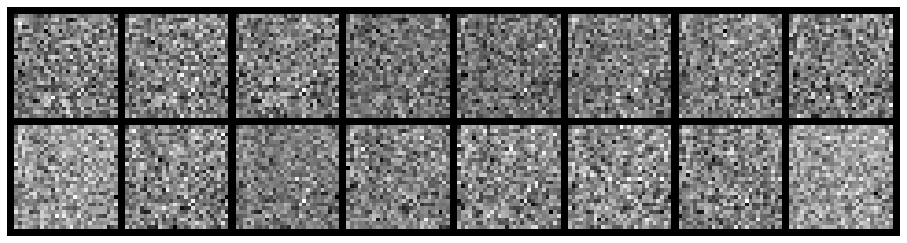

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.4298, Generator Loss: 0.6835
D(x): 0.4833, D(G(z)): 0.5045


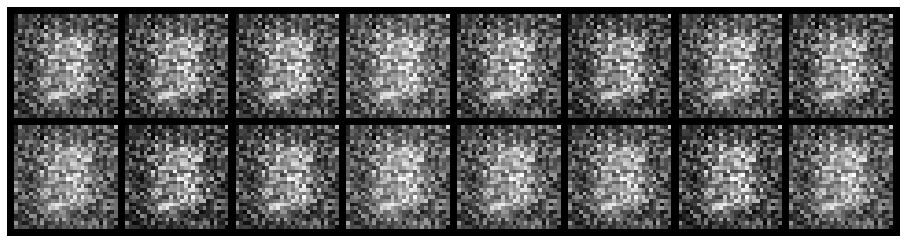

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 1.2882, Generator Loss: 0.8390
D(x): 0.7718, D(G(z)): 0.5942


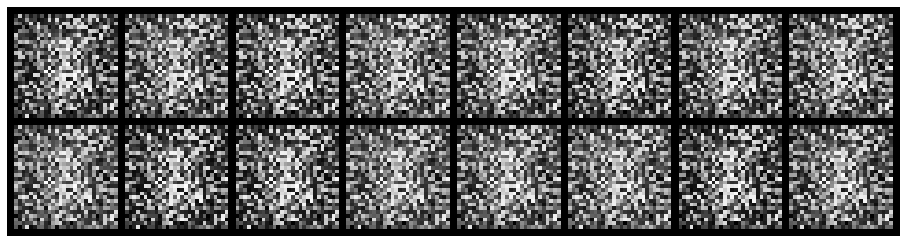

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.6277, Generator Loss: 4.3600
D(x): 0.8760, D(G(z)): 0.3176


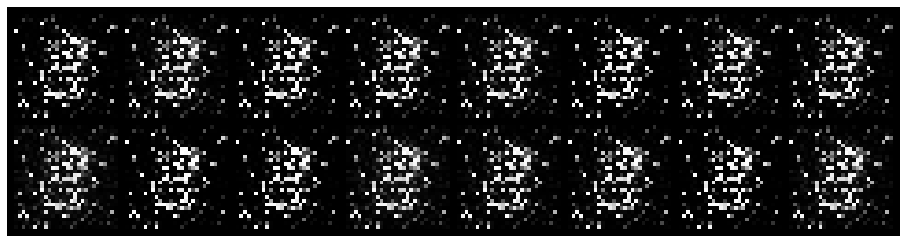

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.4974, Generator Loss: 4.8887
D(x): 0.8592, D(G(z)): 0.1892


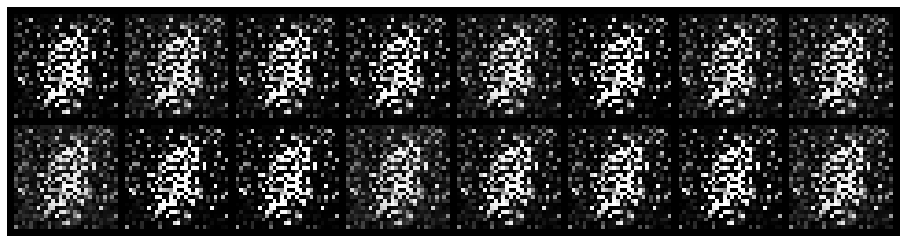

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.9846, Generator Loss: 2.7604
D(x): 0.5914, D(G(z)): 0.2936


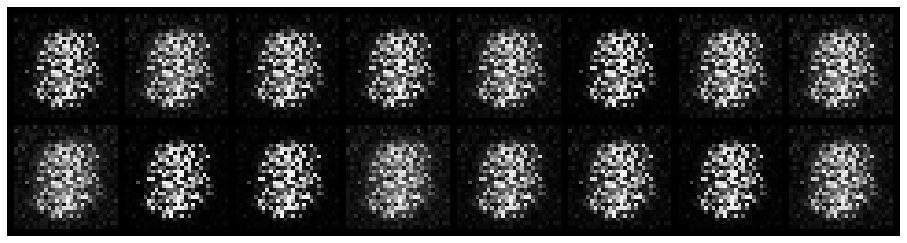

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 0.5081, Generator Loss: 2.8127
D(x): 0.8224, D(G(z)): 0.2378


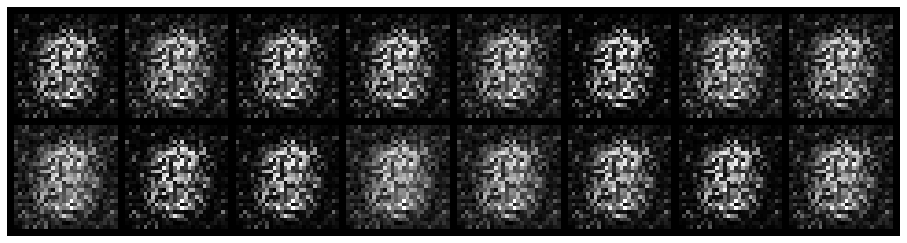

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 1.3269, Generator Loss: 0.9562
D(x): 0.5679, D(G(z)): 0.4969


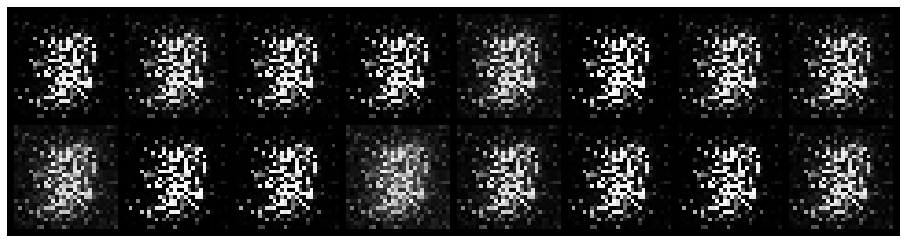

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.6691, Generator Loss: 2.9927
D(x): 0.7639, D(G(z)): 0.2558


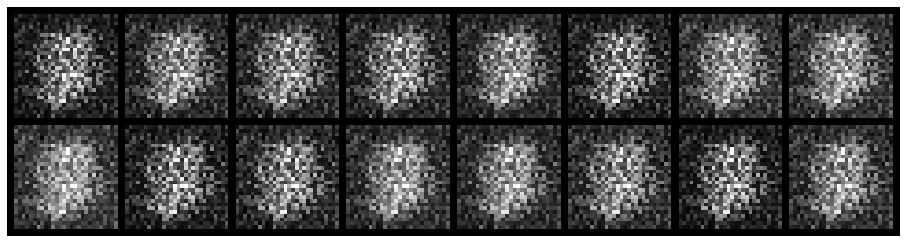

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 0.5976, Generator Loss: 2.3462
D(x): 0.8563, D(G(z)): 0.2867


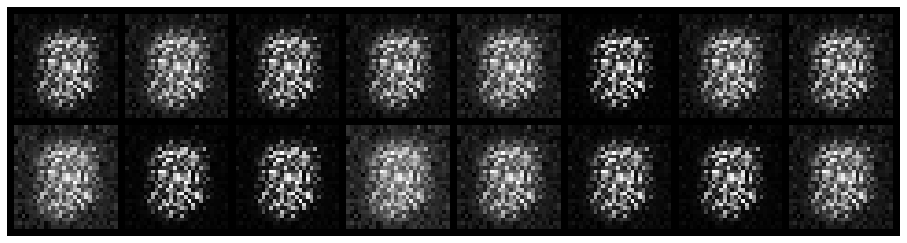

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 0.4990, Generator Loss: 3.7222
D(x): 0.8056, D(G(z)): 0.1923


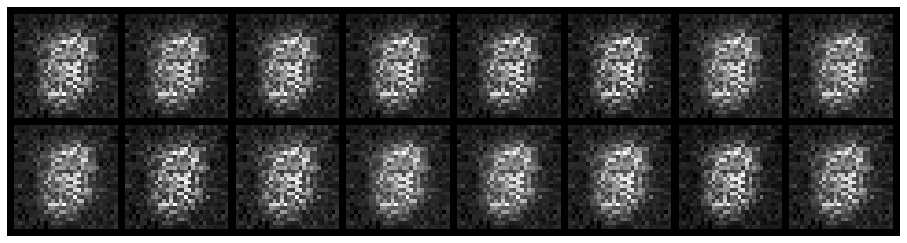

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 0.7792, Generator Loss: 1.9115
D(x): 0.8008, D(G(z)): 0.3543


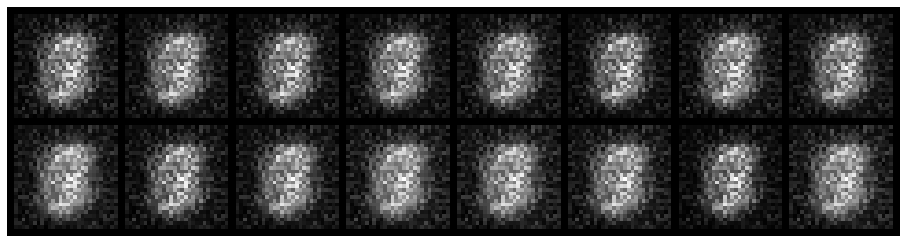

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 1.0285, Generator Loss: 1.0619
D(x): 0.7414, D(G(z)): 0.4715


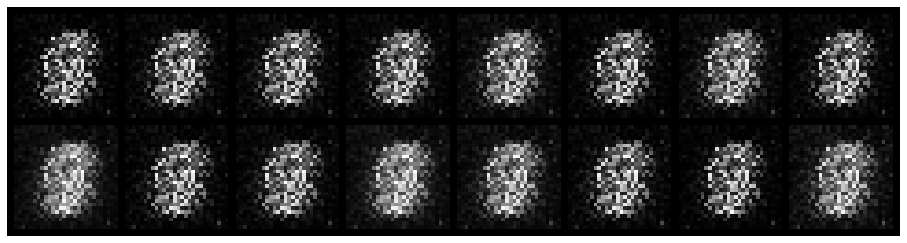

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.7699, Generator Loss: 1.4474
D(x): 0.6948, D(G(z)): 0.2991


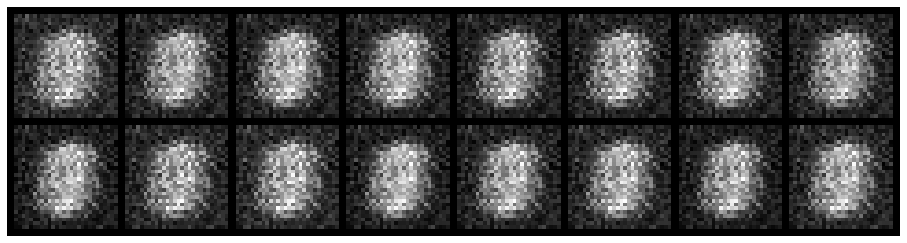

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 0.9717, Generator Loss: 1.0492
D(x): 0.7494, D(G(z)): 0.4235


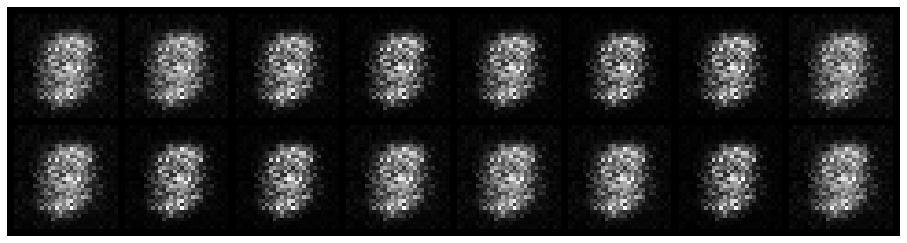

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 0.6213, Generator Loss: 2.2404
D(x): 0.8094, D(G(z)): 0.2371


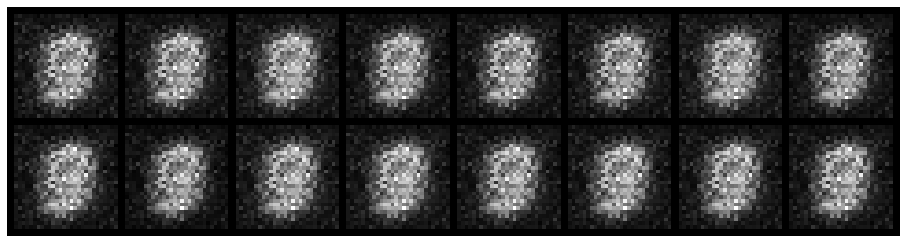

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 1.0241, Generator Loss: 1.6047
D(x): 0.7505, D(G(z)): 0.4097


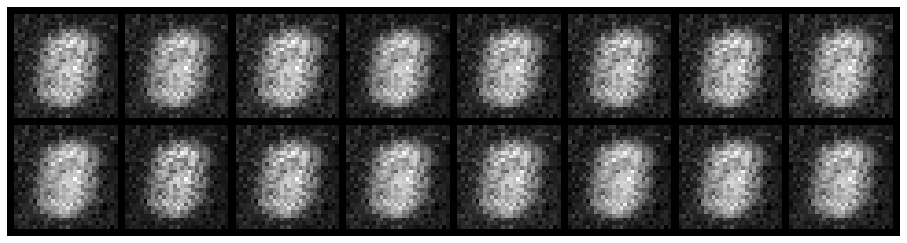

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 1.9046, Generator Loss: 1.3741
D(x): 0.4518, D(G(z)): 0.3594


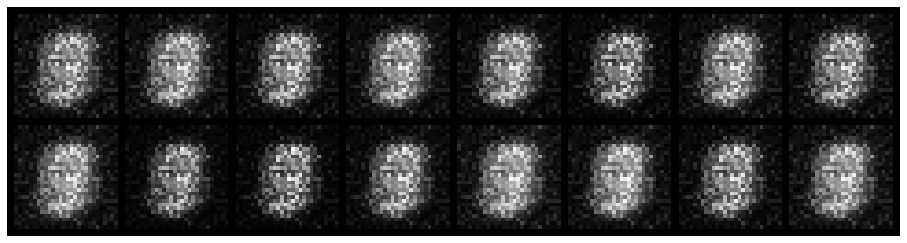

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 0.9549, Generator Loss: 1.7101
D(x): 0.6739, D(G(z)): 0.3448


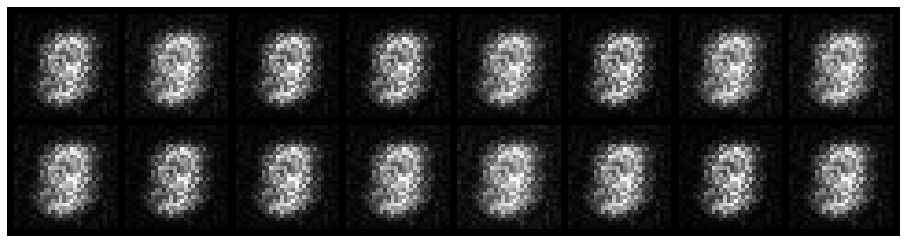

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.8629, Generator Loss: 1.5313
D(x): 0.7483, D(G(z)): 0.3628


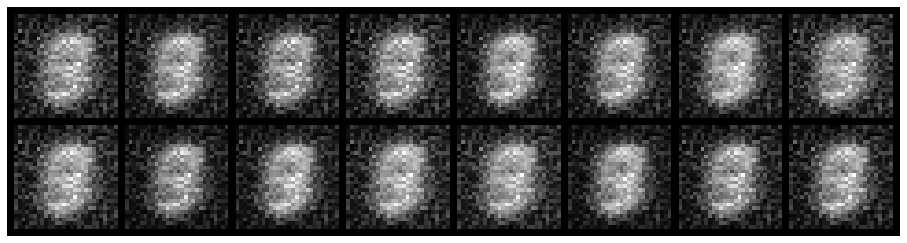

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 0.7710, Generator Loss: 1.5690
D(x): 0.7749, D(G(z)): 0.2953


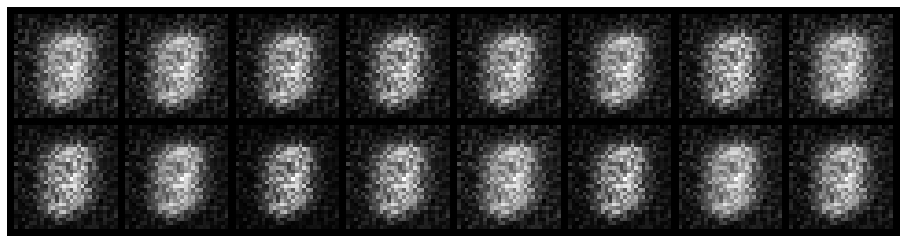

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 1.0746, Generator Loss: 1.1398
D(x): 0.7342, D(G(z)): 0.4329


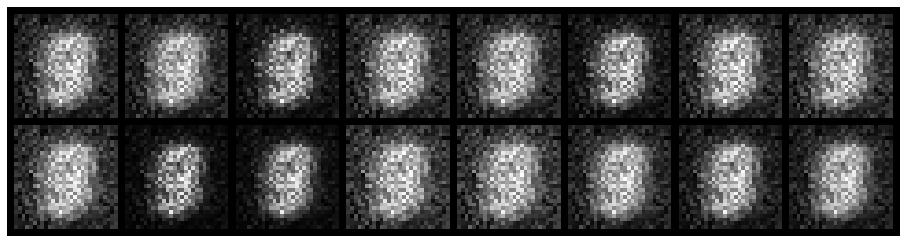

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 1.0056, Generator Loss: 1.2034
D(x): 0.7618, D(G(z)): 0.4410


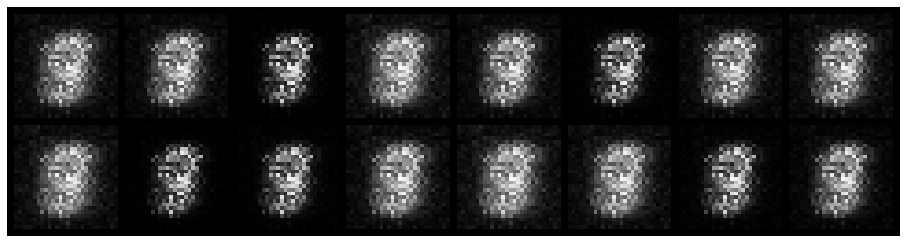

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.4904, Generator Loss: 2.5956
D(x): 0.8260, D(G(z)): 0.1646


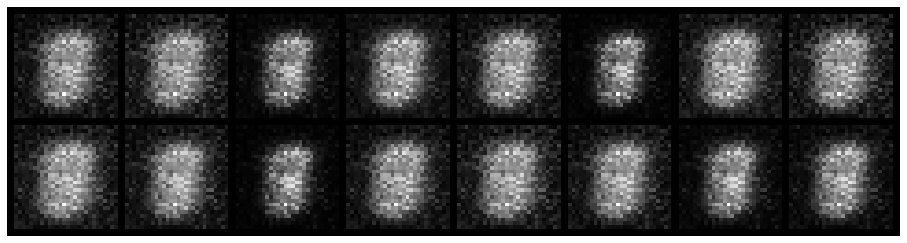

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 1.6458, Generator Loss: 1.9130
D(x): 0.7008, D(G(z)): 0.4151


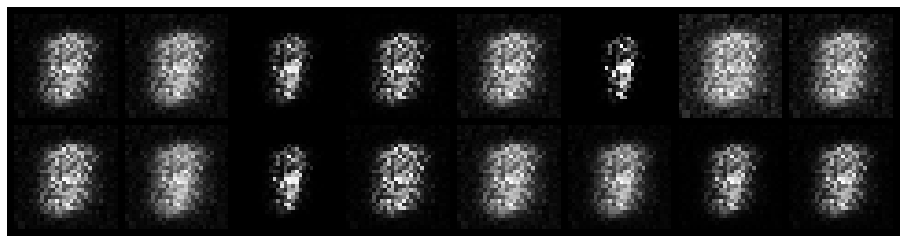

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 1.3096, Generator Loss: 1.9605
D(x): 0.6769, D(G(z)): 0.4012


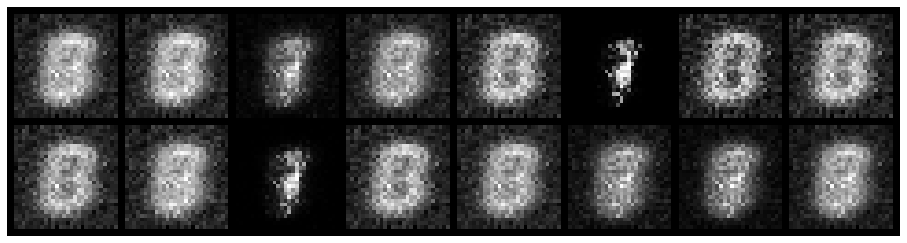

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 1.2104, Generator Loss: 2.6348
D(x): 0.7645, D(G(z)): 0.2917


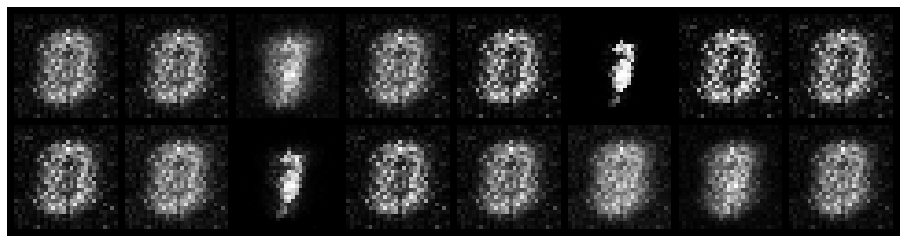

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 0.9363, Generator Loss: 1.3427
D(x): 0.7431, D(G(z)): 0.3827


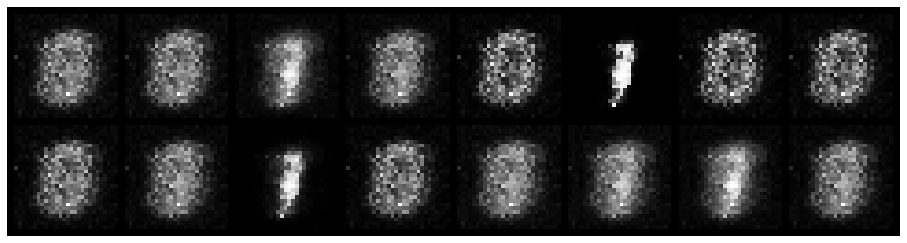

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.3356, Generator Loss: 3.0736
D(x): 0.9159, D(G(z)): 0.1526


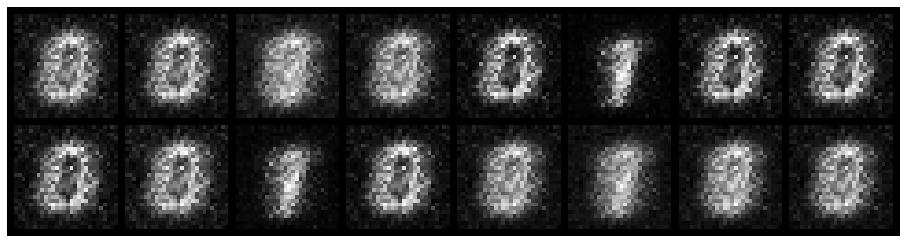

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.6721, Generator Loss: 2.7095
D(x): 0.9200, D(G(z)): 0.3040


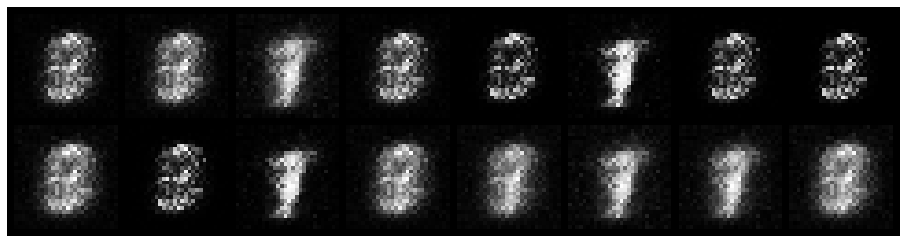

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.6805, Generator Loss: 1.8741
D(x): 0.8106, D(G(z)): 0.2212


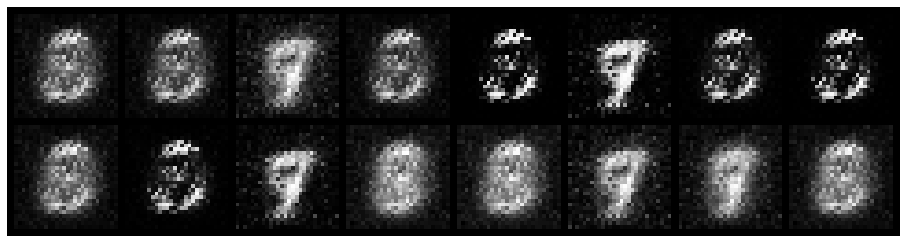

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.5292, Generator Loss: 2.5151
D(x): 0.8870, D(G(z)): 0.2148


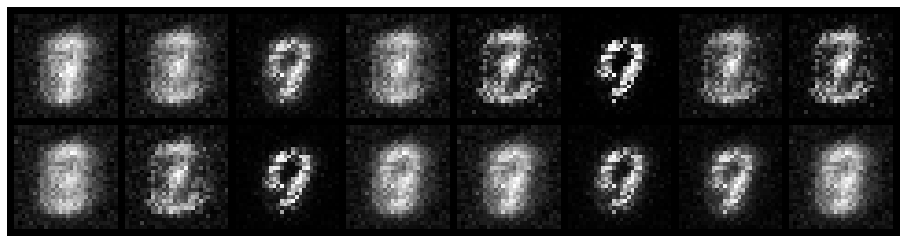

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.7898, Generator Loss: 2.4350
D(x): 0.7813, D(G(z)): 0.2305


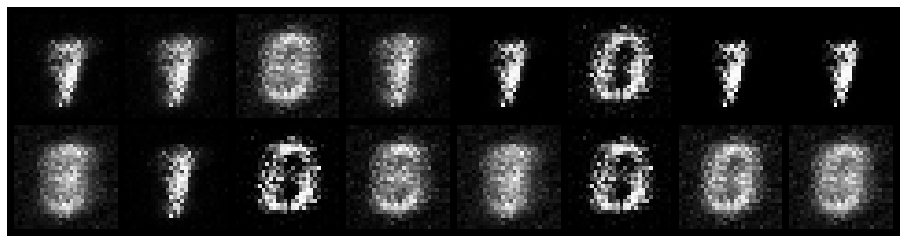

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.6315, Generator Loss: 2.1307
D(x): 0.8273, D(G(z)): 0.2370


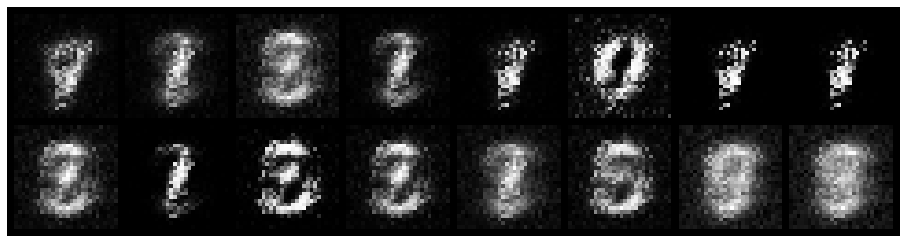

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.5471, Generator Loss: 3.7130
D(x): 0.8062, D(G(z)): 0.1075


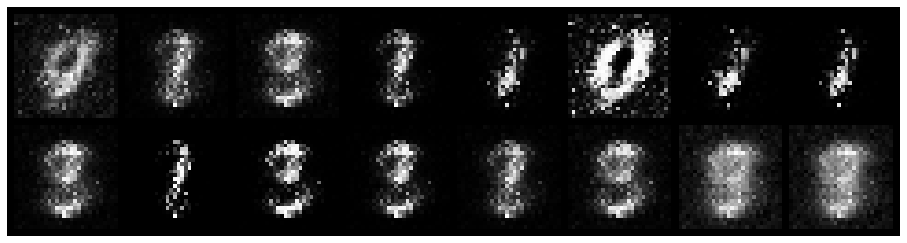

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.5465, Generator Loss: 2.3012
D(x): 0.8938, D(G(z)): 0.2397


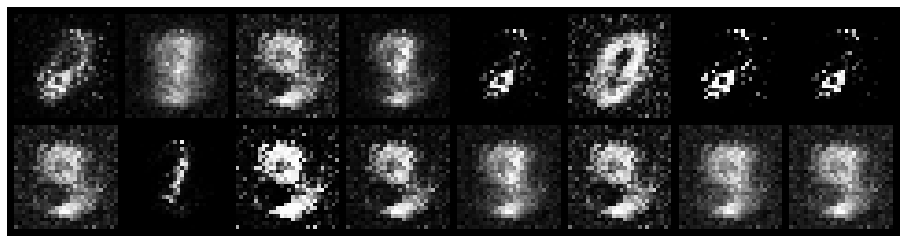

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.6864, Generator Loss: 2.2127
D(x): 0.7456, D(G(z)): 0.1632


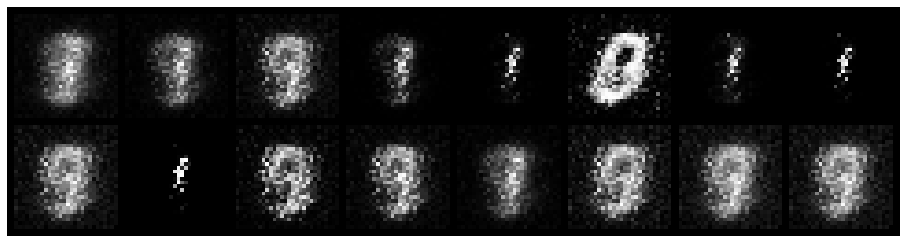

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.3543, Generator Loss: 2.5446
D(x): 0.8728, D(G(z)): 0.1114


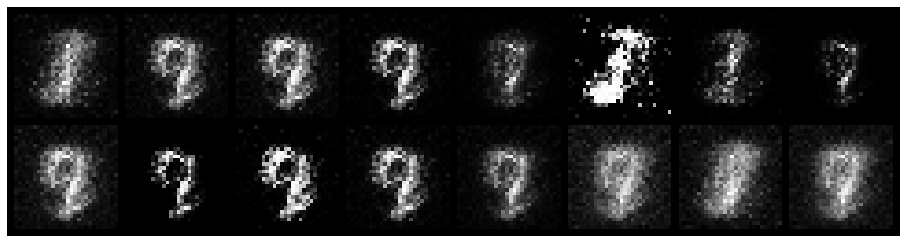

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.6522, Generator Loss: 2.6658
D(x): 0.7770, D(G(z)): 0.1841


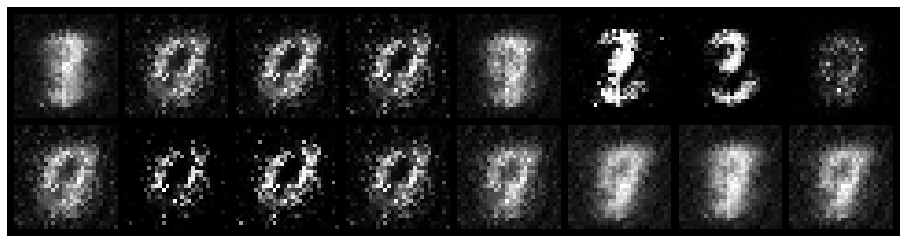

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 0.4301, Generator Loss: 2.1494
D(x): 0.8483, D(G(z)): 0.1352


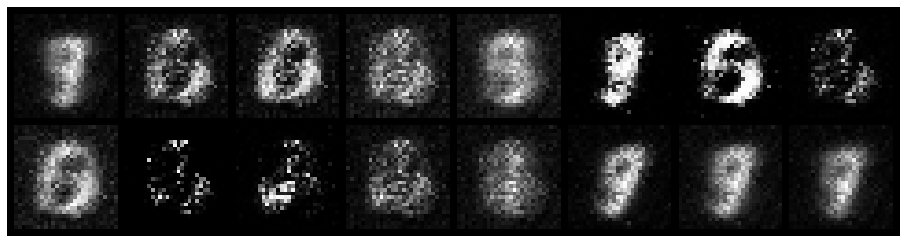

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.7457, Generator Loss: 2.7620
D(x): 0.7581, D(G(z)): 0.1717


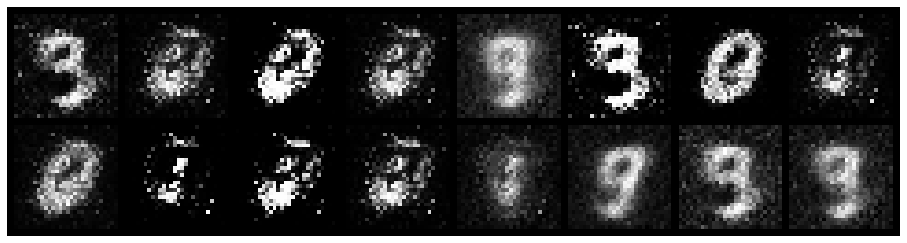

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 0.8048, Generator Loss: 1.9230
D(x): 0.7411, D(G(z)): 0.1845


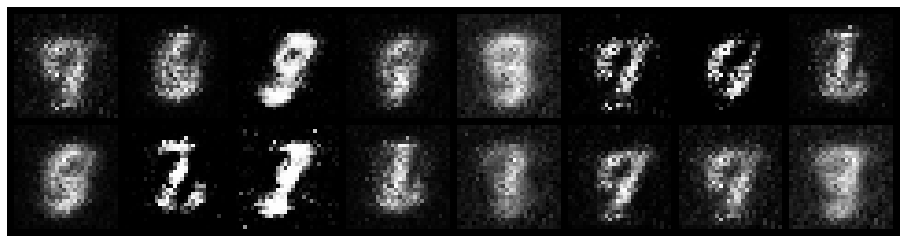

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.5042, Generator Loss: 2.7257
D(x): 0.8535, D(G(z)): 0.1633


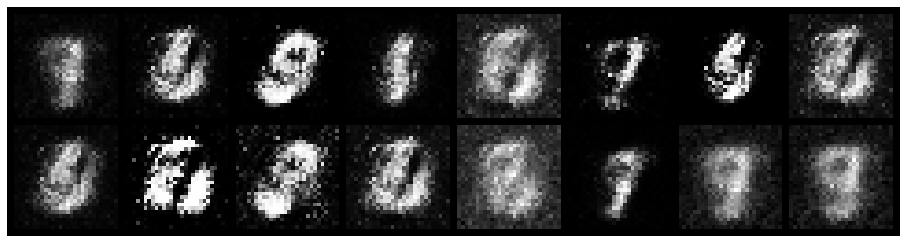

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.4695, Generator Loss: 2.8183
D(x): 0.8006, D(G(z)): 0.1202


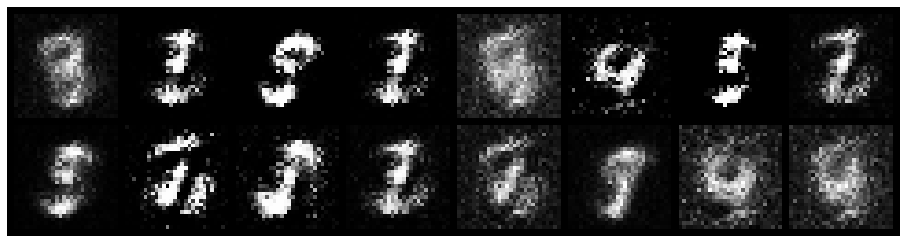

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.5237, Generator Loss: 2.3646
D(x): 0.8433, D(G(z)): 0.2096


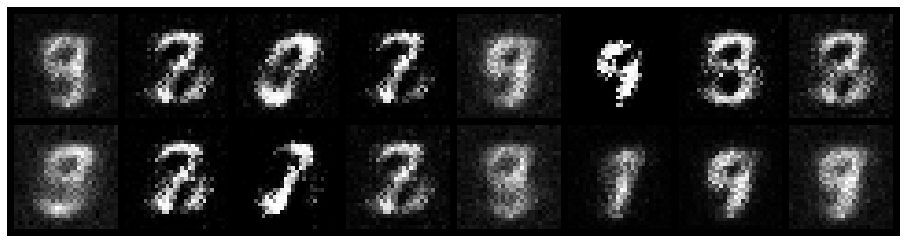

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.8165, Generator Loss: 2.1262
D(x): 0.7421, D(G(z)): 0.2358


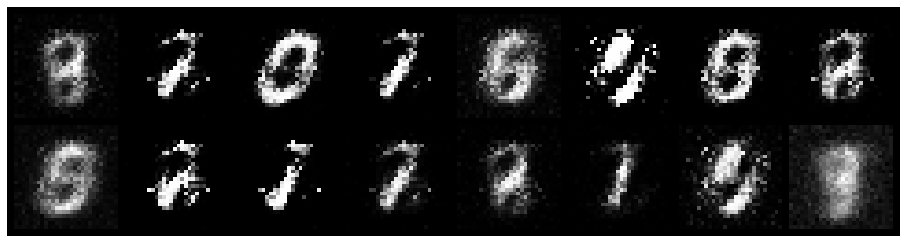

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.7546, Generator Loss: 2.1491
D(x): 0.7797, D(G(z)): 0.2574


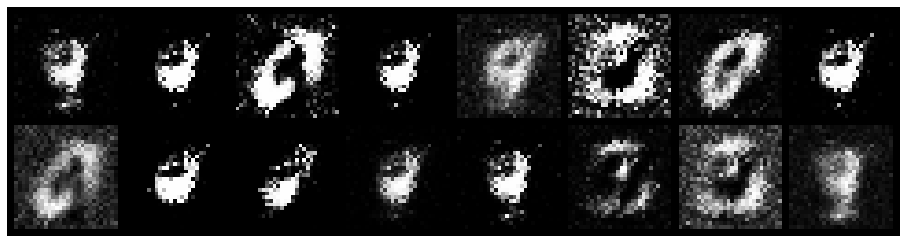

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.7323, Generator Loss: 1.9891
D(x): 0.7743, D(G(z)): 0.2402


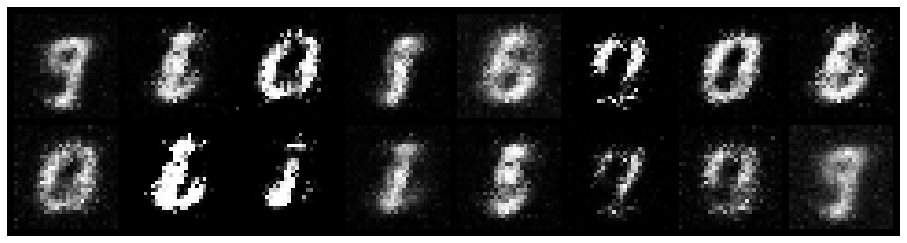

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 1.0695, Generator Loss: 1.7591
D(x): 0.8180, D(G(z)): 0.3922


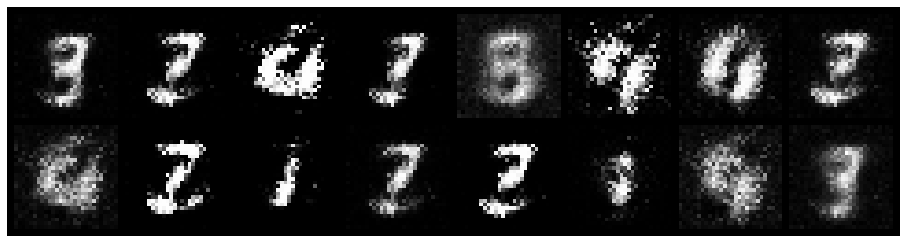

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.4176, Generator Loss: 2.8545
D(x): 0.8499, D(G(z)): 0.1469


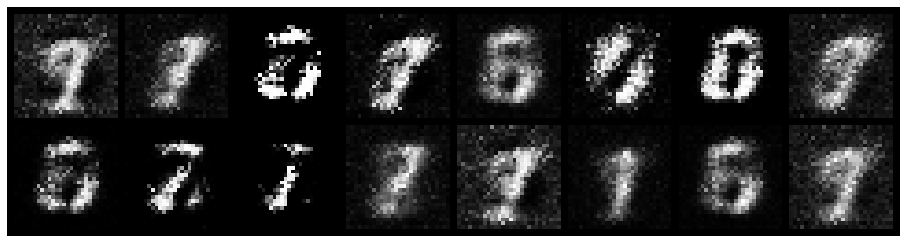

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.6503, Generator Loss: 2.9760
D(x): 0.7708, D(G(z)): 0.1096


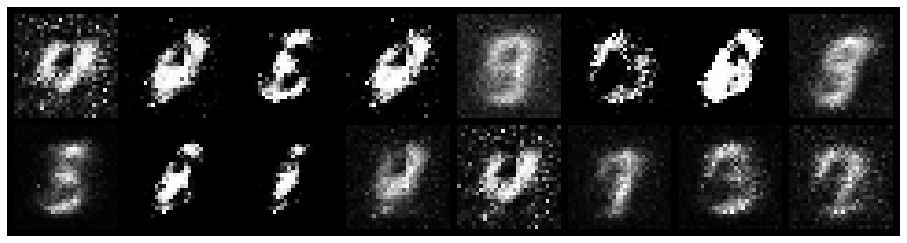

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.4844, Generator Loss: 2.4894
D(x): 0.8882, D(G(z)): 0.1852


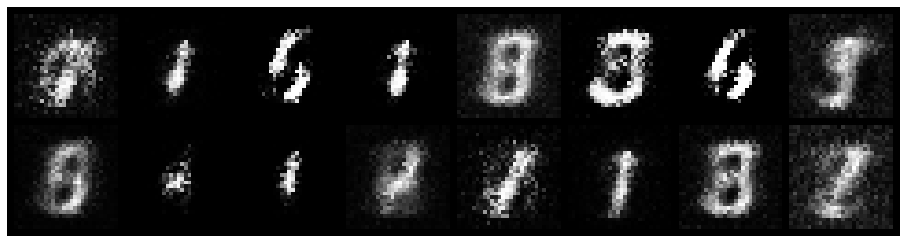

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.6496, Generator Loss: 2.1228
D(x): 0.8243, D(G(z)): 0.2187


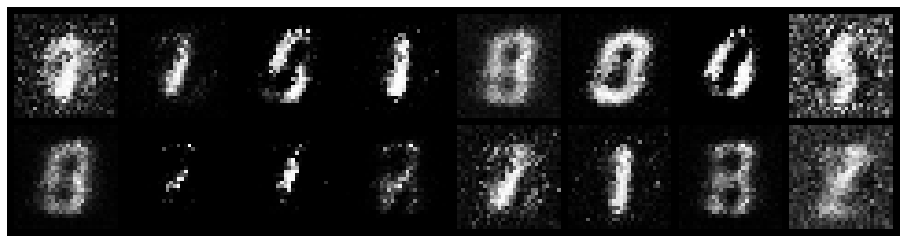

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.6948, Generator Loss: 2.7488
D(x): 0.7796, D(G(z)): 0.1400


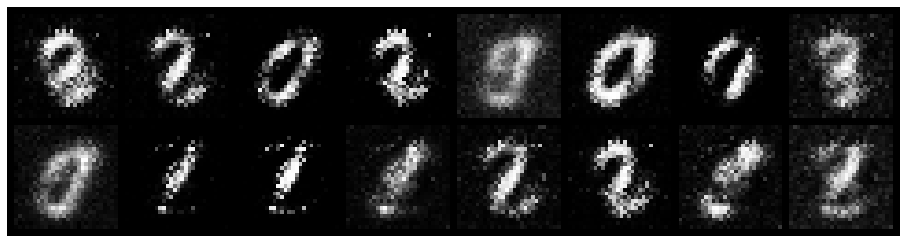

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.3252, Generator Loss: 3.2456
D(x): 0.8932, D(G(z)): 0.1140


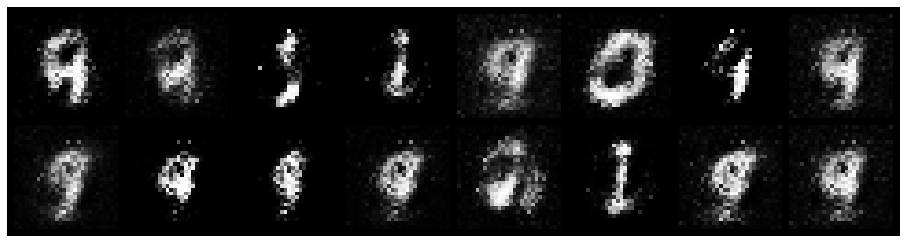

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.5807, Generator Loss: 2.0401
D(x): 0.8648, D(G(z)): 0.2558


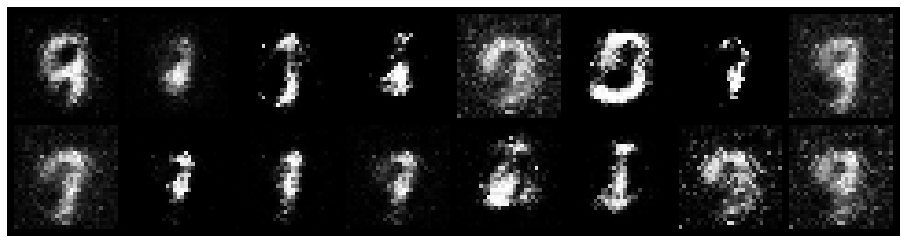

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.8921, Generator Loss: 1.7536
D(x): 0.7384, D(G(z)): 0.2983


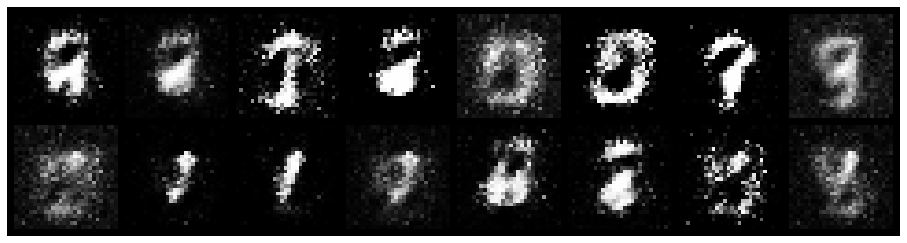

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.5668, Generator Loss: 2.1616
D(x): 0.8103, D(G(z)): 0.2068


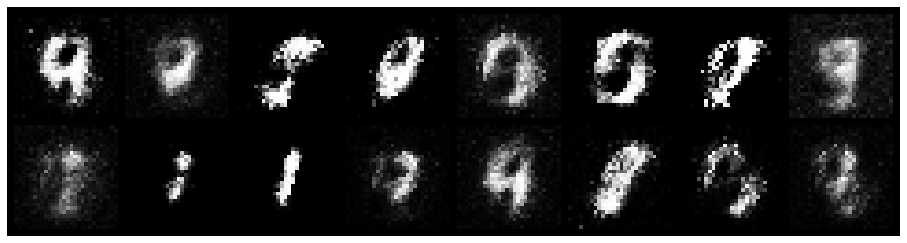

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.6359, Generator Loss: 2.2591
D(x): 0.8347, D(G(z)): 0.2447


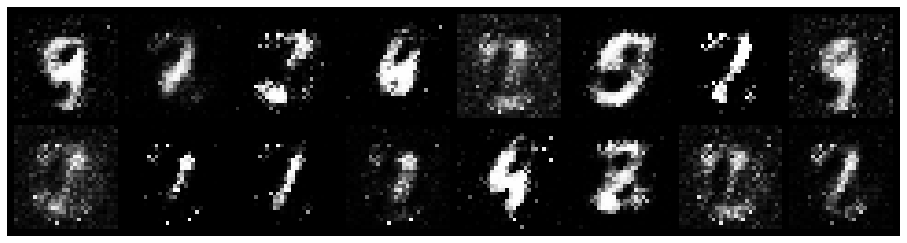

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.5348, Generator Loss: 2.6942
D(x): 0.8533, D(G(z)): 0.1908


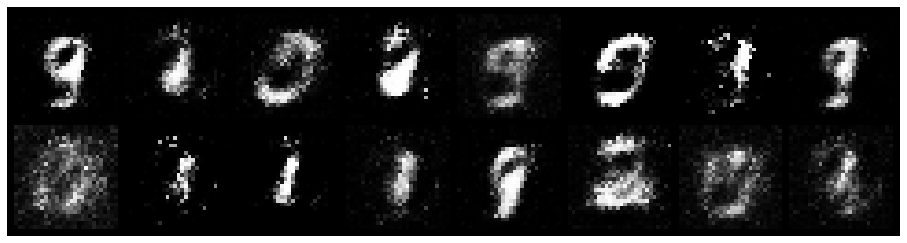

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.3944, Generator Loss: 2.4697
D(x): 0.8706, D(G(z)): 0.1414


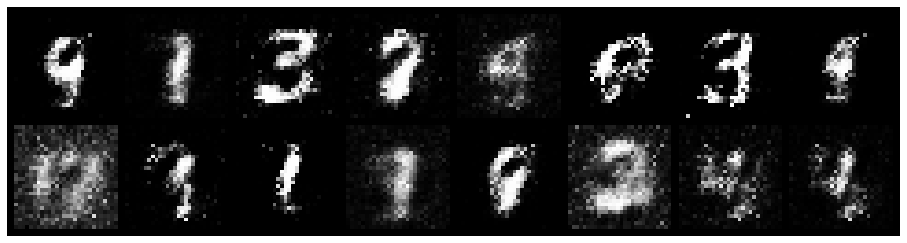

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.5352, Generator Loss: 1.8537
D(x): 0.8444, D(G(z)): 0.2229


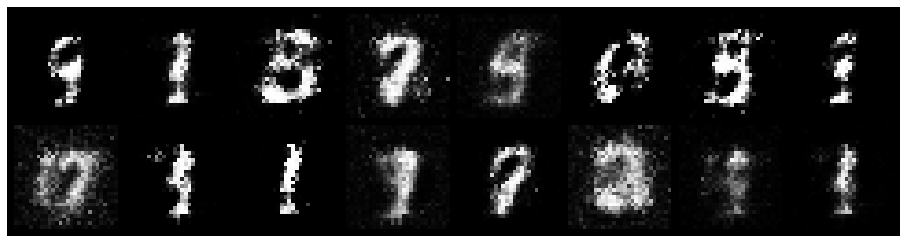

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.7470, Generator Loss: 2.0595
D(x): 0.6980, D(G(z)): 0.1575


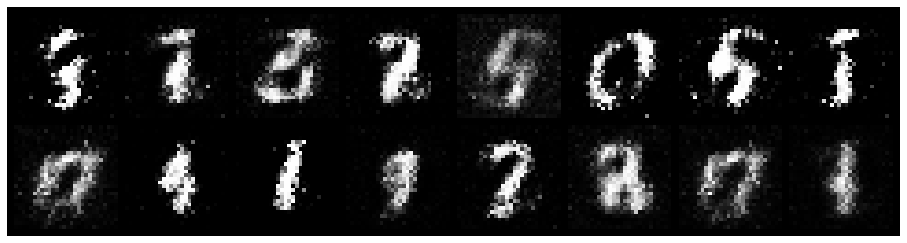

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.9117, Generator Loss: 1.9373
D(x): 0.7108, D(G(z)): 0.2950


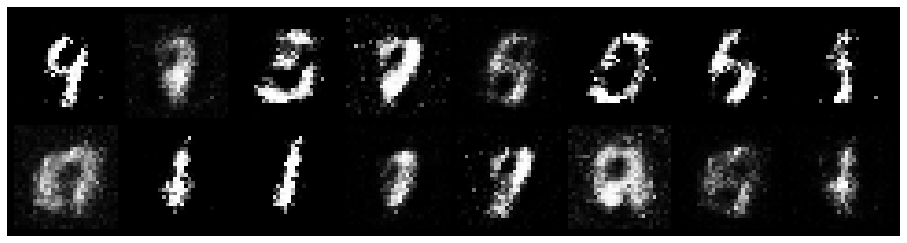

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.8182, Generator Loss: 1.8048
D(x): 0.7015, D(G(z)): 0.1969


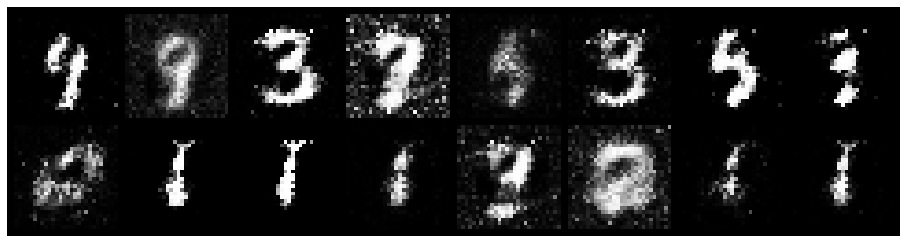

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.7570, Generator Loss: 2.3755
D(x): 0.7928, D(G(z)): 0.2186


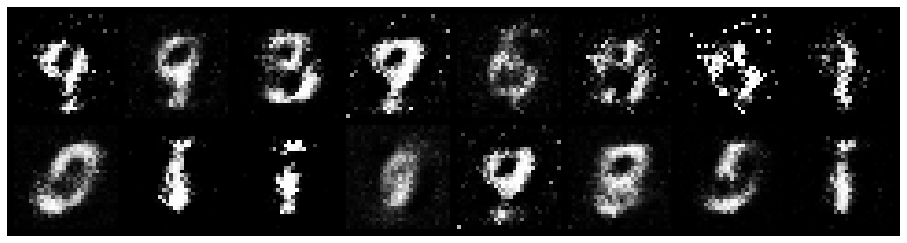

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.6724, Generator Loss: 1.7229
D(x): 0.8472, D(G(z)): 0.2910


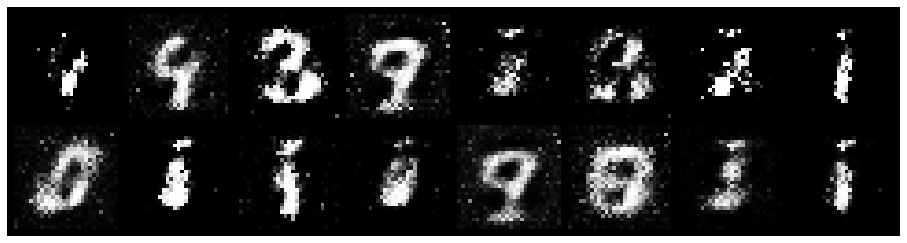

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.7078, Generator Loss: 2.2741
D(x): 0.7453, D(G(z)): 0.2116


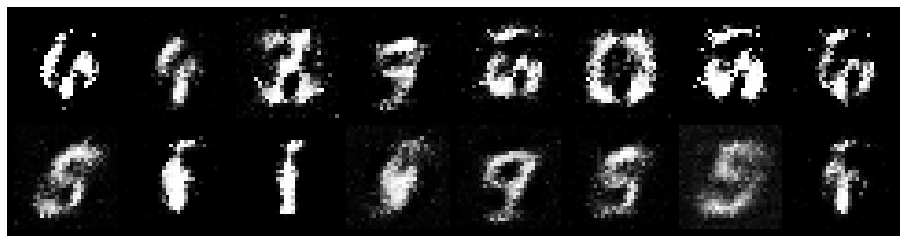

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.6499, Generator Loss: 2.4916
D(x): 0.7405, D(G(z)): 0.1679


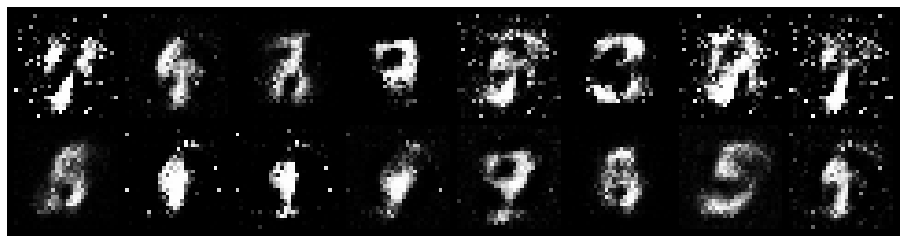

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.6714, Generator Loss: 1.6260
D(x): 0.7872, D(G(z)): 0.2872


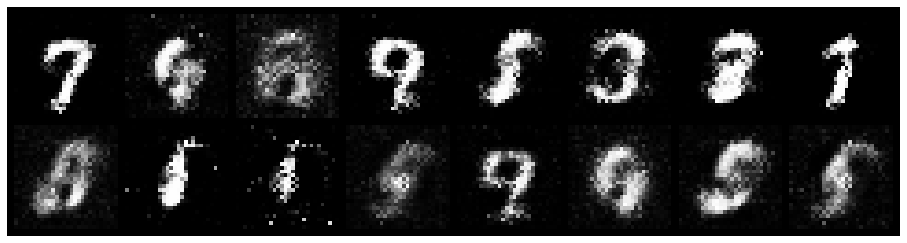

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 1.0214, Generator Loss: 1.3327
D(x): 0.6600, D(G(z)): 0.2791


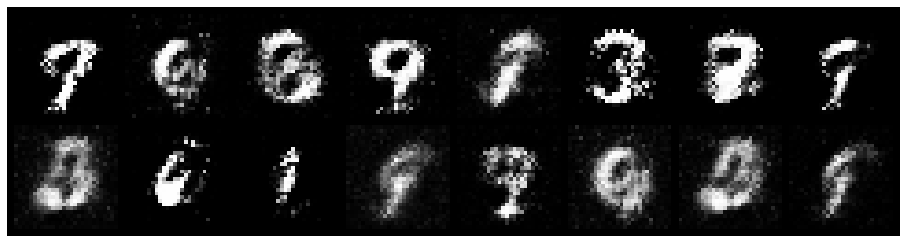

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.8561, Generator Loss: 1.8058
D(x): 0.7529, D(G(z)): 0.2817


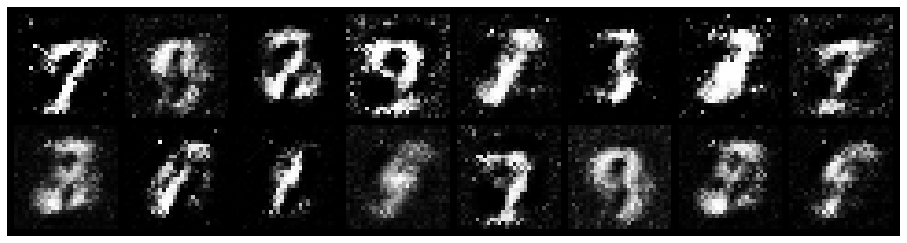

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.6947, Generator Loss: 2.3054
D(x): 0.7649, D(G(z)): 0.2048


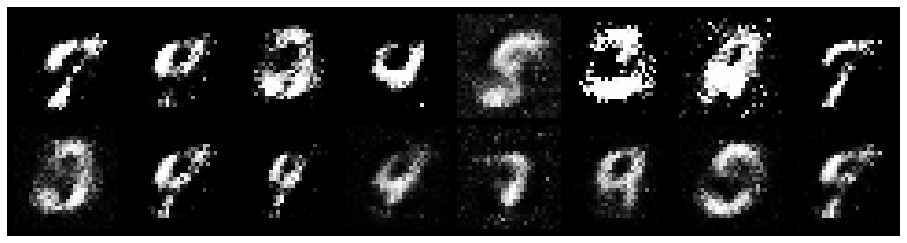

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.6756, Generator Loss: 1.7593
D(x): 0.7439, D(G(z)): 0.1957


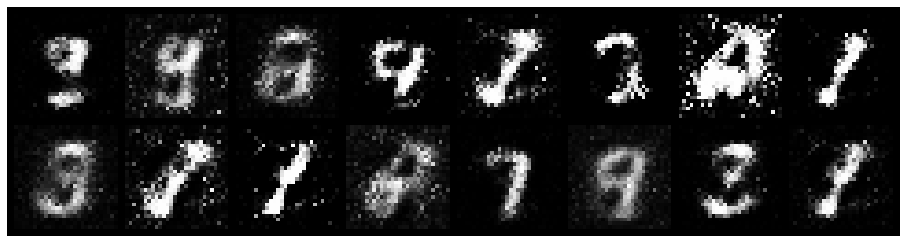

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.7151, Generator Loss: 2.5488
D(x): 0.7558, D(G(z)): 0.1326


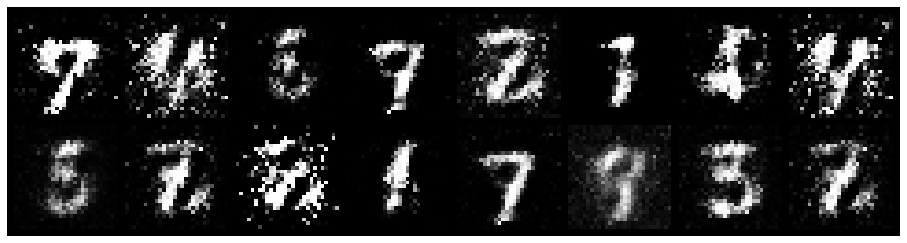

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.7895, Generator Loss: 2.2902
D(x): 0.8048, D(G(z)): 0.2675


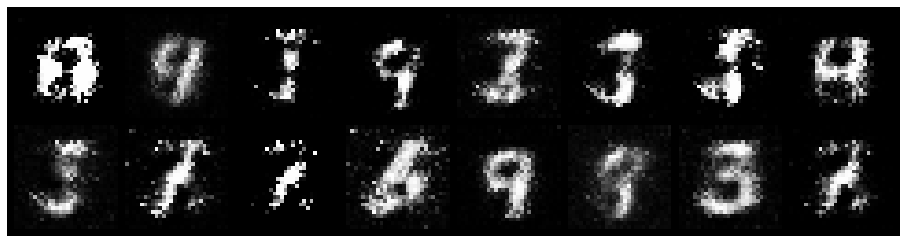

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.6513, Generator Loss: 2.3288
D(x): 0.7915, D(G(z)): 0.2378


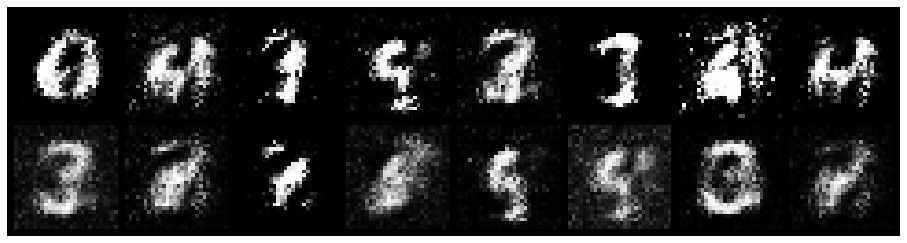

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.8789, Generator Loss: 2.0404
D(x): 0.7029, D(G(z)): 0.2726


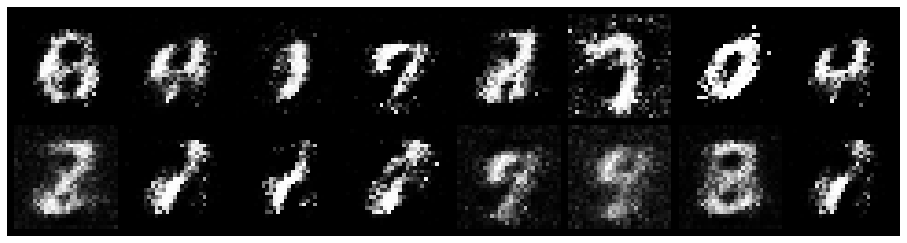

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.9885, Generator Loss: 1.5187
D(x): 0.6620, D(G(z)): 0.2599


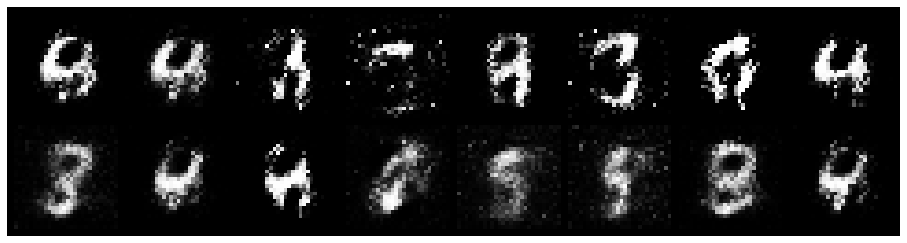

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.6875, Generator Loss: 2.3455
D(x): 0.8023, D(G(z)): 0.2184


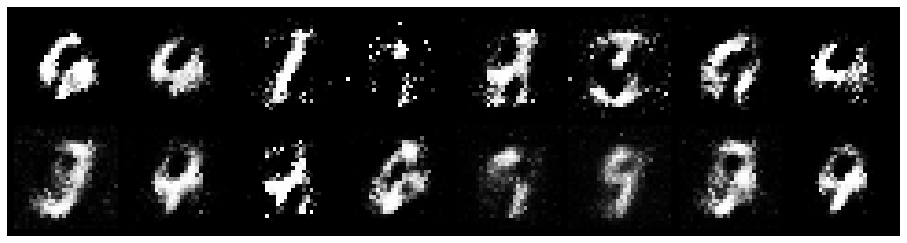

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 1.0409, Generator Loss: 1.6219
D(x): 0.6592, D(G(z)): 0.2761


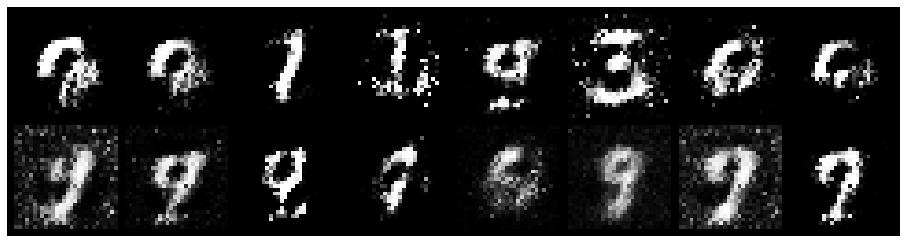

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.7737, Generator Loss: 1.9955
D(x): 0.7965, D(G(z)): 0.2693


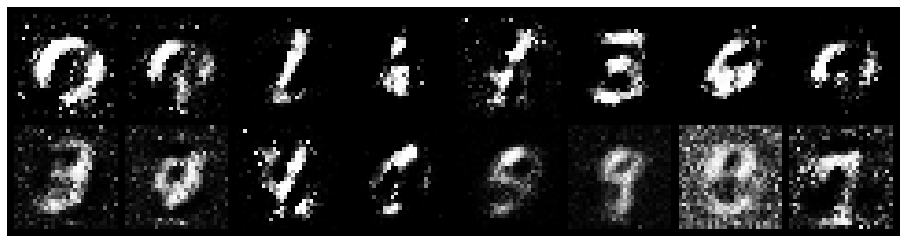

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 1.0121, Generator Loss: 1.8997
D(x): 0.6984, D(G(z)): 0.2582


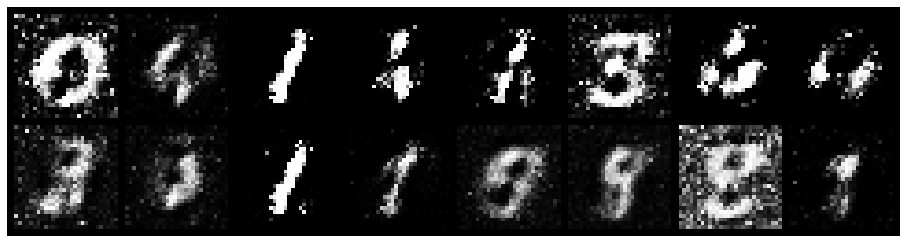

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.8792, Generator Loss: 2.2988
D(x): 0.8005, D(G(z)): 0.2488


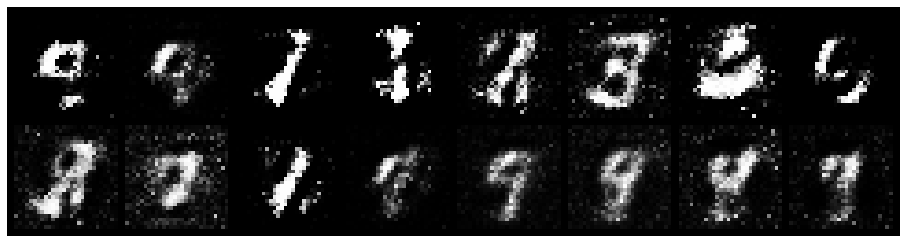

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.7139, Generator Loss: 2.1221
D(x): 0.7843, D(G(z)): 0.2479


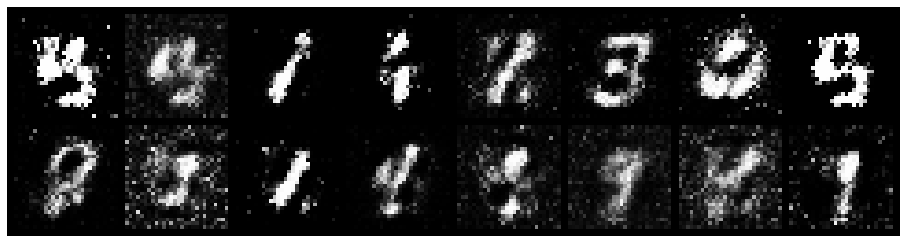

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.9693, Generator Loss: 1.2252
D(x): 0.8177, D(G(z)): 0.4010


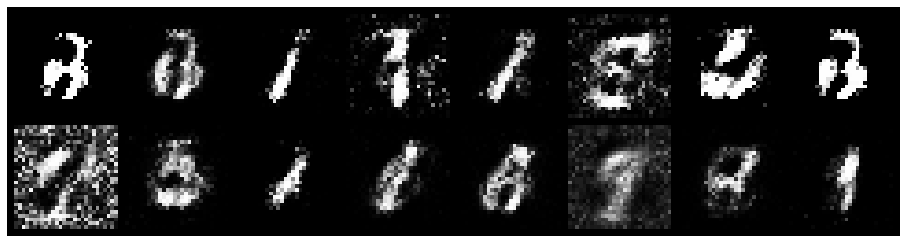

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.9212, Generator Loss: 1.8510
D(x): 0.7562, D(G(z)): 0.3045


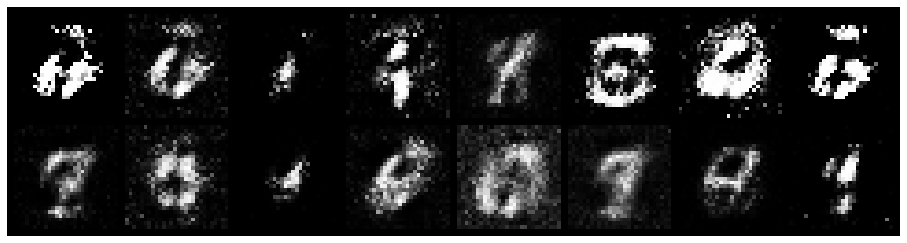

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 1.0237, Generator Loss: 1.7410
D(x): 0.7667, D(G(z)): 0.3318


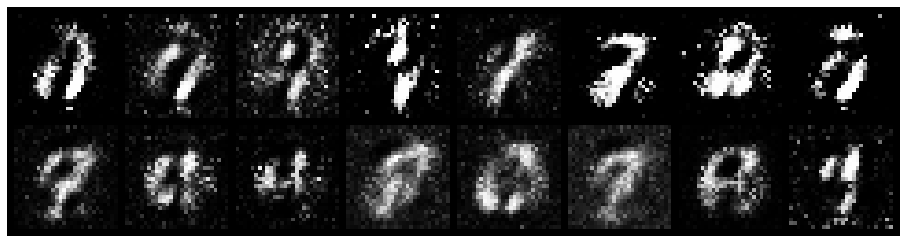

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.9676, Generator Loss: 1.7670
D(x): 0.7775, D(G(z)): 0.3732


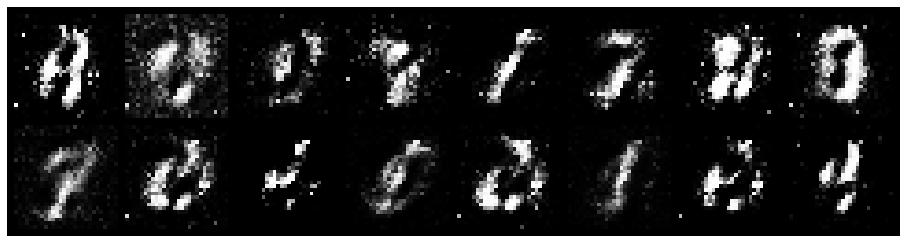

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.7973, Generator Loss: 1.7760
D(x): 0.8642, D(G(z)): 0.3647


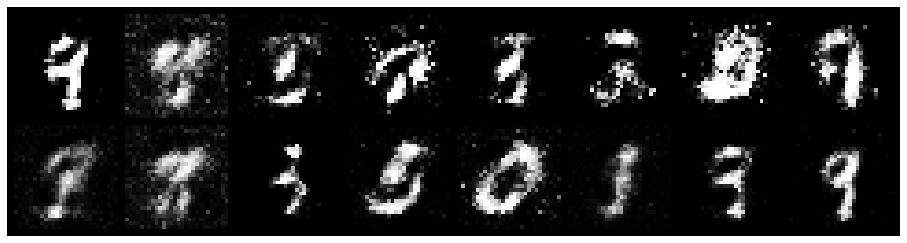

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.9447, Generator Loss: 1.8696
D(x): 0.6769, D(G(z)): 0.2443


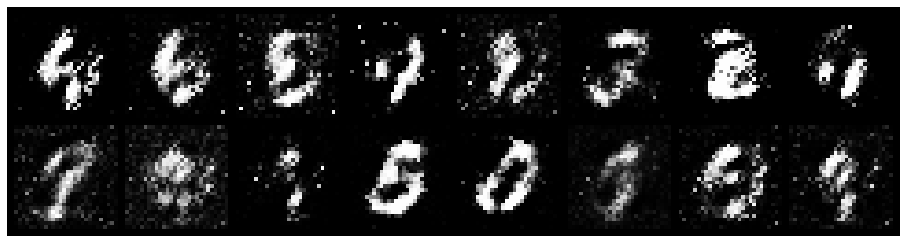

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 0.7701, Generator Loss: 1.6688
D(x): 0.7143, D(G(z)): 0.2308


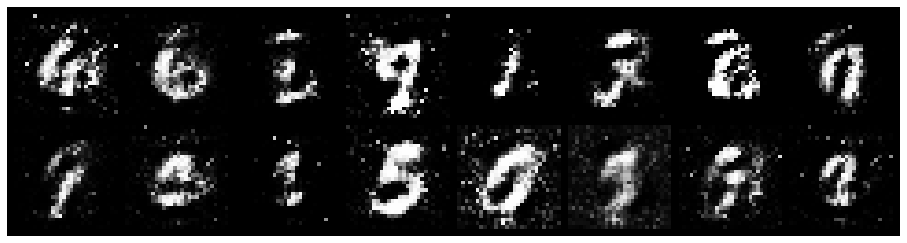

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 0.8141, Generator Loss: 1.6453
D(x): 0.6939, D(G(z)): 0.2366


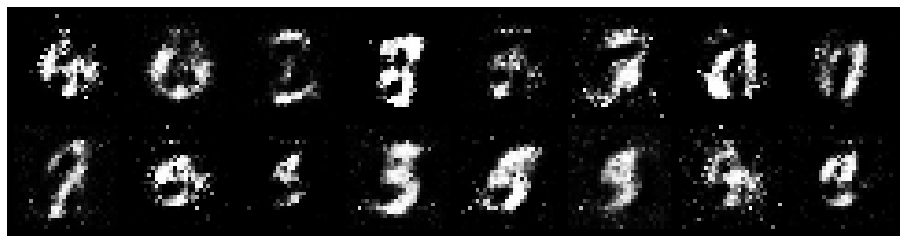

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 0.7895, Generator Loss: 1.8021
D(x): 0.7908, D(G(z)): 0.3229


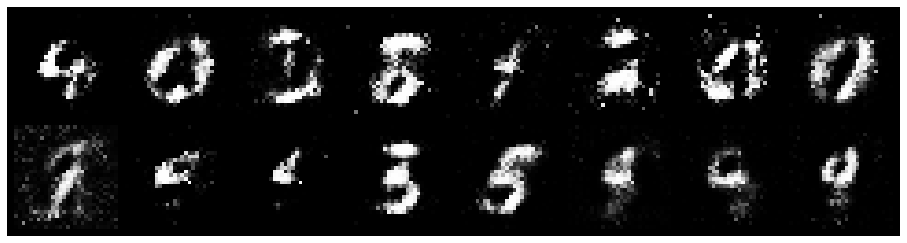

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.8402, Generator Loss: 1.9436
D(x): 0.6776, D(G(z)): 0.2092


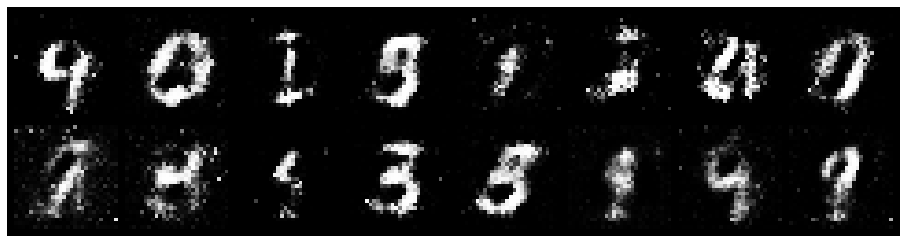

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.9139, Generator Loss: 1.5614
D(x): 0.6968, D(G(z)): 0.2738


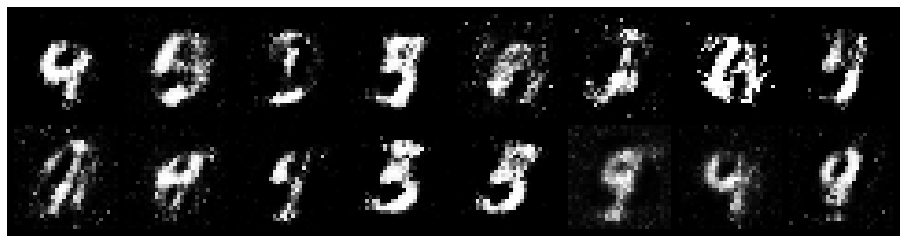

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.8350, Generator Loss: 2.1168
D(x): 0.7320, D(G(z)): 0.2641


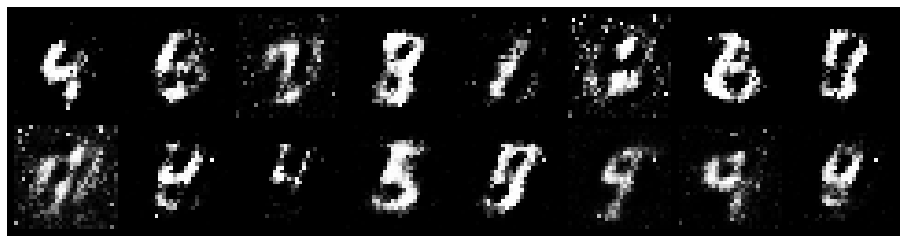

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 0.6483, Generator Loss: 1.9686
D(x): 0.7723, D(G(z)): 0.2344


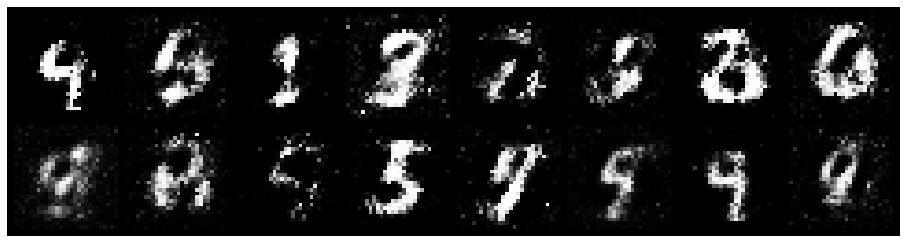

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.8624, Generator Loss: 1.7348
D(x): 0.7062, D(G(z)): 0.2616


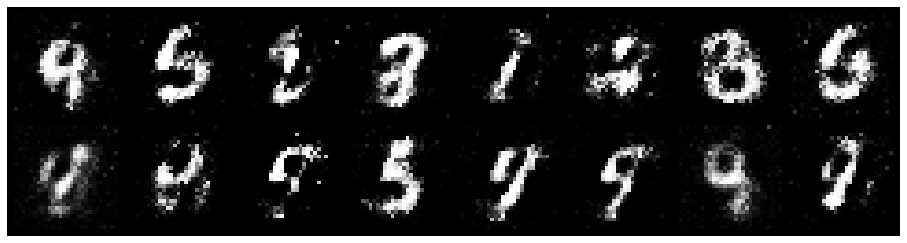

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.9005, Generator Loss: 1.4914
D(x): 0.7246, D(G(z)): 0.3391


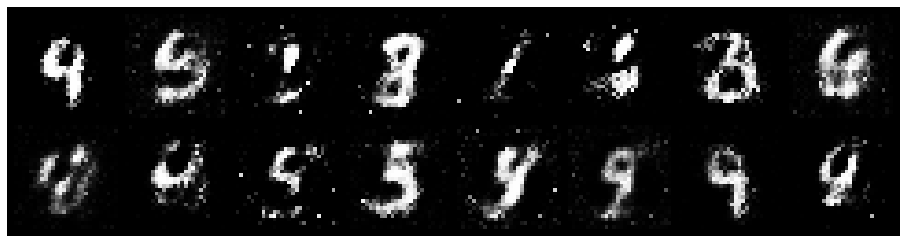

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.7940, Generator Loss: 1.9664
D(x): 0.7448, D(G(z)): 0.2422


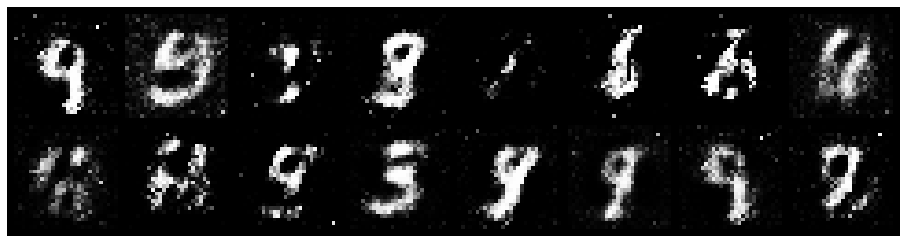

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.6718, Generator Loss: 1.4648
D(x): 0.8192, D(G(z)): 0.2690


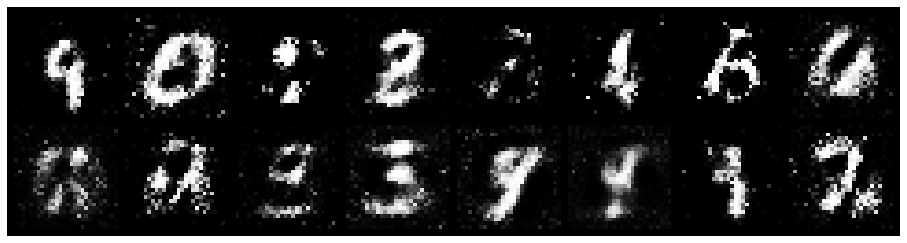

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8044, Generator Loss: 2.0676
D(x): 0.7463, D(G(z)): 0.2821


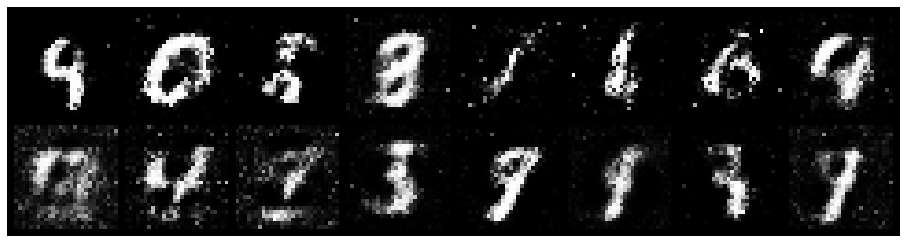

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.8206, Generator Loss: 1.5741
D(x): 0.7295, D(G(z)): 0.2929


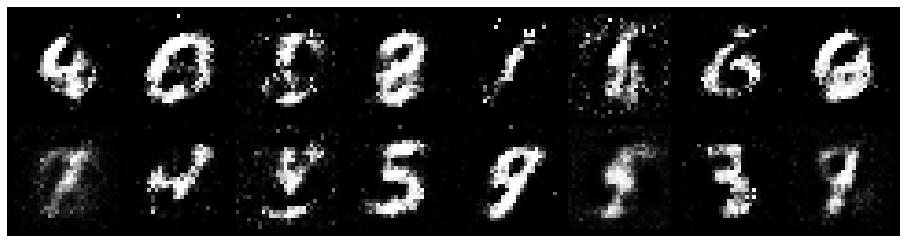

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 1.0255, Generator Loss: 1.4042
D(x): 0.6190, D(G(z)): 0.3167


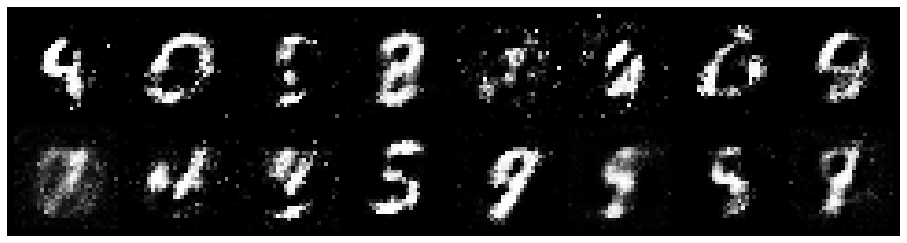

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.9139, Generator Loss: 1.4762
D(x): 0.7342, D(G(z)): 0.3387


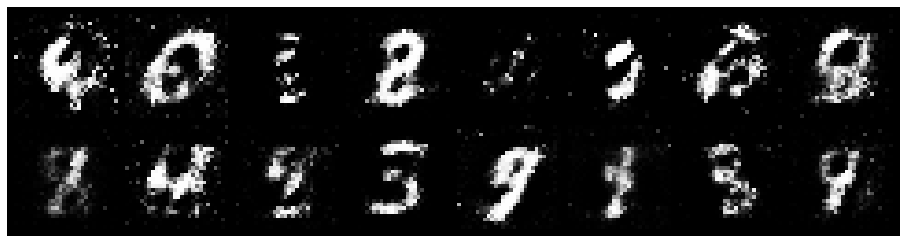

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.7791, Generator Loss: 1.7355
D(x): 0.7398, D(G(z)): 0.2808


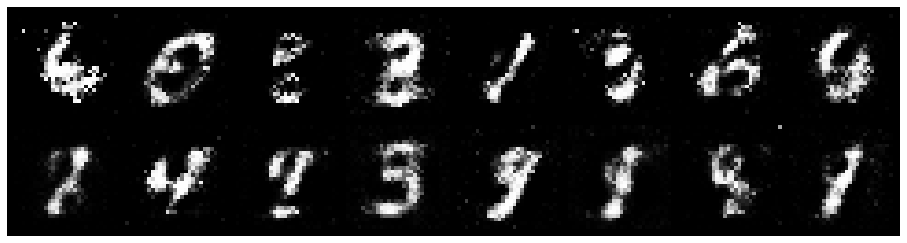

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.7899, Generator Loss: 2.1389
D(x): 0.7490, D(G(z)): 0.2624


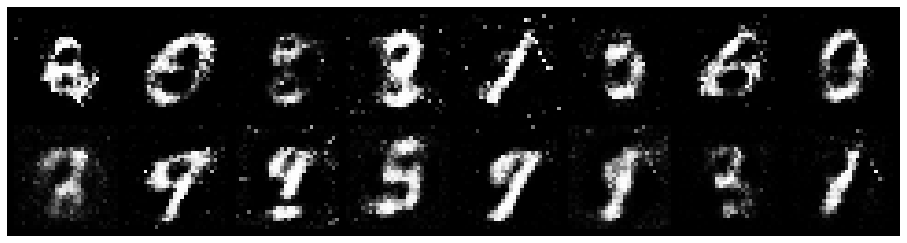

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 0.6035, Generator Loss: 1.8035
D(x): 0.8496, D(G(z)): 0.2779


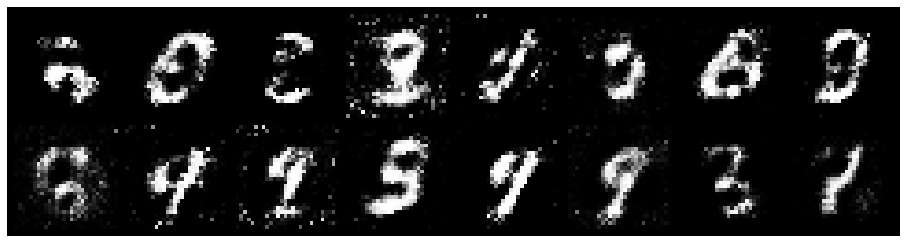

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 0.8904, Generator Loss: 2.1690
D(x): 0.6818, D(G(z)): 0.2124


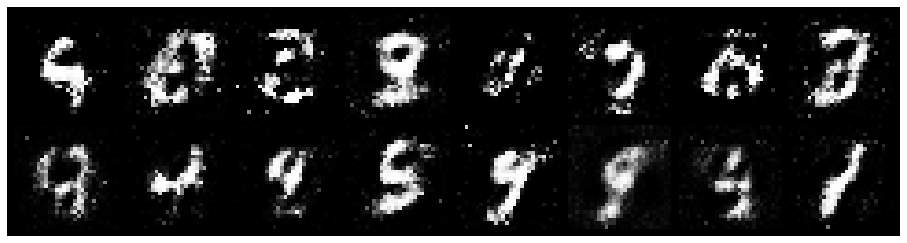

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.7275, Generator Loss: 1.9722
D(x): 0.7440, D(G(z)): 0.2434


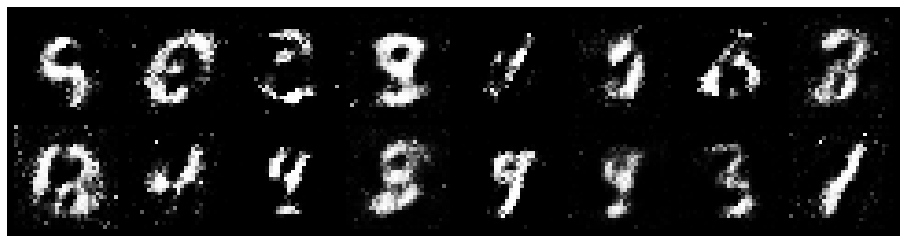

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8662, Generator Loss: 1.3866
D(x): 0.7630, D(G(z)): 0.3481


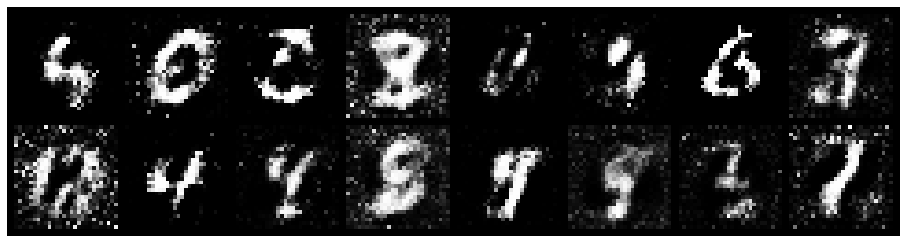

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 1.1925, Generator Loss: 1.3329
D(x): 0.5651, D(G(z)): 0.3718


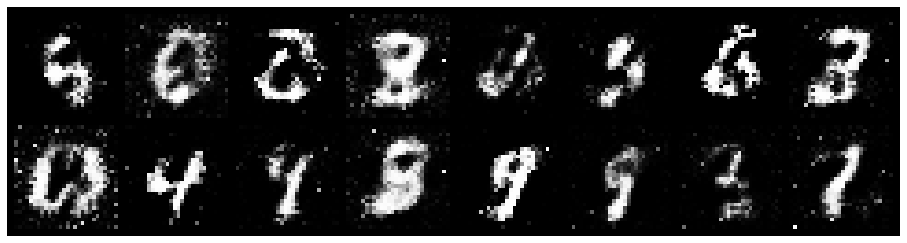

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8620, Generator Loss: 1.7087
D(x): 0.7562, D(G(z)): 0.3164


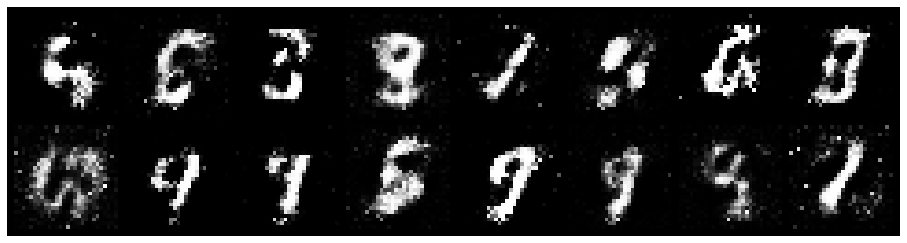

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.6563, Generator Loss: 1.9816
D(x): 0.7502, D(G(z)): 0.2043


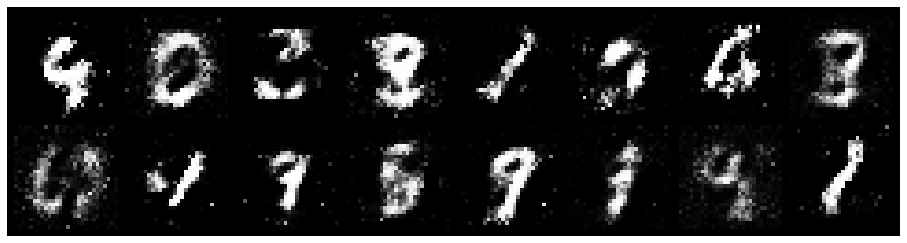

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 1.0106, Generator Loss: 1.4539
D(x): 0.6753, D(G(z)): 0.2974


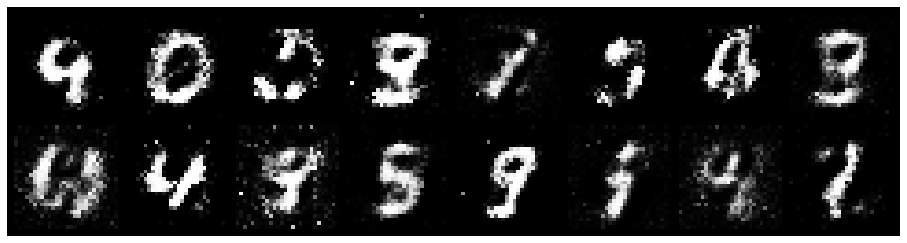

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.9473, Generator Loss: 1.5511
D(x): 0.7575, D(G(z)): 0.3516


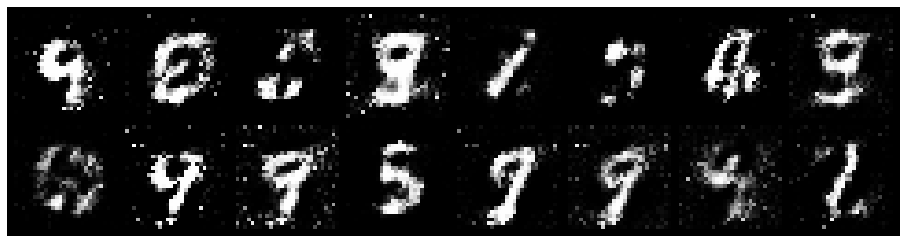

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7166, Generator Loss: 1.6722
D(x): 0.7191, D(G(z)): 0.2232


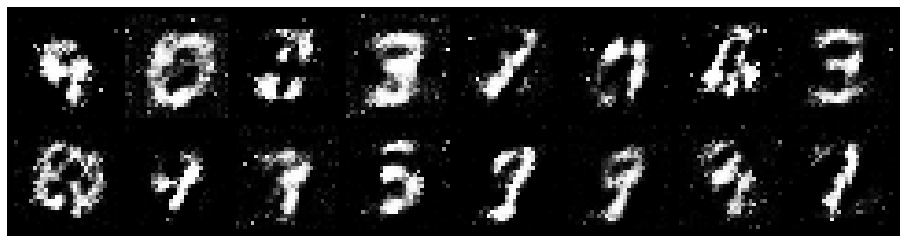

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.9696, Generator Loss: 1.3402
D(x): 0.7530, D(G(z)): 0.3847


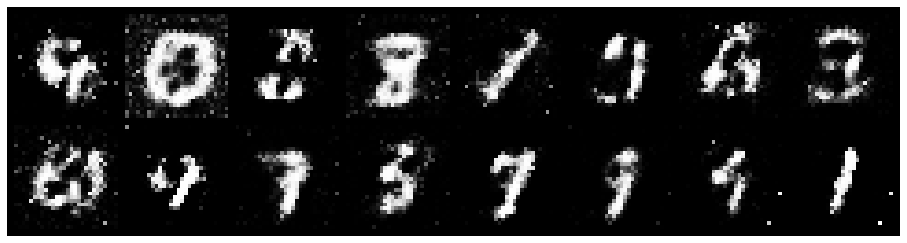

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 1.1179, Generator Loss: 1.5061
D(x): 0.5953, D(G(z)): 0.2905


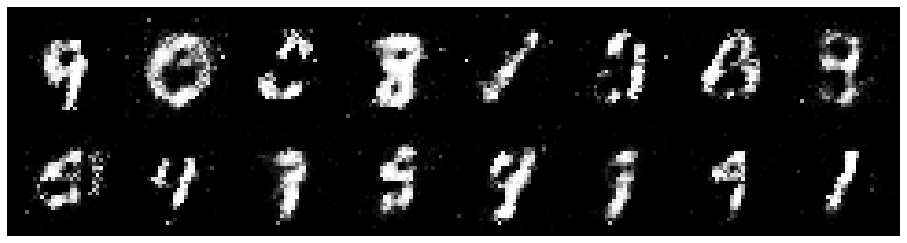

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 0.9359, Generator Loss: 1.5129
D(x): 0.7121, D(G(z)): 0.3199


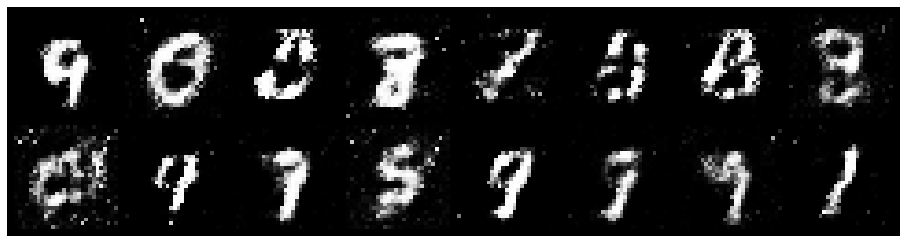

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 0.9204, Generator Loss: 1.4786
D(x): 0.7198, D(G(z)): 0.3415


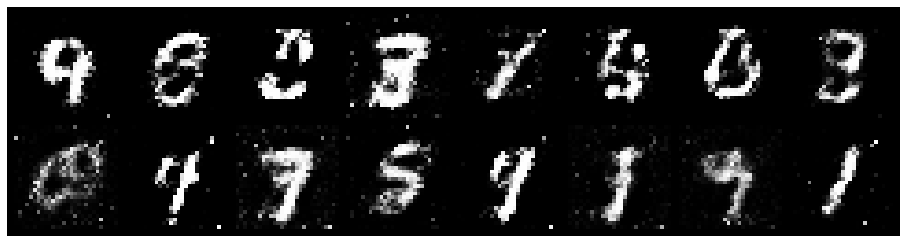

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.8301, Generator Loss: 1.5617
D(x): 0.6601, D(G(z)): 0.1986


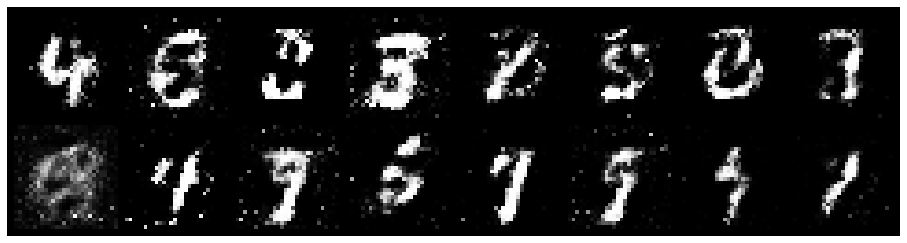

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.8691, Generator Loss: 1.3968
D(x): 0.7634, D(G(z)): 0.3491


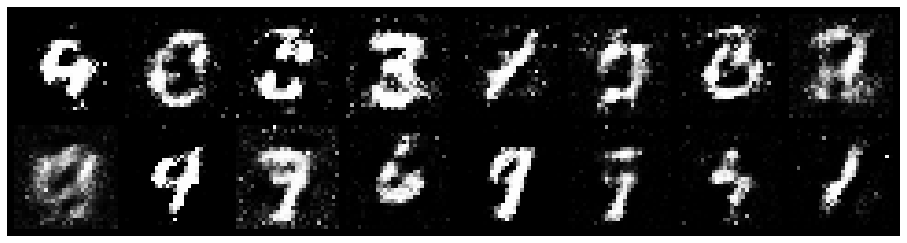

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 1.0752, Generator Loss: 1.5342
D(x): 0.6059, D(G(z)): 0.2994


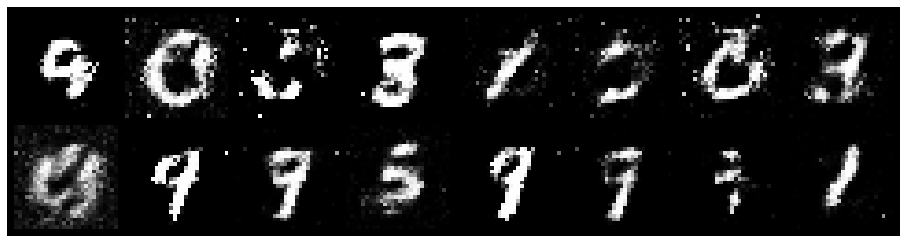

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.7180, Generator Loss: 1.9565
D(x): 0.7382, D(G(z)): 0.2276


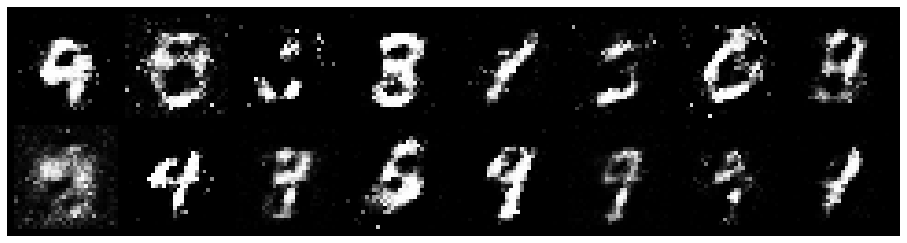

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.7827, Generator Loss: 2.0074
D(x): 0.7359, D(G(z)): 0.2503


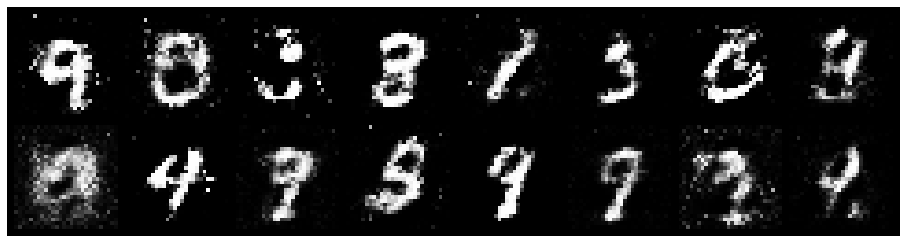

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.8796, Generator Loss: 1.7626
D(x): 0.7393, D(G(z)): 0.3374


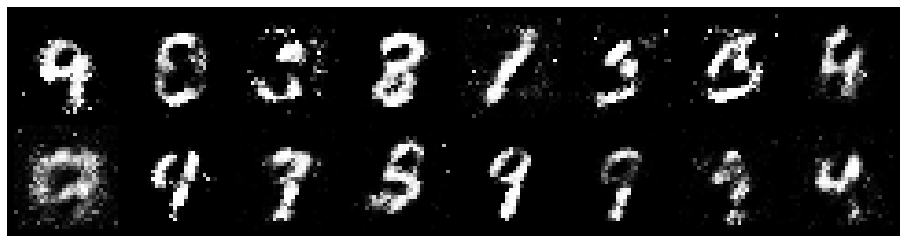

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.7615, Generator Loss: 1.7044
D(x): 0.7948, D(G(z)): 0.3332


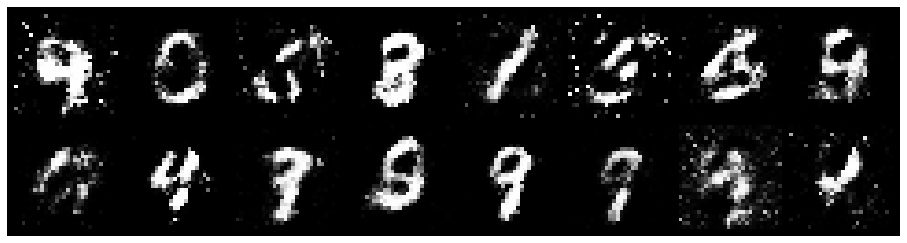

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.7836, Generator Loss: 1.5720
D(x): 0.7461, D(G(z)): 0.2907


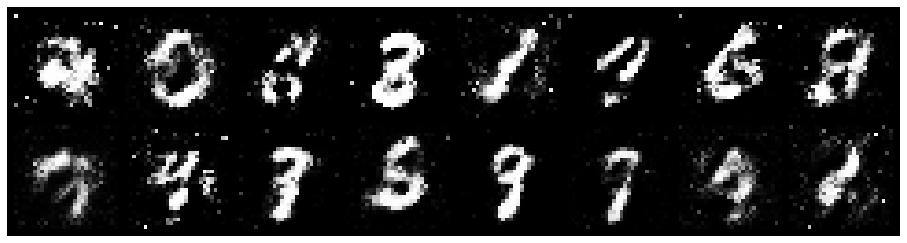

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.8850, Generator Loss: 1.4643
D(x): 0.7270, D(G(z)): 0.3330


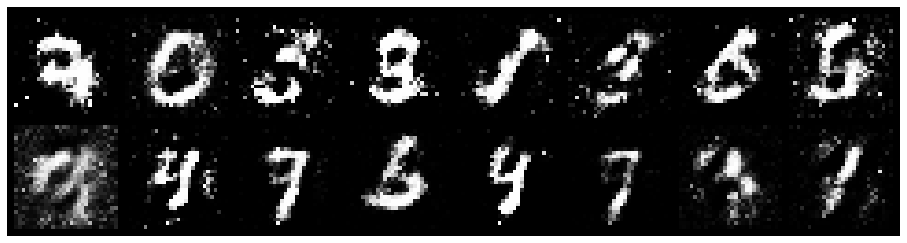

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.9621, Generator Loss: 1.2951
D(x): 0.6932, D(G(z)): 0.3445


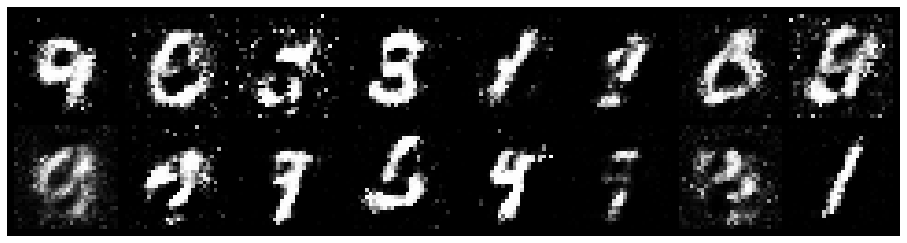

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.8504, Generator Loss: 1.5599
D(x): 0.7206, D(G(z)): 0.2509


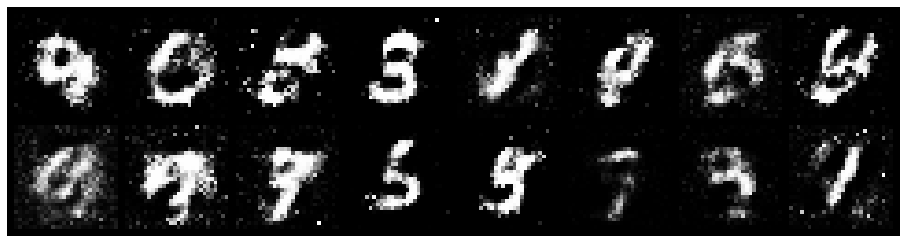

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 0.8945, Generator Loss: 1.4794
D(x): 0.7284, D(G(z)): 0.2994


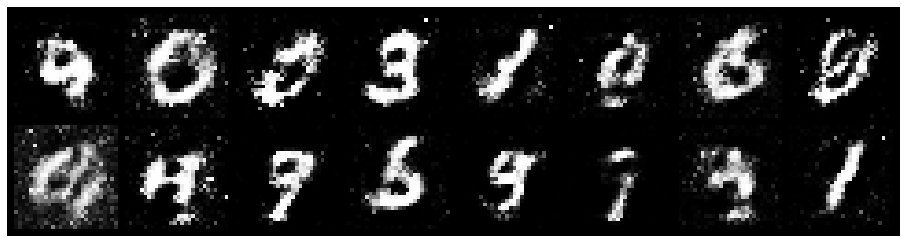

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 1.1421, Generator Loss: 1.6503
D(x): 0.6125, D(G(z)): 0.2891


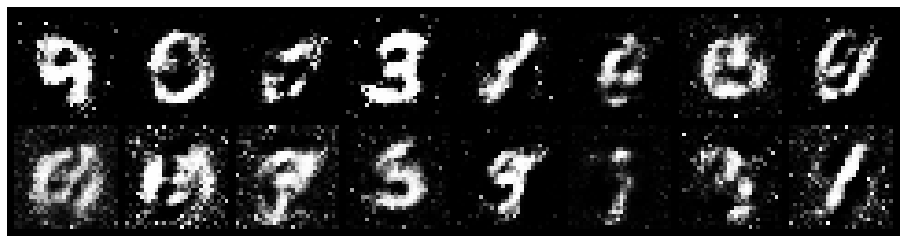

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 1.1219, Generator Loss: 1.1431
D(x): 0.6845, D(G(z)): 0.3652


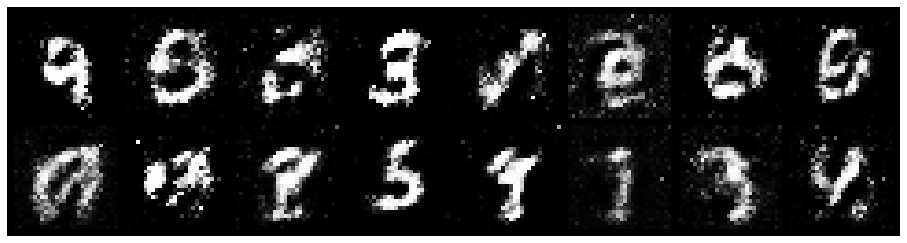

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.8182, Generator Loss: 2.0453
D(x): 0.7366, D(G(z)): 0.2668


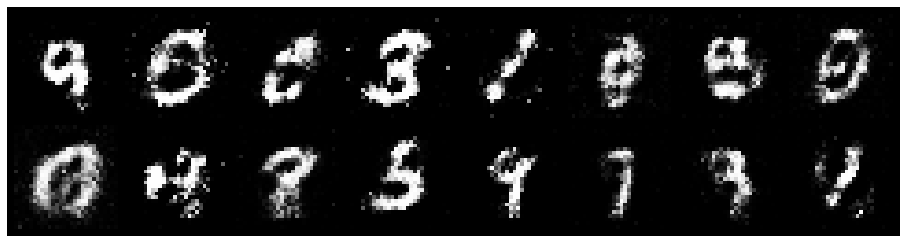

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.7322, Generator Loss: 1.5549
D(x): 0.7502, D(G(z)): 0.2765


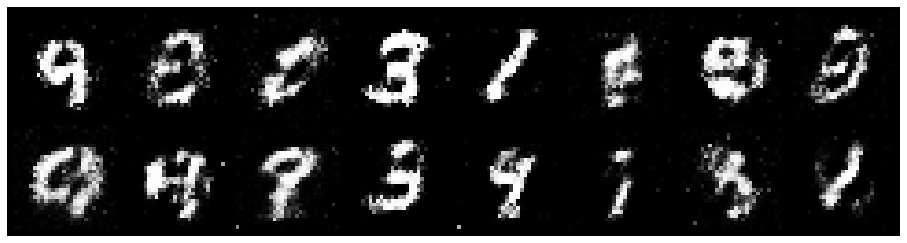

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.8011, Generator Loss: 1.6251
D(x): 0.7145, D(G(z)): 0.2637


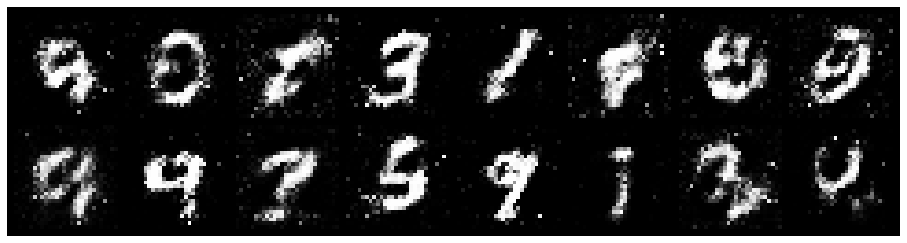

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 1.0616, Generator Loss: 1.3200
D(x): 0.6159, D(G(z)): 0.3275


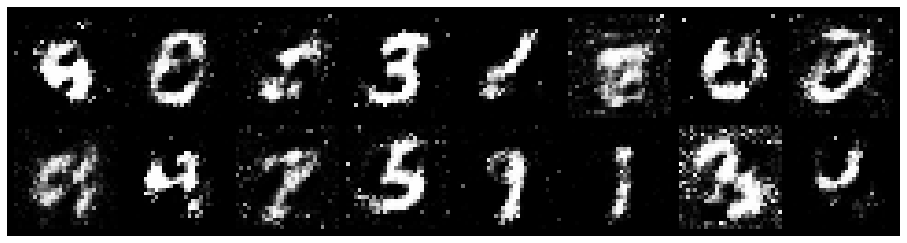

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.8130, Generator Loss: 1.5432
D(x): 0.7466, D(G(z)): 0.3065


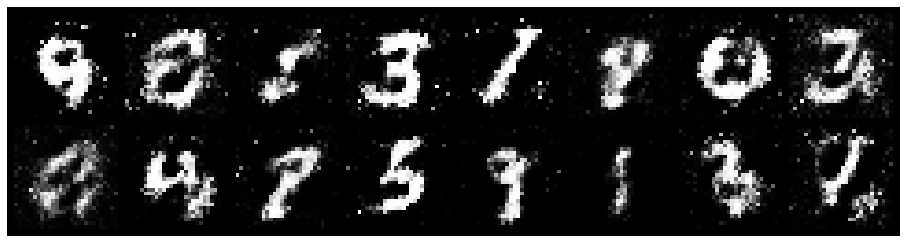

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.7668, Generator Loss: 1.7296
D(x): 0.7753, D(G(z)): 0.2985


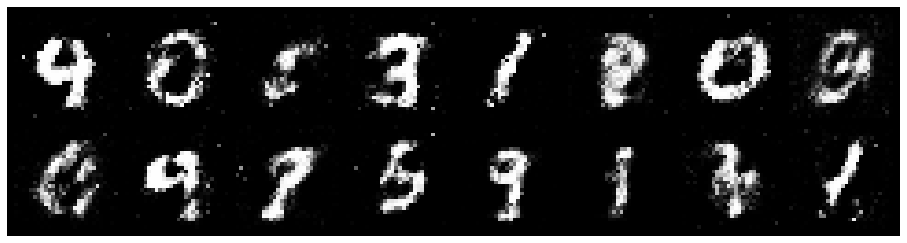

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.8666, Generator Loss: 1.3485
D(x): 0.7070, D(G(z)): 0.3003


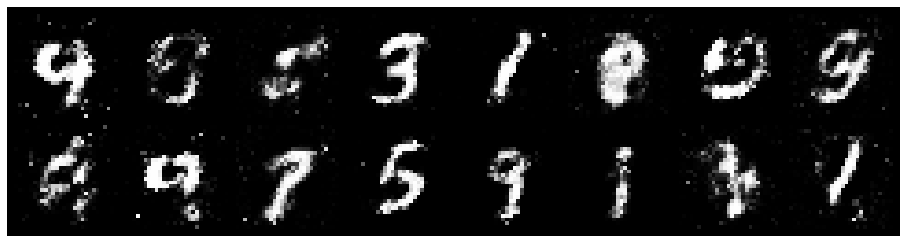

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 0.9332, Generator Loss: 1.4607
D(x): 0.7346, D(G(z)): 0.3538


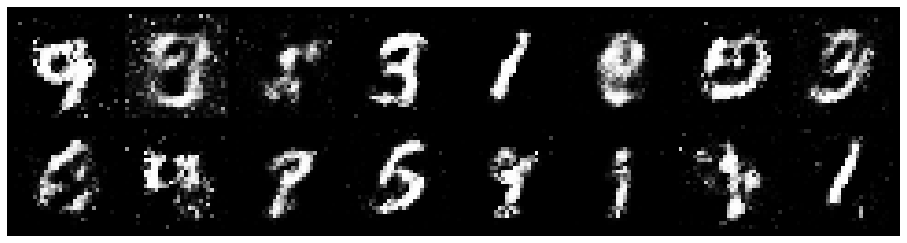

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.9719, Generator Loss: 1.4526
D(x): 0.7373, D(G(z)): 0.3800


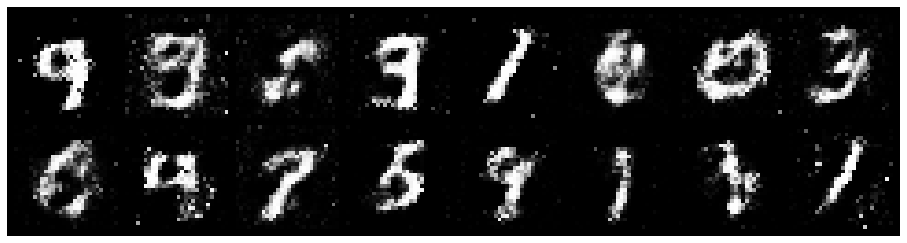

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.7857, Generator Loss: 1.7108
D(x): 0.7817, D(G(z)): 0.3229


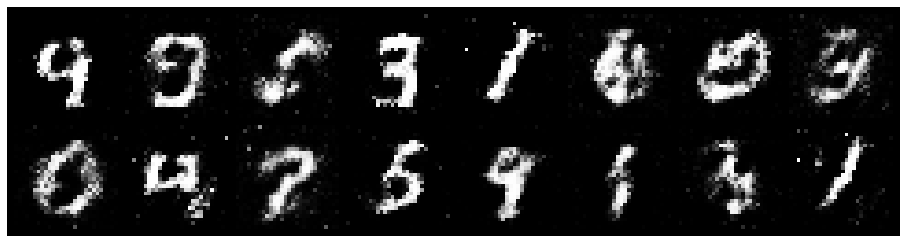

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.9995, Generator Loss: 1.4049
D(x): 0.7028, D(G(z)): 0.3446


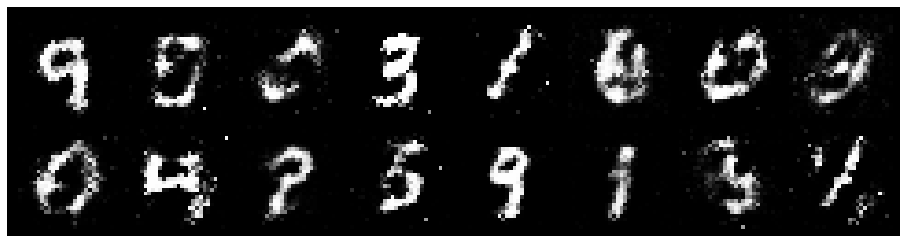

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9165, Generator Loss: 1.2142
D(x): 0.6956, D(G(z)): 0.3172


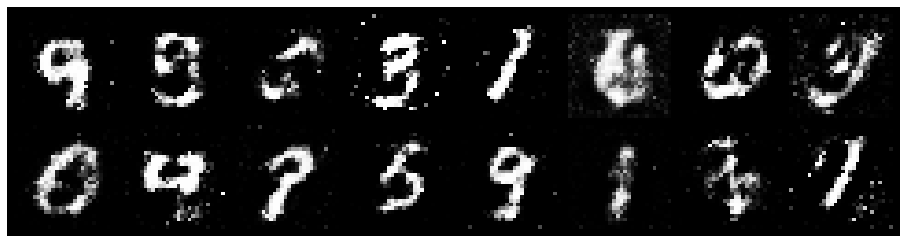

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8660, Generator Loss: 1.3885
D(x): 0.6852, D(G(z)): 0.3144


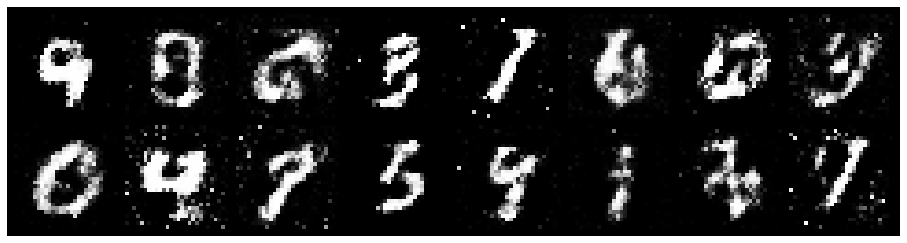

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 1.0376, Generator Loss: 1.2384
D(x): 0.7774, D(G(z)): 0.4181


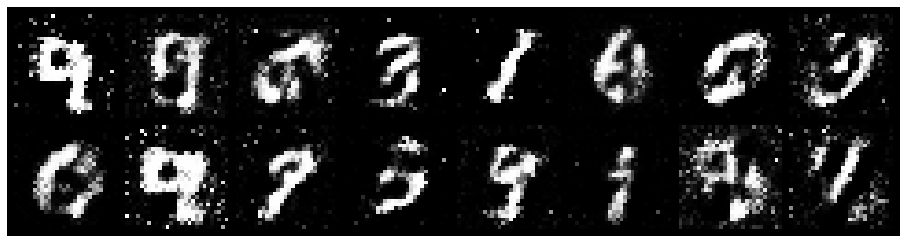

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 1.0439, Generator Loss: 1.6185
D(x): 0.6969, D(G(z)): 0.3077


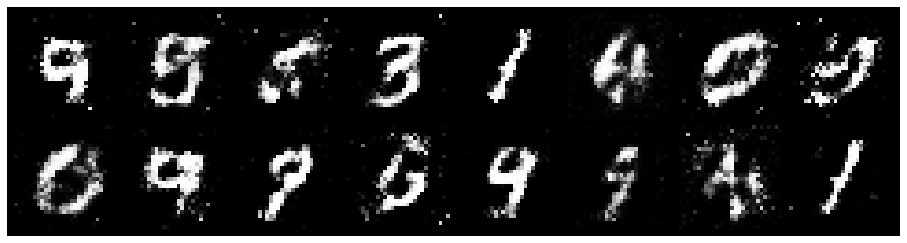

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.8875, Generator Loss: 1.5991
D(x): 0.7326, D(G(z)): 0.2971


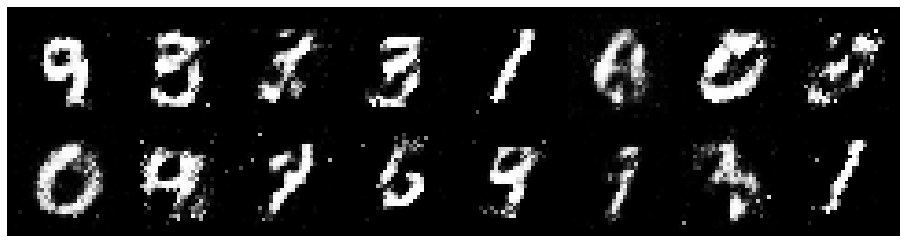

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.8794, Generator Loss: 1.6040
D(x): 0.6532, D(G(z)): 0.2698


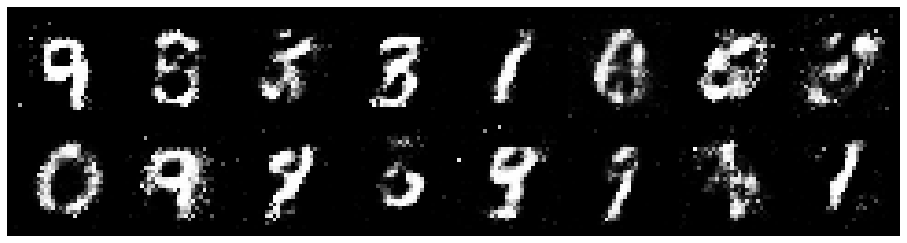

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 1.2007, Generator Loss: 1.5411
D(x): 0.5851, D(G(z)): 0.3278


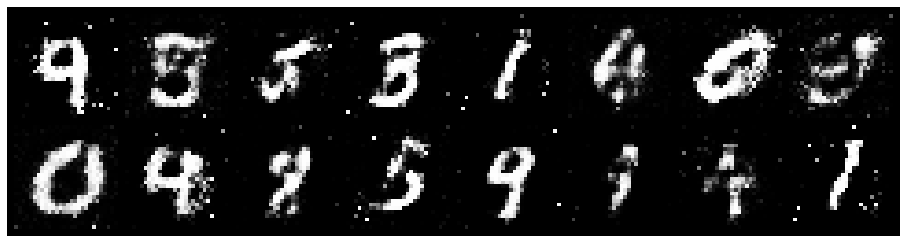

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.1892, Generator Loss: 1.2117
D(x): 0.6156, D(G(z)): 0.3785


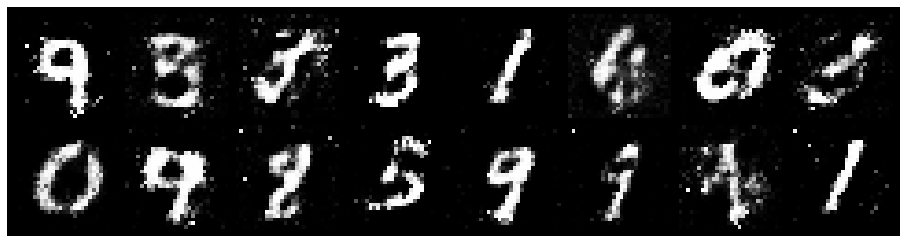

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 1.0753, Generator Loss: 1.2981
D(x): 0.6638, D(G(z)): 0.3706


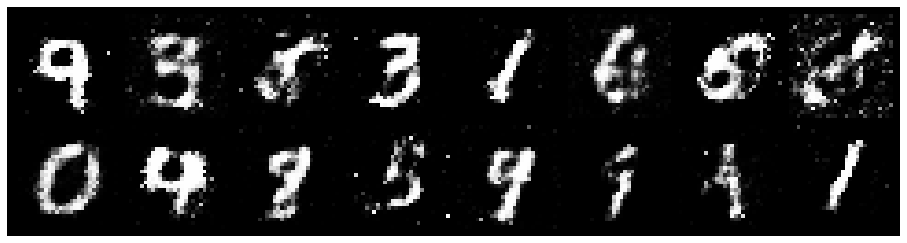

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 0.9993, Generator Loss: 1.2153
D(x): 0.6934, D(G(z)): 0.3360


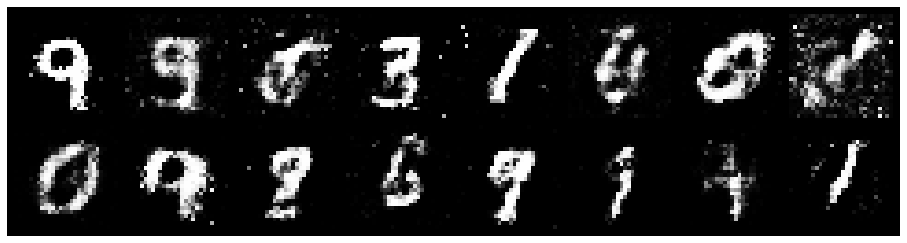

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 1.2241, Generator Loss: 1.4247
D(x): 0.5932, D(G(z)): 0.3418


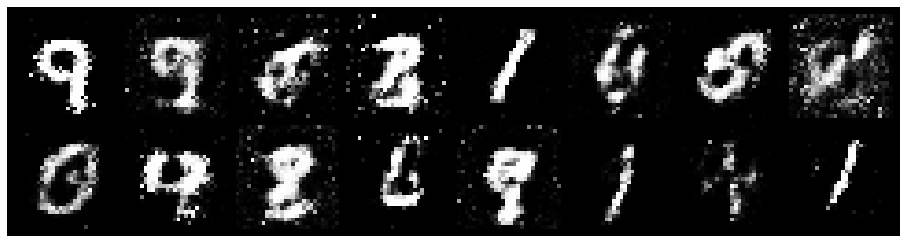

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 0.8717, Generator Loss: 1.4249
D(x): 0.7144, D(G(z)): 0.3251


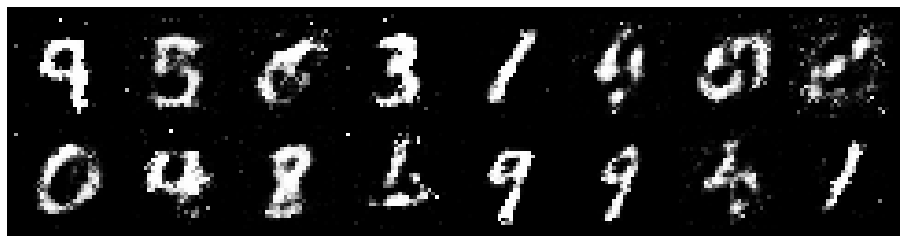

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.8747, Generator Loss: 1.3130
D(x): 0.7703, D(G(z)): 0.3416


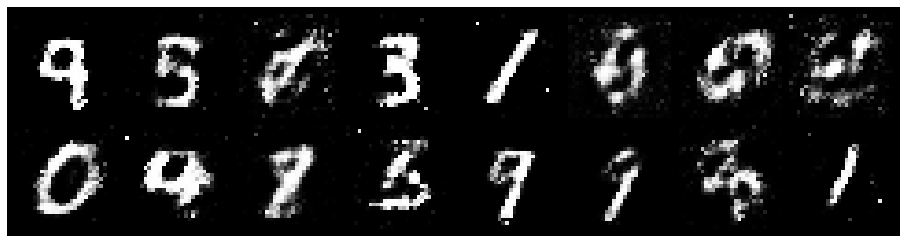

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 0.9053, Generator Loss: 1.5996
D(x): 0.7262, D(G(z)): 0.3255


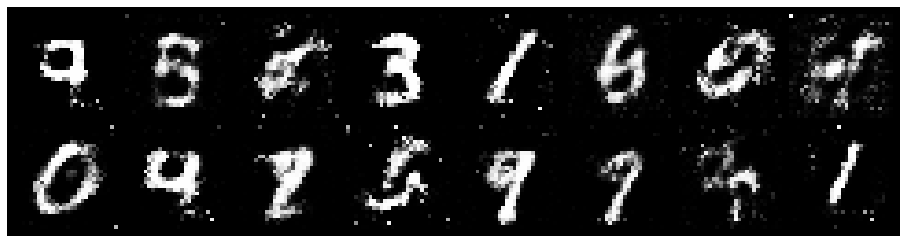

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0451, Generator Loss: 1.1552
D(x): 0.6714, D(G(z)): 0.3549


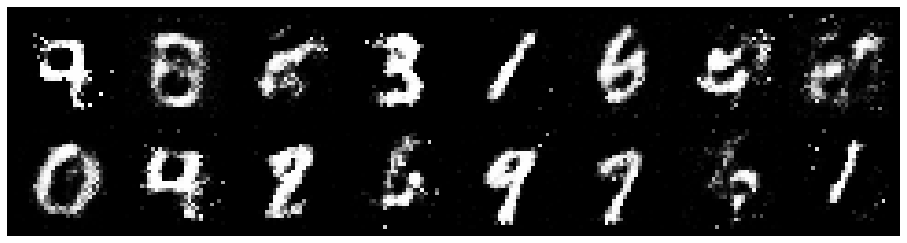

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 0.9036, Generator Loss: 1.4568
D(x): 0.6598, D(G(z)): 0.2771


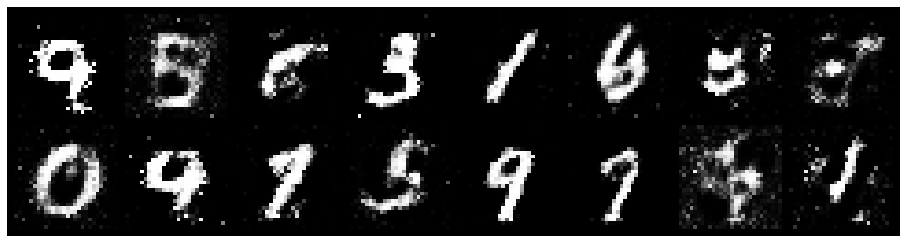

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 0.8873, Generator Loss: 1.4450
D(x): 0.7297, D(G(z)): 0.3378


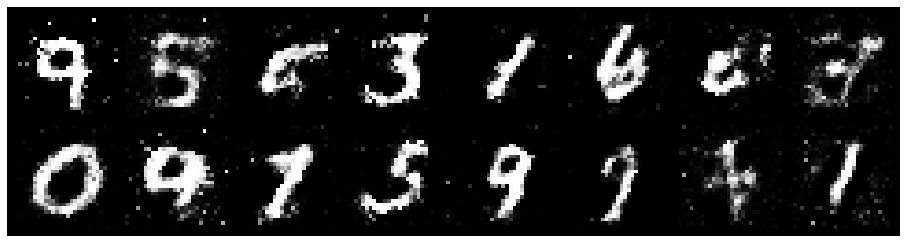

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 0.9932, Generator Loss: 1.1173
D(x): 0.6584, D(G(z)): 0.3699


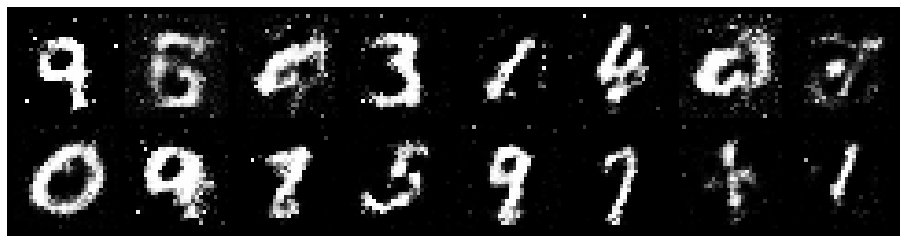

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 1.0382, Generator Loss: 1.2497
D(x): 0.6744, D(G(z)): 0.3593


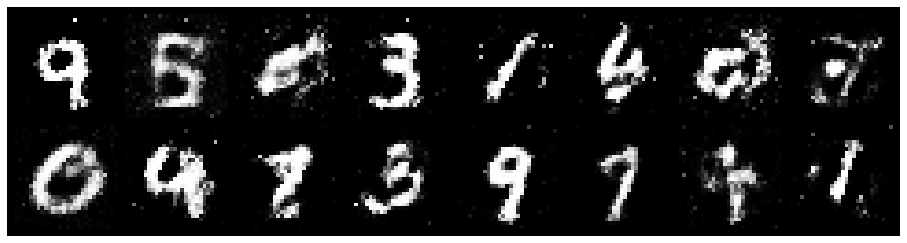

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 1.1262, Generator Loss: 1.3731
D(x): 0.6969, D(G(z)): 0.3987


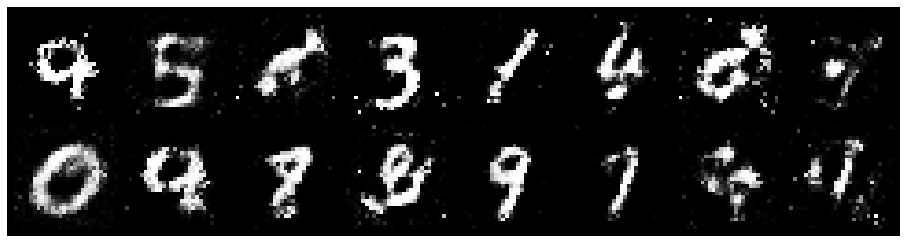

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 0.9538, Generator Loss: 1.3946
D(x): 0.6676, D(G(z)): 0.3317


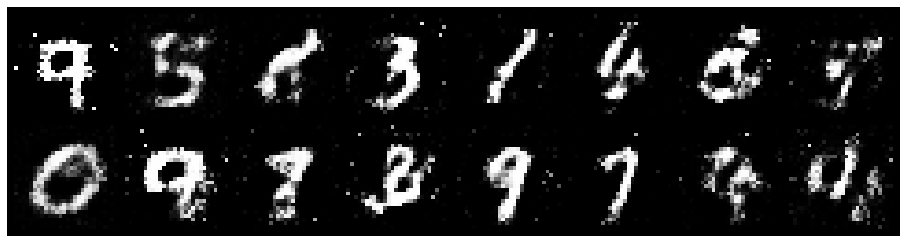

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0783, Generator Loss: 1.2978
D(x): 0.5900, D(G(z)): 0.3187


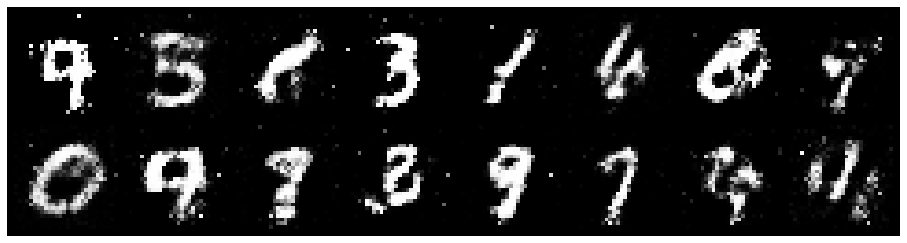

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 1.1006, Generator Loss: 1.1586
D(x): 0.6825, D(G(z)): 0.4254


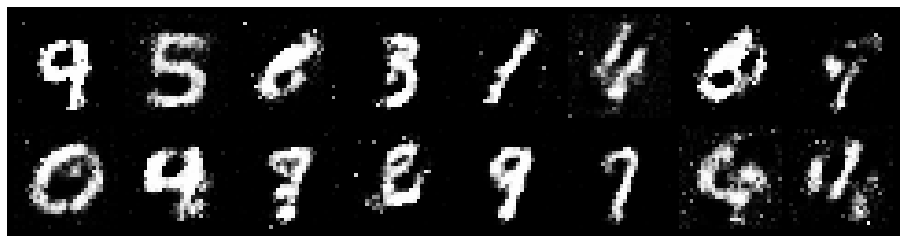

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.0259, Generator Loss: 0.8998
D(x): 0.6995, D(G(z)): 0.4082


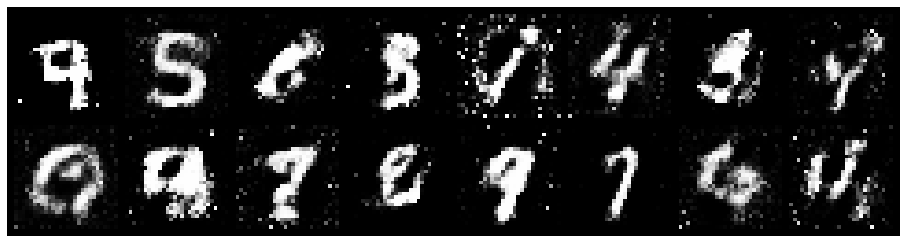

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 1.2259, Generator Loss: 1.1264
D(x): 0.6263, D(G(z)): 0.3977


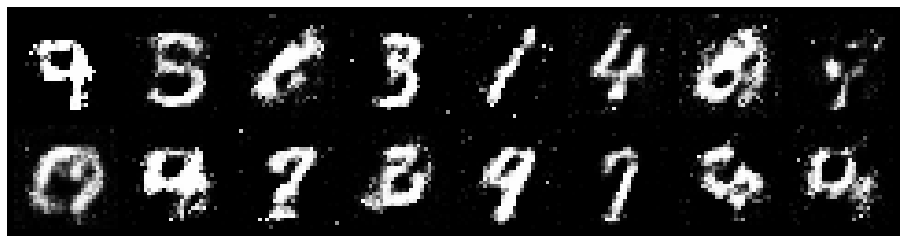

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 0.9051, Generator Loss: 1.1257
D(x): 0.6693, D(G(z)): 0.3059


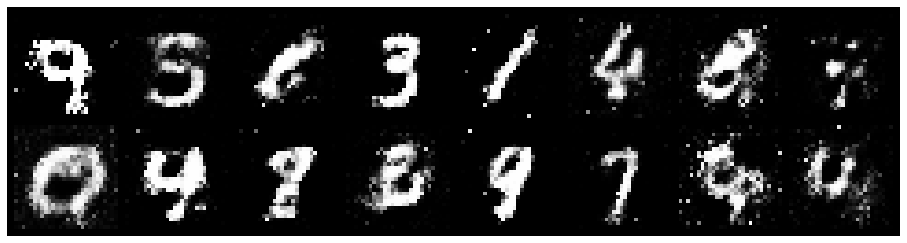

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.8841, Generator Loss: 1.2346
D(x): 0.7407, D(G(z)): 0.3553


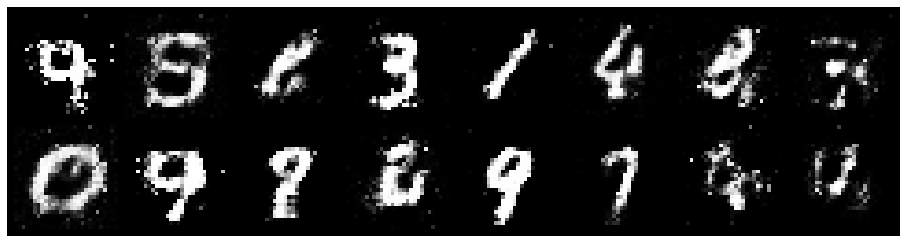

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.7004, Generator Loss: 1.3652
D(x): 0.7871, D(G(z)): 0.3037


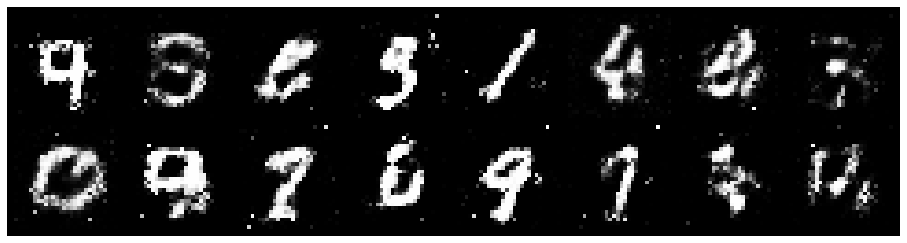

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 0.8618, Generator Loss: 1.4804
D(x): 0.6859, D(G(z)): 0.2944


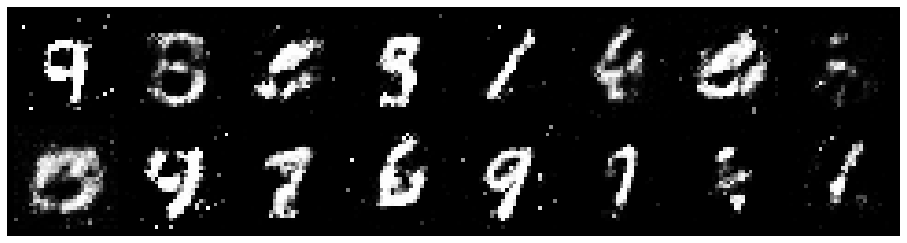

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.8991, Generator Loss: 1.7816
D(x): 0.7562, D(G(z)): 0.3446


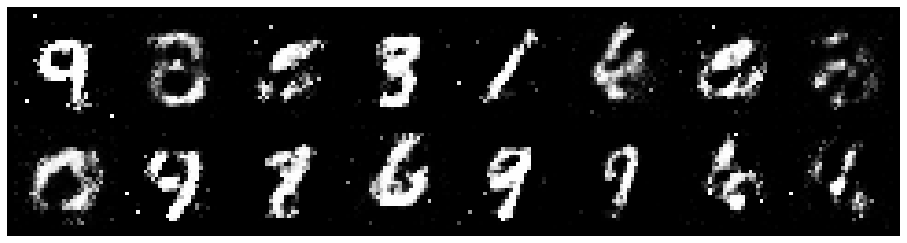

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 1.0920, Generator Loss: 1.5367
D(x): 0.6292, D(G(z)): 0.3073


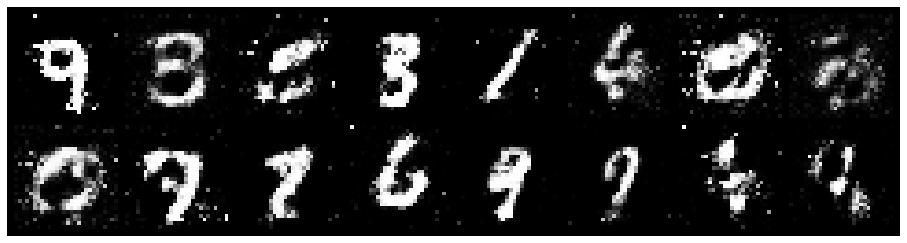

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.8468, Generator Loss: 1.5595
D(x): 0.7184, D(G(z)): 0.2960


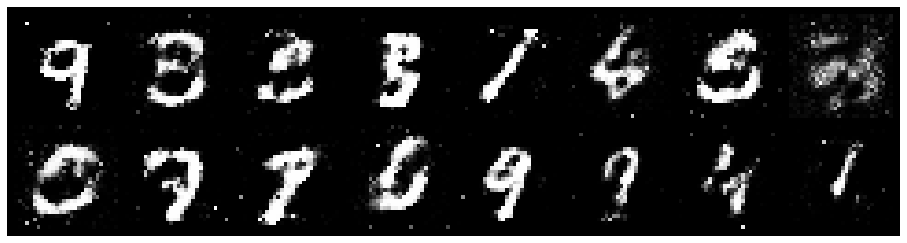

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.0359, Generator Loss: 1.3465
D(x): 0.6391, D(G(z)): 0.3302


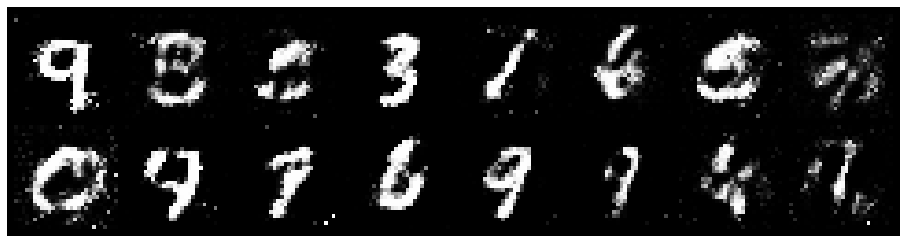

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.9188, Generator Loss: 1.4396
D(x): 0.6950, D(G(z)): 0.3181


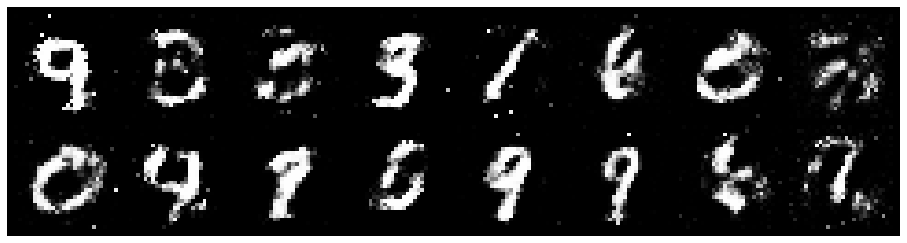

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.7604, Generator Loss: 2.0980
D(x): 0.7244, D(G(z)): 0.2391


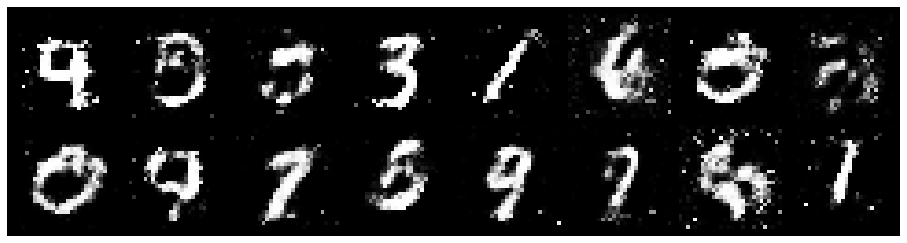

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 0.8309, Generator Loss: 1.5845
D(x): 0.7048, D(G(z)): 0.2856


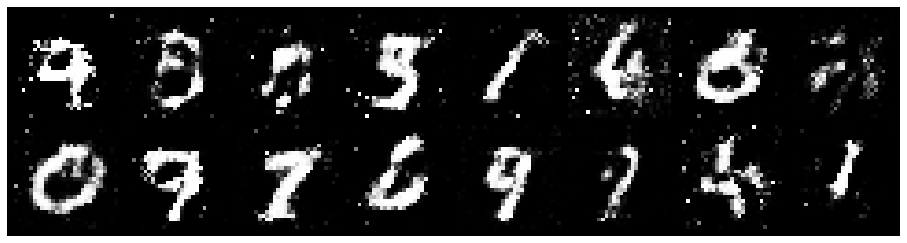

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.1045, Generator Loss: 1.3529
D(x): 0.5902, D(G(z)): 0.3157


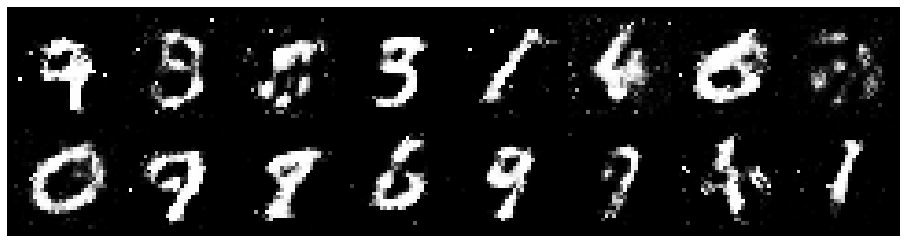

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.1900, Generator Loss: 1.0645
D(x): 0.6567, D(G(z)): 0.4063


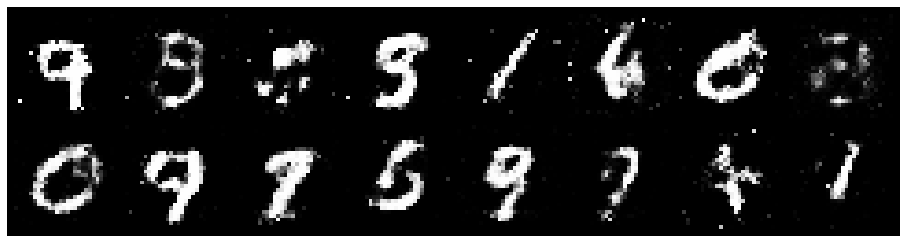

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.9972, Generator Loss: 1.4467
D(x): 0.6218, D(G(z)): 0.2901


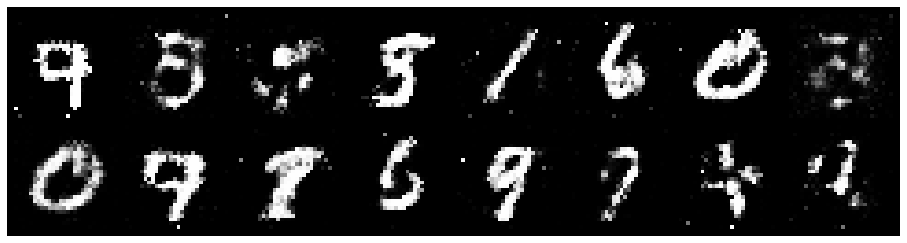

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 1.3081, Generator Loss: 1.6056
D(x): 0.5734, D(G(z)): 0.3760


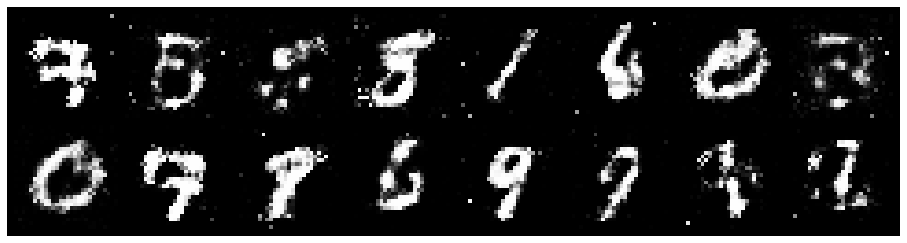

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 1.1108, Generator Loss: 1.3153
D(x): 0.6336, D(G(z)): 0.3690


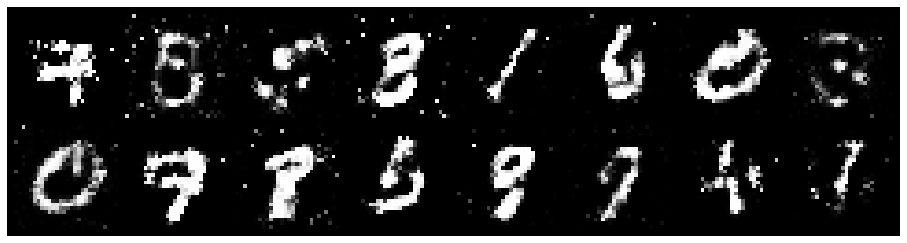

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.0510, Generator Loss: 1.0114
D(x): 0.6415, D(G(z)): 0.3818


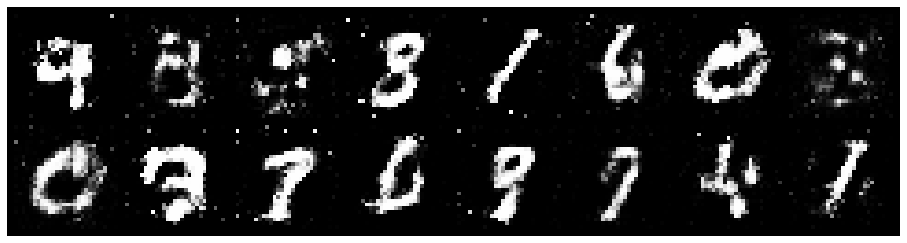

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.9443, Generator Loss: 1.1351
D(x): 0.6459, D(G(z)): 0.3224


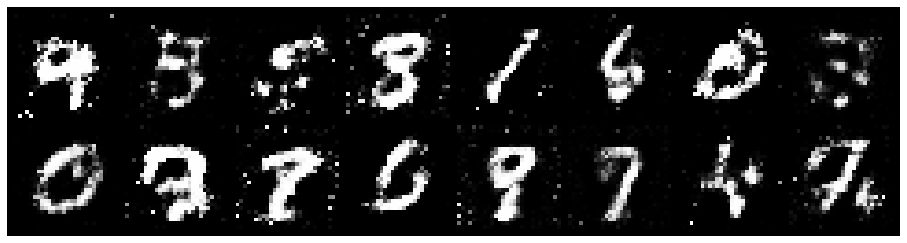

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.1309, Generator Loss: 1.2712
D(x): 0.6339, D(G(z)): 0.3863


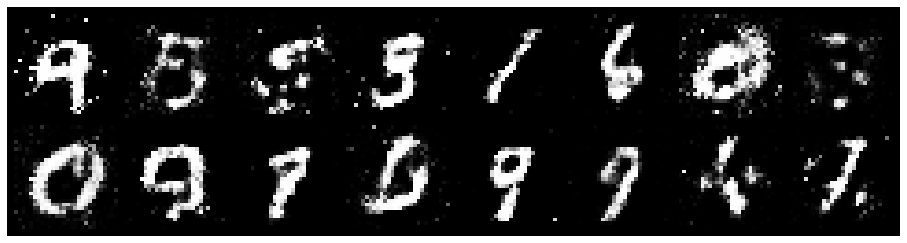

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.1449, Generator Loss: 1.6336
D(x): 0.6024, D(G(z)): 0.3226


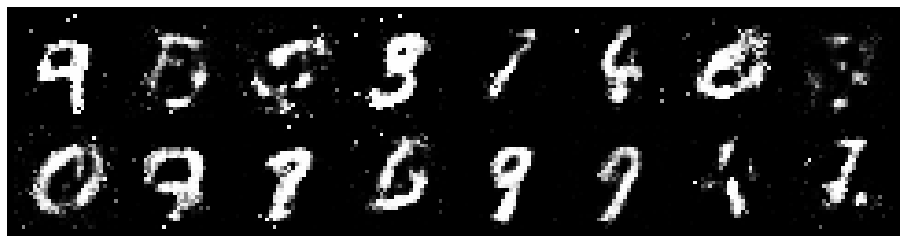

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 0.9188, Generator Loss: 1.5087
D(x): 0.6874, D(G(z)): 0.3063


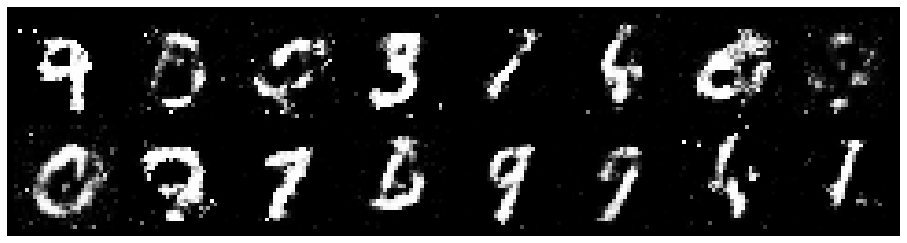

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 0.8990, Generator Loss: 1.7308
D(x): 0.6577, D(G(z)): 0.2432


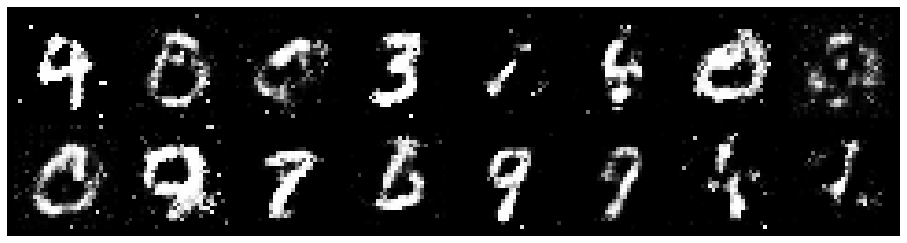

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0118, Generator Loss: 1.5335
D(x): 0.6939, D(G(z)): 0.3524


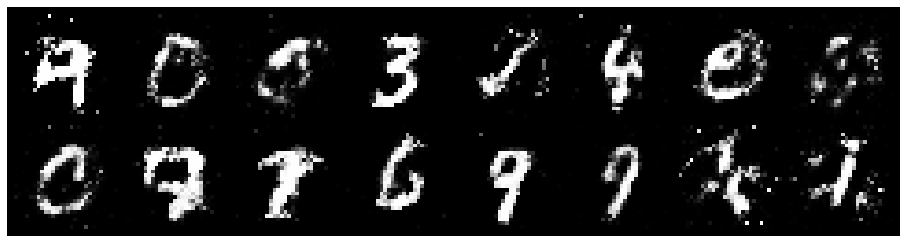

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 1.0372, Generator Loss: 1.4278
D(x): 0.6090, D(G(z)): 0.3026


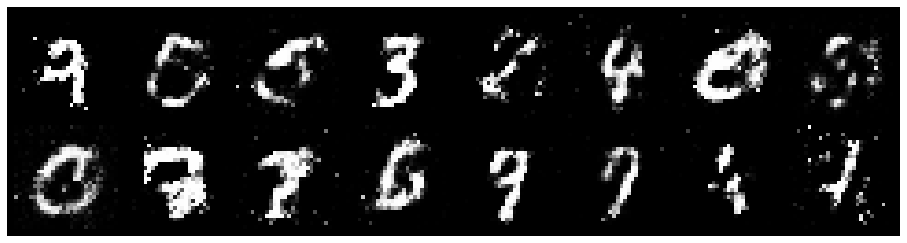

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 1.1702, Generator Loss: 1.6267
D(x): 0.5975, D(G(z)): 0.3395


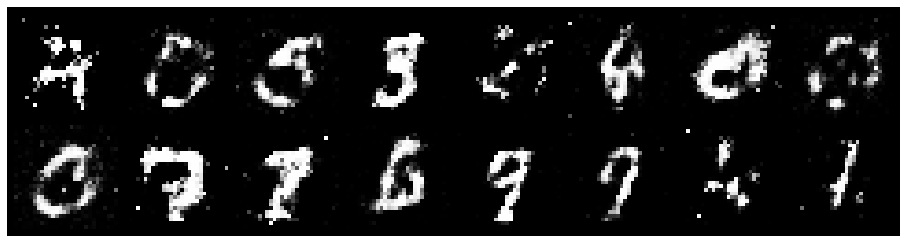

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 0.9054, Generator Loss: 1.2486
D(x): 0.6894, D(G(z)): 0.3351


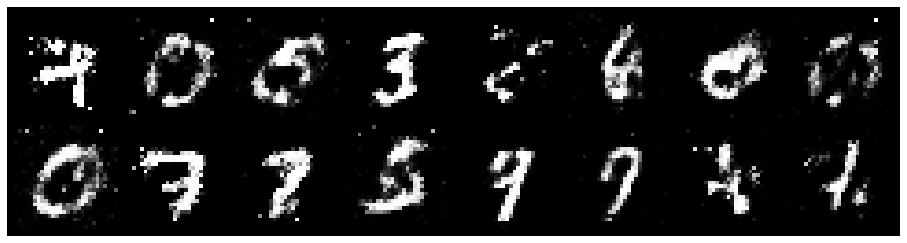

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.0588, Generator Loss: 1.0760
D(x): 0.6505, D(G(z)): 0.3800


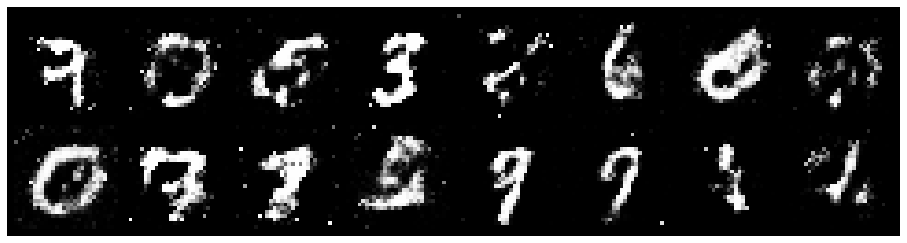

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.1825, Generator Loss: 0.9958
D(x): 0.6234, D(G(z)): 0.4273


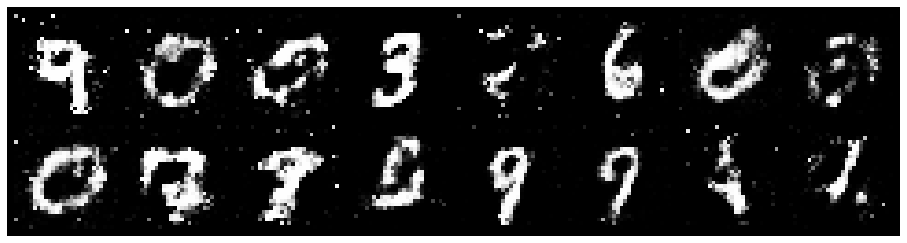

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 0.9921, Generator Loss: 1.2407
D(x): 0.6843, D(G(z)): 0.3418


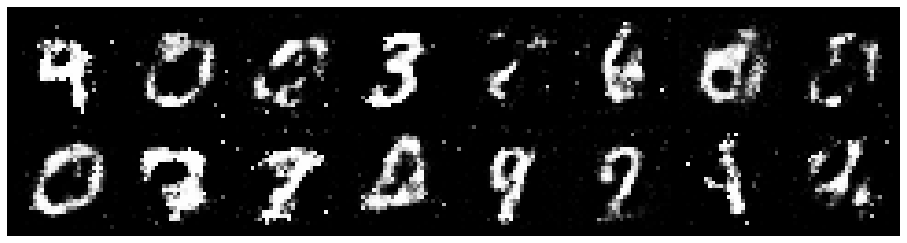

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0094, Generator Loss: 1.1348
D(x): 0.6778, D(G(z)): 0.3464


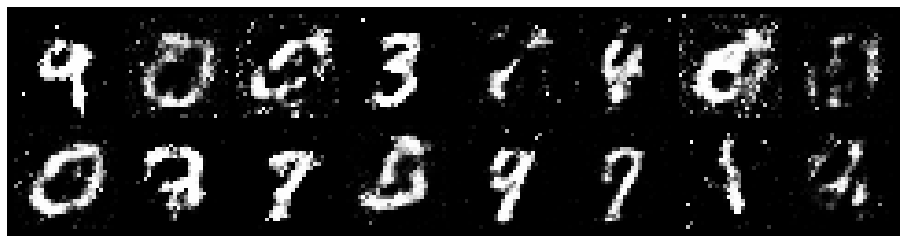

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.1682, Generator Loss: 1.2231
D(x): 0.6240, D(G(z)): 0.3775


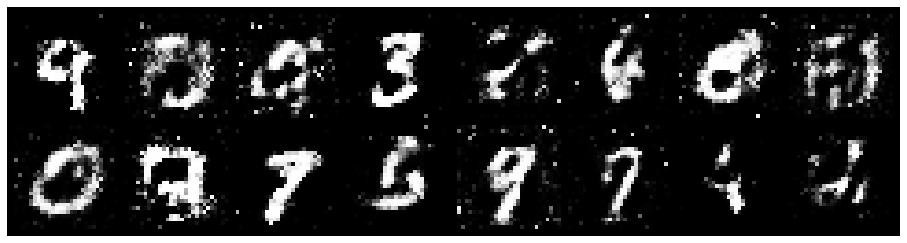

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.1655, Generator Loss: 1.0096
D(x): 0.6012, D(G(z)): 0.4074


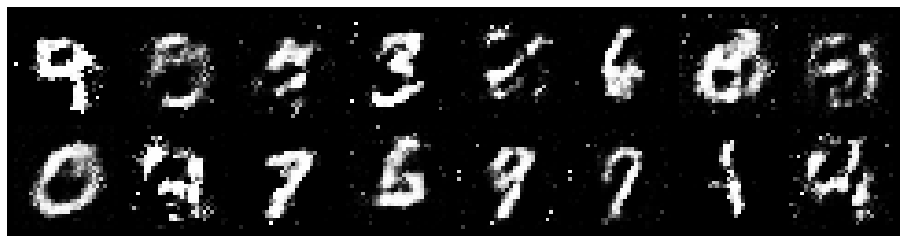

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 1.1639, Generator Loss: 1.0050
D(x): 0.5951, D(G(z)): 0.3920


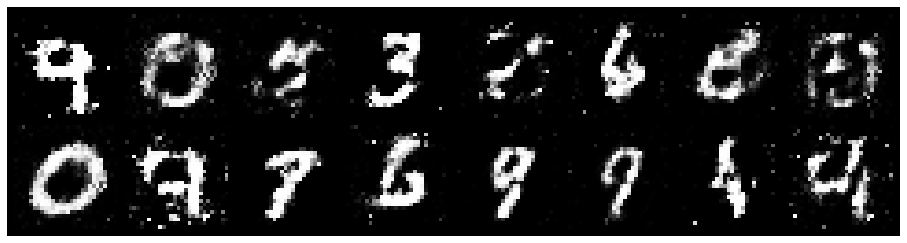

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 1.0267, Generator Loss: 1.6172
D(x): 0.6784, D(G(z)): 0.3515


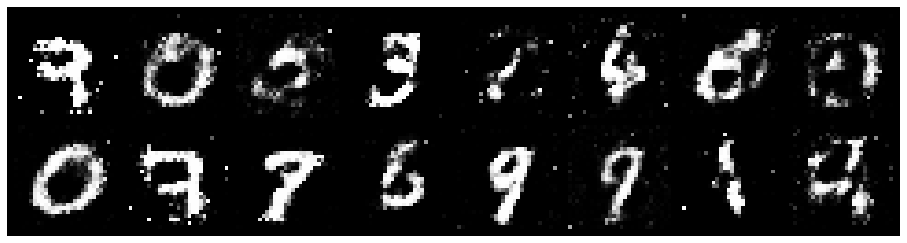

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 0.9491, Generator Loss: 1.1621
D(x): 0.6715, D(G(z)): 0.3371


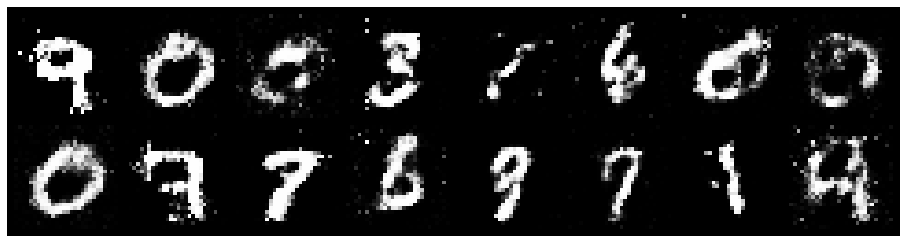

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 1.0050, Generator Loss: 1.3245
D(x): 0.6338, D(G(z)): 0.2989


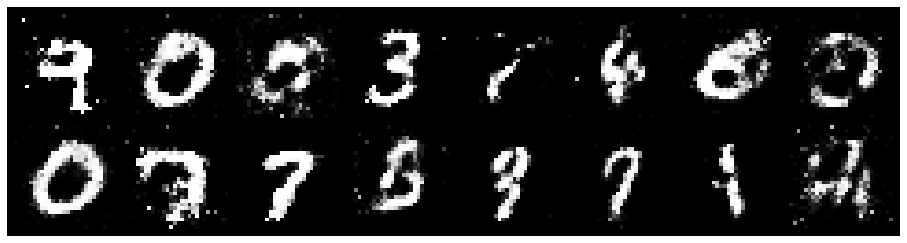

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.0768, Generator Loss: 1.1121
D(x): 0.6538, D(G(z)): 0.3658


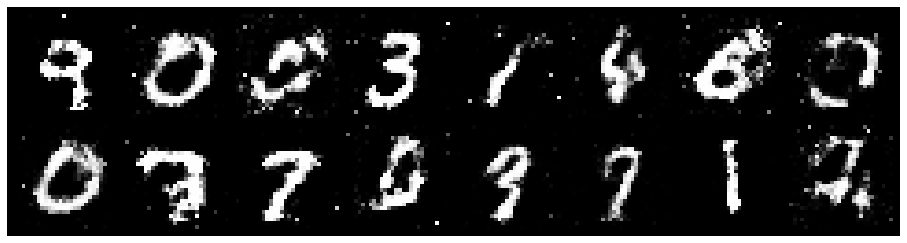

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0203, Generator Loss: 1.1223
D(x): 0.7044, D(G(z)): 0.3949


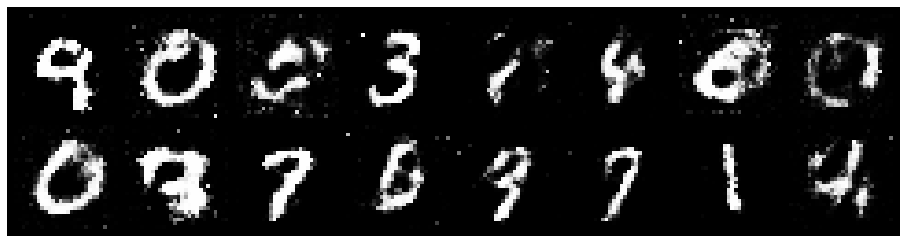

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 0.9917, Generator Loss: 1.2131
D(x): 0.6898, D(G(z)): 0.3720


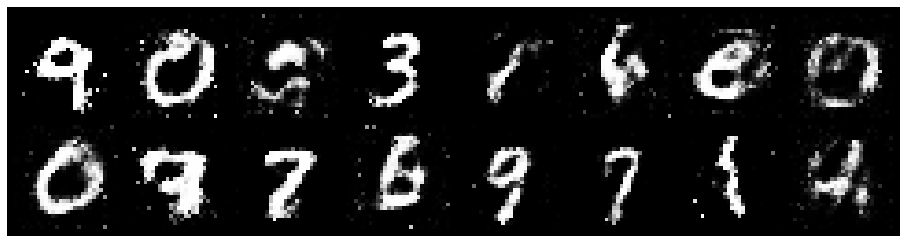

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 1.1169, Generator Loss: 1.0588
D(x): 0.6911, D(G(z)): 0.4253


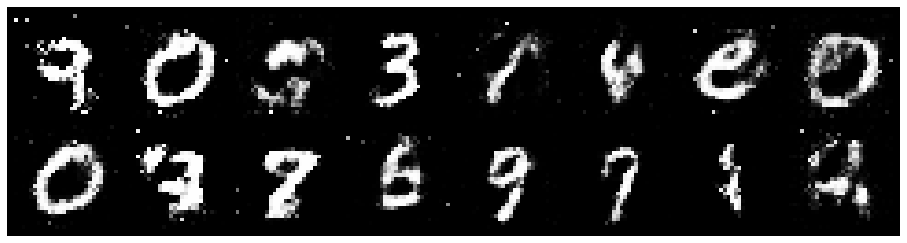

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.9897, Generator Loss: 1.3131
D(x): 0.6193, D(G(z)): 0.3120


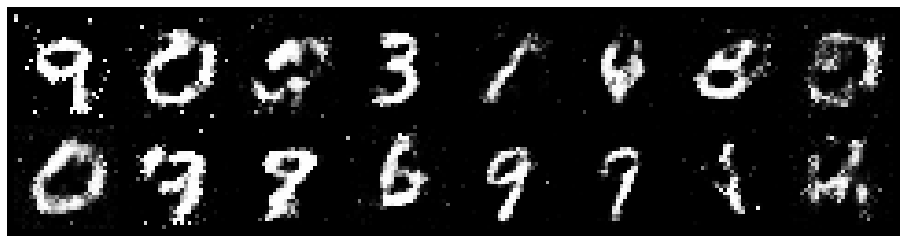

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.1091, Generator Loss: 1.1076
D(x): 0.6114, D(G(z)): 0.3838


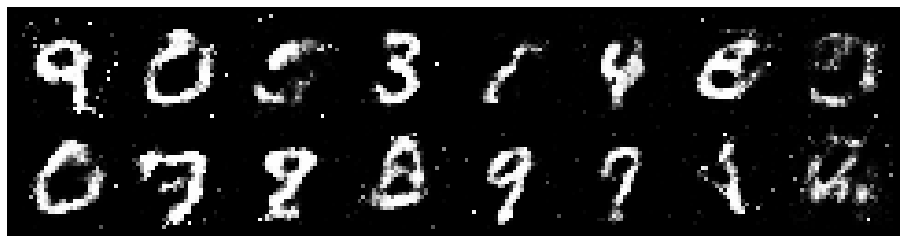

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 1.1023, Generator Loss: 1.1616
D(x): 0.5640, D(G(z)): 0.3292


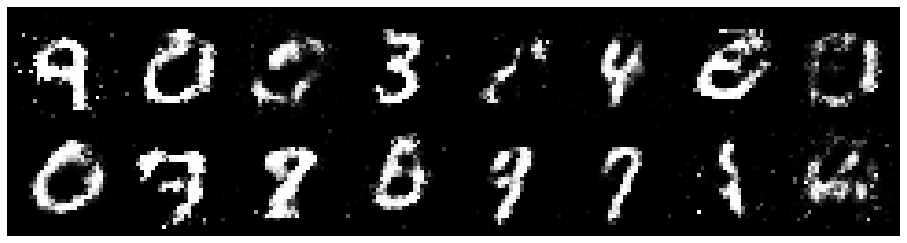

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 1.0010, Generator Loss: 1.1628
D(x): 0.6132, D(G(z)): 0.3242


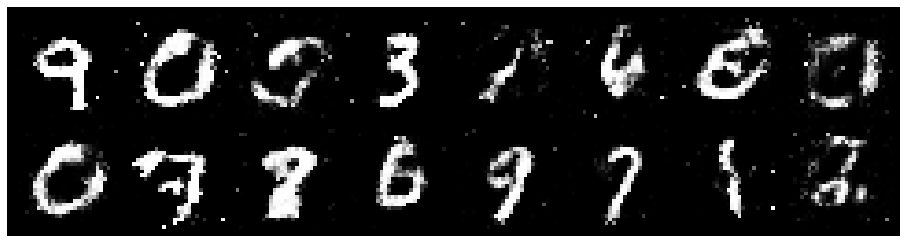

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.0827, Generator Loss: 1.1944
D(x): 0.6742, D(G(z)): 0.4113


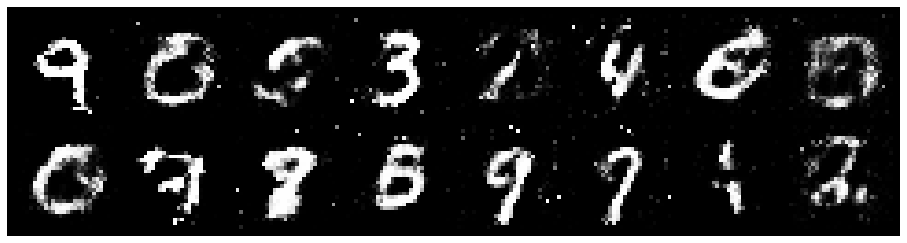

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 1.1007, Generator Loss: 1.0842
D(x): 0.6143, D(G(z)): 0.3763


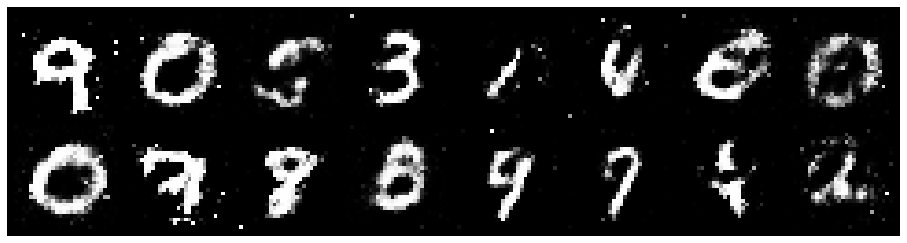

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.1277, Generator Loss: 1.0345
D(x): 0.6361, D(G(z)): 0.4080


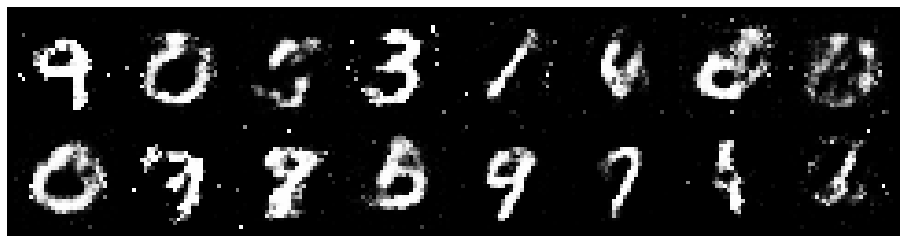

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.1466, Generator Loss: 1.0516
D(x): 0.6091, D(G(z)): 0.4083


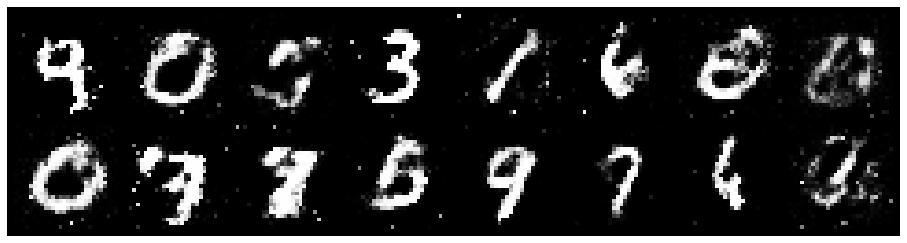

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.0539, Generator Loss: 0.9587
D(x): 0.6122, D(G(z)): 0.3327


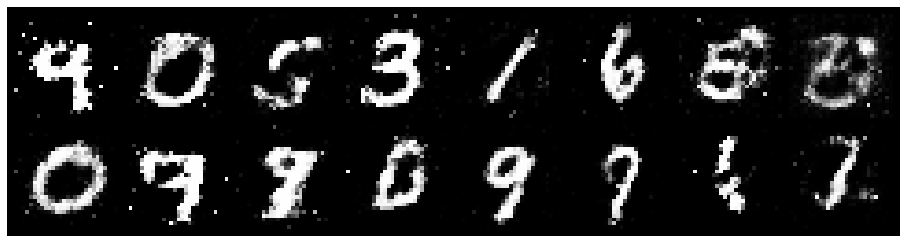

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.0207, Generator Loss: 1.2963
D(x): 0.6317, D(G(z)): 0.3354


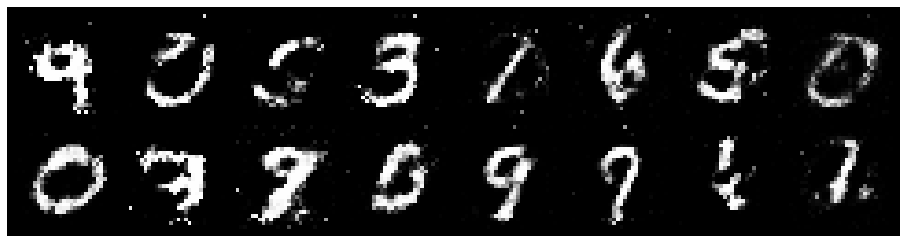

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0837, Generator Loss: 1.3994
D(x): 0.5636, D(G(z)): 0.2798


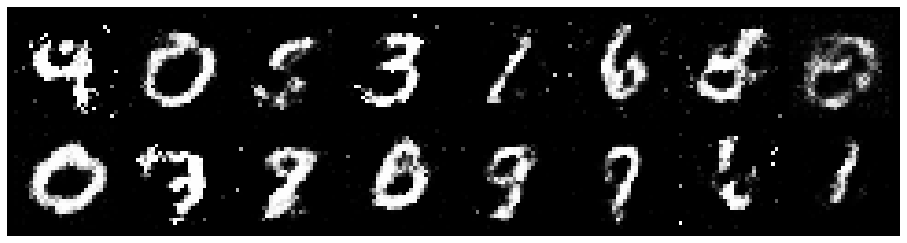

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.1031, Generator Loss: 1.3500
D(x): 0.6375, D(G(z)): 0.3551


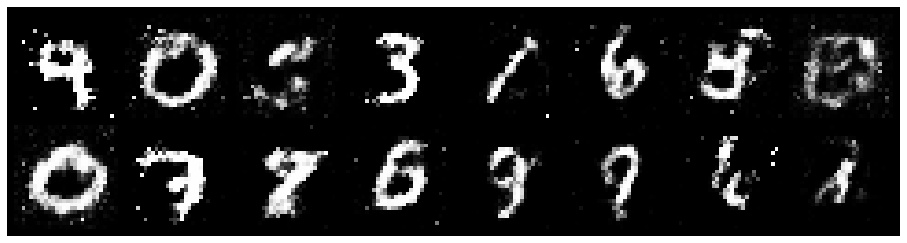

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0235, Generator Loss: 1.2315
D(x): 0.6397, D(G(z)): 0.3424


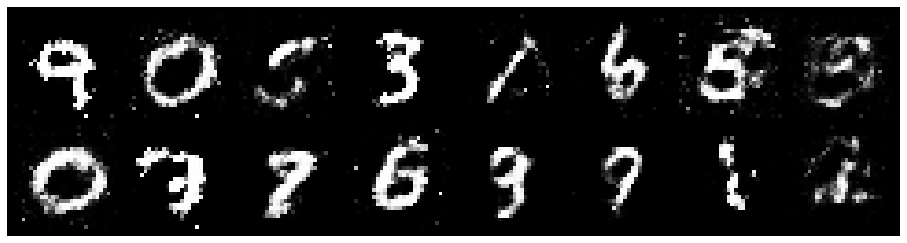

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0527, Generator Loss: 1.1350
D(x): 0.6442, D(G(z)): 0.3788


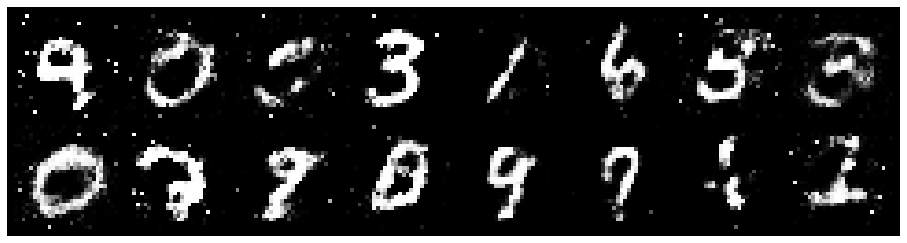

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 1.2143, Generator Loss: 1.1440
D(x): 0.5690, D(G(z)): 0.3681


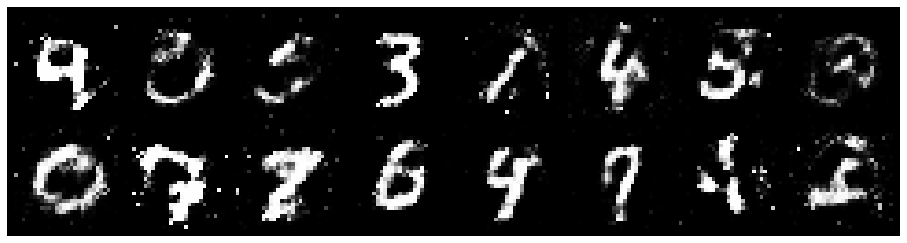

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 1.0506, Generator Loss: 1.3830
D(x): 0.6660, D(G(z)): 0.3857


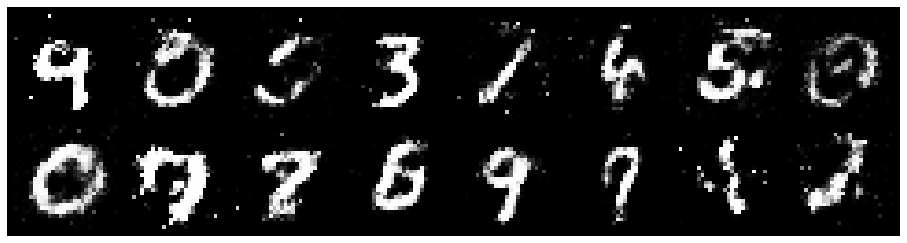

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 1.0391, Generator Loss: 1.2409
D(x): 0.6178, D(G(z)): 0.3408


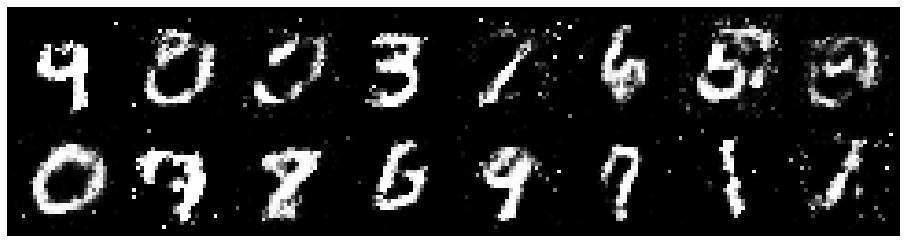

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.0301, Generator Loss: 1.2375
D(x): 0.6095, D(G(z)): 0.3494


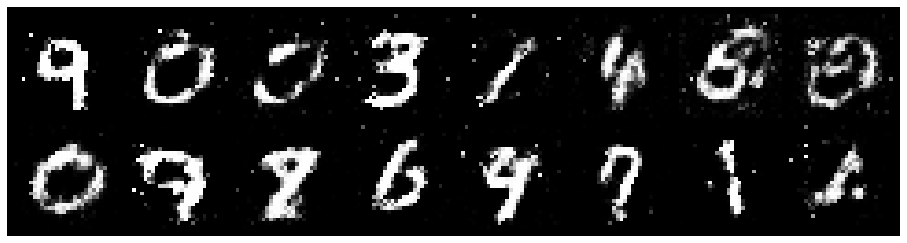

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1647, Generator Loss: 1.0743
D(x): 0.5350, D(G(z)): 0.3563


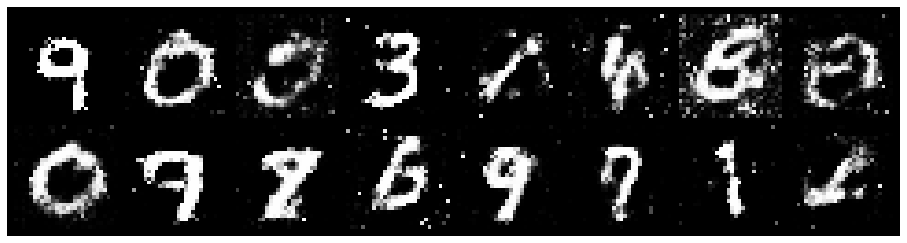

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.1616, Generator Loss: 1.1709
D(x): 0.5879, D(G(z)): 0.3660


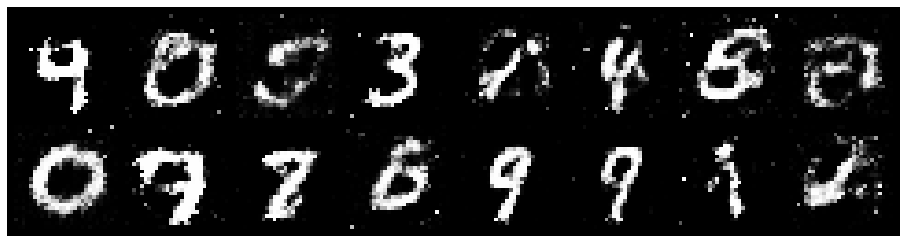

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.0696, Generator Loss: 1.0922
D(x): 0.6027, D(G(z)): 0.3650


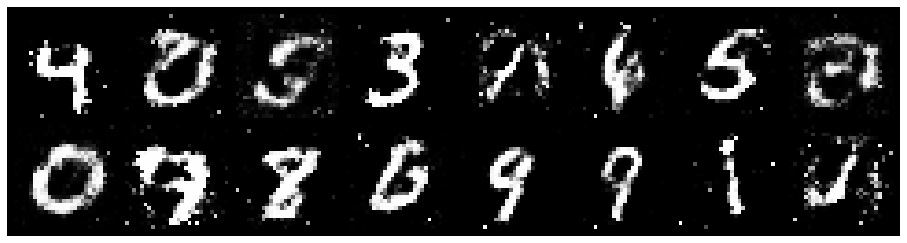

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.2246, Generator Loss: 1.0519
D(x): 0.5304, D(G(z)): 0.3700


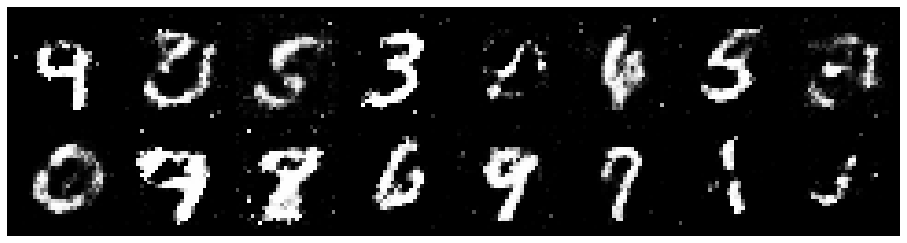

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 1.4011, Generator Loss: 0.9647
D(x): 0.5884, D(G(z)): 0.4598


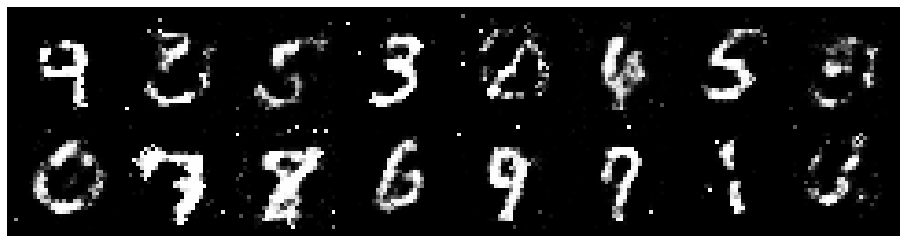

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.1177, Generator Loss: 1.1622
D(x): 0.6536, D(G(z)): 0.4067


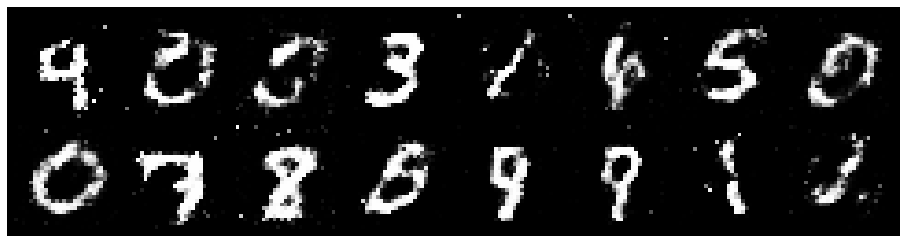

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 1.0027, Generator Loss: 1.3897
D(x): 0.6115, D(G(z)): 0.3126


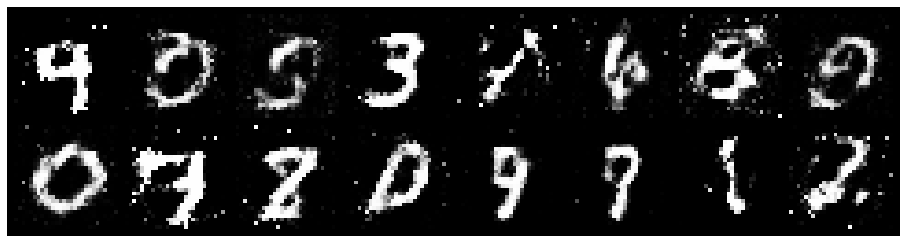

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.0389, Generator Loss: 1.2713
D(x): 0.6351, D(G(z)): 0.3477


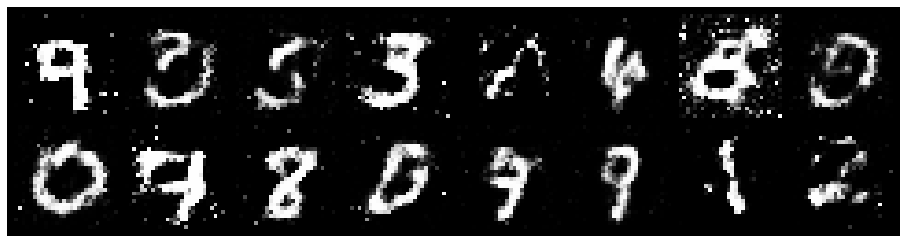

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.0257, Generator Loss: 1.3423
D(x): 0.6104, D(G(z)): 0.3125


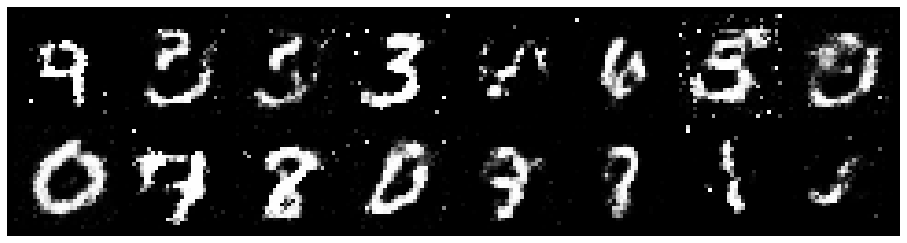

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.1051, Generator Loss: 1.2215
D(x): 0.5804, D(G(z)): 0.3103


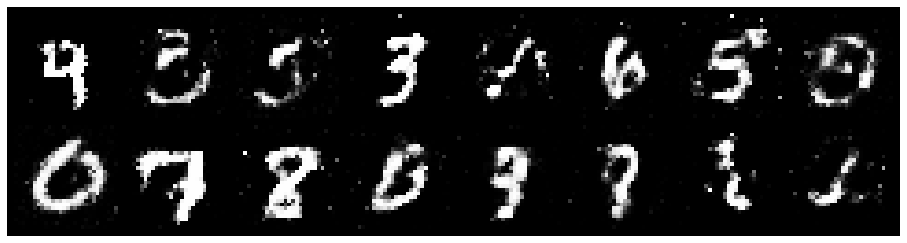

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 0.9188, Generator Loss: 1.2555
D(x): 0.7147, D(G(z)): 0.3491


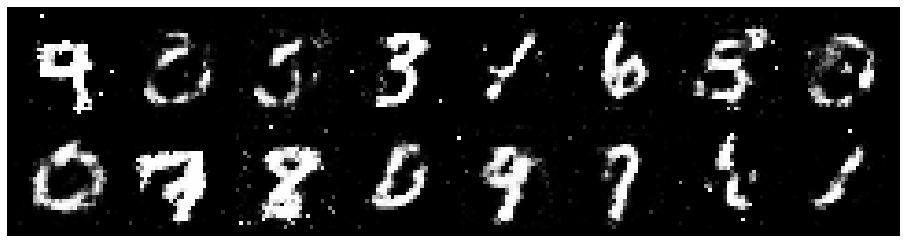

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.0178, Generator Loss: 1.7937
D(x): 0.7057, D(G(z)): 0.3699


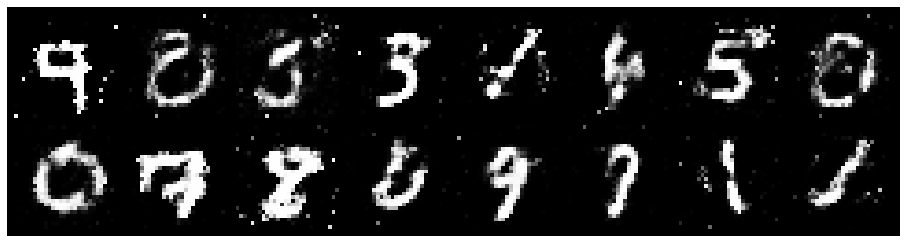

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.1419, Generator Loss: 1.0739
D(x): 0.6441, D(G(z)): 0.4228


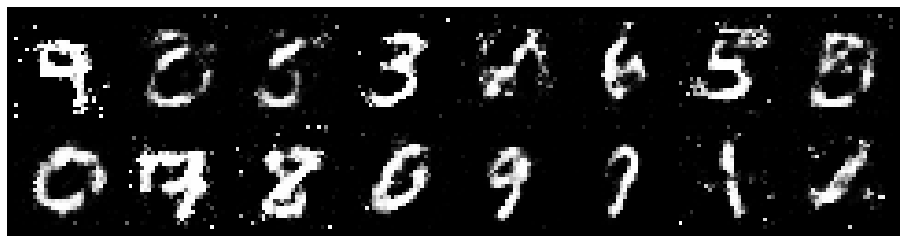

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.2643, Generator Loss: 1.3487
D(x): 0.6289, D(G(z)): 0.4086


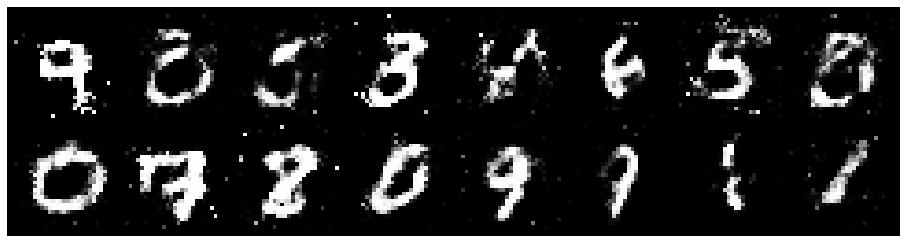

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.2691, Generator Loss: 0.9771
D(x): 0.6431, D(G(z)): 0.4819


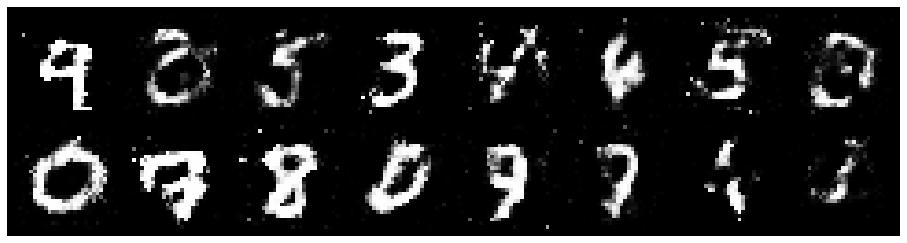

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.2551, Generator Loss: 1.1954
D(x): 0.5672, D(G(z)): 0.3930


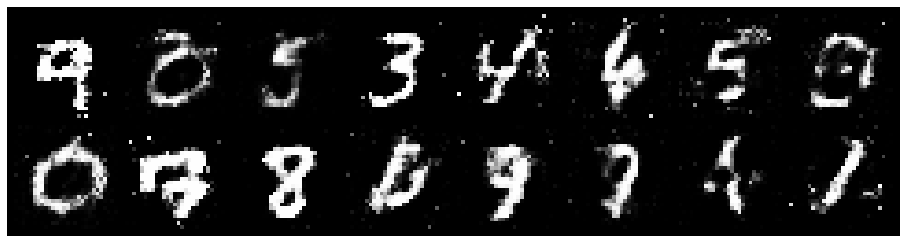

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.1081, Generator Loss: 1.0847
D(x): 0.6719, D(G(z)): 0.4181


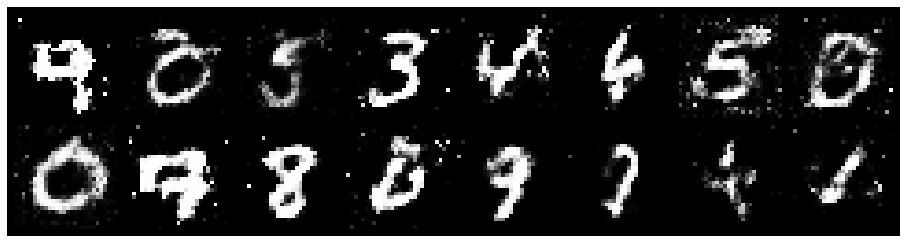

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.0461, Generator Loss: 1.2614
D(x): 0.6610, D(G(z)): 0.3746


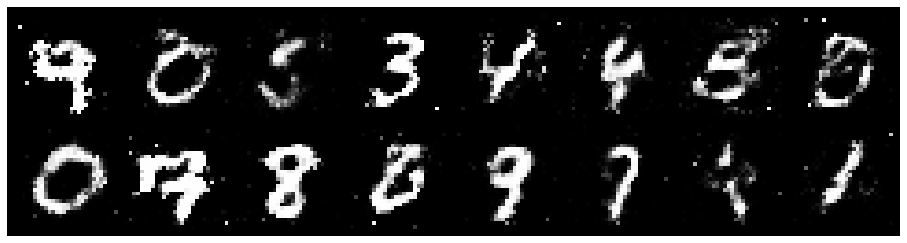

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.0585, Generator Loss: 1.0885
D(x): 0.6126, D(G(z)): 0.3632


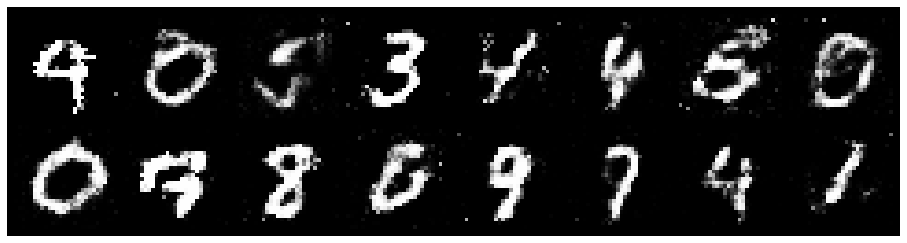

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.4119, Generator Loss: 1.2893
D(x): 0.5284, D(G(z)): 0.3944


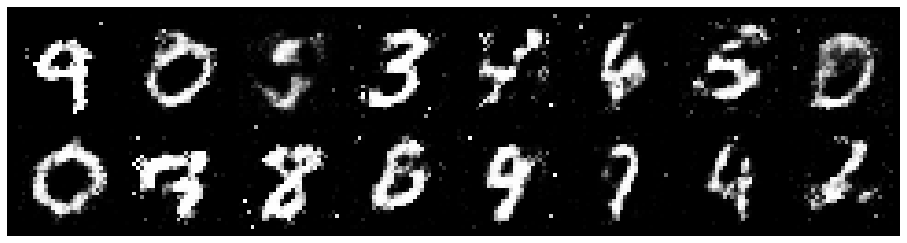

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.0927, Generator Loss: 1.3532
D(x): 0.6092, D(G(z)): 0.3563


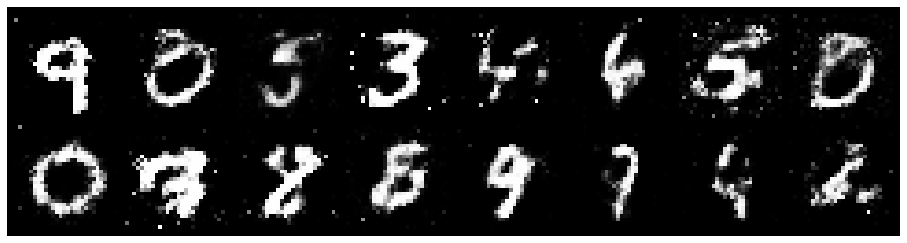

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.0898, Generator Loss: 1.2764
D(x): 0.6647, D(G(z)): 0.4006


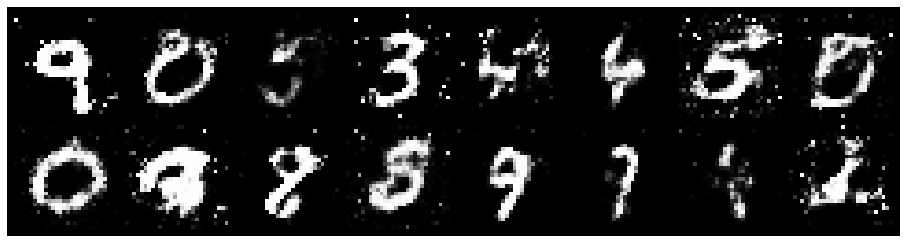

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1677, Generator Loss: 1.0062
D(x): 0.6018, D(G(z)): 0.3954


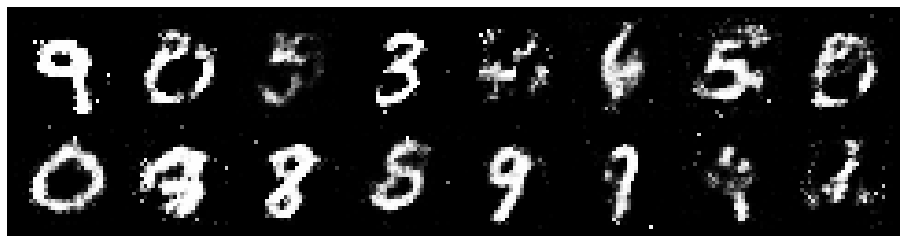

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 0.9762, Generator Loss: 1.3120
D(x): 0.6535, D(G(z)): 0.3498


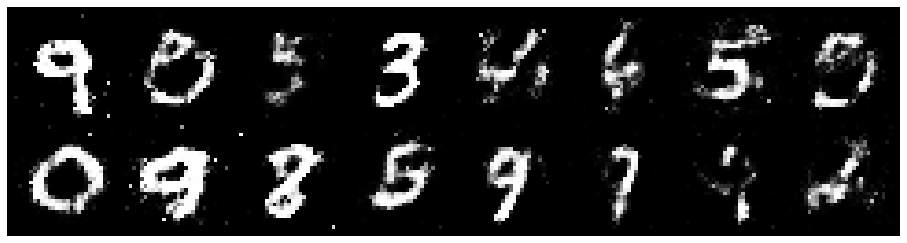

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1492, Generator Loss: 0.9648
D(x): 0.6088, D(G(z)): 0.4062


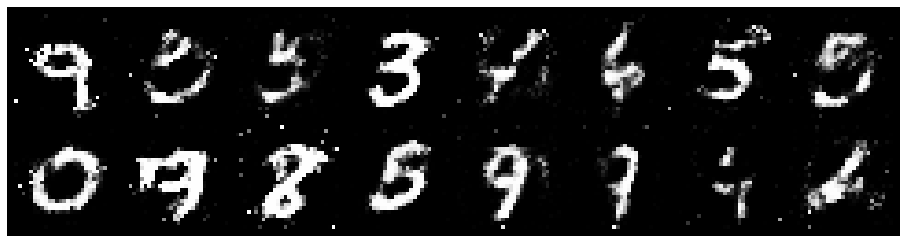

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.0725, Generator Loss: 1.1301
D(x): 0.6953, D(G(z)): 0.4176


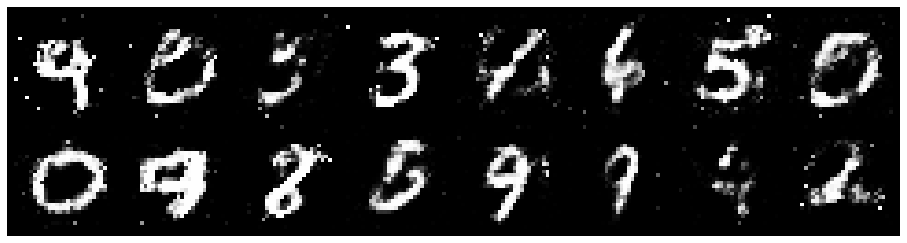

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1912, Generator Loss: 0.9230
D(x): 0.6132, D(G(z)): 0.3929


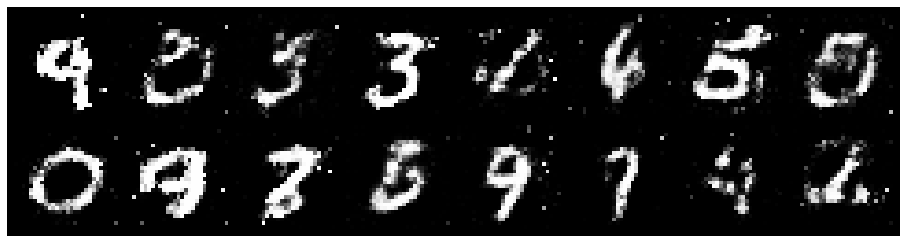

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.1629, Generator Loss: 1.1775
D(x): 0.7155, D(G(z)): 0.4641


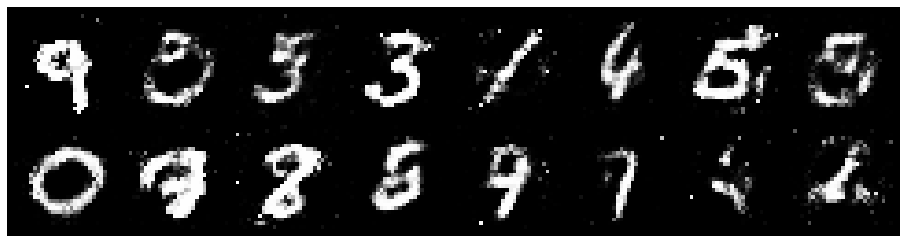

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.1794, Generator Loss: 1.2586
D(x): 0.5994, D(G(z)): 0.3672


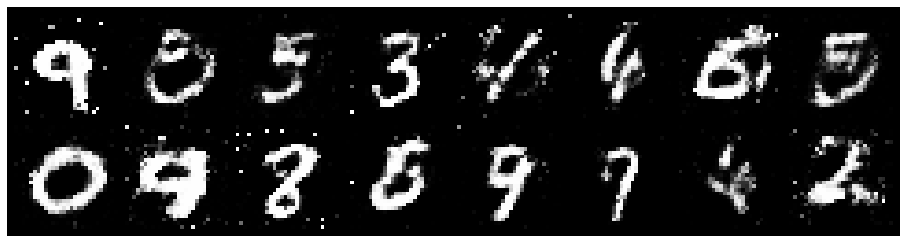

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.0804, Generator Loss: 1.3395
D(x): 0.6917, D(G(z)): 0.3760


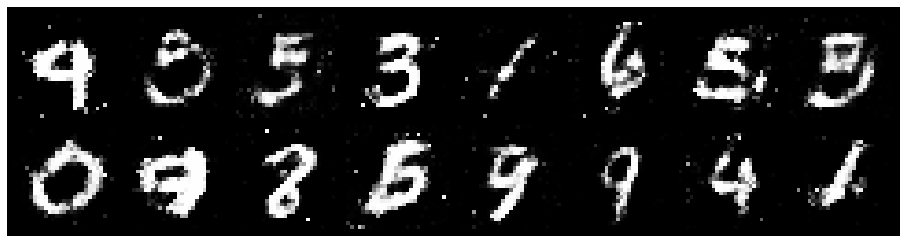

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.1121, Generator Loss: 1.0312
D(x): 0.6033, D(G(z)): 0.3774


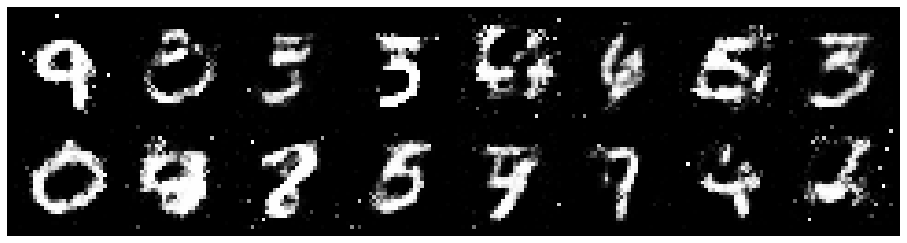

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.0692, Generator Loss: 1.1456
D(x): 0.6780, D(G(z)): 0.3851


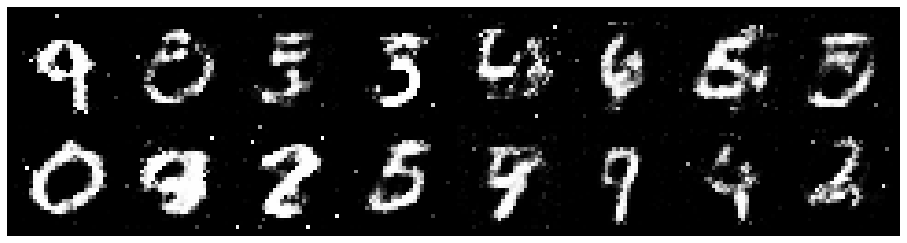

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.1918, Generator Loss: 1.2927
D(x): 0.5393, D(G(z)): 0.3024


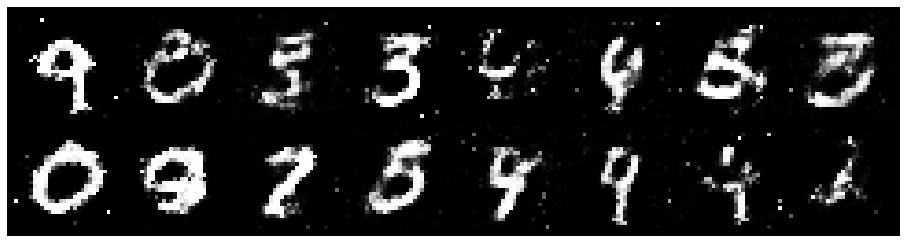

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.0995, Generator Loss: 1.3758
D(x): 0.5983, D(G(z)): 0.3317


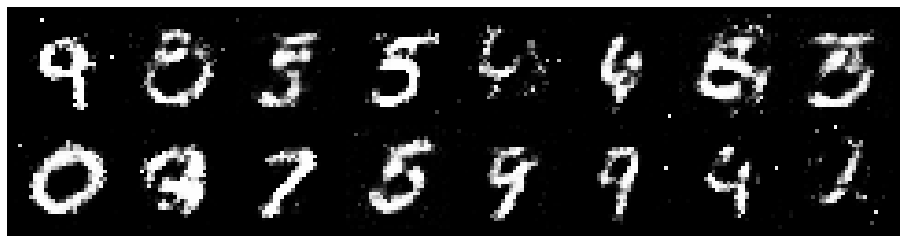

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.0342, Generator Loss: 1.1226
D(x): 0.6403, D(G(z)): 0.3508


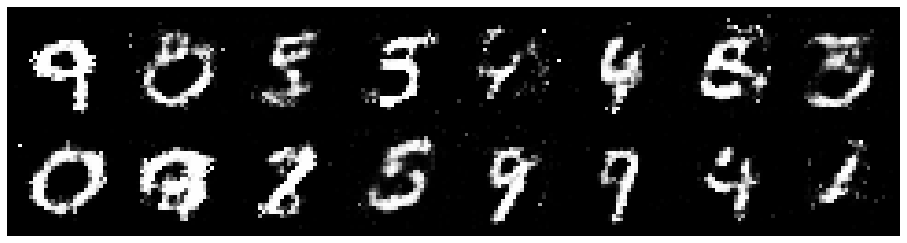

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.0296, Generator Loss: 1.1842
D(x): 0.5645, D(G(z)): 0.3114


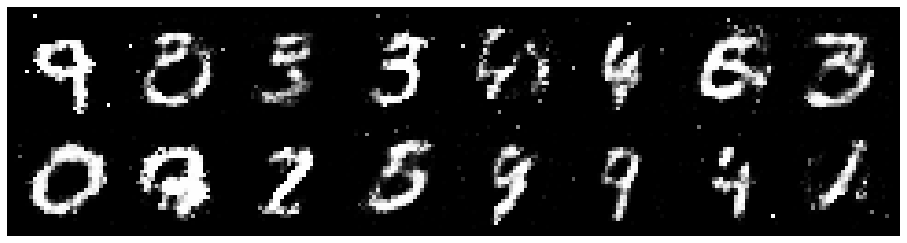

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.0917, Generator Loss: 1.0396
D(x): 0.5995, D(G(z)): 0.3753


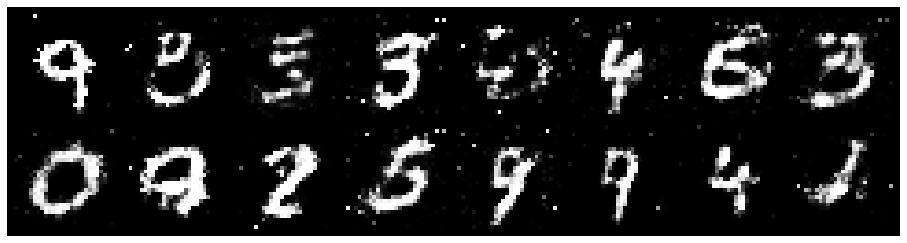

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 1.0868, Generator Loss: 1.1213
D(x): 0.6431, D(G(z)): 0.3889


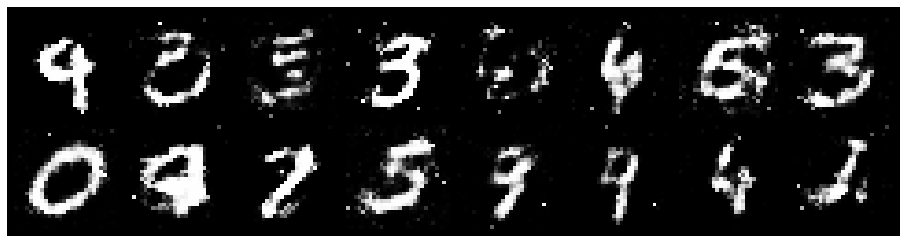

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 1.2555, Generator Loss: 0.9328
D(x): 0.6106, D(G(z)): 0.4513


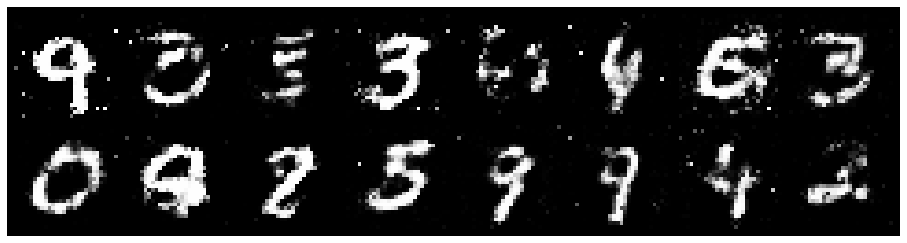

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 1.2431, Generator Loss: 0.9714
D(x): 0.5744, D(G(z)): 0.4164


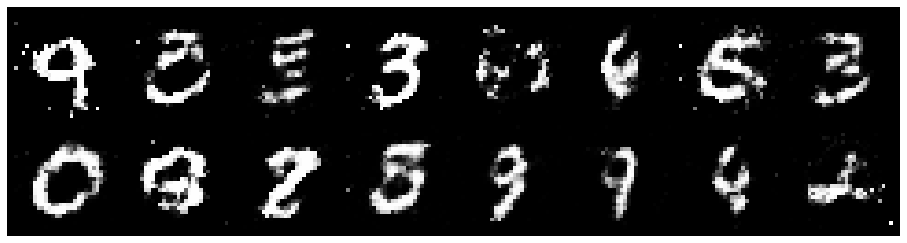

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.1216, Generator Loss: 0.9576
D(x): 0.6717, D(G(z)): 0.4569


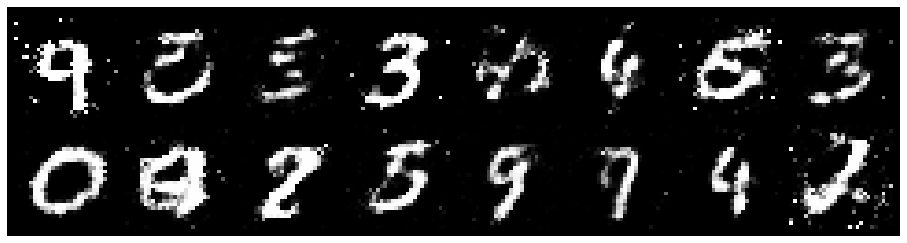

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.1739, Generator Loss: 1.2104
D(x): 0.5822, D(G(z)): 0.3492


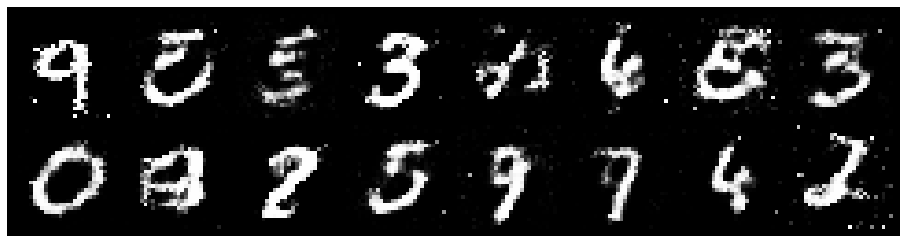

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 1.1880, Generator Loss: 1.0824
D(x): 0.6738, D(G(z)): 0.4321


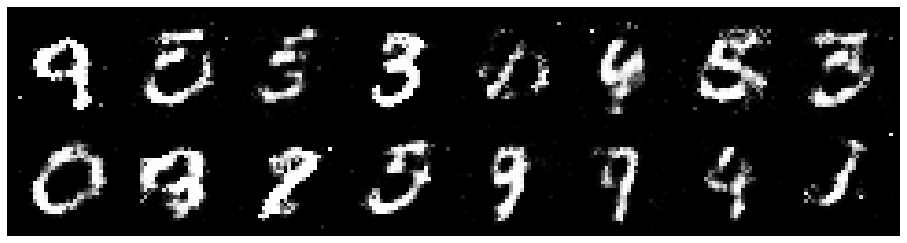

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.0321, Generator Loss: 1.1625
D(x): 0.6640, D(G(z)): 0.3849


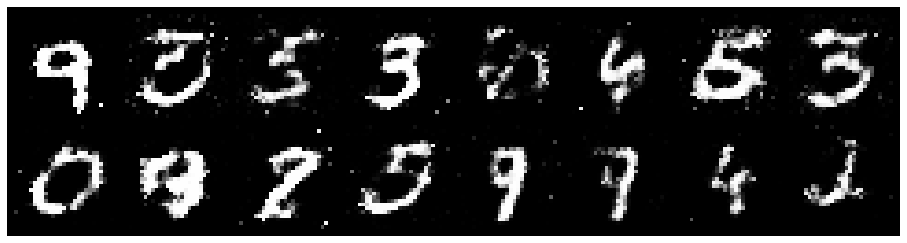

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.1386, Generator Loss: 1.0795
D(x): 0.5908, D(G(z)): 0.3845


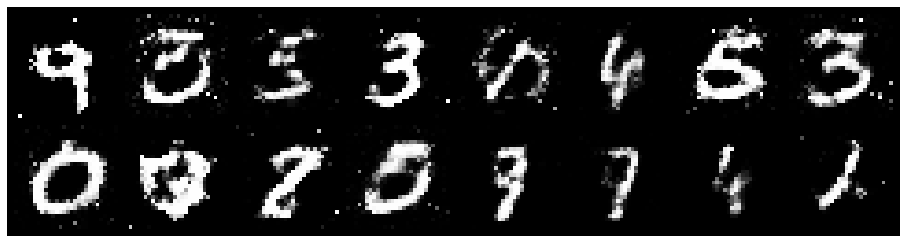

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 1.0427, Generator Loss: 0.9253
D(x): 0.6682, D(G(z)): 0.4110


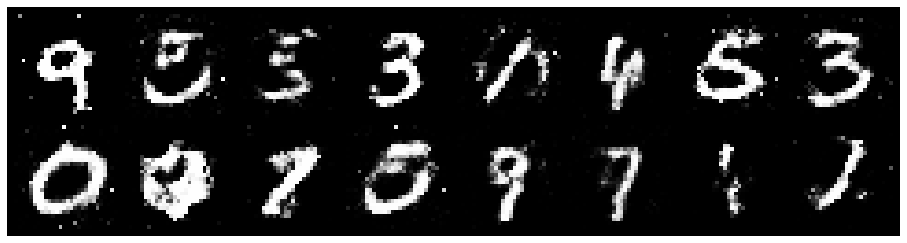

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.0214, Generator Loss: 1.4528
D(x): 0.6100, D(G(z)): 0.3096


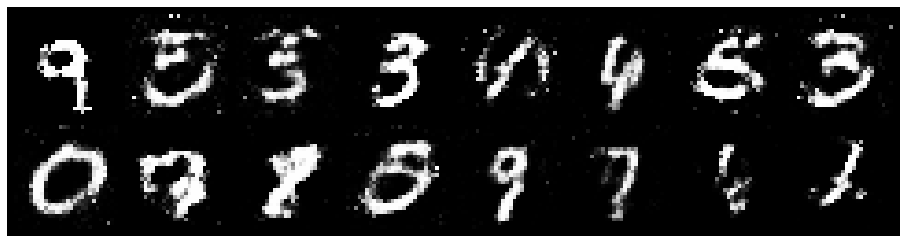

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.0846, Generator Loss: 1.1476
D(x): 0.6547, D(G(z)): 0.4039


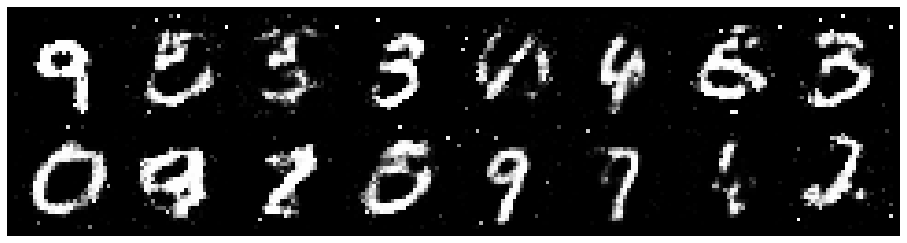

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0613, Generator Loss: 1.1548
D(x): 0.6247, D(G(z)): 0.3745


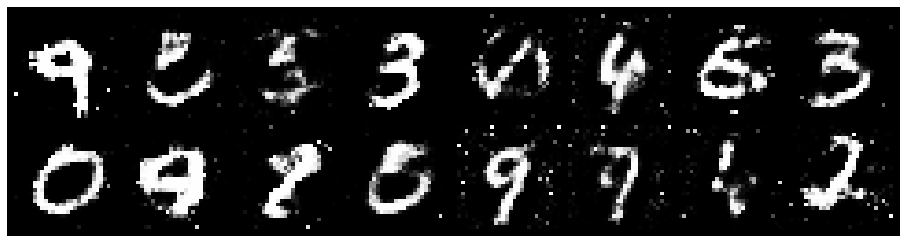

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.3451, Generator Loss: 1.0313
D(x): 0.5958, D(G(z)): 0.4563


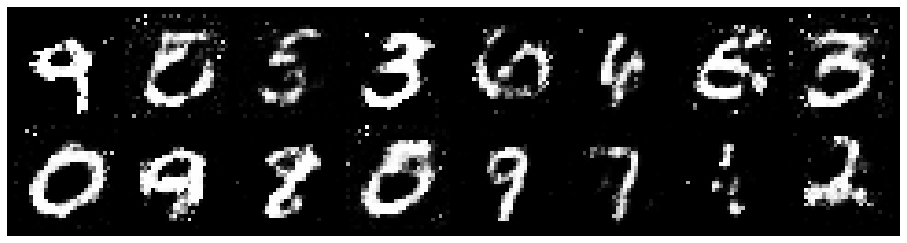

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.0939, Generator Loss: 0.9667
D(x): 0.6179, D(G(z)): 0.4057


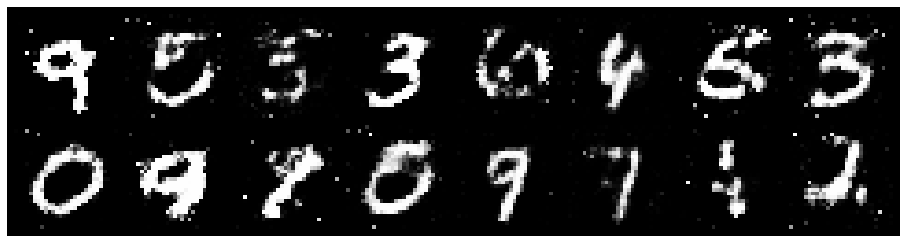

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.1469, Generator Loss: 1.0637
D(x): 0.6437, D(G(z)): 0.4156


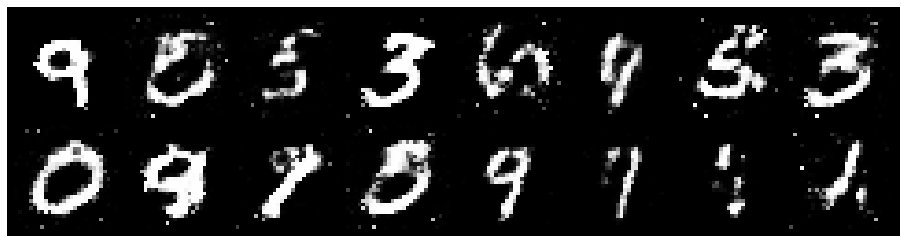

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.1056, Generator Loss: 1.0842
D(x): 0.6570, D(G(z)): 0.4336


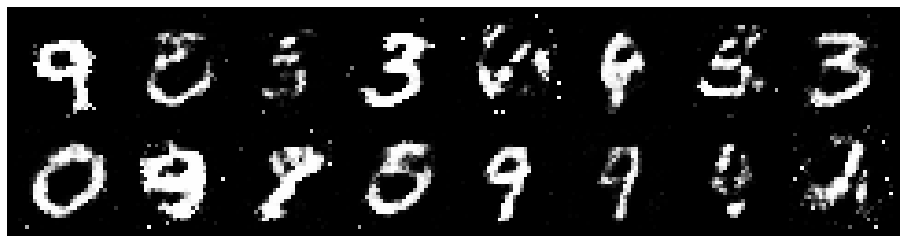

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.1224, Generator Loss: 1.1135
D(x): 0.6606, D(G(z)): 0.4324


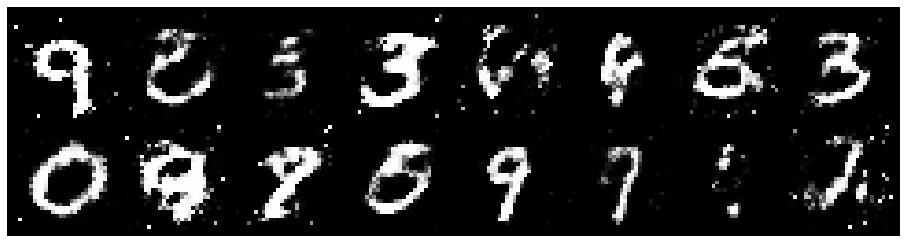

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.0715, Generator Loss: 1.3469
D(x): 0.5940, D(G(z)): 0.3121


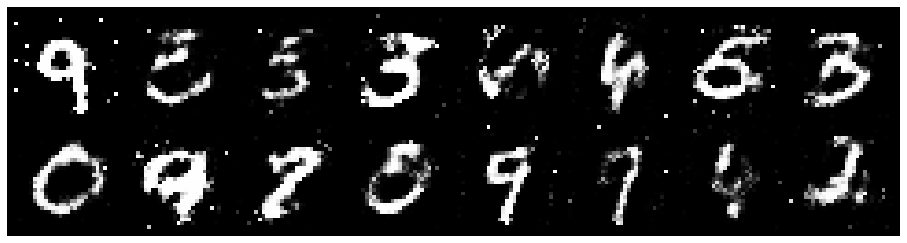

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.1608, Generator Loss: 1.0447
D(x): 0.6117, D(G(z)): 0.4016


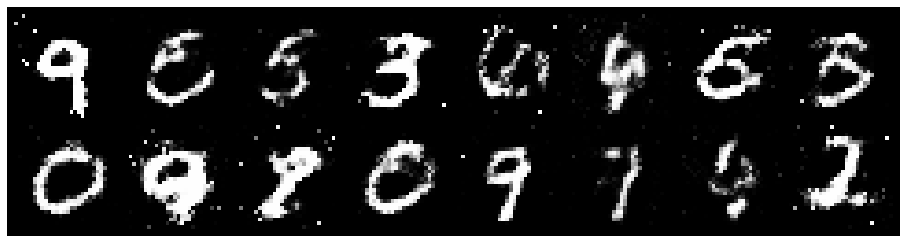

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.2993, Generator Loss: 0.7987
D(x): 0.6214, D(G(z)): 0.4745


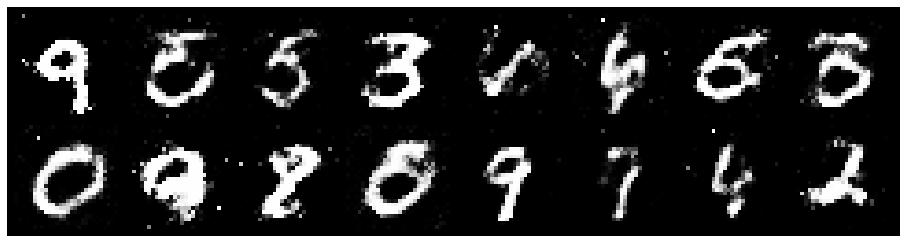

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.2156, Generator Loss: 1.0277
D(x): 0.5627, D(G(z)): 0.3813


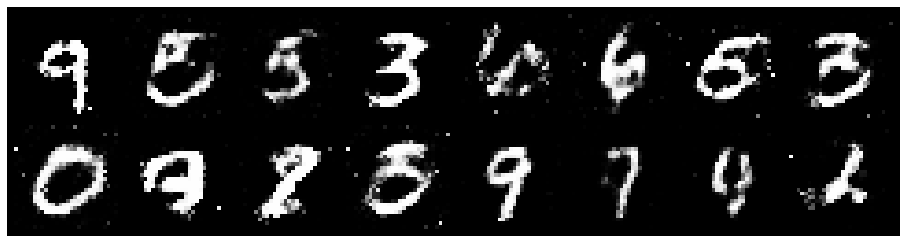

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.0923, Generator Loss: 1.1305
D(x): 0.6187, D(G(z)): 0.3666


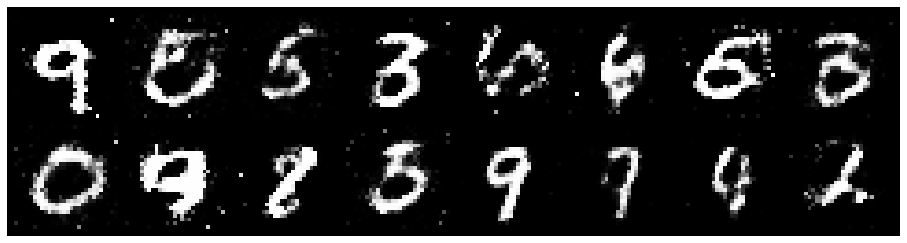

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.1727, Generator Loss: 1.2420
D(x): 0.5463, D(G(z)): 0.3469


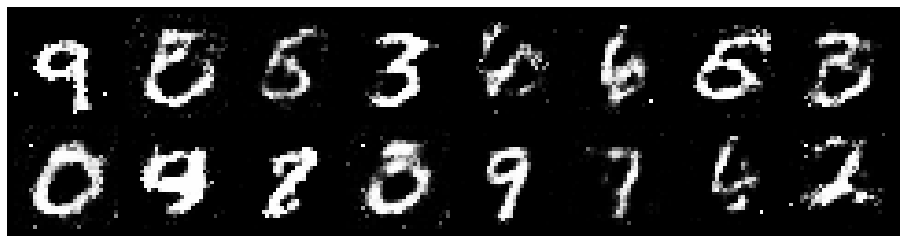

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.1814, Generator Loss: 0.9927
D(x): 0.6315, D(G(z)): 0.4027


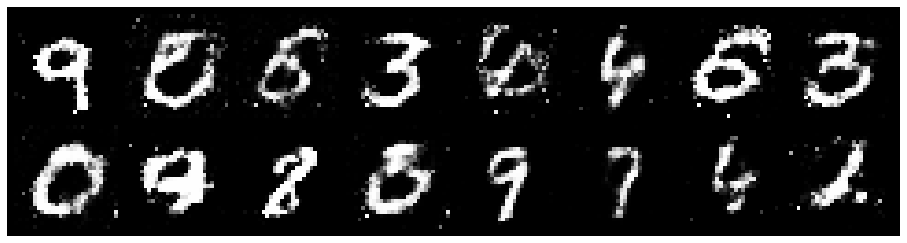

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.2117, Generator Loss: 1.1649
D(x): 0.5734, D(G(z)): 0.3636


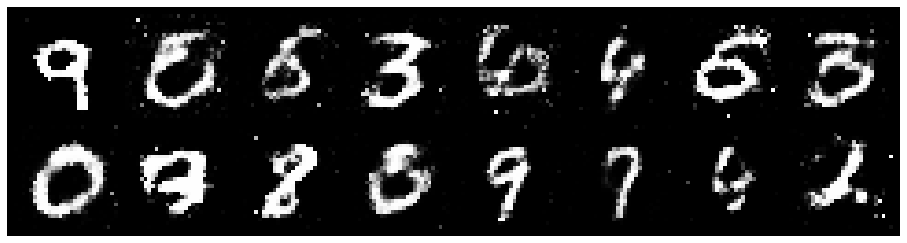

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.0943, Generator Loss: 1.2420
D(x): 0.6281, D(G(z)): 0.3714


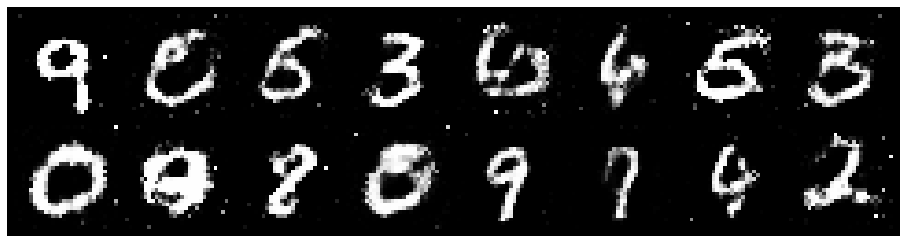

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.0547, Generator Loss: 1.3474
D(x): 0.6111, D(G(z)): 0.3506


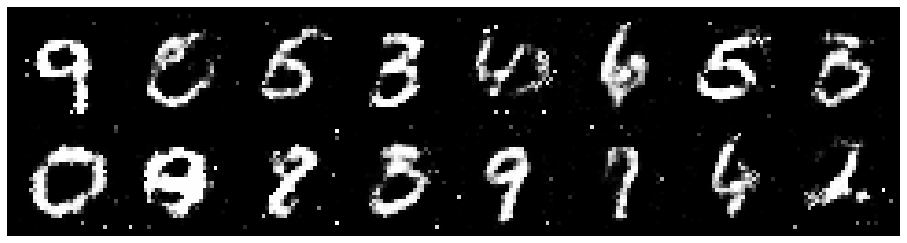

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.1157, Generator Loss: 1.0380
D(x): 0.5928, D(G(z)): 0.3686


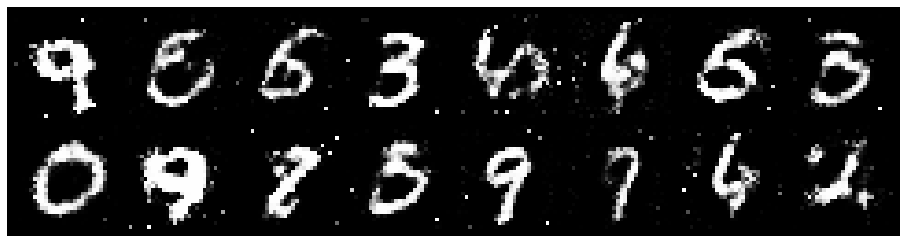

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.1147, Generator Loss: 1.0330
D(x): 0.5826, D(G(z)): 0.3626


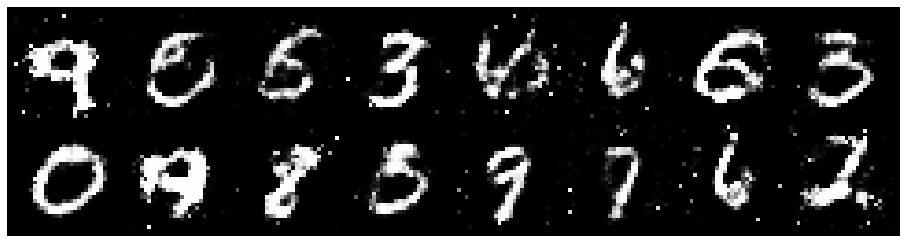

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 0.9260, Generator Loss: 1.1758
D(x): 0.6456, D(G(z)): 0.3180


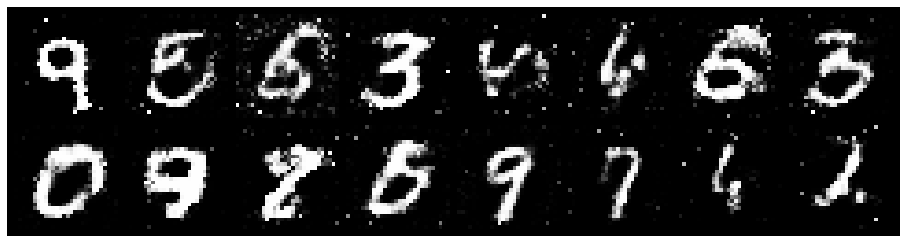

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1029, Generator Loss: 0.9179
D(x): 0.6110, D(G(z)): 0.3949


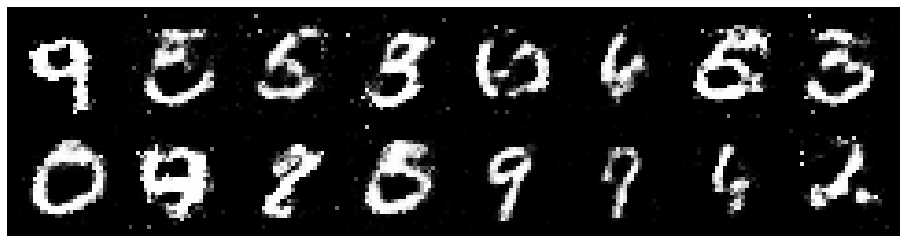

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.2471, Generator Loss: 0.8984
D(x): 0.5994, D(G(z)): 0.4146


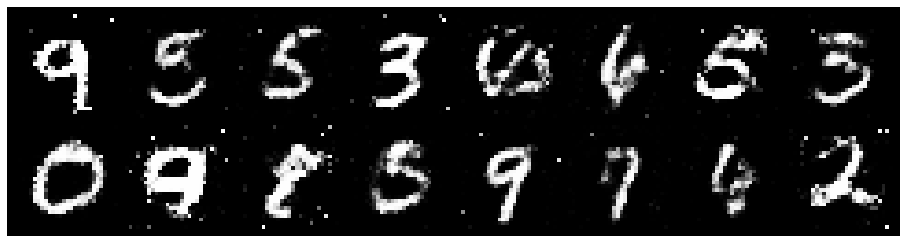

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1722, Generator Loss: 1.0719
D(x): 0.5880, D(G(z)): 0.3974


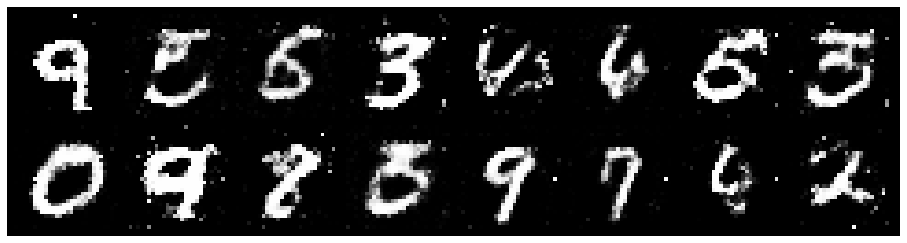

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.2108, Generator Loss: 1.0794
D(x): 0.6158, D(G(z)): 0.4179


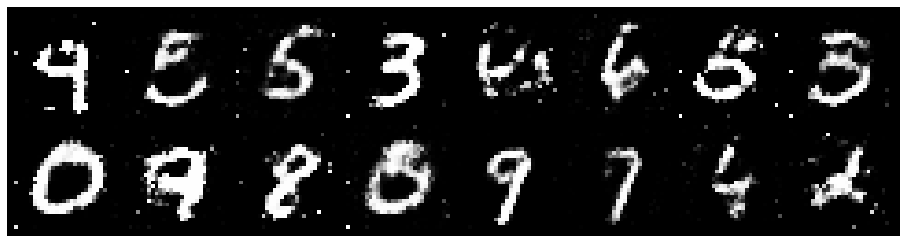

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.0084, Generator Loss: 1.5980
D(x): 0.6812, D(G(z)): 0.3395


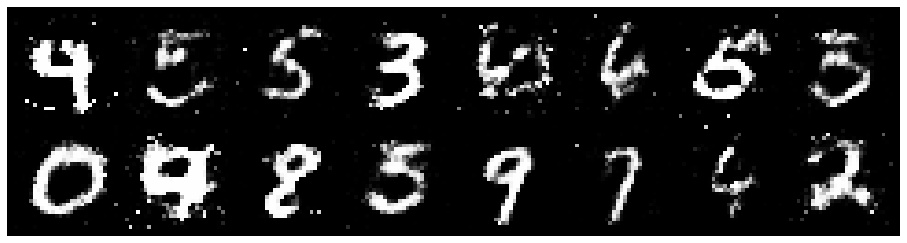

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.0631, Generator Loss: 1.2731
D(x): 0.6110, D(G(z)): 0.3572


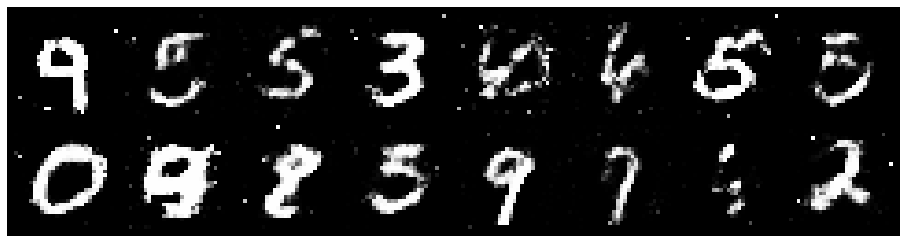

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.0284, Generator Loss: 1.0258
D(x): 0.6518, D(G(z)): 0.3909


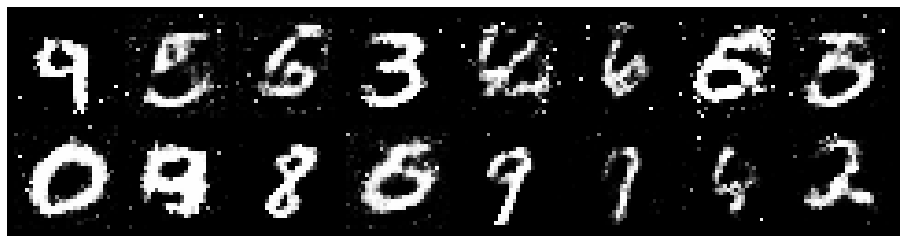

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.1859, Generator Loss: 0.8481
D(x): 0.6196, D(G(z)): 0.4637


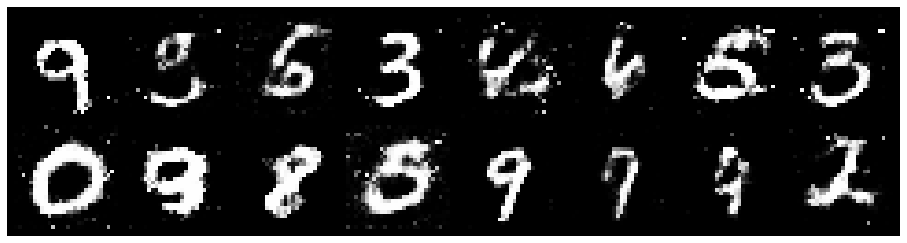

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.1939, Generator Loss: 1.0052
D(x): 0.6013, D(G(z)): 0.3909


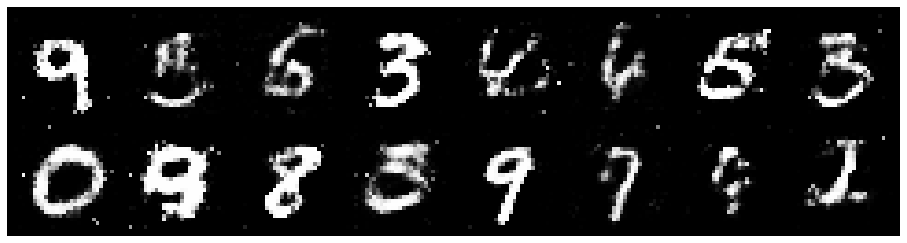

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.1326, Generator Loss: 0.9445
D(x): 0.6595, D(G(z)): 0.4235


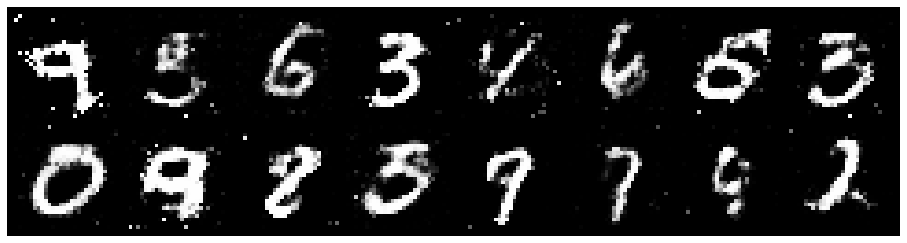

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.0450, Generator Loss: 1.2300
D(x): 0.6121, D(G(z)): 0.3341


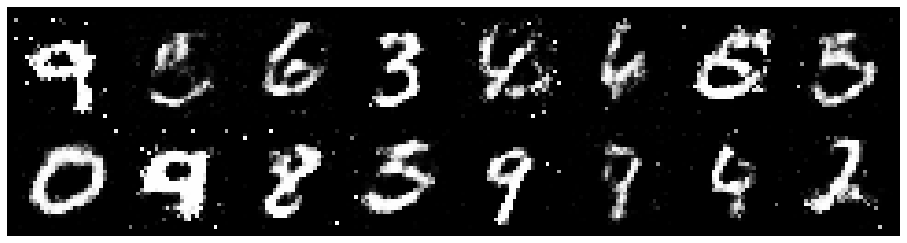

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1329, Generator Loss: 0.9013
D(x): 0.6823, D(G(z)): 0.4643


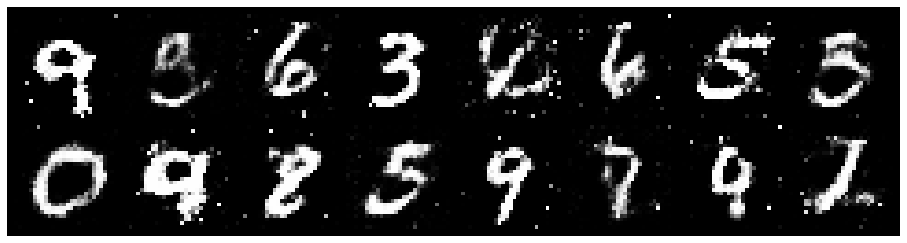

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1525, Generator Loss: 0.9345
D(x): 0.6084, D(G(z)): 0.4213


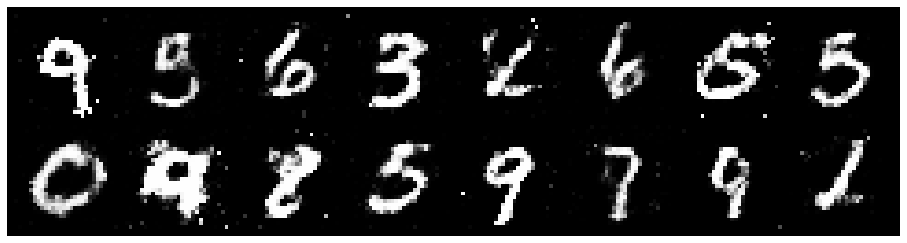

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.2732, Generator Loss: 0.9475
D(x): 0.5604, D(G(z)): 0.4092


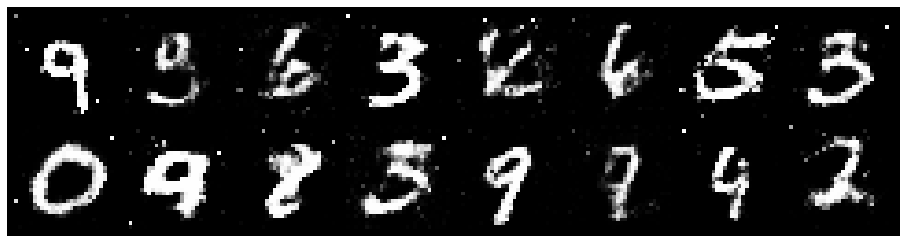

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1734, Generator Loss: 1.1061
D(x): 0.5624, D(G(z)): 0.3677


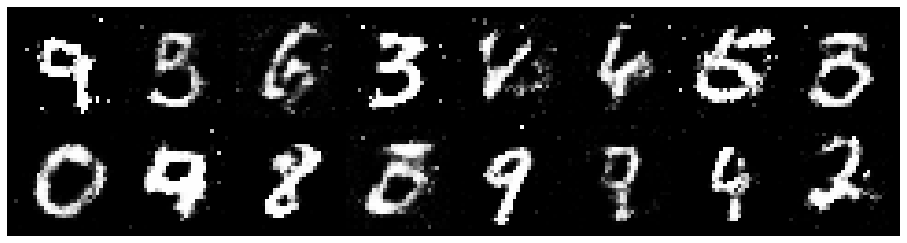

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1553, Generator Loss: 0.9120
D(x): 0.6088, D(G(z)): 0.4152


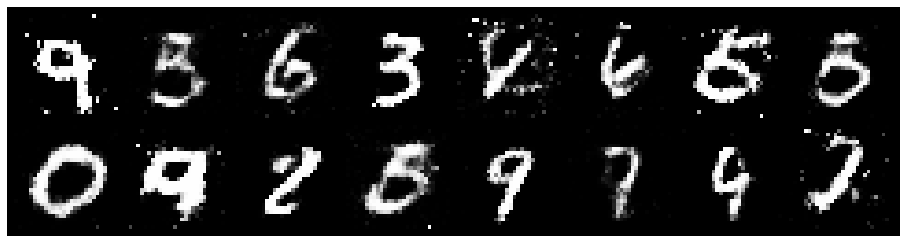

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.2839, Generator Loss: 0.9402
D(x): 0.5888, D(G(z)): 0.4458


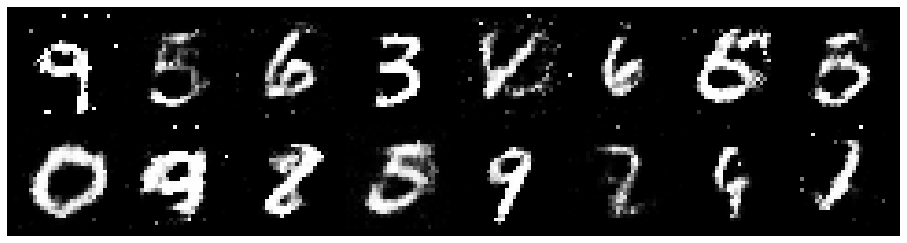

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1683, Generator Loss: 1.0240
D(x): 0.5861, D(G(z)): 0.4063


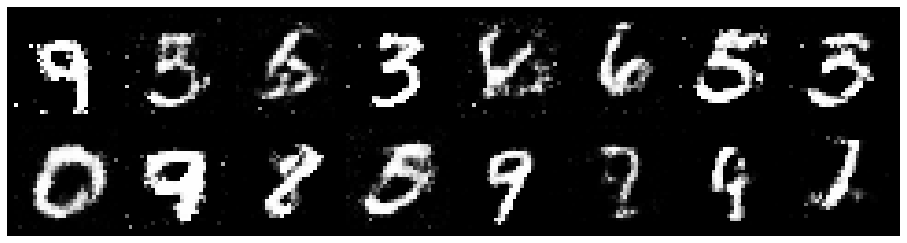

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.0767, Generator Loss: 1.1789
D(x): 0.5948, D(G(z)): 0.3317


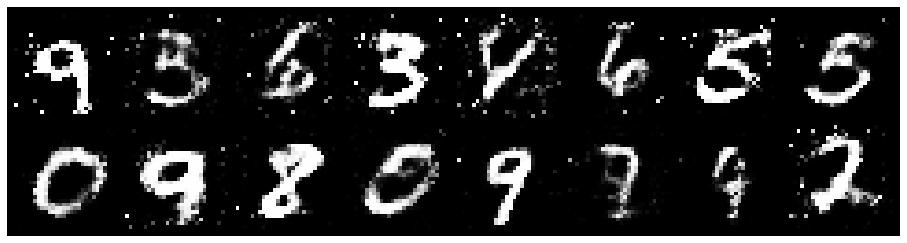

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.0912, Generator Loss: 1.0522
D(x): 0.6073, D(G(z)): 0.3844


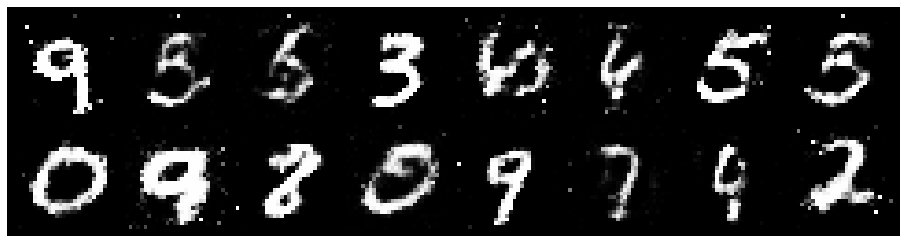

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.2690, Generator Loss: 0.8068
D(x): 0.6348, D(G(z)): 0.5088


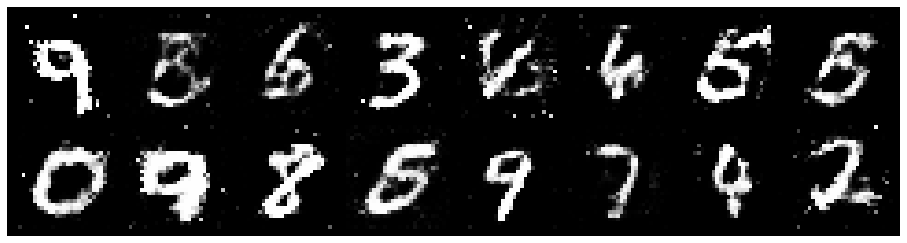

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 1.3258, Generator Loss: 1.0073
D(x): 0.5333, D(G(z)): 0.4204


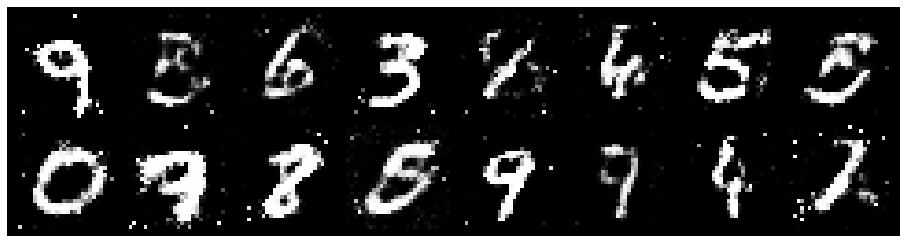

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.2150, Generator Loss: 0.8594
D(x): 0.5862, D(G(z)): 0.4480


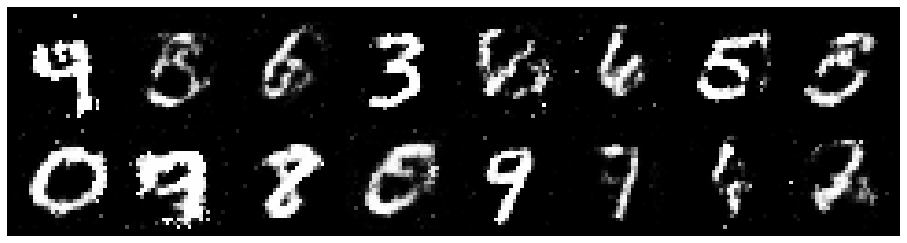

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.2910, Generator Loss: 0.9982
D(x): 0.5325, D(G(z)): 0.3933


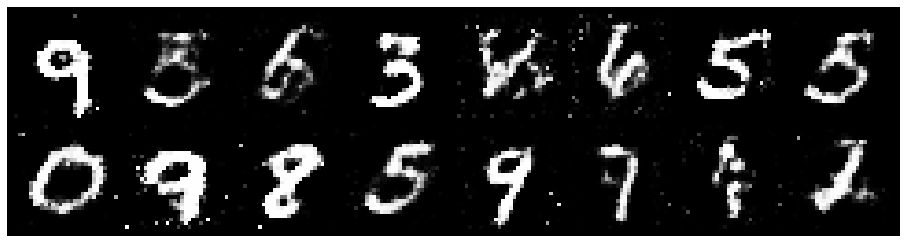

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.2237, Generator Loss: 1.4108
D(x): 0.5208, D(G(z)): 0.3170


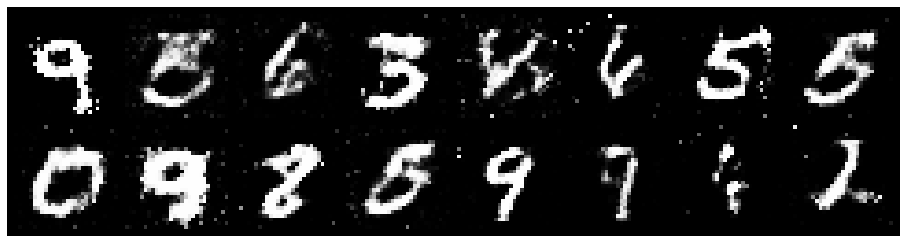

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.3015, Generator Loss: 0.9961
D(x): 0.6217, D(G(z)): 0.4754


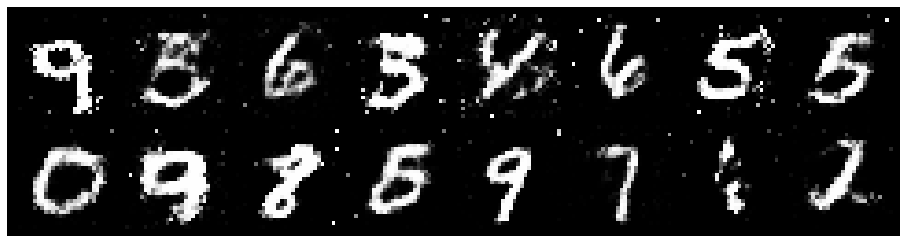

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.0782, Generator Loss: 1.0837
D(x): 0.6373, D(G(z)): 0.4048


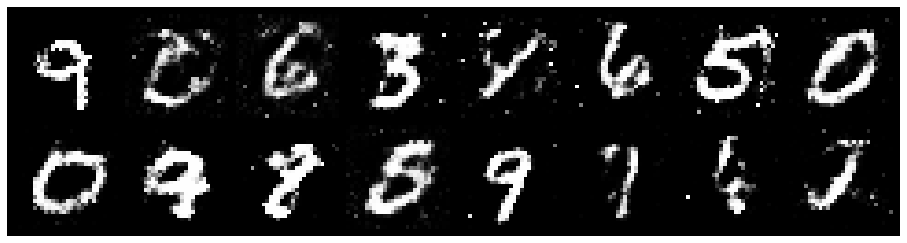

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.1672, Generator Loss: 1.1308
D(x): 0.5973, D(G(z)): 0.3997


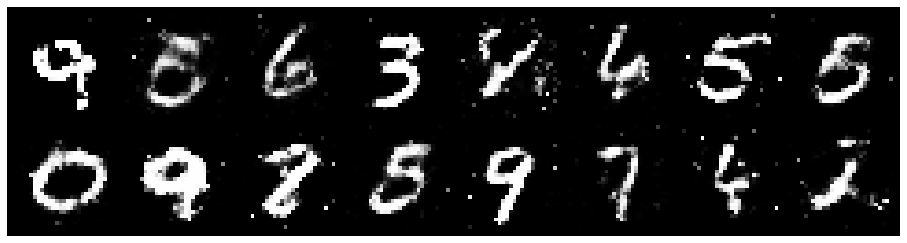

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.1721, Generator Loss: 0.9650
D(x): 0.5934, D(G(z)): 0.3965


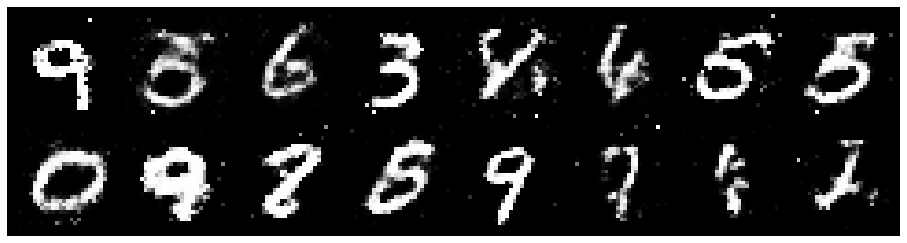

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.1604, Generator Loss: 0.9664
D(x): 0.5941, D(G(z)): 0.3721


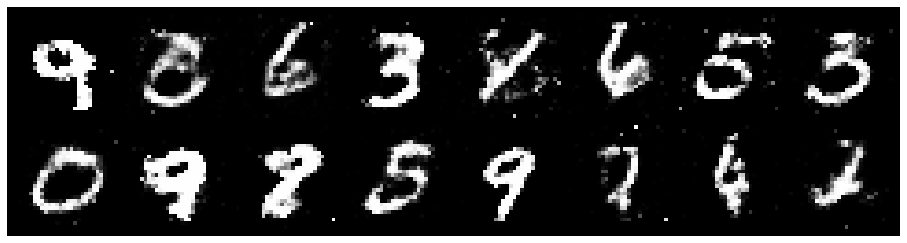

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.2107, Generator Loss: 0.8659
D(x): 0.6295, D(G(z)): 0.4587


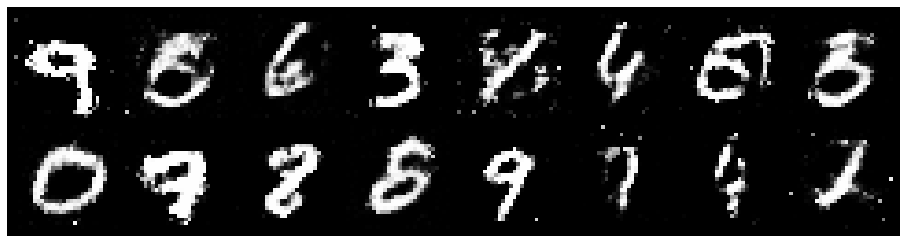

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.2388, Generator Loss: 0.9586
D(x): 0.6366, D(G(z)): 0.4630


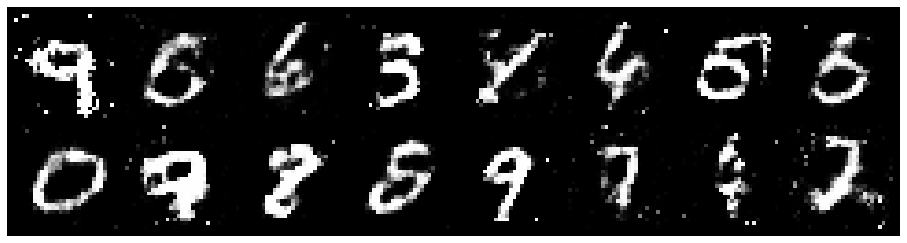

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.1885, Generator Loss: 0.9646
D(x): 0.6047, D(G(z)): 0.4326


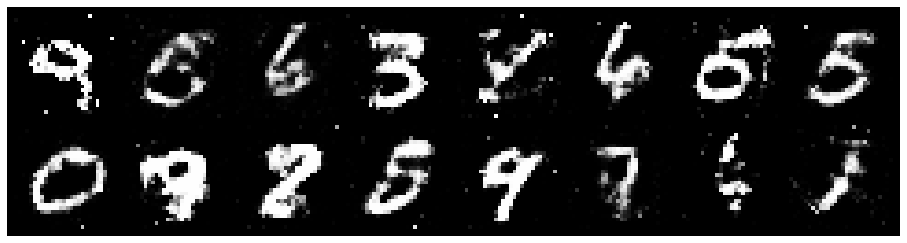

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1425, Generator Loss: 1.1320
D(x): 0.6128, D(G(z)): 0.4045


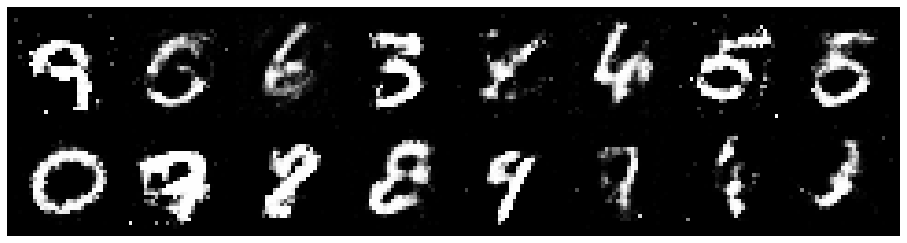

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.2111, Generator Loss: 0.9034
D(x): 0.6097, D(G(z)): 0.4498


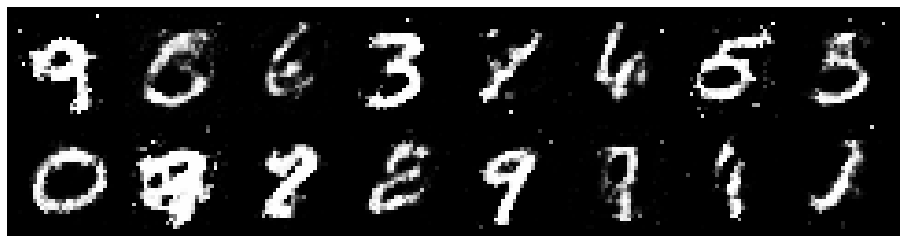

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.2117, Generator Loss: 0.9441
D(x): 0.5794, D(G(z)): 0.4157


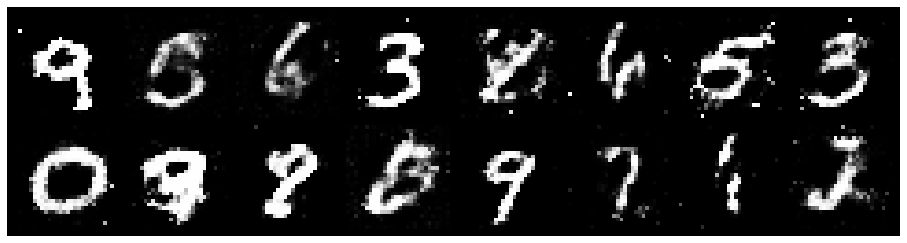

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2774, Generator Loss: 0.9351
D(x): 0.6040, D(G(z)): 0.4742


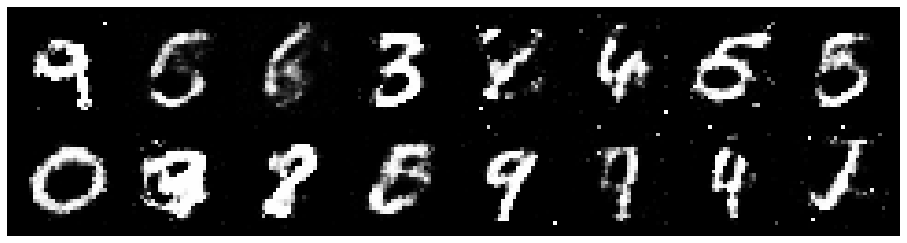

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.0251, Generator Loss: 1.2705
D(x): 0.6385, D(G(z)): 0.3454


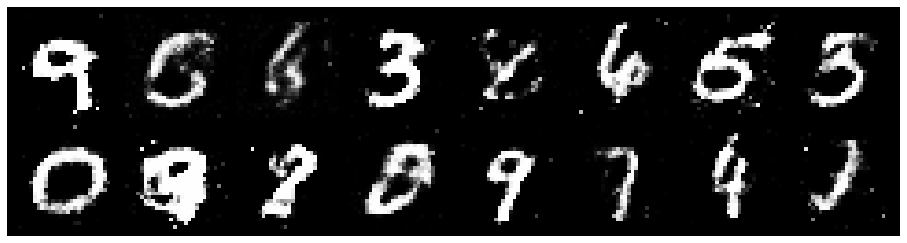

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.0217, Generator Loss: 1.2631
D(x): 0.6439, D(G(z)): 0.3627


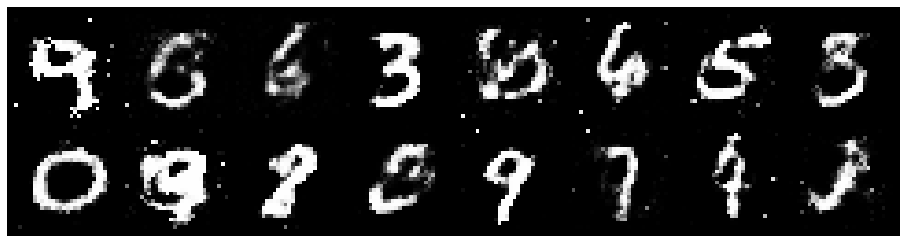

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.1237, Generator Loss: 1.0827
D(x): 0.6222, D(G(z)): 0.4094


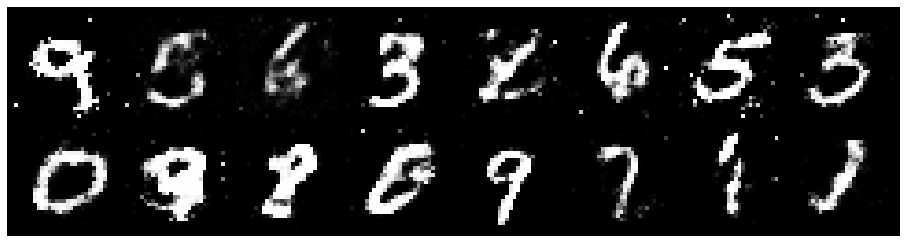

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.1550, Generator Loss: 1.1268
D(x): 0.5853, D(G(z)): 0.3684


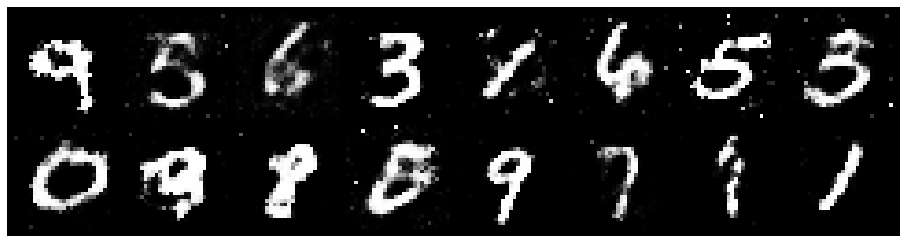

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.2317, Generator Loss: 0.9380
D(x): 0.5790, D(G(z)): 0.4221


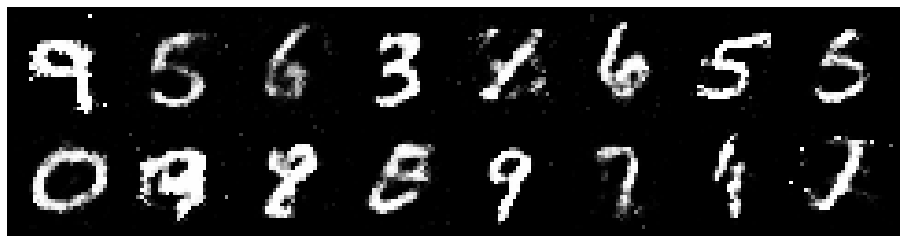

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.0550, Generator Loss: 1.1615
D(x): 0.6432, D(G(z)): 0.3844


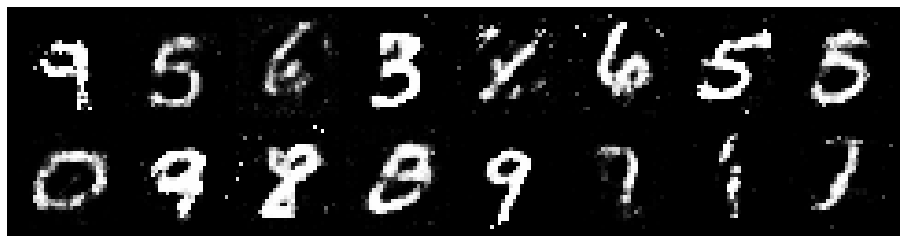

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.1309, Generator Loss: 1.0964
D(x): 0.6341, D(G(z)): 0.4181


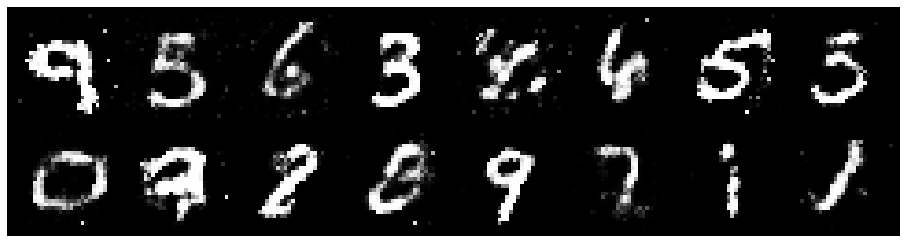

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.0834, Generator Loss: 1.1304
D(x): 0.6374, D(G(z)): 0.3923


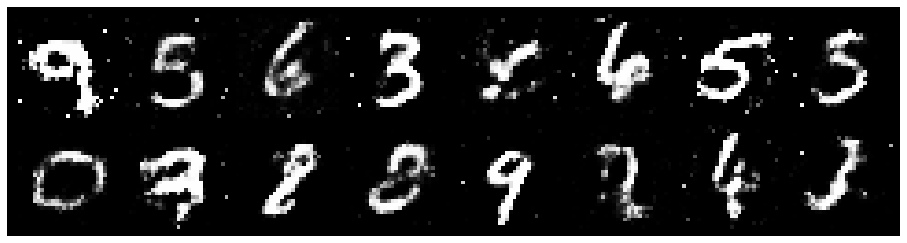

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.1574, Generator Loss: 1.1661
D(x): 0.5517, D(G(z)): 0.3584


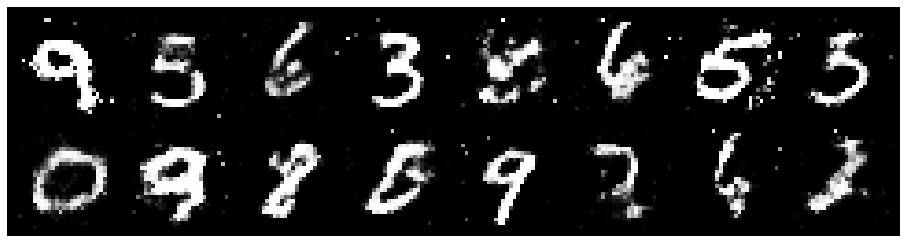

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.2216, Generator Loss: 1.0146
D(x): 0.5458, D(G(z)): 0.4027


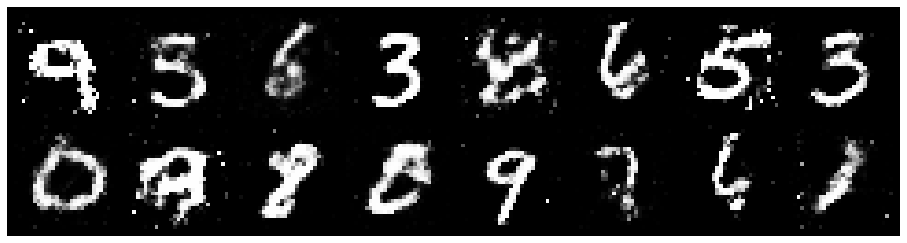

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.2408, Generator Loss: 1.0130
D(x): 0.5667, D(G(z)): 0.4234


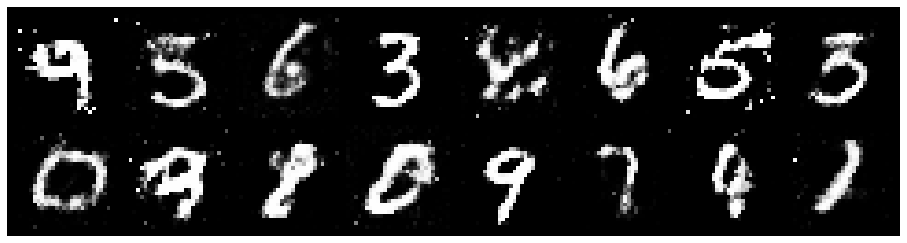

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.2051, Generator Loss: 1.1418
D(x): 0.5574, D(G(z)): 0.3804


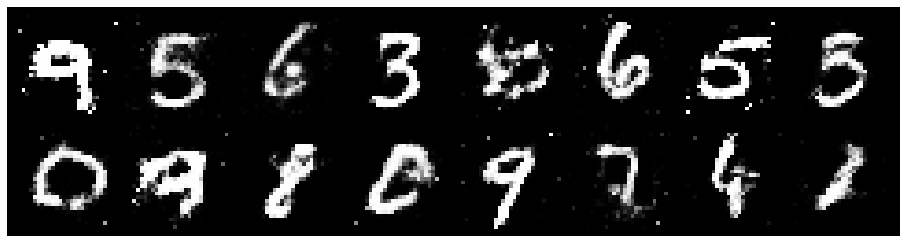

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1576, Generator Loss: 1.1709
D(x): 0.6192, D(G(z)): 0.4174


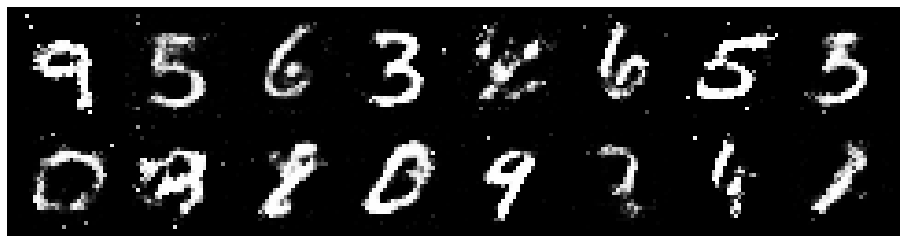

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1244, Generator Loss: 1.1873
D(x): 0.5873, D(G(z)): 0.3637


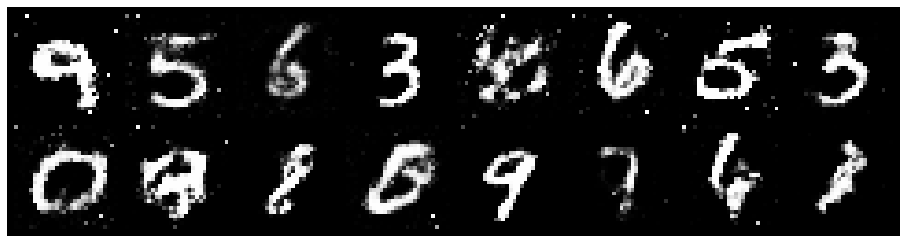

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.2802, Generator Loss: 1.1456
D(x): 0.5637, D(G(z)): 0.4250


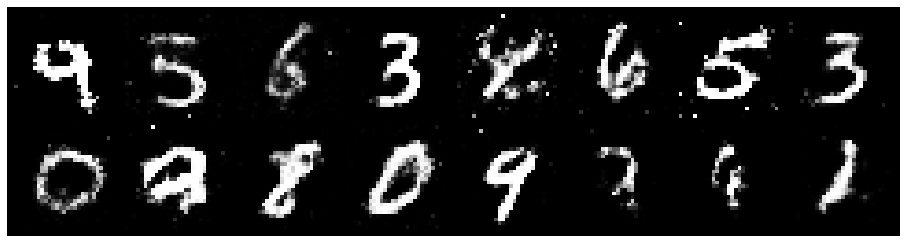

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.1712, Generator Loss: 0.8085
D(x): 0.5824, D(G(z)): 0.4377


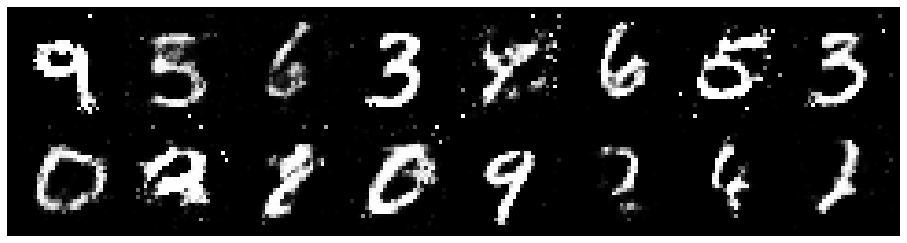

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.3272, Generator Loss: 0.9266
D(x): 0.5449, D(G(z)): 0.4289


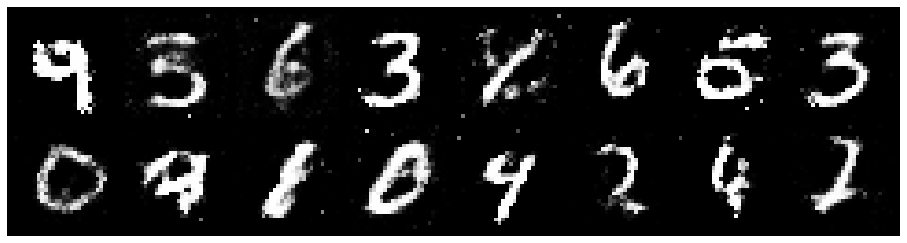

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.1395, Generator Loss: 1.1010
D(x): 0.5835, D(G(z)): 0.3676


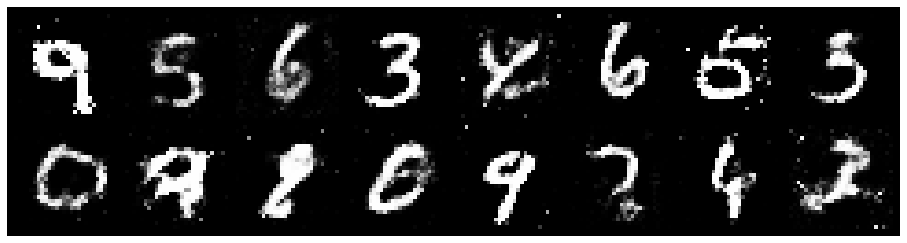

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.2850, Generator Loss: 1.0298
D(x): 0.5991, D(G(z)): 0.4626


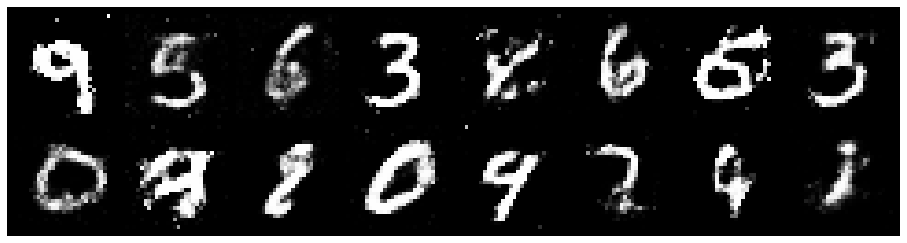

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.0333, Generator Loss: 0.9251
D(x): 0.6063, D(G(z)): 0.3690


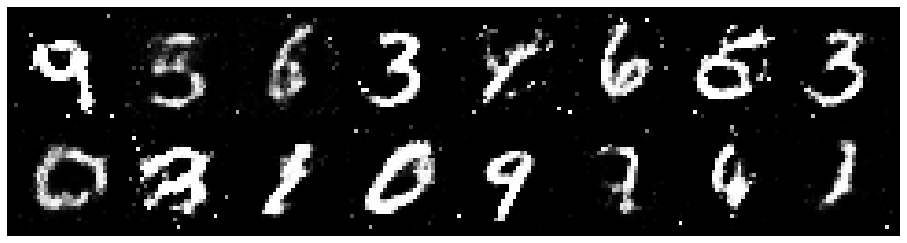

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.2425, Generator Loss: 1.0784
D(x): 0.5725, D(G(z)): 0.4275


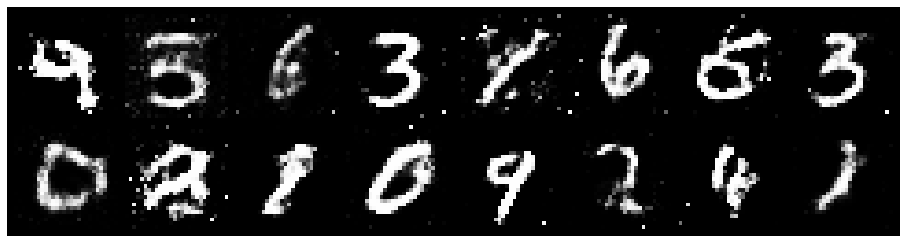

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.1186, Generator Loss: 1.2642
D(x): 0.5711, D(G(z)): 0.3475


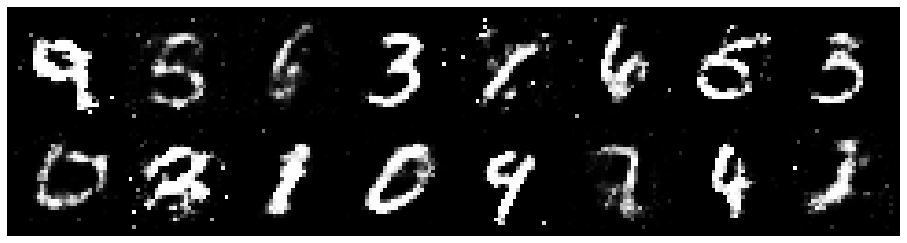

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.1651, Generator Loss: 1.0187
D(x): 0.6101, D(G(z)): 0.4066


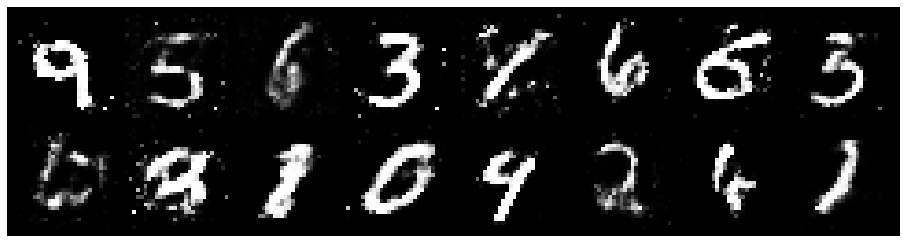

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1129, Generator Loss: 1.0283
D(x): 0.5951, D(G(z)): 0.3643


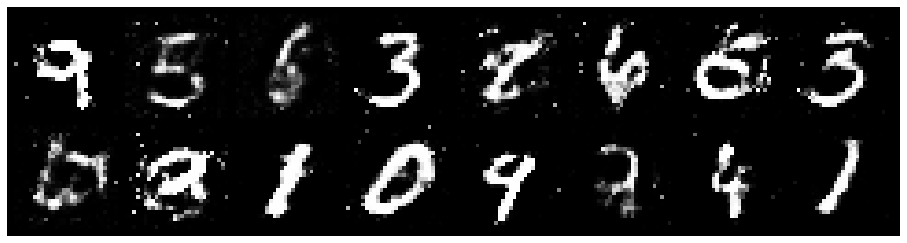

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.2599, Generator Loss: 0.8510
D(x): 0.5447, D(G(z)): 0.4113


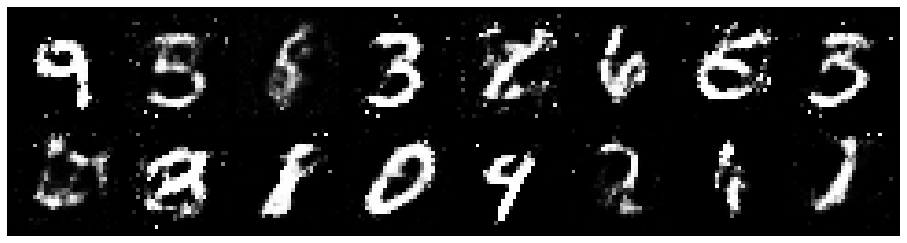

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.2790, Generator Loss: 0.8595
D(x): 0.5664, D(G(z)): 0.4245


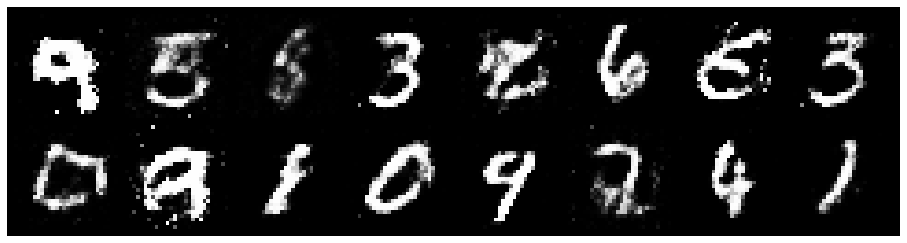

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.3866, Generator Loss: 0.8698
D(x): 0.5273, D(G(z)): 0.4587


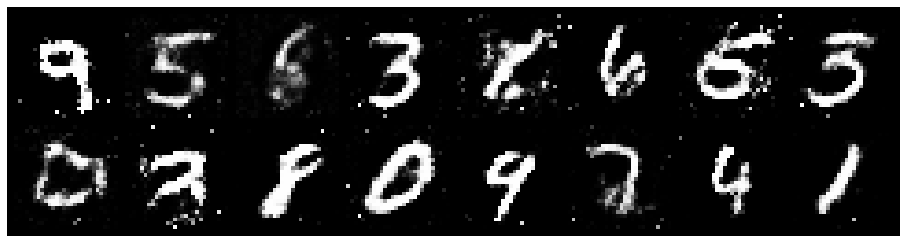

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.2728, Generator Loss: 0.9741
D(x): 0.5306, D(G(z)): 0.3932


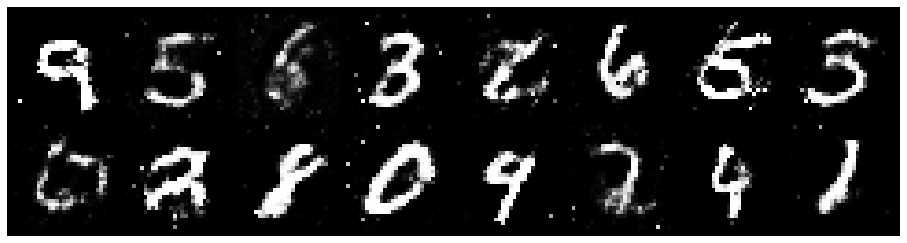

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.2460, Generator Loss: 0.9065
D(x): 0.5821, D(G(z)): 0.4541


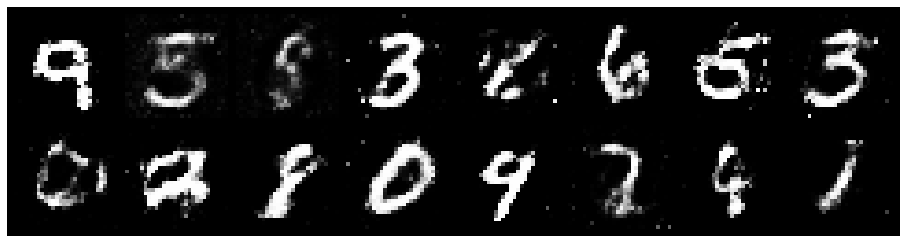

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.2652, Generator Loss: 0.9336
D(x): 0.5258, D(G(z)): 0.4131


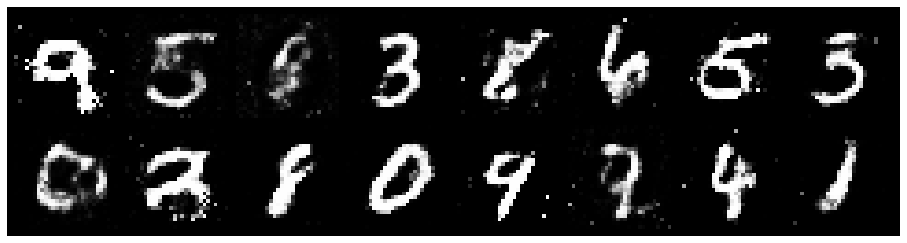

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.2389, Generator Loss: 1.0649
D(x): 0.5581, D(G(z)): 0.4281


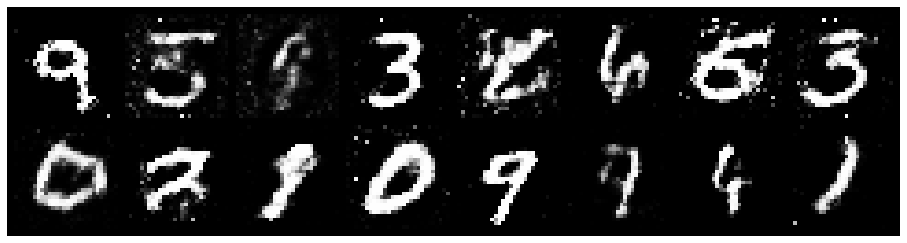

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1132, Generator Loss: 1.0440
D(x): 0.6223, D(G(z)): 0.3953


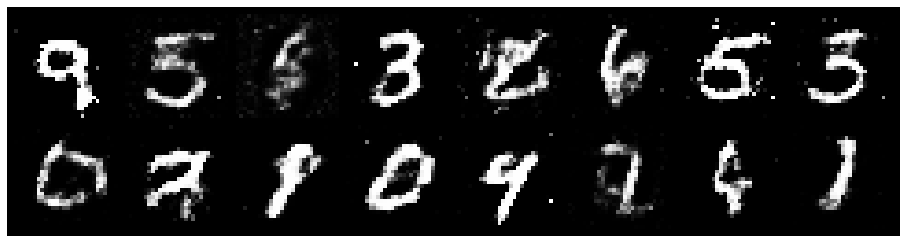

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.0962, Generator Loss: 1.1125
D(x): 0.5832, D(G(z)): 0.3804


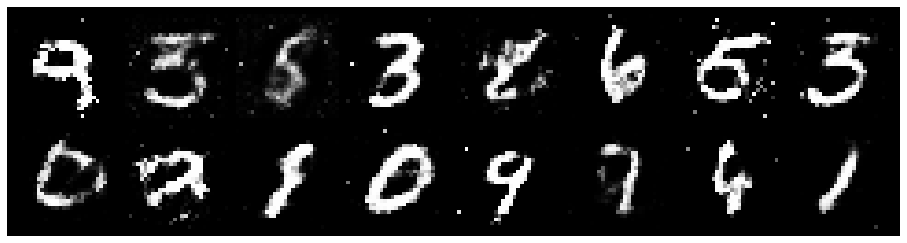

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.1693, Generator Loss: 0.9711
D(x): 0.5877, D(G(z)): 0.4157


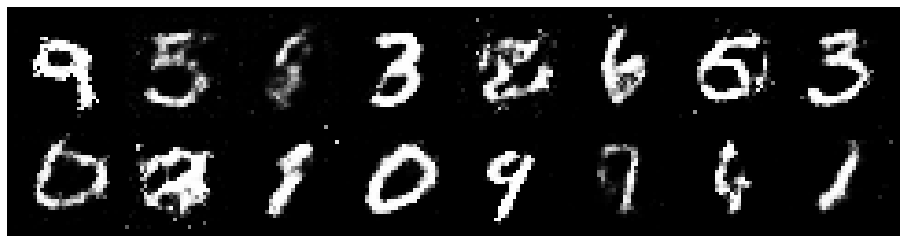

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.1756, Generator Loss: 1.0645
D(x): 0.5763, D(G(z)): 0.4218


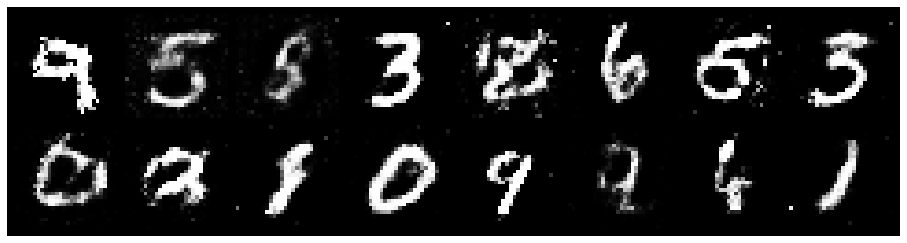

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.1504, Generator Loss: 1.0101
D(x): 0.6070, D(G(z)): 0.4143


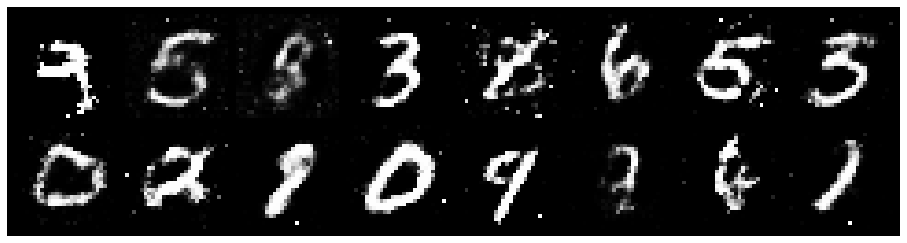

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.2109, Generator Loss: 0.8590
D(x): 0.5820, D(G(z)): 0.4366


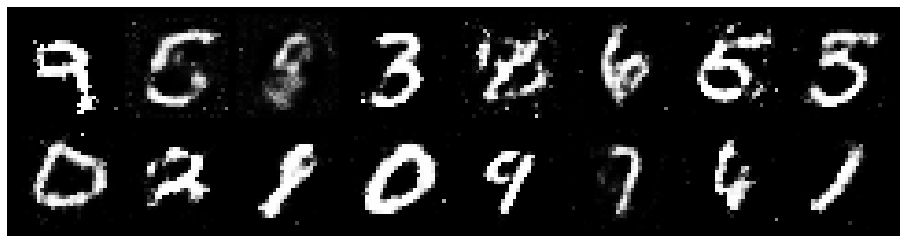

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.2248, Generator Loss: 1.1371
D(x): 0.6366, D(G(z)): 0.4651


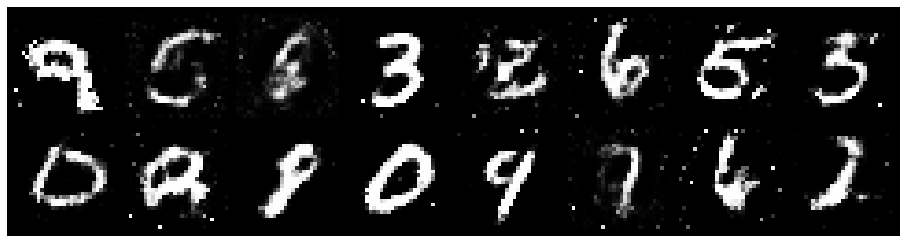

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.3338, Generator Loss: 1.0993
D(x): 0.5815, D(G(z)): 0.4251


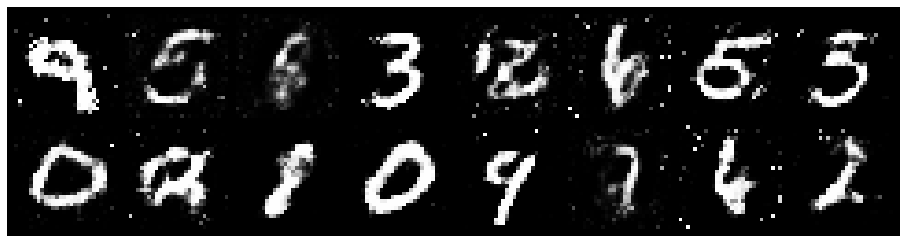

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.1580, Generator Loss: 0.9846
D(x): 0.5692, D(G(z)): 0.3966


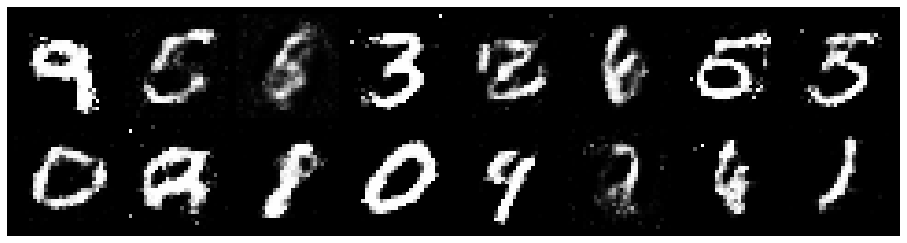

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.2000, Generator Loss: 0.9528
D(x): 0.6075, D(G(z)): 0.4372


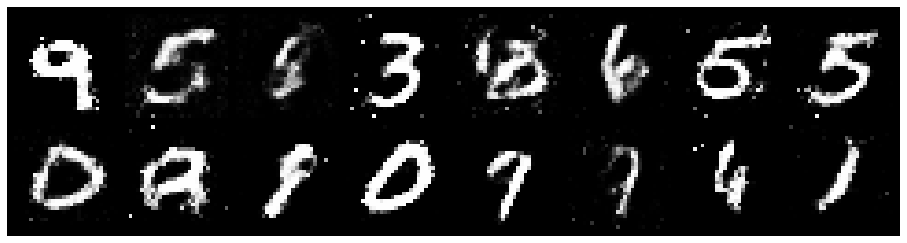

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.2508, Generator Loss: 1.0407
D(x): 0.5480, D(G(z)): 0.4115


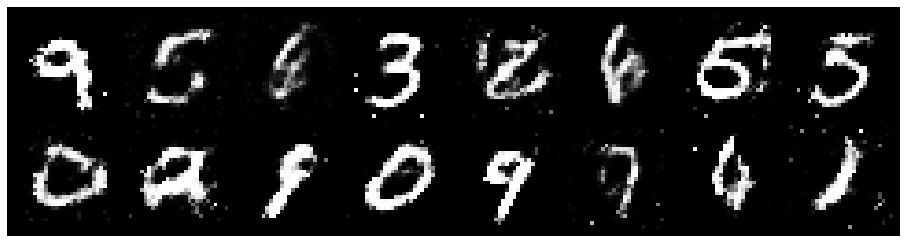

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.2264, Generator Loss: 0.8471
D(x): 0.6246, D(G(z)): 0.4706


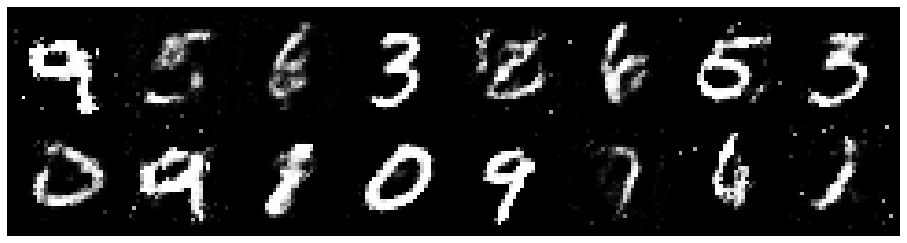

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.1844, Generator Loss: 1.0080
D(x): 0.5819, D(G(z)): 0.4097


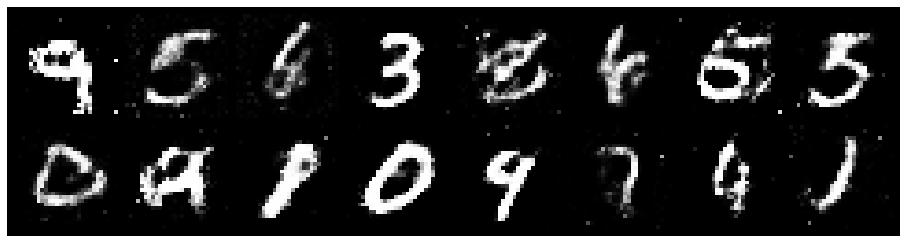

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.2859, Generator Loss: 1.1767
D(x): 0.5106, D(G(z)): 0.3528


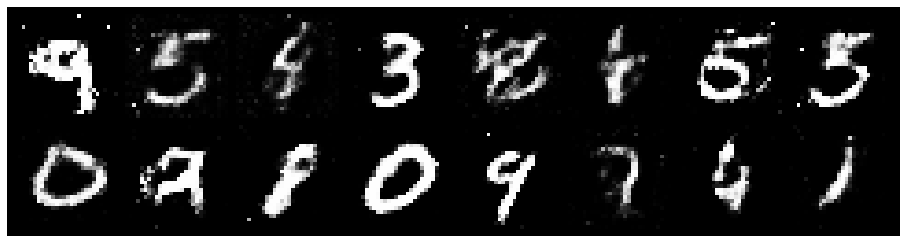

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2344, Generator Loss: 1.0082
D(x): 0.5827, D(G(z)): 0.3953


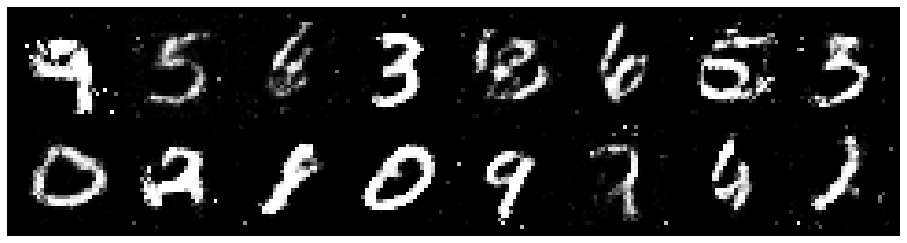

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.1628, Generator Loss: 1.0094
D(x): 0.6355, D(G(z)): 0.4279


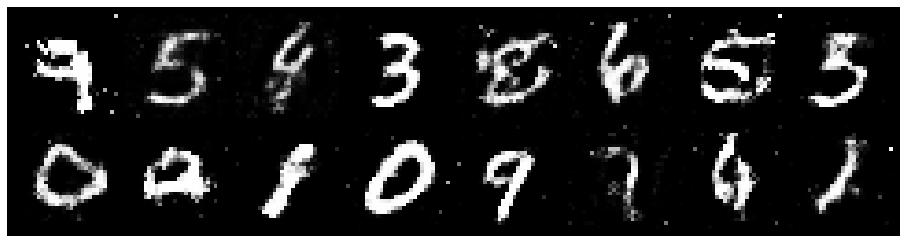

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.1041, Generator Loss: 1.0171
D(x): 0.5826, D(G(z)): 0.3781


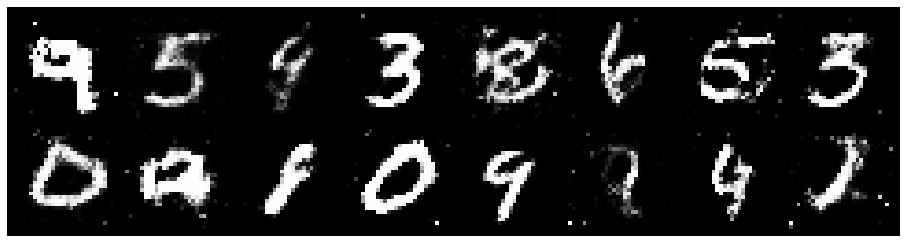

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.1833, Generator Loss: 0.8782
D(x): 0.6192, D(G(z)): 0.4507


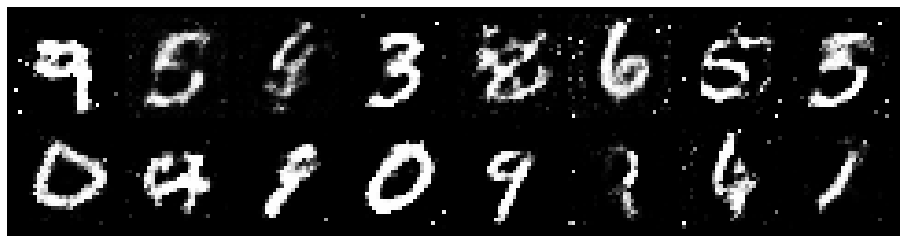

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1888, Generator Loss: 1.0077
D(x): 0.6118, D(G(z)): 0.4241


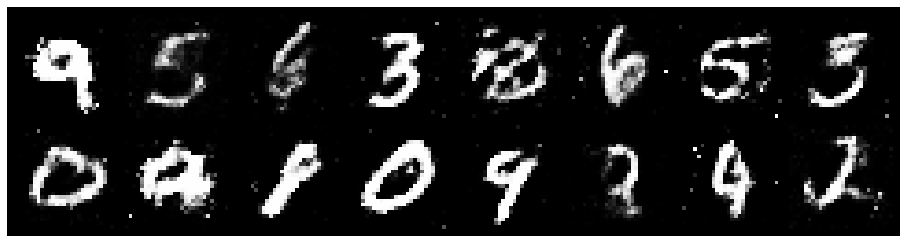

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.0331, Generator Loss: 0.9228
D(x): 0.6410, D(G(z)): 0.3785


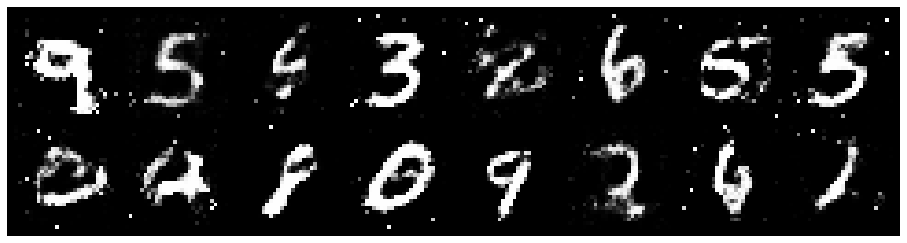

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.1796, Generator Loss: 1.1264
D(x): 0.5477, D(G(z)): 0.3648


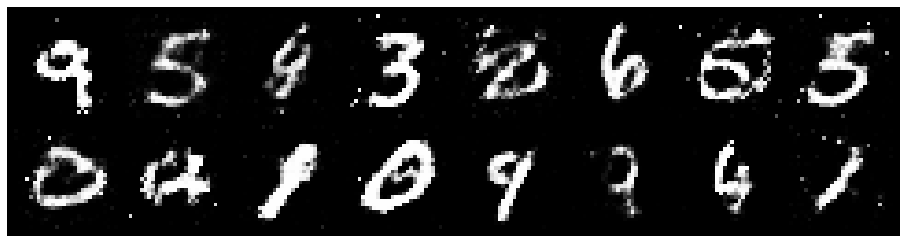

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.1034, Generator Loss: 0.9859
D(x): 0.6079, D(G(z)): 0.4078


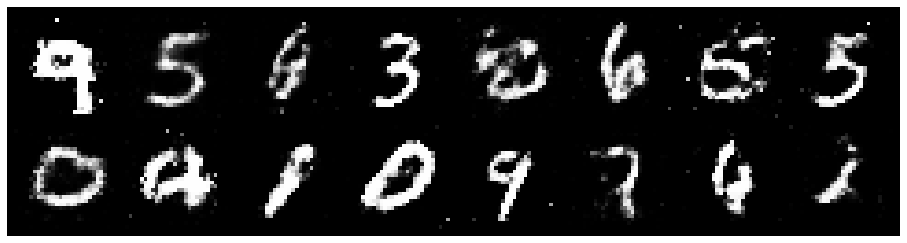

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.2574, Generator Loss: 0.8367
D(x): 0.5900, D(G(z)): 0.4543


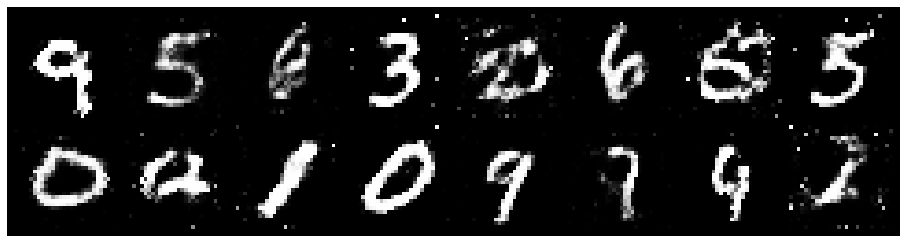

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.3183, Generator Loss: 0.9711
D(x): 0.5513, D(G(z)): 0.4192


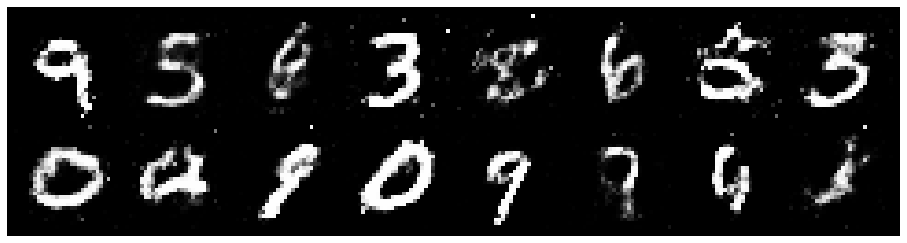

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.2290, Generator Loss: 1.0208
D(x): 0.6242, D(G(z)): 0.4506


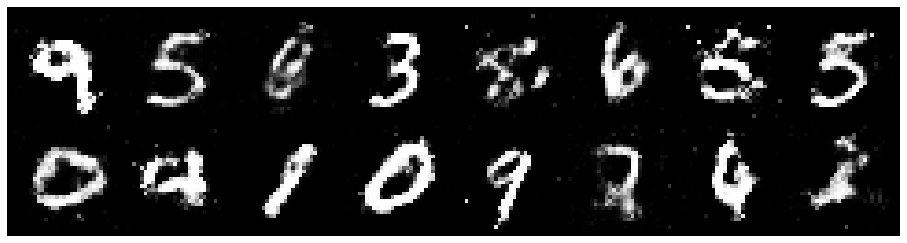

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1231, Generator Loss: 0.9911
D(x): 0.5920, D(G(z)): 0.3792


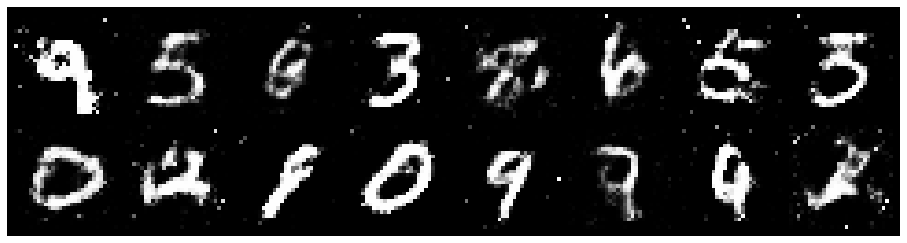

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.1685, Generator Loss: 0.8031
D(x): 0.5762, D(G(z)): 0.4243


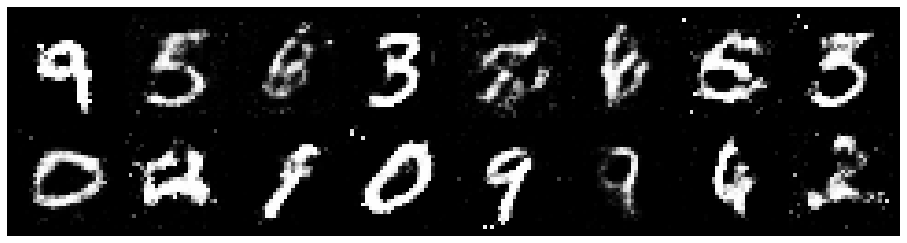

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.4616, Generator Loss: 0.9518
D(x): 0.6327, D(G(z)): 0.5407


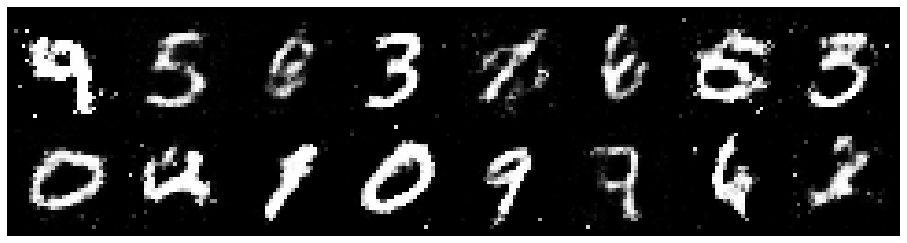

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2752, Generator Loss: 0.9149
D(x): 0.5748, D(G(z)): 0.4286


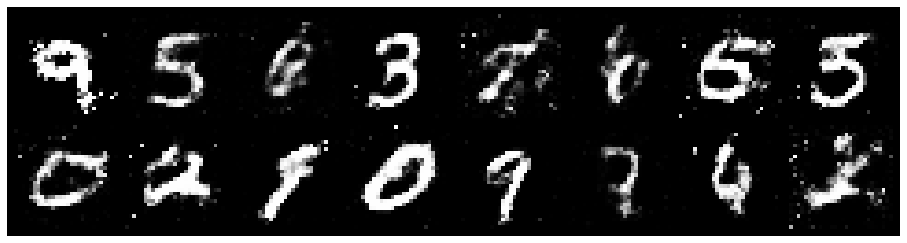

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.0943, Generator Loss: 1.0942
D(x): 0.6014, D(G(z)): 0.3883


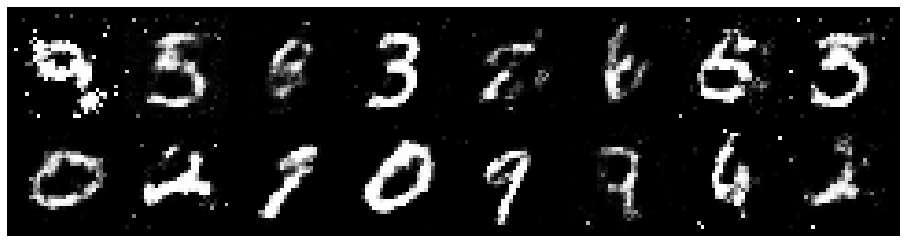

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2076, Generator Loss: 1.1173
D(x): 0.5433, D(G(z)): 0.3744


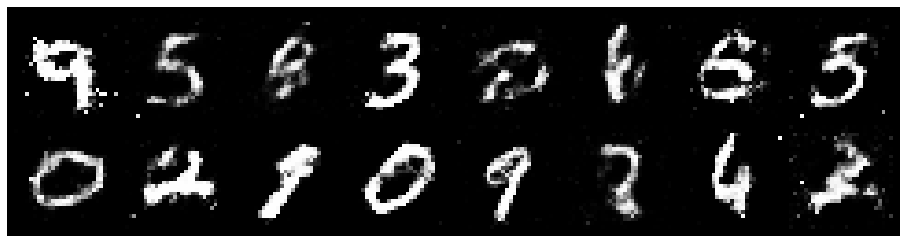

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2039, Generator Loss: 1.0608
D(x): 0.5628, D(G(z)): 0.3927


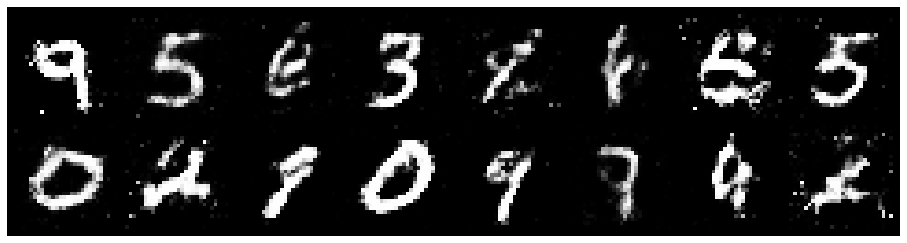

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.2776, Generator Loss: 0.9004
D(x): 0.5492, D(G(z)): 0.4192


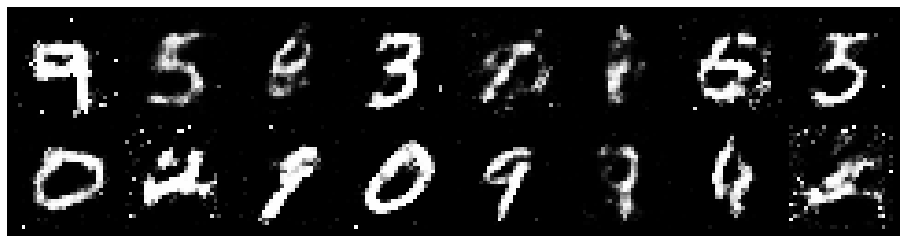

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.2532, Generator Loss: 0.7063
D(x): 0.6089, D(G(z)): 0.4865


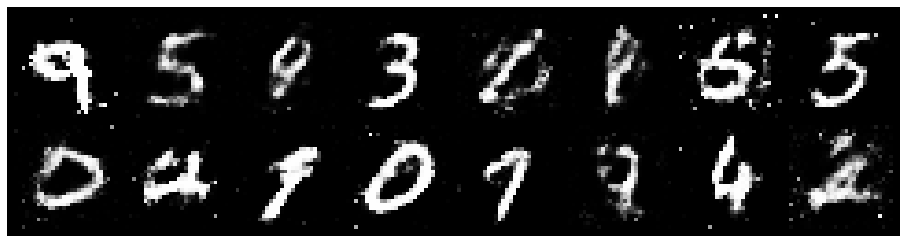

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.2141, Generator Loss: 0.9472
D(x): 0.5376, D(G(z)): 0.3729


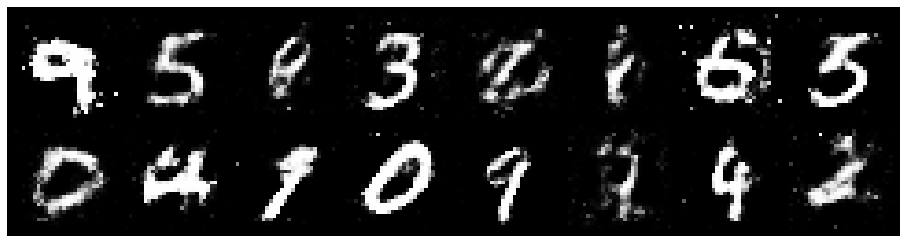

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.2423, Generator Loss: 1.0038
D(x): 0.6085, D(G(z)): 0.4568


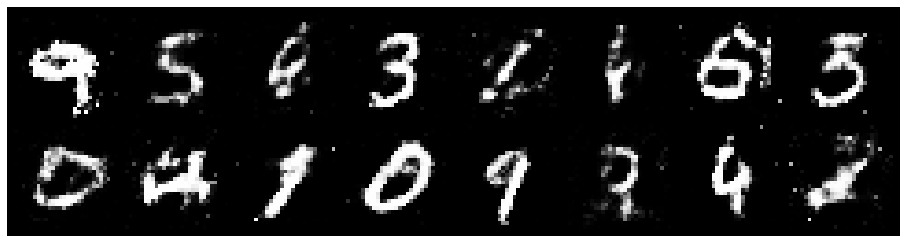

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.3179, Generator Loss: 0.9563
D(x): 0.5425, D(G(z)): 0.4479


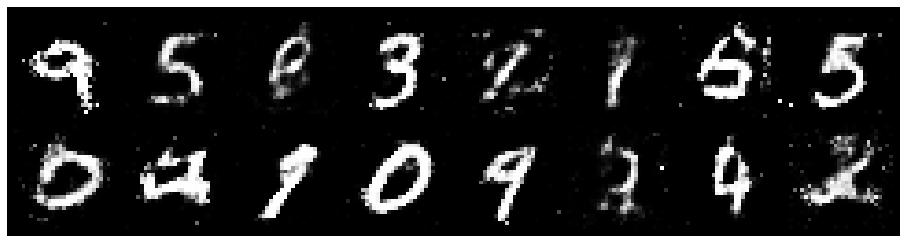

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.1545, Generator Loss: 0.9923
D(x): 0.5996, D(G(z)): 0.4085


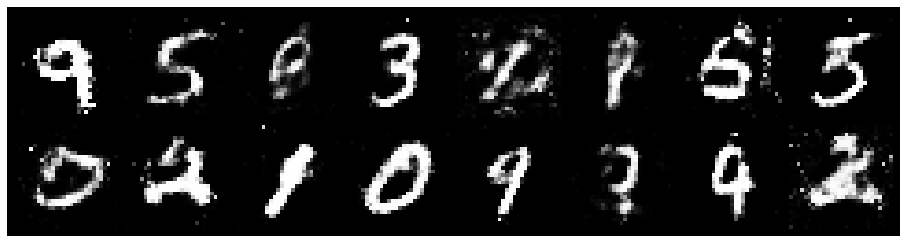

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.1903, Generator Loss: 1.1863
D(x): 0.5734, D(G(z)): 0.3940


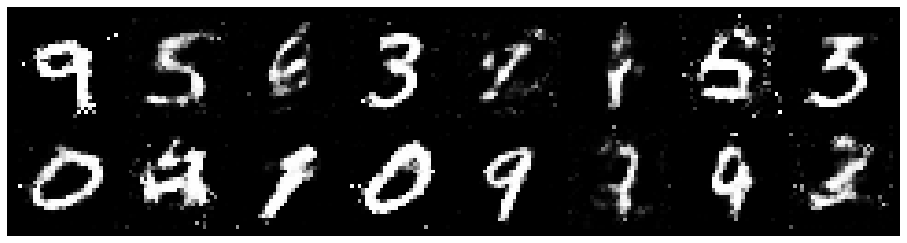

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.2399, Generator Loss: 1.1026
D(x): 0.4925, D(G(z)): 0.3397


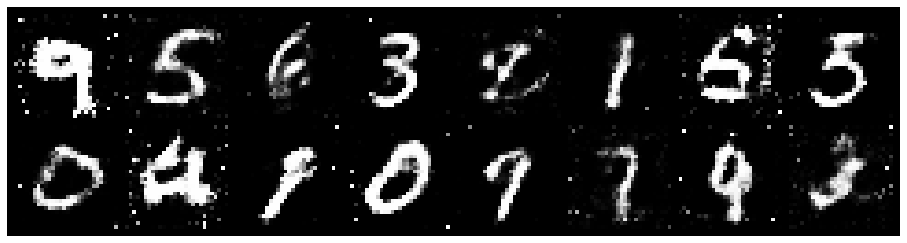

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.3411, Generator Loss: 0.9343
D(x): 0.5355, D(G(z)): 0.4325


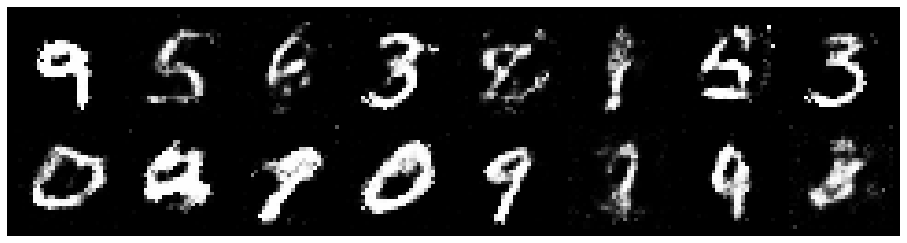

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.2885, Generator Loss: 0.9823
D(x): 0.5736, D(G(z)): 0.4420


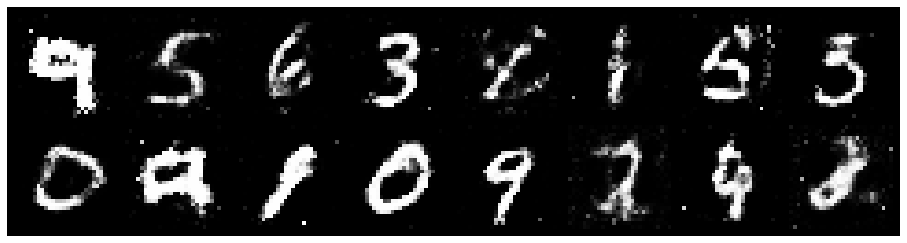

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1969, Generator Loss: 0.9050
D(x): 0.5980, D(G(z)): 0.4371


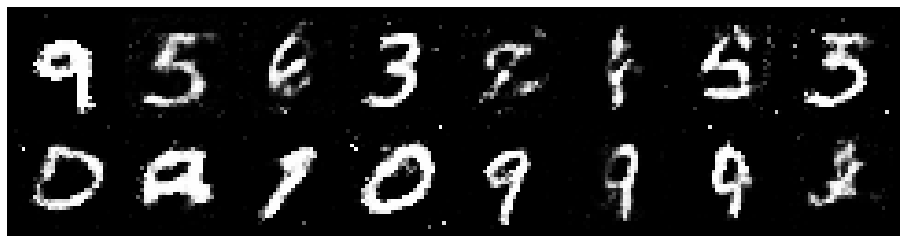

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.1356, Generator Loss: 1.1483
D(x): 0.6691, D(G(z)): 0.4331


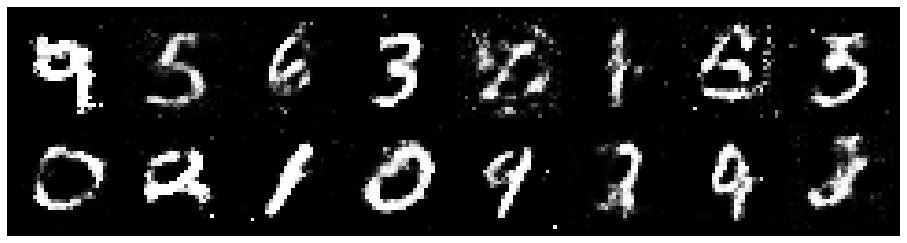

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.1449, Generator Loss: 1.0212
D(x): 0.6038, D(G(z)): 0.3918


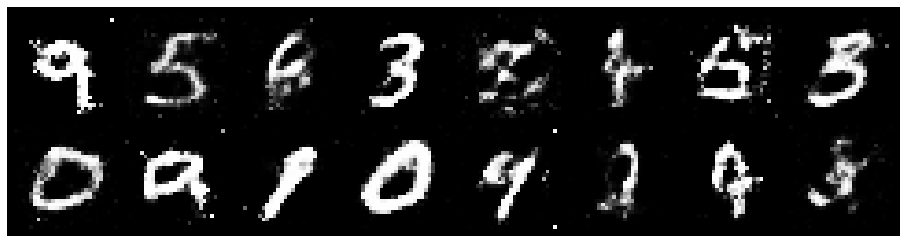

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2664, Generator Loss: 1.0745
D(x): 0.5475, D(G(z)): 0.4115


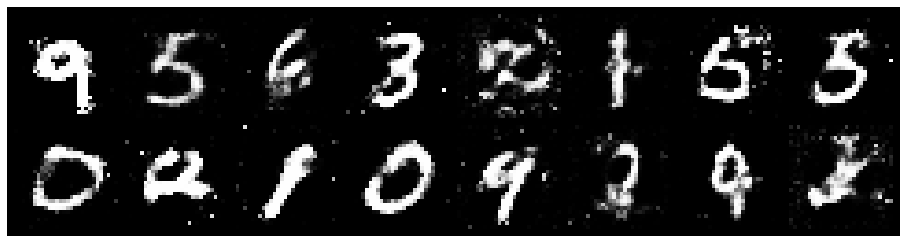

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.2701, Generator Loss: 1.1372
D(x): 0.5300, D(G(z)): 0.3746


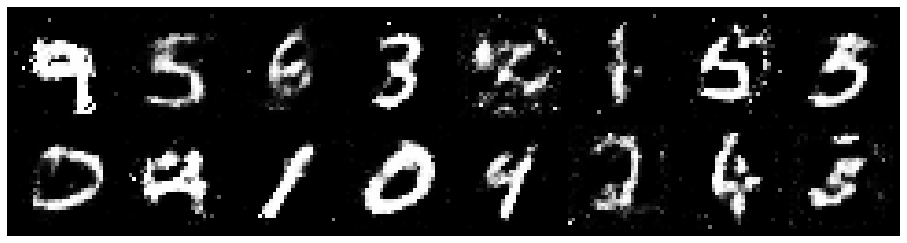

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.1237, Generator Loss: 0.9617
D(x): 0.5981, D(G(z)): 0.3960


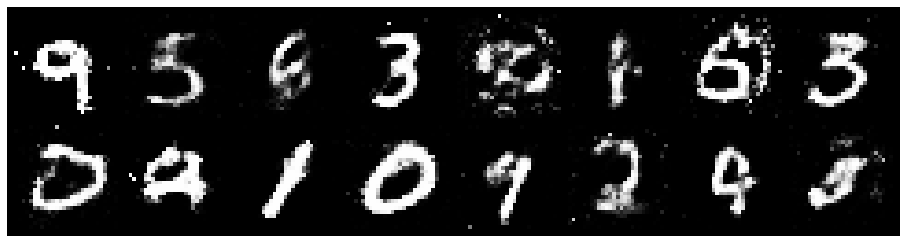

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.2367, Generator Loss: 1.0173
D(x): 0.6076, D(G(z)): 0.4317


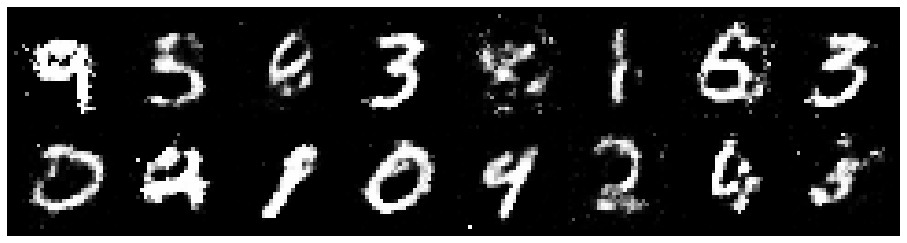

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.1360, Generator Loss: 1.0088
D(x): 0.5833, D(G(z)): 0.3887


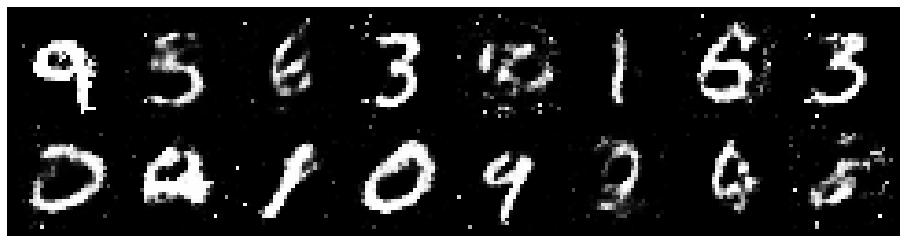

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.2515, Generator Loss: 1.1219
D(x): 0.6086, D(G(z)): 0.4561


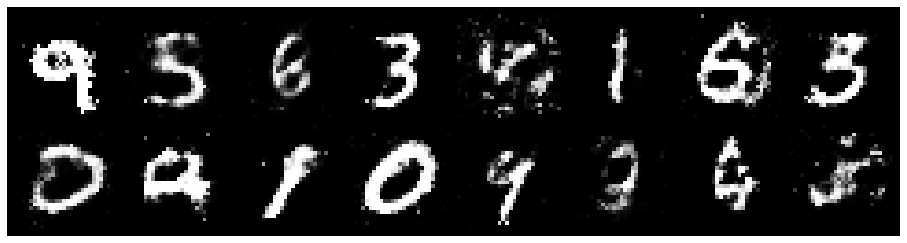

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1640, Generator Loss: 1.0983
D(x): 0.5842, D(G(z)): 0.4075


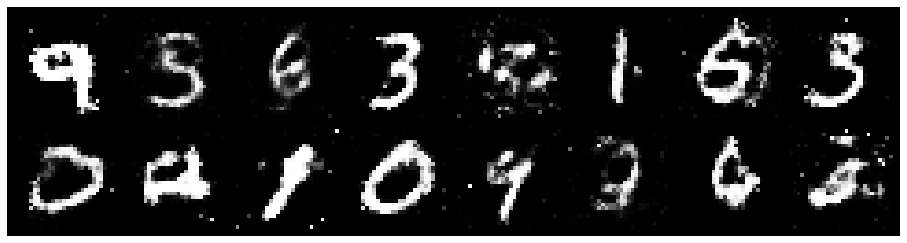

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2366, Generator Loss: 1.0141
D(x): 0.5406, D(G(z)): 0.4082


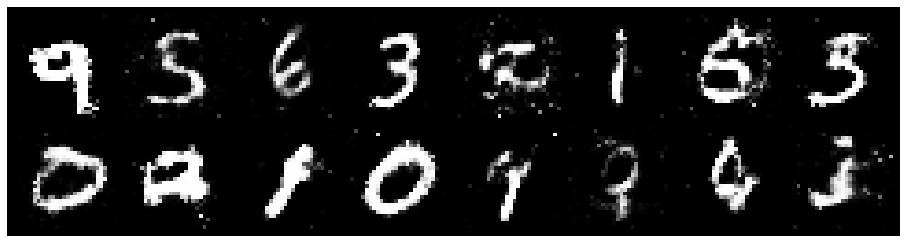

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.3545, Generator Loss: 0.9771
D(x): 0.5074, D(G(z)): 0.4284


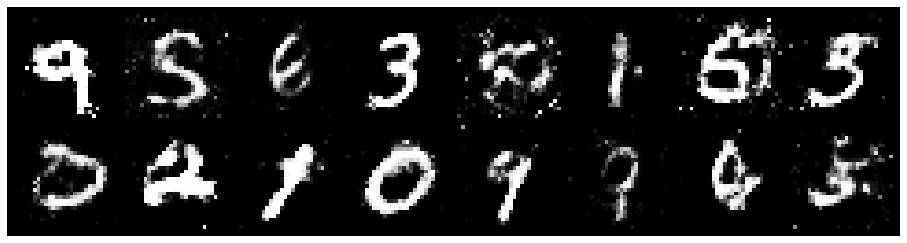

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.2415, Generator Loss: 1.0615
D(x): 0.6146, D(G(z)): 0.4386


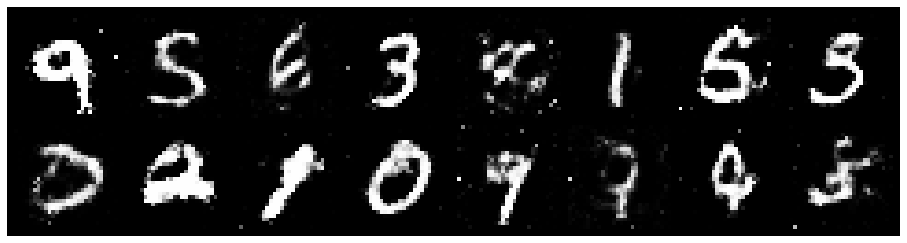

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.2246, Generator Loss: 1.0671
D(x): 0.5901, D(G(z)): 0.3950


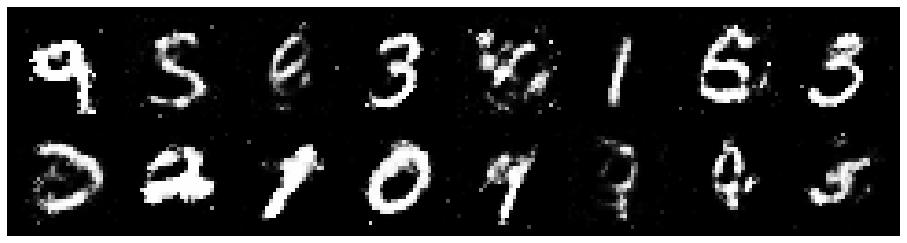

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.1899, Generator Loss: 0.9466
D(x): 0.5902, D(G(z)): 0.4239


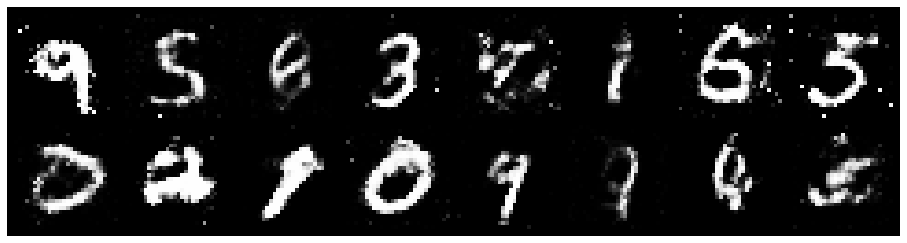

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.1166, Generator Loss: 0.9403
D(x): 0.5766, D(G(z)): 0.3672


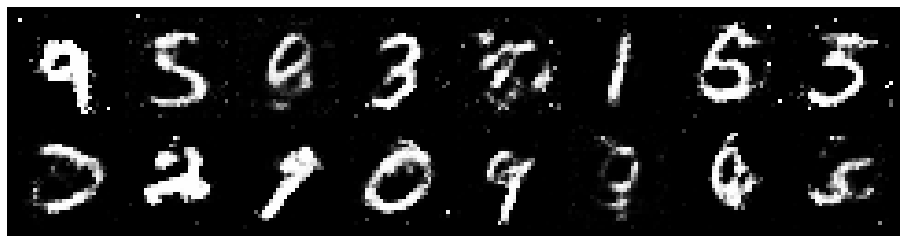

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.2184, Generator Loss: 0.9385
D(x): 0.5810, D(G(z)): 0.4346


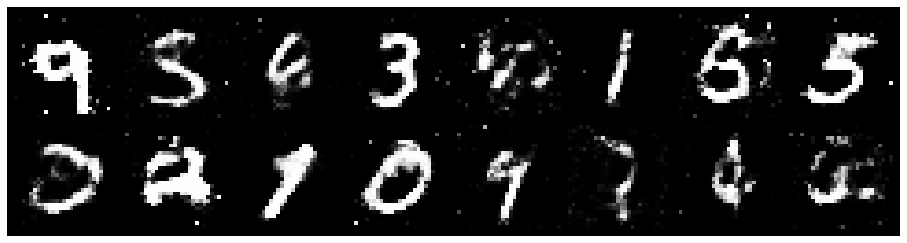

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.2291, Generator Loss: 1.1066
D(x): 0.5750, D(G(z)): 0.4059


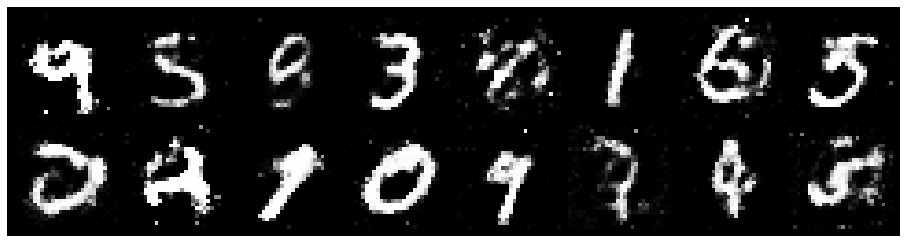

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.0878, Generator Loss: 1.0708
D(x): 0.6158, D(G(z)): 0.3592


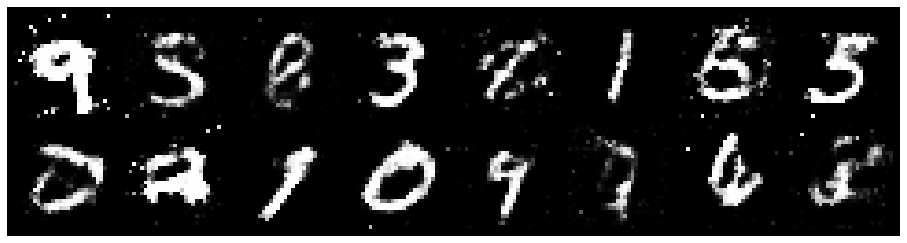

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.1559, Generator Loss: 1.1417
D(x): 0.5980, D(G(z)): 0.4075


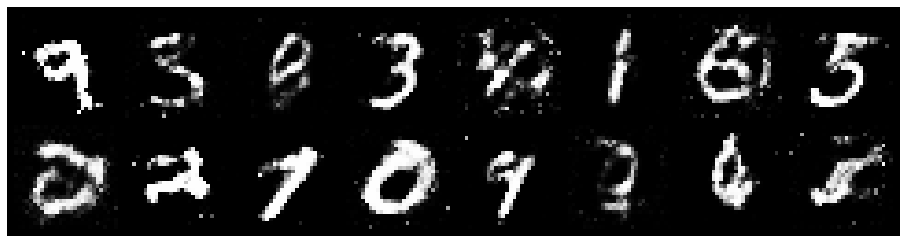

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.1716, Generator Loss: 1.0523
D(x): 0.6099, D(G(z)): 0.4329


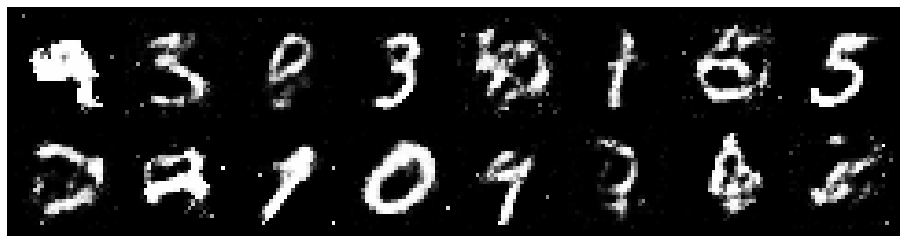

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.1934, Generator Loss: 1.0231
D(x): 0.5597, D(G(z)): 0.4016


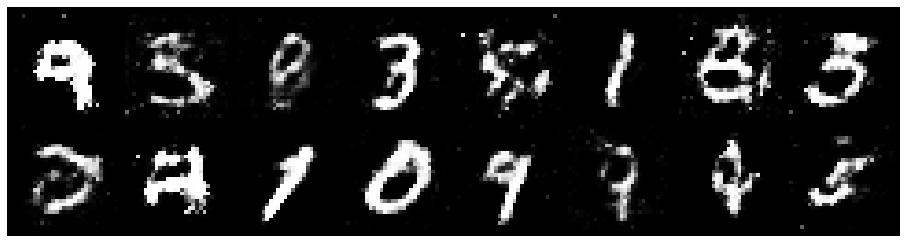

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1788, Generator Loss: 0.9958
D(x): 0.5880, D(G(z)): 0.4091


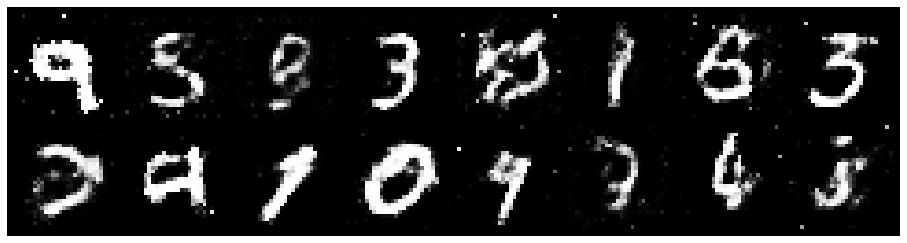

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2454, Generator Loss: 0.9739
D(x): 0.5829, D(G(z)): 0.4440


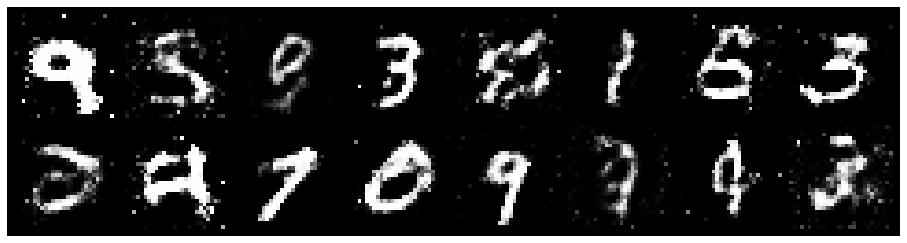

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.2377, Generator Loss: 0.9409
D(x): 0.5251, D(G(z)): 0.3970


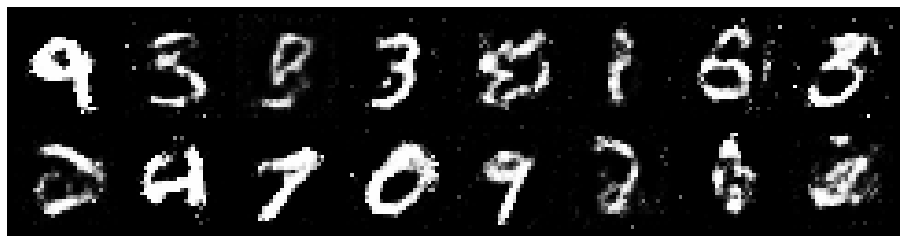

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.3136, Generator Loss: 0.8022
D(x): 0.5262, D(G(z)): 0.4390


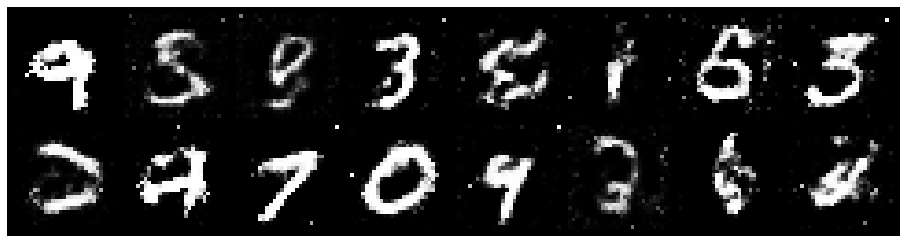

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.2140, Generator Loss: 1.2943
D(x): 0.5848, D(G(z)): 0.3947


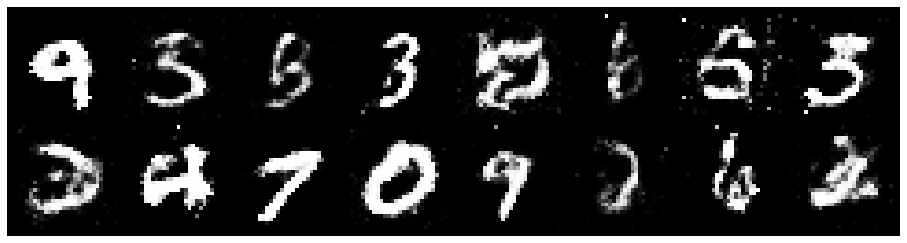

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.2728, Generator Loss: 0.9996
D(x): 0.5591, D(G(z)): 0.4367


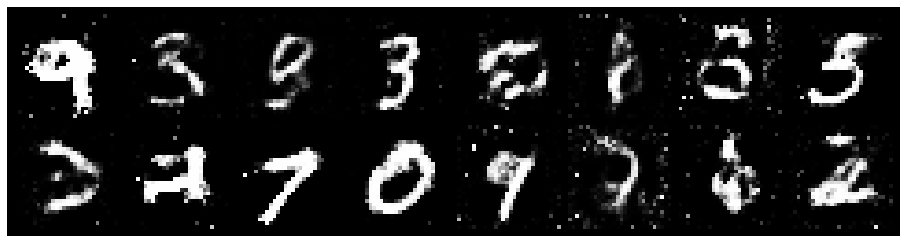

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.2324, Generator Loss: 0.8235
D(x): 0.5889, D(G(z)): 0.4444


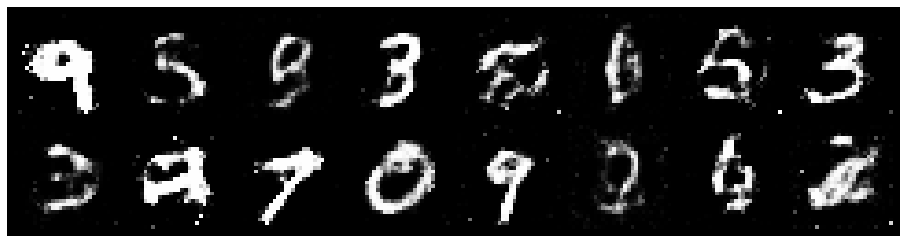

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2481, Generator Loss: 0.9257
D(x): 0.5828, D(G(z)): 0.4542


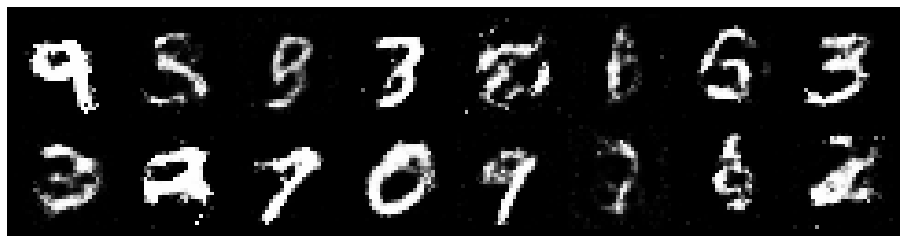

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.2642, Generator Loss: 1.1121
D(x): 0.5113, D(G(z)): 0.3806


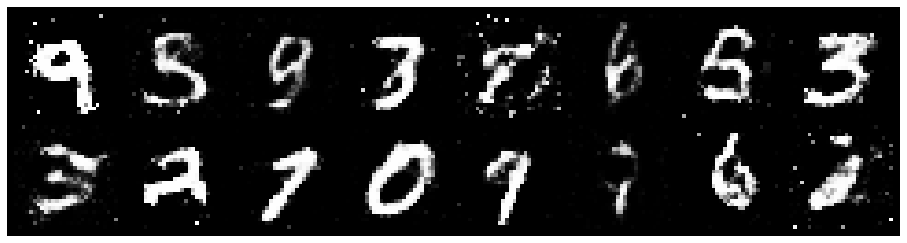

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.2289, Generator Loss: 0.9906
D(x): 0.6247, D(G(z)): 0.4470


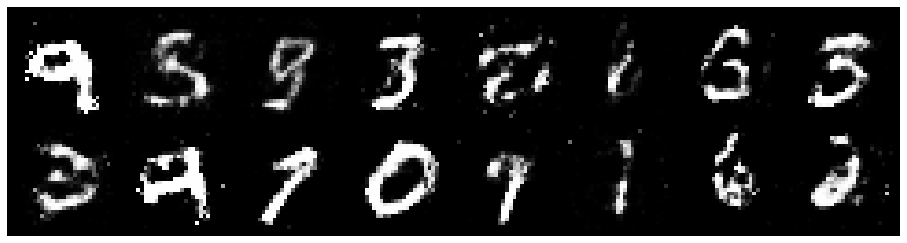

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.2253, Generator Loss: 1.0470
D(x): 0.5847, D(G(z)): 0.4272


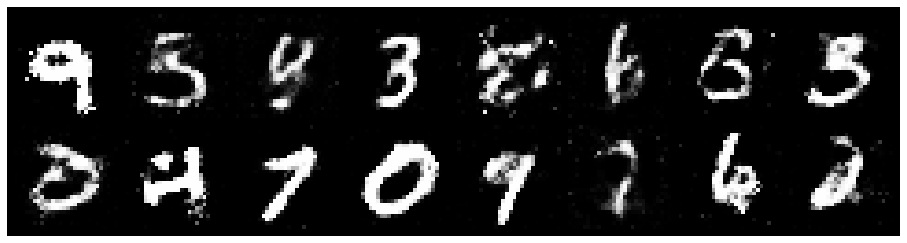

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.2632, Generator Loss: 1.0996
D(x): 0.5317, D(G(z)): 0.3780


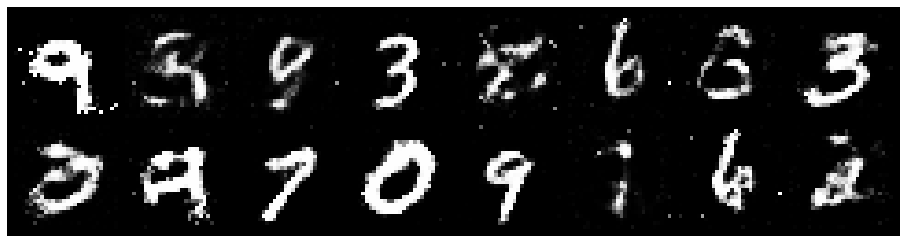

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2934, Generator Loss: 0.9284
D(x): 0.5459, D(G(z)): 0.4433


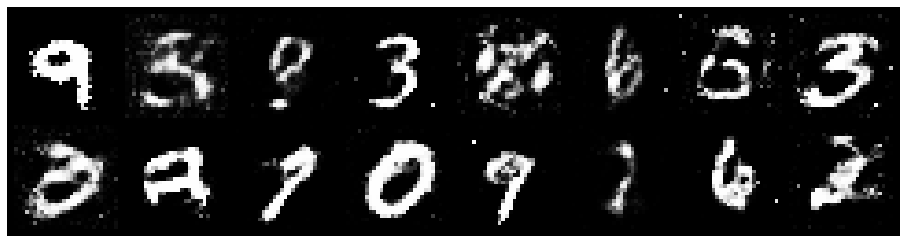

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.0789, Generator Loss: 1.1643
D(x): 0.6073, D(G(z)): 0.3803


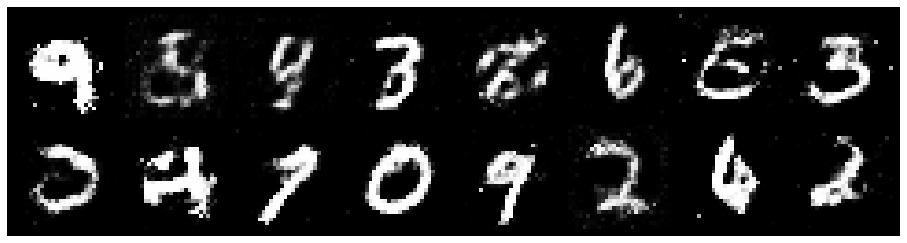

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.1838, Generator Loss: 0.9481
D(x): 0.5840, D(G(z)): 0.4211


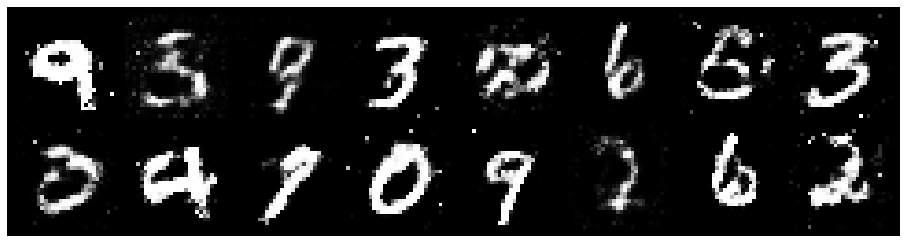

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1537, Generator Loss: 1.0707
D(x): 0.5963, D(G(z)): 0.4103


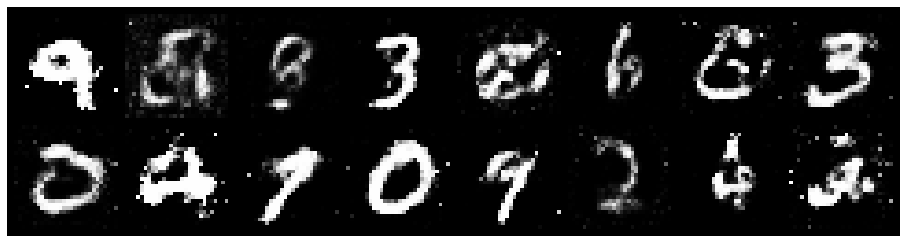

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.1618, Generator Loss: 1.0521
D(x): 0.5701, D(G(z)): 0.4050


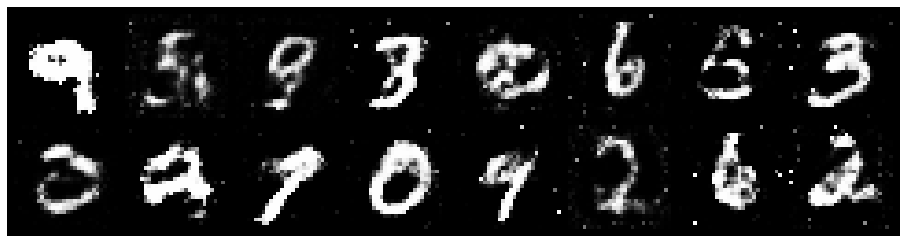

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.1510, Generator Loss: 1.0548
D(x): 0.5767, D(G(z)): 0.3925


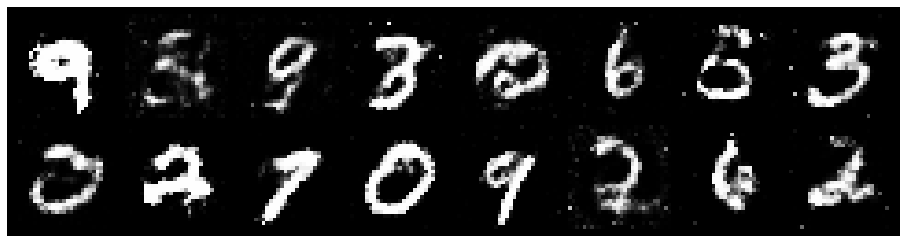

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.1584, Generator Loss: 1.0008
D(x): 0.5860, D(G(z)): 0.4075


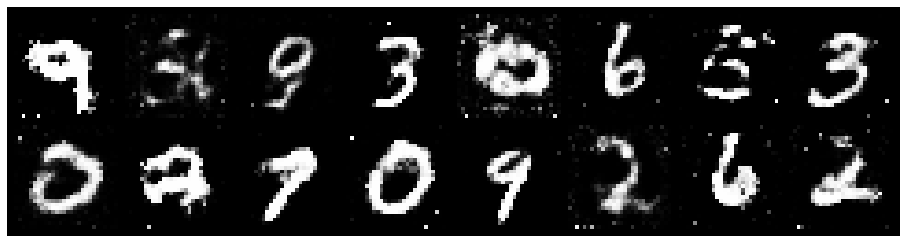

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.2109, Generator Loss: 0.8464
D(x): 0.5919, D(G(z)): 0.4545


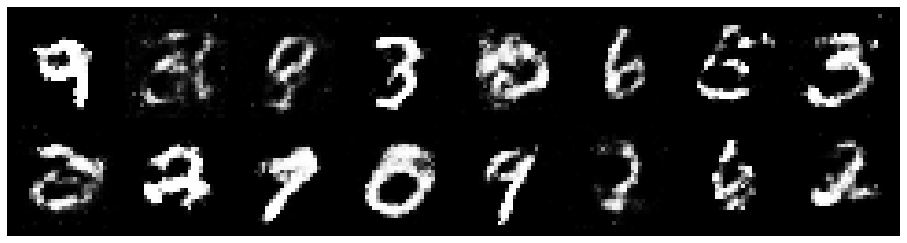

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.2746, Generator Loss: 1.0938
D(x): 0.5390, D(G(z)): 0.4315


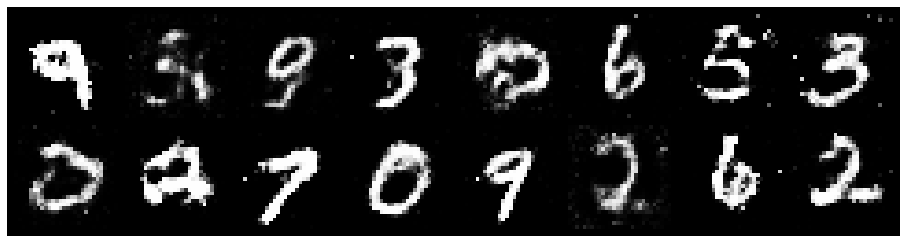

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.2848, Generator Loss: 1.0048
D(x): 0.5320, D(G(z)): 0.4123


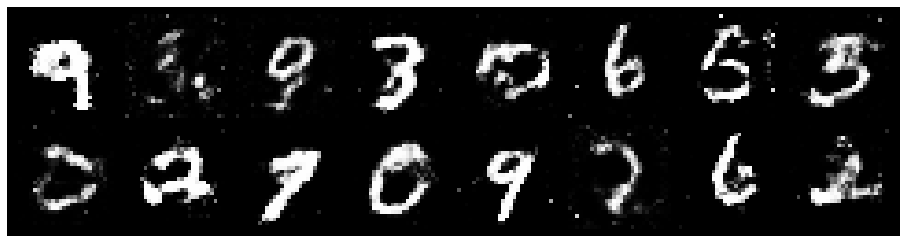

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2111, Generator Loss: 0.8568
D(x): 0.5992, D(G(z)): 0.4390


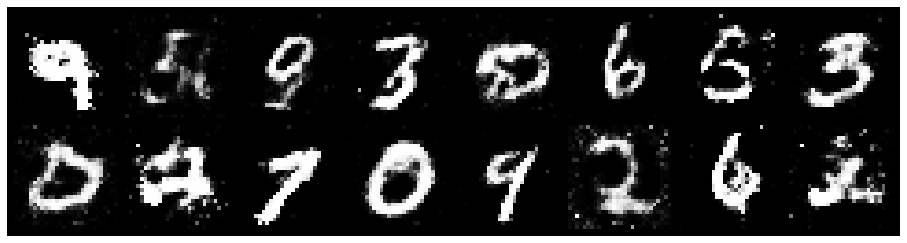

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.1702, Generator Loss: 0.9728
D(x): 0.5836, D(G(z)): 0.4052


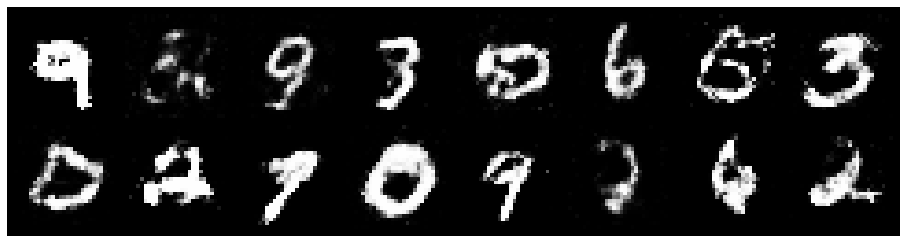

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.1048, Generator Loss: 0.8742
D(x): 0.6117, D(G(z)): 0.4127


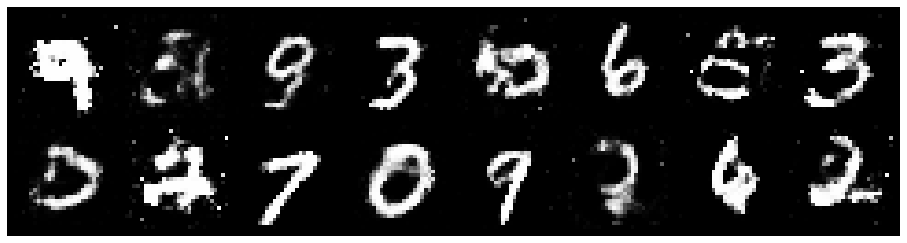

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.3023, Generator Loss: 0.9023
D(x): 0.5174, D(G(z)): 0.4376


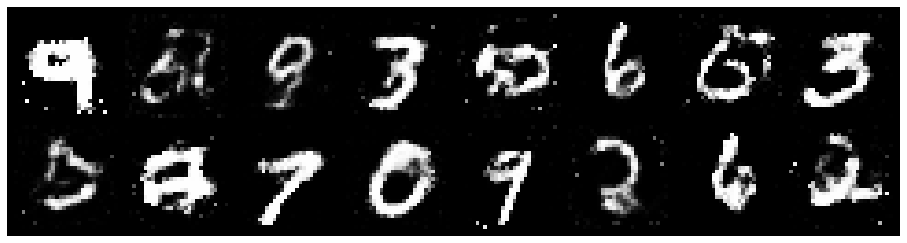

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.3242, Generator Loss: 0.9517
D(x): 0.5148, D(G(z)): 0.4299


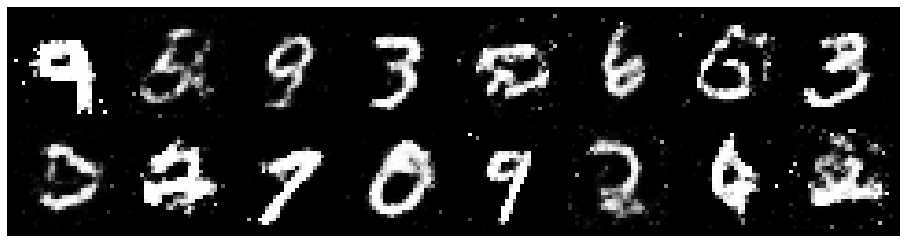

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2206, Generator Loss: 1.1448
D(x): 0.5671, D(G(z)): 0.3856


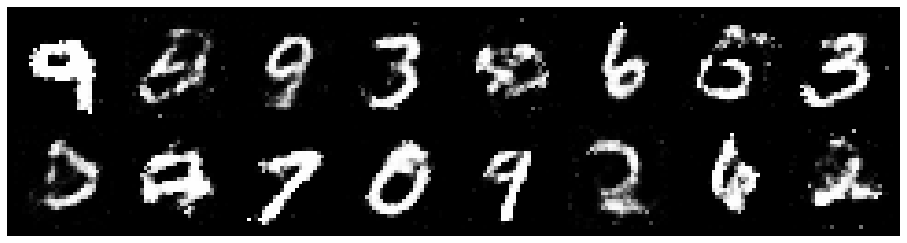

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.2004, Generator Loss: 0.9839
D(x): 0.5793, D(G(z)): 0.4209


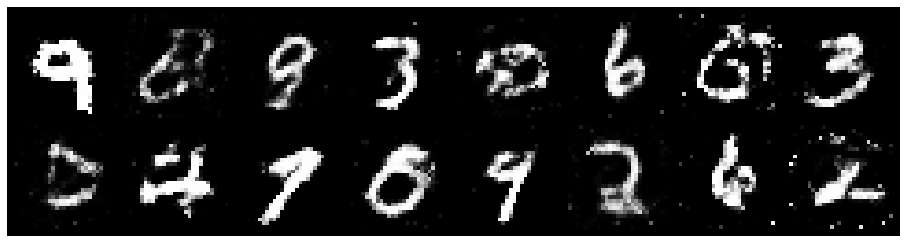

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.2816, Generator Loss: 1.0187
D(x): 0.5277, D(G(z)): 0.4113


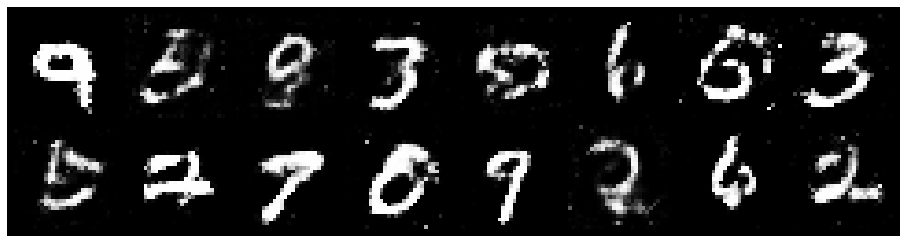

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.2721, Generator Loss: 0.8976
D(x): 0.5409, D(G(z)): 0.4474


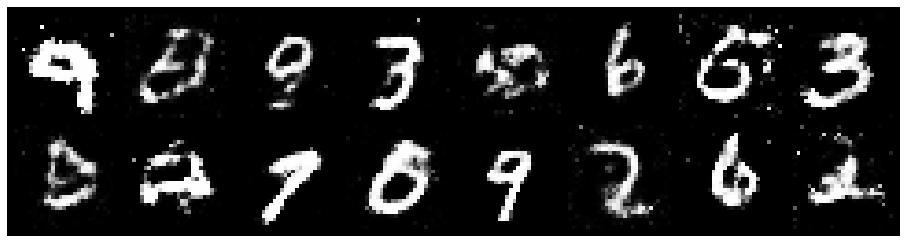

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.1897, Generator Loss: 0.9409
D(x): 0.6098, D(G(z)): 0.4284


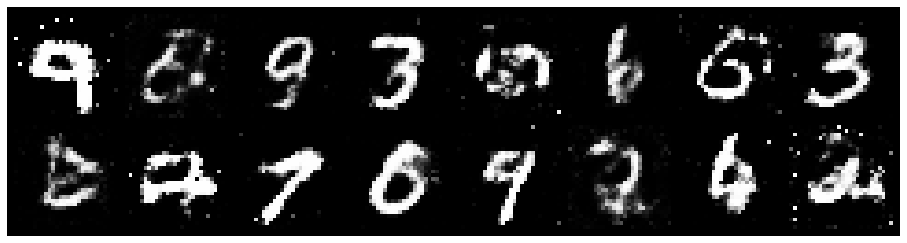

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.2543, Generator Loss: 1.0676
D(x): 0.5617, D(G(z)): 0.3907


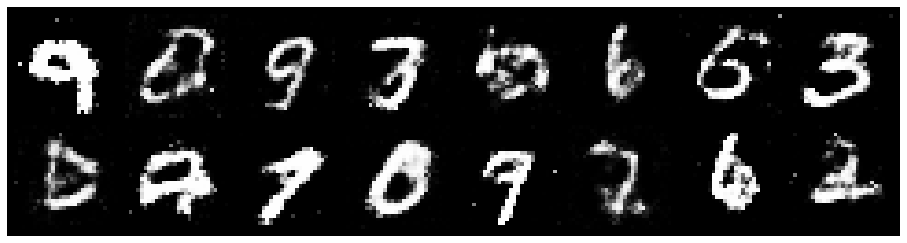

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2267, Generator Loss: 0.8764
D(x): 0.5854, D(G(z)): 0.4276


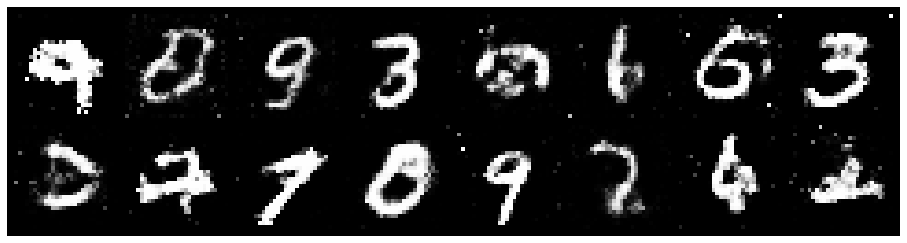

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.1650, Generator Loss: 1.0749
D(x): 0.6250, D(G(z)): 0.4180


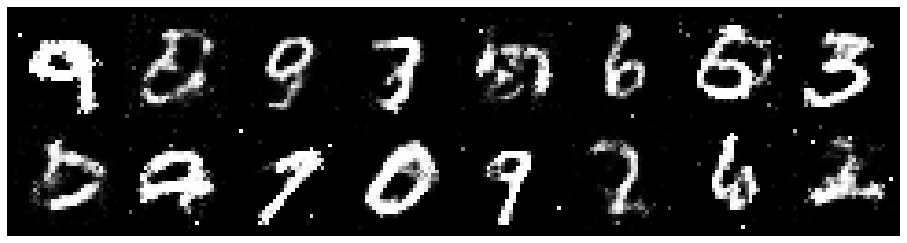

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.1829, Generator Loss: 0.8941
D(x): 0.5871, D(G(z)): 0.4133


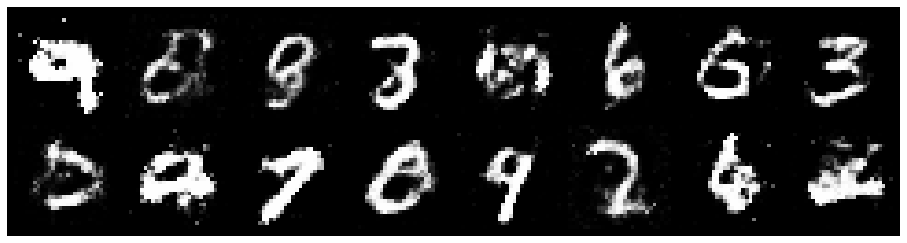

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.2329, Generator Loss: 0.8487
D(x): 0.5522, D(G(z)): 0.4073


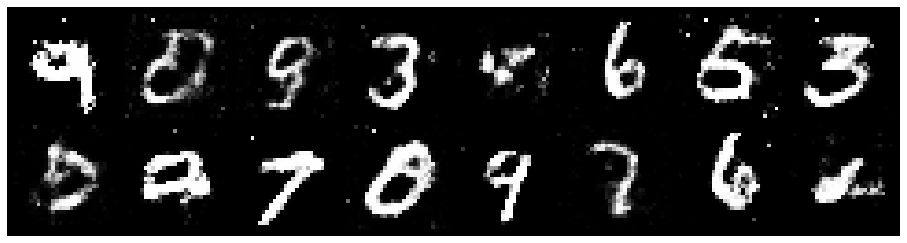

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.0989, Generator Loss: 1.1672
D(x): 0.6070, D(G(z)): 0.3687


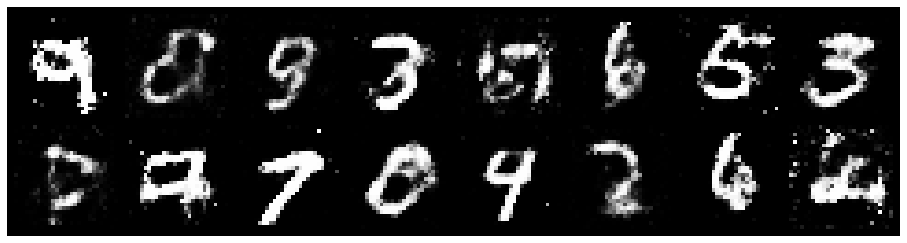

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.1932, Generator Loss: 0.9424
D(x): 0.5875, D(G(z)): 0.4257


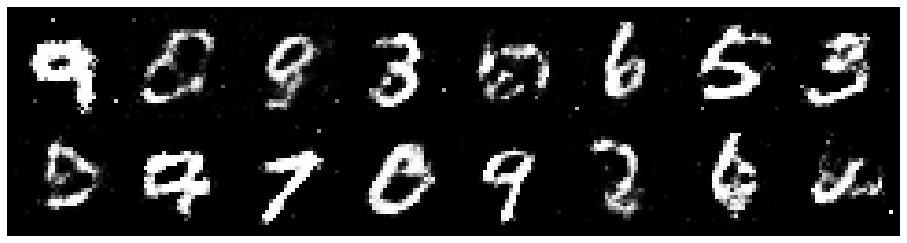

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.2563, Generator Loss: 0.8608
D(x): 0.5657, D(G(z)): 0.4438


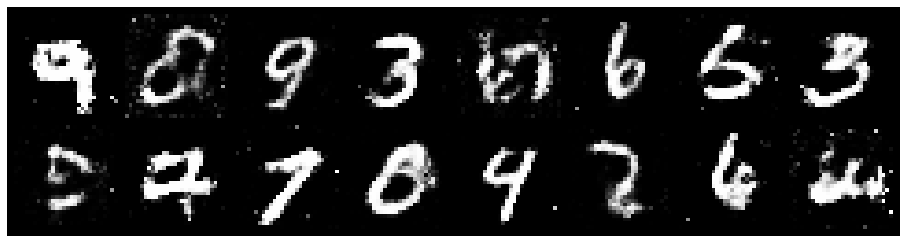

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.2749, Generator Loss: 0.9910
D(x): 0.5758, D(G(z)): 0.4376


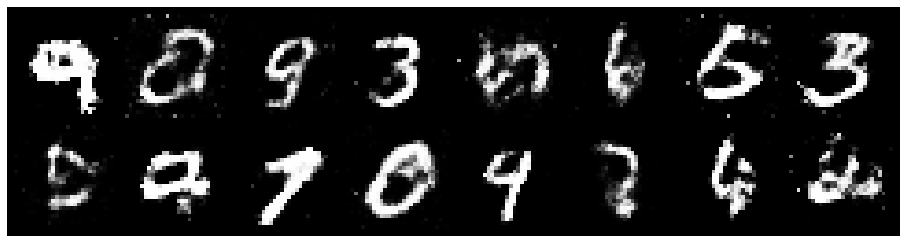

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2029, Generator Loss: 1.0290
D(x): 0.5835, D(G(z)): 0.4181


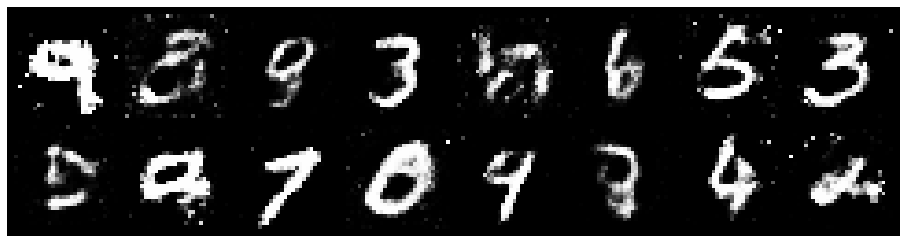

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.1350, Generator Loss: 1.0683
D(x): 0.5763, D(G(z)): 0.3666


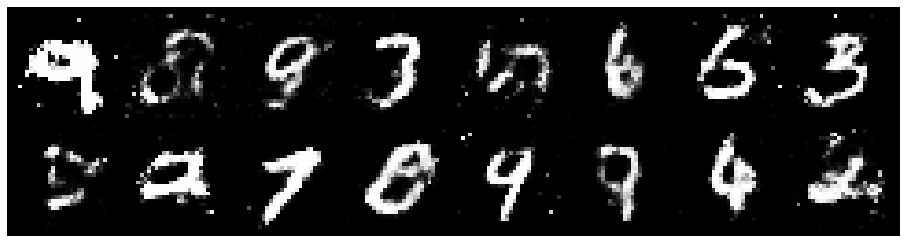

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.1896, Generator Loss: 0.8967
D(x): 0.5845, D(G(z)): 0.4124


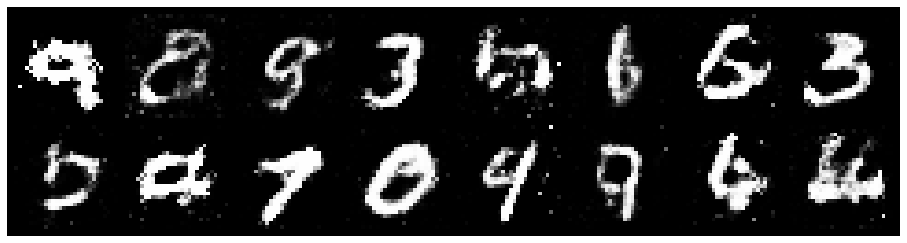

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.3254, Generator Loss: 0.9541
D(x): 0.5534, D(G(z)): 0.4588


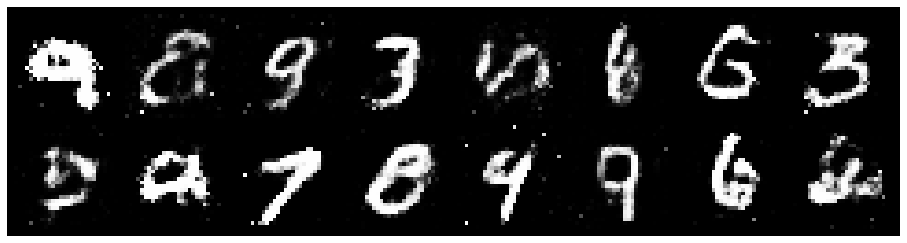

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.2990, Generator Loss: 0.8583
D(x): 0.5451, D(G(z)): 0.4393


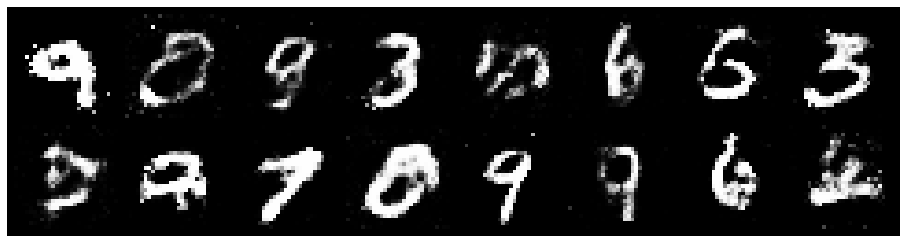

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.2046, Generator Loss: 1.0319
D(x): 0.5634, D(G(z)): 0.4139


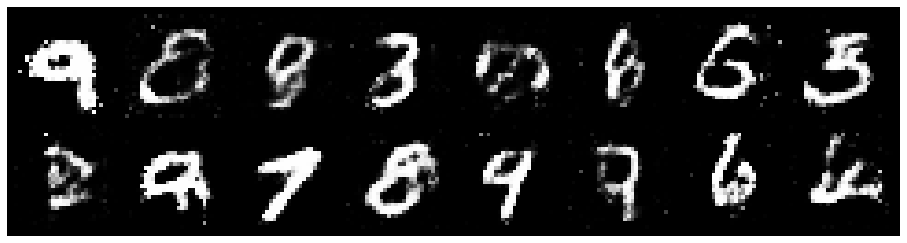

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2557, Generator Loss: 0.9546
D(x): 0.5426, D(G(z)): 0.3909


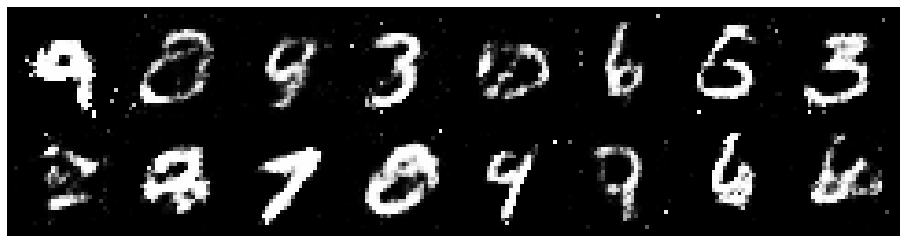

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.1235, Generator Loss: 1.0169
D(x): 0.6217, D(G(z)): 0.4201


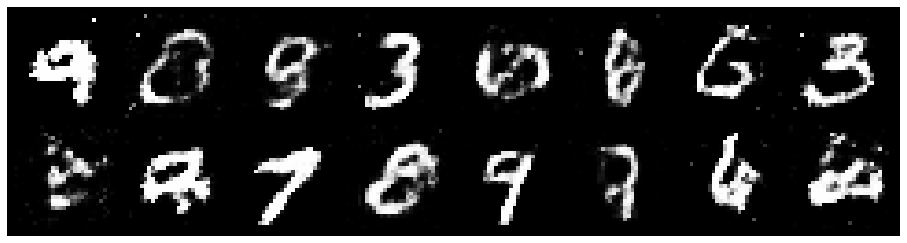

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.3455, Generator Loss: 1.0603
D(x): 0.5533, D(G(z)): 0.3946


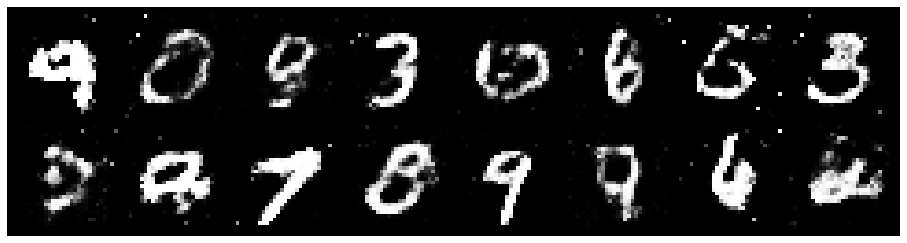

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.3194, Generator Loss: 1.0204
D(x): 0.5464, D(G(z)): 0.4077


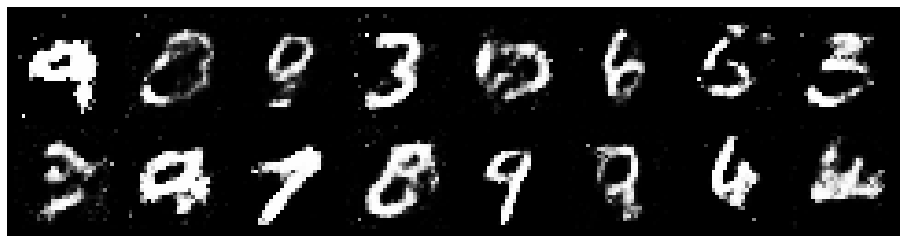

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.3530, Generator Loss: 1.0273
D(x): 0.5634, D(G(z)): 0.4382


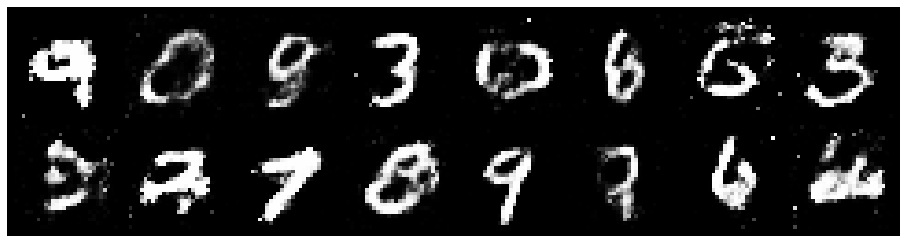

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.1553, Generator Loss: 1.1289
D(x): 0.5444, D(G(z)): 0.3588


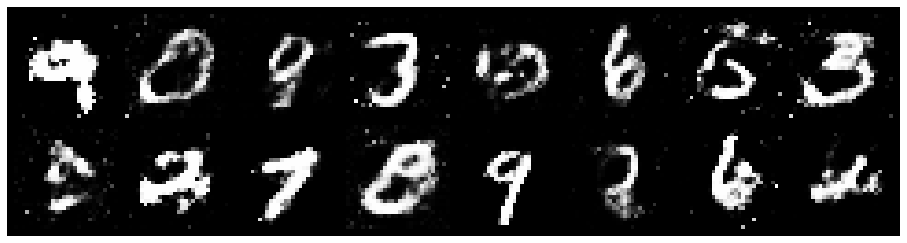

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.1977, Generator Loss: 0.9957
D(x): 0.5504, D(G(z)): 0.4015


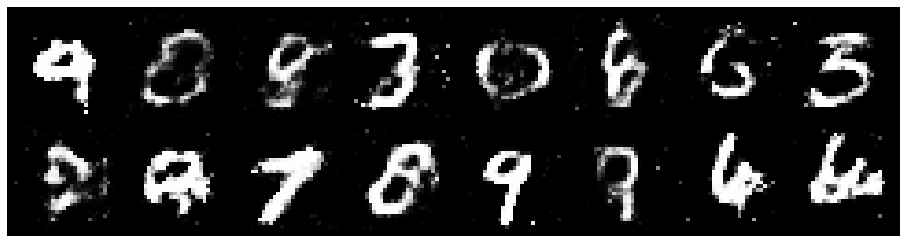

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.1923, Generator Loss: 1.0082
D(x): 0.6283, D(G(z)): 0.4534


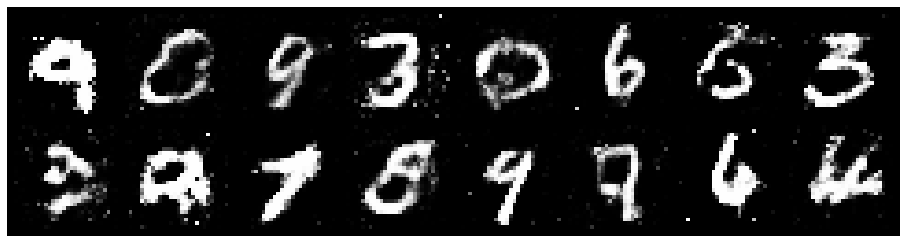

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.2769, Generator Loss: 0.8655
D(x): 0.5681, D(G(z)): 0.4228


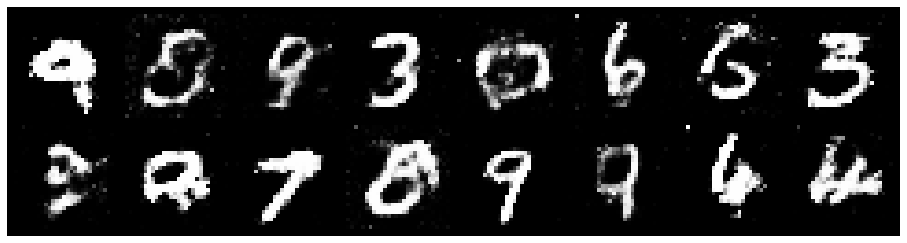

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2339, Generator Loss: 0.9731
D(x): 0.6312, D(G(z)): 0.4252


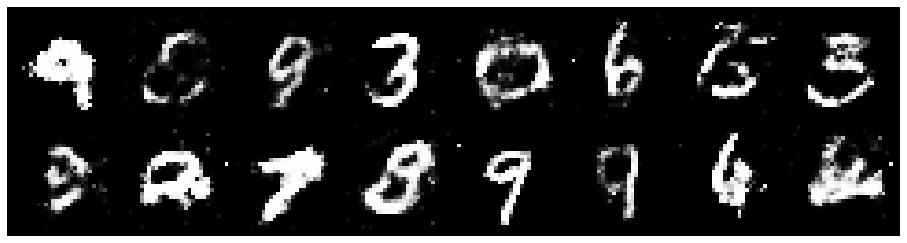

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.2380, Generator Loss: 0.8291
D(x): 0.5606, D(G(z)): 0.4297


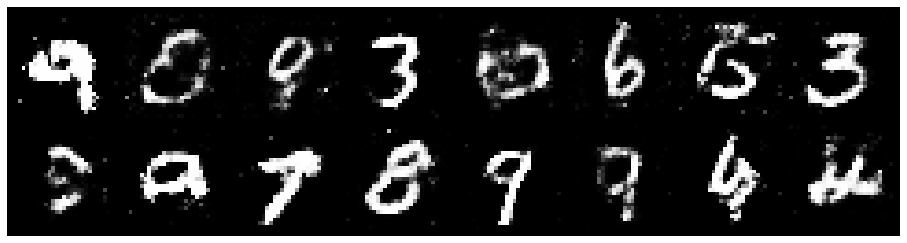

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.1758, Generator Loss: 1.0786
D(x): 0.5329, D(G(z)): 0.3565


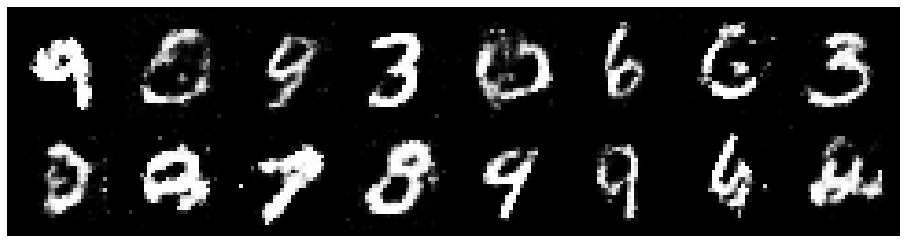

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.3634, Generator Loss: 0.9820
D(x): 0.5340, D(G(z)): 0.4462


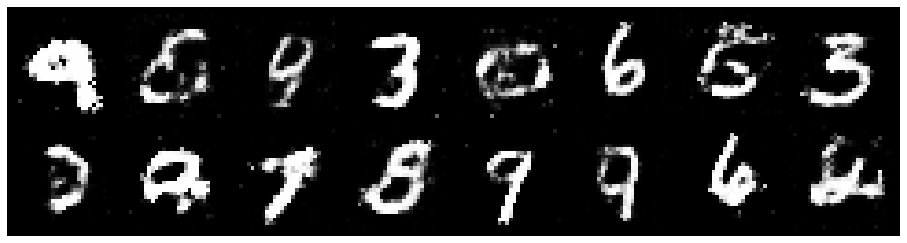

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.2897, Generator Loss: 0.8814
D(x): 0.6233, D(G(z)): 0.4725


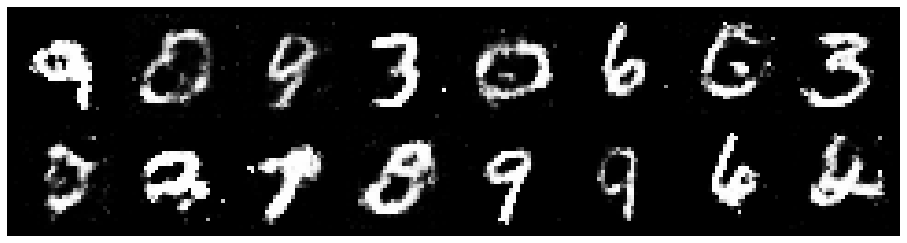

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.1587, Generator Loss: 1.1811
D(x): 0.5571, D(G(z)): 0.3625


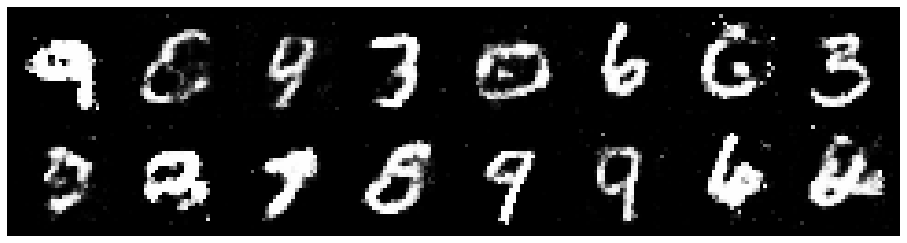

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.0540, Generator Loss: 1.0152
D(x): 0.6450, D(G(z)): 0.4109


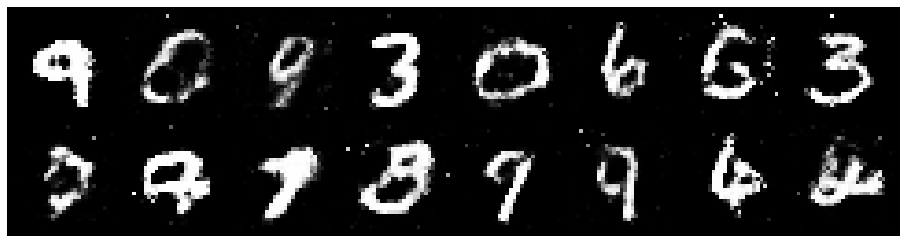

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2201, Generator Loss: 0.9979
D(x): 0.5717, D(G(z)): 0.4267


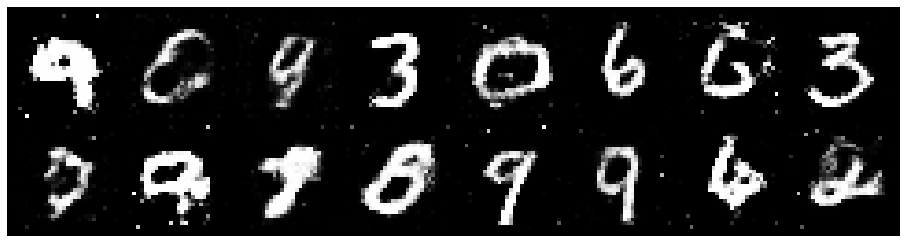

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2869, Generator Loss: 0.7878
D(x): 0.5940, D(G(z)): 0.4792


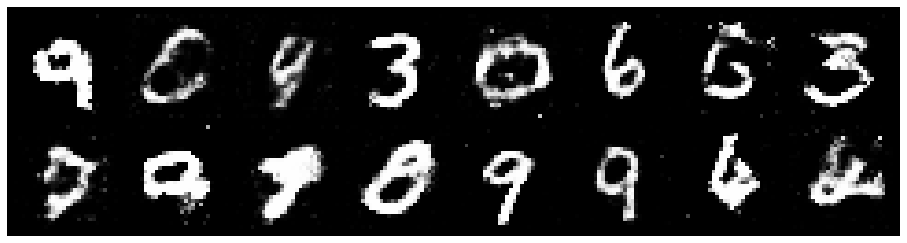

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2912, Generator Loss: 0.8798
D(x): 0.5664, D(G(z)): 0.4452


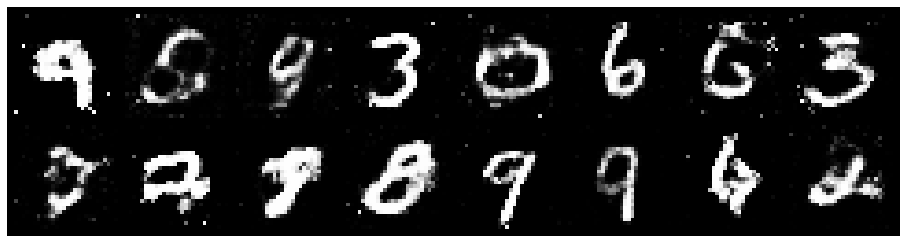

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.1872, Generator Loss: 0.8621
D(x): 0.6153, D(G(z)): 0.4577


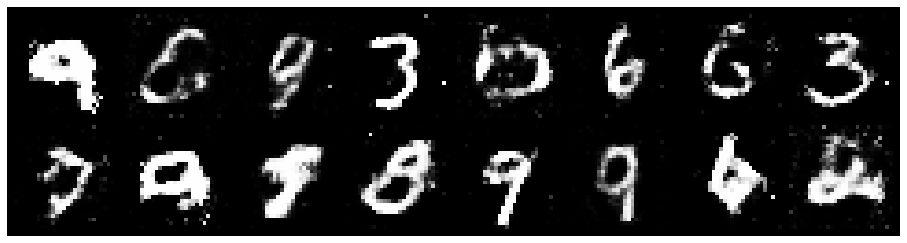

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.0859, Generator Loss: 0.8106
D(x): 0.6362, D(G(z)): 0.4269


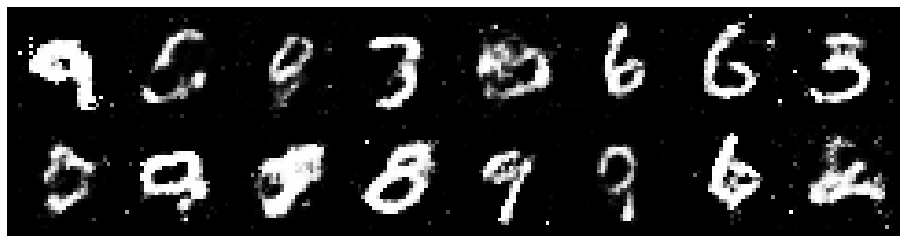

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.3024, Generator Loss: 0.9690
D(x): 0.5542, D(G(z)): 0.4413


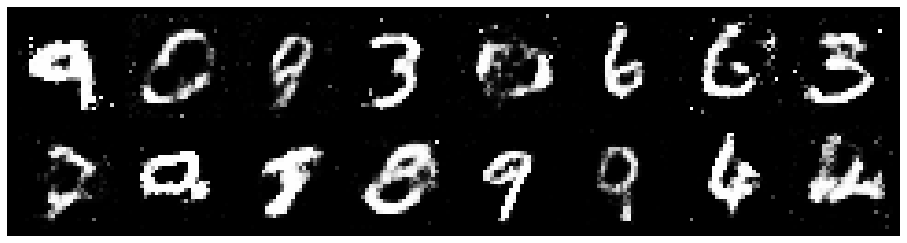

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.3665, Generator Loss: 0.8393
D(x): 0.5366, D(G(z)): 0.4439


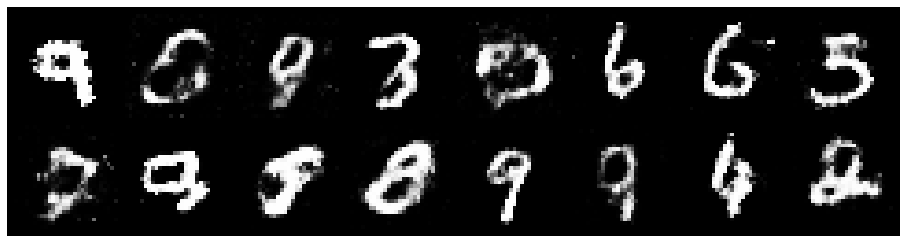

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.3740, Generator Loss: 0.8935
D(x): 0.5468, D(G(z)): 0.4836


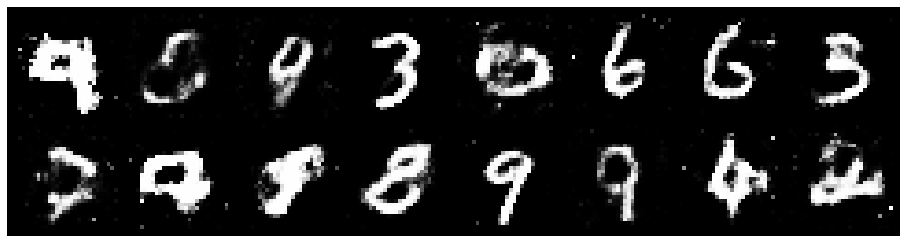

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.3613, Generator Loss: 0.8827
D(x): 0.5402, D(G(z)): 0.4192


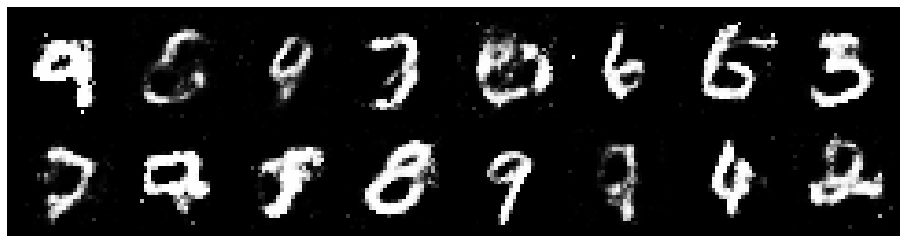

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.1202, Generator Loss: 1.1316
D(x): 0.5644, D(G(z)): 0.3534


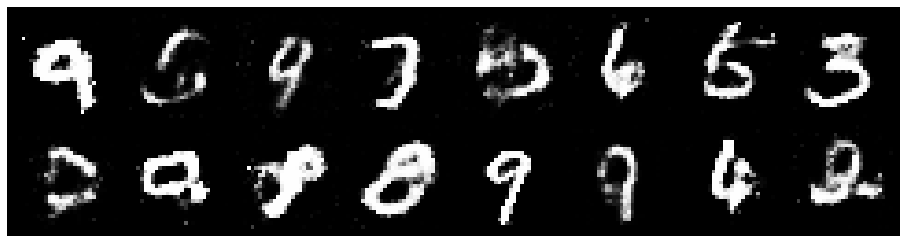

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2994, Generator Loss: 0.9288
D(x): 0.5444, D(G(z)): 0.4357


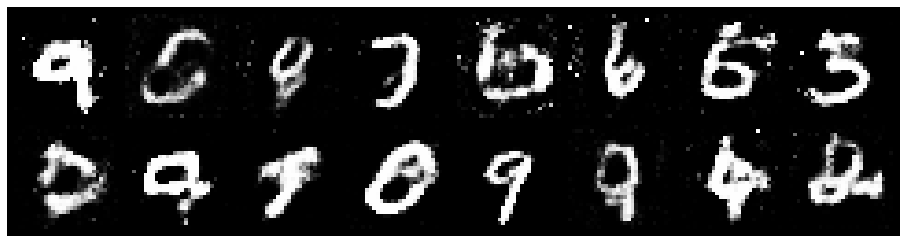

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.3424, Generator Loss: 0.8069
D(x): 0.6009, D(G(z)): 0.4989


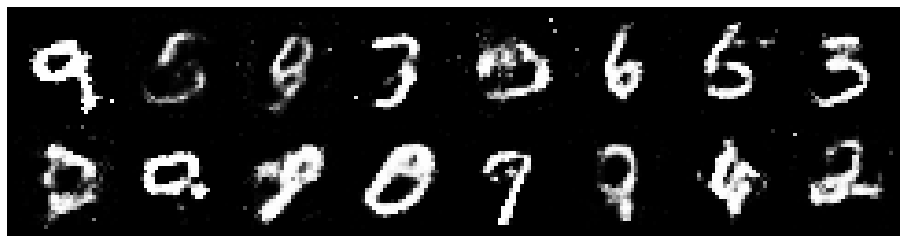

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2586, Generator Loss: 1.0997
D(x): 0.5445, D(G(z)): 0.4148


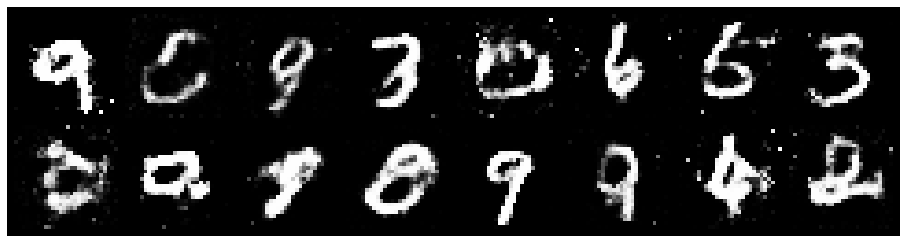

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.3961, Generator Loss: 0.9341
D(x): 0.5443, D(G(z)): 0.4727


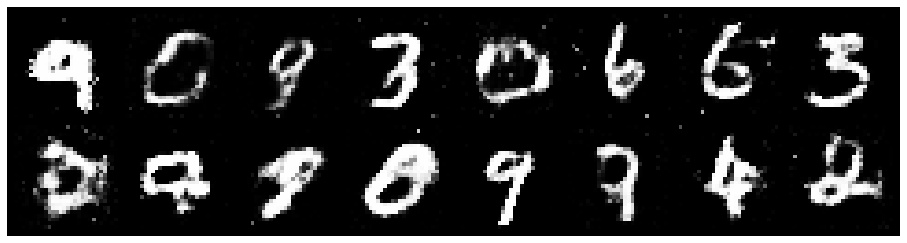

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.3739, Generator Loss: 0.8426
D(x): 0.5219, D(G(z)): 0.4607


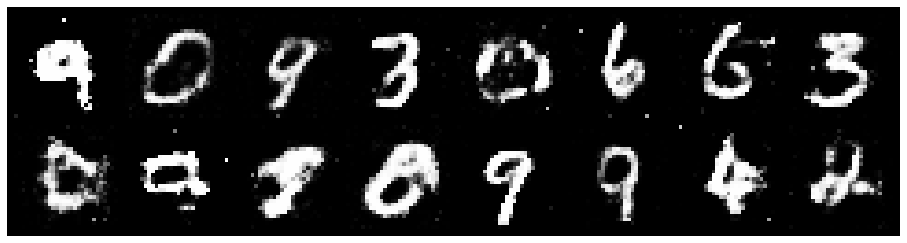

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2032, Generator Loss: 0.9057
D(x): 0.5406, D(G(z)): 0.4074


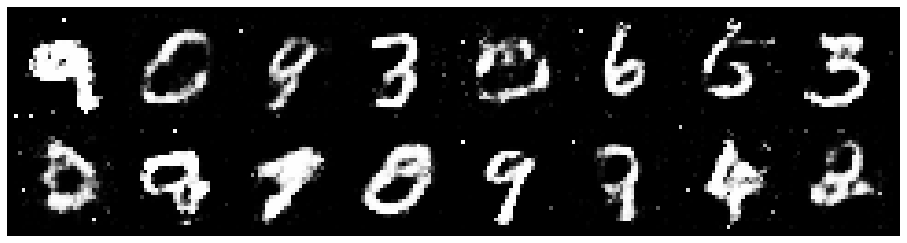

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.1902, Generator Loss: 0.9946
D(x): 0.5830, D(G(z)): 0.4024


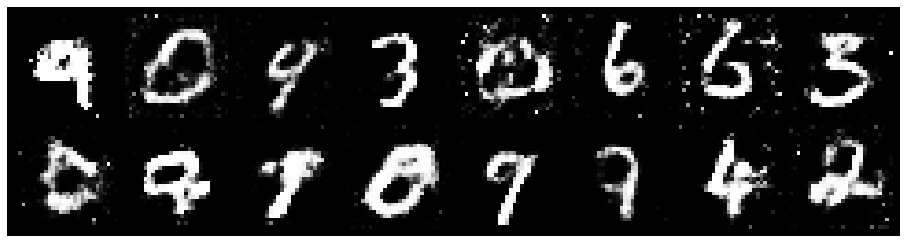

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.3584, Generator Loss: 1.0179
D(x): 0.5430, D(G(z)): 0.4589


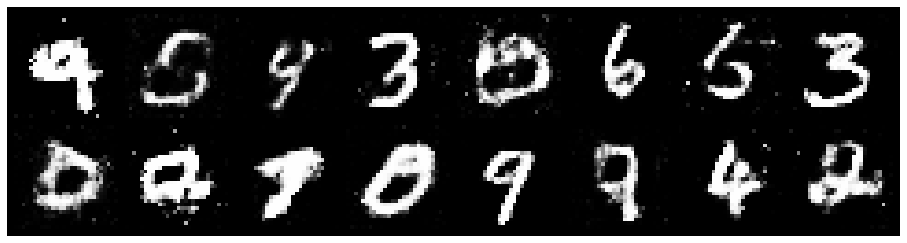

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2615, Generator Loss: 0.8890
D(x): 0.5752, D(G(z)): 0.4574


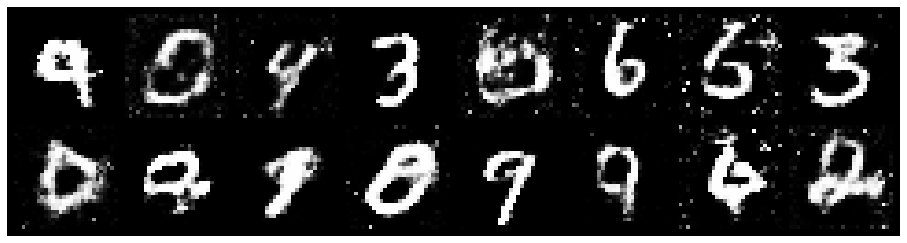

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.0852, Generator Loss: 1.0875
D(x): 0.6130, D(G(z)): 0.3786


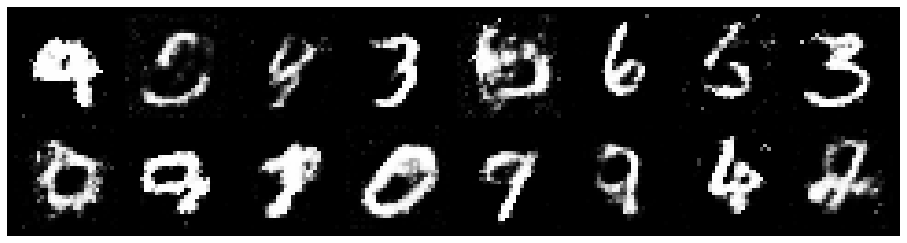

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.1352, Generator Loss: 1.0787
D(x): 0.6291, D(G(z)): 0.4096


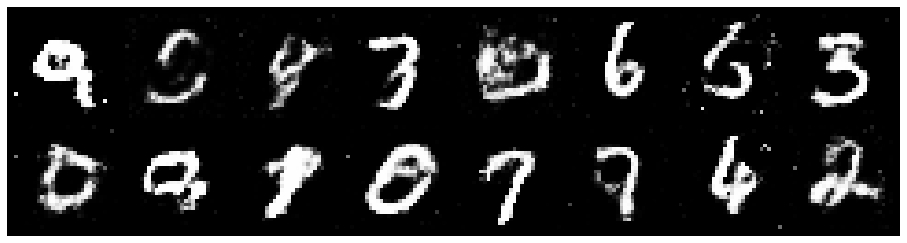

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.3084, Generator Loss: 0.9650
D(x): 0.5018, D(G(z)): 0.4144


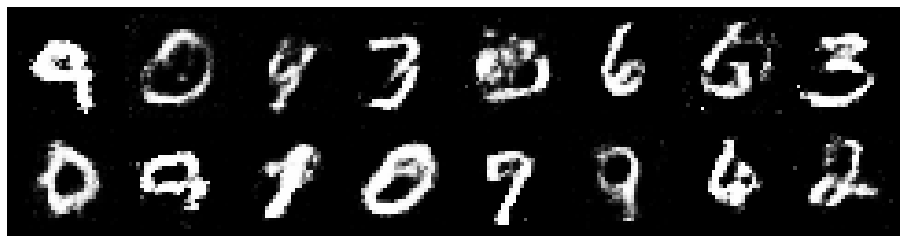

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2794, Generator Loss: 0.9054
D(x): 0.5543, D(G(z)): 0.4308


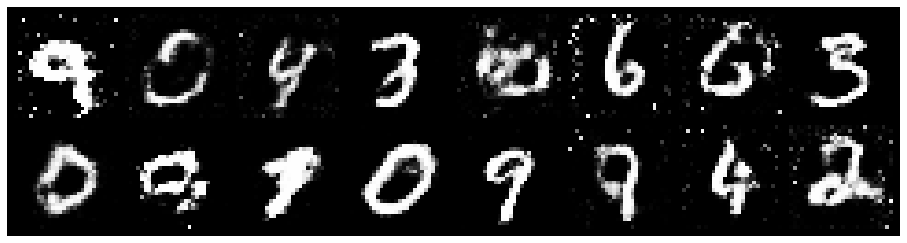

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.0899, Generator Loss: 0.9737
D(x): 0.6118, D(G(z)): 0.4048


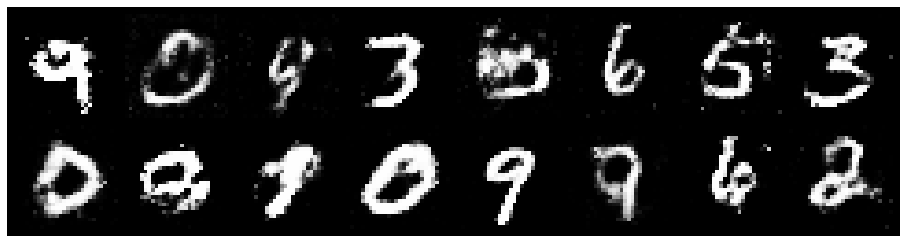

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.1249, Generator Loss: 0.8746
D(x): 0.6320, D(G(z)): 0.4394


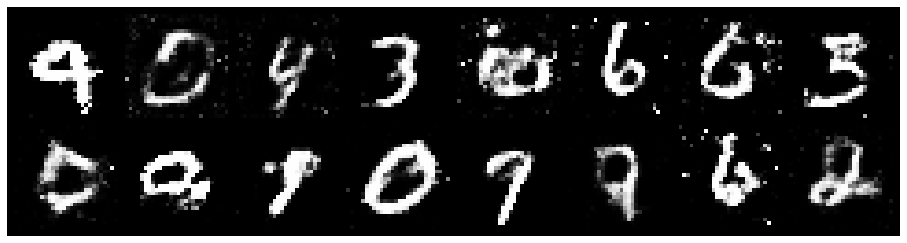

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2953, Generator Loss: 0.8792
D(x): 0.5518, D(G(z)): 0.4536


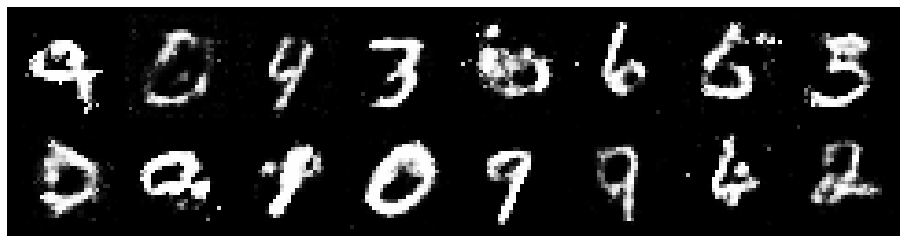

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2553, Generator Loss: 0.9668
D(x): 0.5655, D(G(z)): 0.4394


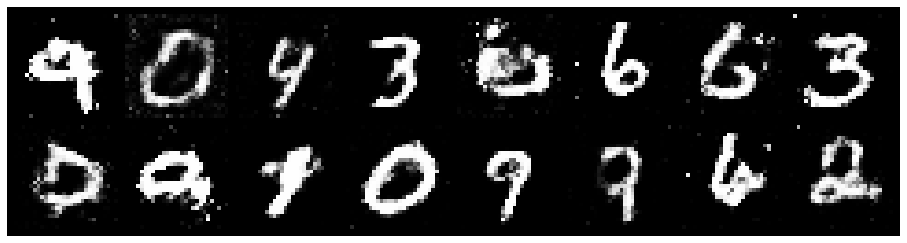

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.2214, Generator Loss: 1.0533
D(x): 0.5878, D(G(z)): 0.4380


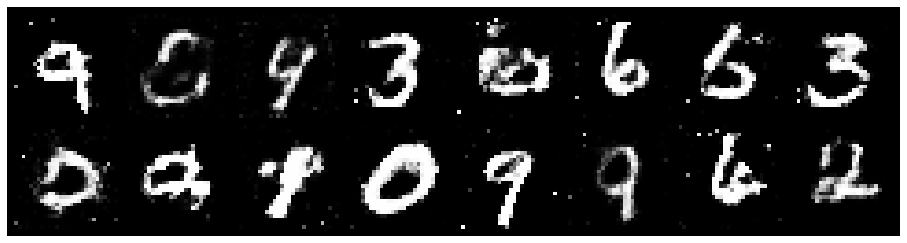

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.2983, Generator Loss: 0.9838
D(x): 0.5549, D(G(z)): 0.4626


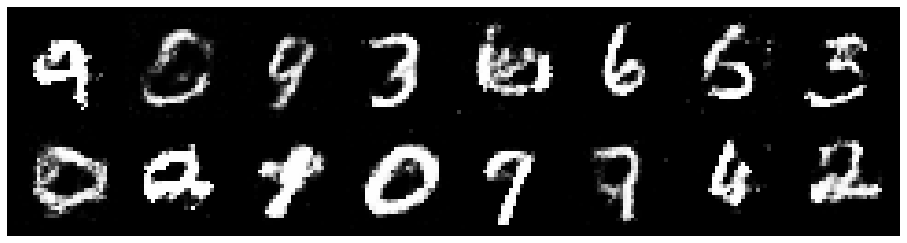

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.1965, Generator Loss: 1.0797
D(x): 0.5579, D(G(z)): 0.3776


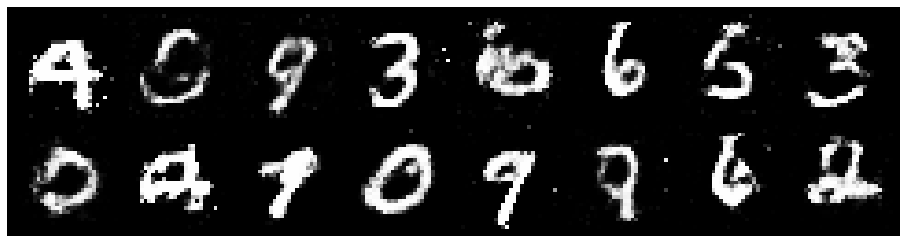

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.1354, Generator Loss: 0.9805
D(x): 0.5785, D(G(z)): 0.4104


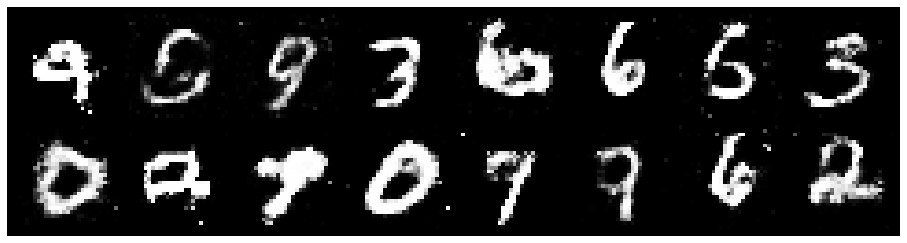

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 1.1574, Generator Loss: 0.8543
D(x): 0.5767, D(G(z)): 0.4153


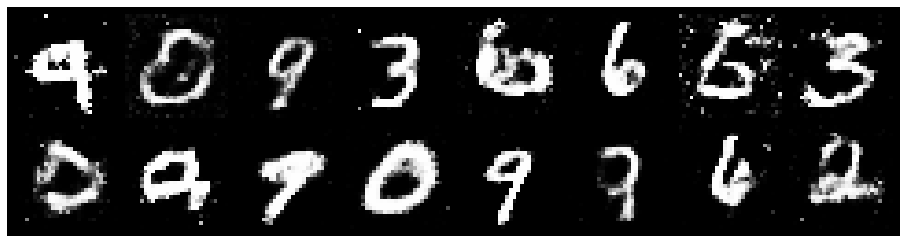

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.3106, Generator Loss: 0.8804
D(x): 0.5397, D(G(z)): 0.4316


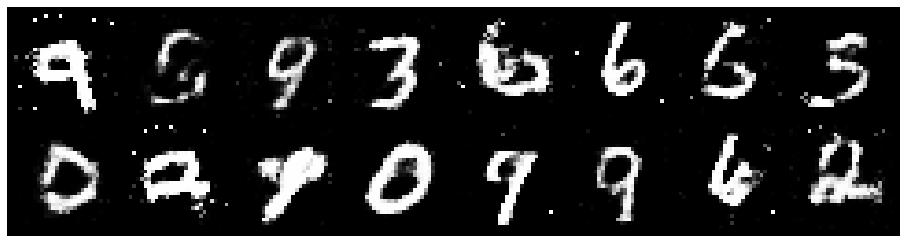

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2188, Generator Loss: 0.9204
D(x): 0.5707, D(G(z)): 0.4410


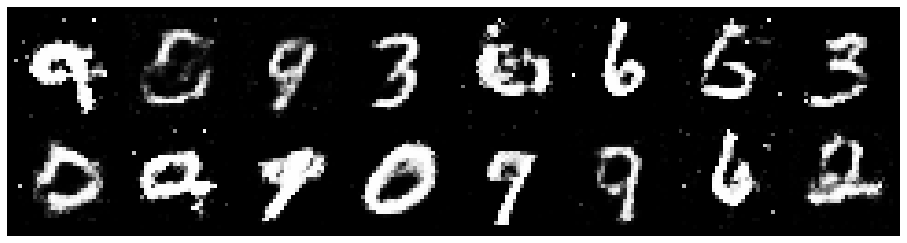

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2186, Generator Loss: 0.9909
D(x): 0.6096, D(G(z)): 0.4482


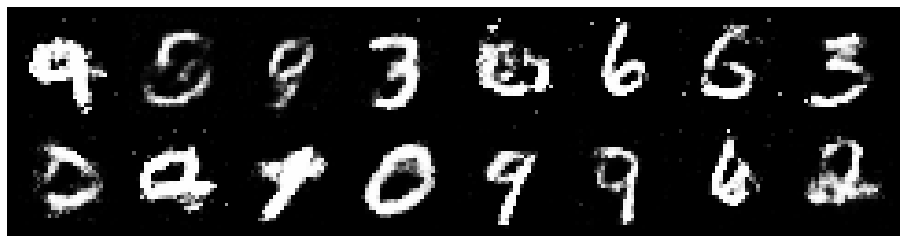

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.1229, Generator Loss: 0.9393
D(x): 0.6447, D(G(z)): 0.4380


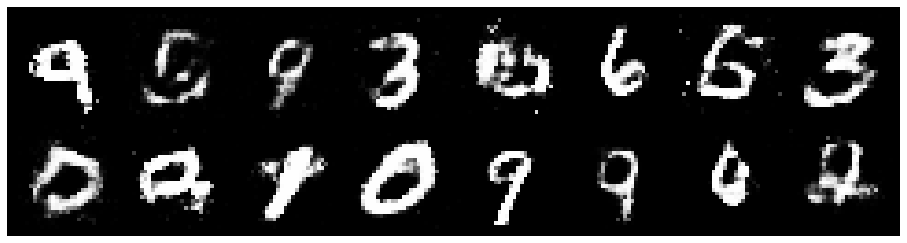

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.2726, Generator Loss: 0.8934
D(x): 0.5583, D(G(z)): 0.4497


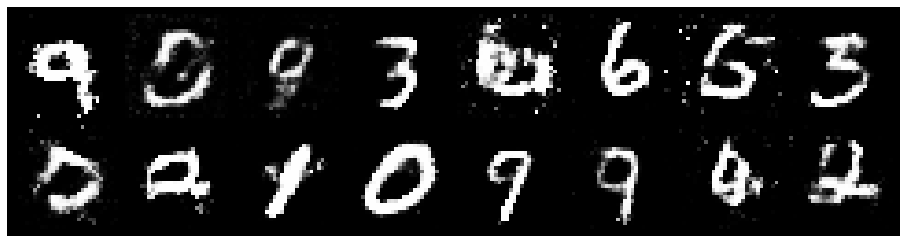

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.4015, Generator Loss: 0.8767
D(x): 0.5240, D(G(z)): 0.4627


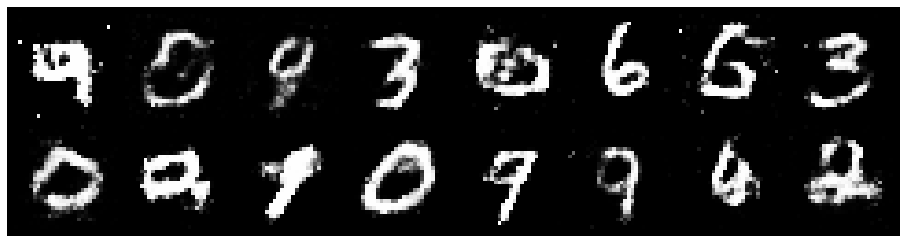

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.4187, Generator Loss: 0.9074
D(x): 0.5648, D(G(z)): 0.5023


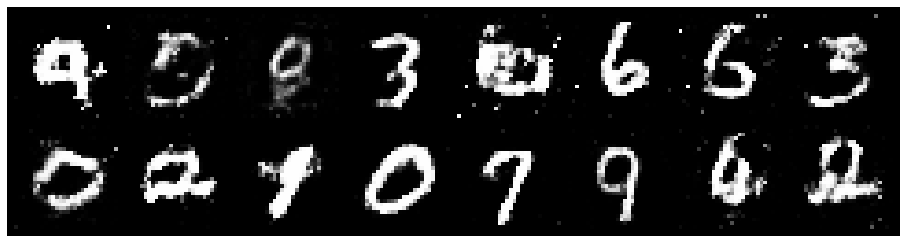

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.3556, Generator Loss: 0.7851
D(x): 0.5125, D(G(z)): 0.4761


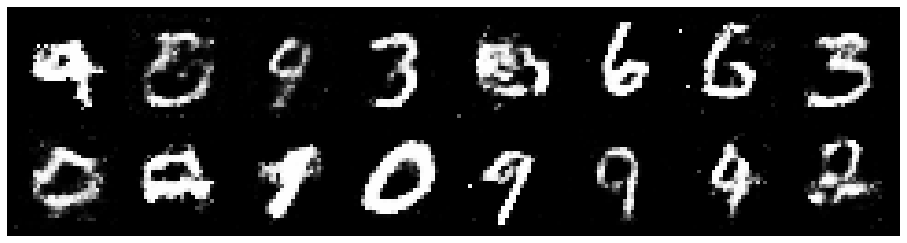

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.3647, Generator Loss: 0.8187
D(x): 0.5470, D(G(z)): 0.4789


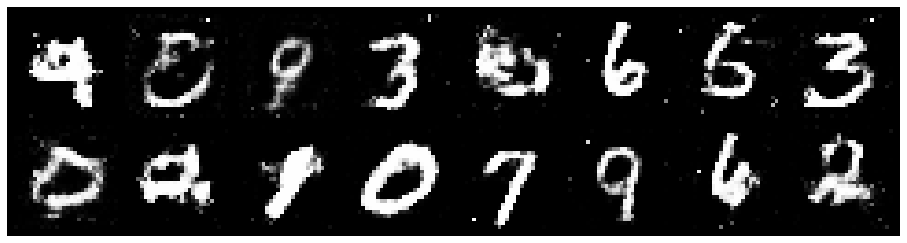

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.4310, Generator Loss: 0.8021
D(x): 0.5749, D(G(z)): 0.5062


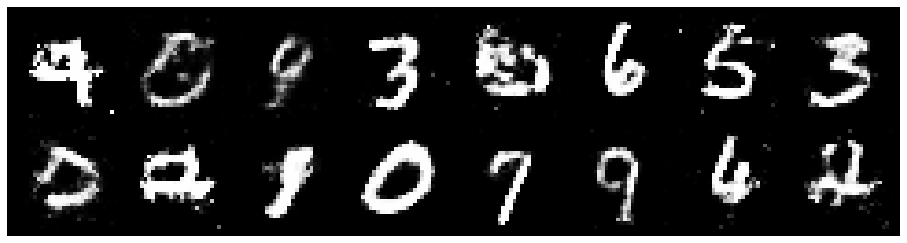

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.1970, Generator Loss: 0.9766
D(x): 0.5837, D(G(z)): 0.4306


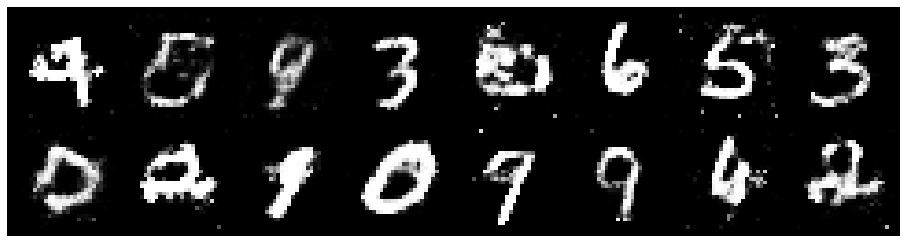

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.1874, Generator Loss: 1.0010
D(x): 0.5924, D(G(z)): 0.4250


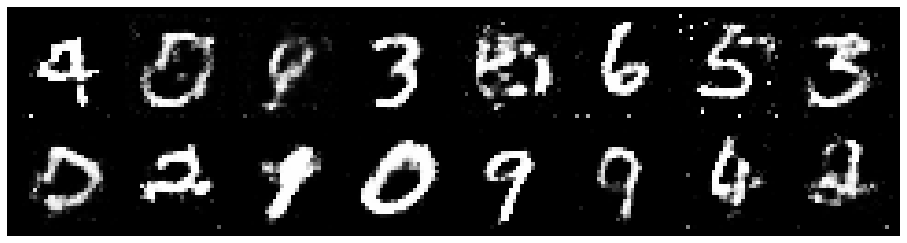

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2428, Generator Loss: 0.8633
D(x): 0.5564, D(G(z)): 0.4197


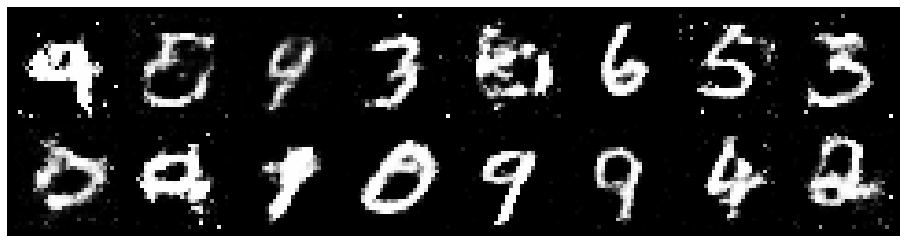

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.3839, Generator Loss: 0.8746
D(x): 0.4897, D(G(z)): 0.4180


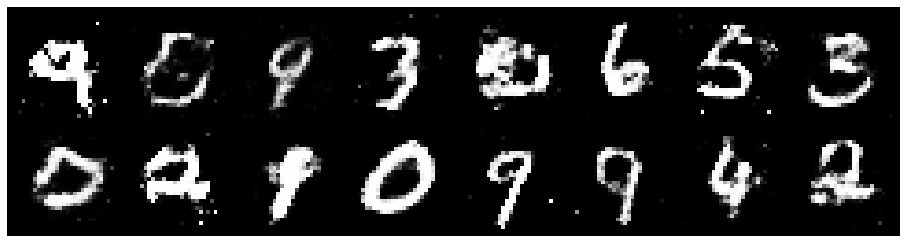

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.2987, Generator Loss: 0.7908
D(x): 0.5568, D(G(z)): 0.4708


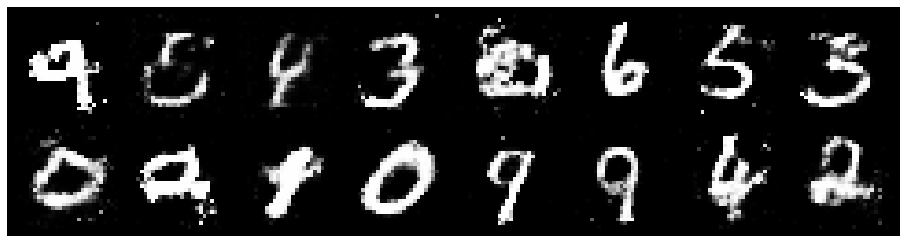

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.2789, Generator Loss: 0.8806
D(x): 0.5901, D(G(z)): 0.4613


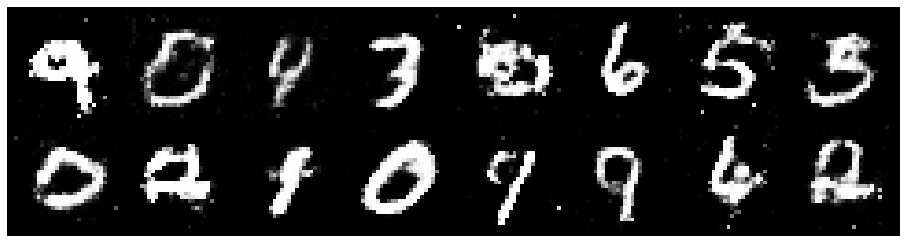

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.1171, Generator Loss: 1.0394
D(x): 0.6145, D(G(z)): 0.3997


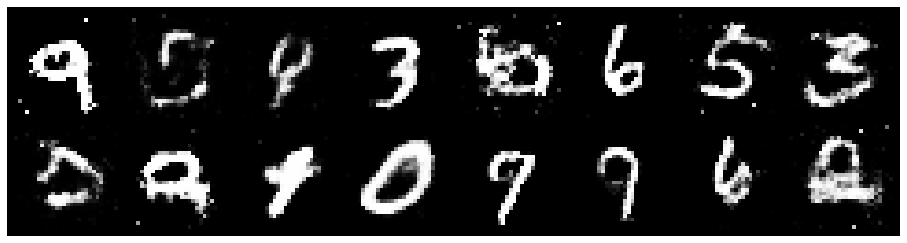

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.2528, Generator Loss: 0.9077
D(x): 0.5421, D(G(z)): 0.4282


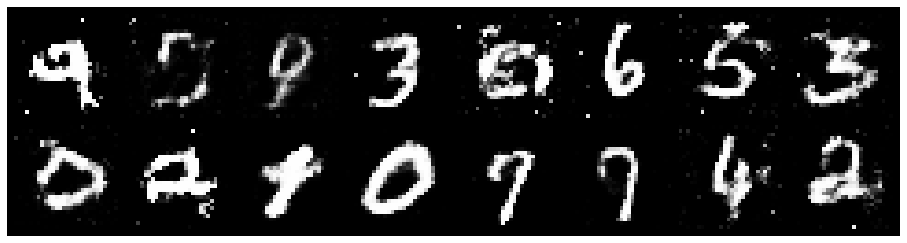

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2654, Generator Loss: 1.0832
D(x): 0.5259, D(G(z)): 0.3861


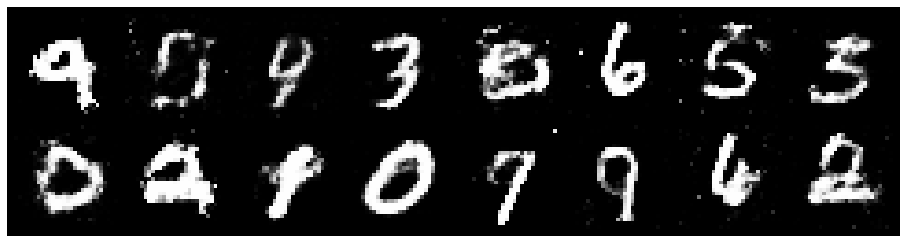

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.2705, Generator Loss: 1.0531
D(x): 0.5416, D(G(z)): 0.3957


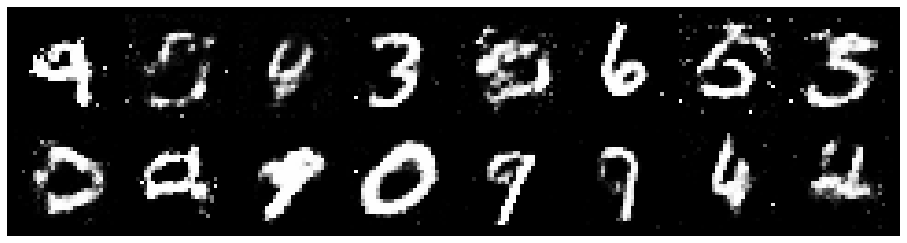

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.1418, Generator Loss: 1.0518
D(x): 0.5757, D(G(z)): 0.3886


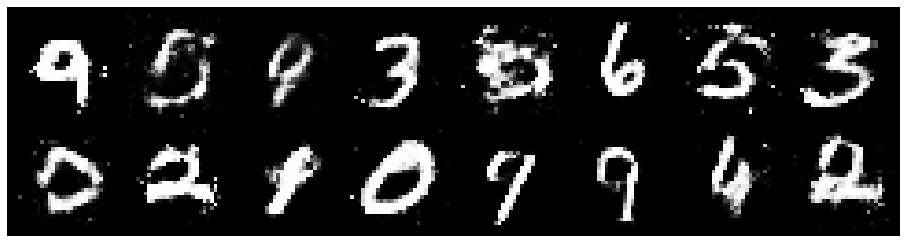

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.1739, Generator Loss: 0.8850
D(x): 0.5928, D(G(z)): 0.4468


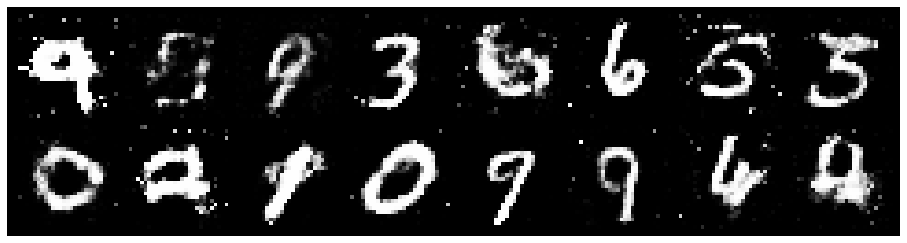

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.2406, Generator Loss: 1.0165
D(x): 0.5614, D(G(z)): 0.4158


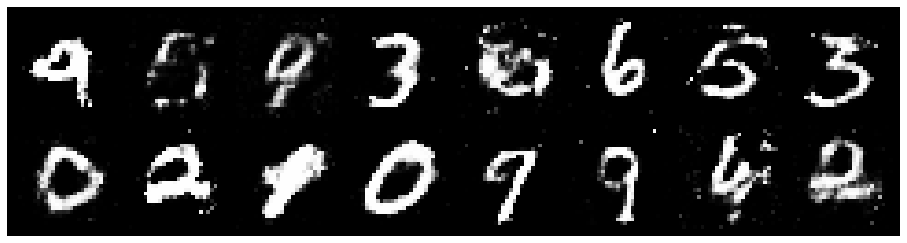

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9241
D(x): 0.5576, D(G(z)): 0.4041


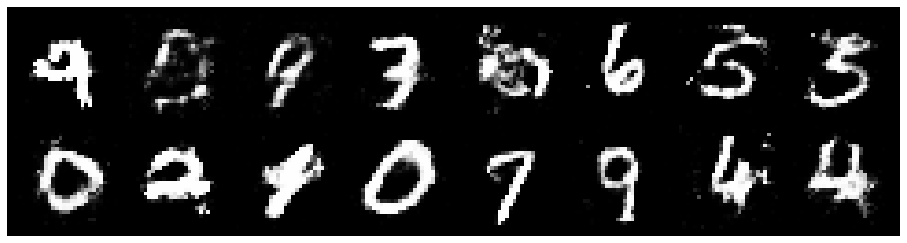

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.3424, Generator Loss: 0.7881
D(x): 0.5692, D(G(z)): 0.4965


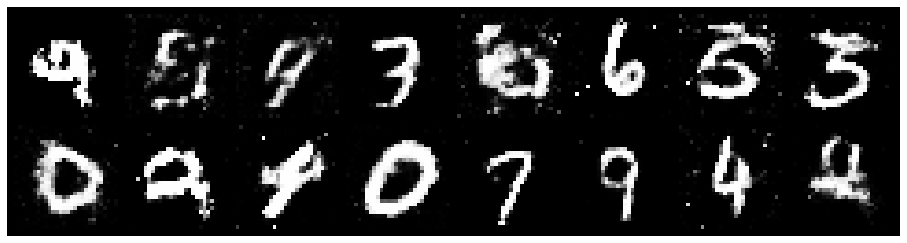

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.3793, Generator Loss: 1.0536
D(x): 0.5227, D(G(z)): 0.4181


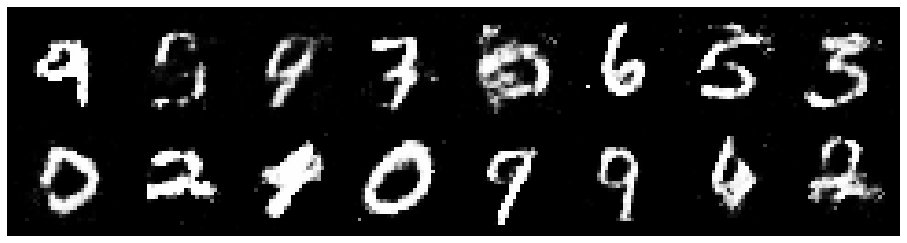

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.1906, Generator Loss: 1.0134
D(x): 0.6357, D(G(z)): 0.4519


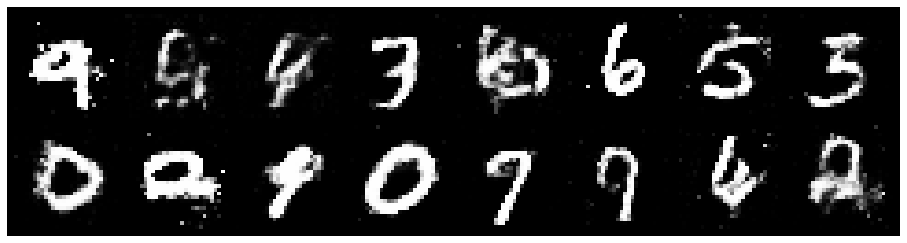

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2607, Generator Loss: 1.0254
D(x): 0.5454, D(G(z)): 0.4182


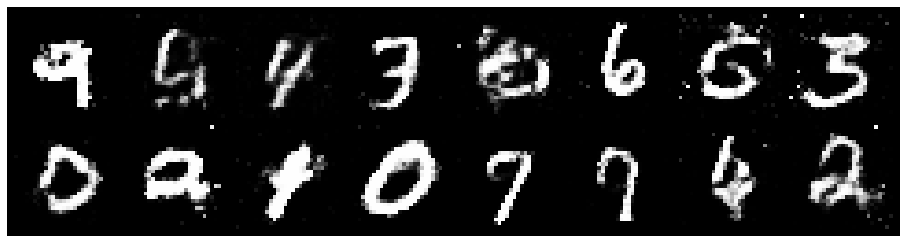

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.3664, Generator Loss: 0.9214
D(x): 0.5546, D(G(z)): 0.4750


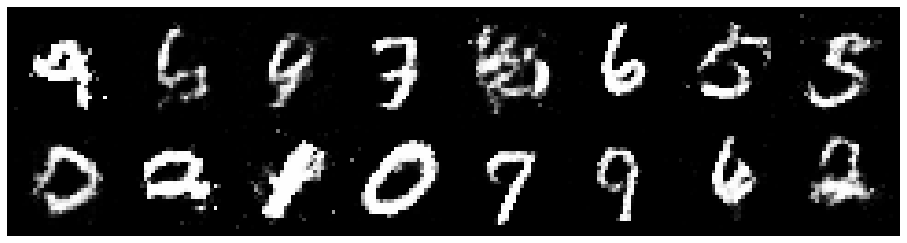

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.2803, Generator Loss: 0.7911
D(x): 0.5770, D(G(z)): 0.4796


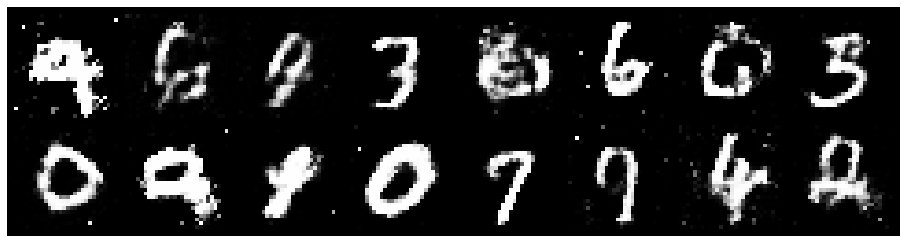

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.3378, Generator Loss: 0.8326
D(x): 0.5707, D(G(z)): 0.4703


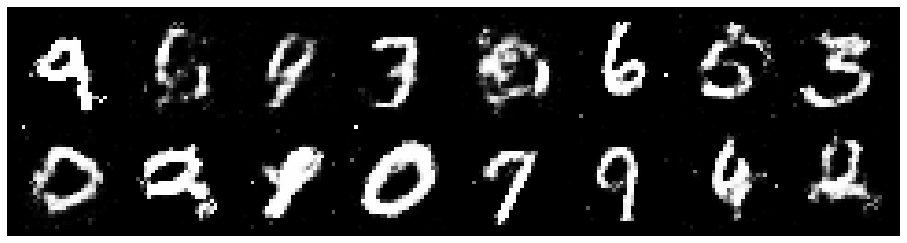

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2317, Generator Loss: 0.8476
D(x): 0.6209, D(G(z)): 0.4751


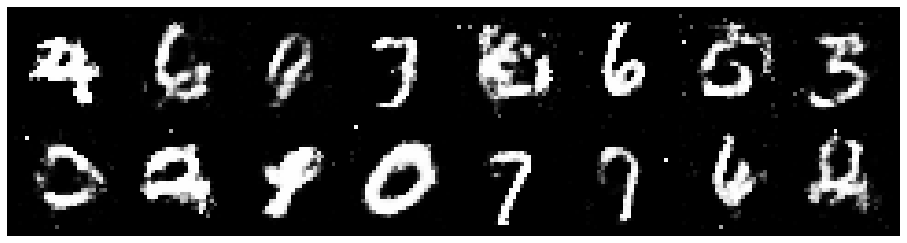

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.3008, Generator Loss: 1.0240
D(x): 0.5512, D(G(z)): 0.4386


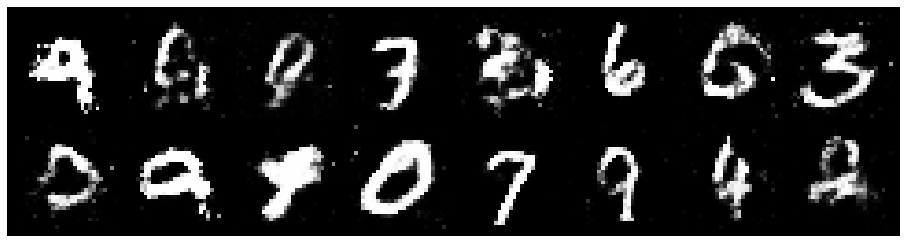

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.2168, Generator Loss: 0.8891
D(x): 0.5883, D(G(z)): 0.4463


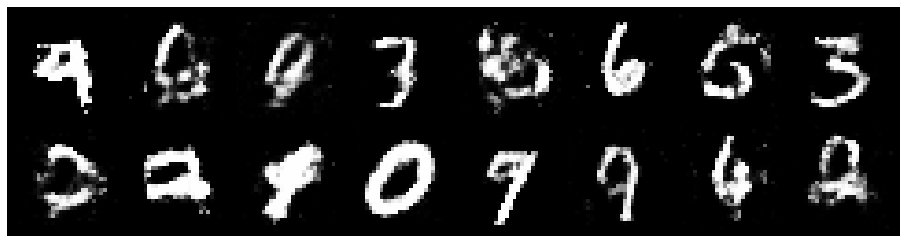

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.3017, Generator Loss: 0.8482
D(x): 0.5500, D(G(z)): 0.4675


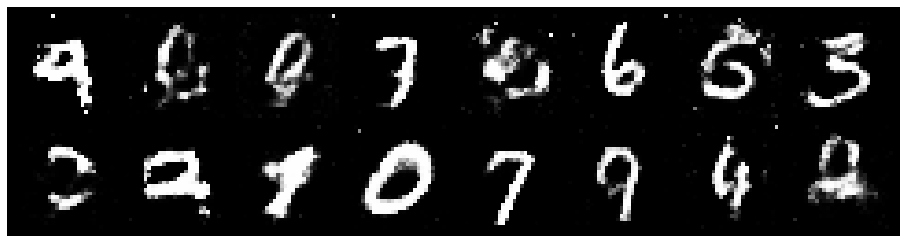

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.2883, Generator Loss: 0.9569
D(x): 0.5818, D(G(z)): 0.4639


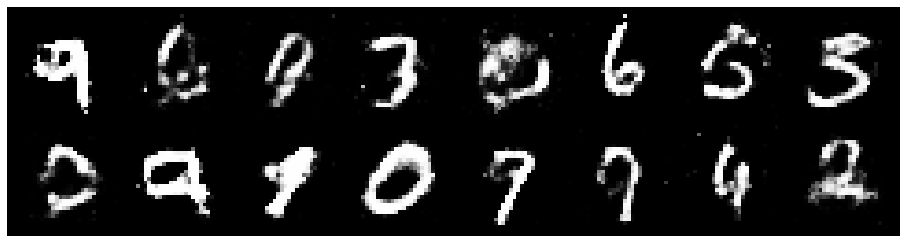

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.3046, Generator Loss: 0.8550
D(x): 0.5491, D(G(z)): 0.4676


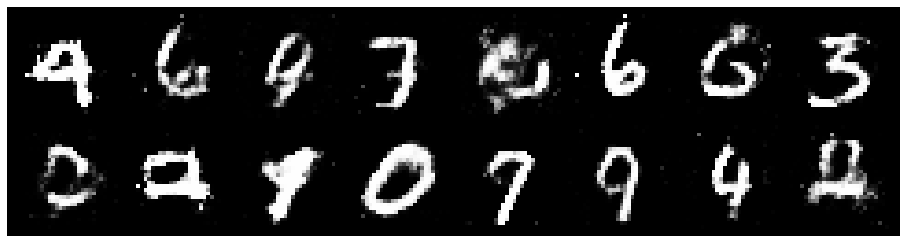

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.2726, Generator Loss: 0.8711
D(x): 0.5574, D(G(z)): 0.4378


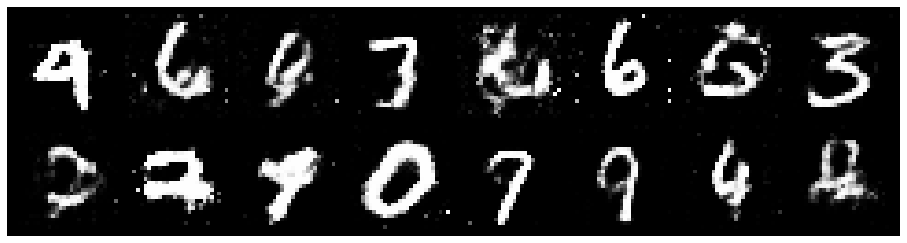

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.1796, Generator Loss: 0.9611
D(x): 0.5625, D(G(z)): 0.4158


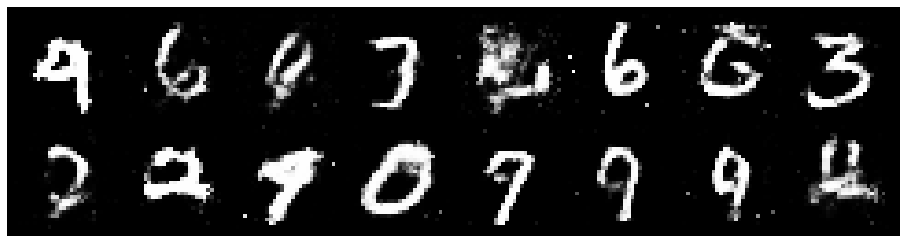

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.2443, Generator Loss: 0.8105
D(x): 0.5727, D(G(z)): 0.4487


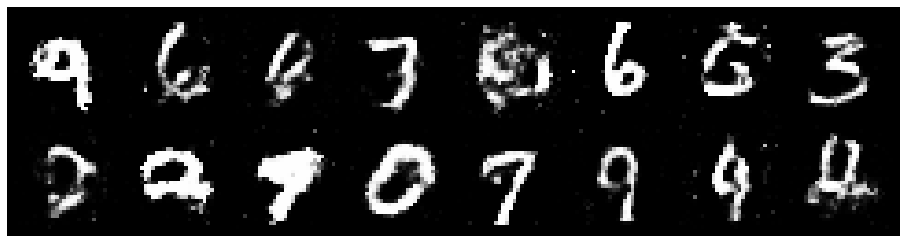

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.3172, Generator Loss: 0.8991
D(x): 0.6011, D(G(z)): 0.4910


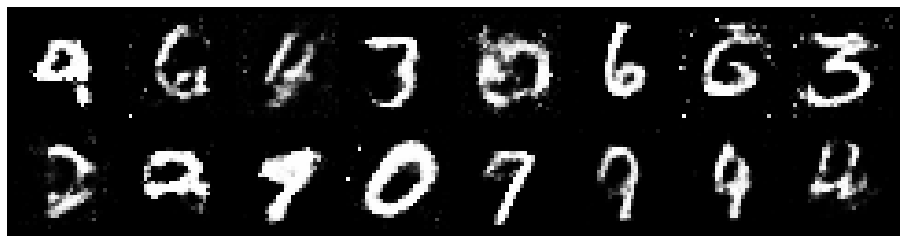

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.4015, Generator Loss: 0.8800
D(x): 0.5100, D(G(z)): 0.4507


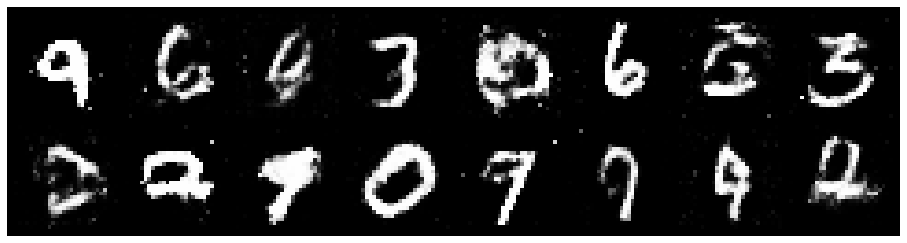

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.2811, Generator Loss: 0.8410
D(x): 0.5299, D(G(z)): 0.4174


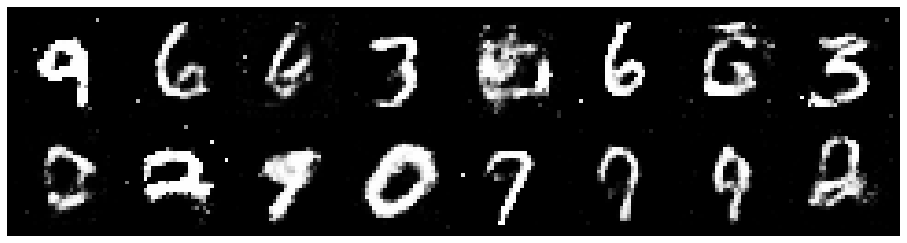

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.3800, Generator Loss: 0.8934
D(x): 0.5330, D(G(z)): 0.4636


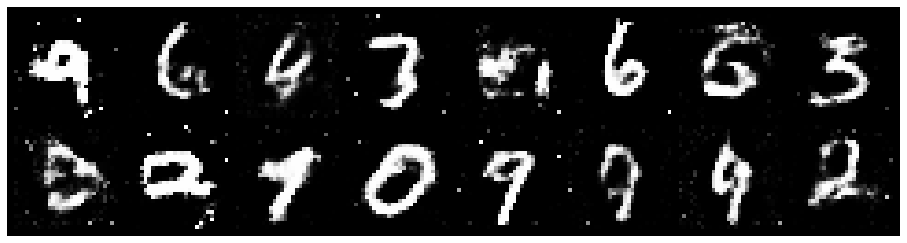

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.3156, Generator Loss: 0.8145
D(x): 0.5735, D(G(z)): 0.4742


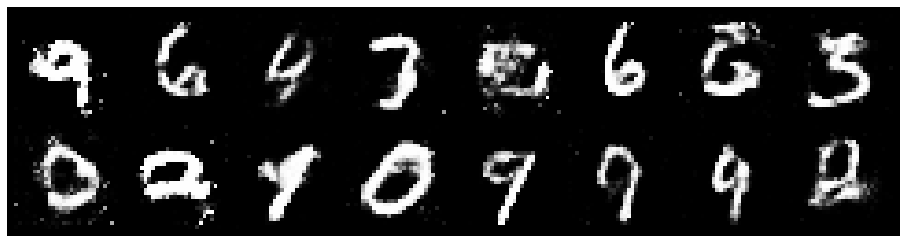

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.3003, Generator Loss: 1.0614
D(x): 0.5390, D(G(z)): 0.4237


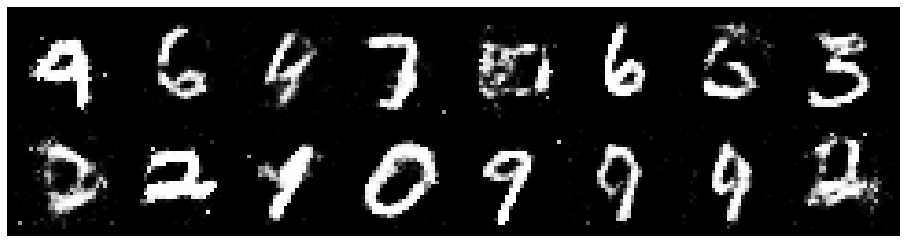

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.3263, Generator Loss: 0.9033
D(x): 0.5561, D(G(z)): 0.4593


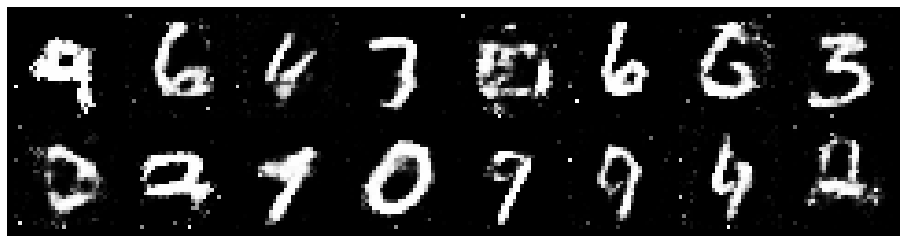

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.3364, Generator Loss: 0.8844
D(x): 0.5343, D(G(z)): 0.4499


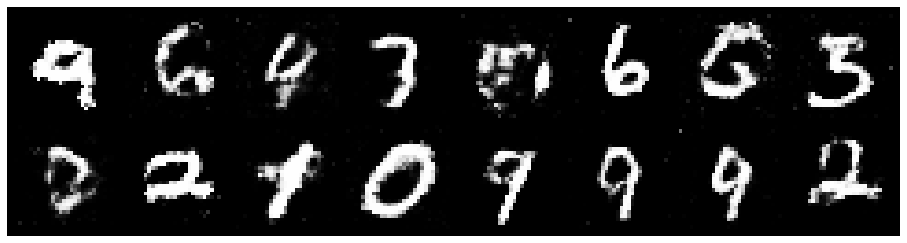

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.2954, Generator Loss: 0.9971
D(x): 0.5306, D(G(z)): 0.3861


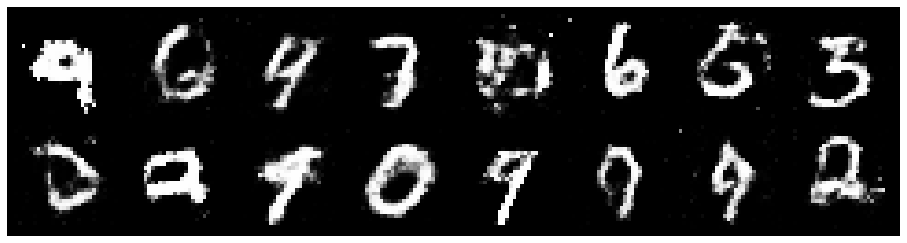

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.3234, Generator Loss: 0.8654
D(x): 0.5288, D(G(z)): 0.4487


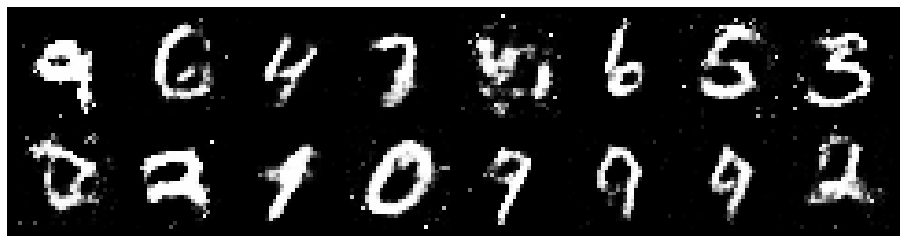

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.3542, Generator Loss: 0.8950
D(x): 0.5038, D(G(z)): 0.4348


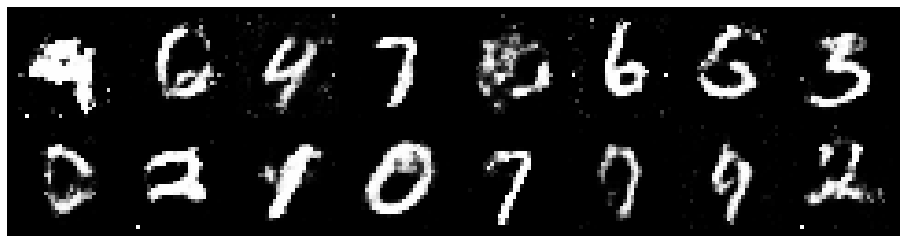

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2270, Generator Loss: 0.9304
D(x): 0.5683, D(G(z)): 0.4189


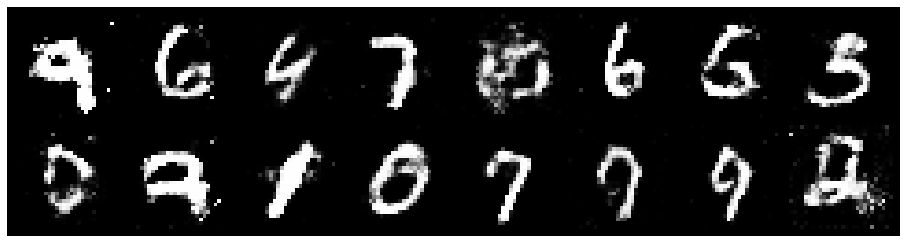

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.1949, Generator Loss: 1.0365
D(x): 0.5554, D(G(z)): 0.3944


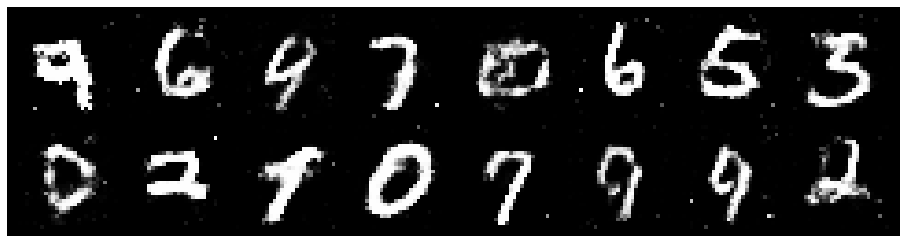

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2989, Generator Loss: 0.8661
D(x): 0.6004, D(G(z)): 0.4785


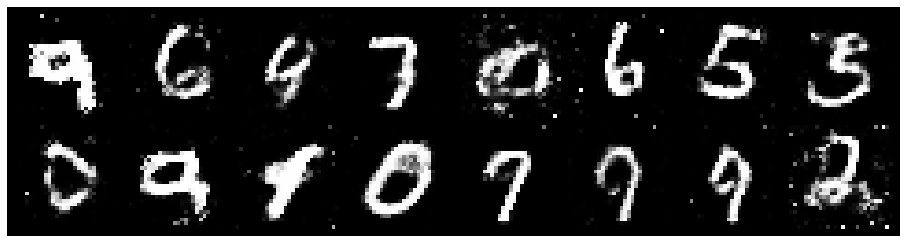

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.3252, Generator Loss: 0.8342
D(x): 0.5851, D(G(z)): 0.4673


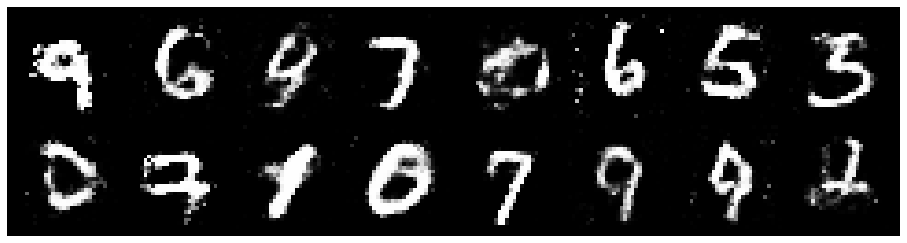

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.2307, Generator Loss: 0.9758
D(x): 0.5562, D(G(z)): 0.4323


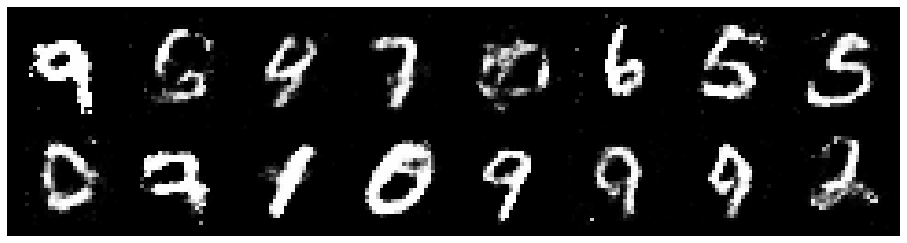

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.2709, Generator Loss: 0.8490
D(x): 0.5897, D(G(z)): 0.4861


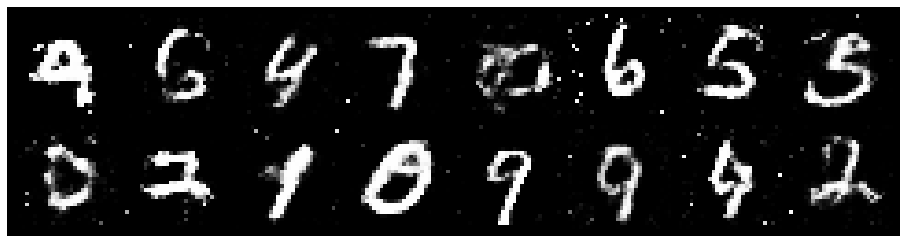

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.1625, Generator Loss: 1.0453
D(x): 0.5722, D(G(z)): 0.3930


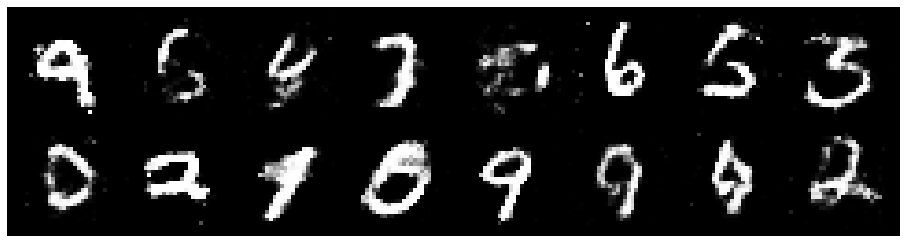

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.1331, Generator Loss: 0.9551
D(x): 0.6266, D(G(z)): 0.4320


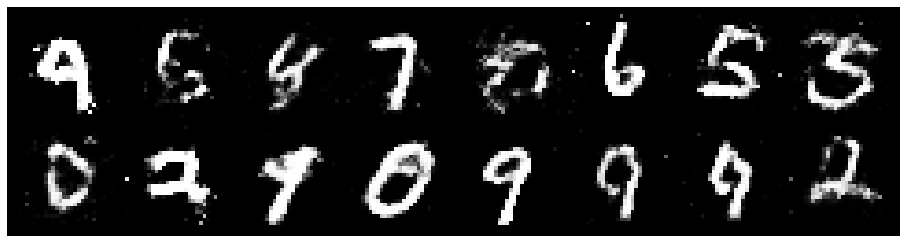

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.1570, Generator Loss: 0.9040
D(x): 0.5902, D(G(z)): 0.4246


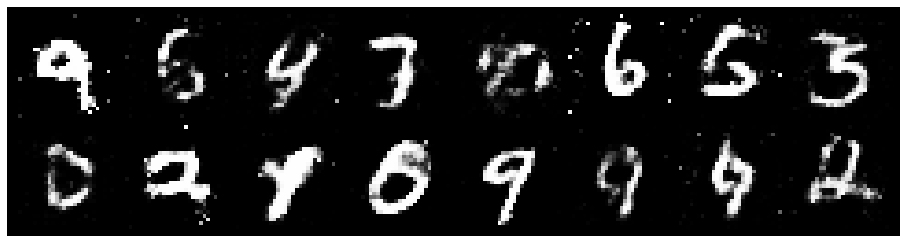

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9216
D(x): 0.6098, D(G(z)): 0.4803


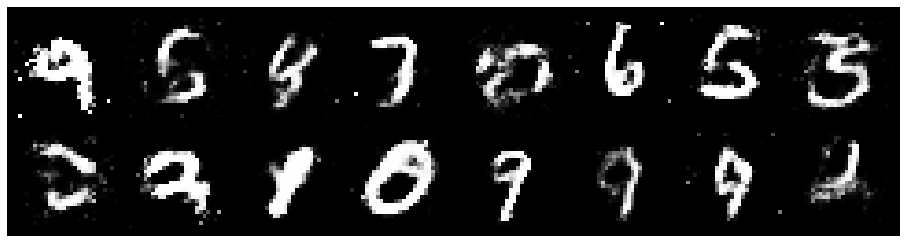

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.2465, Generator Loss: 0.8549
D(x): 0.5531, D(G(z)): 0.4271


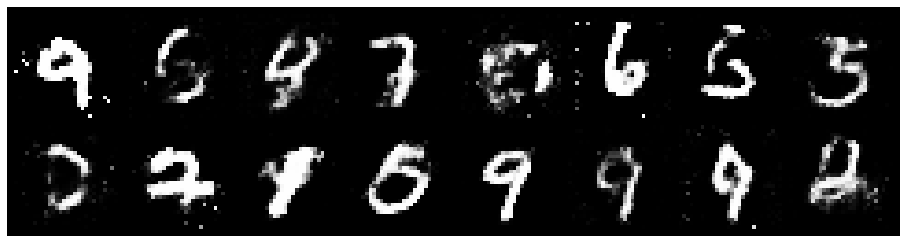

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.3232, Generator Loss: 0.9346
D(x): 0.5523, D(G(z)): 0.4541


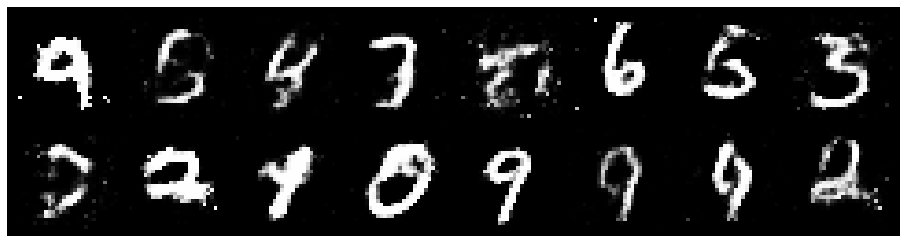

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.4397, Generator Loss: 0.9829
D(x): 0.5525, D(G(z)): 0.4800


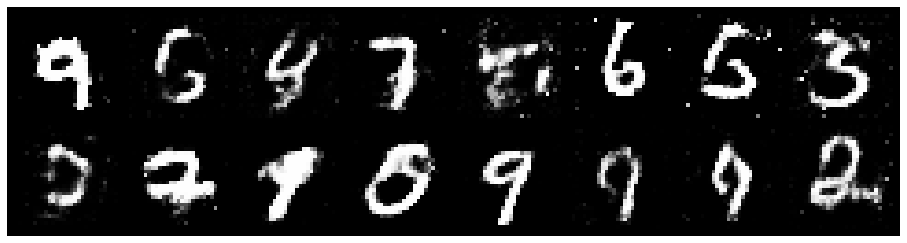

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2157, Generator Loss: 0.9787
D(x): 0.5819, D(G(z)): 0.4076


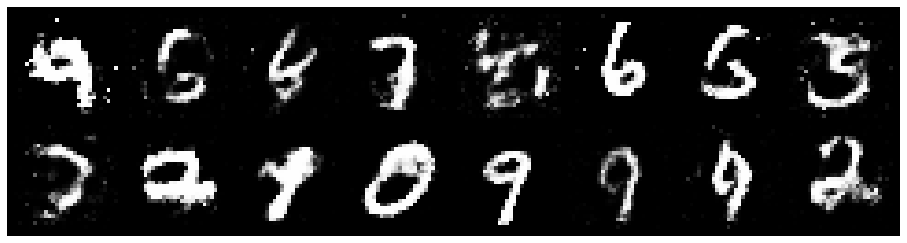

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2590, Generator Loss: 0.8236
D(x): 0.5841, D(G(z)): 0.4770


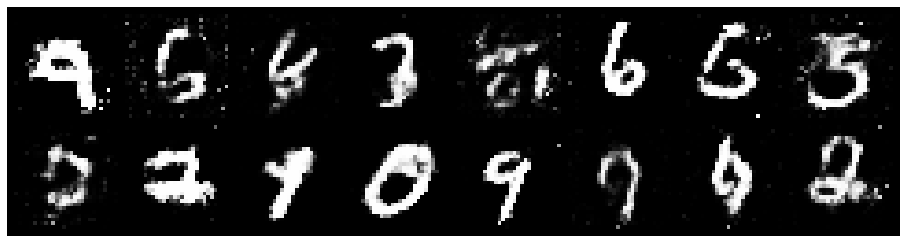

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2088, Generator Loss: 0.9737
D(x): 0.5886, D(G(z)): 0.4325


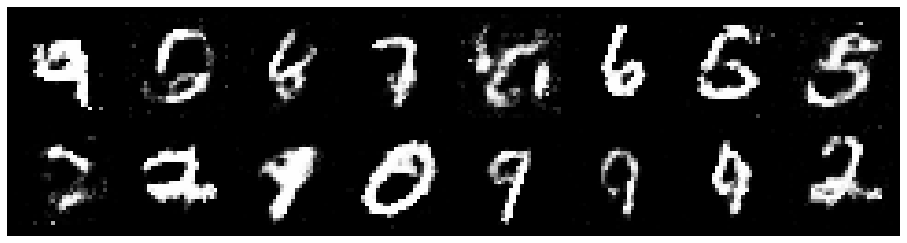

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.1255, Generator Loss: 0.9620
D(x): 0.5812, D(G(z)): 0.3843


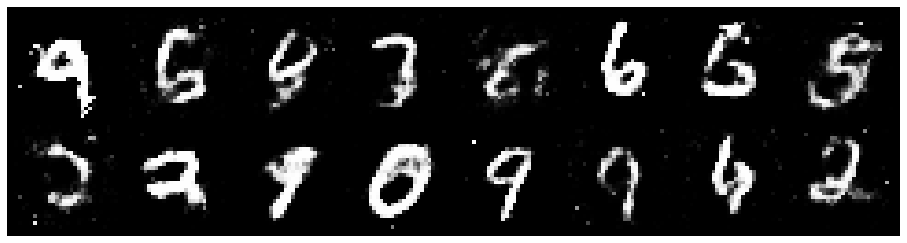

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.3110, Generator Loss: 0.8477
D(x): 0.5444, D(G(z)): 0.4637


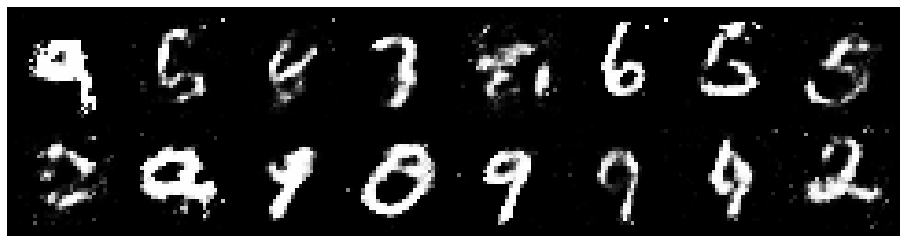

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.2503, Generator Loss: 0.9918
D(x): 0.5643, D(G(z)): 0.4312


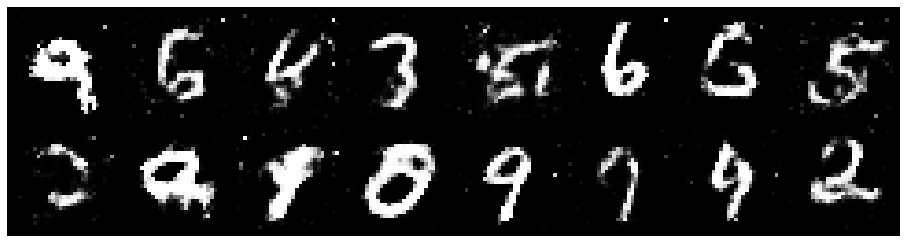

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.2067, Generator Loss: 0.8706
D(x): 0.6043, D(G(z)): 0.4310


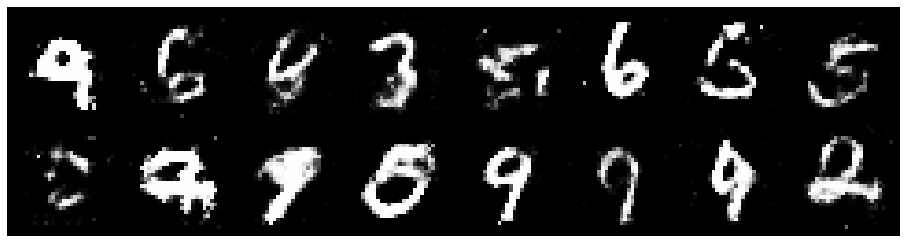

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.1405, Generator Loss: 1.0711
D(x): 0.5793, D(G(z)): 0.3911


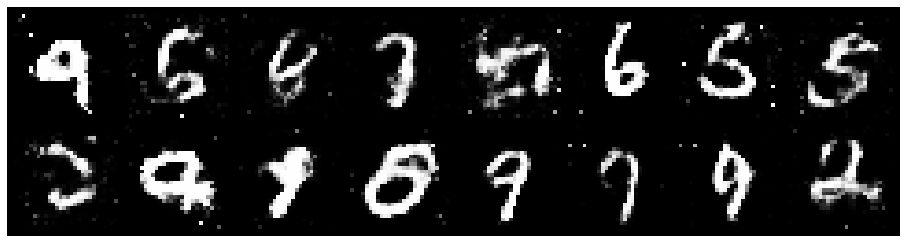

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.2522, Generator Loss: 0.8640
D(x): 0.5513, D(G(z)): 0.4368


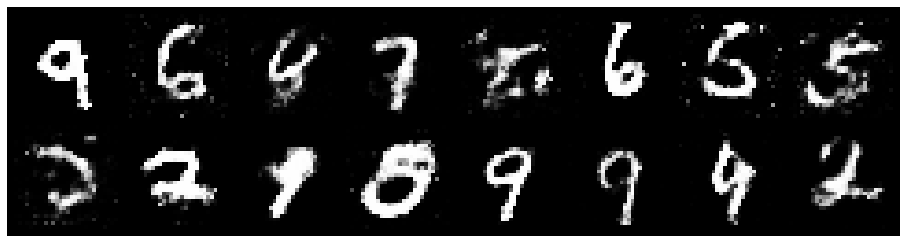

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.2643, Generator Loss: 1.0419
D(x): 0.5757, D(G(z)): 0.4210


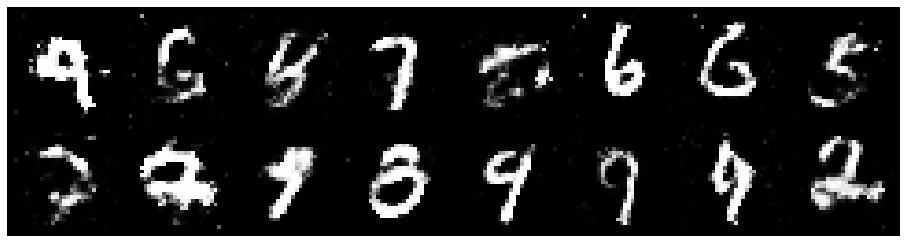

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.2041, Generator Loss: 0.9865
D(x): 0.5332, D(G(z)): 0.3951


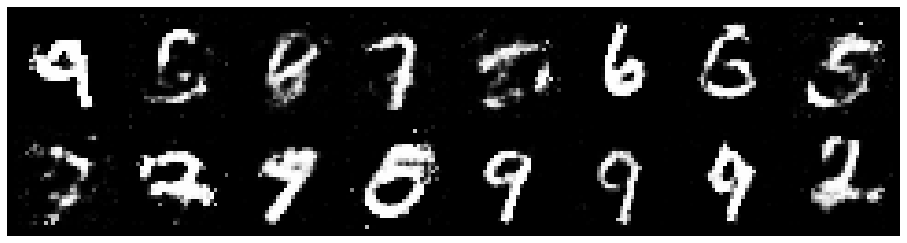

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.2961, Generator Loss: 0.8879
D(x): 0.5211, D(G(z)): 0.4308


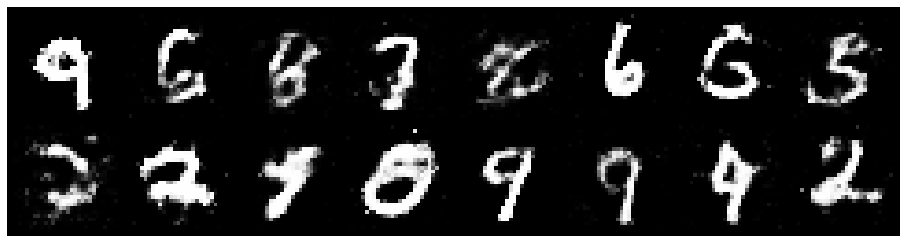

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.1464, Generator Loss: 0.9206
D(x): 0.5981, D(G(z)): 0.4133


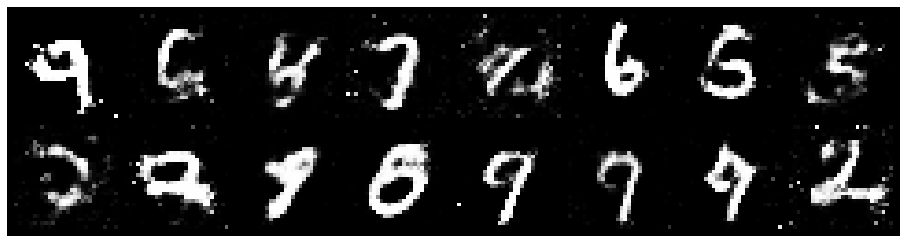

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.1858, Generator Loss: 0.8951
D(x): 0.5637, D(G(z)): 0.3971


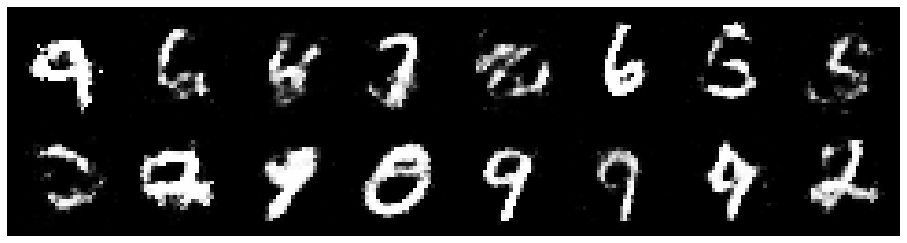

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2480, Generator Loss: 0.8246
D(x): 0.5613, D(G(z)): 0.4536


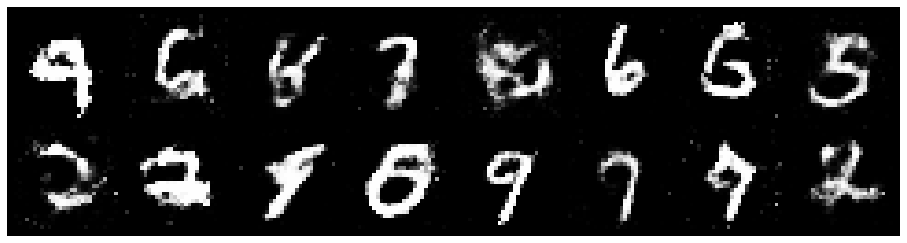

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.3449, Generator Loss: 0.8203
D(x): 0.5250, D(G(z)): 0.4659


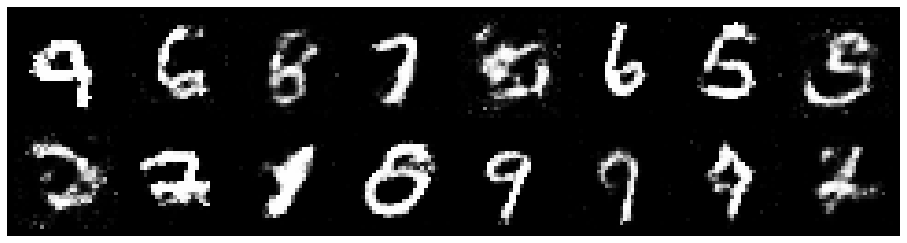

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8257
D(x): 0.5640, D(G(z)): 0.4389


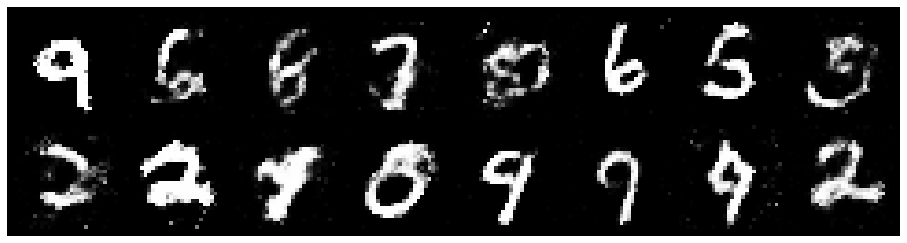

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2530, Generator Loss: 0.9869
D(x): 0.5535, D(G(z)): 0.4264


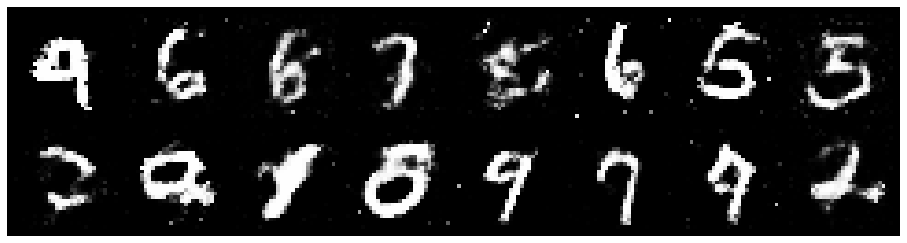

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2318, Generator Loss: 0.8343
D(x): 0.5656, D(G(z)): 0.4371


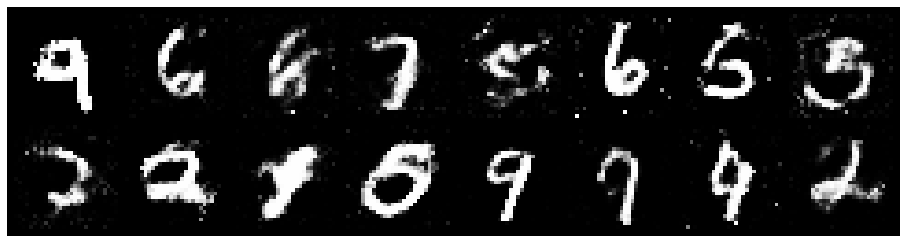

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2540, Generator Loss: 0.9762
D(x): 0.5752, D(G(z)): 0.4443


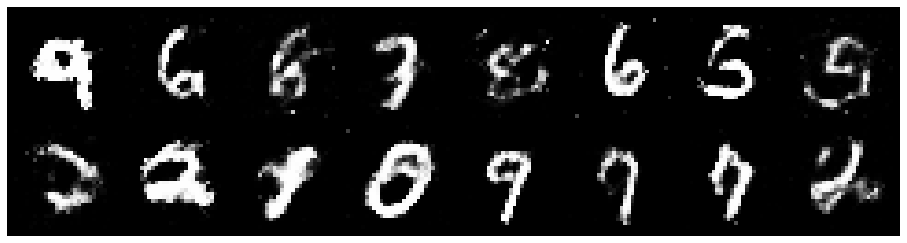

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.3168, Generator Loss: 0.8085
D(x): 0.5449, D(G(z)): 0.4485


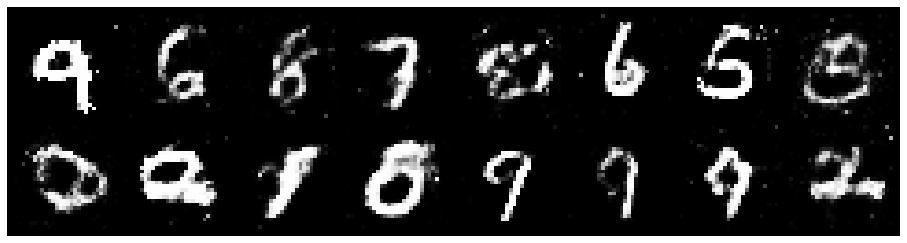

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2729, Generator Loss: 0.8607
D(x): 0.5651, D(G(z)): 0.4615


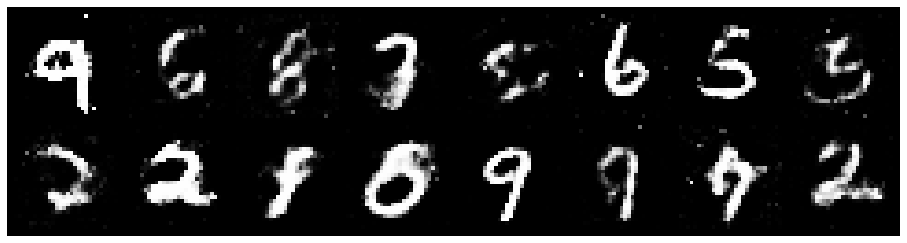

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.3793, Generator Loss: 0.7778
D(x): 0.5689, D(G(z)): 0.4884


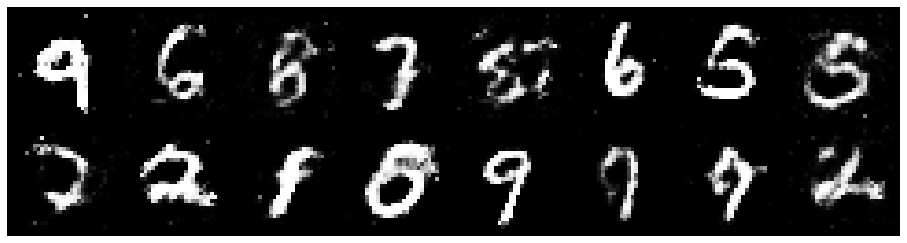

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.3704, Generator Loss: 1.0220
D(x): 0.5121, D(G(z)): 0.4156


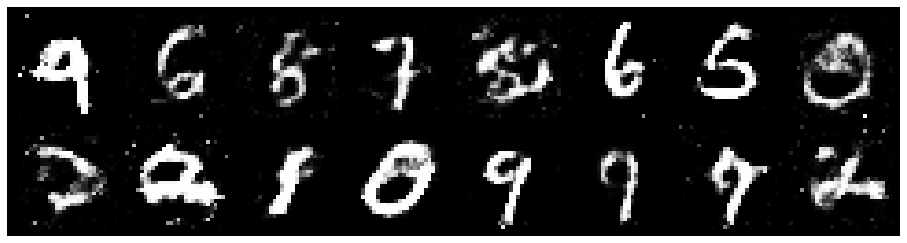

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.1760, Generator Loss: 1.0467
D(x): 0.5704, D(G(z)): 0.4027


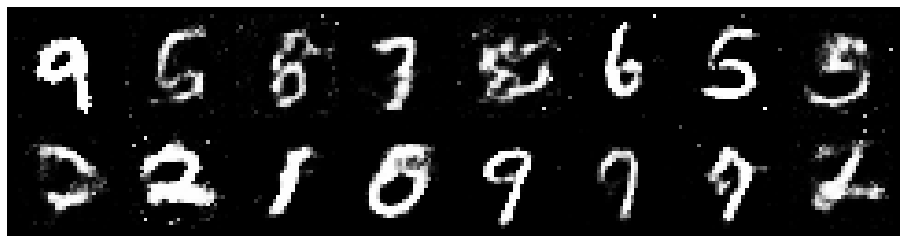

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.1604, Generator Loss: 0.9944
D(x): 0.6013, D(G(z)): 0.4071


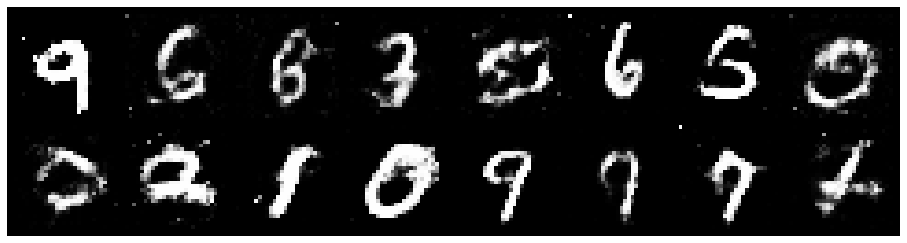

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.3517, Generator Loss: 1.0459
D(x): 0.5386, D(G(z)): 0.4506


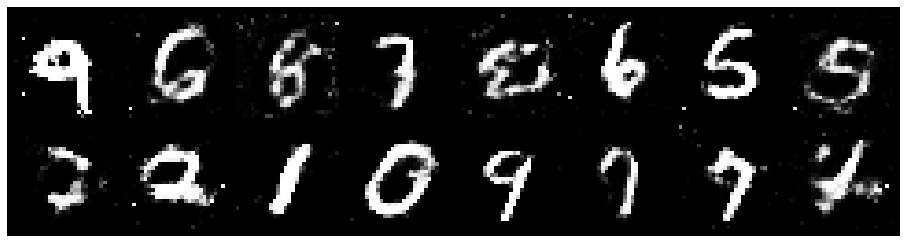

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.3205, Generator Loss: 0.9588
D(x): 0.5445, D(G(z)): 0.4473


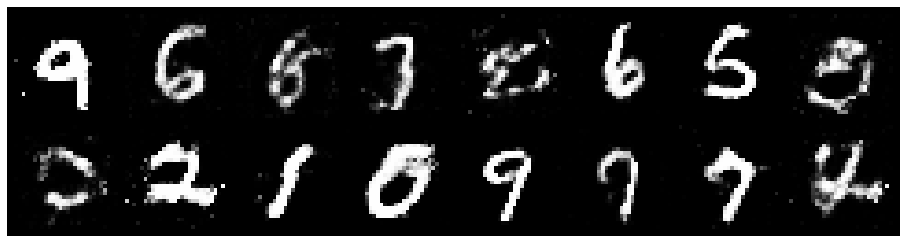

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.1737, Generator Loss: 0.9711
D(x): 0.5789, D(G(z)): 0.3887


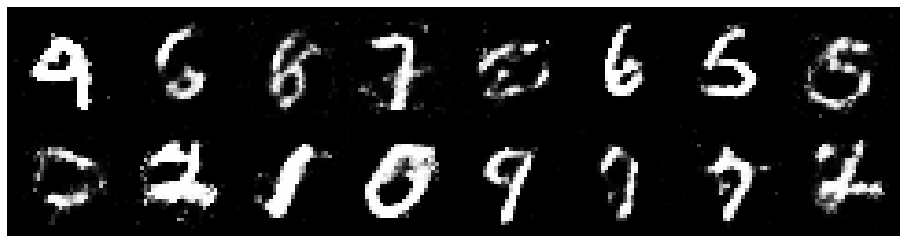

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2339, Generator Loss: 1.0092
D(x): 0.6143, D(G(z)): 0.4605


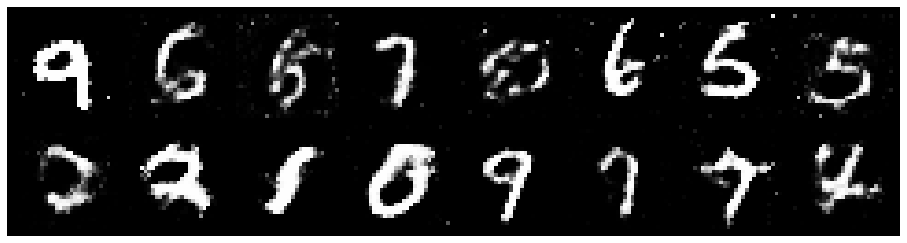

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2209, Generator Loss: 0.8591
D(x): 0.5366, D(G(z)): 0.4121


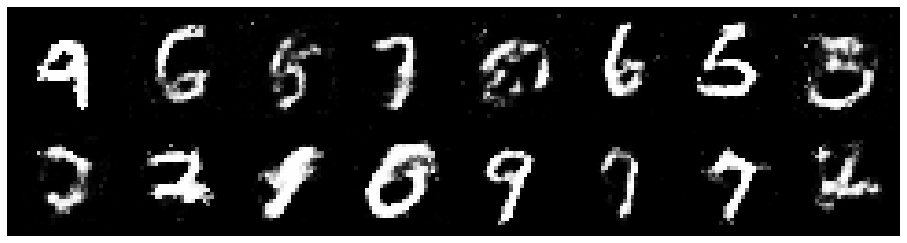

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.1758, Generator Loss: 0.9669
D(x): 0.5770, D(G(z)): 0.4147


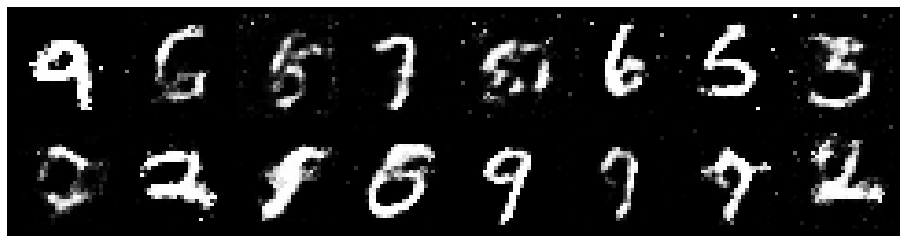

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.2852, Generator Loss: 0.9048
D(x): 0.5840, D(G(z)): 0.4739


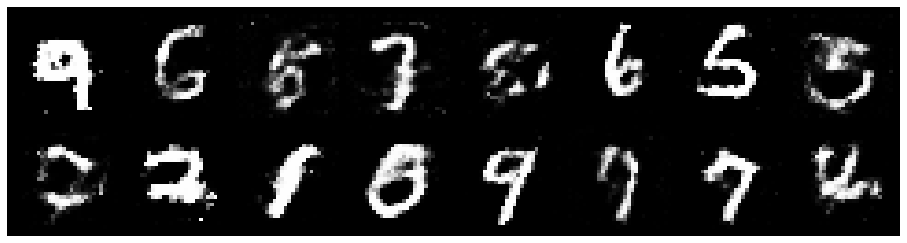

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.3045, Generator Loss: 0.9767
D(x): 0.5258, D(G(z)): 0.4268


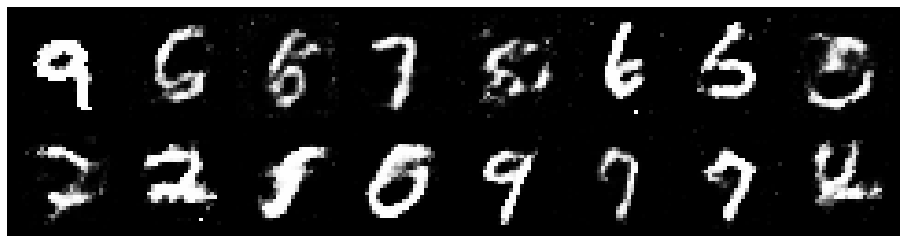

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.2874, Generator Loss: 0.8815
D(x): 0.5832, D(G(z)): 0.4622


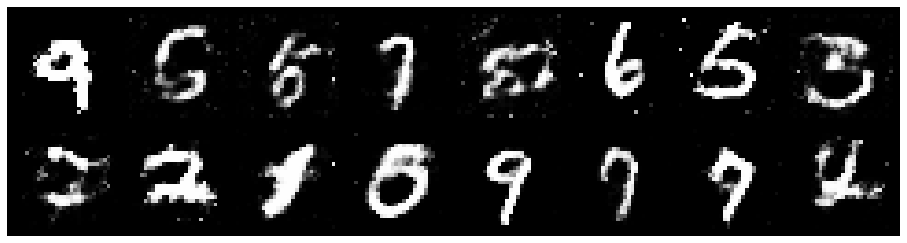

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2327, Generator Loss: 0.8577
D(x): 0.5717, D(G(z)): 0.4345


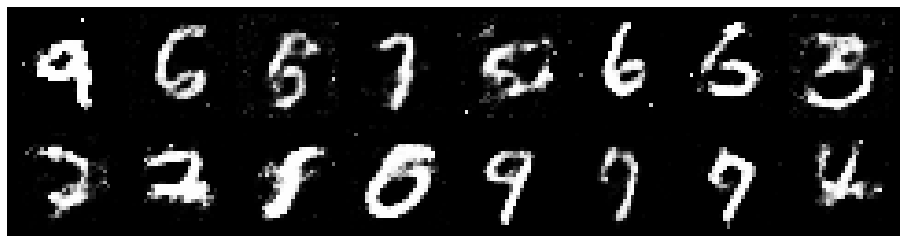

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2816, Generator Loss: 0.9089
D(x): 0.5562, D(G(z)): 0.4482


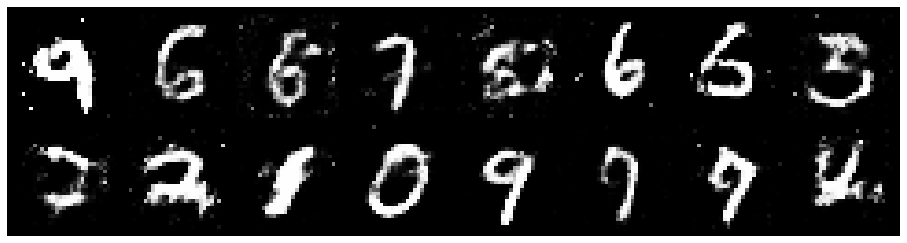

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2942, Generator Loss: 0.8770
D(x): 0.5432, D(G(z)): 0.4563


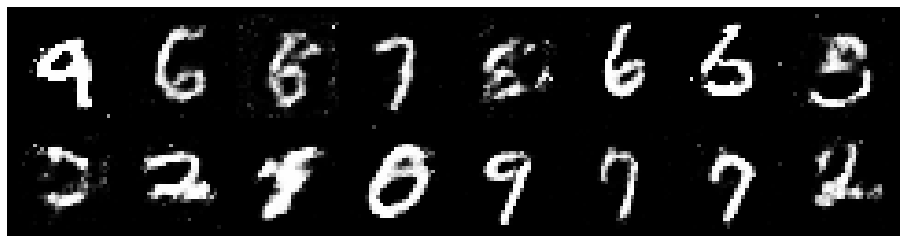

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.3548, Generator Loss: 0.7726
D(x): 0.5317, D(G(z)): 0.4805


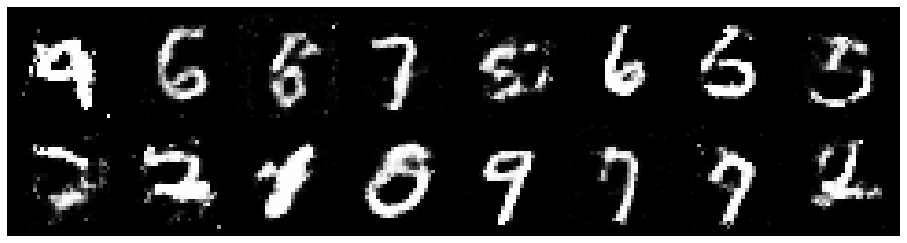

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2874, Generator Loss: 0.8775
D(x): 0.5780, D(G(z)): 0.4733


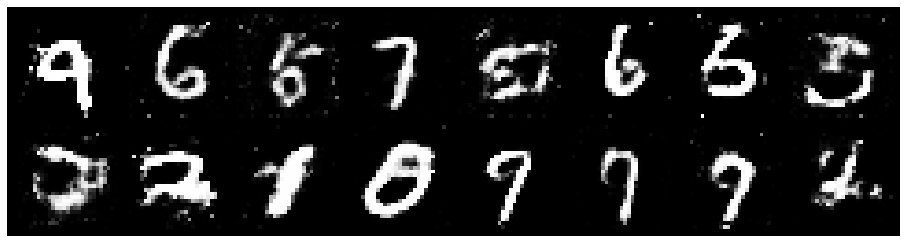

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.3731, Generator Loss: 0.9314
D(x): 0.5471, D(G(z)): 0.4347


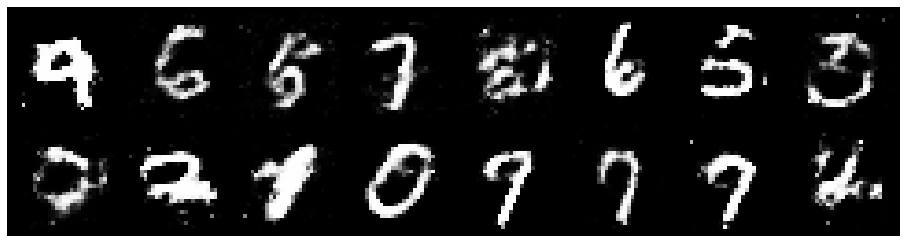

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.2279, Generator Loss: 0.8972
D(x): 0.5912, D(G(z)): 0.4550


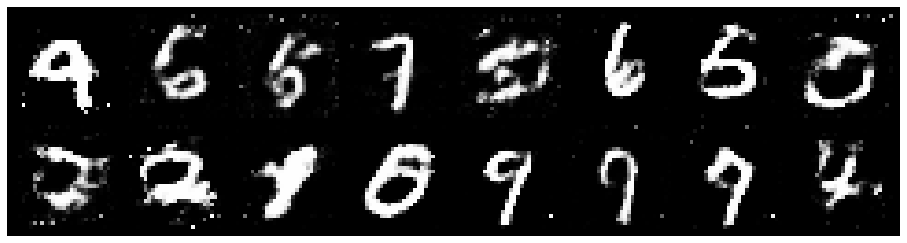

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.1794, Generator Loss: 0.7932
D(x): 0.6288, D(G(z)): 0.4460


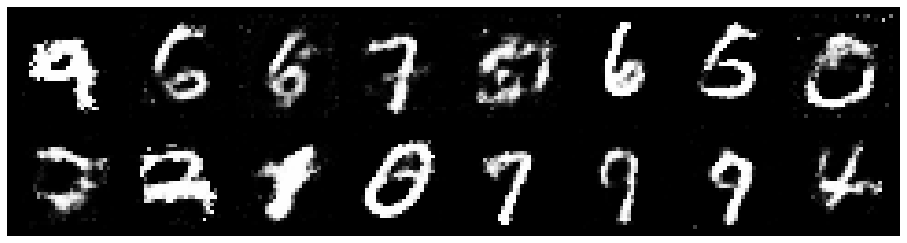

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.2616, Generator Loss: 0.8298
D(x): 0.5550, D(G(z)): 0.4471


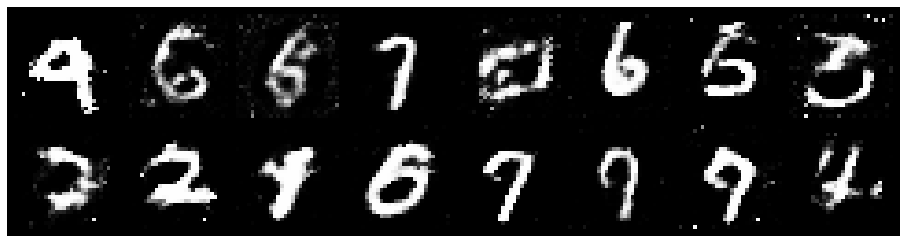

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.3712, Generator Loss: 0.7276
D(x): 0.5667, D(G(z)): 0.5100


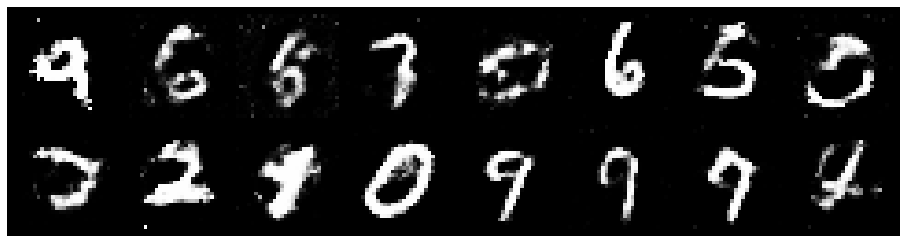

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.2673, Generator Loss: 1.0194
D(x): 0.6117, D(G(z)): 0.4629


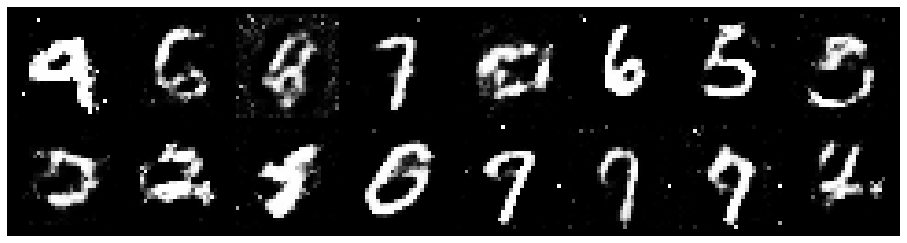

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.3243, Generator Loss: 0.8865
D(x): 0.5265, D(G(z)): 0.4497


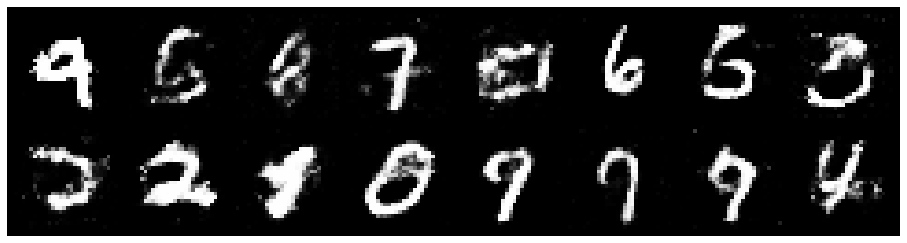

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2944, Generator Loss: 0.9637
D(x): 0.5575, D(G(z)): 0.4521


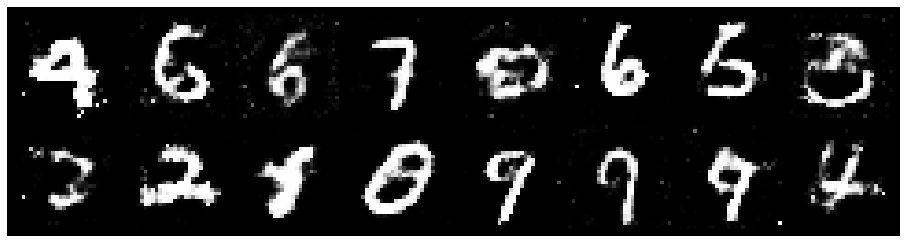

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2611, Generator Loss: 0.9221
D(x): 0.5345, D(G(z)): 0.4137


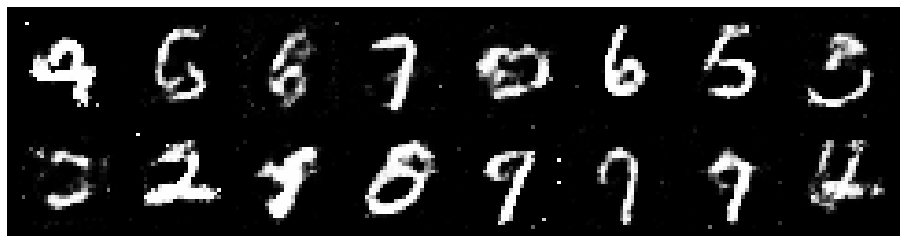

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.3563, Generator Loss: 1.0058
D(x): 0.5641, D(G(z)): 0.4619


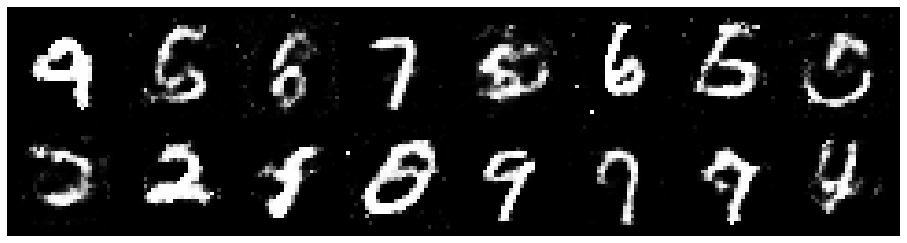

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.1394, Generator Loss: 0.9425
D(x): 0.5957, D(G(z)): 0.4145


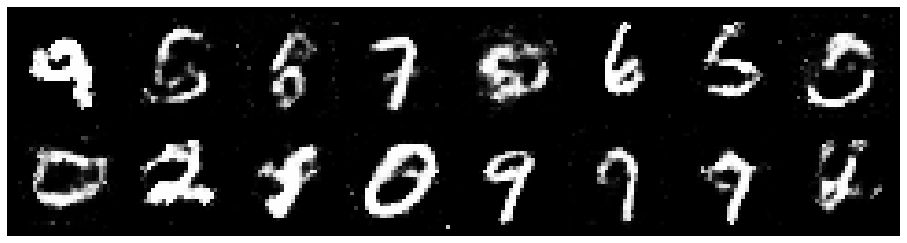

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.2078, Generator Loss: 0.9490
D(x): 0.5449, D(G(z)): 0.3876


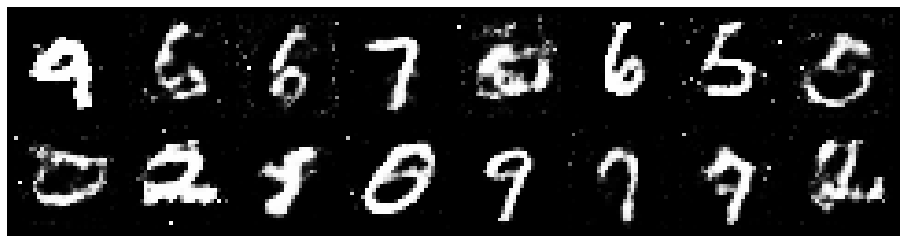

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.1908, Generator Loss: 0.9566
D(x): 0.5854, D(G(z)): 0.4345


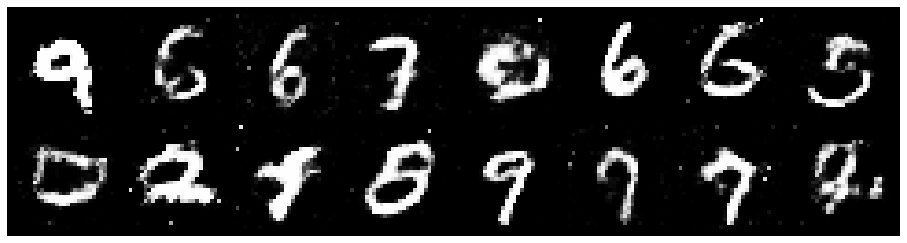

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.1869, Generator Loss: 0.8465
D(x): 0.6033, D(G(z)): 0.4508


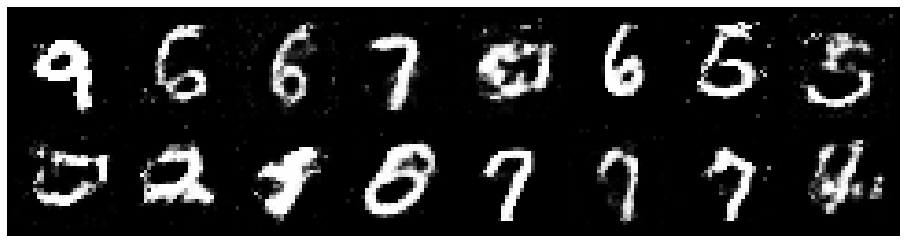

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.1700, Generator Loss: 0.9219
D(x): 0.5711, D(G(z)): 0.4066


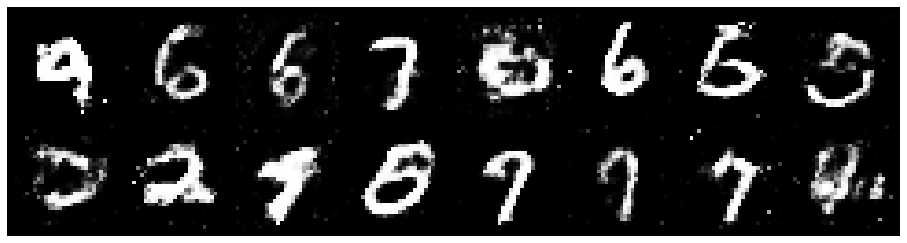

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.1285, Generator Loss: 1.0151
D(x): 0.5730, D(G(z)): 0.3797


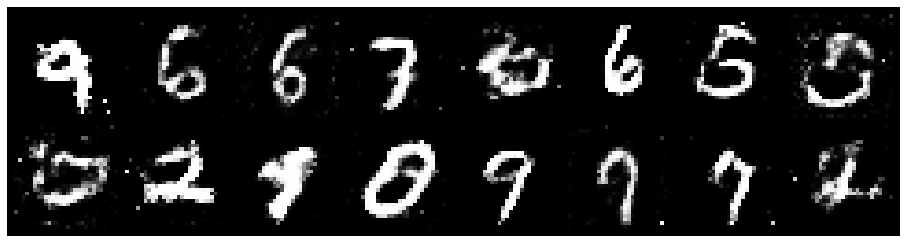

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.3090, Generator Loss: 1.0631
D(x): 0.5184, D(G(z)): 0.3979


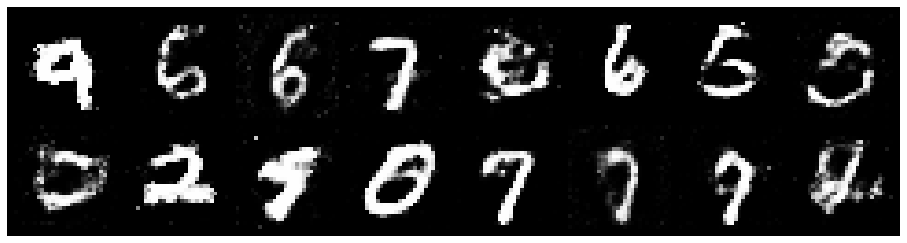

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.2064, Generator Loss: 0.9315
D(x): 0.5903, D(G(z)): 0.4423


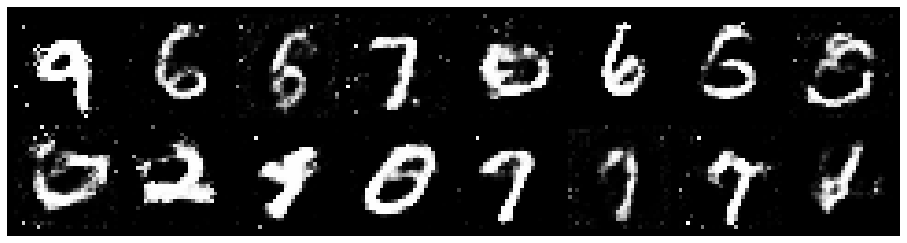

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.1354, Generator Loss: 1.0173
D(x): 0.5933, D(G(z)): 0.4047


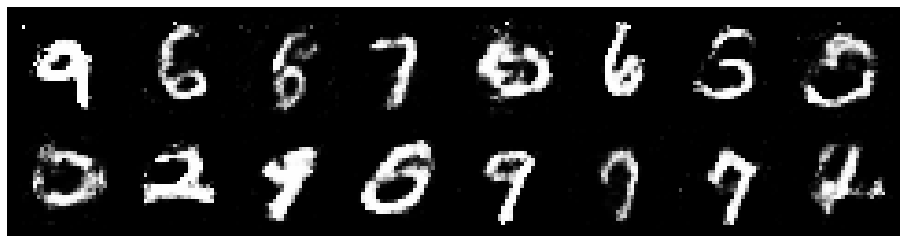

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2070, Generator Loss: 1.2044
D(x): 0.6048, D(G(z)): 0.4237


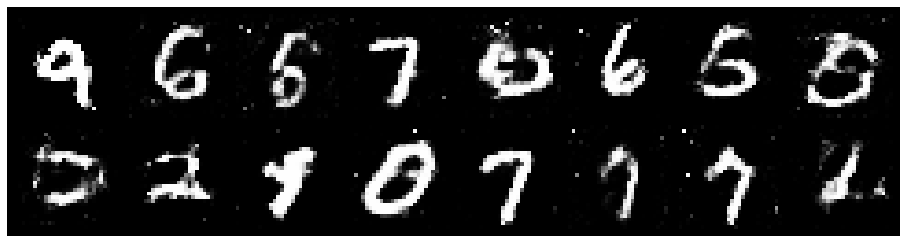

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.0681, Generator Loss: 1.4236
D(x): 0.6315, D(G(z)): 0.3585


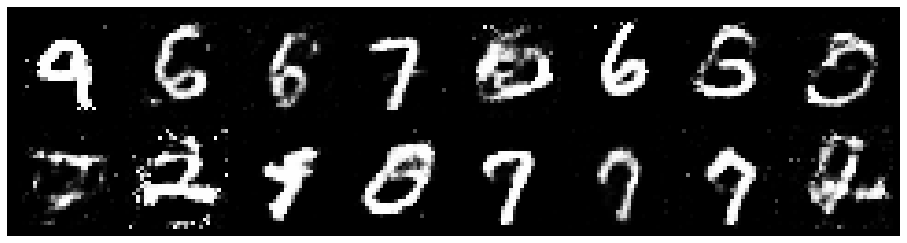

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2217, Generator Loss: 0.8945
D(x): 0.5560, D(G(z)): 0.4330


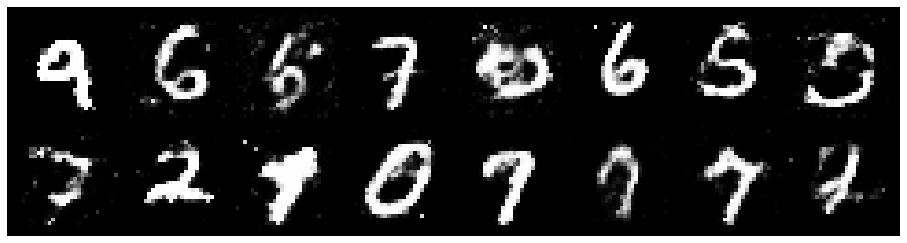

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.1389, Generator Loss: 0.9749
D(x): 0.6032, D(G(z)): 0.4256


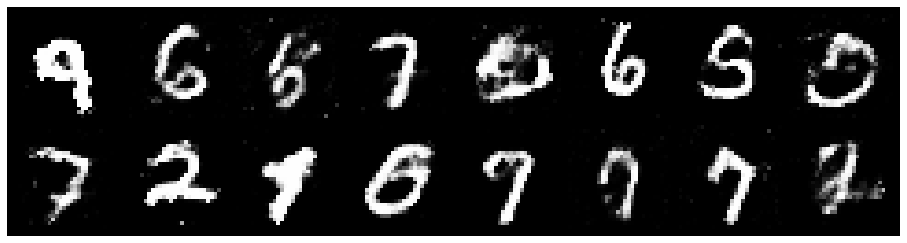

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.2076, Generator Loss: 1.0368
D(x): 0.5976, D(G(z)): 0.4525


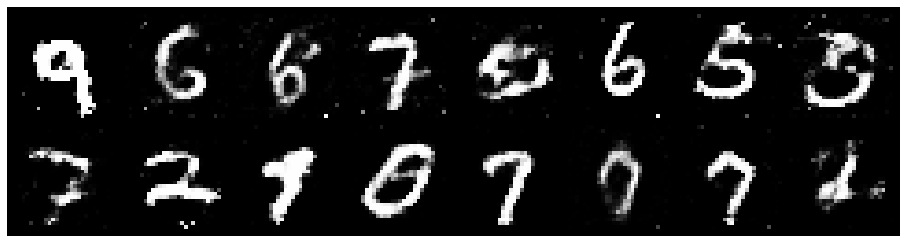

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2627, Generator Loss: 0.9111
D(x): 0.5730, D(G(z)): 0.4592


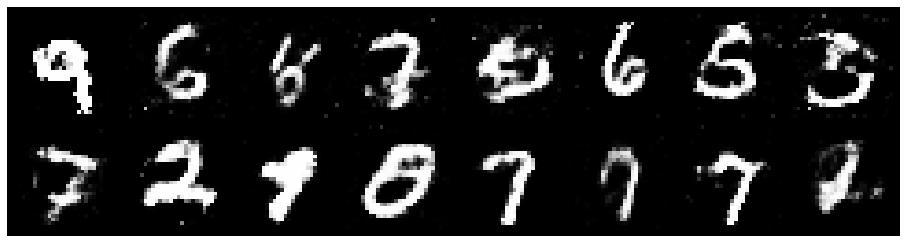

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2677, Generator Loss: 0.7448
D(x): 0.5542, D(G(z)): 0.4710


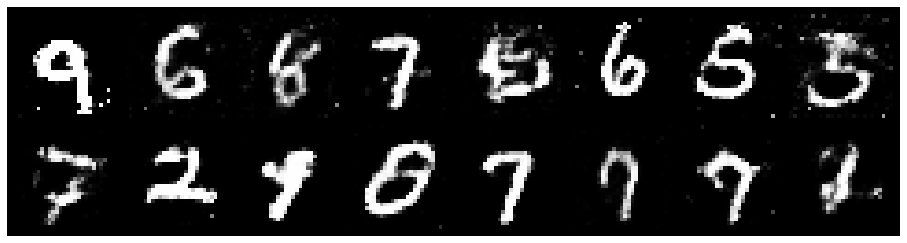

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.2544, Generator Loss: 0.9204
D(x): 0.5469, D(G(z)): 0.4206


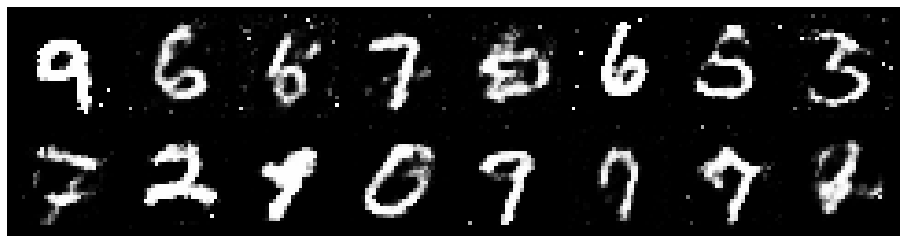

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.4030, Generator Loss: 0.9181
D(x): 0.4958, D(G(z)): 0.4382


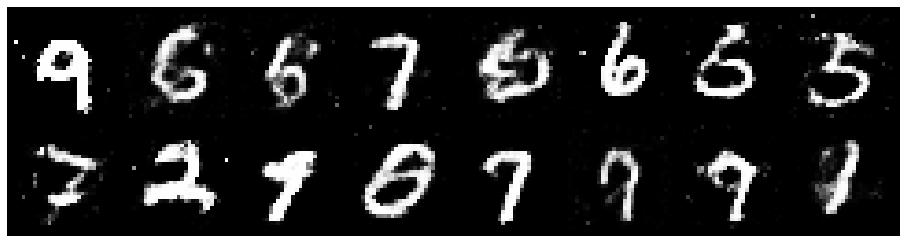

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.1686, Generator Loss: 0.8858
D(x): 0.6122, D(G(z)): 0.4269


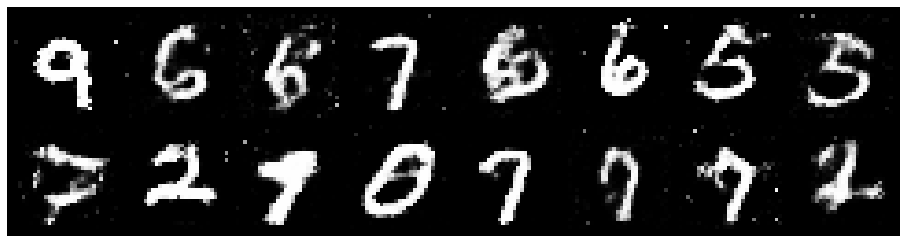

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.2341, Generator Loss: 1.0058
D(x): 0.5298, D(G(z)): 0.4057


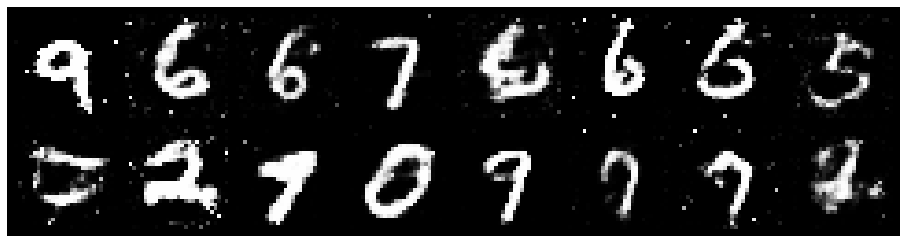

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2968, Generator Loss: 0.8019
D(x): 0.5148, D(G(z)): 0.4285


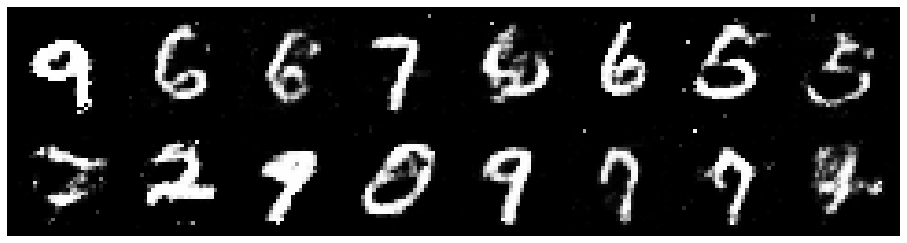

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.3017, Generator Loss: 0.8773
D(x): 0.5784, D(G(z)): 0.4765


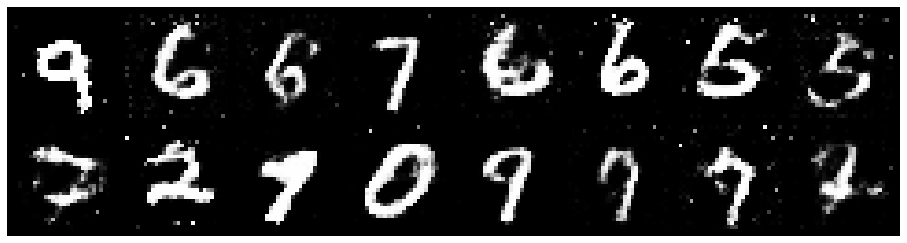

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2202, Generator Loss: 0.8891
D(x): 0.5670, D(G(z)): 0.4363


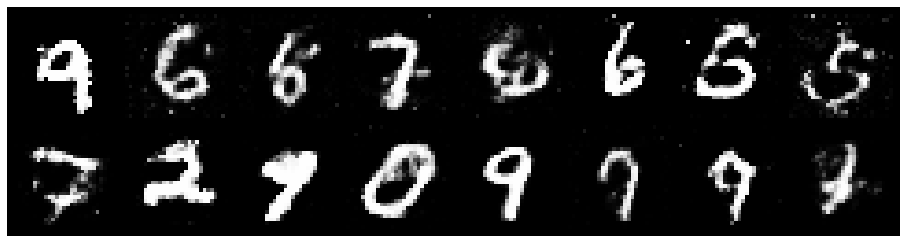

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2475, Generator Loss: 1.0461
D(x): 0.5632, D(G(z)): 0.4271


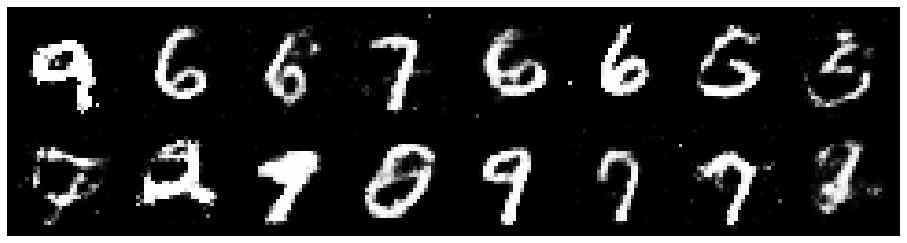

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.3067, Generator Loss: 0.8720
D(x): 0.5668, D(G(z)): 0.4661


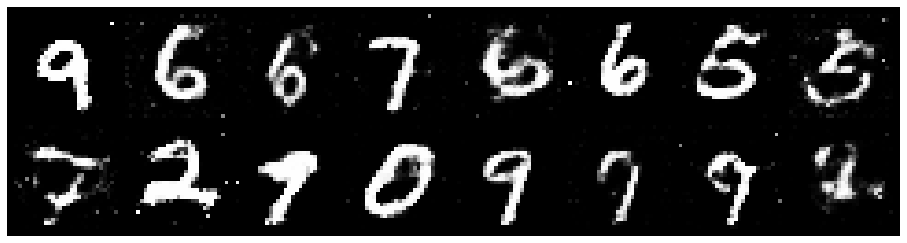

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.2088, Generator Loss: 0.9269
D(x): 0.6006, D(G(z)): 0.4425


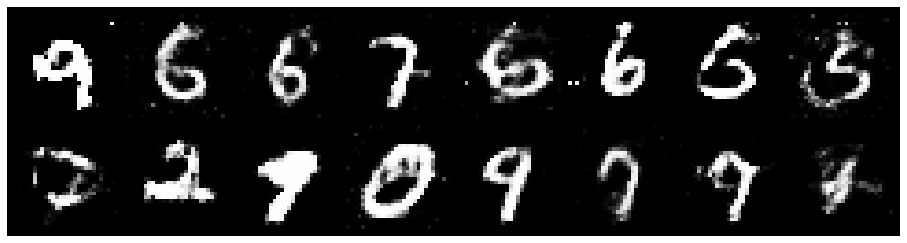

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2165, Generator Loss: 0.8526
D(x): 0.5647, D(G(z)): 0.4297


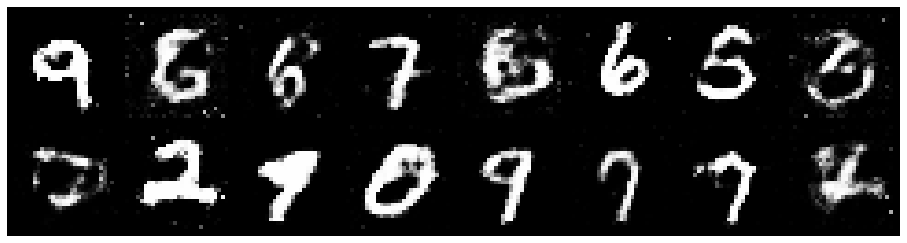

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2504, Generator Loss: 0.8571
D(x): 0.5917, D(G(z)): 0.4572


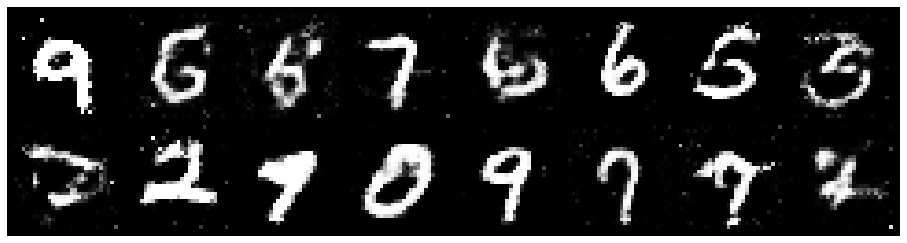

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.3044, Generator Loss: 0.8711
D(x): 0.5350, D(G(z)): 0.4445


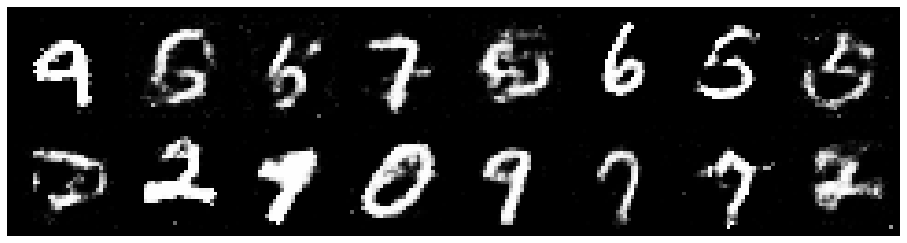

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.3252, Generator Loss: 0.8148
D(x): 0.5352, D(G(z)): 0.4466


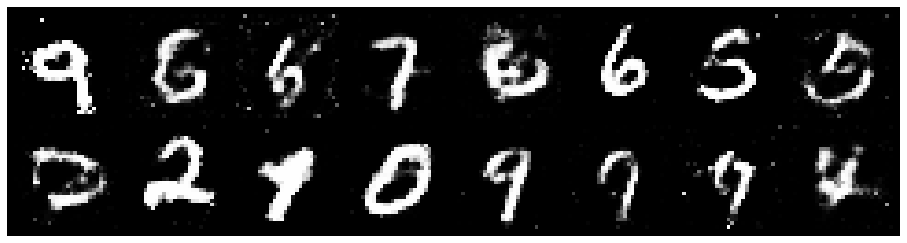

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2433, Generator Loss: 0.8556
D(x): 0.5459, D(G(z)): 0.4476


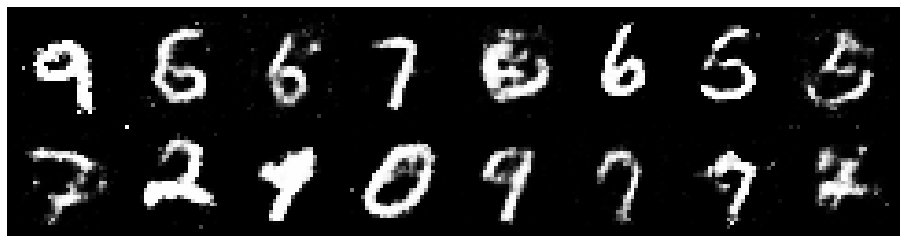

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2491, Generator Loss: 0.8948
D(x): 0.5496, D(G(z)): 0.4340


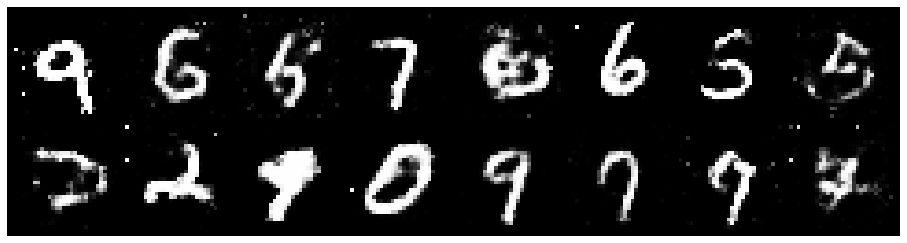

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.2870, Generator Loss: 0.9125
D(x): 0.5881, D(G(z)): 0.4640


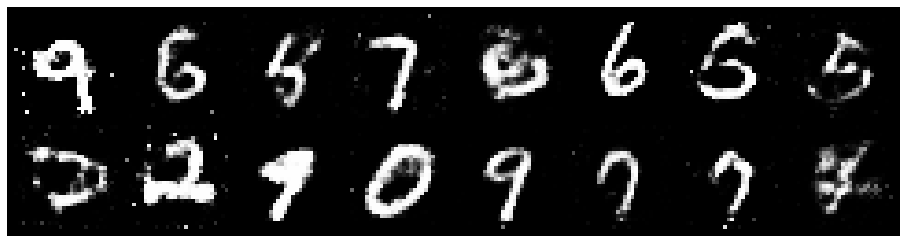

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2904, Generator Loss: 0.8451
D(x): 0.5763, D(G(z)): 0.4754


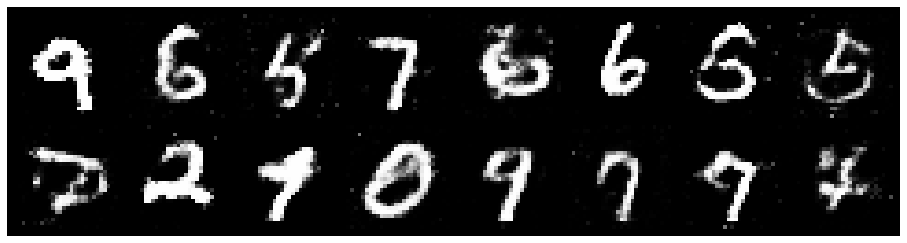

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2412, Generator Loss: 0.9323
D(x): 0.5827, D(G(z)): 0.4363


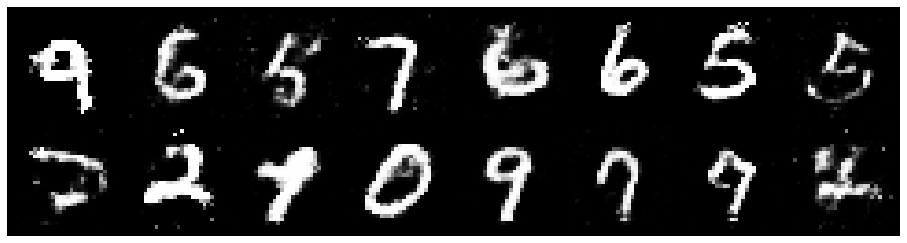

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.3103, Generator Loss: 0.9994
D(x): 0.5256, D(G(z)): 0.3904


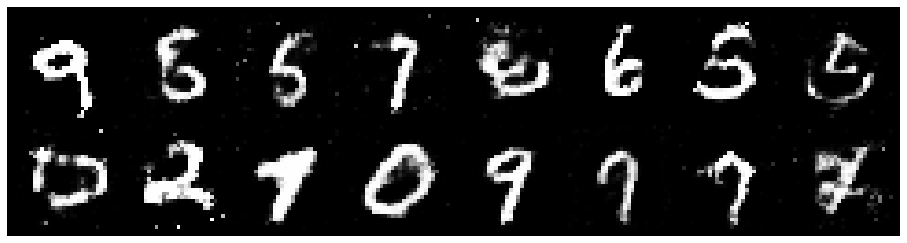

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.3781, Generator Loss: 0.7972
D(x): 0.5130, D(G(z)): 0.4707


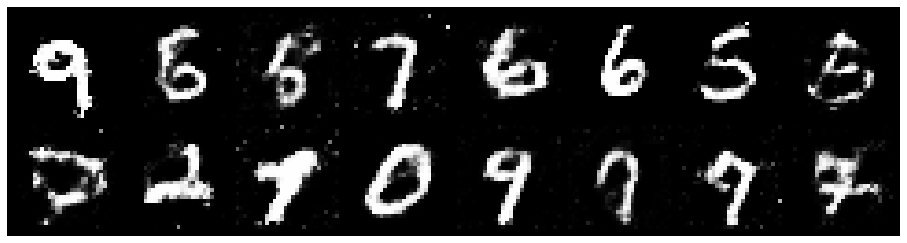

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.2394, Generator Loss: 0.8768
D(x): 0.5560, D(G(z)): 0.4157


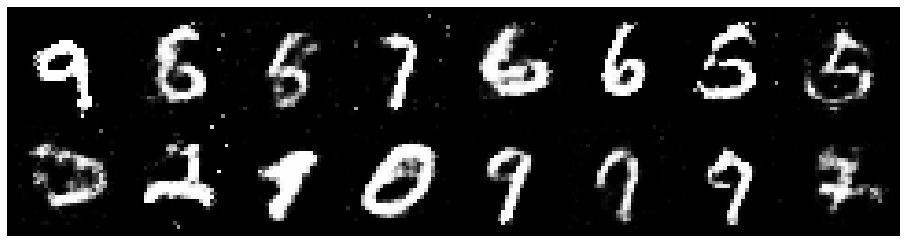

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2308, Generator Loss: 0.8698
D(x): 0.5908, D(G(z)): 0.4424


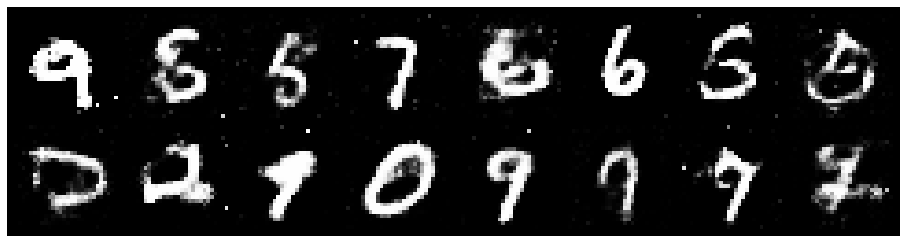

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2132, Generator Loss: 0.9540
D(x): 0.6023, D(G(z)): 0.4531


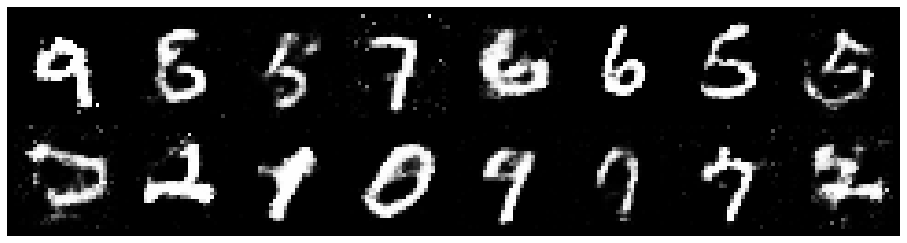

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.3873, Generator Loss: 0.8697
D(x): 0.5328, D(G(z)): 0.4656


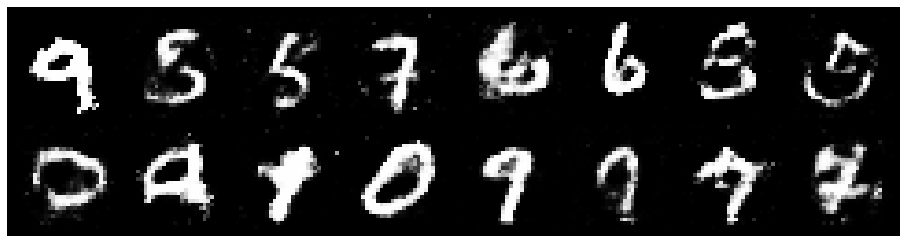

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.3383, Generator Loss: 0.7620
D(x): 0.5736, D(G(z)): 0.4976


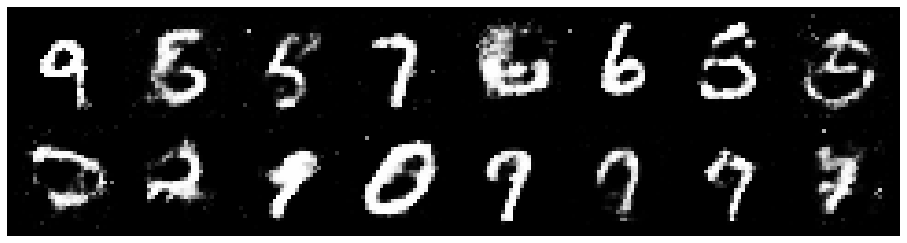

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.2414, Generator Loss: 0.8316
D(x): 0.5624, D(G(z)): 0.4548


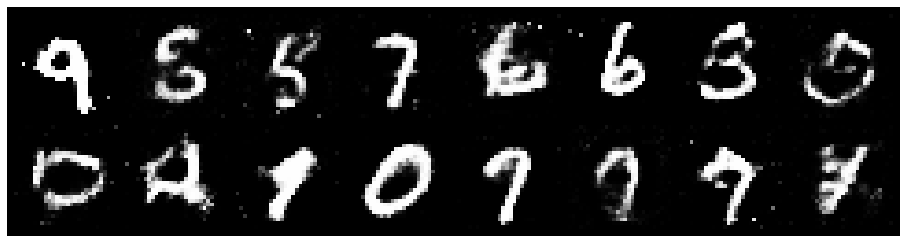

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.2957, Generator Loss: 0.9488
D(x): 0.5550, D(G(z)): 0.4287


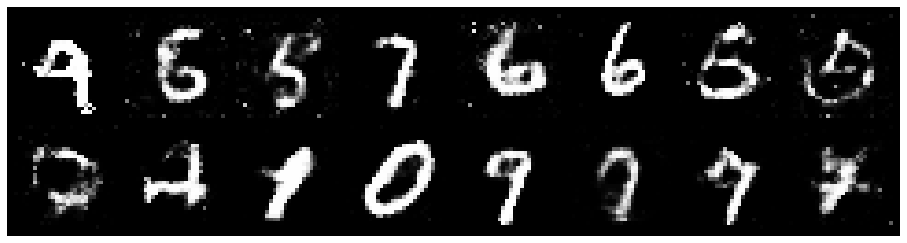

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.3058, Generator Loss: 0.8823
D(x): 0.5156, D(G(z)): 0.4303


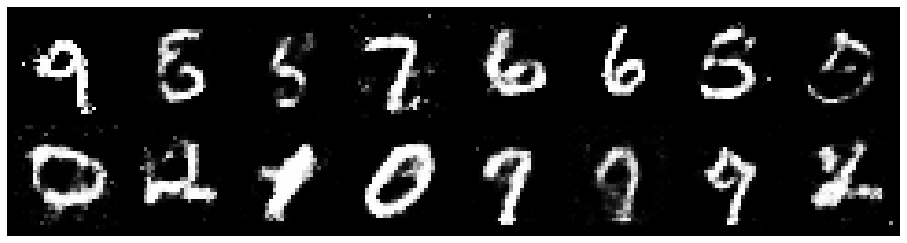

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.2977, Generator Loss: 0.7994
D(x): 0.5286, D(G(z)): 0.4477


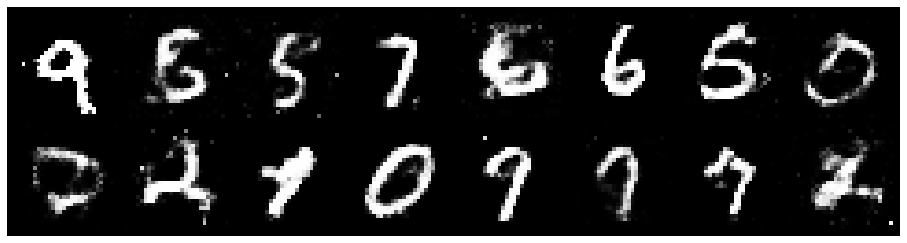

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2172, Generator Loss: 0.8461
D(x): 0.5858, D(G(z)): 0.4357


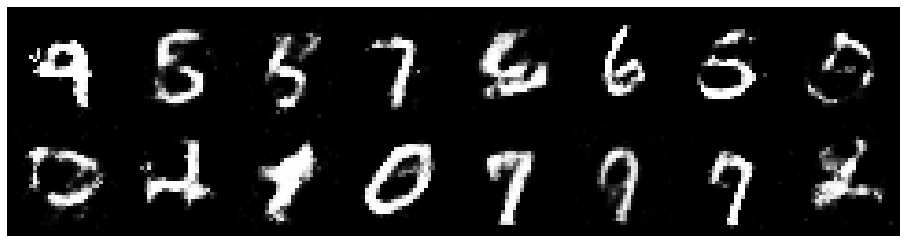

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.2398, Generator Loss: 0.9815
D(x): 0.5612, D(G(z)): 0.4168


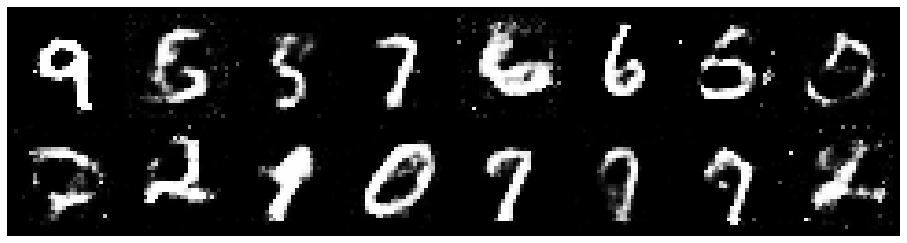

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.3074, Generator Loss: 0.9069
D(x): 0.5017, D(G(z)): 0.4128


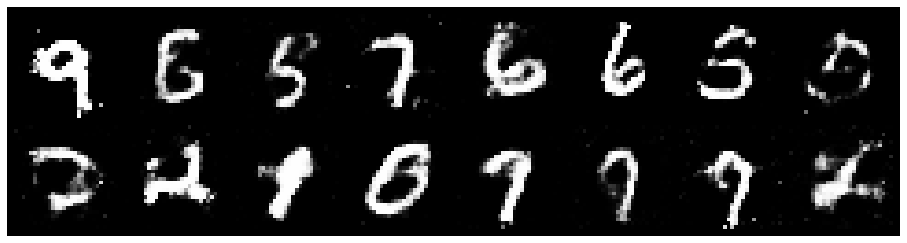

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.2890, Generator Loss: 0.9887
D(x): 0.5191, D(G(z)): 0.4180


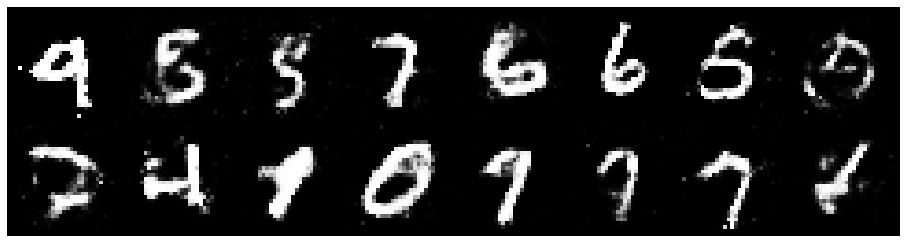

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.1283, Generator Loss: 1.0751
D(x): 0.5978, D(G(z)): 0.3843


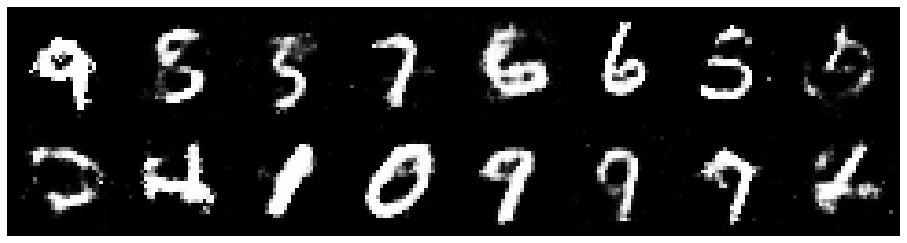

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.2260, Generator Loss: 1.0176
D(x): 0.5455, D(G(z)): 0.3819


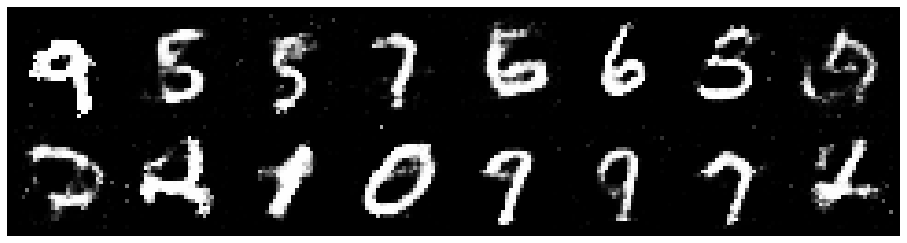

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.3578, Generator Loss: 0.9340
D(x): 0.5221, D(G(z)): 0.4566


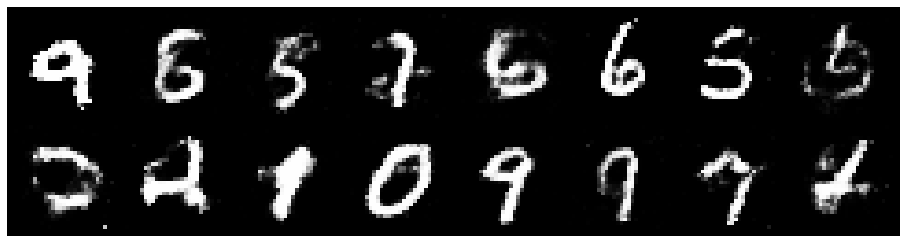

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.2303, Generator Loss: 0.8772
D(x): 0.5568, D(G(z)): 0.4314


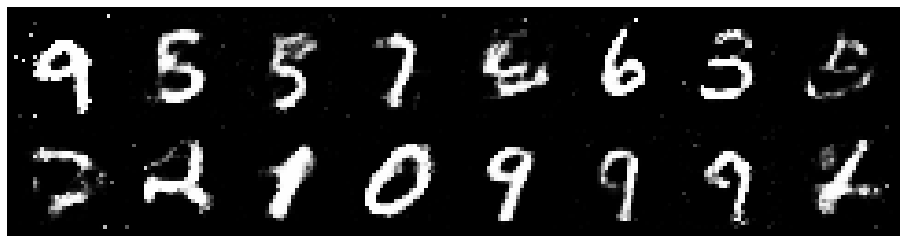

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.3767, Generator Loss: 1.0365
D(x): 0.5768, D(G(z)): 0.4783


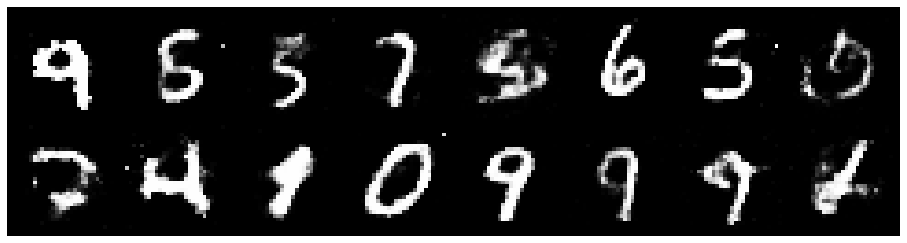

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.3196, Generator Loss: 0.8530
D(x): 0.5247, D(G(z)): 0.4291


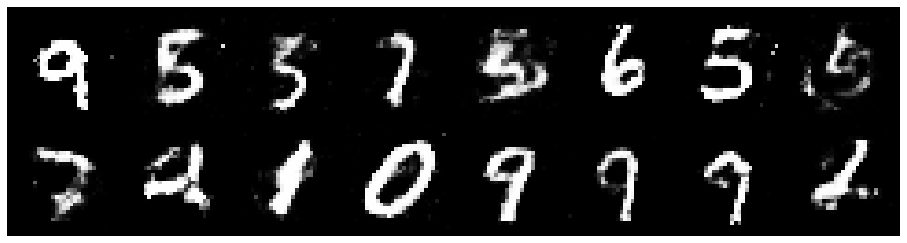

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.1946, Generator Loss: 0.8822
D(x): 0.5827, D(G(z)): 0.4345


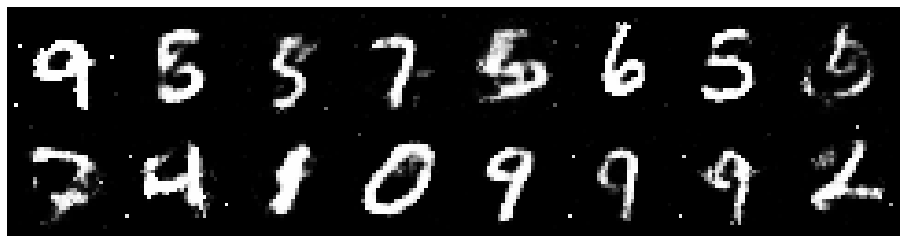

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3815, Generator Loss: 0.8888
D(x): 0.5380, D(G(z)): 0.4791


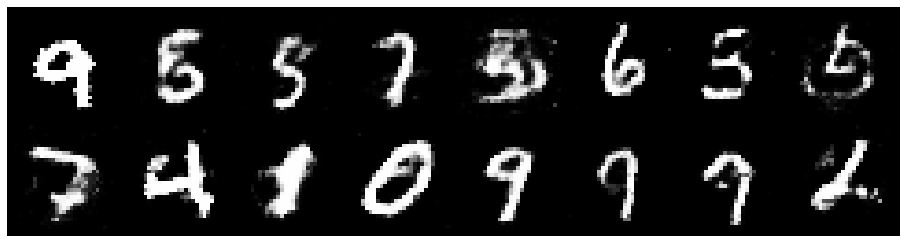

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.1742, Generator Loss: 0.9277
D(x): 0.5775, D(G(z)): 0.4001


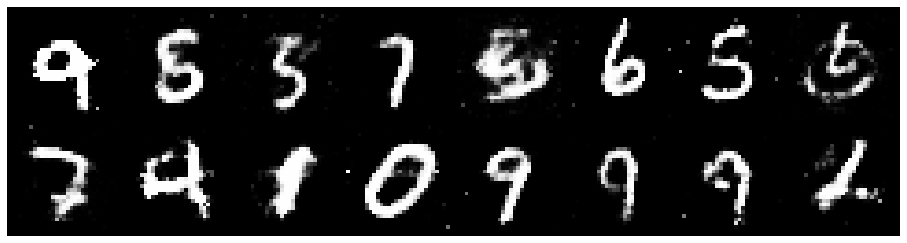

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.2324, Generator Loss: 0.9182
D(x): 0.5445, D(G(z)): 0.4074


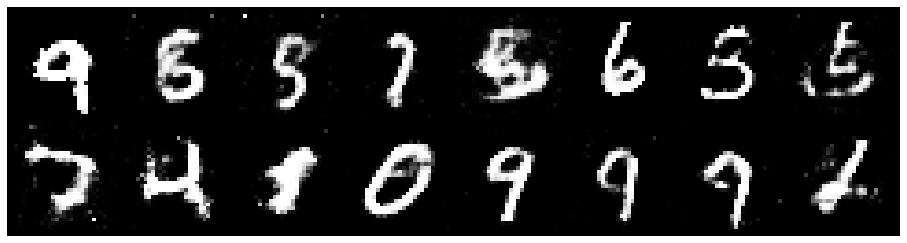

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.1737, Generator Loss: 1.0551
D(x): 0.5839, D(G(z)): 0.4122


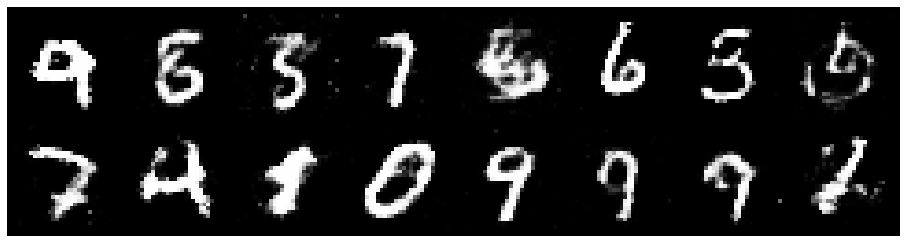

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.2258, Generator Loss: 0.8997
D(x): 0.5748, D(G(z)): 0.4368


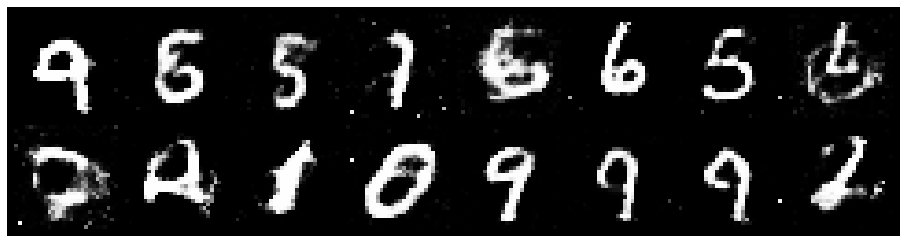

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2968, Generator Loss: 0.7350
D(x): 0.5879, D(G(z)): 0.4983


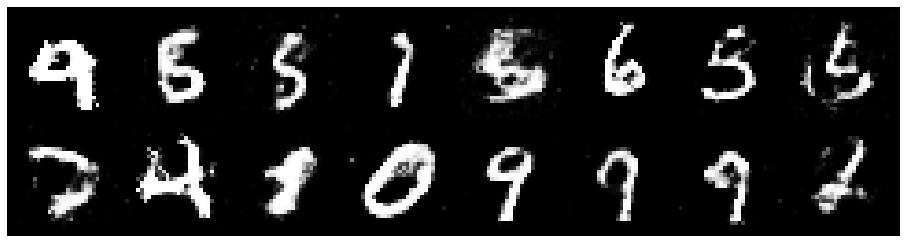

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.3648, Generator Loss: 0.8296
D(x): 0.5338, D(G(z)): 0.4855


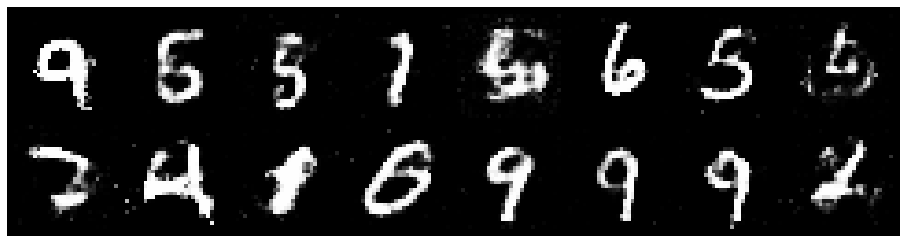

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.3416, Generator Loss: 0.9745
D(x): 0.5106, D(G(z)): 0.4367


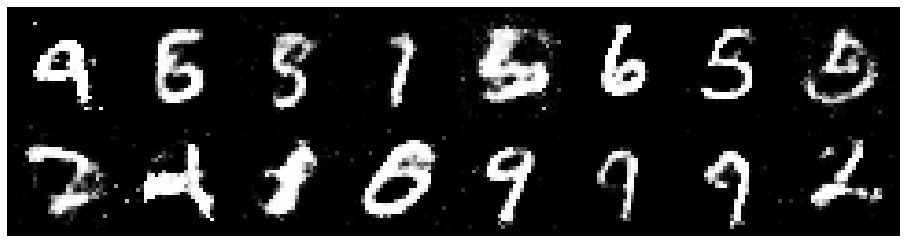

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.3030, Generator Loss: 0.7778
D(x): 0.5656, D(G(z)): 0.4792


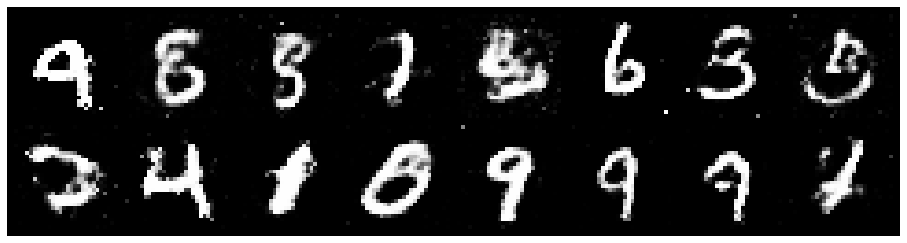

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.3517, Generator Loss: 0.8340
D(x): 0.5137, D(G(z)): 0.4478


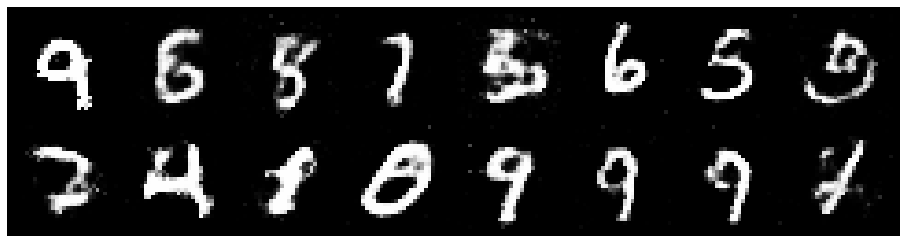

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2881, Generator Loss: 0.7958
D(x): 0.5521, D(G(z)): 0.4476


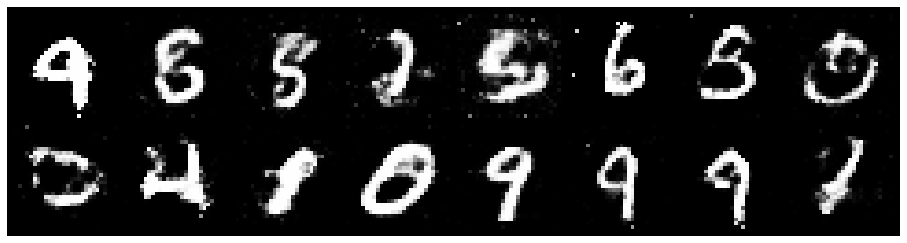

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2785, Generator Loss: 0.8137
D(x): 0.5624, D(G(z)): 0.4576


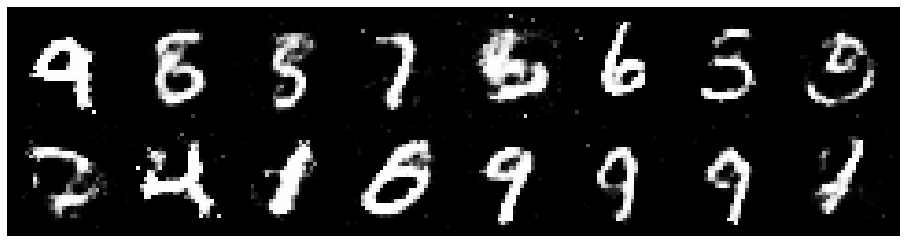

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.3123, Generator Loss: 0.8186
D(x): 0.5594, D(G(z)): 0.4523


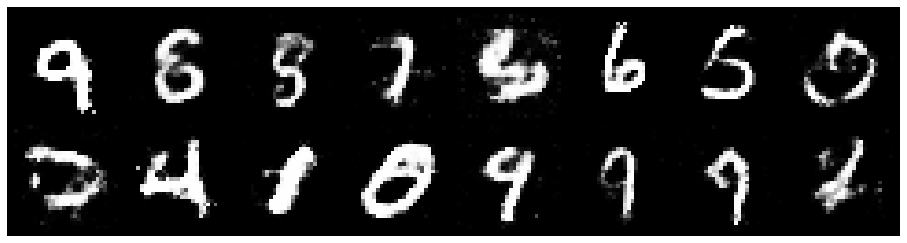

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.3118, Generator Loss: 0.9049
D(x): 0.5790, D(G(z)): 0.4626


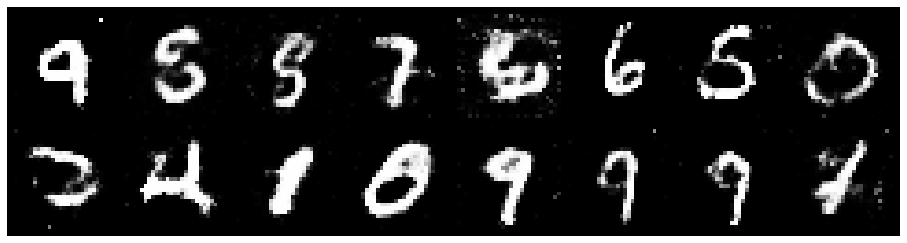

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2502, Generator Loss: 0.9168
D(x): 0.5484, D(G(z)): 0.4391


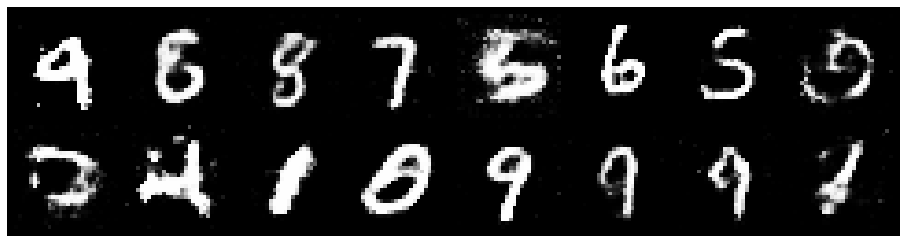

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.3016, Generator Loss: 0.9273
D(x): 0.5468, D(G(z)): 0.4349


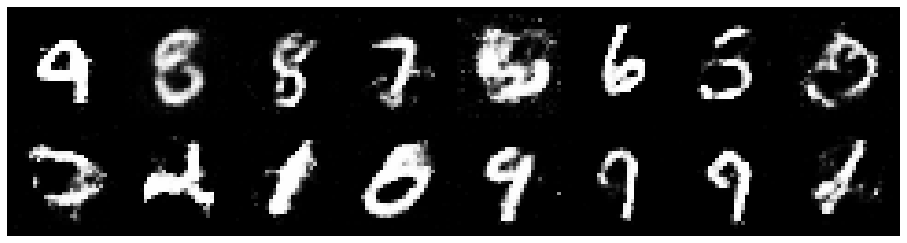

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3790, Generator Loss: 0.9648
D(x): 0.5297, D(G(z)): 0.4588


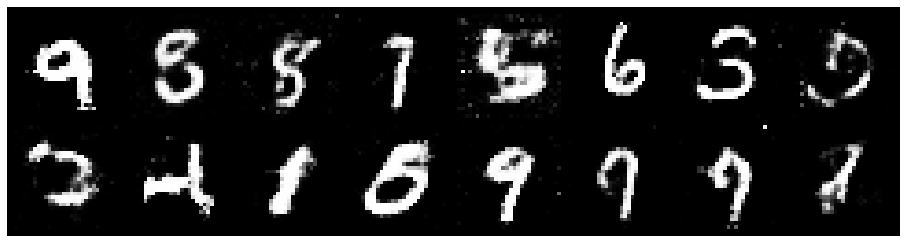

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.2388, Generator Loss: 1.0146
D(x): 0.5661, D(G(z)): 0.4333


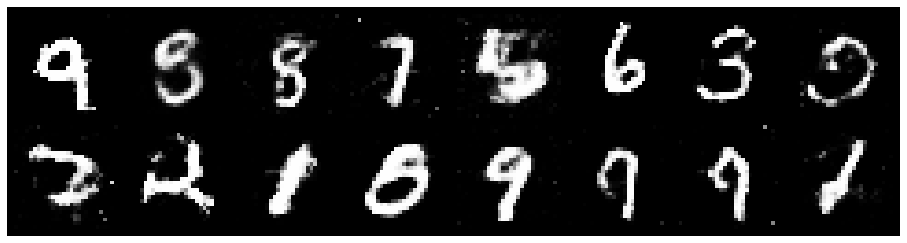

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.2419, Generator Loss: 0.9196
D(x): 0.5326, D(G(z)): 0.4131


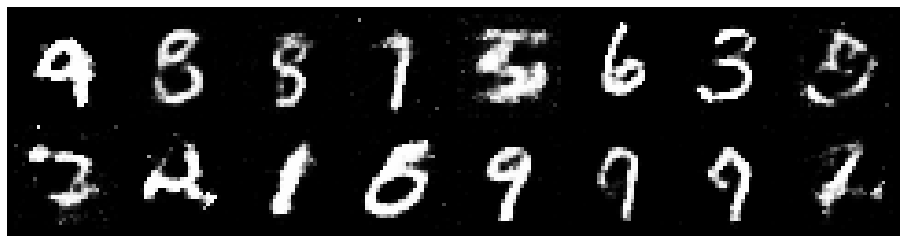

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2268, Generator Loss: 0.9318
D(x): 0.5544, D(G(z)): 0.4270


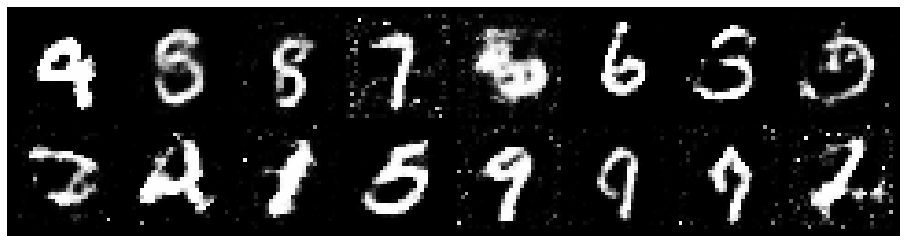

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.1570, Generator Loss: 0.7781
D(x): 0.5896, D(G(z)): 0.4263


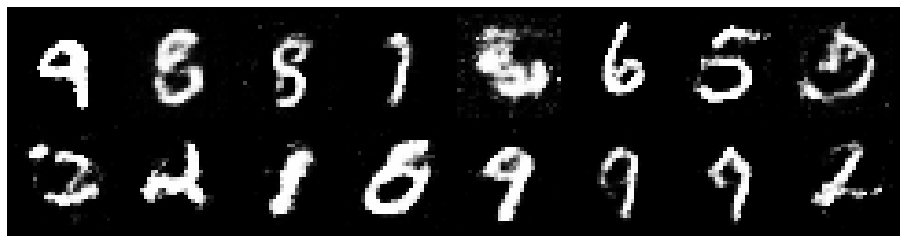

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.1982, Generator Loss: 0.8136
D(x): 0.5928, D(G(z)): 0.4435


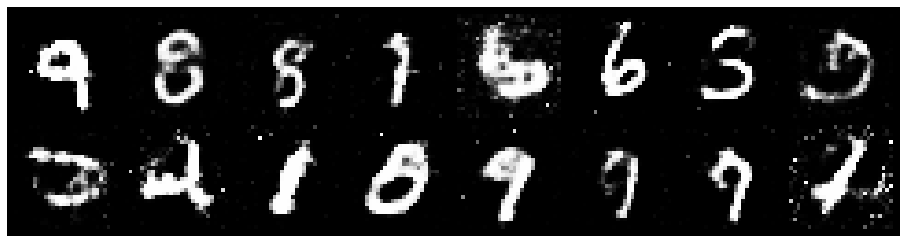

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.3835, Generator Loss: 0.8093
D(x): 0.5043, D(G(z)): 0.4657


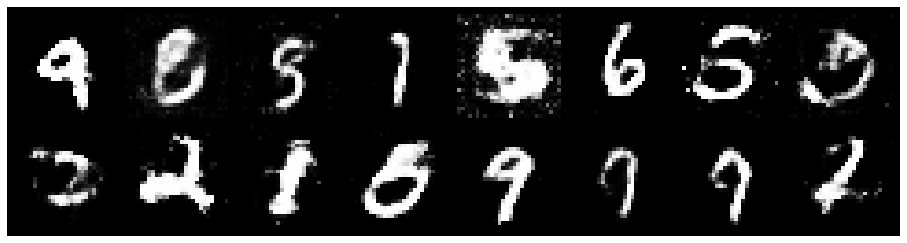

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.2459, Generator Loss: 0.8497
D(x): 0.5819, D(G(z)): 0.4618


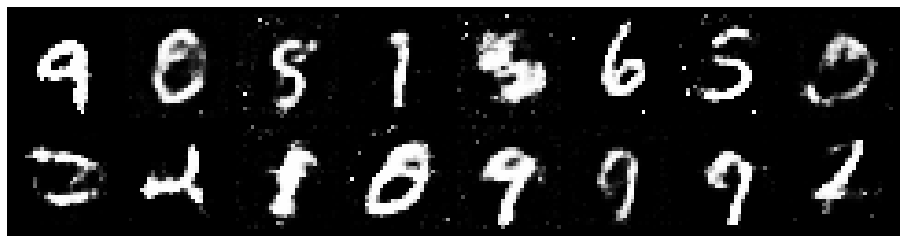

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3312, Generator Loss: 0.9343
D(x): 0.6117, D(G(z)): 0.4755


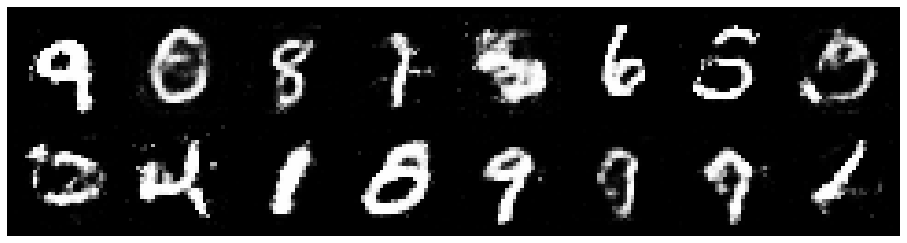

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.1893, Generator Loss: 0.9269
D(x): 0.6086, D(G(z)): 0.4420


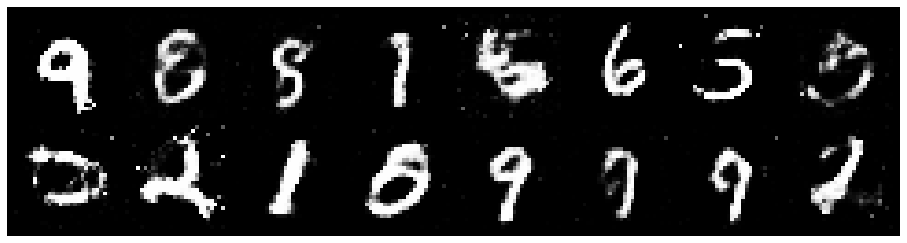

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2224, Generator Loss: 0.9099
D(x): 0.5371, D(G(z)): 0.4149


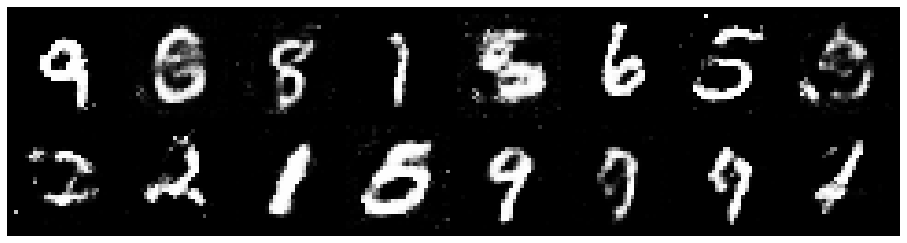

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.3145, Generator Loss: 0.8244
D(x): 0.5586, D(G(z)): 0.4778


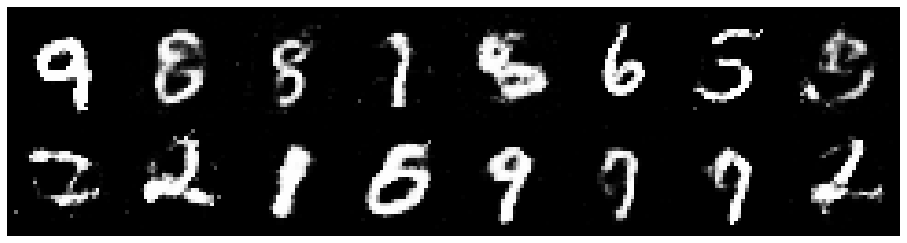

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2895, Generator Loss: 0.8448
D(x): 0.5635, D(G(z)): 0.4587


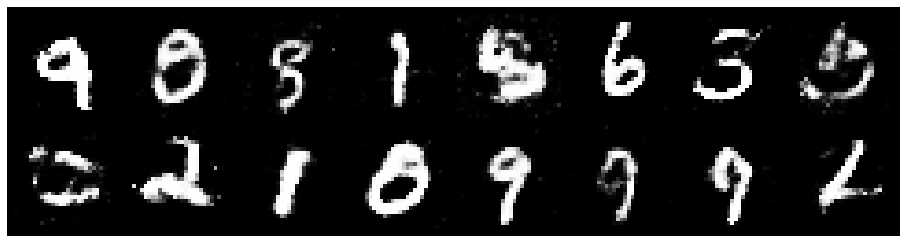

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2069, Generator Loss: 0.9318
D(x): 0.5438, D(G(z)): 0.3928


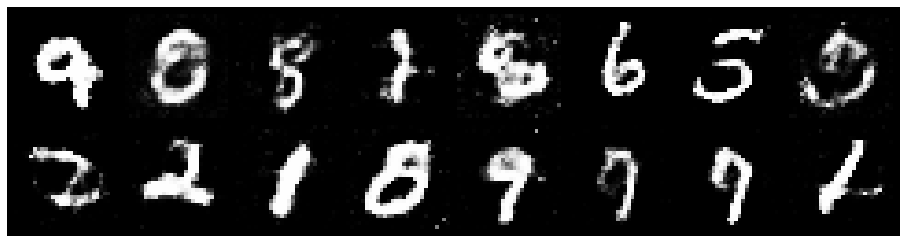

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2767, Generator Loss: 0.8597
D(x): 0.4981, D(G(z)): 0.4151


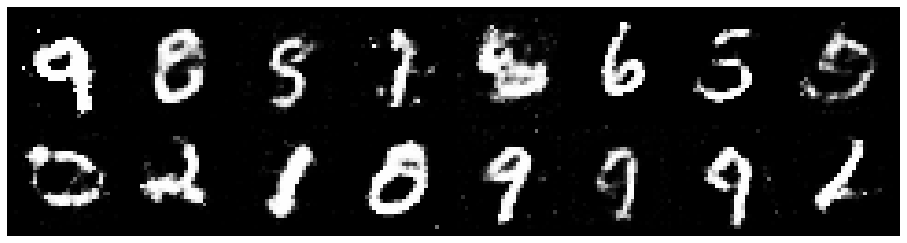

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.3022, Generator Loss: 0.8261
D(x): 0.5260, D(G(z)): 0.4460


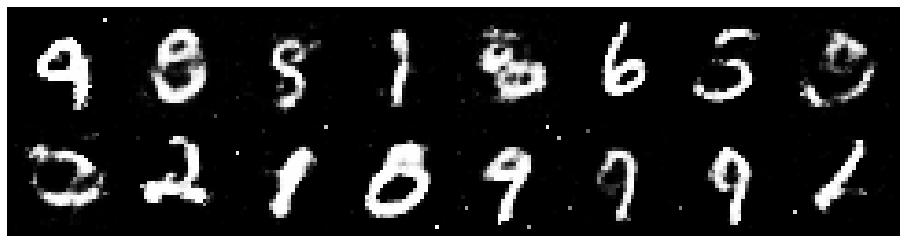

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.3094, Generator Loss: 0.8757
D(x): 0.5469, D(G(z)): 0.4594


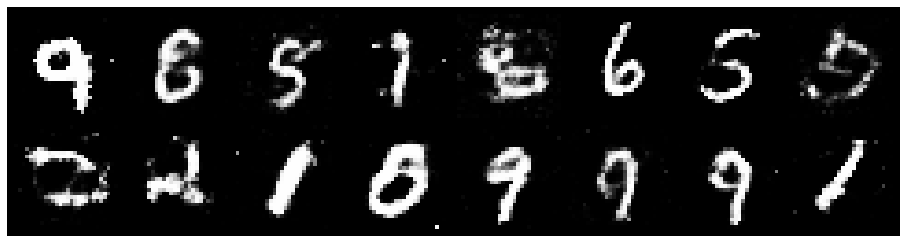

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2881, Generator Loss: 0.9421
D(x): 0.5884, D(G(z)): 0.4830


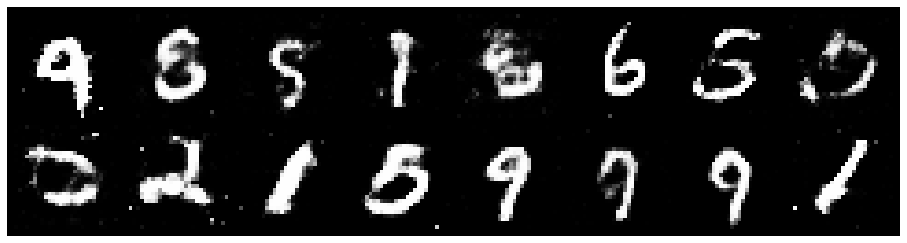

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2828, Generator Loss: 0.8406
D(x): 0.5339, D(G(z)): 0.4422


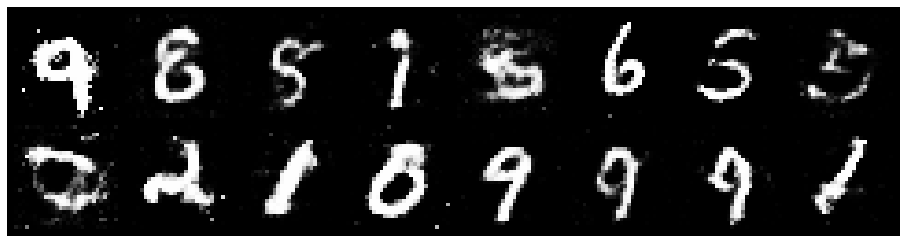

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.2710, Generator Loss: 0.8615
D(x): 0.5446, D(G(z)): 0.4352


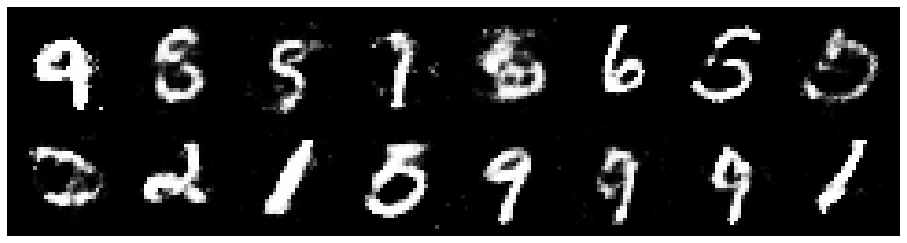

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.2612, Generator Loss: 0.8416
D(x): 0.5957, D(G(z)): 0.4794


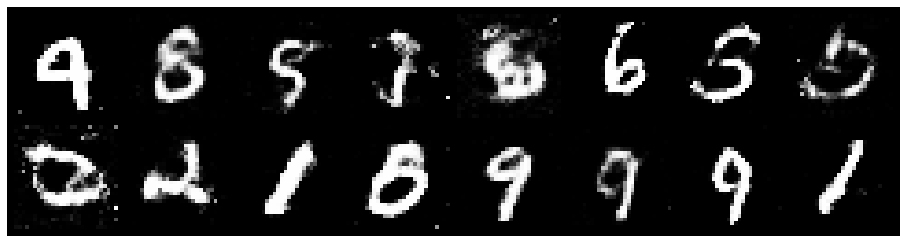

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2099, Generator Loss: 1.0331
D(x): 0.5364, D(G(z)): 0.3907


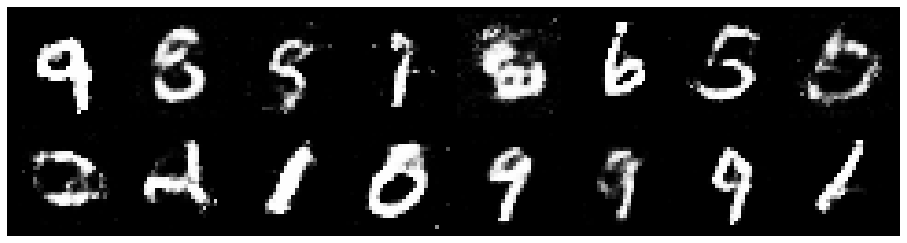

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.3158, Generator Loss: 0.8914
D(x): 0.5405, D(G(z)): 0.4688


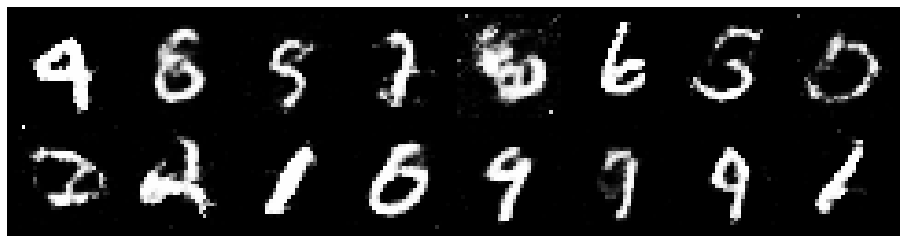

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.3844, Generator Loss: 0.8254
D(x): 0.5303, D(G(z)): 0.4711


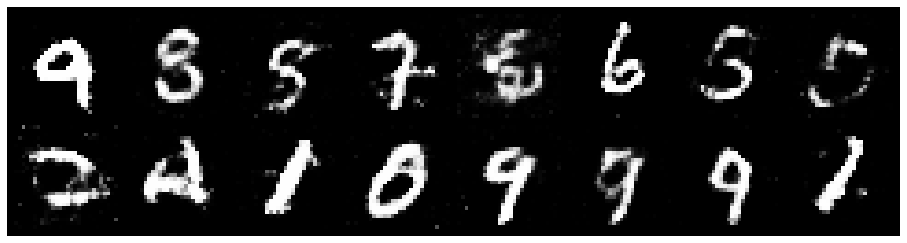

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.3534, Generator Loss: 0.8300
D(x): 0.5670, D(G(z)): 0.4906


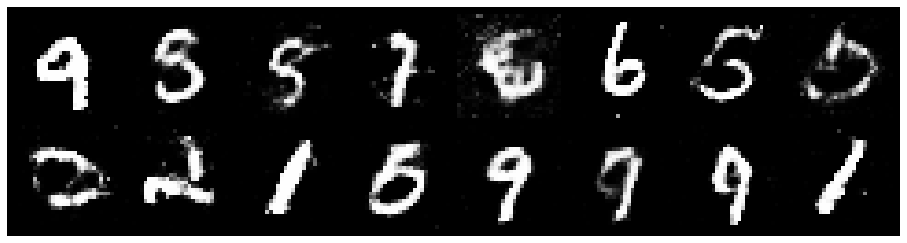

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.2081, Generator Loss: 0.8796
D(x): 0.5890, D(G(z)): 0.4416


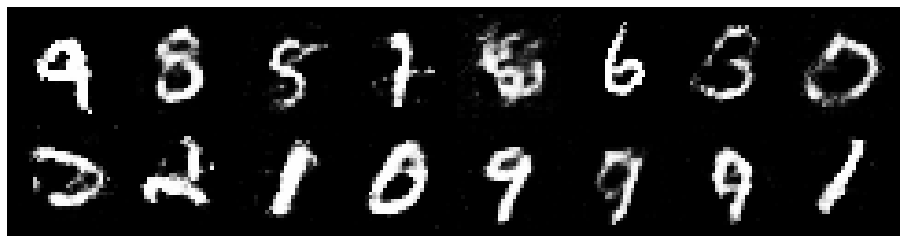

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.2629, Generator Loss: 0.7533
D(x): 0.5514, D(G(z)): 0.4691


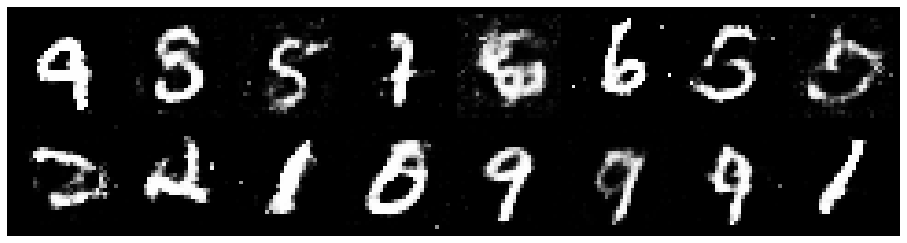

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.3573, Generator Loss: 0.9535
D(x): 0.5237, D(G(z)): 0.4206


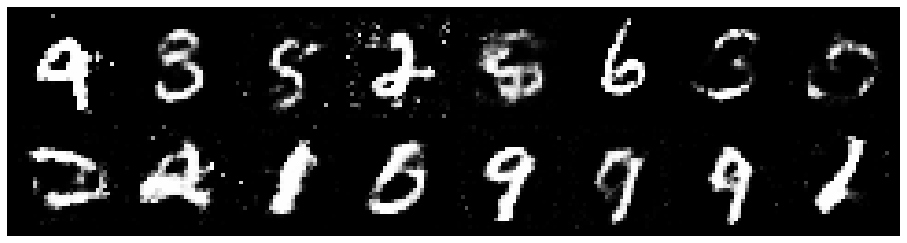

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2319, Generator Loss: 0.9134
D(x): 0.5581, D(G(z)): 0.4381


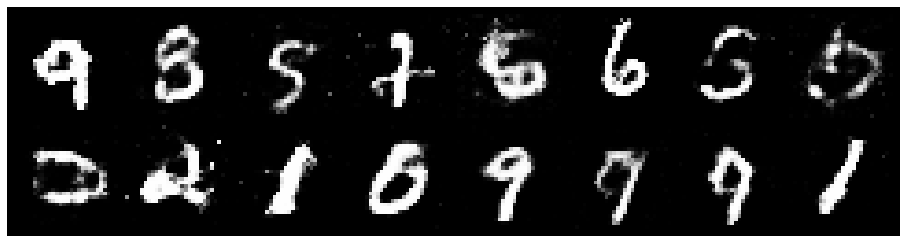

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2577, Generator Loss: 0.8800
D(x): 0.5840, D(G(z)): 0.4690


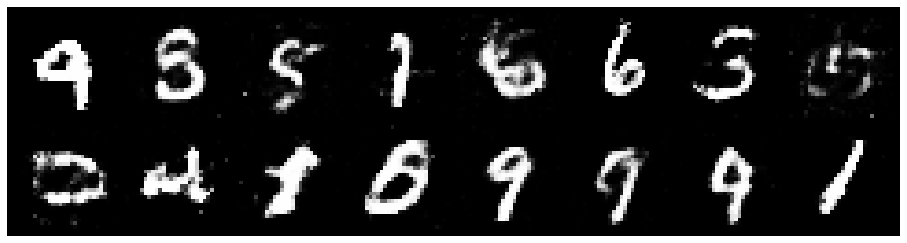

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.3436, Generator Loss: 0.9303
D(x): 0.5883, D(G(z)): 0.5013


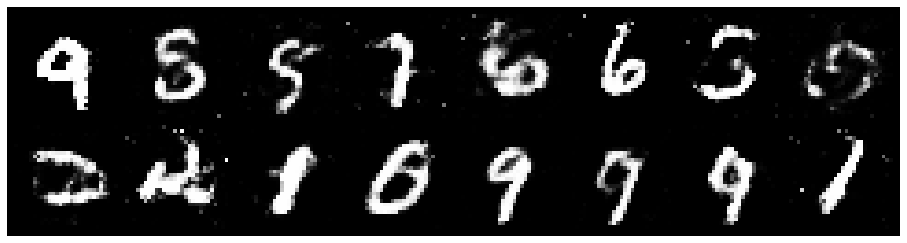

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.3138, Generator Loss: 0.8236
D(x): 0.5661, D(G(z)): 0.4812


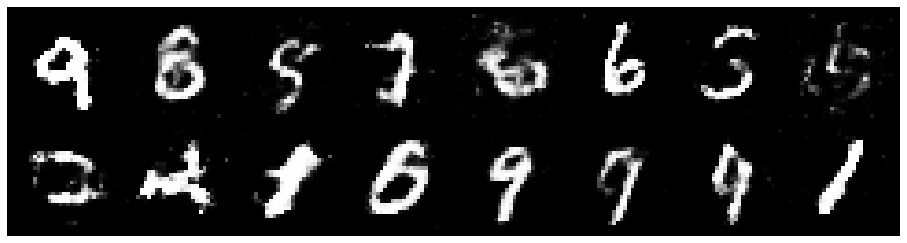

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.2999, Generator Loss: 0.8006
D(x): 0.5578, D(G(z)): 0.4678


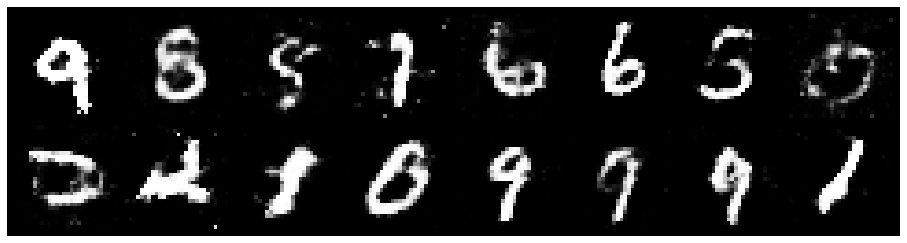

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.2484, Generator Loss: 0.8369
D(x): 0.5928, D(G(z)): 0.4684


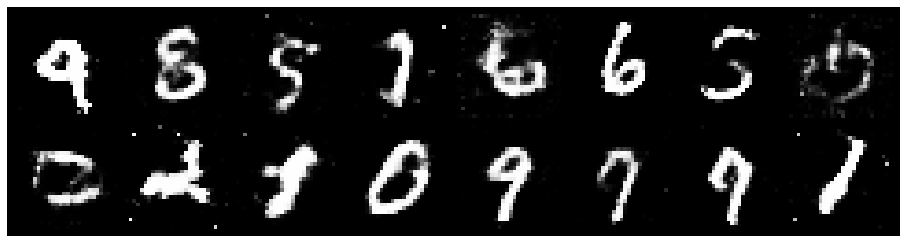

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.3668, Generator Loss: 0.8888
D(x): 0.5061, D(G(z)): 0.4249


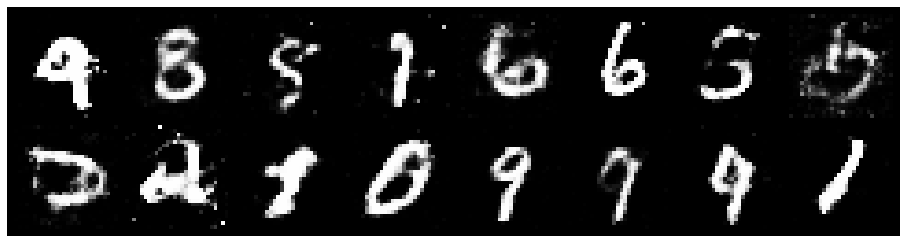

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.3457, Generator Loss: 0.9645
D(x): 0.5249, D(G(z)): 0.4417


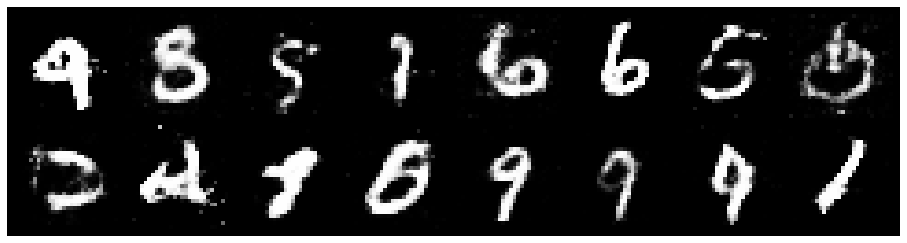

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.2546, Generator Loss: 0.8510
D(x): 0.5236, D(G(z)): 0.4292


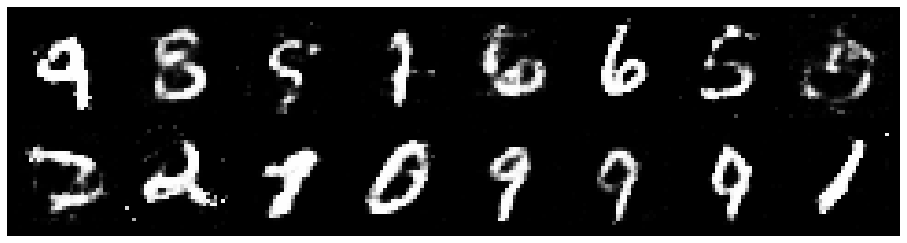

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2951, Generator Loss: 0.9325
D(x): 0.5296, D(G(z)): 0.4413


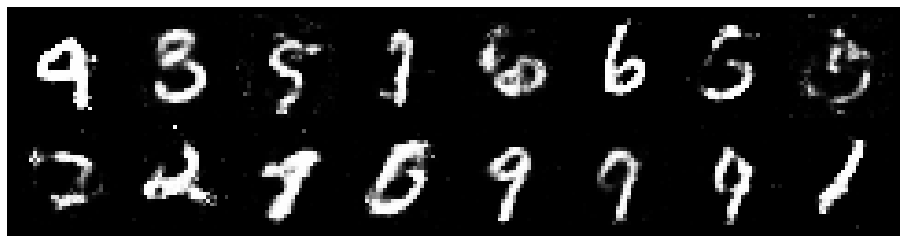

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.3391, Generator Loss: 0.8665
D(x): 0.5155, D(G(z)): 0.4453


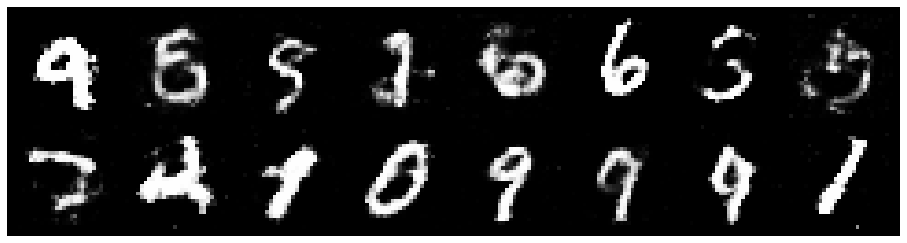

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.2567, Generator Loss: 0.8596
D(x): 0.5603, D(G(z)): 0.4635


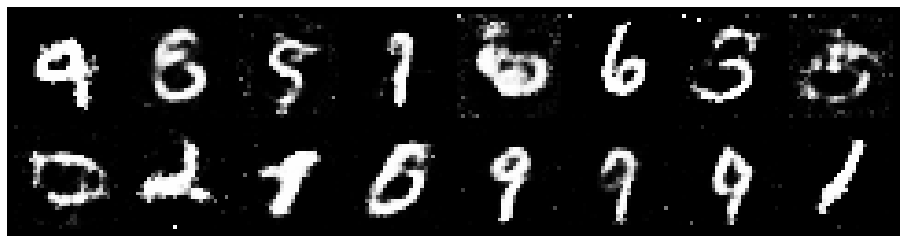

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2639, Generator Loss: 0.9753
D(x): 0.5148, D(G(z)): 0.4080


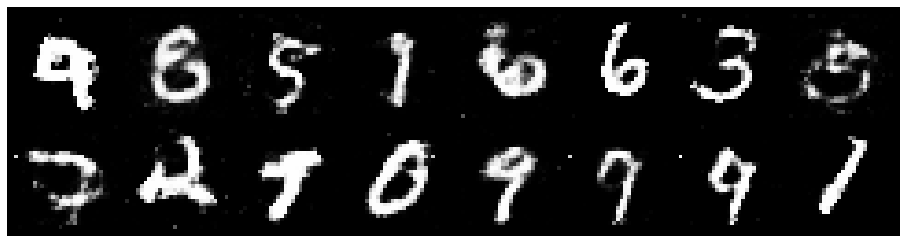

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.2346, Generator Loss: 0.8939
D(x): 0.5929, D(G(z)): 0.4497


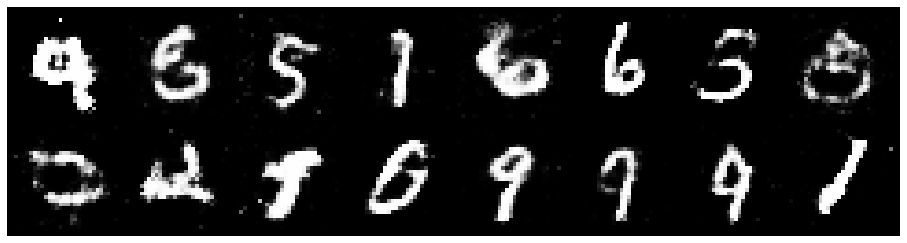

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.2390, Generator Loss: 0.9387
D(x): 0.5392, D(G(z)): 0.4241


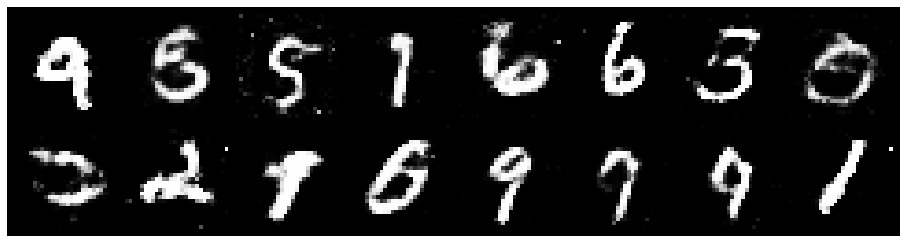

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.3727, Generator Loss: 0.9785
D(x): 0.5449, D(G(z)): 0.4638


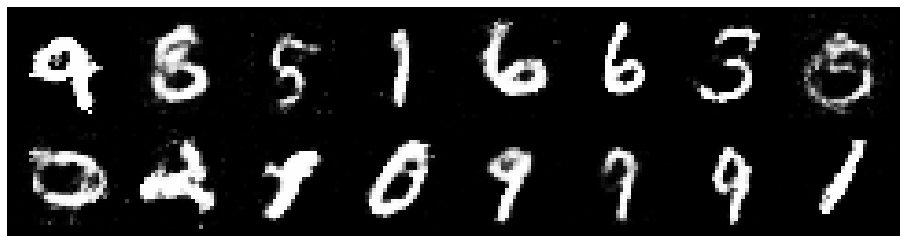

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.3233, Generator Loss: 0.7631
D(x): 0.5500, D(G(z)): 0.4826


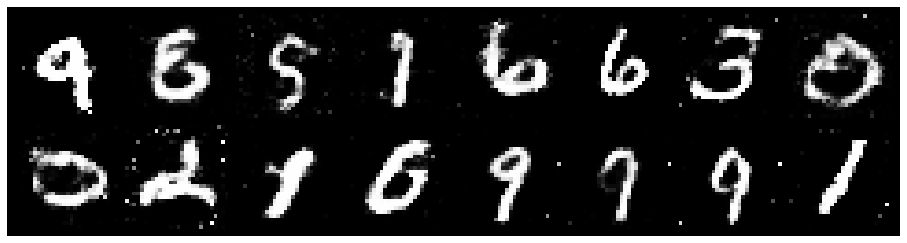

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.4220, Generator Loss: 0.7418
D(x): 0.5146, D(G(z)): 0.5010


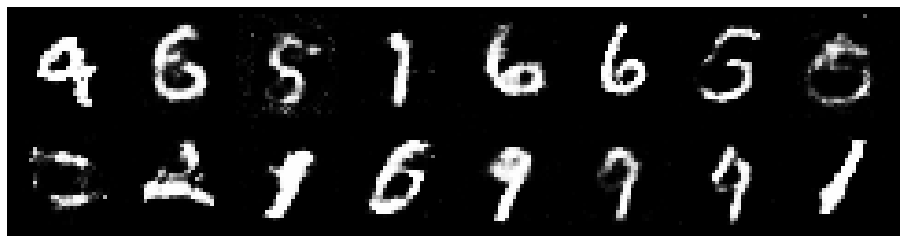

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.2417, Generator Loss: 0.7845
D(x): 0.5850, D(G(z)): 0.4714


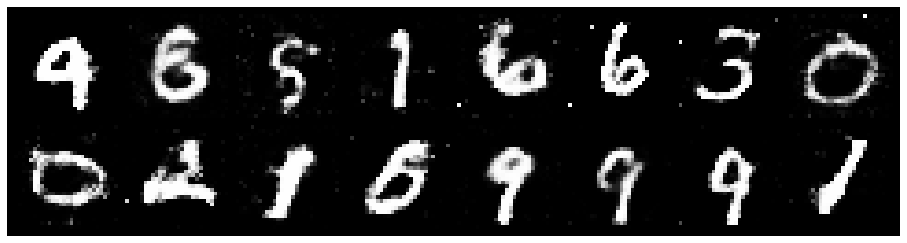

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.2509, Generator Loss: 0.9049
D(x): 0.5483, D(G(z)): 0.4349


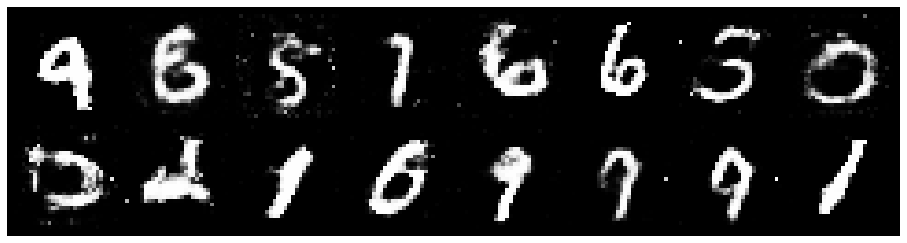

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.3109, Generator Loss: 0.8443
D(x): 0.5265, D(G(z)): 0.4515


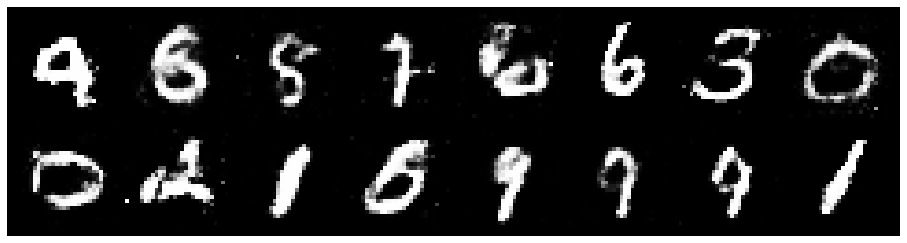

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.2809, Generator Loss: 0.9113
D(x): 0.5376, D(G(z)): 0.4405


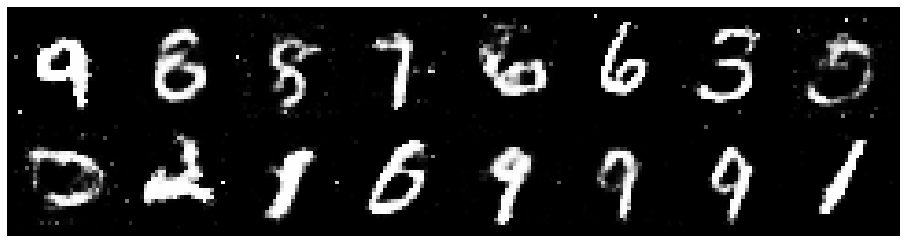

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.4221, Generator Loss: 0.7947
D(x): 0.5264, D(G(z)): 0.4776


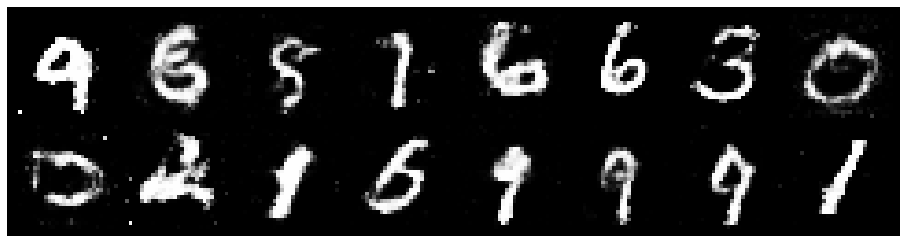

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.2423, Generator Loss: 0.8265
D(x): 0.5736, D(G(z)): 0.4560


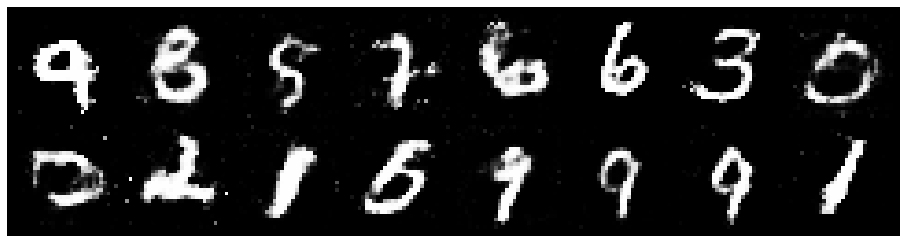

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2880, Generator Loss: 1.0194
D(x): 0.5278, D(G(z)): 0.4190


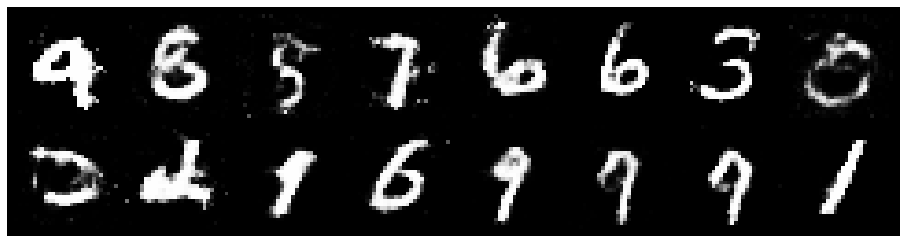

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.2835, Generator Loss: 0.8877
D(x): 0.5987, D(G(z)): 0.4612


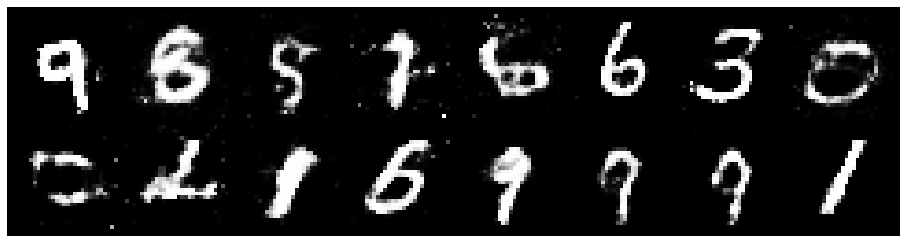

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.2095, Generator Loss: 1.3414
D(x): 0.5524, D(G(z)): 0.3796


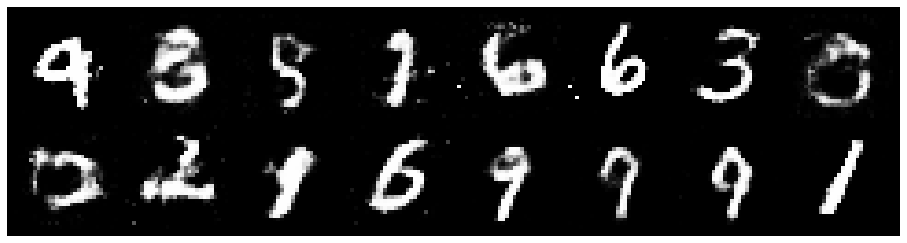

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.3218, Generator Loss: 0.9015
D(x): 0.5822, D(G(z)): 0.4704


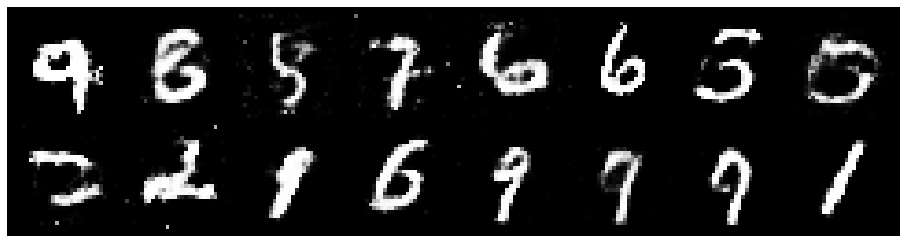

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.2216, Generator Loss: 0.9987
D(x): 0.5626, D(G(z)): 0.4196


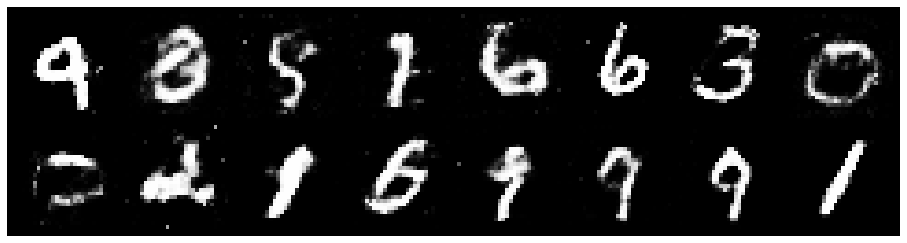

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.3141, Generator Loss: 0.9224
D(x): 0.5582, D(G(z)): 0.4445


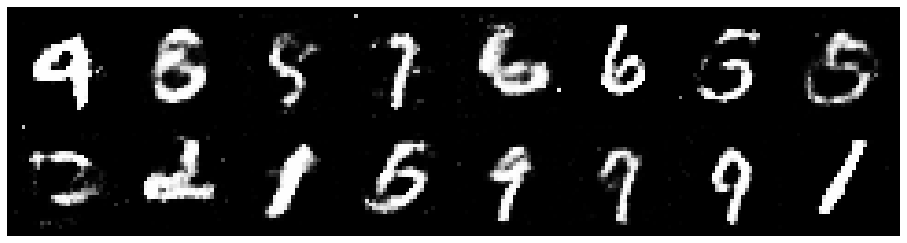

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2313, Generator Loss: 1.0295
D(x): 0.5407, D(G(z)): 0.4085


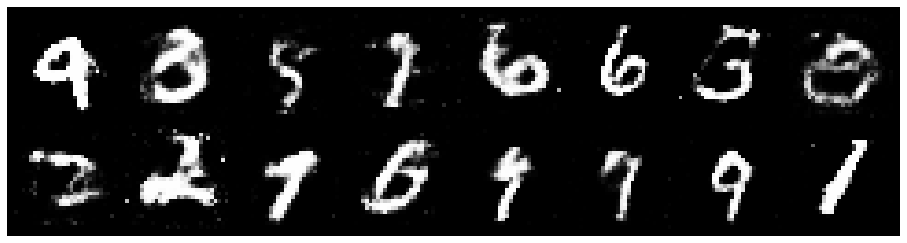

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2637, Generator Loss: 0.8780
D(x): 0.5310, D(G(z)): 0.4296


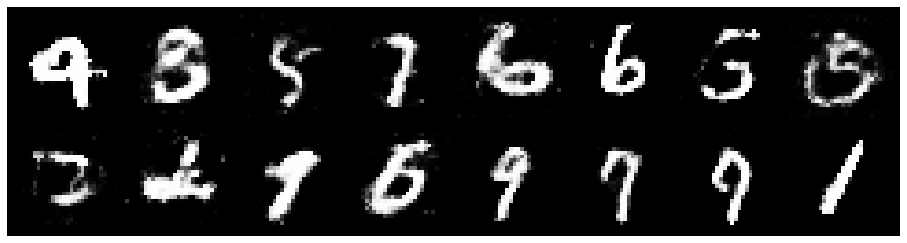

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2657, Generator Loss: 0.9234
D(x): 0.5348, D(G(z)): 0.4510


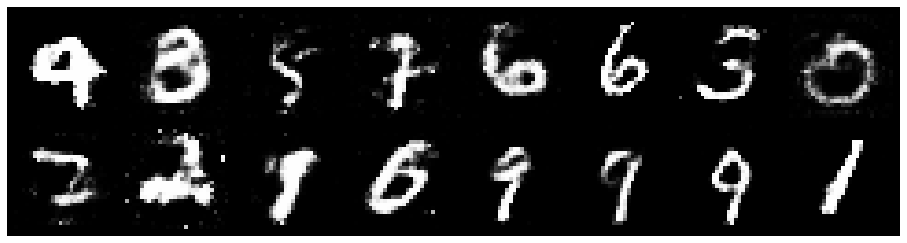

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.1994, Generator Loss: 0.9439
D(x): 0.5573, D(G(z)): 0.4187


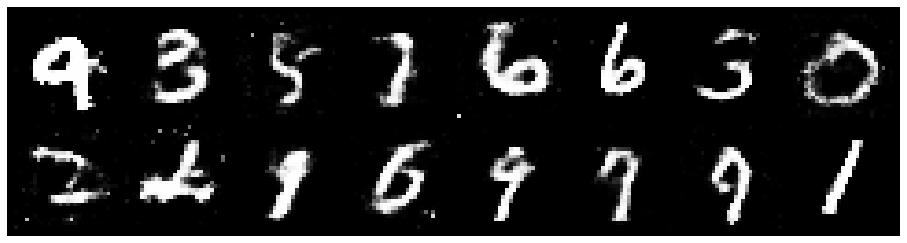

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.3780, Generator Loss: 0.9761
D(x): 0.5038, D(G(z)): 0.4322


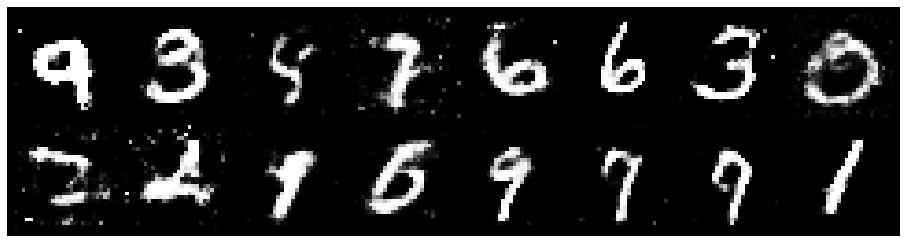

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.2469, Generator Loss: 1.0001
D(x): 0.6071, D(G(z)): 0.4472


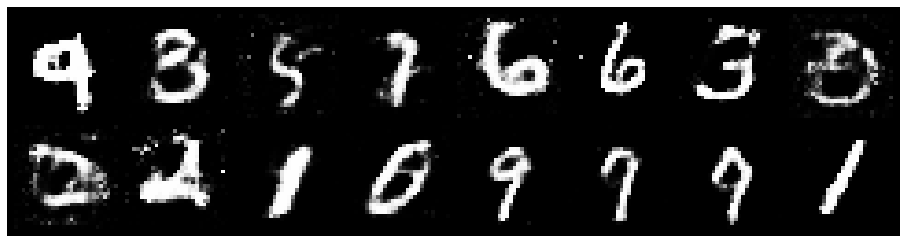

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.1679, Generator Loss: 0.8856
D(x): 0.5681, D(G(z)): 0.3989


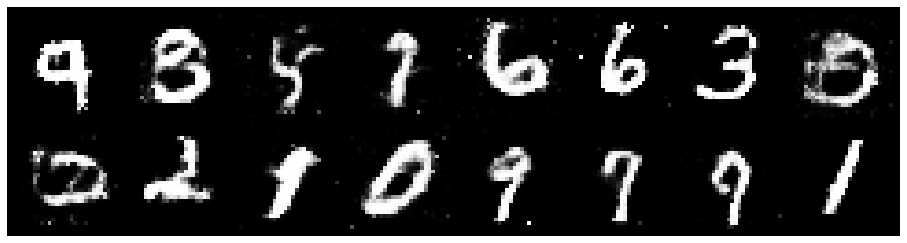

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.3068, Generator Loss: 0.8301
D(x): 0.5872, D(G(z)): 0.4833


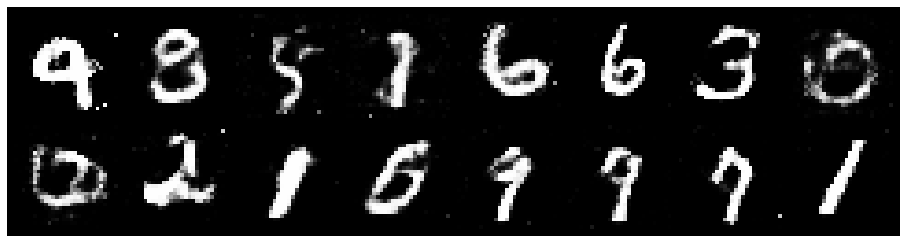

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.3565, Generator Loss: 0.9032
D(x): 0.5646, D(G(z)): 0.4931


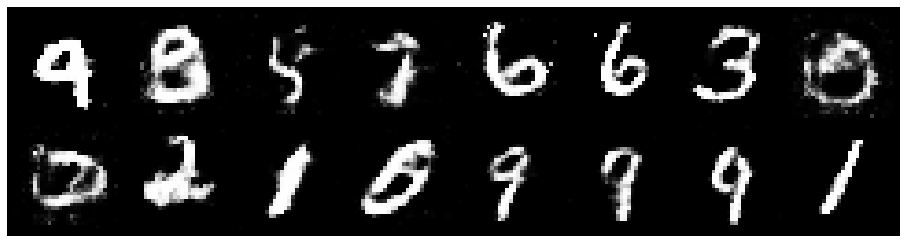

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.3414, Generator Loss: 0.8301
D(x): 0.5371, D(G(z)): 0.4597


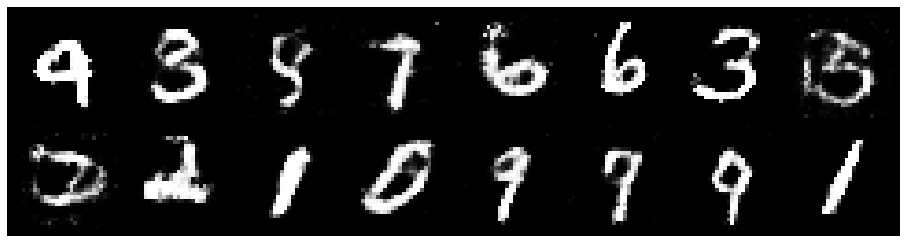

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.2827, Generator Loss: 0.8715
D(x): 0.5489, D(G(z)): 0.4555


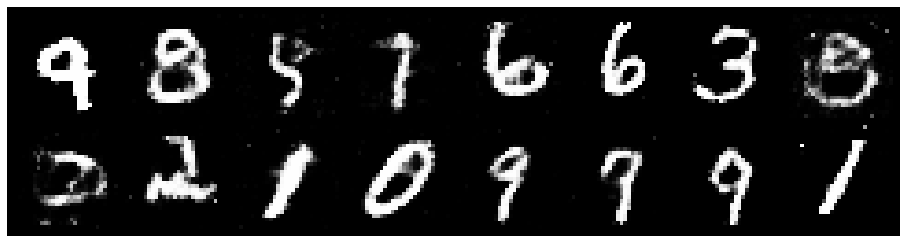

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3408, Generator Loss: 0.8813
D(x): 0.5585, D(G(z)): 0.4596


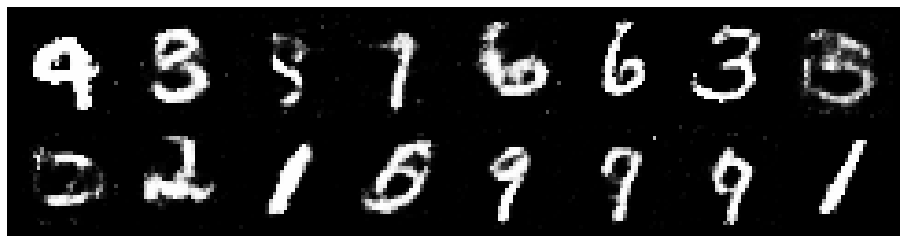

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.2687, Generator Loss: 0.8829
D(x): 0.5400, D(G(z)): 0.4312


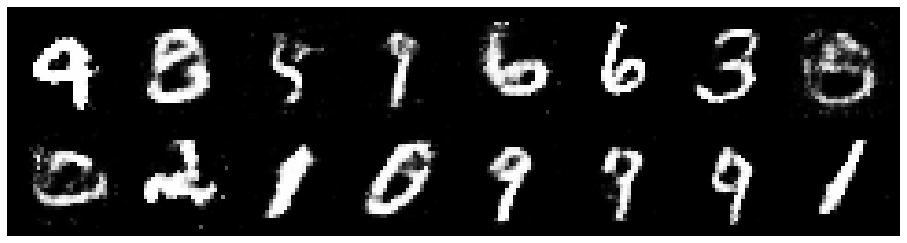

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3318, Generator Loss: 0.7639
D(x): 0.5615, D(G(z)): 0.4877


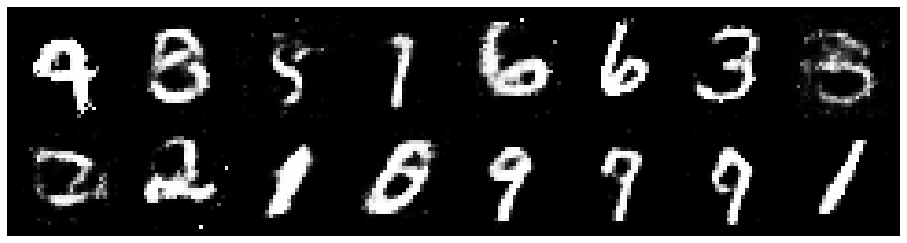

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2491, Generator Loss: 0.8899
D(x): 0.5752, D(G(z)): 0.4481


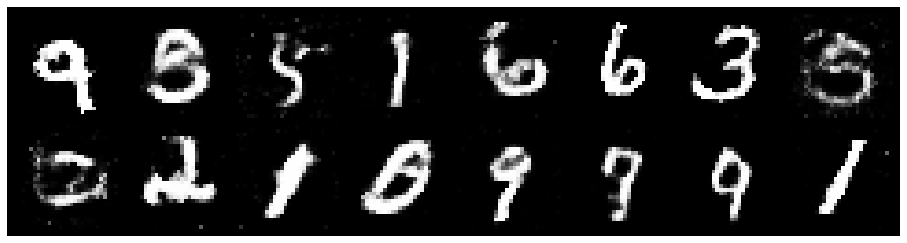

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.2214, Generator Loss: 0.9458
D(x): 0.5978, D(G(z)): 0.4387


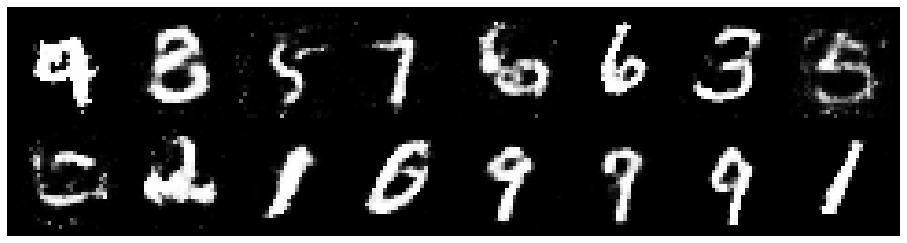

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.2341, Generator Loss: 0.8819
D(x): 0.5519, D(G(z)): 0.4398


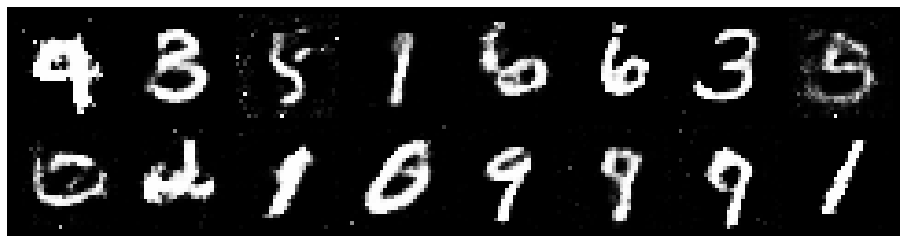

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.2931, Generator Loss: 0.9418
D(x): 0.5374, D(G(z)): 0.4425


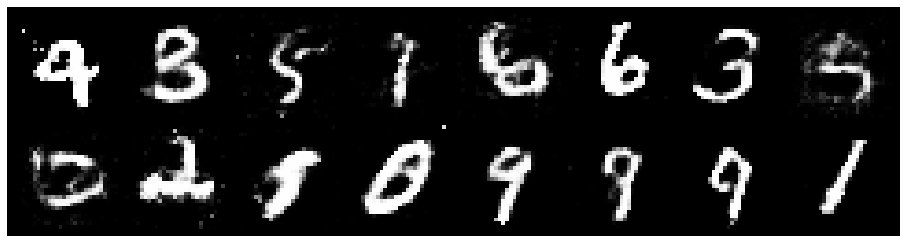

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2357, Generator Loss: 0.8381
D(x): 0.5303, D(G(z)): 0.4084


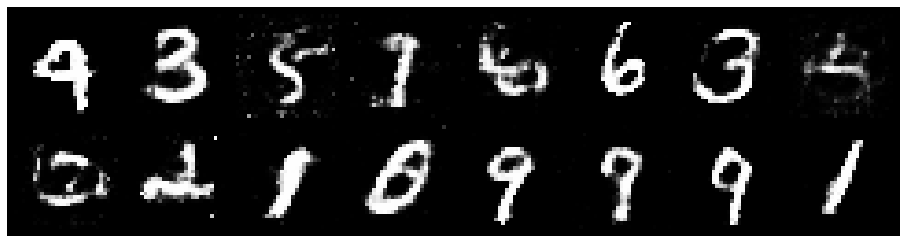

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2961, Generator Loss: 0.8290
D(x): 0.5217, D(G(z)): 0.4377


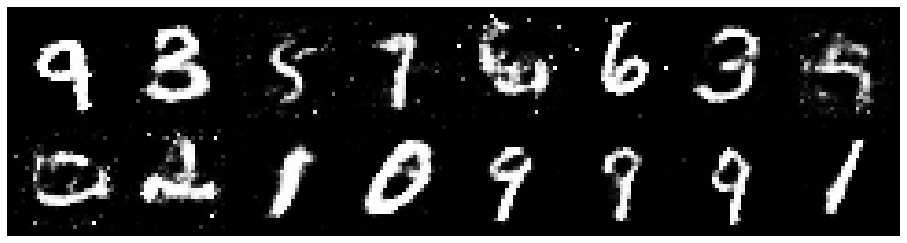

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.2934, Generator Loss: 0.8186
D(x): 0.5554, D(G(z)): 0.4690


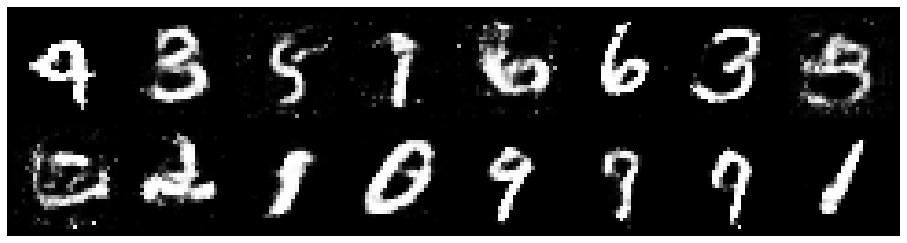

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.2731, Generator Loss: 0.8953
D(x): 0.5365, D(G(z)): 0.4304


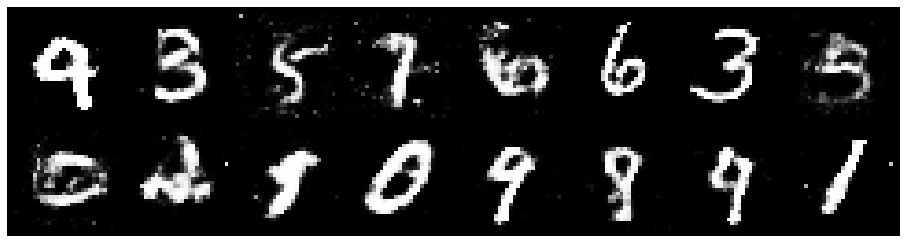

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.2306, Generator Loss: 0.9814
D(x): 0.5404, D(G(z)): 0.4146


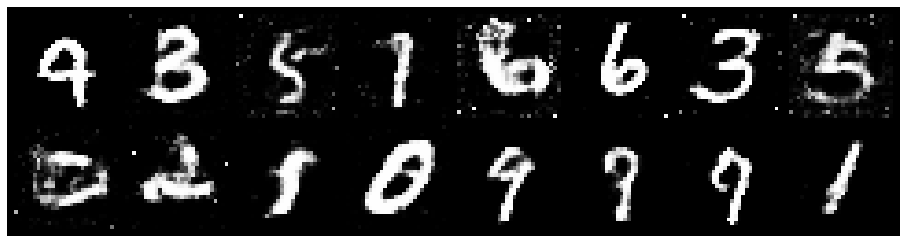

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.2599, Generator Loss: 0.8158
D(x): 0.5694, D(G(z)): 0.4657


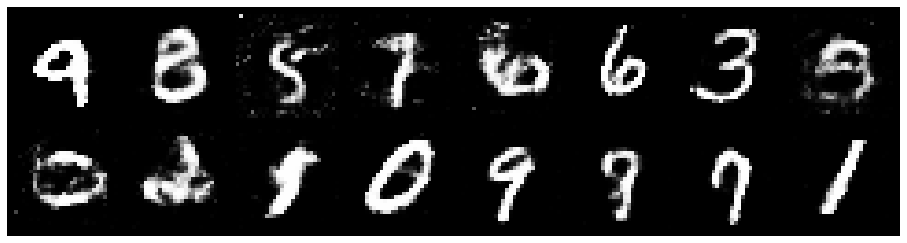

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3200, Generator Loss: 0.9106
D(x): 0.5727, D(G(z)): 0.4689


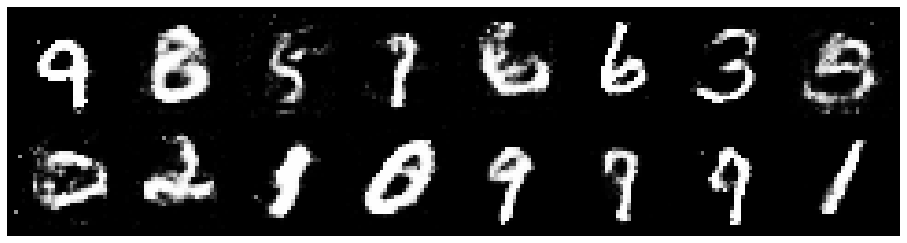

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.2957, Generator Loss: 0.9524
D(x): 0.5425, D(G(z)): 0.4519


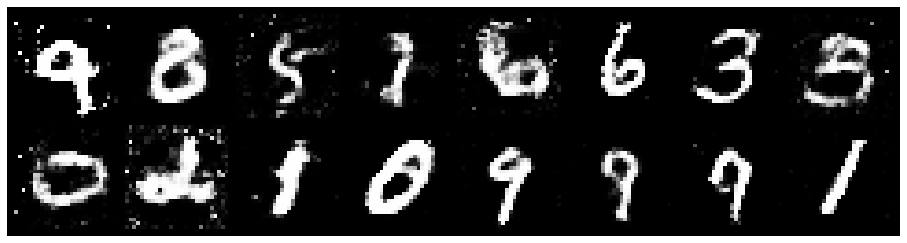

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.2289, Generator Loss: 0.8264
D(x): 0.5871, D(G(z)): 0.4586


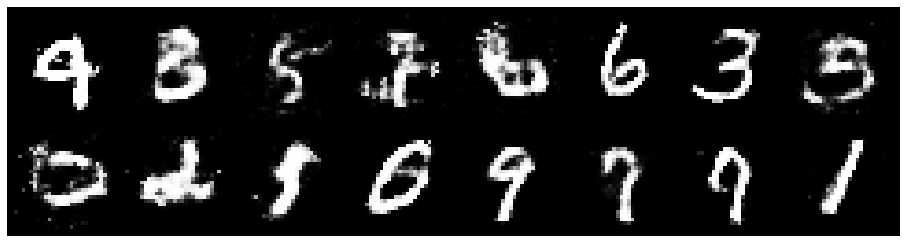

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.2988, Generator Loss: 0.9841
D(x): 0.5707, D(G(z)): 0.4396


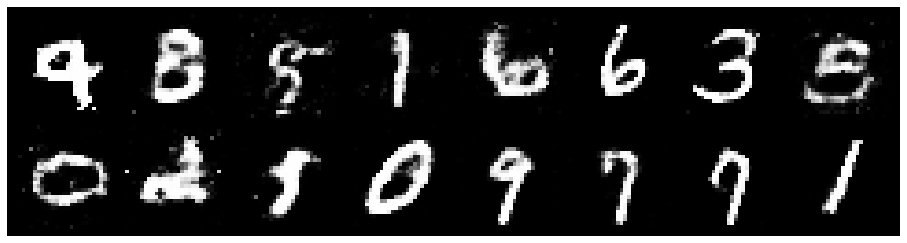

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.1922, Generator Loss: 0.9478
D(x): 0.5785, D(G(z)): 0.4289


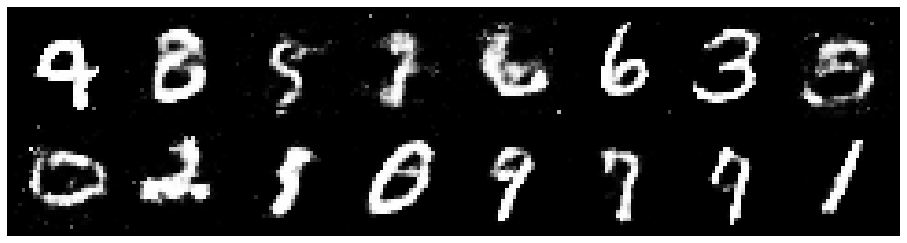

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.1245, Generator Loss: 1.0378
D(x): 0.5968, D(G(z)): 0.3994


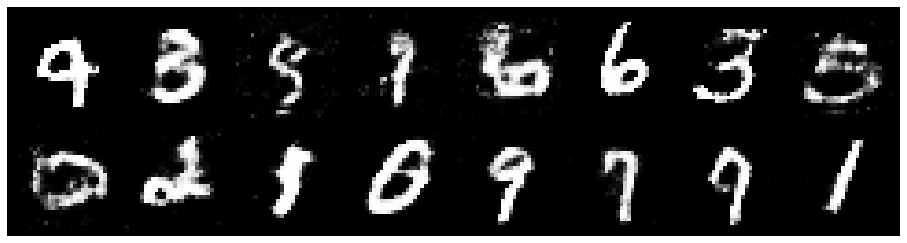

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2260, Generator Loss: 0.8180
D(x): 0.5618, D(G(z)): 0.4391


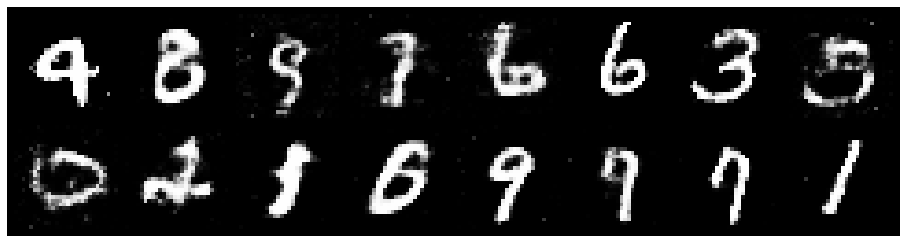

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.3189, Generator Loss: 0.8290
D(x): 0.5450, D(G(z)): 0.4560


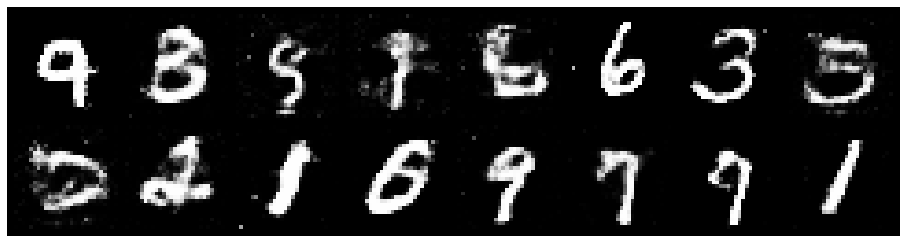

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.2530, Generator Loss: 0.9521
D(x): 0.5916, D(G(z)): 0.4474


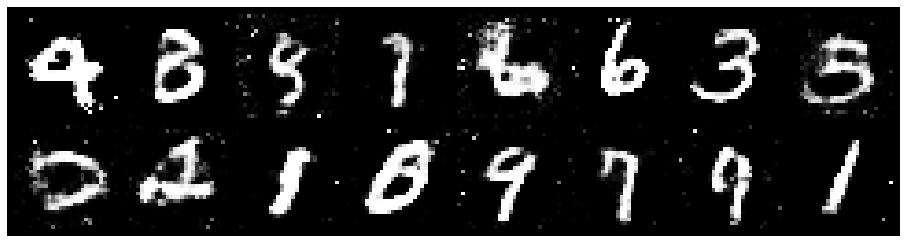

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2241, Generator Loss: 0.9059
D(x): 0.5731, D(G(z)): 0.4519


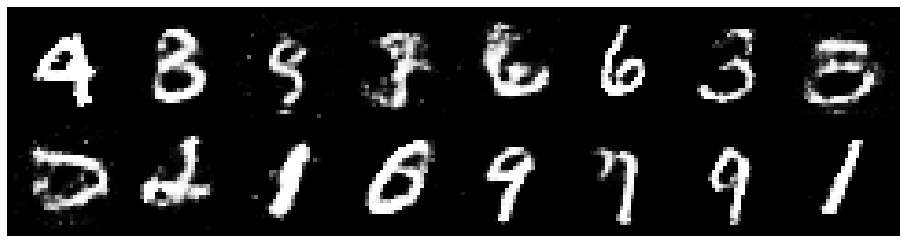

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2470, Generator Loss: 0.9695
D(x): 0.5551, D(G(z)): 0.4354


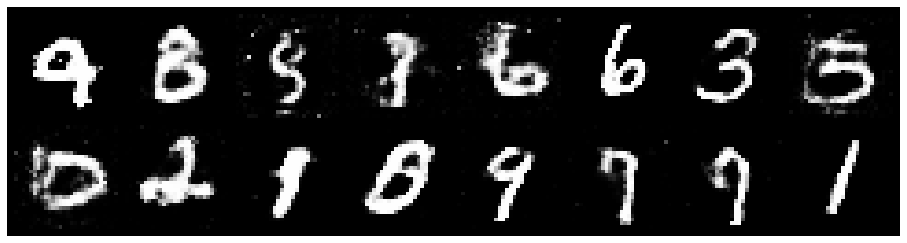

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2375, Generator Loss: 1.0489
D(x): 0.5722, D(G(z)): 0.4155


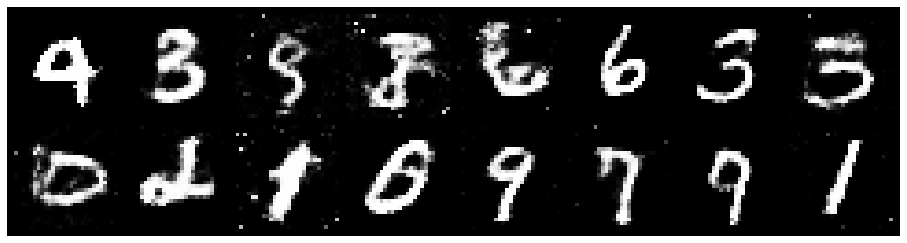

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.2872, Generator Loss: 1.0011
D(x): 0.5434, D(G(z)): 0.4191


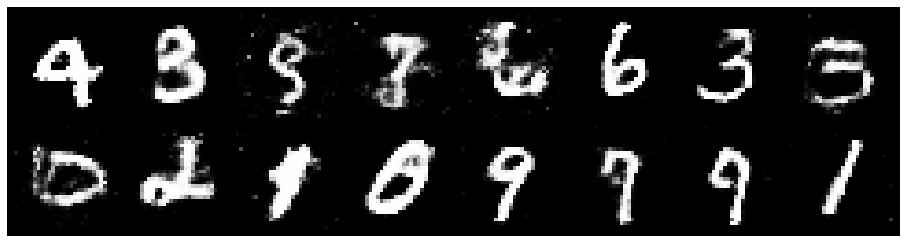

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.1540, Generator Loss: 0.9844
D(x): 0.5714, D(G(z)): 0.4067


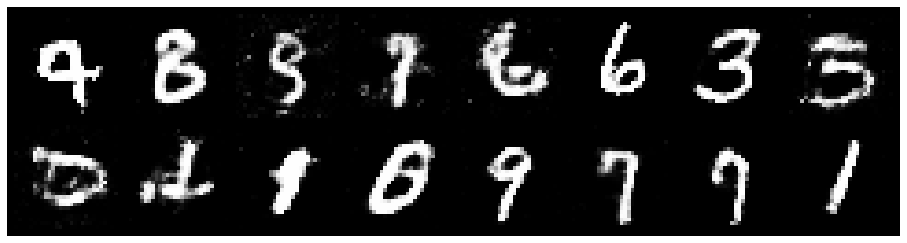

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2500, Generator Loss: 0.8487
D(x): 0.5525, D(G(z)): 0.4380


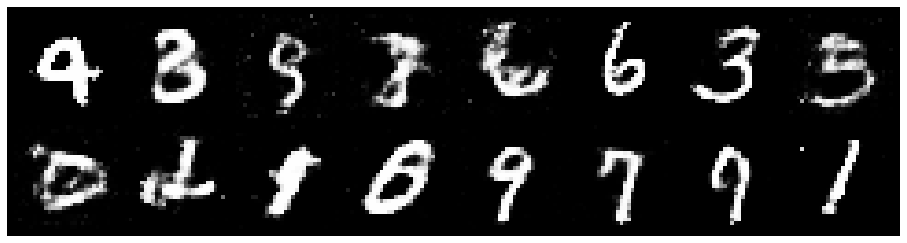

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.4264, Generator Loss: 0.8733
D(x): 0.5813, D(G(z)): 0.5244


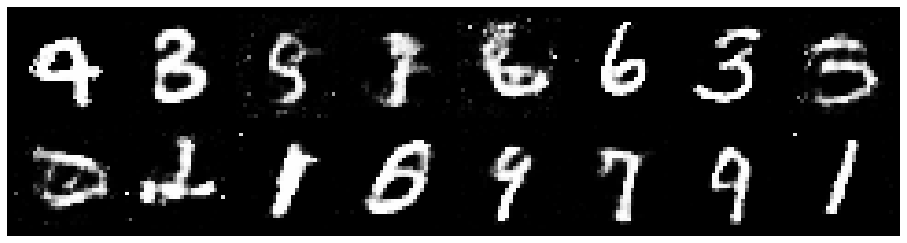

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.2864, Generator Loss: 0.9075
D(x): 0.5792, D(G(z)): 0.4502


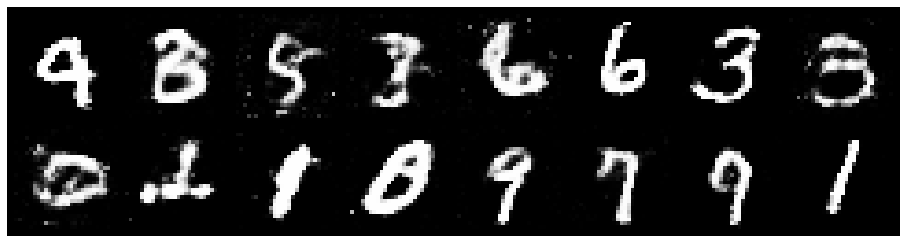

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.1735, Generator Loss: 0.9302
D(x): 0.5690, D(G(z)): 0.3980


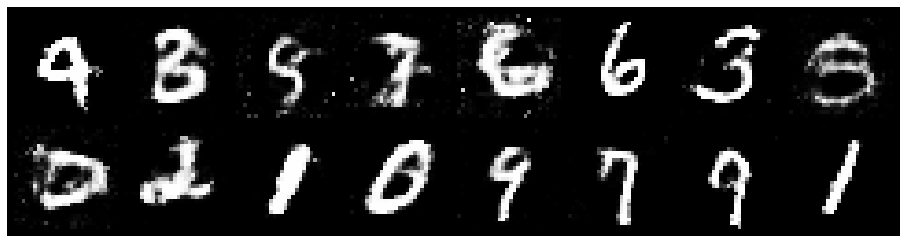

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2573, Generator Loss: 0.8131
D(x): 0.5961, D(G(z)): 0.4726


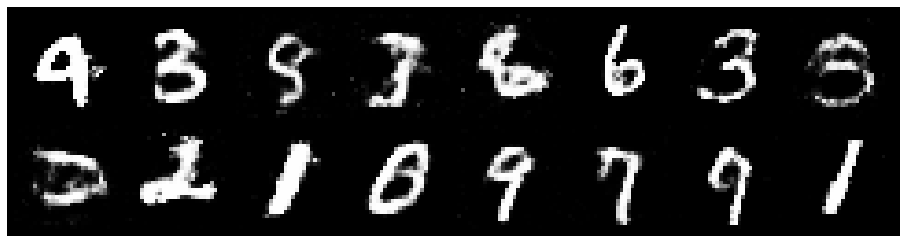

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2221, Generator Loss: 0.7763
D(x): 0.5664, D(G(z)): 0.4475


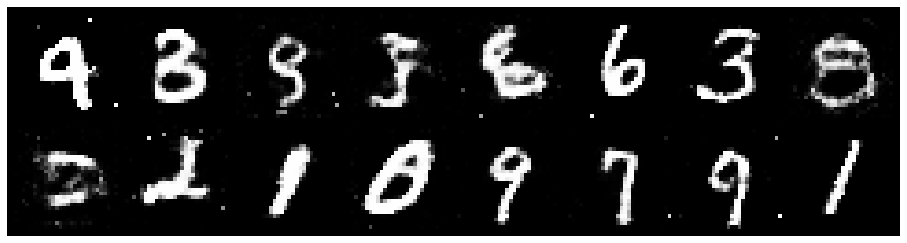

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.2155, Generator Loss: 0.8967
D(x): 0.5229, D(G(z)): 0.3842


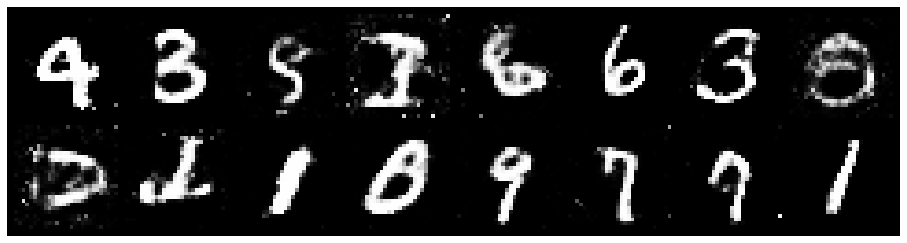

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2344, Generator Loss: 0.8067
D(x): 0.5605, D(G(z)): 0.4168


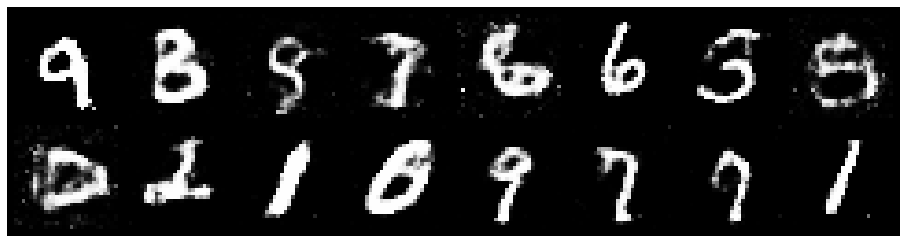

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.1771, Generator Loss: 0.9679
D(x): 0.5833, D(G(z)): 0.4255


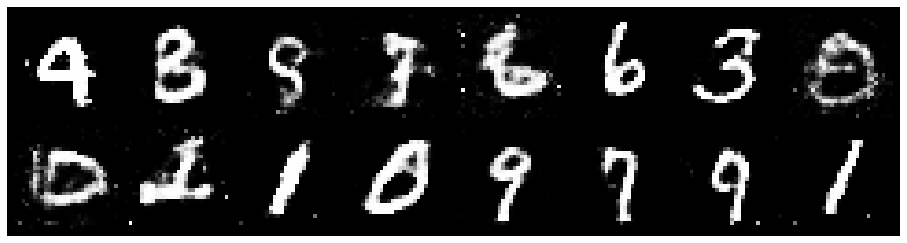

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.1875, Generator Loss: 0.8326
D(x): 0.5740, D(G(z)): 0.4317


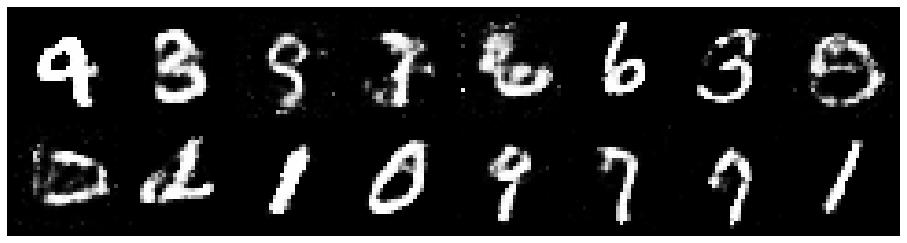

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2741, Generator Loss: 0.8962
D(x): 0.5521, D(G(z)): 0.4370


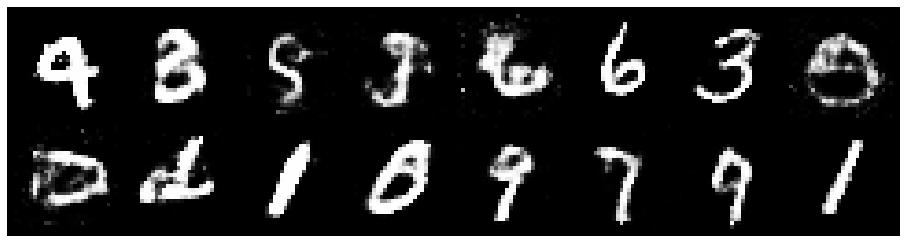

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.3506, Generator Loss: 0.7944
D(x): 0.5573, D(G(z)): 0.4988


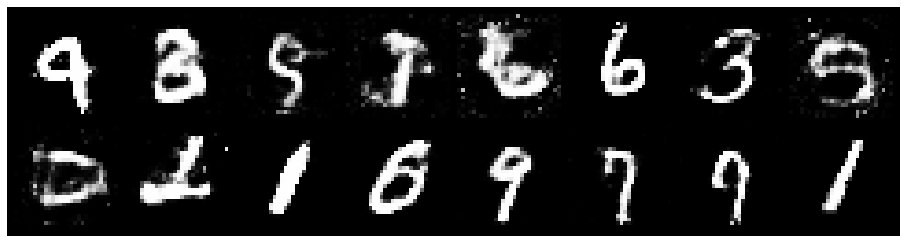

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.2910, Generator Loss: 0.8757
D(x): 0.5590, D(G(z)): 0.4608


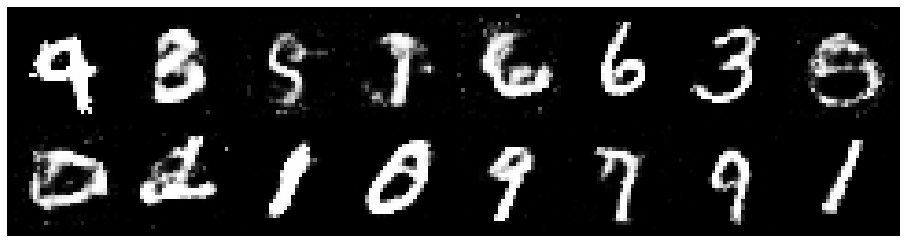

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.2569, Generator Loss: 0.9192
D(x): 0.5699, D(G(z)): 0.4359


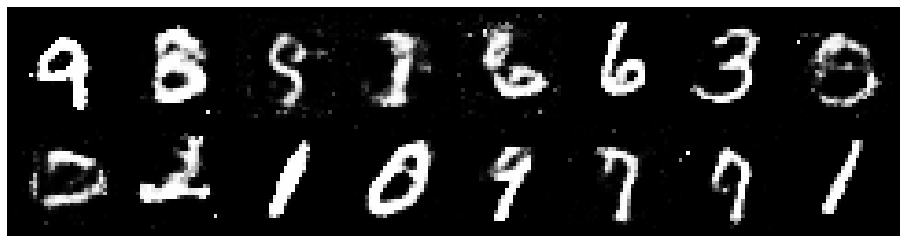

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.2011, Generator Loss: 0.9219
D(x): 0.5677, D(G(z)): 0.4360


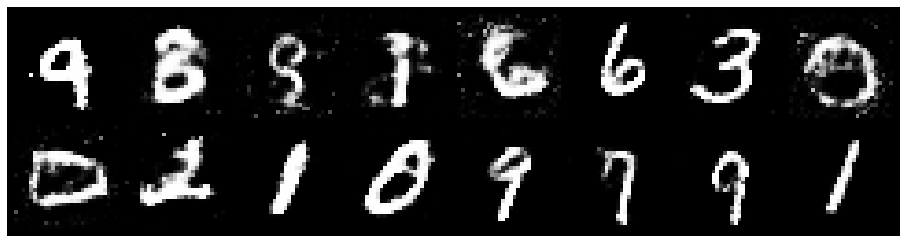

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.2668, Generator Loss: 0.8014
D(x): 0.5552, D(G(z)): 0.4646


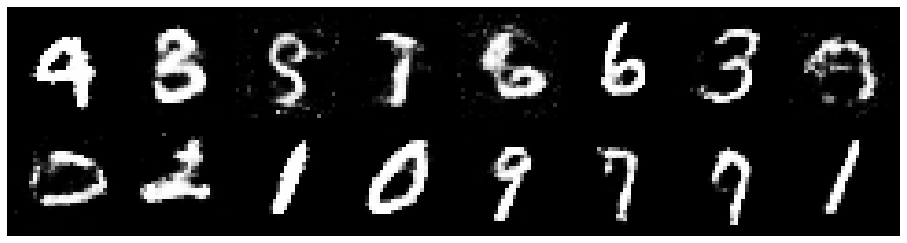

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.3003, Generator Loss: 0.8422
D(x): 0.5466, D(G(z)): 0.4556


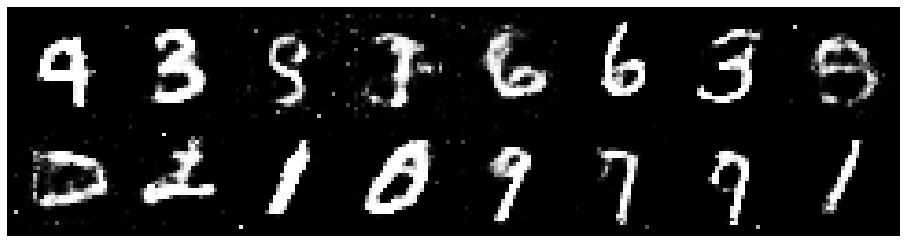

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8373
D(x): 0.5711, D(G(z)): 0.4670


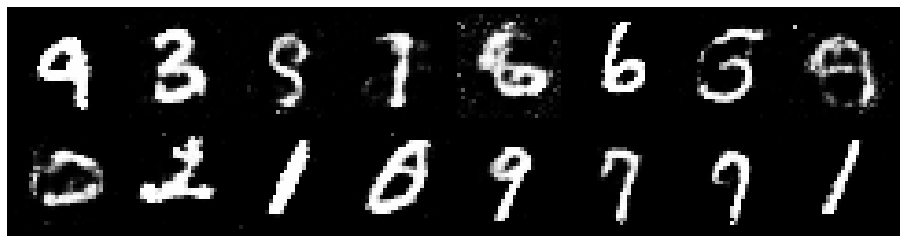

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.3282, Generator Loss: 0.8735
D(x): 0.5424, D(G(z)): 0.4490


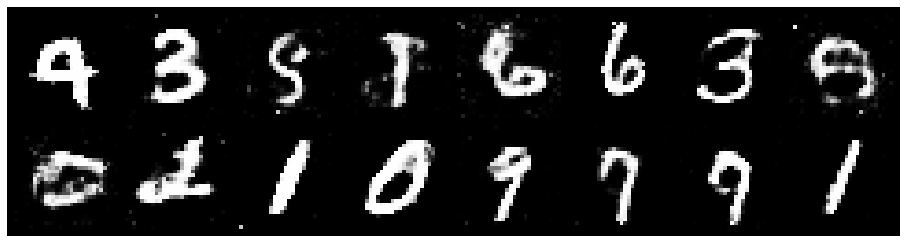

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2123, Generator Loss: 0.8581
D(x): 0.5738, D(G(z)): 0.4369


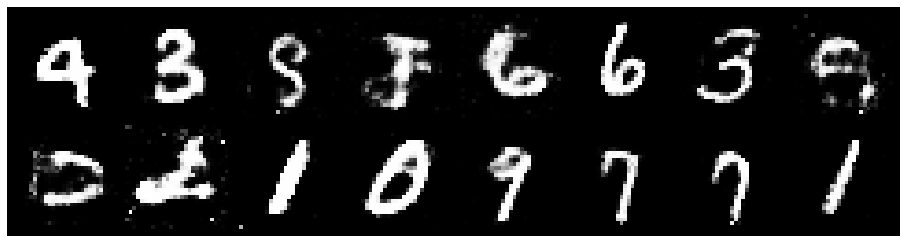

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.1942, Generator Loss: 0.7743
D(x): 0.5749, D(G(z)): 0.4391


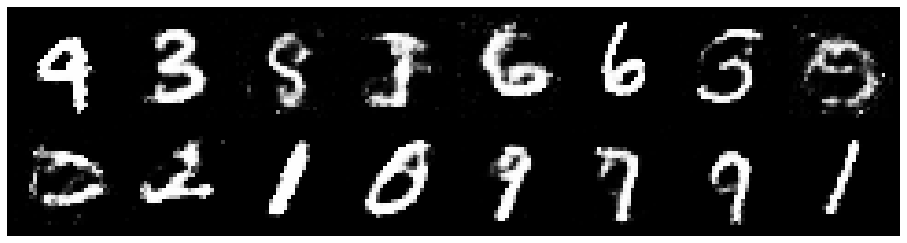

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2830, Generator Loss: 0.7313
D(x): 0.5592, D(G(z)): 0.4752


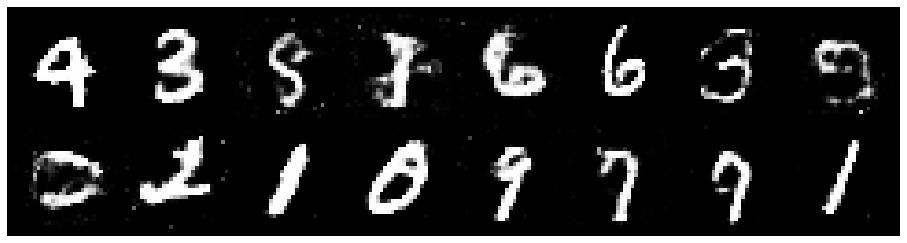

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.3608, Generator Loss: 0.9640
D(x): 0.5811, D(G(z)): 0.4701


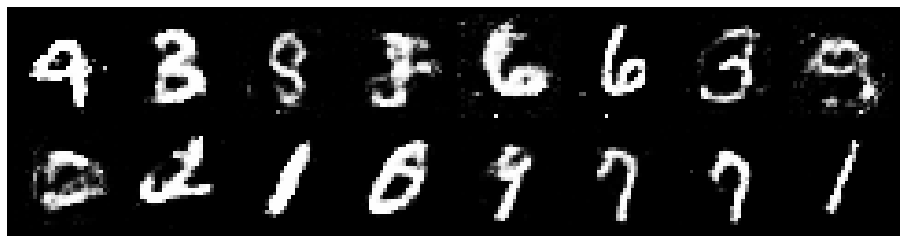

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.2273, Generator Loss: 0.8987
D(x): 0.5512, D(G(z)): 0.4406


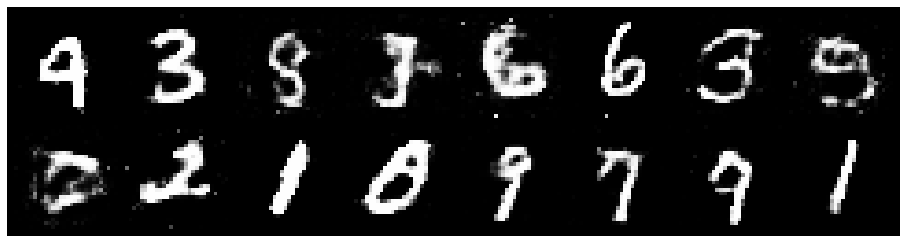

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.3989, Generator Loss: 0.8716
D(x): 0.5369, D(G(z)): 0.4890


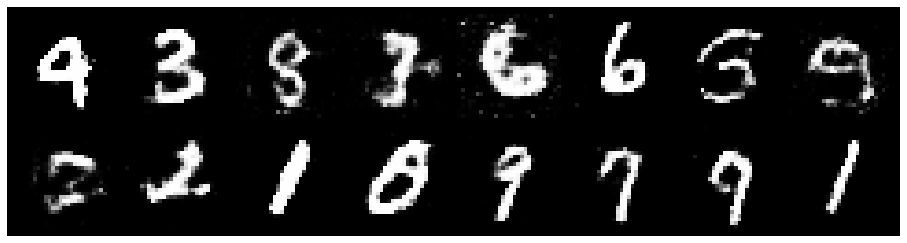

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.2018, Generator Loss: 0.8834
D(x): 0.5753, D(G(z)): 0.4305


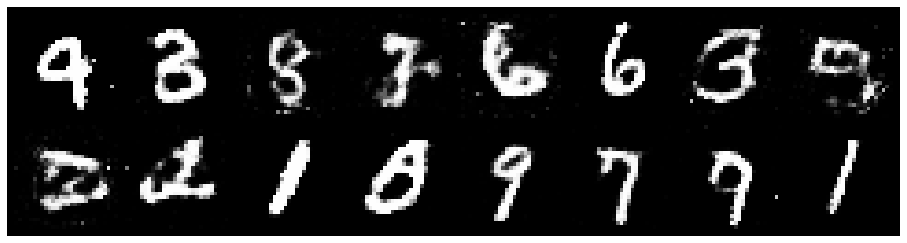

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2676, Generator Loss: 0.8217
D(x): 0.5638, D(G(z)): 0.4570


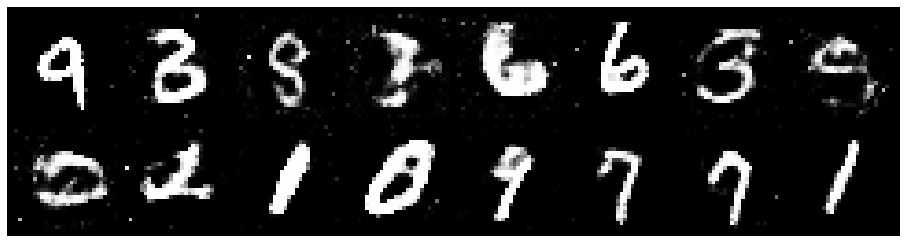

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3357, Generator Loss: 0.8838
D(x): 0.5216, D(G(z)): 0.4592


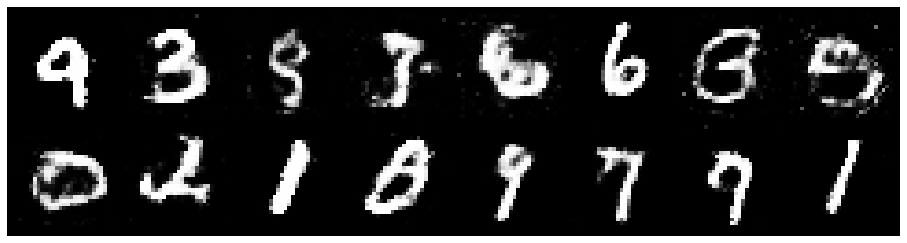

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2654, Generator Loss: 0.7743
D(x): 0.5633, D(G(z)): 0.4648


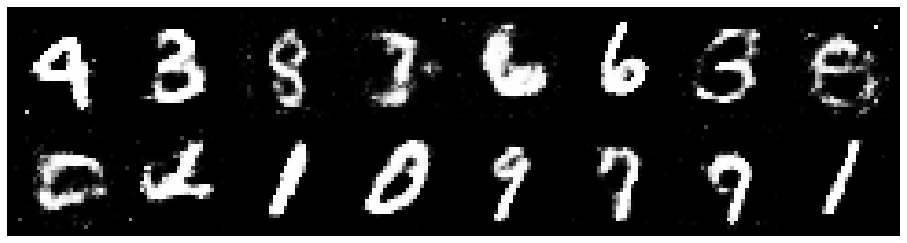

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.3184, Generator Loss: 0.9298
D(x): 0.5759, D(G(z)): 0.4489


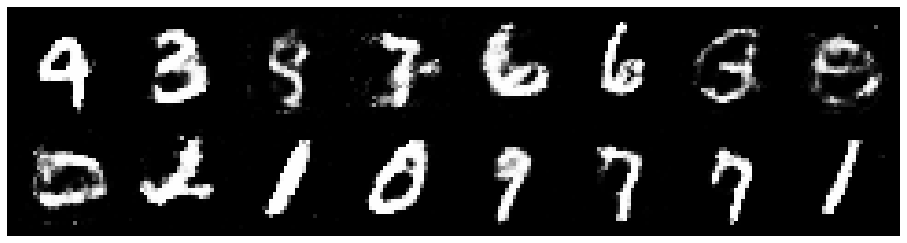

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3443, Generator Loss: 0.7538
D(x): 0.5333, D(G(z)): 0.4775


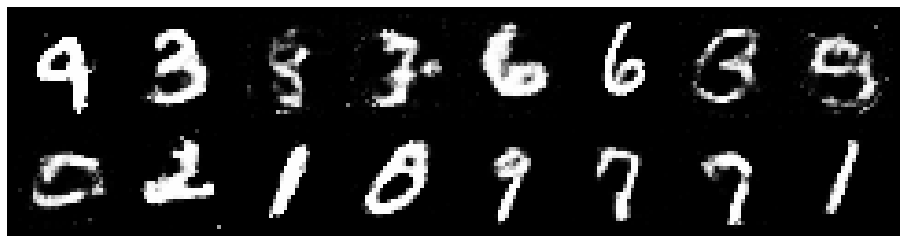

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.1650, Generator Loss: 0.9981
D(x): 0.5630, D(G(z)): 0.3727


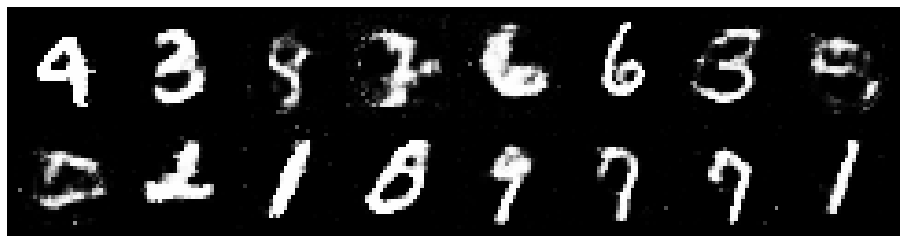

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.1966, Generator Loss: 1.0010
D(x): 0.5498, D(G(z)): 0.3918


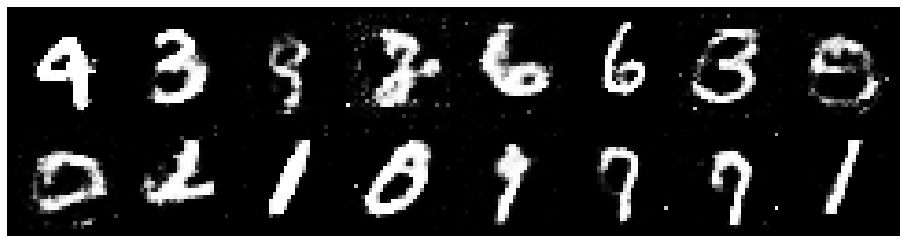

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.3535, Generator Loss: 0.9760
D(x): 0.5439, D(G(z)): 0.4536


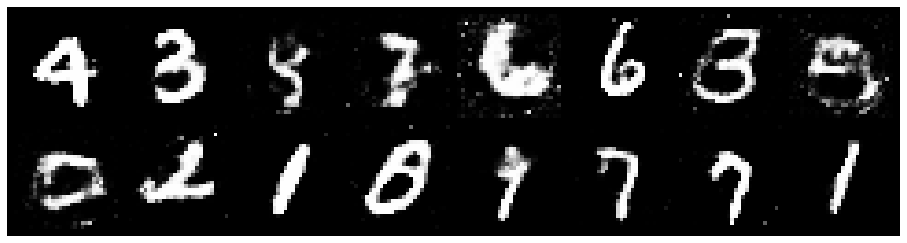

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.1753, Generator Loss: 1.0850
D(x): 0.6067, D(G(z)): 0.4280


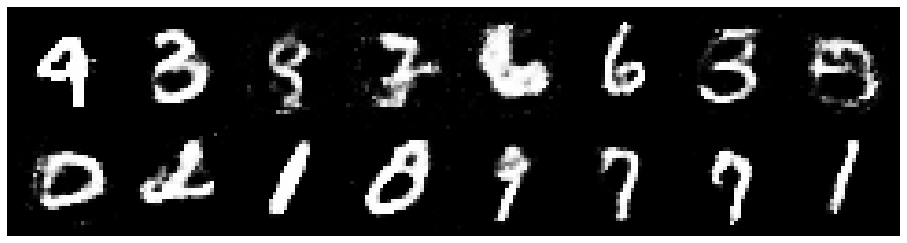

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.1780, Generator Loss: 1.0425
D(x): 0.5838, D(G(z)): 0.3939


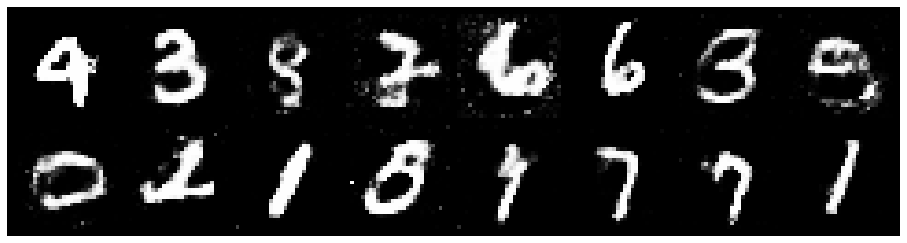

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.2728, Generator Loss: 0.9464
D(x): 0.5732, D(G(z)): 0.4451


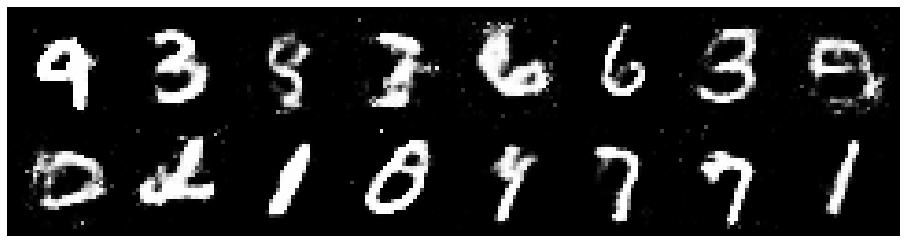

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.3543, Generator Loss: 0.9283
D(x): 0.5262, D(G(z)): 0.4411


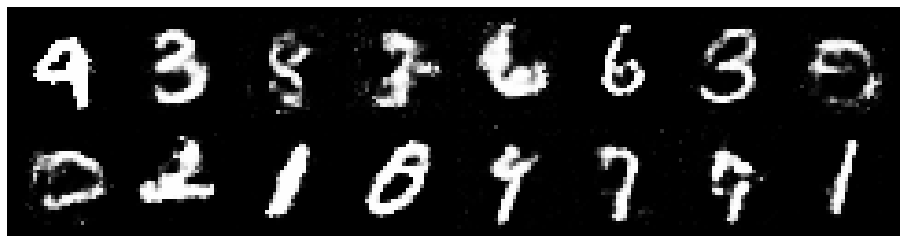

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.3179, Generator Loss: 0.9542
D(x): 0.5579, D(G(z)): 0.4642


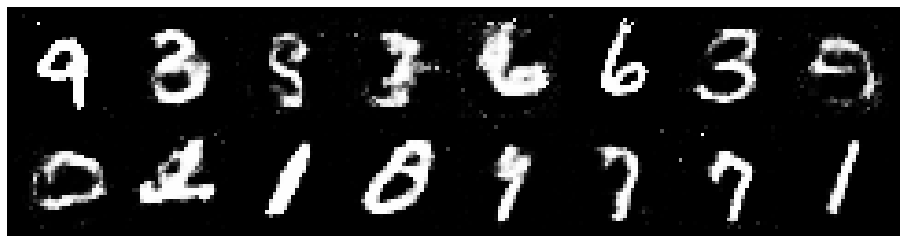

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3602, Generator Loss: 0.9446
D(x): 0.5564, D(G(z)): 0.4519


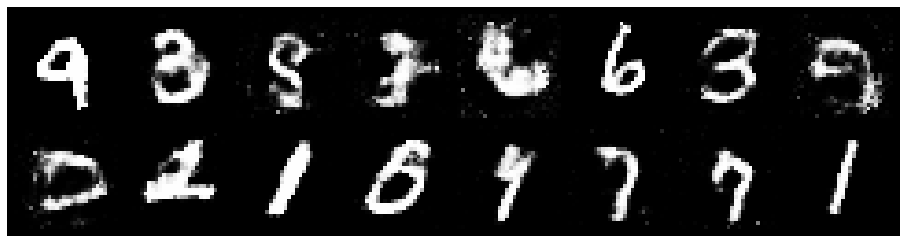

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2405, Generator Loss: 0.8936
D(x): 0.5493, D(G(z)): 0.4054


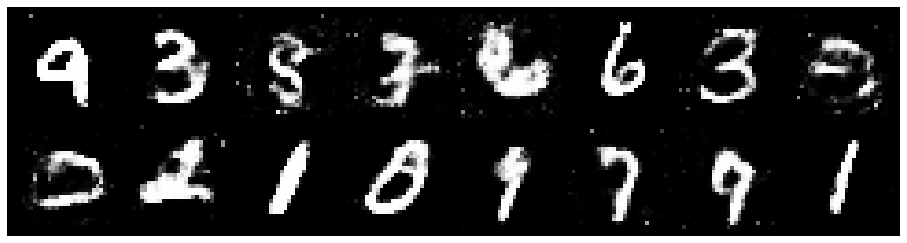

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.1990, Generator Loss: 0.9882
D(x): 0.5375, D(G(z)): 0.3957


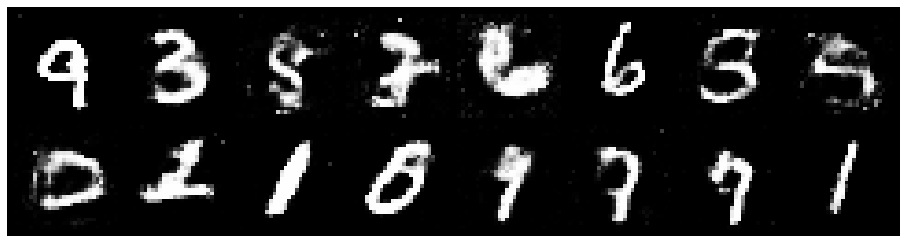

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.1243, Generator Loss: 0.8685
D(x): 0.6190, D(G(z)): 0.4242


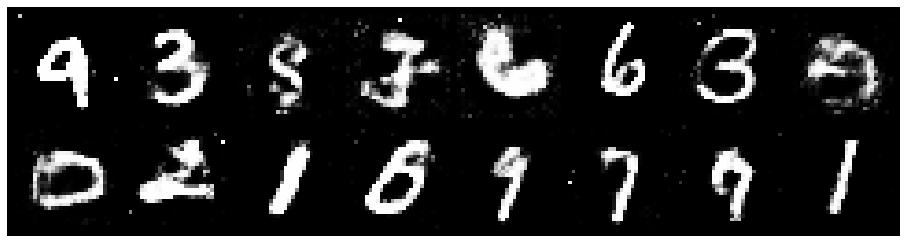

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.2397, Generator Loss: 0.9848
D(x): 0.5364, D(G(z)): 0.4187


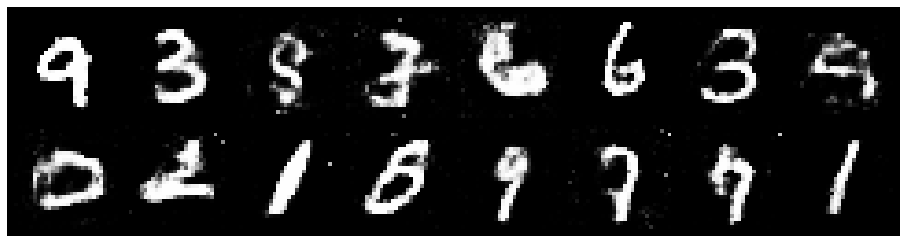

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9242
D(x): 0.5541, D(G(z)): 0.4492


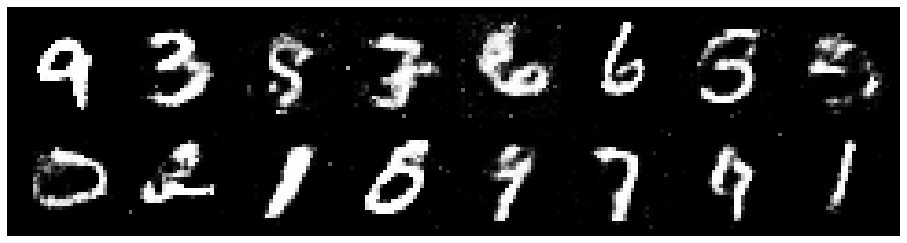

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.2777, Generator Loss: 0.7218
D(x): 0.5619, D(G(z)): 0.4740


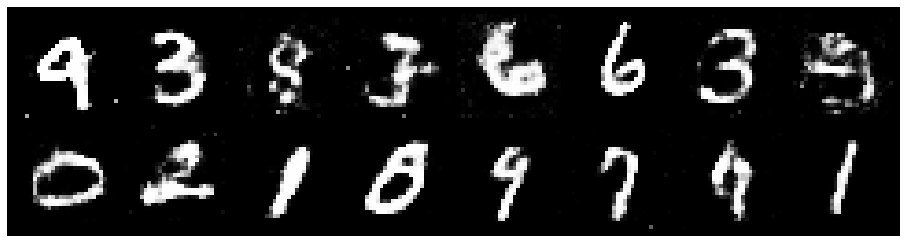

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.3552, Generator Loss: 0.8593
D(x): 0.5274, D(G(z)): 0.4606


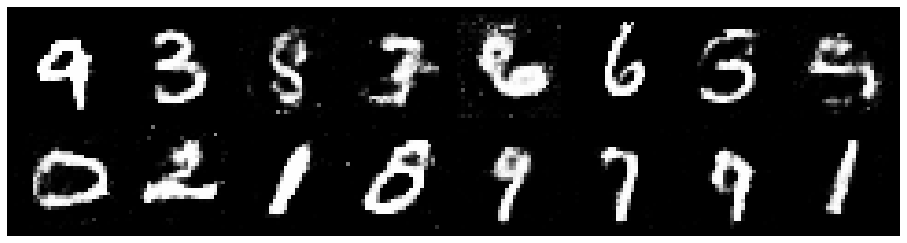

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3395, Generator Loss: 0.8291
D(x): 0.5766, D(G(z)): 0.4932


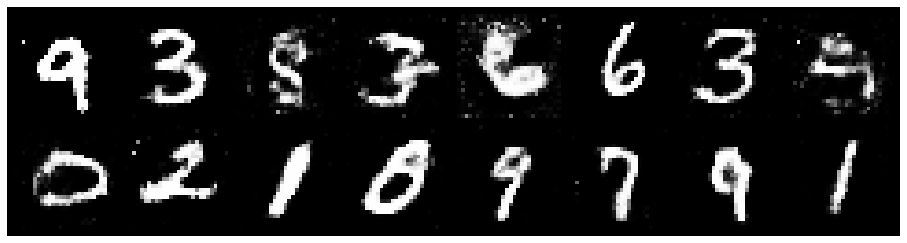

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8955
D(x): 0.5498, D(G(z)): 0.4500


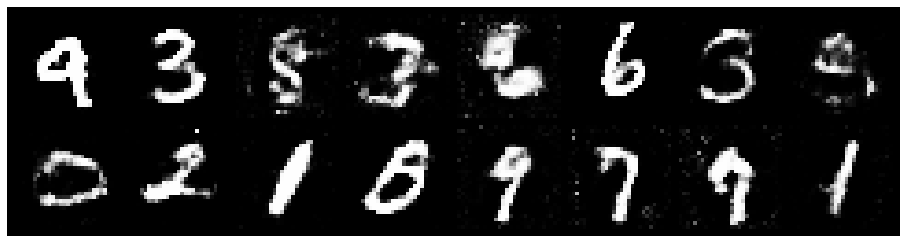

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.3462, Generator Loss: 0.8691
D(x): 0.5051, D(G(z)): 0.4379


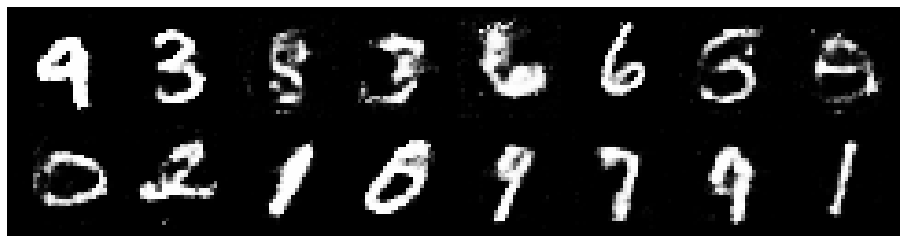

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.3975, Generator Loss: 0.7694
D(x): 0.5606, D(G(z)): 0.5062


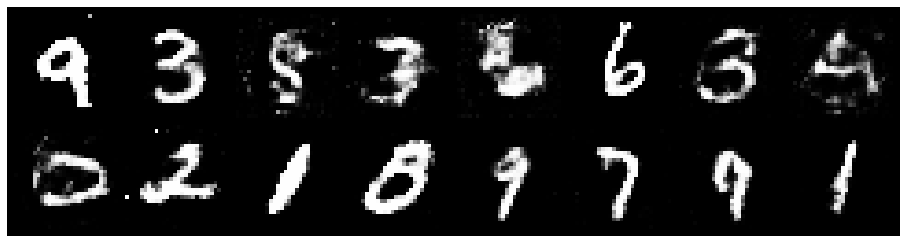

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2434, Generator Loss: 0.8841
D(x): 0.5373, D(G(z)): 0.4055


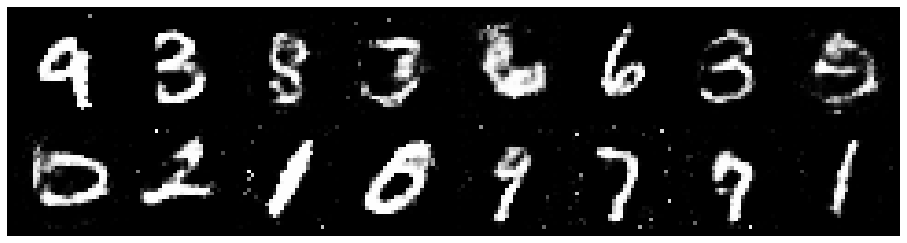

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.2400, Generator Loss: 0.9745
D(x): 0.5626, D(G(z)): 0.4358


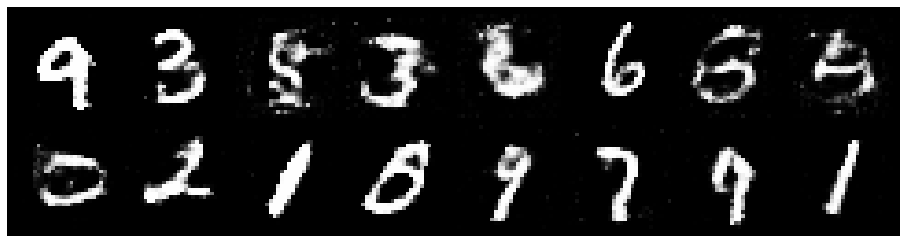

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2671, Generator Loss: 0.8474
D(x): 0.5365, D(G(z)): 0.4369


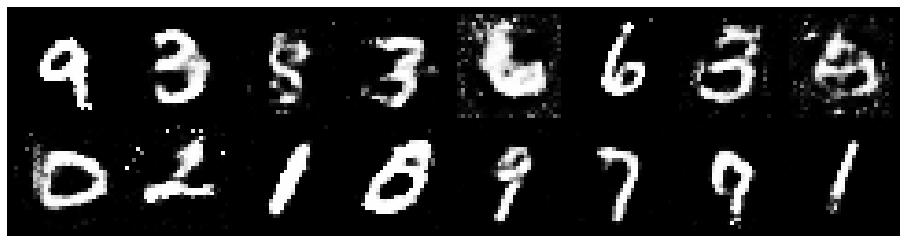

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.2551, Generator Loss: 0.9598
D(x): 0.5595, D(G(z)): 0.4542


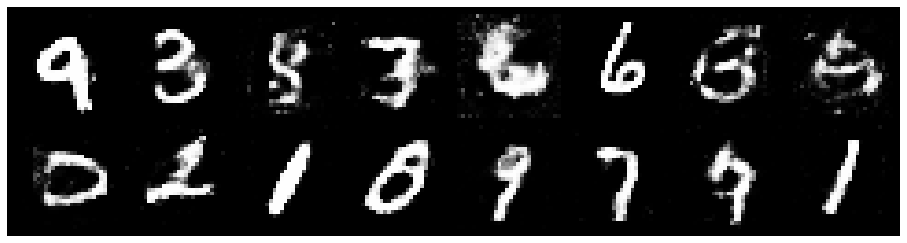

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.2384, Generator Loss: 0.8766
D(x): 0.5252, D(G(z)): 0.4108


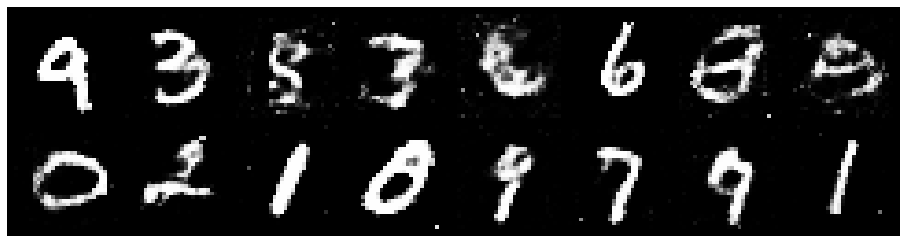

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2229, Generator Loss: 0.8432
D(x): 0.5621, D(G(z)): 0.4421


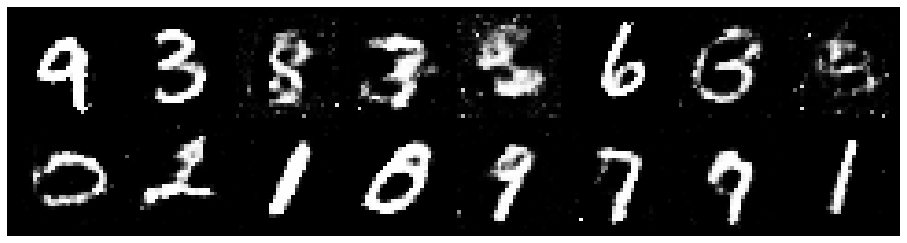

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.4961, Generator Loss: 0.7380
D(x): 0.5173, D(G(z)): 0.5116


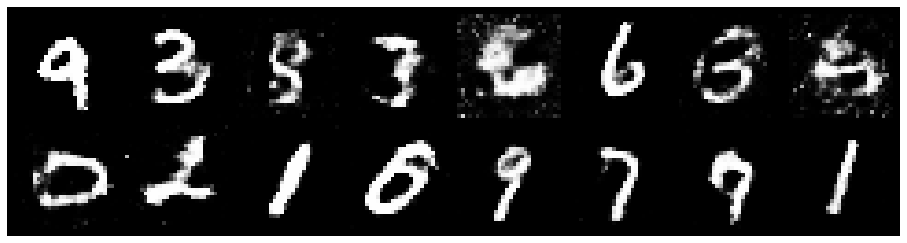

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.3204, Generator Loss: 0.9349
D(x): 0.5870, D(G(z)): 0.4760


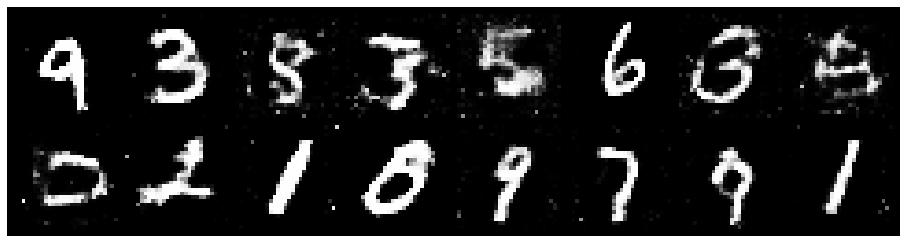

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.2478, Generator Loss: 0.9637
D(x): 0.5397, D(G(z)): 0.4072


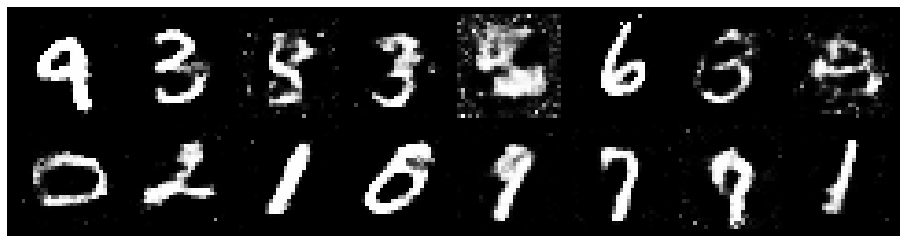

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2970, Generator Loss: 0.7873
D(x): 0.5700, D(G(z)): 0.4827


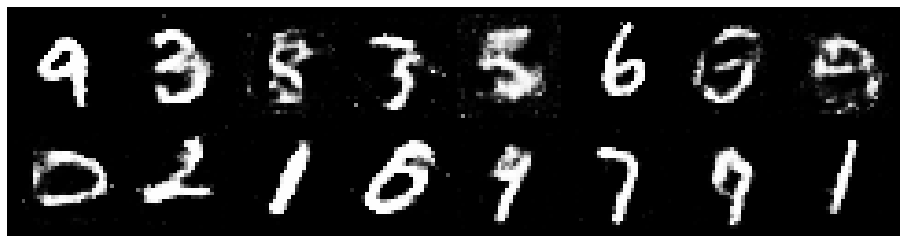

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.3111, Generator Loss: 0.7891
D(x): 0.5350, D(G(z)): 0.4604


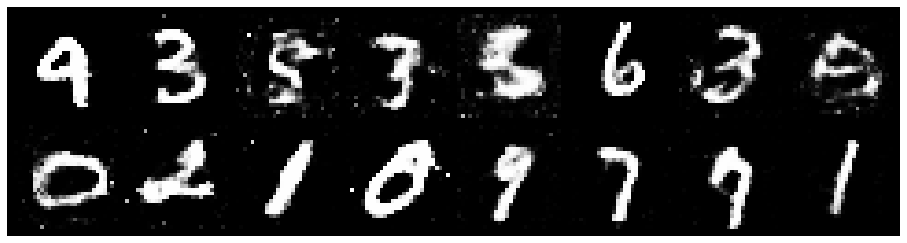

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2518, Generator Loss: 0.8896
D(x): 0.5354, D(G(z)): 0.4297


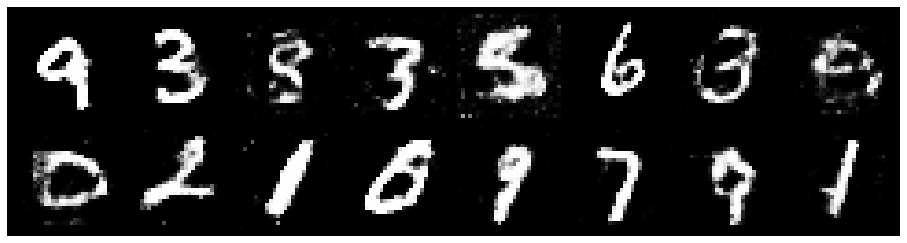

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2147, Generator Loss: 0.7994
D(x): 0.5689, D(G(z)): 0.4483


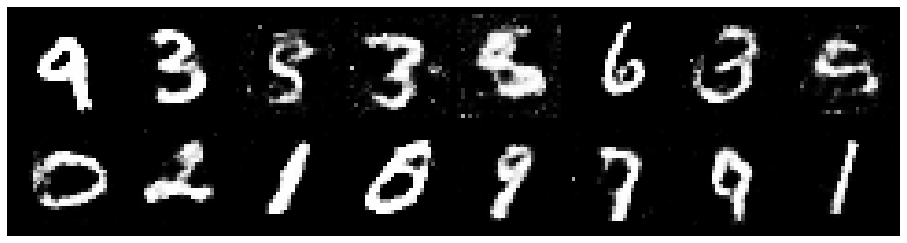

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.4109, Generator Loss: 0.9472
D(x): 0.5020, D(G(z)): 0.4357


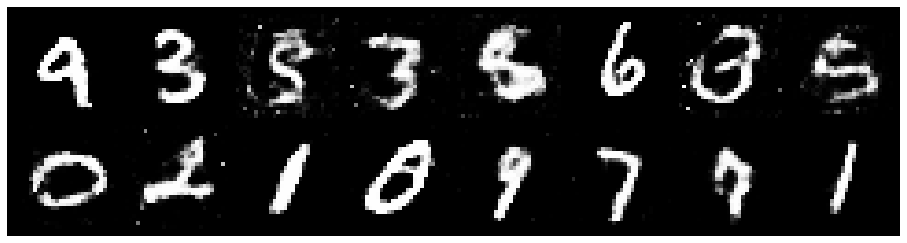

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.2211, Generator Loss: 0.8244
D(x): 0.5910, D(G(z)): 0.4470


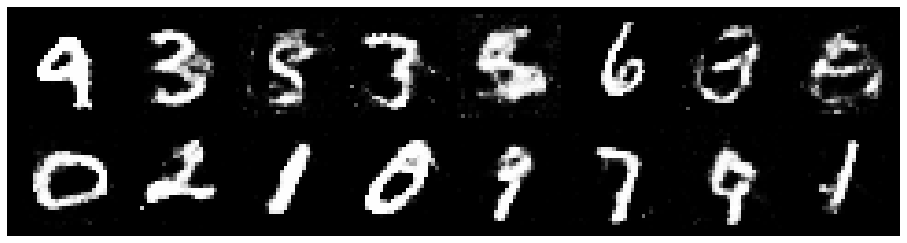

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.3831, Generator Loss: 0.7656
D(x): 0.5380, D(G(z)): 0.4837


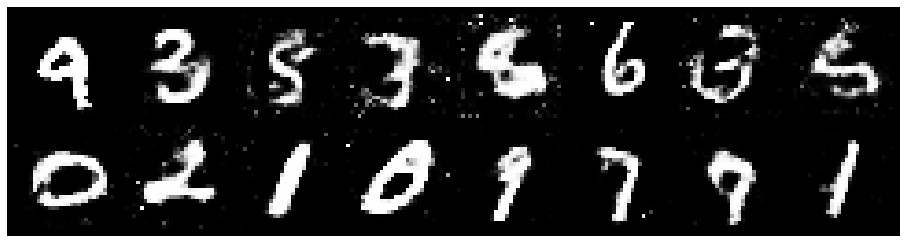

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.2657, Generator Loss: 0.8927
D(x): 0.5683, D(G(z)): 0.4587


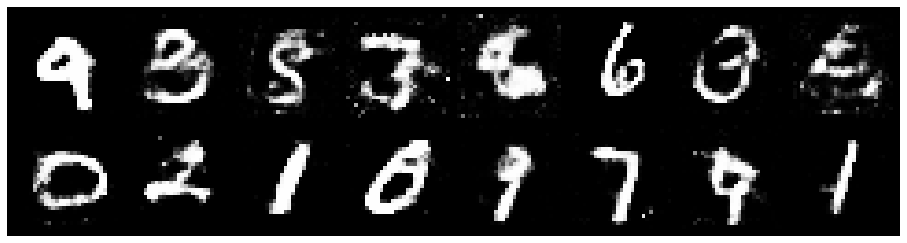

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.4252, Generator Loss: 0.8298
D(x): 0.4897, D(G(z)): 0.4597


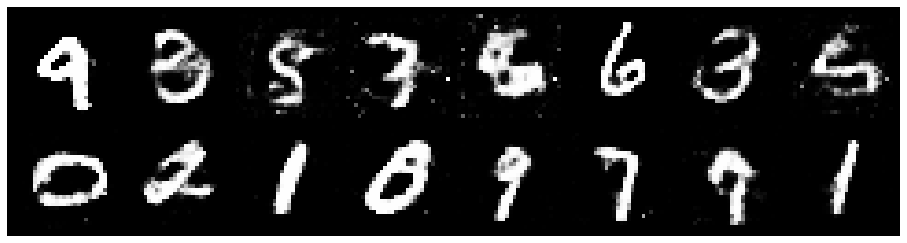

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.4107, Generator Loss: 0.8002
D(x): 0.5132, D(G(z)): 0.4657


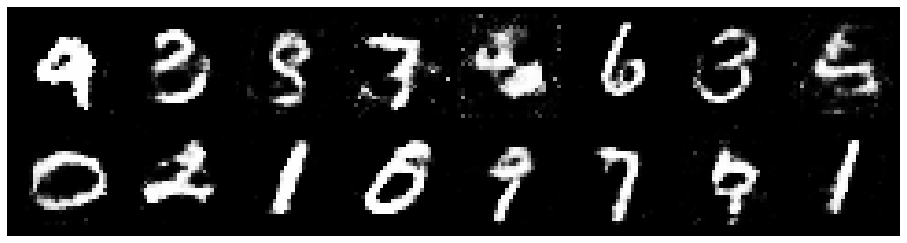

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3683, Generator Loss: 0.8226
D(x): 0.5314, D(G(z)): 0.4750


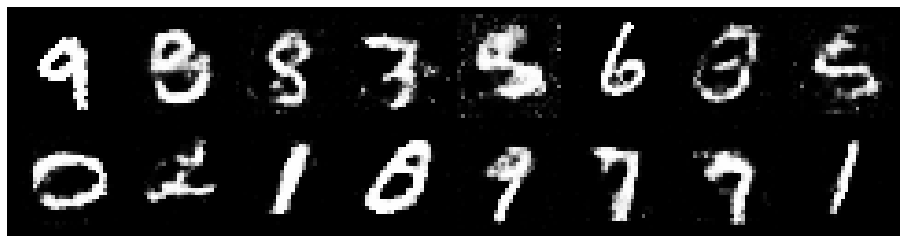

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3655, Generator Loss: 0.8309
D(x): 0.5360, D(G(z)): 0.4902


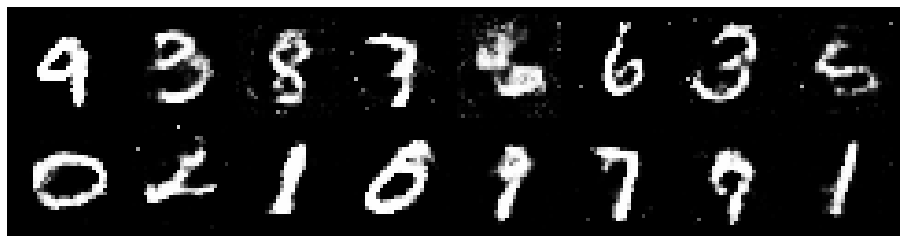

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.3707, Generator Loss: 0.8011
D(x): 0.5260, D(G(z)): 0.4701


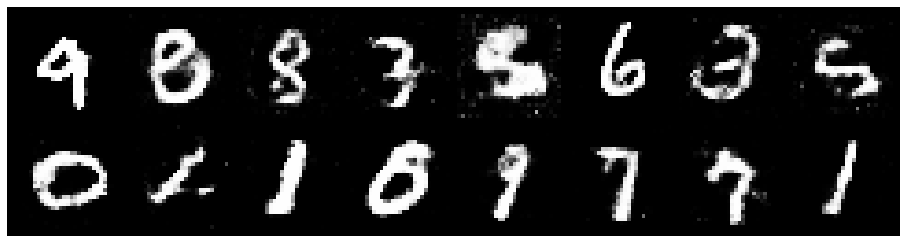

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.3860, Generator Loss: 0.6884
D(x): 0.5953, D(G(z)): 0.5357


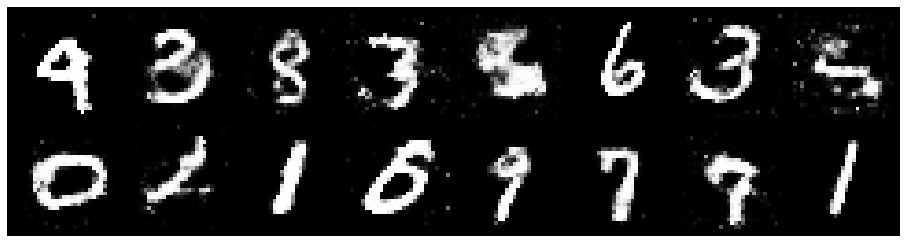

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.3245, Generator Loss: 0.8835
D(x): 0.5463, D(G(z)): 0.4639


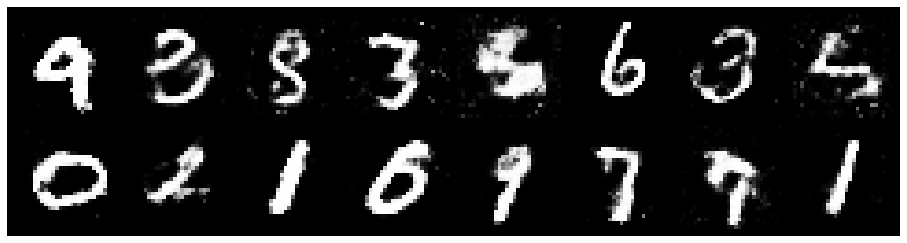

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.2372, Generator Loss: 0.8239
D(x): 0.5978, D(G(z)): 0.4701


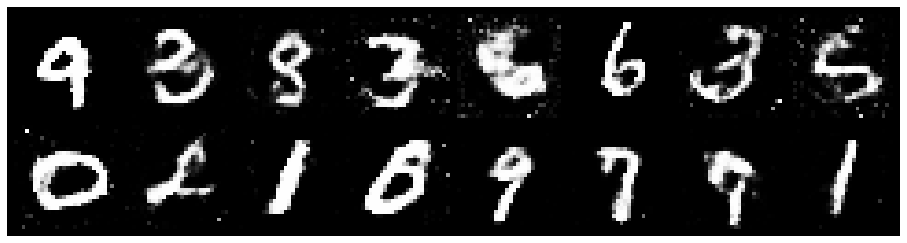

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2190, Generator Loss: 0.8730
D(x): 0.5336, D(G(z)): 0.4182


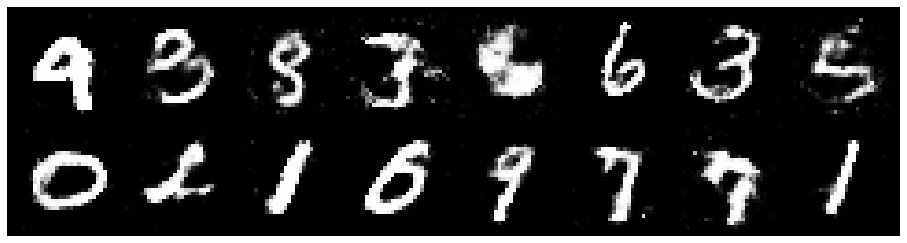

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2274, Generator Loss: 0.9082
D(x): 0.5897, D(G(z)): 0.4430


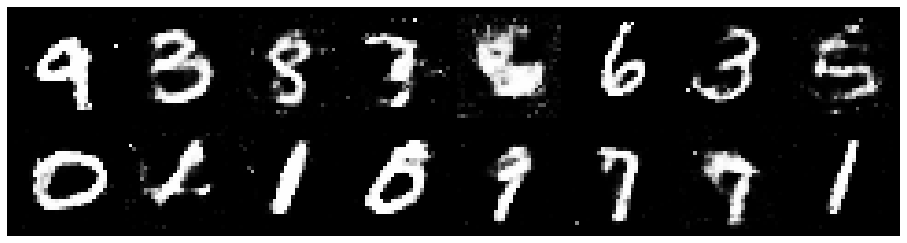

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.2750, Generator Loss: 0.8031
D(x): 0.5562, D(G(z)): 0.4596


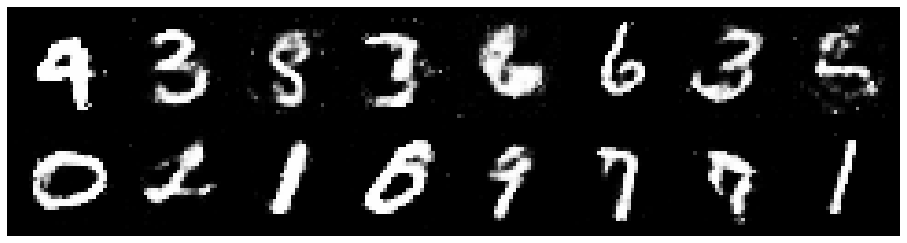

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.3213, Generator Loss: 0.9216
D(x): 0.5439, D(G(z)): 0.4536


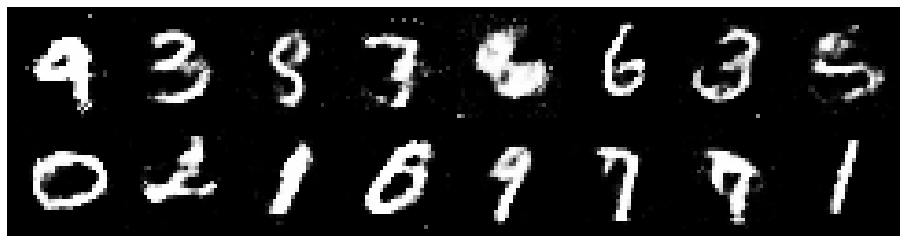

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2601, Generator Loss: 0.9492
D(x): 0.5536, D(G(z)): 0.4334


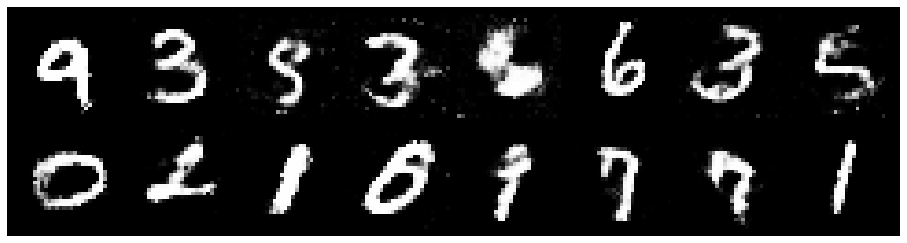

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.3652, Generator Loss: 0.9051
D(x): 0.5390, D(G(z)): 0.4767


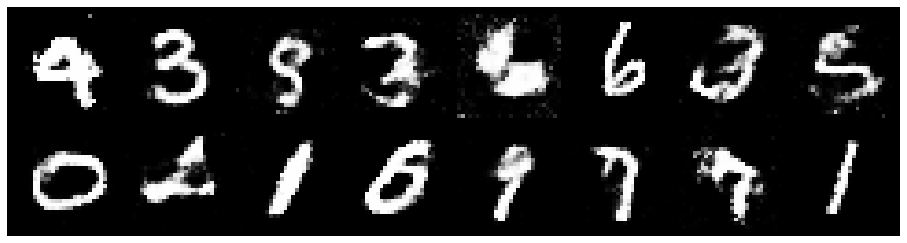

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2858, Generator Loss: 0.8914
D(x): 0.5485, D(G(z)): 0.4671


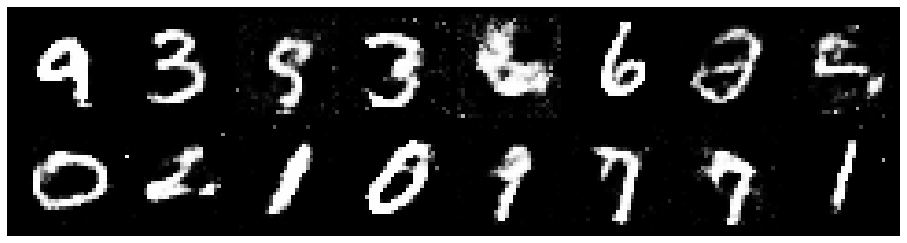

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.1921, Generator Loss: 0.9045
D(x): 0.5646, D(G(z)): 0.4260


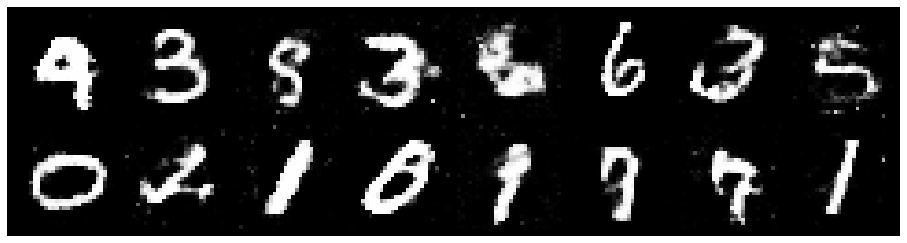

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.3101, Generator Loss: 0.8015
D(x): 0.5366, D(G(z)): 0.4422


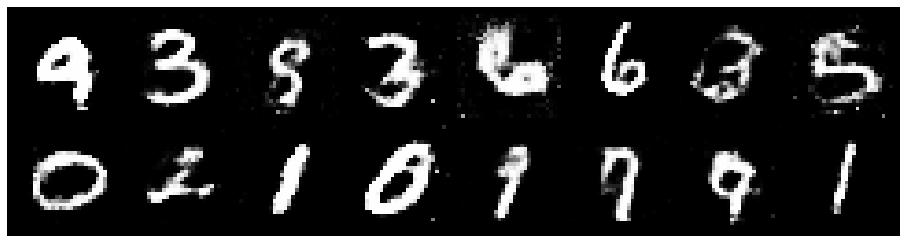

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2754, Generator Loss: 0.7812
D(x): 0.5624, D(G(z)): 0.4699


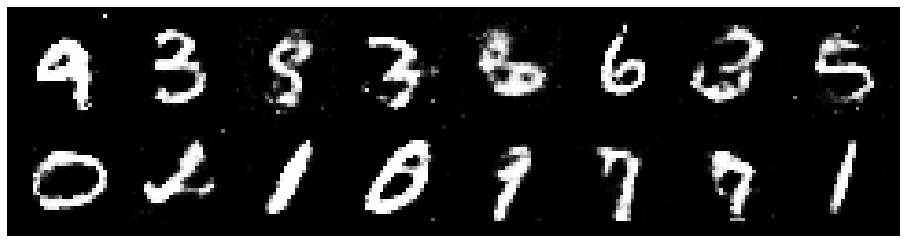

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2792, Generator Loss: 0.7562
D(x): 0.5798, D(G(z)): 0.4803


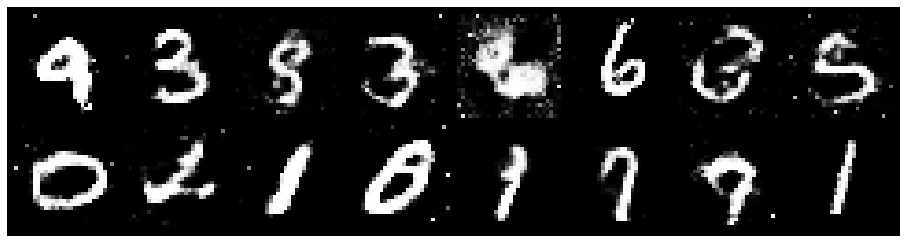

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3019, Generator Loss: 0.8791
D(x): 0.5300, D(G(z)): 0.4366


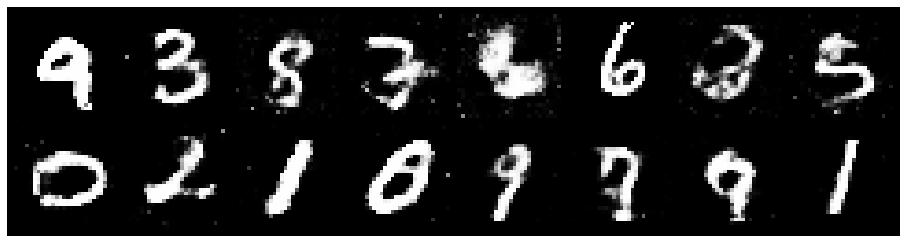

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.3247, Generator Loss: 0.8064
D(x): 0.5300, D(G(z)): 0.4523


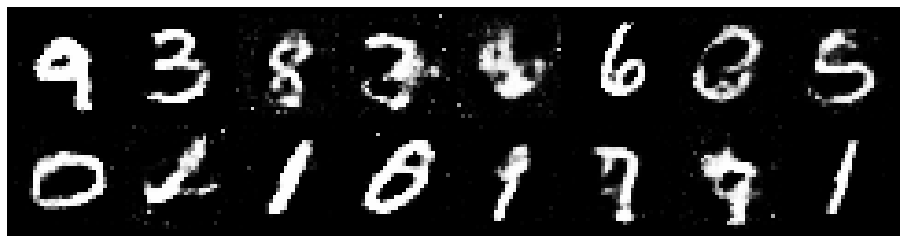

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3883, Generator Loss: 0.8181
D(x): 0.5623, D(G(z)): 0.4829


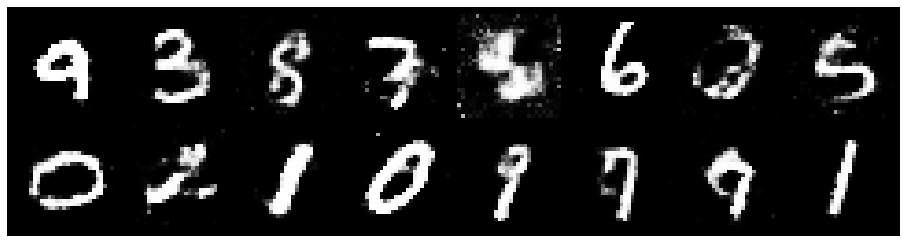

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.1807, Generator Loss: 0.9062
D(x): 0.5925, D(G(z)): 0.4267


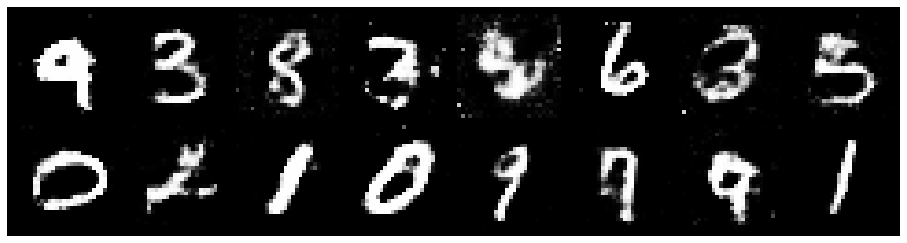

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.3514, Generator Loss: 0.7607
D(x): 0.5342, D(G(z)): 0.4743


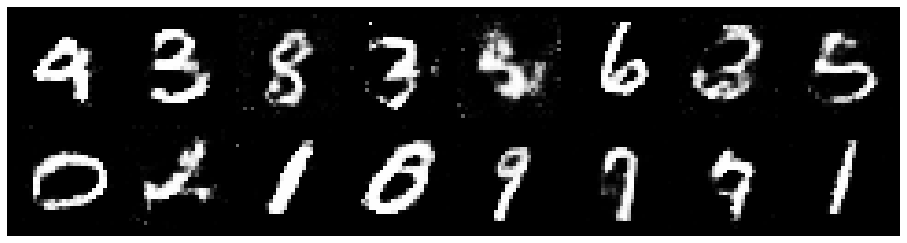

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.3154, Generator Loss: 0.9688
D(x): 0.5226, D(G(z)): 0.4245


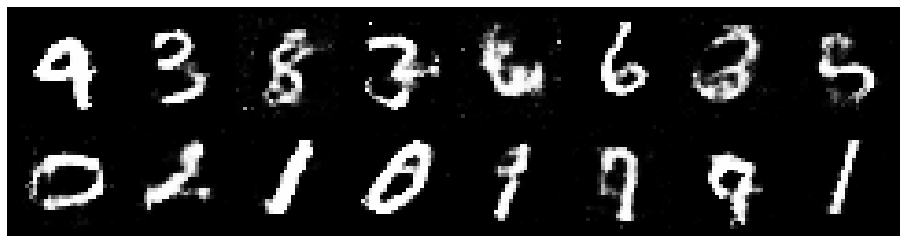

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.3077, Generator Loss: 0.8823
D(x): 0.5476, D(G(z)): 0.4630


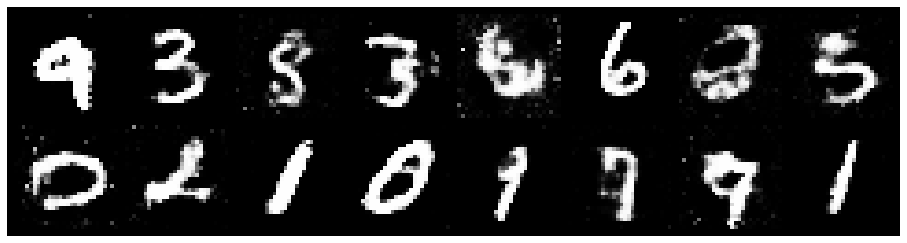

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.3223, Generator Loss: 0.8713
D(x): 0.5470, D(G(z)): 0.4582


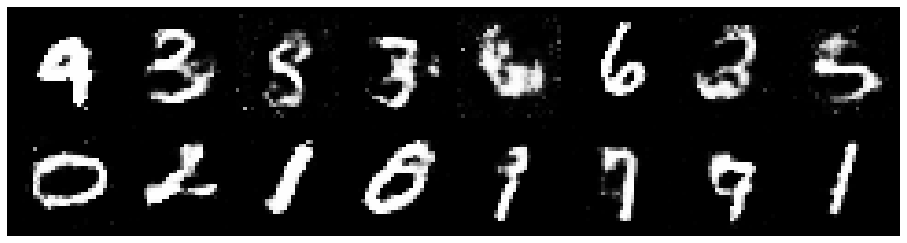

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.2516, Generator Loss: 0.8738
D(x): 0.5389, D(G(z)): 0.4361


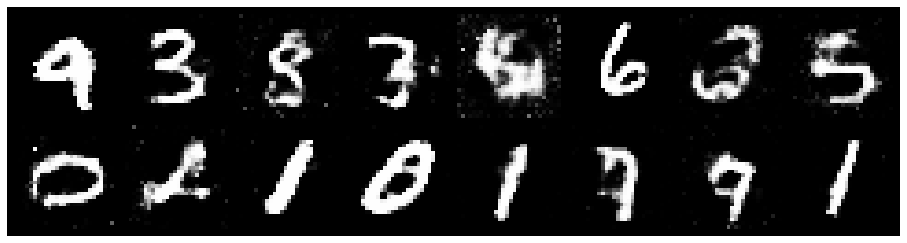

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.3162, Generator Loss: 0.8530
D(x): 0.5455, D(G(z)): 0.4525


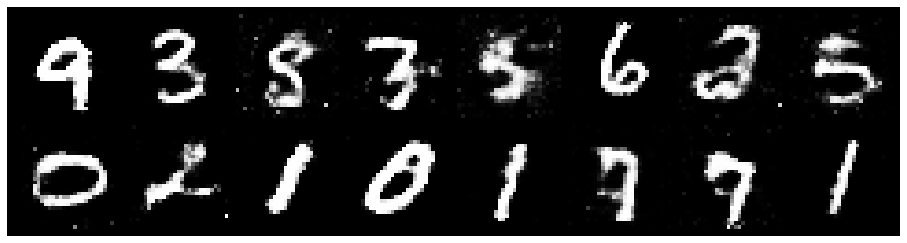

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.2677, Generator Loss: 0.8076
D(x): 0.5725, D(G(z)): 0.4715


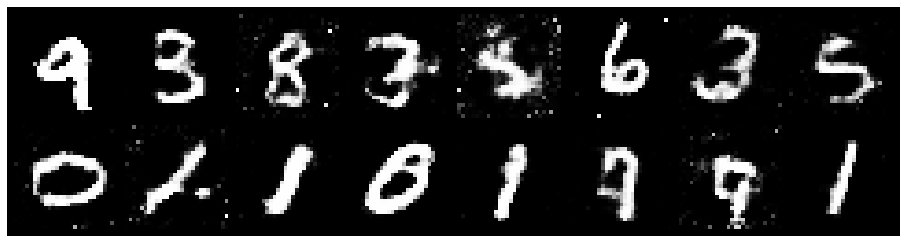

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.3064, Generator Loss: 0.8837
D(x): 0.5303, D(G(z)): 0.4334


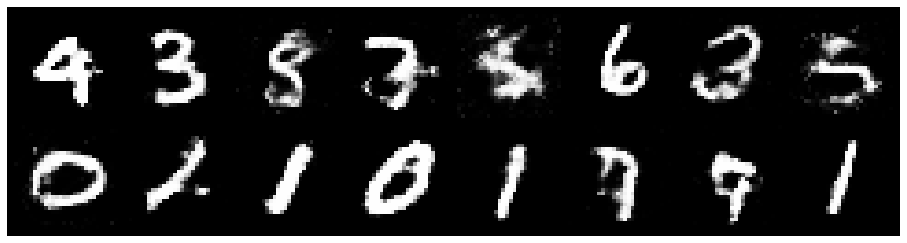

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.3386, Generator Loss: 0.7317
D(x): 0.5685, D(G(z)): 0.5149


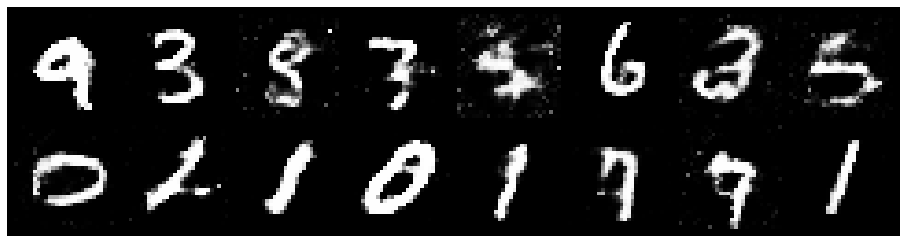

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.2329, Generator Loss: 0.9296
D(x): 0.5819, D(G(z)): 0.4557


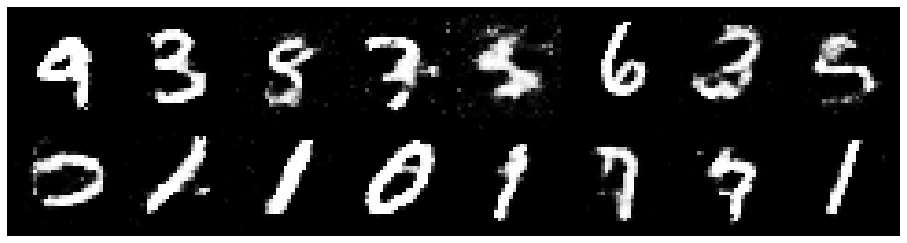

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2714, Generator Loss: 0.9060
D(x): 0.5721, D(G(z)): 0.4458


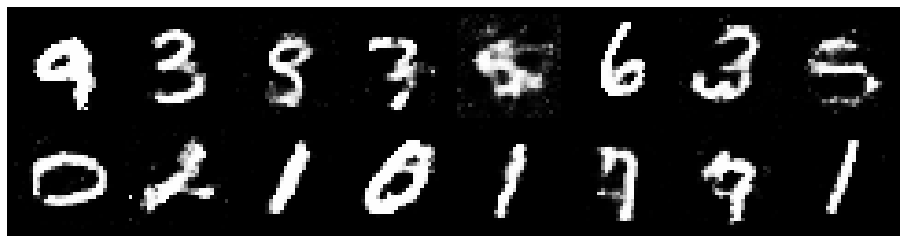

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.2232, Generator Loss: 0.9184
D(x): 0.5570, D(G(z)): 0.4350


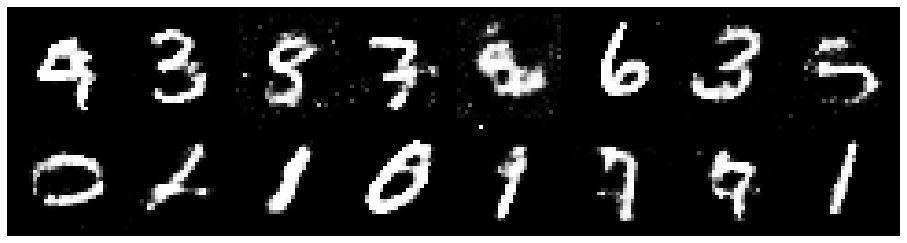

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.4036, Generator Loss: 0.8423
D(x): 0.5109, D(G(z)): 0.4748


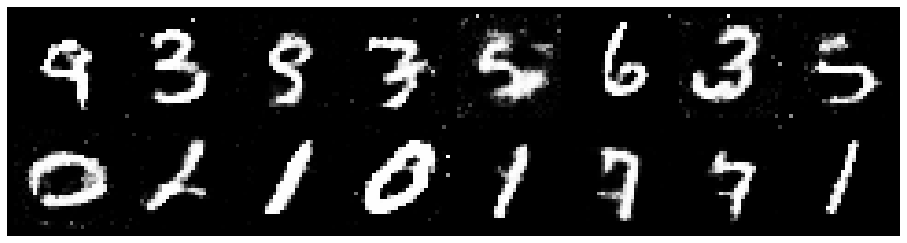

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.3159, Generator Loss: 0.7299
D(x): 0.5763, D(G(z)): 0.5088


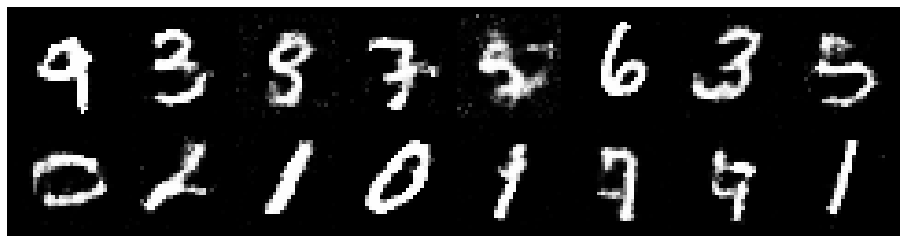

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2128, Generator Loss: 0.9486
D(x): 0.5574, D(G(z)): 0.3986


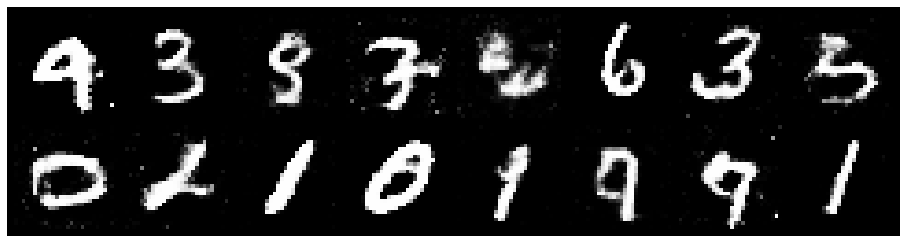

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2396, Generator Loss: 0.9042
D(x): 0.5551, D(G(z)): 0.4154


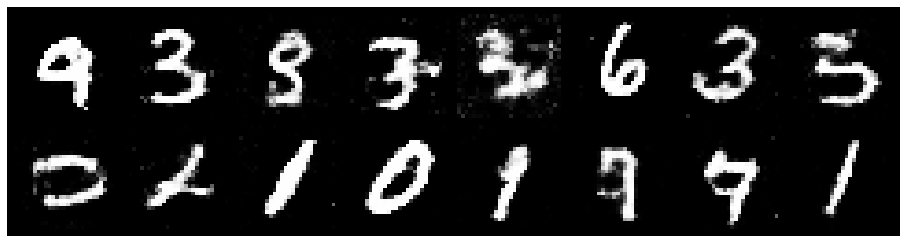

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.4962, Generator Loss: 0.9321
D(x): 0.5072, D(G(z)): 0.4831


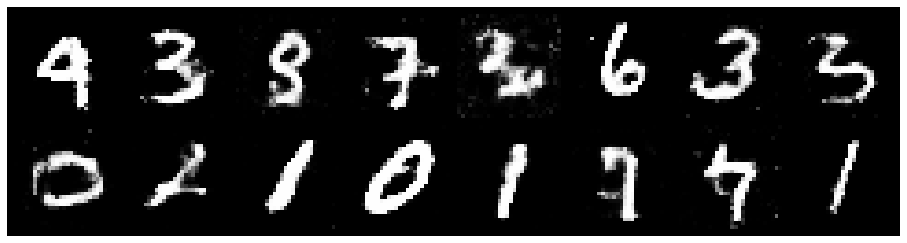

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.3415, Generator Loss: 0.7607
D(x): 0.5812, D(G(z)): 0.5059


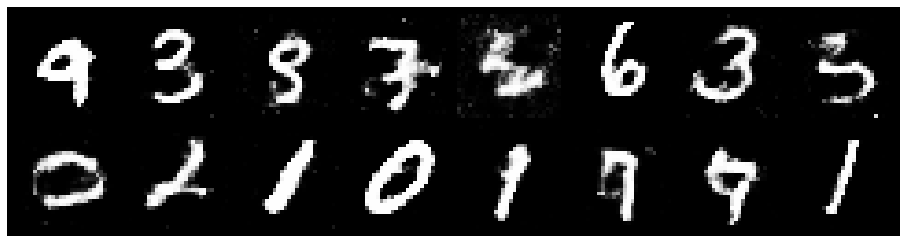

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.3980, Generator Loss: 0.9868
D(x): 0.5061, D(G(z)): 0.4539


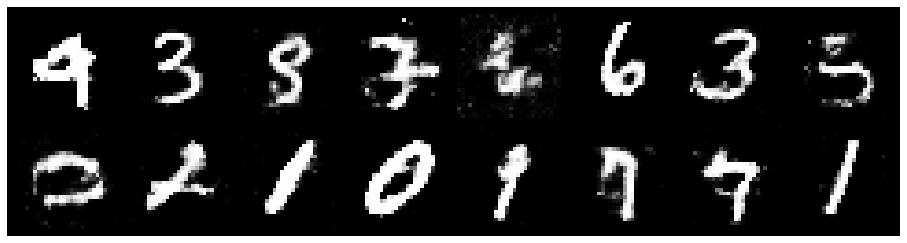

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.2944, Generator Loss: 0.7352
D(x): 0.5731, D(G(z)): 0.4793


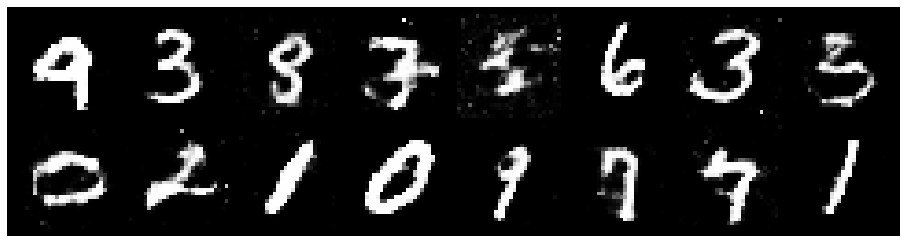

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.3205, Generator Loss: 0.8612
D(x): 0.5192, D(G(z)): 0.4397


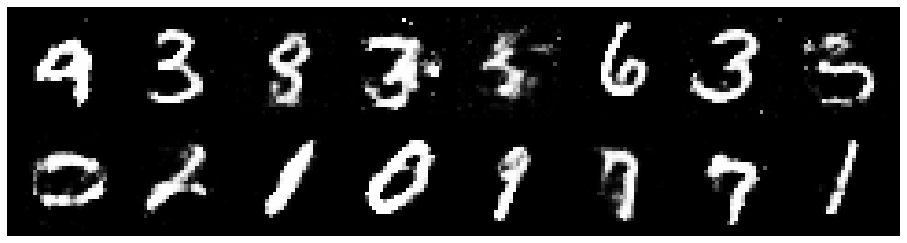

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.2749, Generator Loss: 0.9479
D(x): 0.5713, D(G(z)): 0.4526


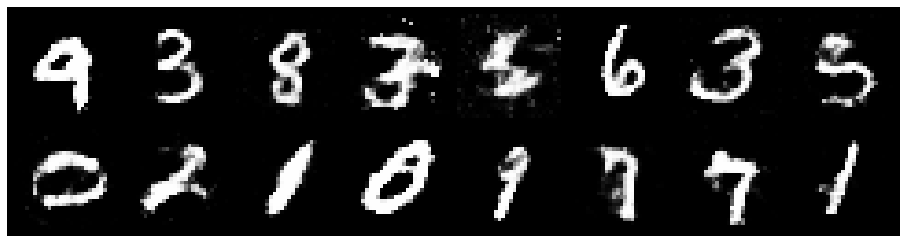

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2511, Generator Loss: 0.8296
D(x): 0.5767, D(G(z)): 0.4578


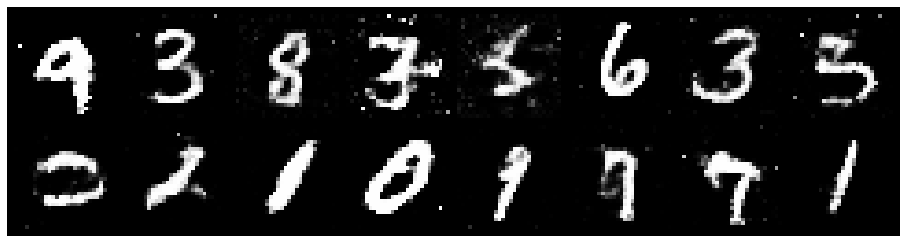

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.2963, Generator Loss: 0.8143
D(x): 0.5200, D(G(z)): 0.4405


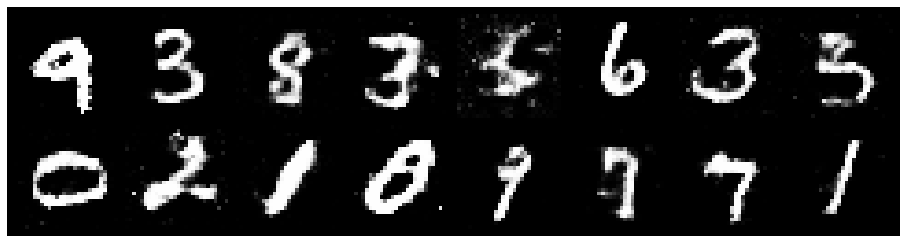

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8432
D(x): 0.5377, D(G(z)): 0.4534


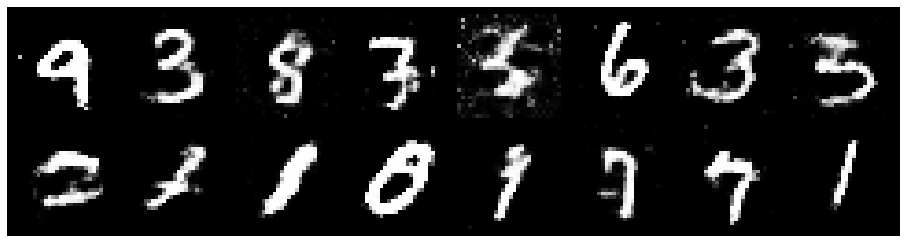

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2776, Generator Loss: 0.7972
D(x): 0.5408, D(G(z)): 0.4468


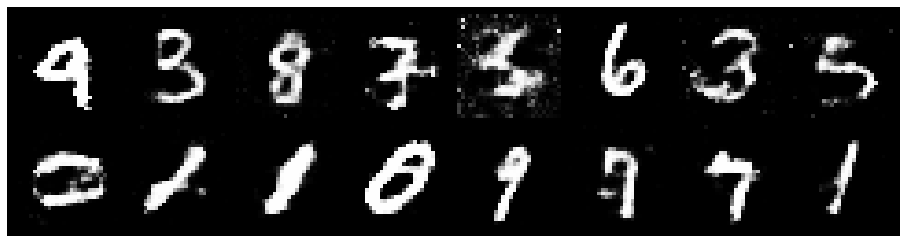

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2717, Generator Loss: 0.9376
D(x): 0.5483, D(G(z)): 0.4432


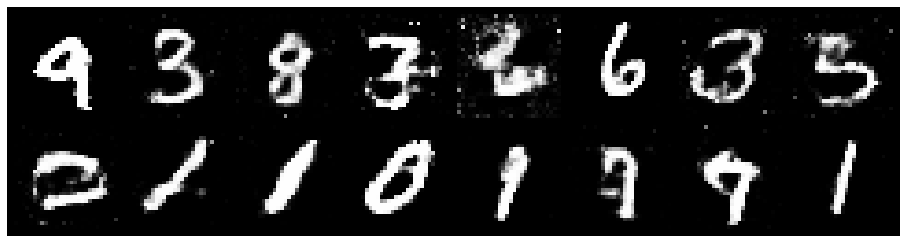

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.3486, Generator Loss: 0.7969
D(x): 0.5509, D(G(z)): 0.4753


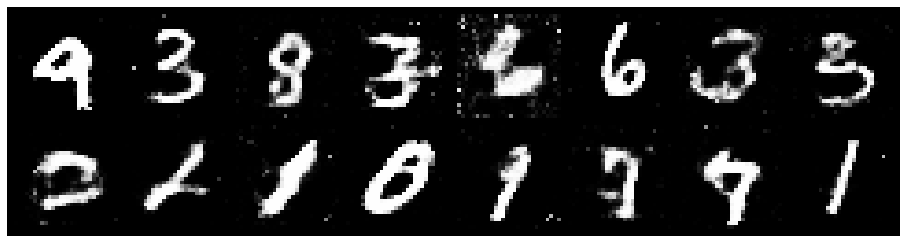

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8297
D(x): 0.5600, D(G(z)): 0.4737


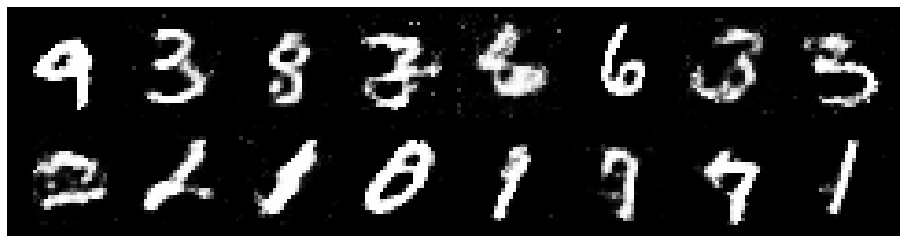

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2817, Generator Loss: 0.8163
D(x): 0.5479, D(G(z)): 0.4626


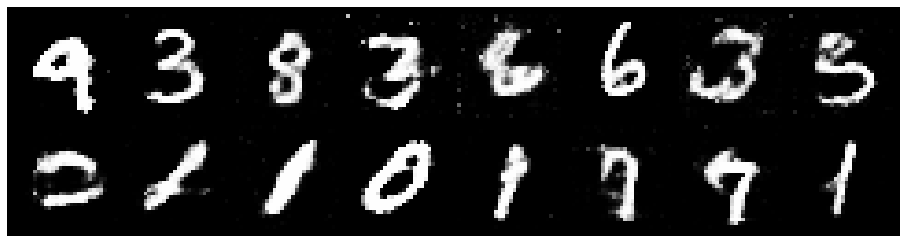

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.3586, Generator Loss: 0.8285
D(x): 0.5495, D(G(z)): 0.4738


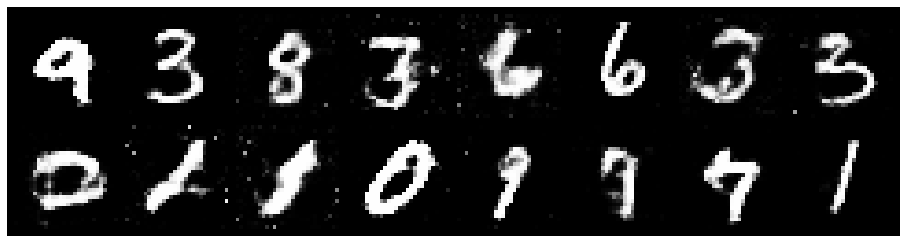

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.2719, Generator Loss: 0.9411
D(x): 0.5774, D(G(z)): 0.4615


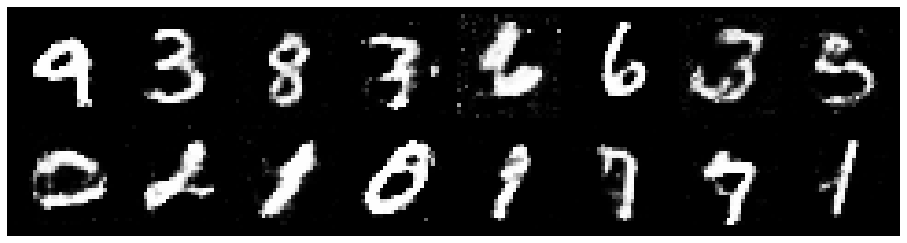

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.3039, Generator Loss: 0.8626
D(x): 0.5629, D(G(z)): 0.4820


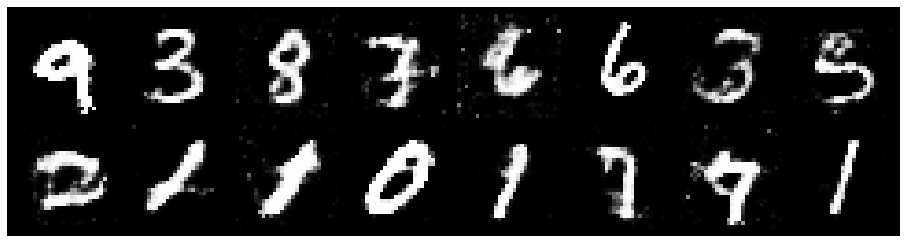

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2739, Generator Loss: 0.8360
D(x): 0.5483, D(G(z)): 0.4603


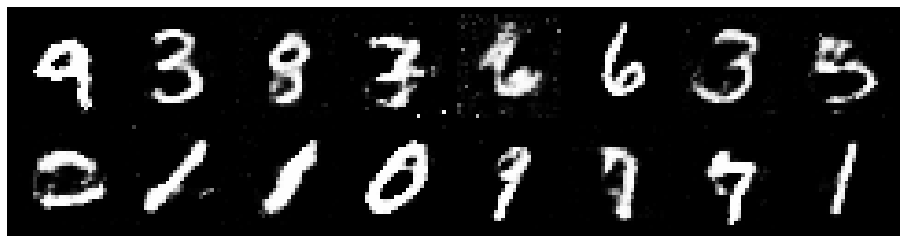

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.2766, Generator Loss: 0.8455
D(x): 0.5449, D(G(z)): 0.4269


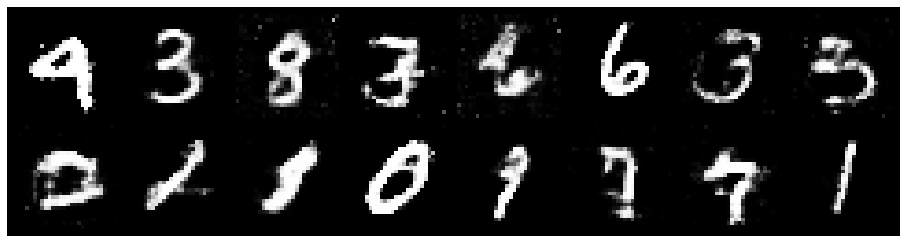

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.3037, Generator Loss: 0.9149
D(x): 0.5403, D(G(z)): 0.4351


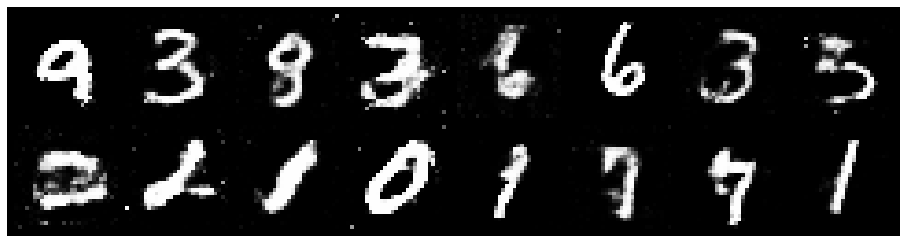

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.2565, Generator Loss: 0.8125
D(x): 0.5858, D(G(z)): 0.4664


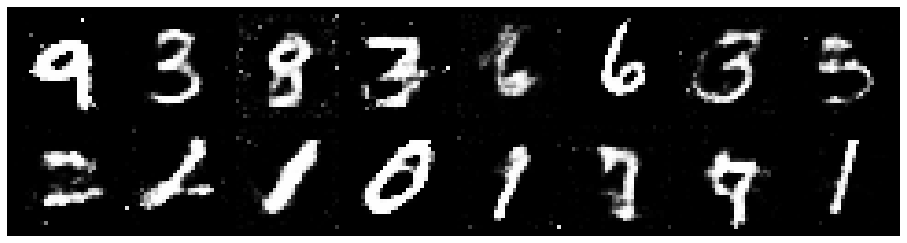

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.3321, Generator Loss: 0.8535
D(x): 0.5647, D(G(z)): 0.4773


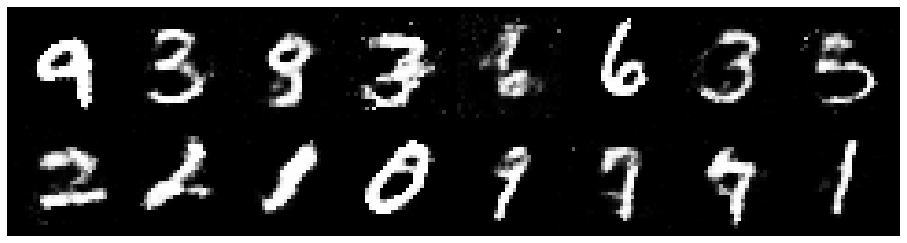

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.3205, Generator Loss: 0.8444
D(x): 0.5471, D(G(z)): 0.4697


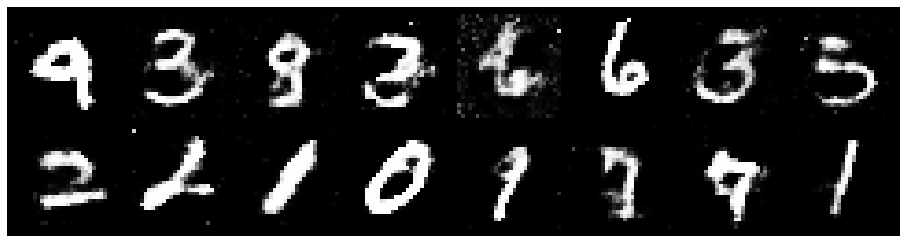

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3949, Generator Loss: 0.8495
D(x): 0.5176, D(G(z)): 0.4541


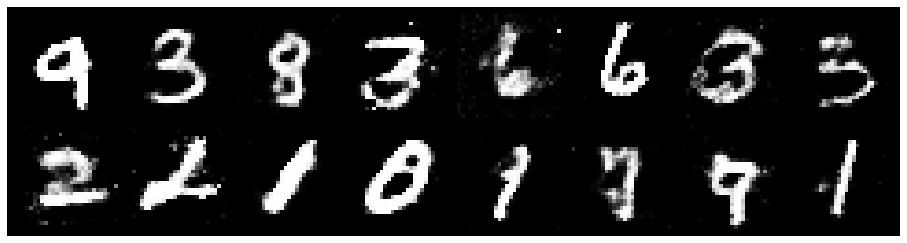

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2424, Generator Loss: 0.9102
D(x): 0.5634, D(G(z)): 0.4452


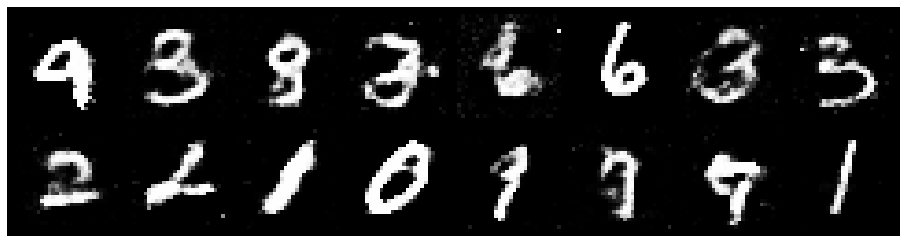

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.4274, Generator Loss: 0.7741
D(x): 0.5456, D(G(z)): 0.5084


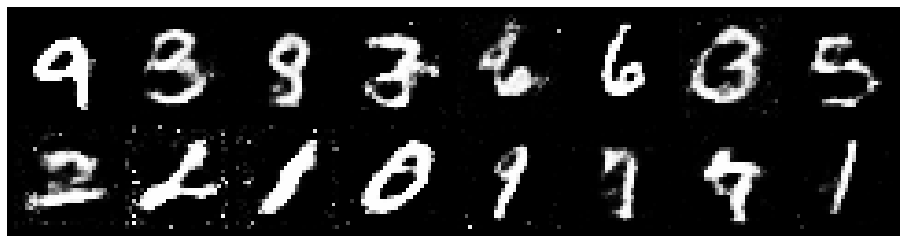

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.2882, Generator Loss: 0.8120
D(x): 0.5443, D(G(z)): 0.4490


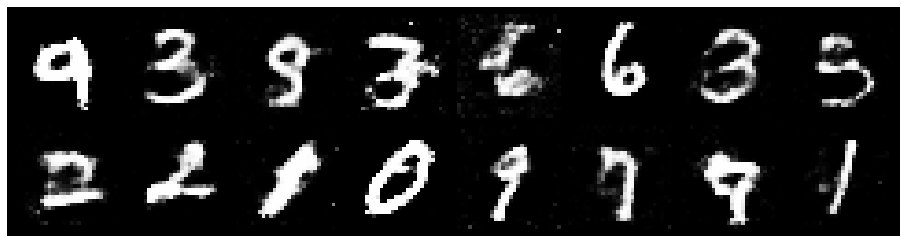

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.2065, Generator Loss: 0.9662
D(x): 0.5656, D(G(z)): 0.4102


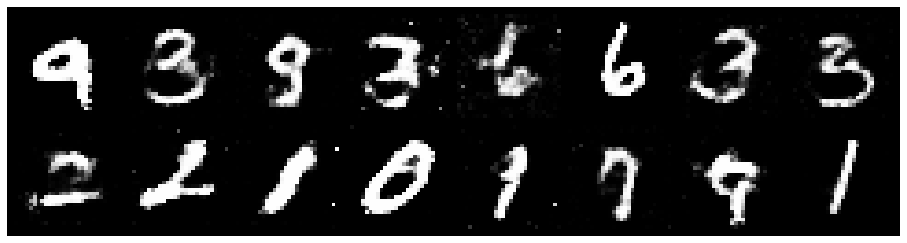

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3534, Generator Loss: 1.0449
D(x): 0.5464, D(G(z)): 0.4716


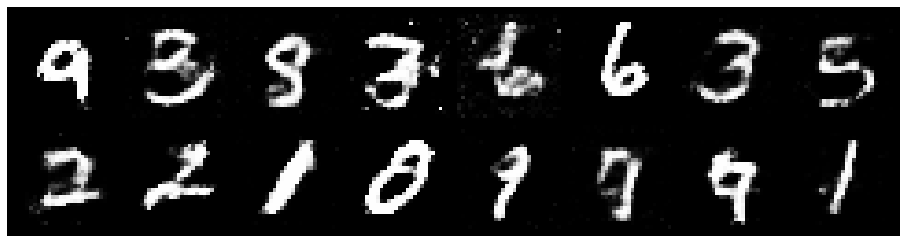

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3031, Generator Loss: 0.8527
D(x): 0.5438, D(G(z)): 0.4588


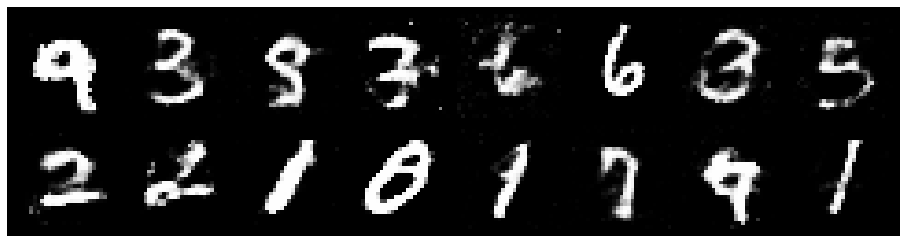

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3634, Generator Loss: 0.9164
D(x): 0.5534, D(G(z)): 0.4758


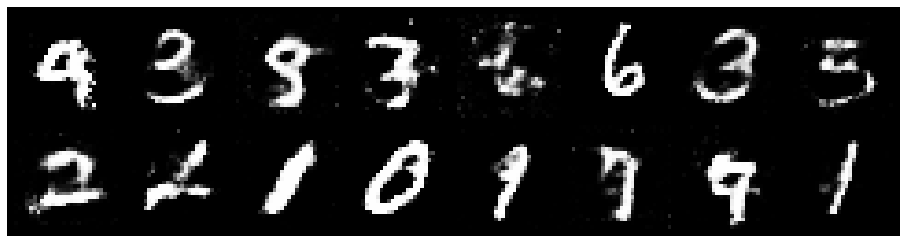

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2561, Generator Loss: 0.8585
D(x): 0.5410, D(G(z)): 0.4321


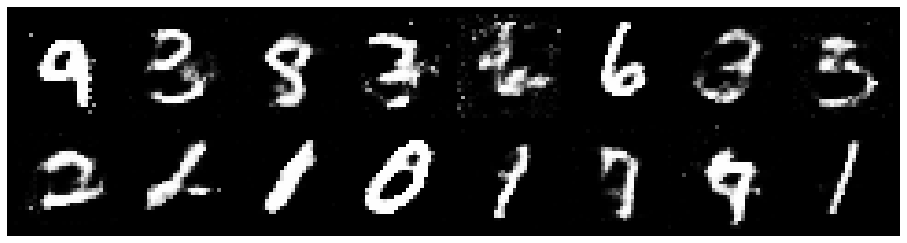

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.2705, Generator Loss: 0.8327
D(x): 0.5681, D(G(z)): 0.4662


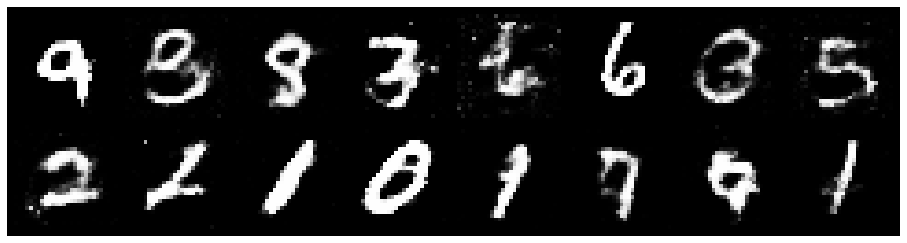

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3999, Generator Loss: 0.6976
D(x): 0.5297, D(G(z)): 0.4948


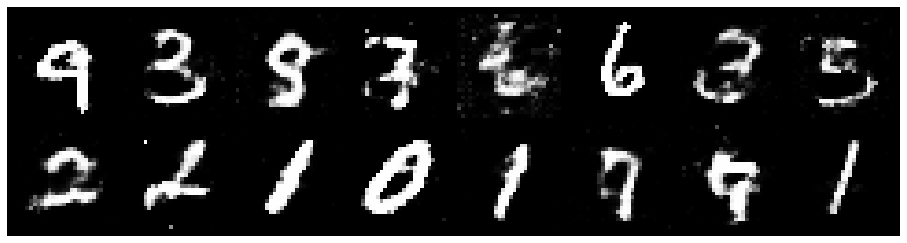

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.3622, Generator Loss: 0.7666
D(x): 0.5134, D(G(z)): 0.4776


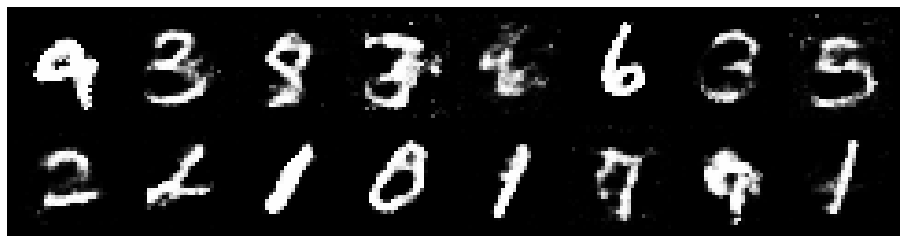

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.2903, Generator Loss: 0.9914
D(x): 0.5847, D(G(z)): 0.4572


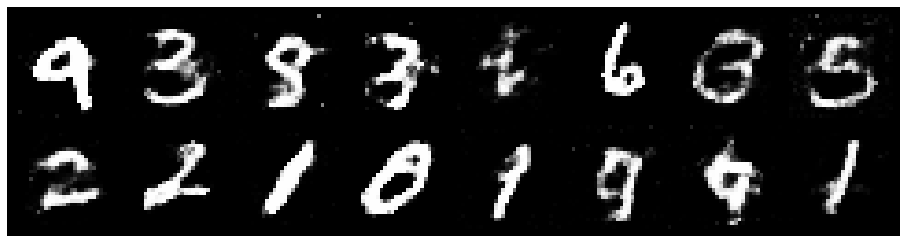

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.2983, Generator Loss: 1.0337
D(x): 0.5579, D(G(z)): 0.4372


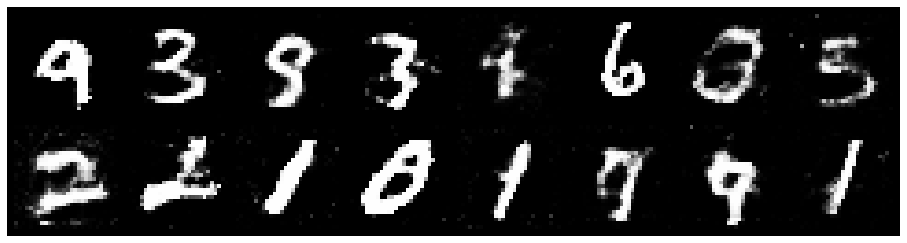

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.2161, Generator Loss: 1.1735
D(x): 0.5099, D(G(z)): 0.3221


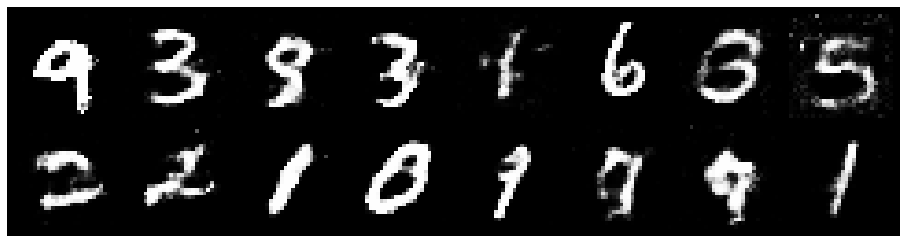

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.1889, Generator Loss: 0.9356
D(x): 0.5870, D(G(z)): 0.4319


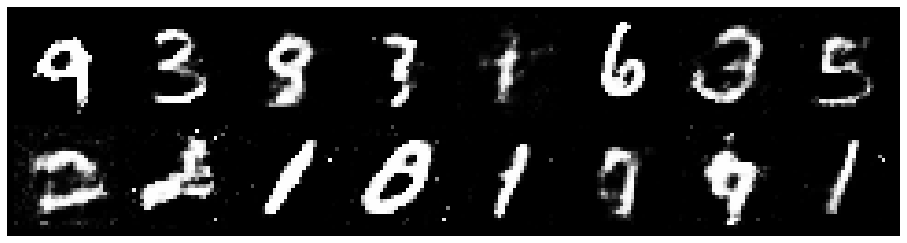

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.2422, Generator Loss: 0.8855
D(x): 0.5771, D(G(z)): 0.4446


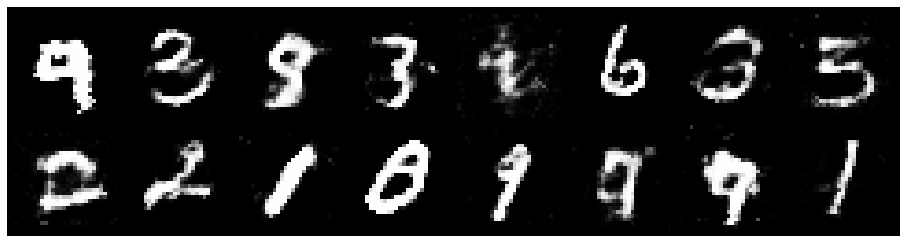

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.3731, Generator Loss: 0.9180
D(x): 0.5310, D(G(z)): 0.4536


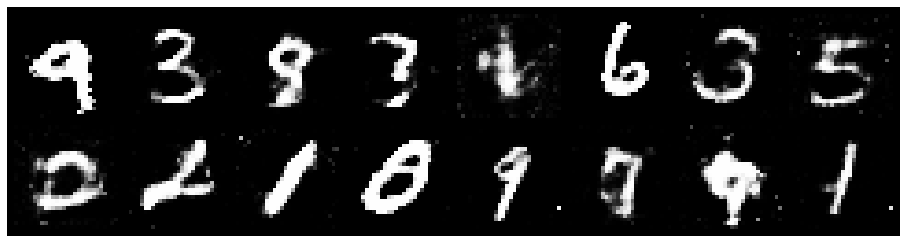

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.1685, Generator Loss: 1.0144
D(x): 0.5830, D(G(z)): 0.4014


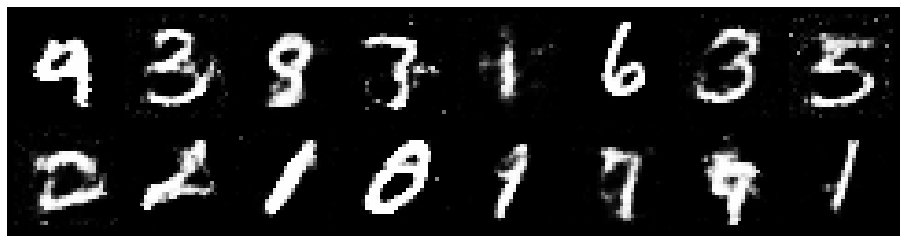

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2805, Generator Loss: 0.8808
D(x): 0.5718, D(G(z)): 0.4574


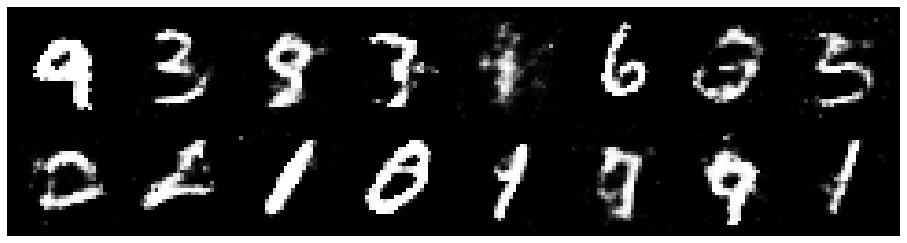

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2670, Generator Loss: 0.7799
D(x): 0.5568, D(G(z)): 0.4739


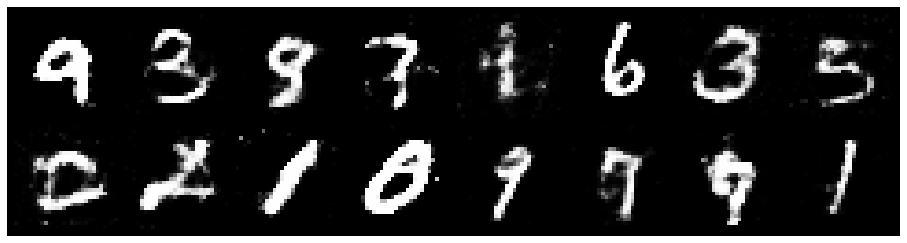

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.2785, Generator Loss: 0.8332
D(x): 0.5411, D(G(z)): 0.4597


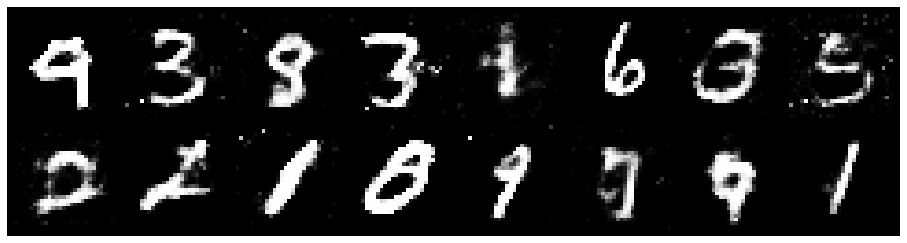

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.3595, Generator Loss: 0.8147
D(x): 0.4988, D(G(z)): 0.4595


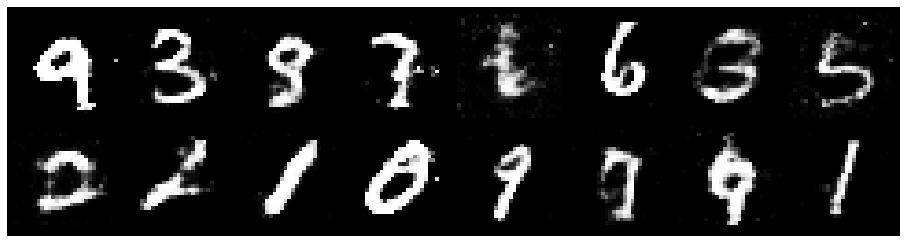

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2637, Generator Loss: 0.8952
D(x): 0.5540, D(G(z)): 0.4250


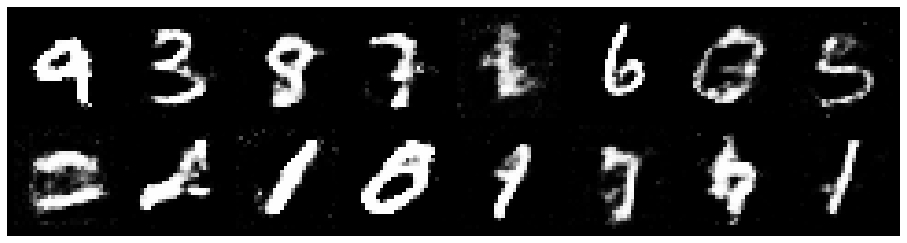

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.3270, Generator Loss: 0.9024
D(x): 0.5516, D(G(z)): 0.4738


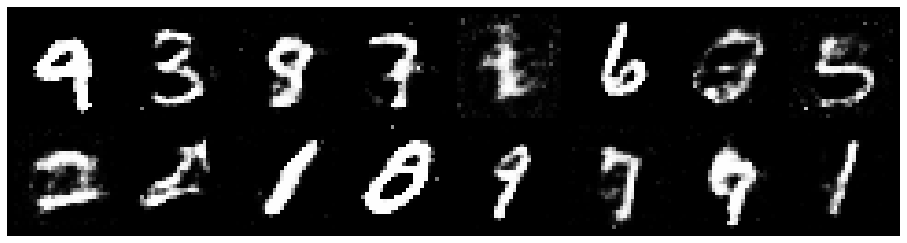

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2849, Generator Loss: 0.7921
D(x): 0.5770, D(G(z)): 0.4846


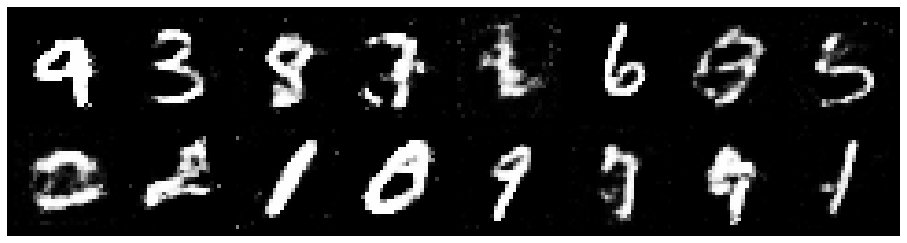

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.2888, Generator Loss: 0.8534
D(x): 0.5527, D(G(z)): 0.4490


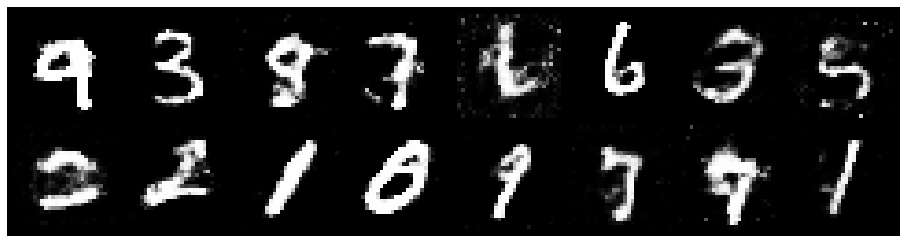

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.3208, Generator Loss: 0.8707
D(x): 0.5485, D(G(z)): 0.4709


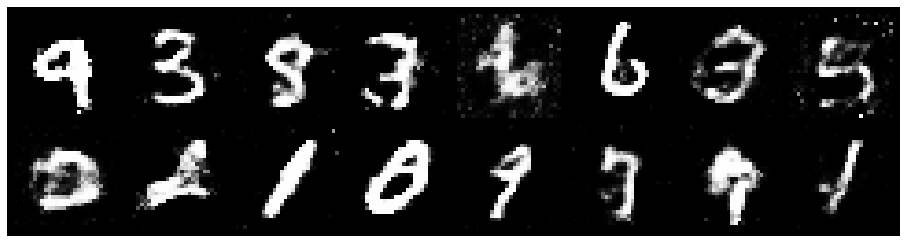

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.2874, Generator Loss: 0.7923
D(x): 0.5463, D(G(z)): 0.4593


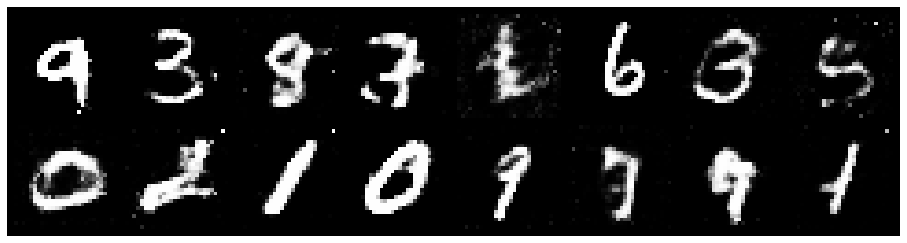

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.3308, Generator Loss: 0.8353
D(x): 0.5498, D(G(z)): 0.4709


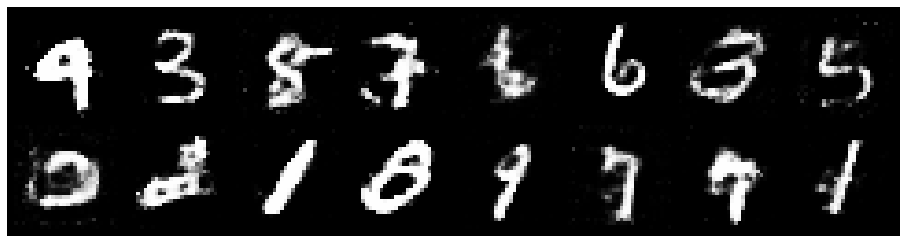

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.3388, Generator Loss: 0.8153
D(x): 0.5476, D(G(z)): 0.4698


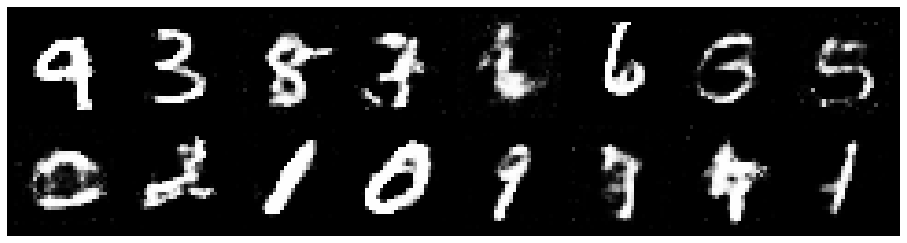

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.3254, Generator Loss: 0.9375
D(x): 0.5421, D(G(z)): 0.4573


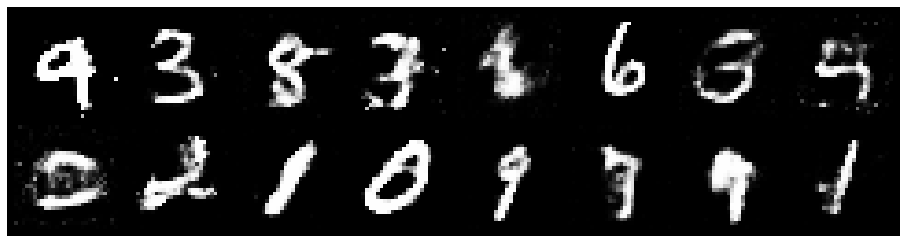

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2563, Generator Loss: 0.8389
D(x): 0.5593, D(G(z)): 0.4493


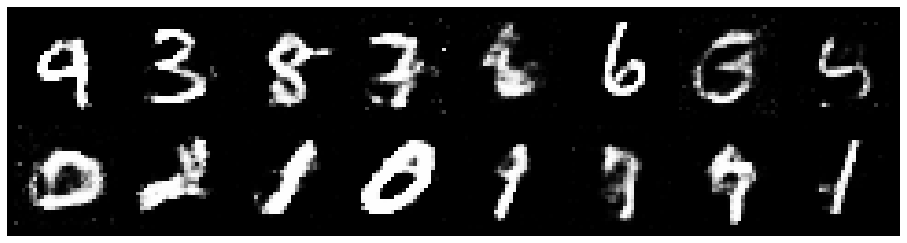

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.3964, Generator Loss: 0.8497
D(x): 0.5697, D(G(z)): 0.4855


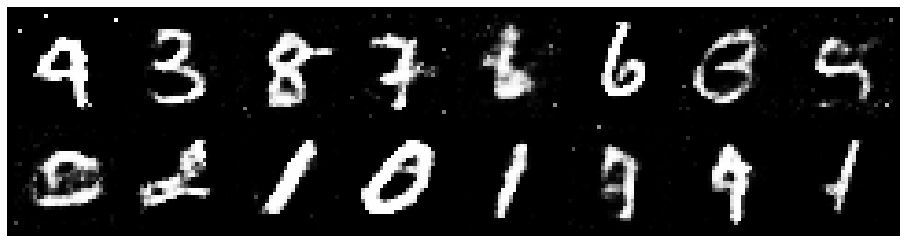

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.3454, Generator Loss: 0.8481
D(x): 0.5634, D(G(z)): 0.4956


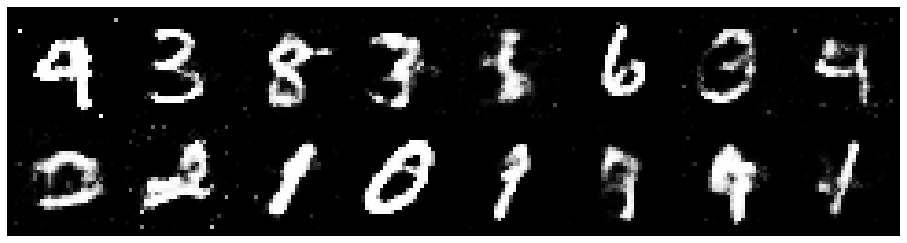

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.2924, Generator Loss: 0.7763
D(x): 0.5373, D(G(z)): 0.4617


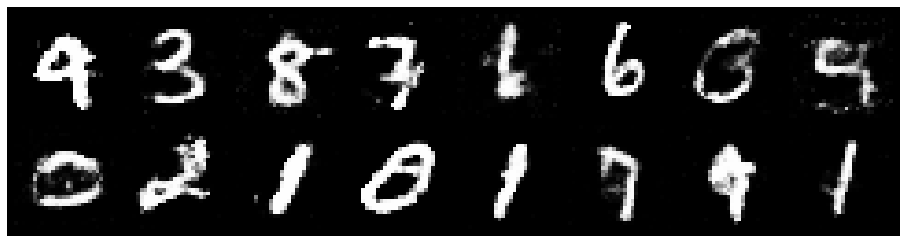

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.1990, Generator Loss: 0.8745
D(x): 0.5664, D(G(z)): 0.4321


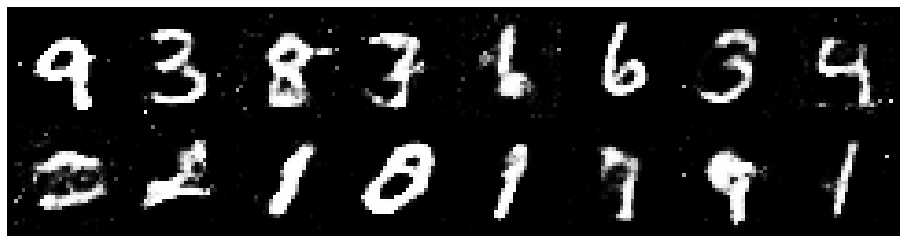

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2410, Generator Loss: 0.9259
D(x): 0.5747, D(G(z)): 0.4451


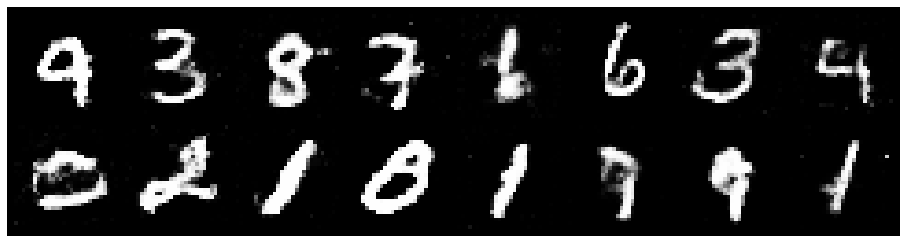

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3406, Generator Loss: 1.0827
D(x): 0.5715, D(G(z)): 0.4618


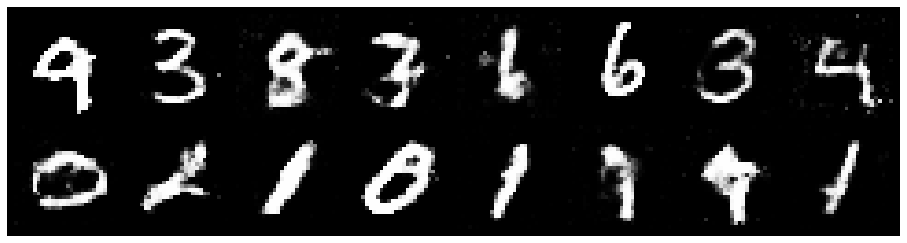

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3002, Generator Loss: 1.2506
D(x): 0.5581, D(G(z)): 0.4157


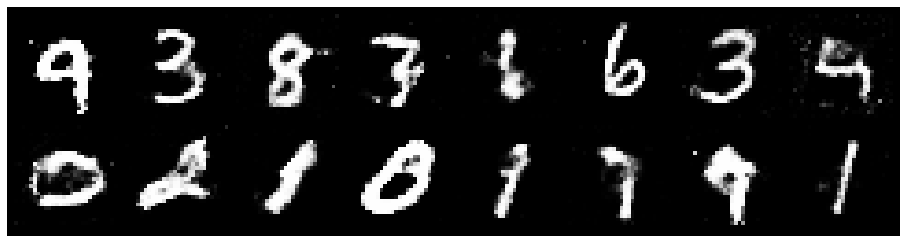

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.4399, Generator Loss: 0.7327
D(x): 0.5422, D(G(z)): 0.4947


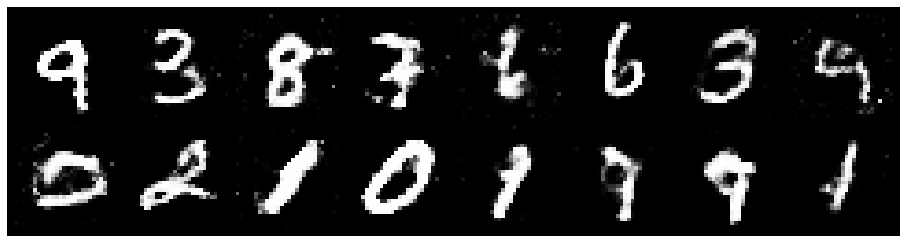

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3354, Generator Loss: 0.8183
D(x): 0.6306, D(G(z)): 0.5203


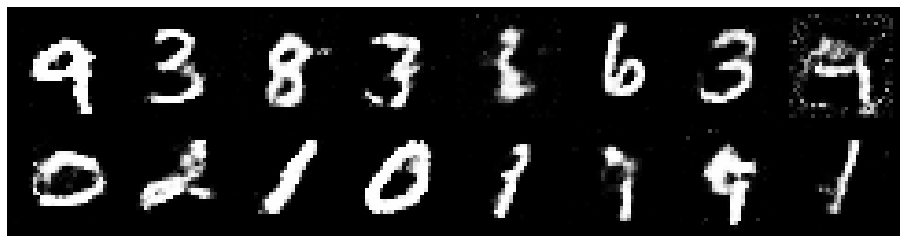

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.3374, Generator Loss: 0.9022
D(x): 0.5416, D(G(z)): 0.4239


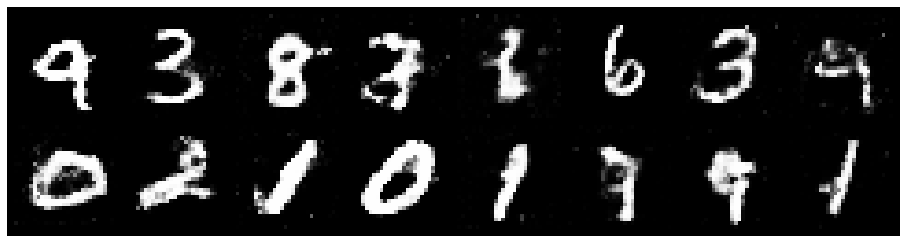

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.3399, Generator Loss: 1.0553
D(x): 0.5508, D(G(z)): 0.4483


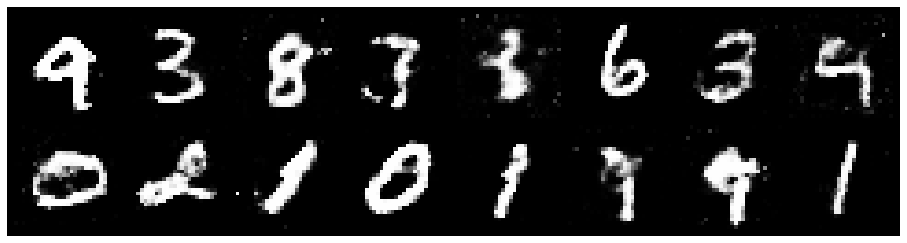

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2962, Generator Loss: 0.8728
D(x): 0.5624, D(G(z)): 0.4613


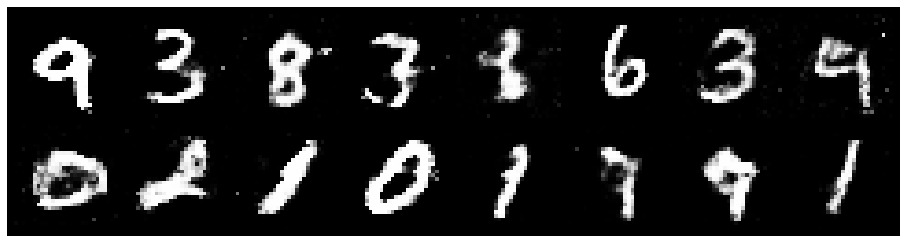

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.1612, Generator Loss: 0.9830
D(x): 0.5641, D(G(z)): 0.3912


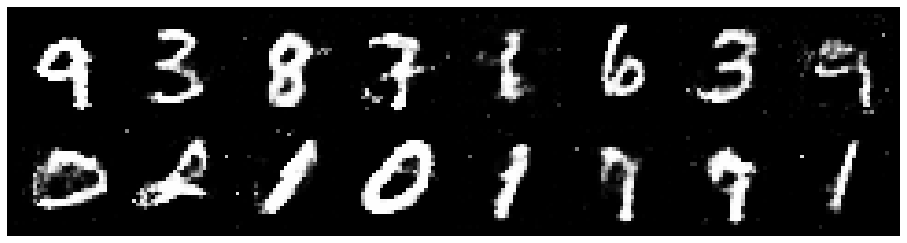

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.2264, Generator Loss: 1.0591
D(x): 0.5709, D(G(z)): 0.4227


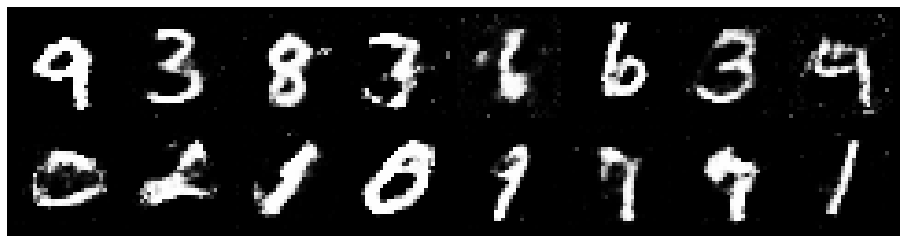

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.3756, Generator Loss: 0.9025
D(x): 0.5519, D(G(z)): 0.4803


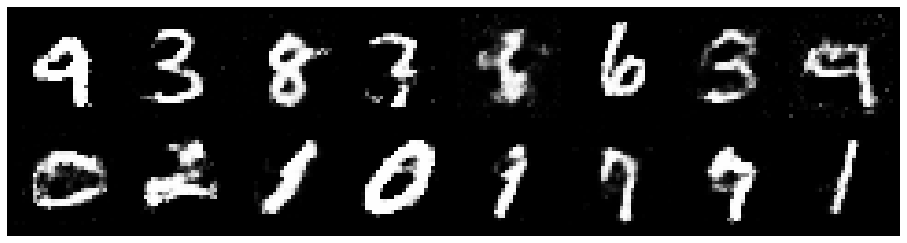

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2656, Generator Loss: 0.8544
D(x): 0.5384, D(G(z)): 0.4419


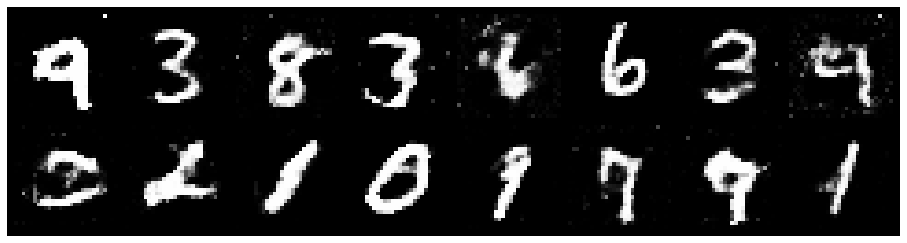

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.2367, Generator Loss: 0.9429
D(x): 0.5444, D(G(z)): 0.4305


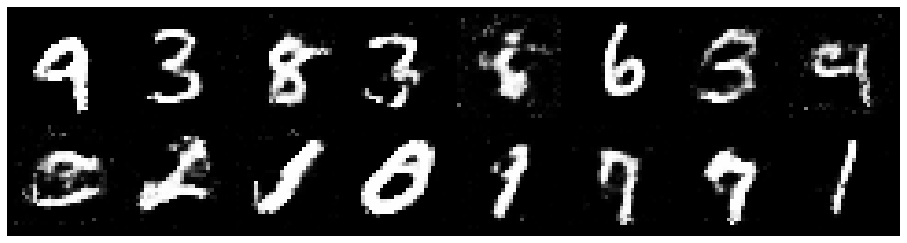

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2871, Generator Loss: 0.7859
D(x): 0.5567, D(G(z)): 0.4709


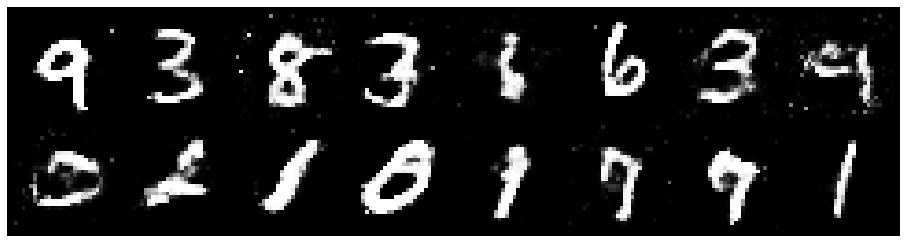

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.3134, Generator Loss: 0.8802
D(x): 0.5814, D(G(z)): 0.4772


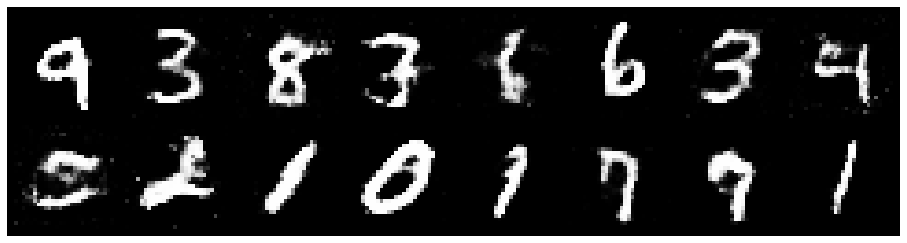

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.3535, Generator Loss: 0.8348
D(x): 0.5411, D(G(z)): 0.4629


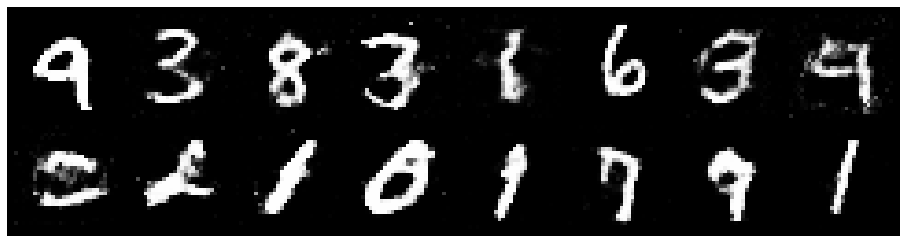

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.3816, Generator Loss: 0.8186
D(x): 0.5819, D(G(z)): 0.5192


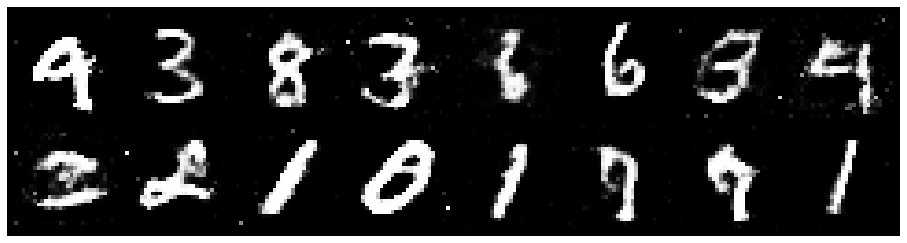

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.3587, Generator Loss: 0.8564
D(x): 0.5297, D(G(z)): 0.4824


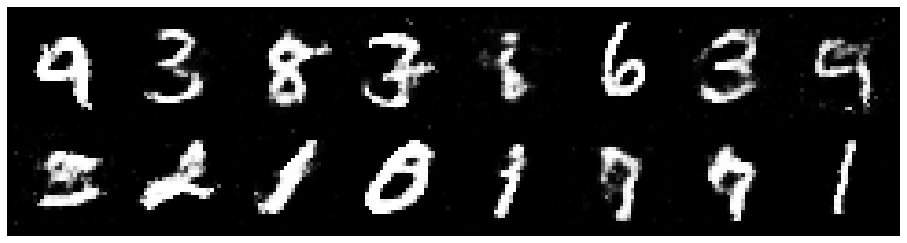

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.2815, Generator Loss: 0.7830
D(x): 0.5518, D(G(z)): 0.4763


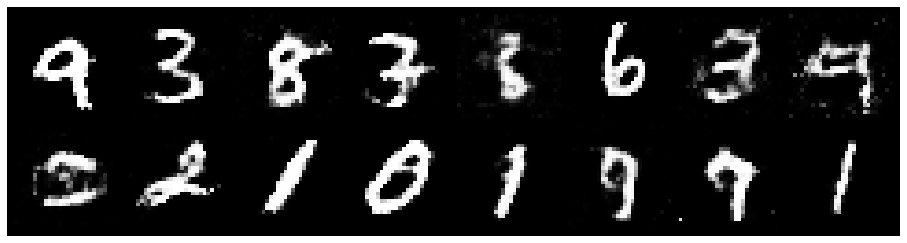

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.3235, Generator Loss: 0.8378
D(x): 0.5766, D(G(z)): 0.4713


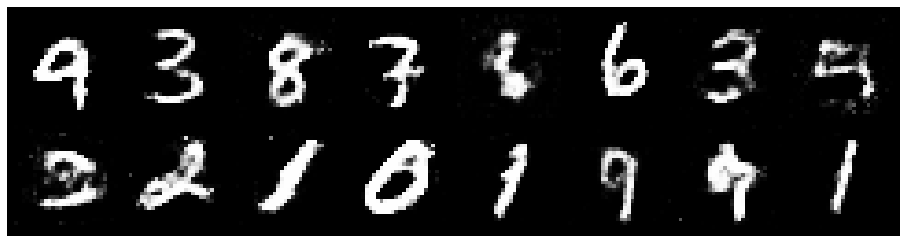

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.3814, Generator Loss: 0.7839
D(x): 0.5104, D(G(z)): 0.4824


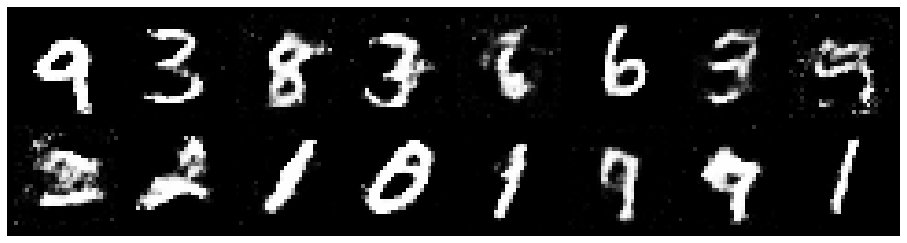

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.3095, Generator Loss: 0.9441
D(x): 0.5402, D(G(z)): 0.4522


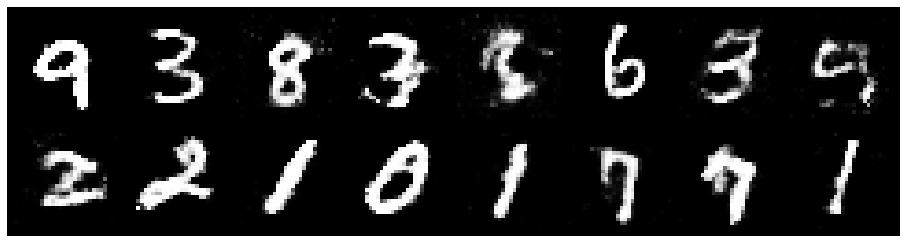

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2277, Generator Loss: 0.9279
D(x): 0.5653, D(G(z)): 0.4329


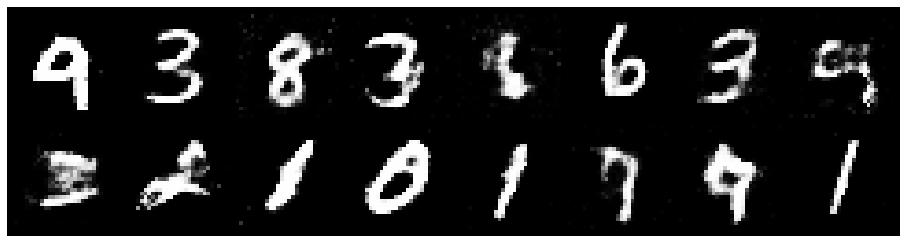

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.2423, Generator Loss: 0.8923
D(x): 0.5721, D(G(z)): 0.4485


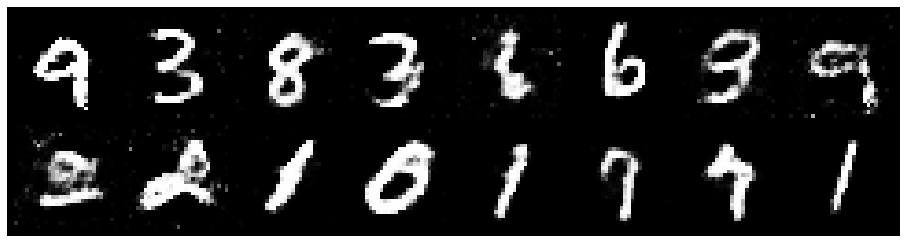

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.3296, Generator Loss: 0.7479
D(x): 0.5248, D(G(z)): 0.4608


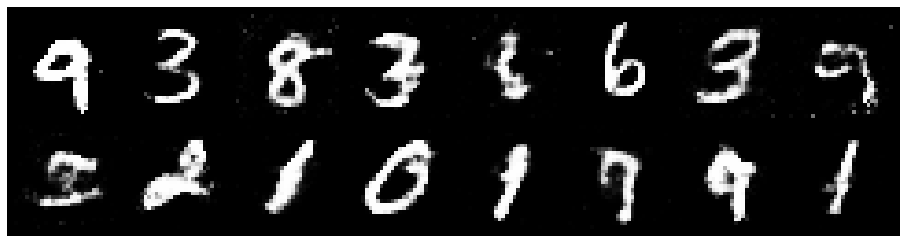

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.2929, Generator Loss: 0.8779
D(x): 0.5265, D(G(z)): 0.4494


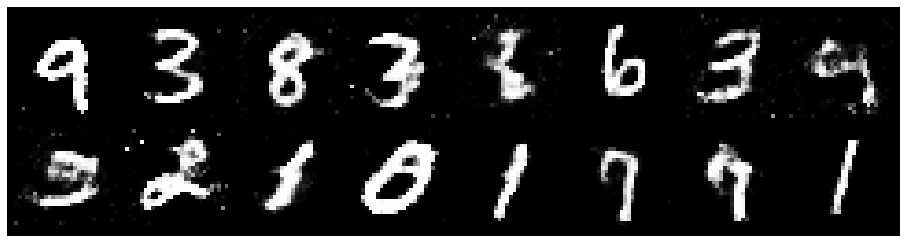

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.3008, Generator Loss: 0.8968
D(x): 0.5747, D(G(z)): 0.4792


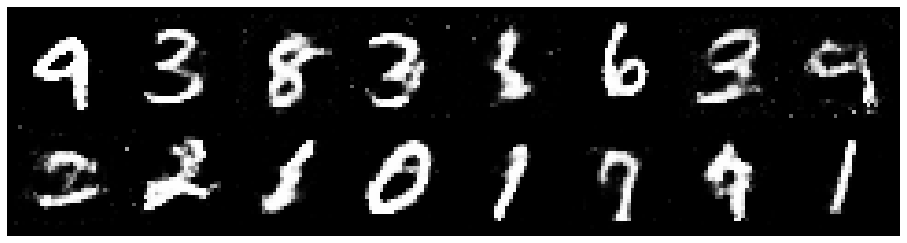

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.4058, Generator Loss: 1.0023
D(x): 0.5037, D(G(z)): 0.4431


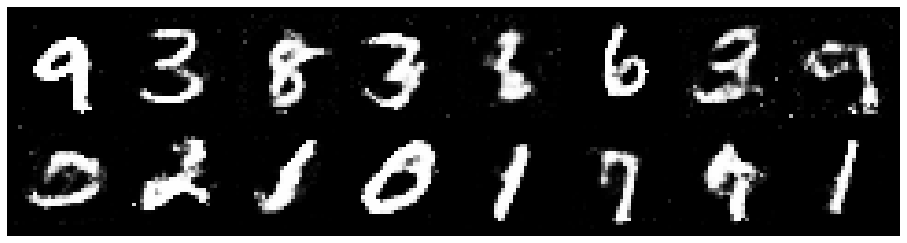

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.3032, Generator Loss: 0.9387
D(x): 0.5625, D(G(z)): 0.4435


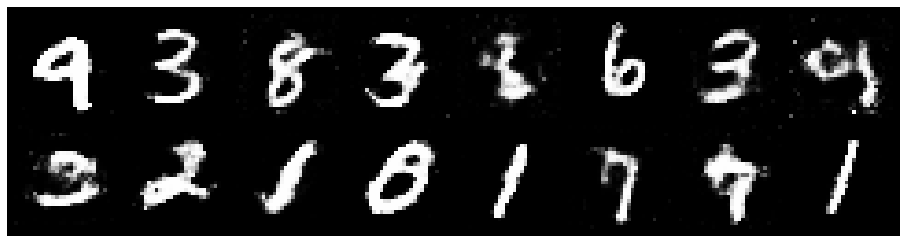

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.2545, Generator Loss: 0.9817
D(x): 0.5427, D(G(z)): 0.4029


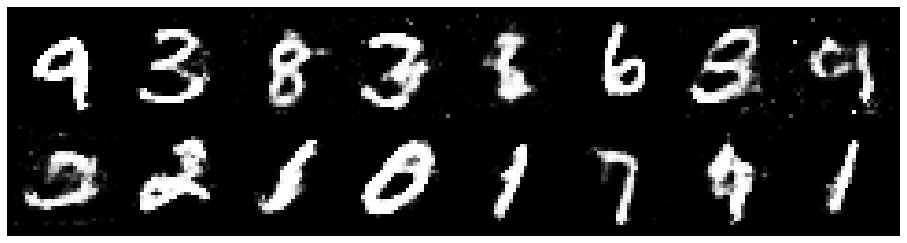

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2735, Generator Loss: 0.8103
D(x): 0.6008, D(G(z)): 0.4791


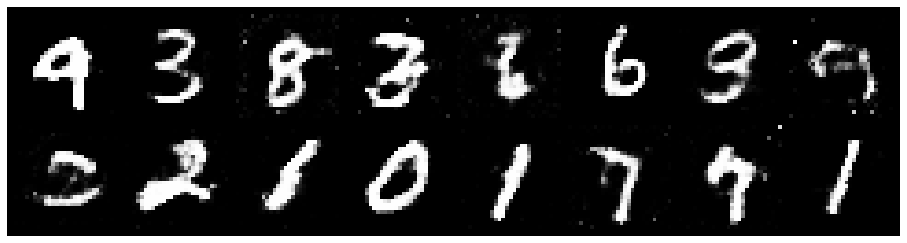

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.2692, Generator Loss: 0.8610
D(x): 0.5733, D(G(z)): 0.4531


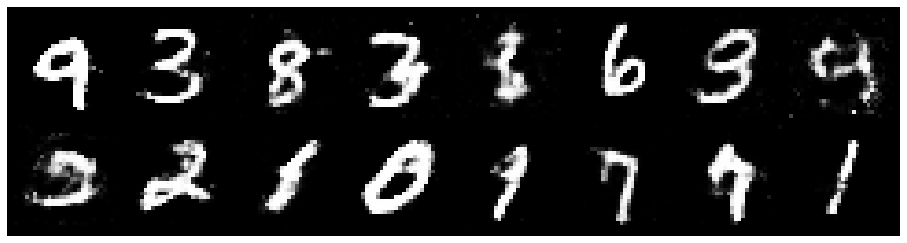

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2306, Generator Loss: 0.8832
D(x): 0.5621, D(G(z)): 0.4479


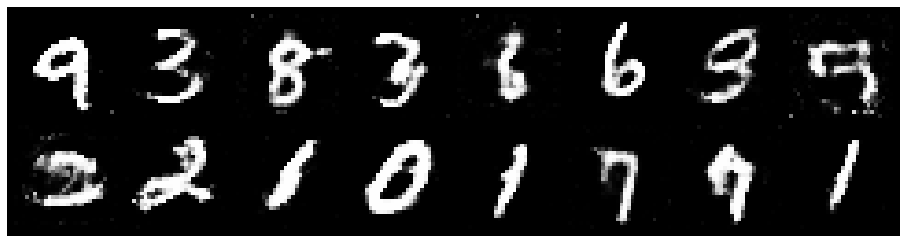

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2667, Generator Loss: 0.7761
D(x): 0.5758, D(G(z)): 0.4751


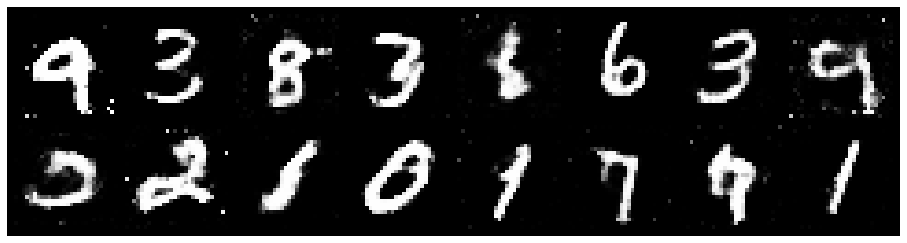

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.3228, Generator Loss: 0.8513
D(x): 0.5329, D(G(z)): 0.4509


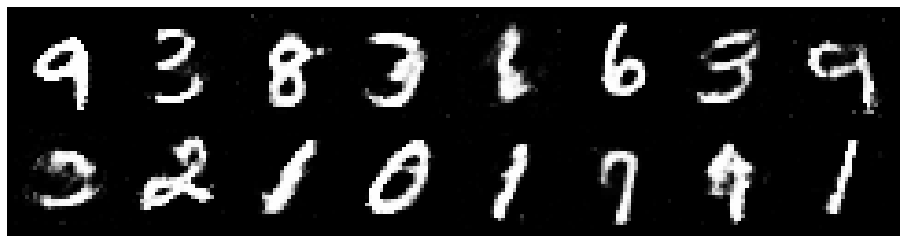

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.2960, Generator Loss: 0.7696
D(x): 0.5473, D(G(z)): 0.4678


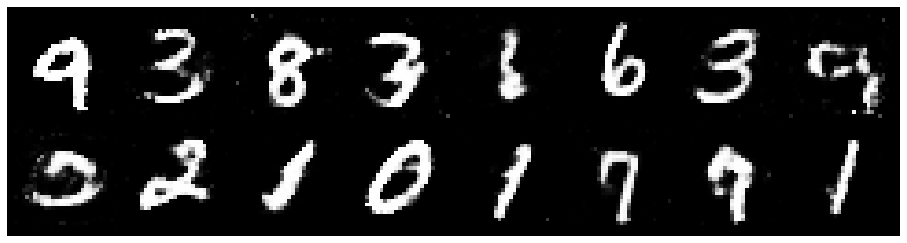

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.2605, Generator Loss: 0.8199
D(x): 0.5606, D(G(z)): 0.4539


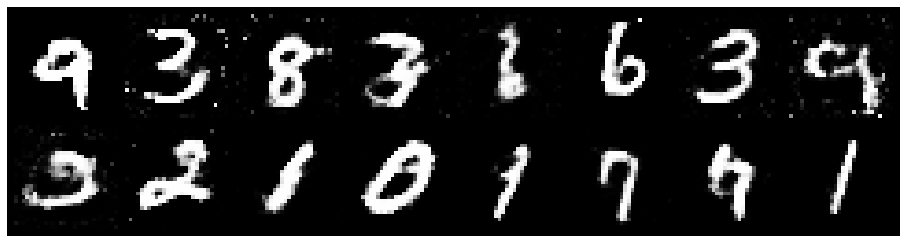

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.3785, Generator Loss: 0.8736
D(x): 0.5035, D(G(z)): 0.4510


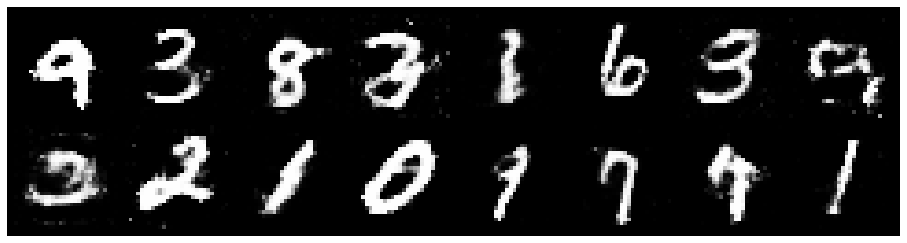

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.2804, Generator Loss: 0.7893
D(x): 0.5697, D(G(z)): 0.4687


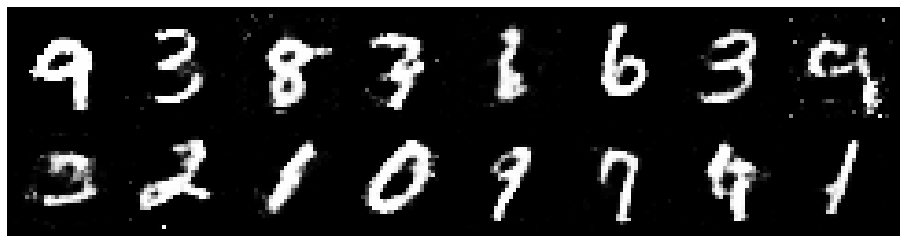

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.3059, Generator Loss: 0.9147
D(x): 0.5367, D(G(z)): 0.4287


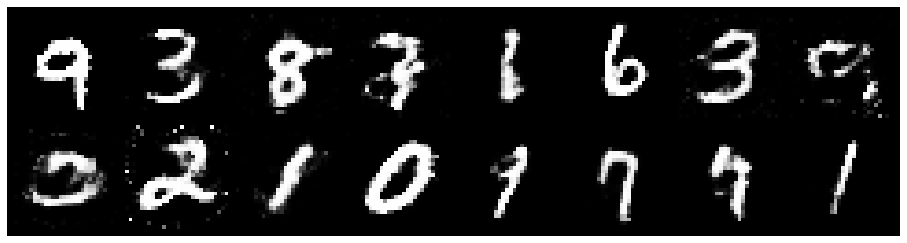

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.3505, Generator Loss: 0.8452
D(x): 0.5327, D(G(z)): 0.4506


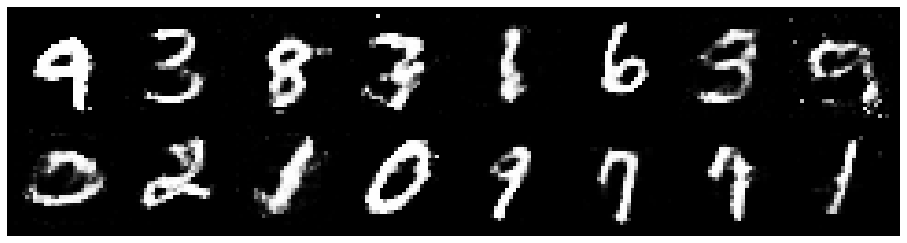

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.3174, Generator Loss: 0.8473
D(x): 0.5739, D(G(z)): 0.4661


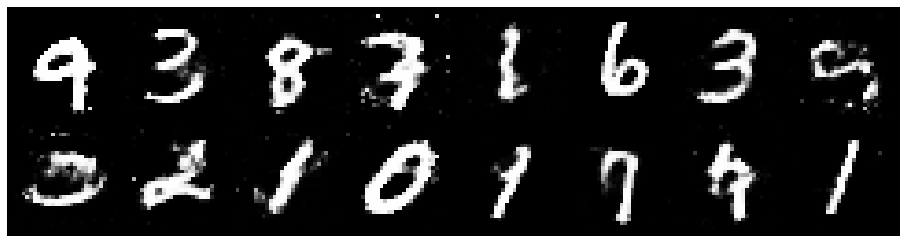

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.3322, Generator Loss: 0.8667
D(x): 0.5474, D(G(z)): 0.4516


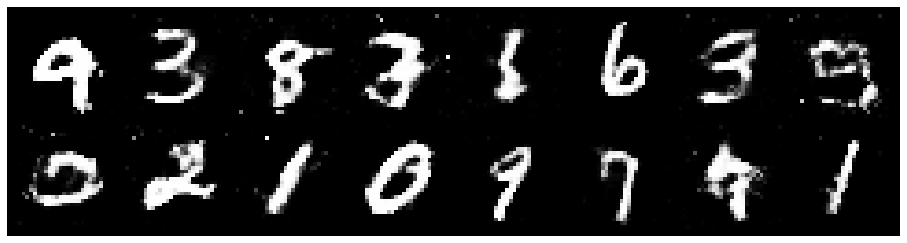

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.3878, Generator Loss: 0.9681
D(x): 0.5025, D(G(z)): 0.4332


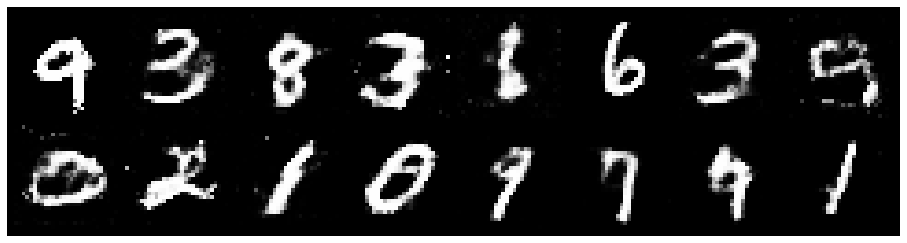

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.3452, Generator Loss: 0.7531
D(x): 0.5384, D(G(z)): 0.4801


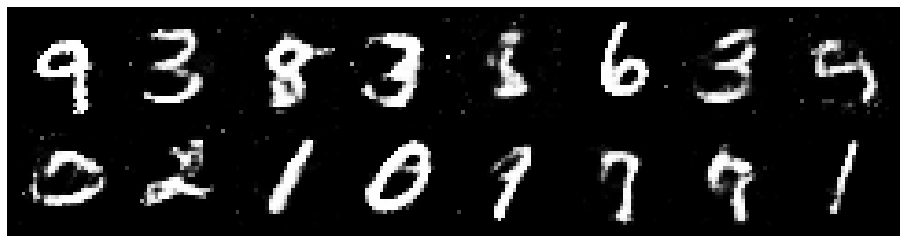

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.2293, Generator Loss: 0.8729
D(x): 0.5407, D(G(z)): 0.4193


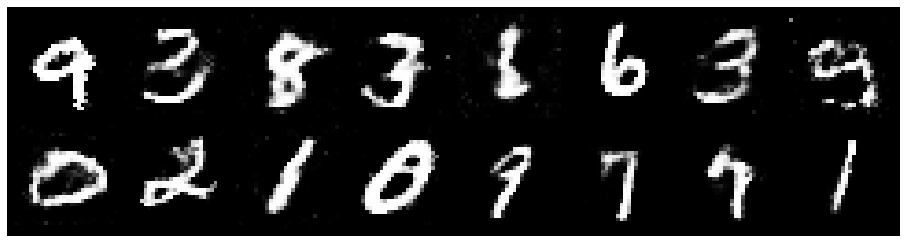

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.2810, Generator Loss: 0.8602
D(x): 0.5236, D(G(z)): 0.4272


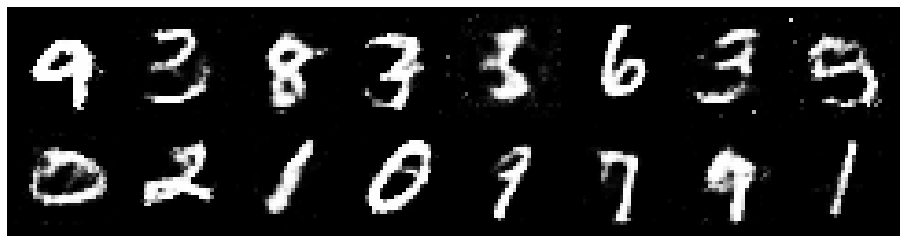

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.2600, Generator Loss: 0.8964
D(x): 0.5489, D(G(z)): 0.4292


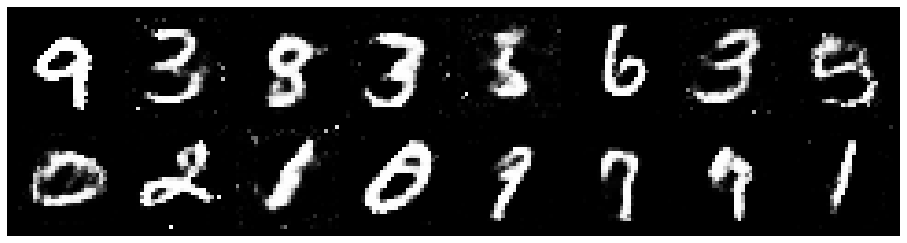

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.2713, Generator Loss: 1.1218
D(x): 0.5407, D(G(z)): 0.4265


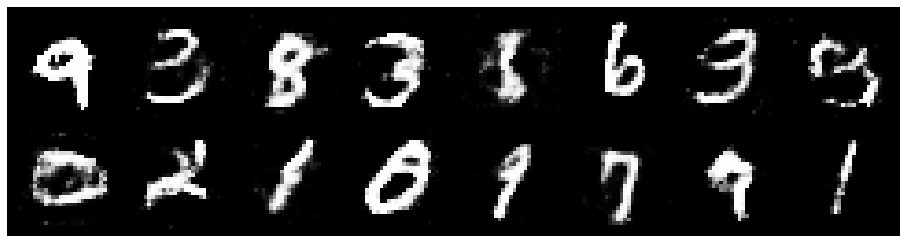

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.3087, Generator Loss: 0.9764
D(x): 0.5282, D(G(z)): 0.4310


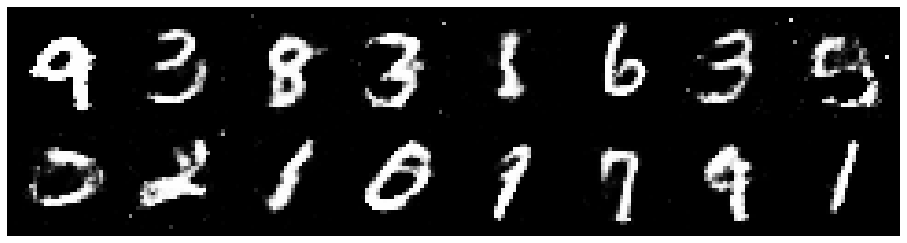

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2926, Generator Loss: 0.9401
D(x): 0.5311, D(G(z)): 0.4243


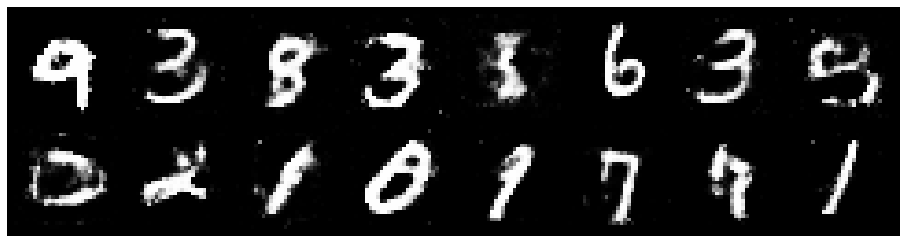

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2813, Generator Loss: 0.9368
D(x): 0.5737, D(G(z)): 0.4497


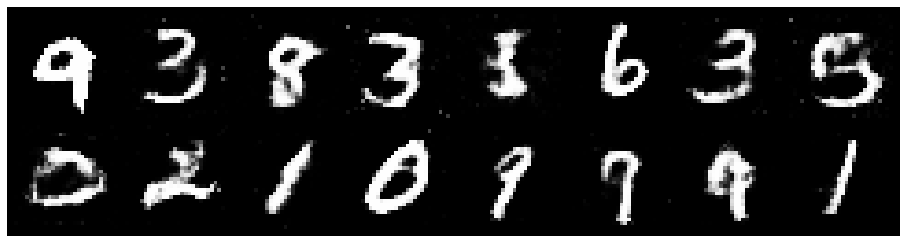

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.3156, Generator Loss: 0.8236
D(x): 0.5103, D(G(z)): 0.4179


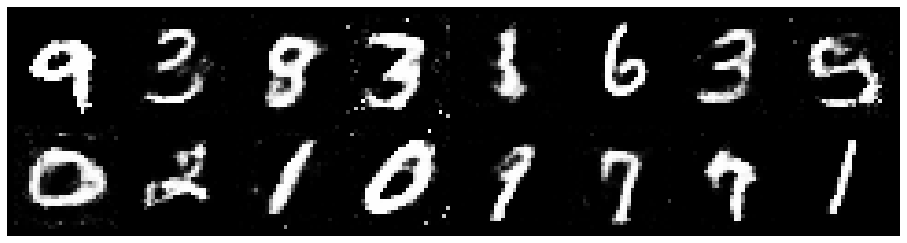

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.3583, Generator Loss: 0.7914
D(x): 0.5022, D(G(z)): 0.4599


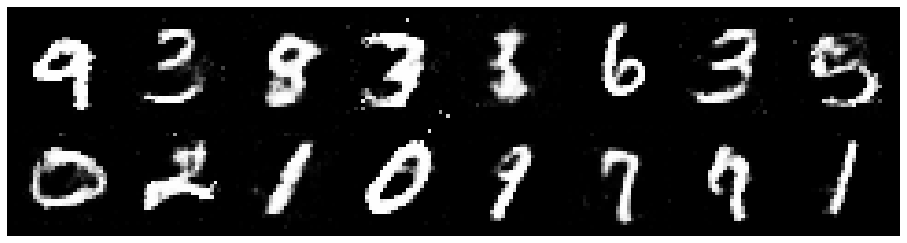

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.3543, Generator Loss: 0.7955
D(x): 0.5189, D(G(z)): 0.4684


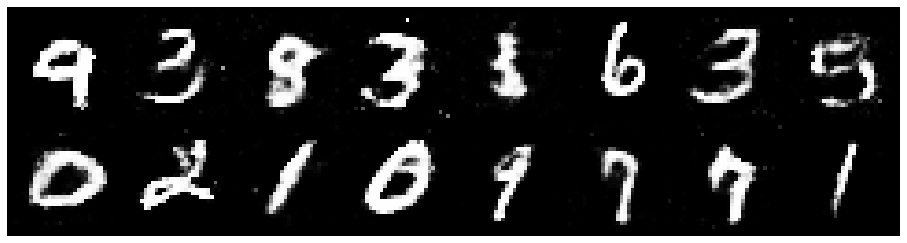

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.3483, Generator Loss: 0.7764
D(x): 0.5673, D(G(z)): 0.5005


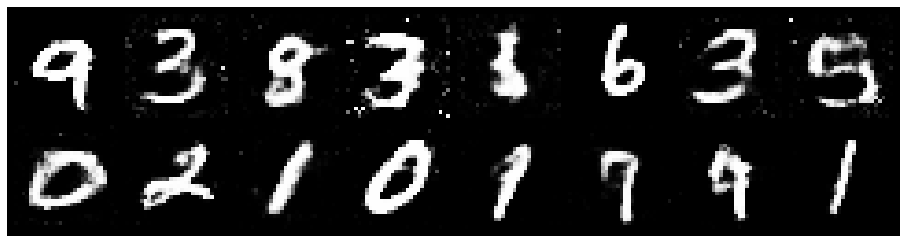

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.4520, Generator Loss: 0.8908
D(x): 0.5627, D(G(z)): 0.5038


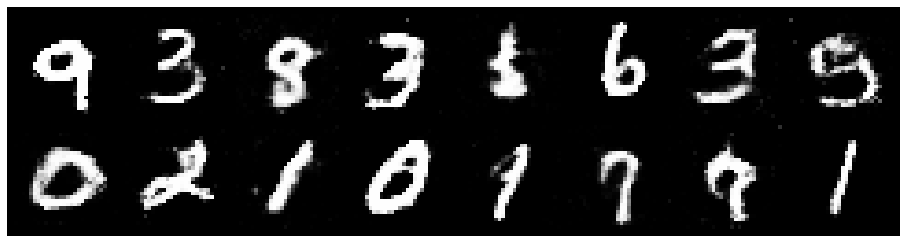

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.3538, Generator Loss: 0.8694
D(x): 0.5526, D(G(z)): 0.4860


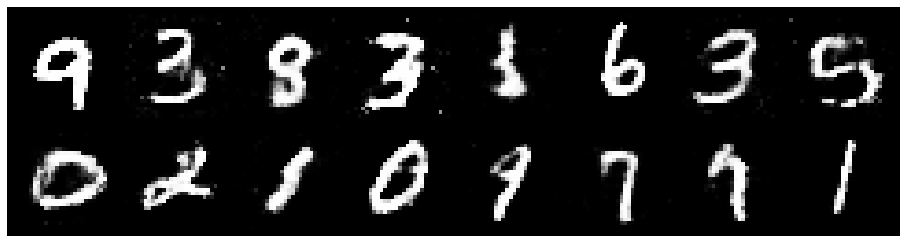

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.3470, Generator Loss: 0.8218
D(x): 0.5200, D(G(z)): 0.4510


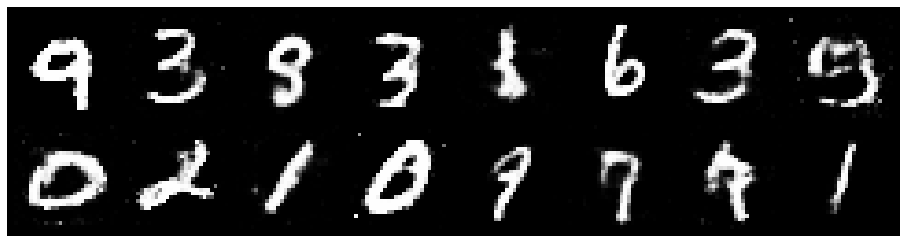

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2284, Generator Loss: 0.7724
D(x): 0.5640, D(G(z)): 0.4435


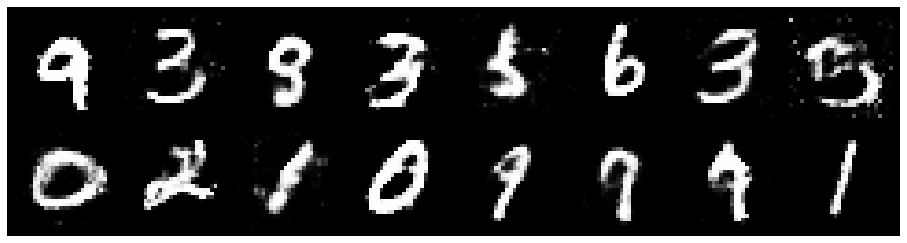

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2564, Generator Loss: 0.8549
D(x): 0.5606, D(G(z)): 0.4569


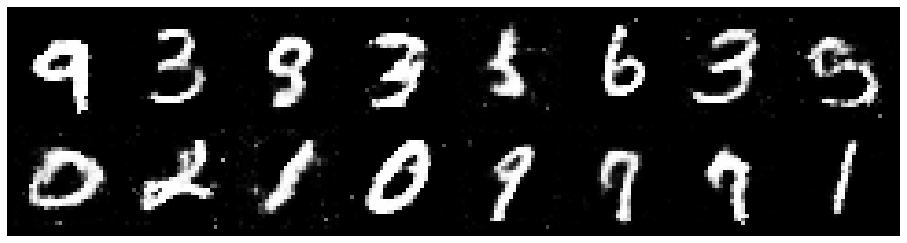

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.1872, Generator Loss: 0.8725
D(x): 0.5711, D(G(z)): 0.4214


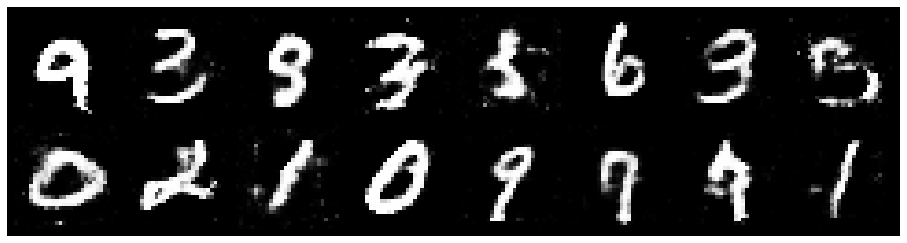

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8426
D(x): 0.5486, D(G(z)): 0.4482


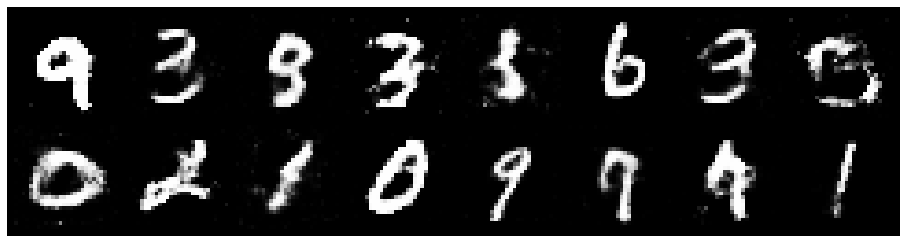

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2384, Generator Loss: 0.7913
D(x): 0.5482, D(G(z)): 0.4291


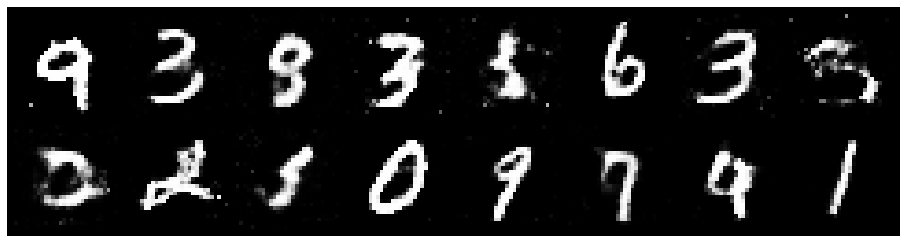

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.3054, Generator Loss: 0.9673
D(x): 0.5409, D(G(z)): 0.4511


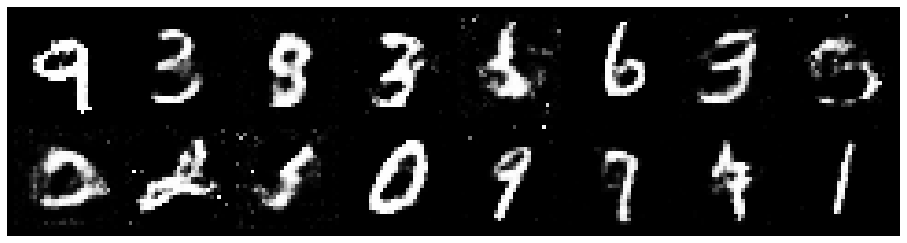

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.2589, Generator Loss: 0.8330
D(x): 0.5650, D(G(z)): 0.4647


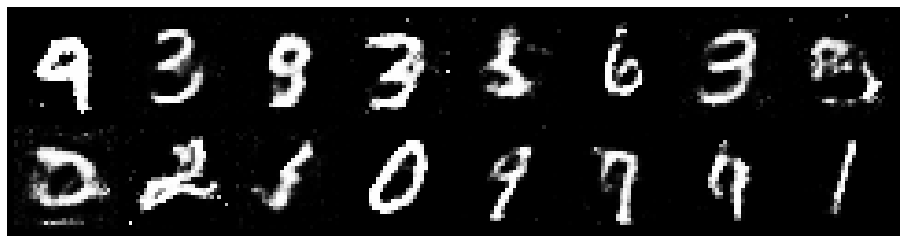

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3419, Generator Loss: 0.7423
D(x): 0.5514, D(G(z)): 0.4932


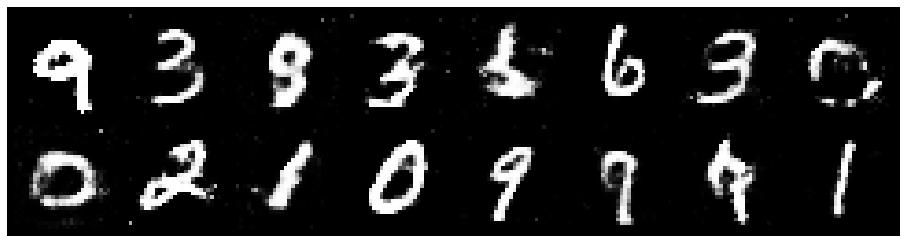

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3280, Generator Loss: 0.7661
D(x): 0.5795, D(G(z)): 0.5088


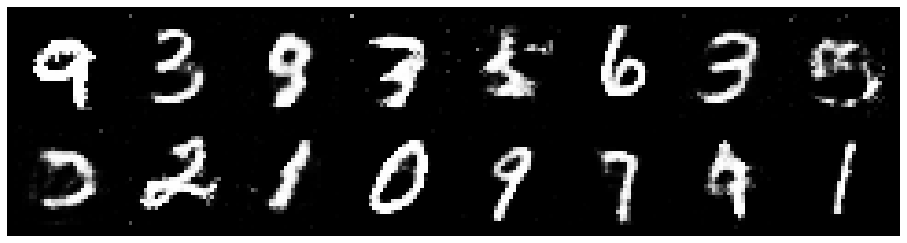

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.3283, Generator Loss: 0.7311
D(x): 0.5299, D(G(z)): 0.4812


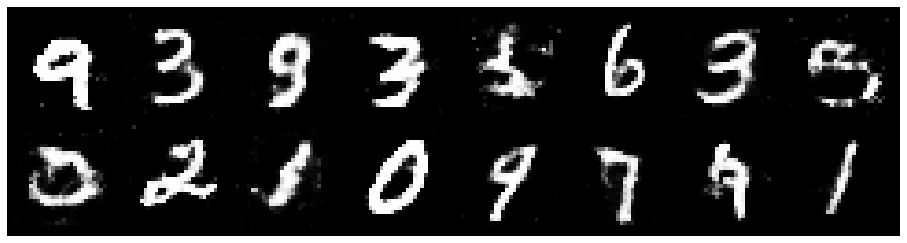

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.2981, Generator Loss: 0.7767
D(x): 0.5480, D(G(z)): 0.4539


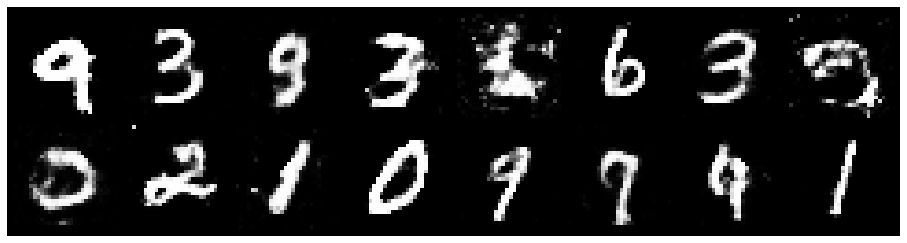

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.3160, Generator Loss: 0.8331
D(x): 0.5565, D(G(z)): 0.4697


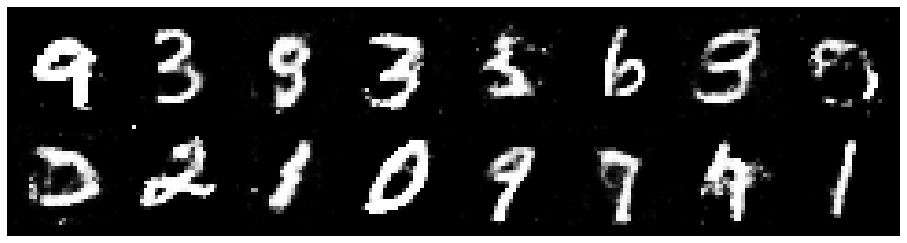

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.3044, Generator Loss: 0.8535
D(x): 0.5524, D(G(z)): 0.4482


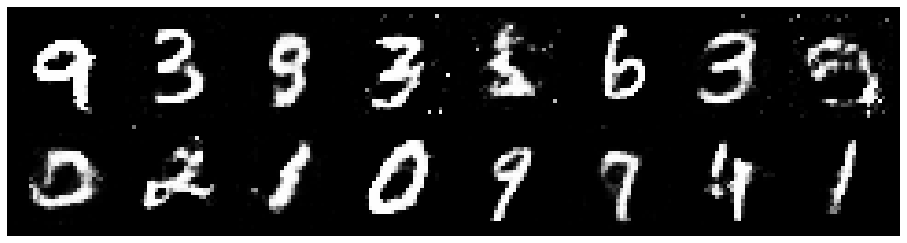

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2245, Generator Loss: 1.0795
D(x): 0.5648, D(G(z)): 0.4132


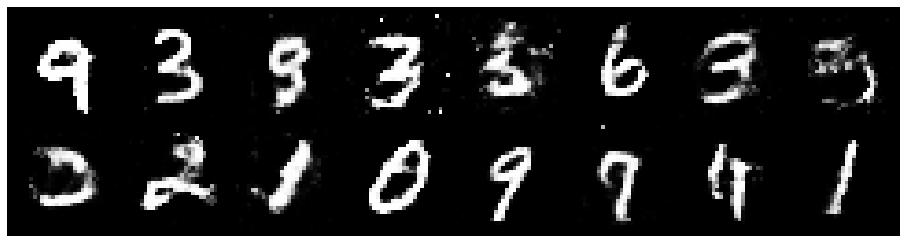

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.3049, Generator Loss: 0.9746
D(x): 0.5345, D(G(z)): 0.4350


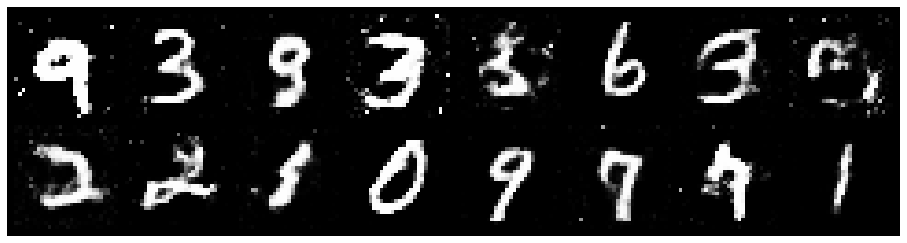

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.1928, Generator Loss: 1.0140
D(x): 0.5539, D(G(z)): 0.4004


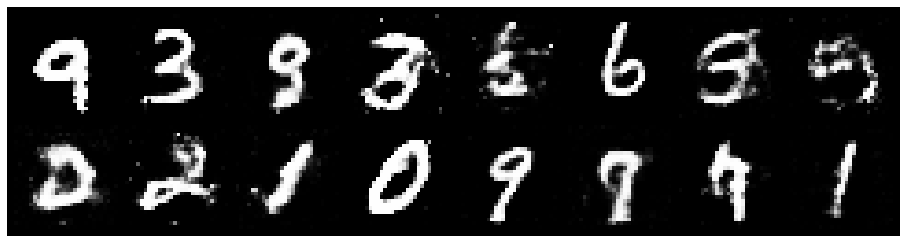

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2272, Generator Loss: 0.8443
D(x): 0.5742, D(G(z)): 0.4550


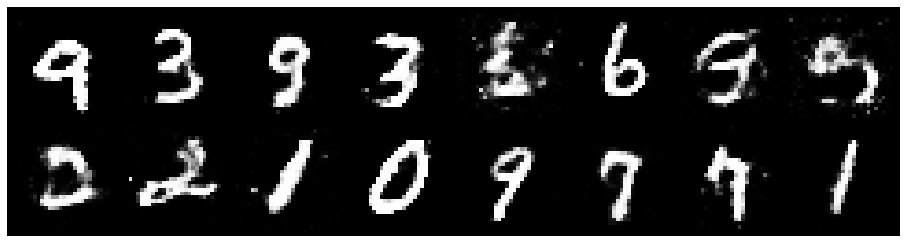

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3565, Generator Loss: 0.7606
D(x): 0.5444, D(G(z)): 0.4883


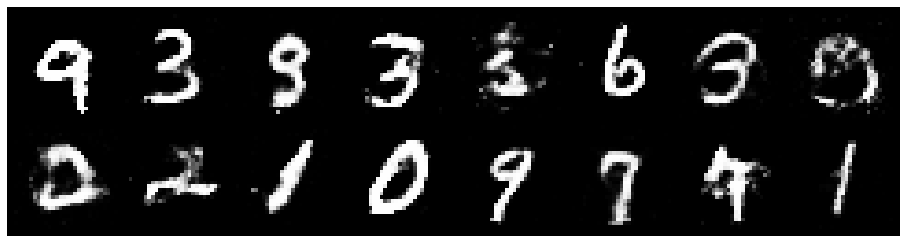

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2807, Generator Loss: 0.7784
D(x): 0.5359, D(G(z)): 0.4481


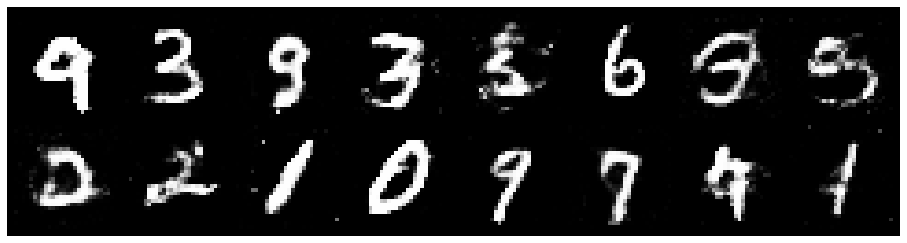

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.3273, Generator Loss: 0.8595
D(x): 0.5392, D(G(z)): 0.4616


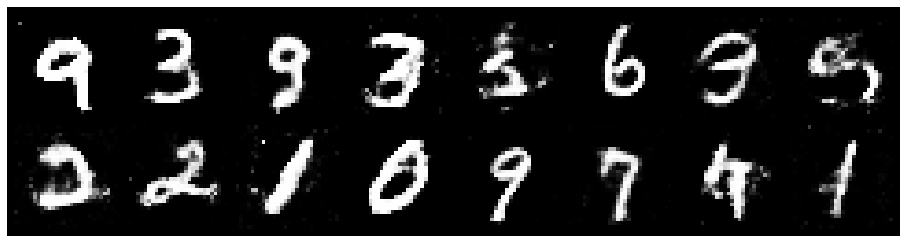

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.3681, Generator Loss: 0.8313
D(x): 0.5585, D(G(z)): 0.4913


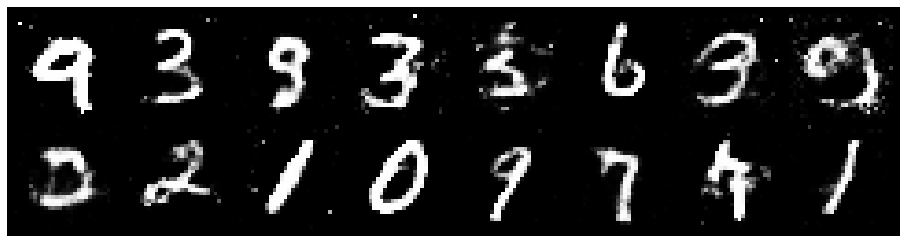

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.3528, Generator Loss: 0.7432
D(x): 0.5468, D(G(z)): 0.4698


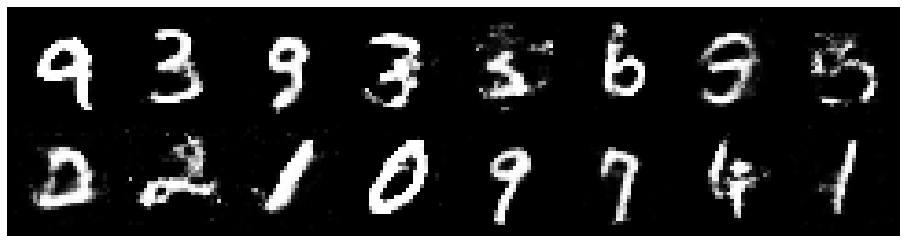

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.3163, Generator Loss: 1.0103
D(x): 0.5695, D(G(z)): 0.4561


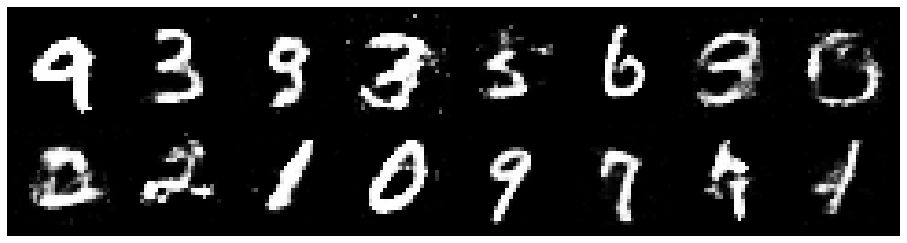

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.4192, Generator Loss: 0.6766
D(x): 0.6098, D(G(z)): 0.5474


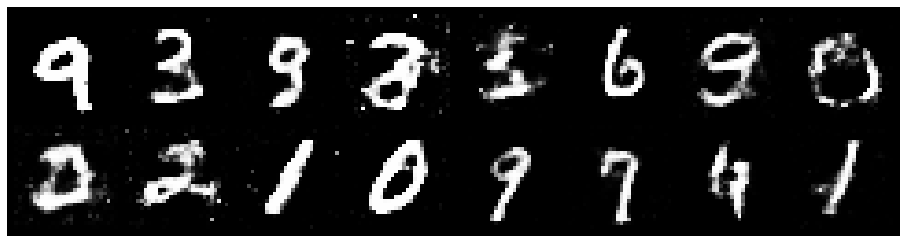

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.3519, Generator Loss: 0.8306
D(x): 0.5787, D(G(z)): 0.4908


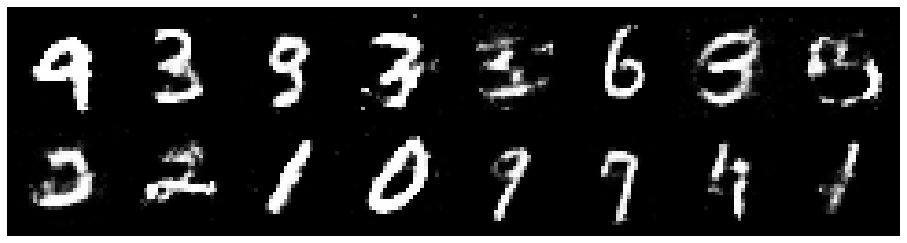

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.3319, Generator Loss: 0.8188
D(x): 0.5734, D(G(z)): 0.4896


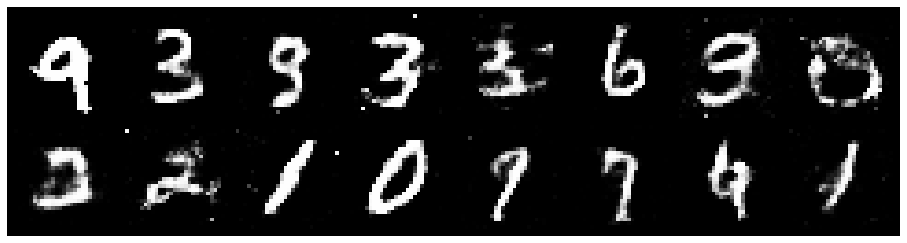

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.3145, Generator Loss: 0.9852
D(x): 0.5058, D(G(z)): 0.4139


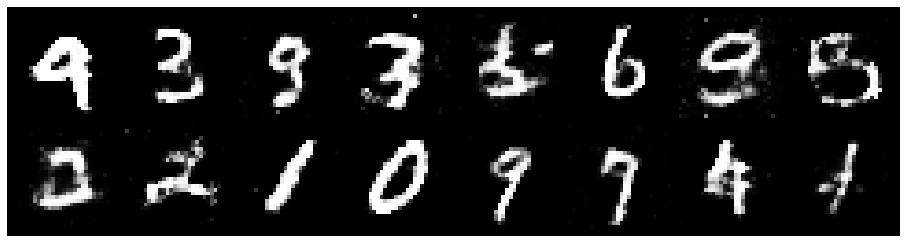

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.3251, Generator Loss: 0.8780
D(x): 0.5713, D(G(z)): 0.4852


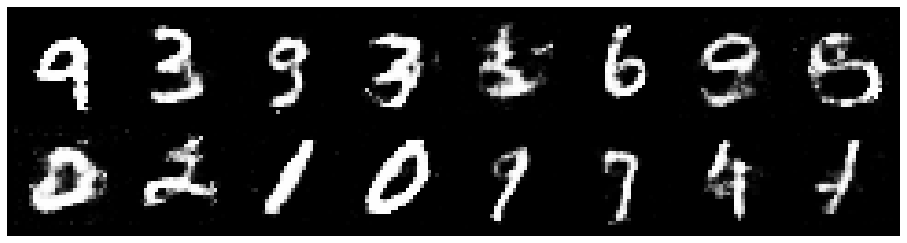

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.4011, Generator Loss: 0.8683
D(x): 0.5221, D(G(z)): 0.4759


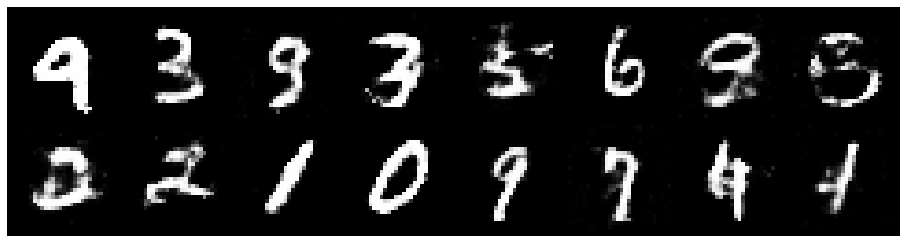

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2349, Generator Loss: 0.9059
D(x): 0.5817, D(G(z)): 0.4422


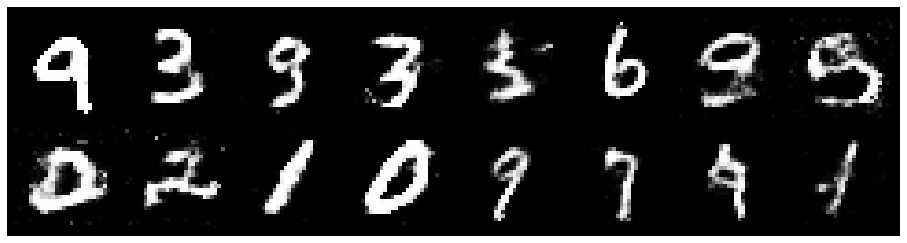

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.4010, Generator Loss: 0.8470
D(x): 0.5184, D(G(z)): 0.4782


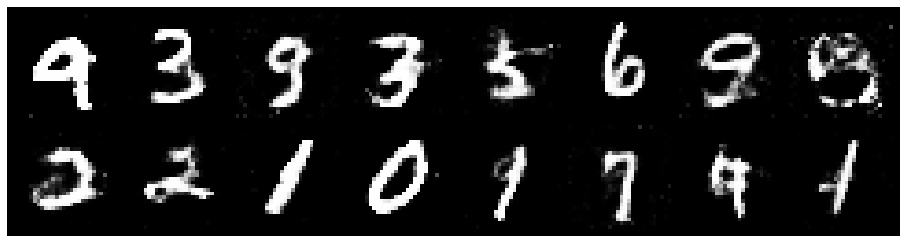

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.2716, Generator Loss: 0.9378
D(x): 0.5692, D(G(z)): 0.4429


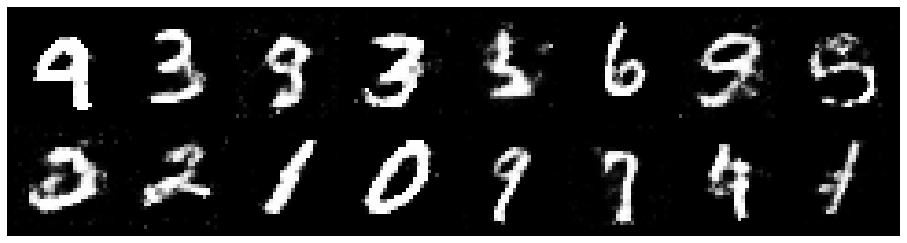

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.2540, Generator Loss: 0.8893
D(x): 0.5267, D(G(z)): 0.4079


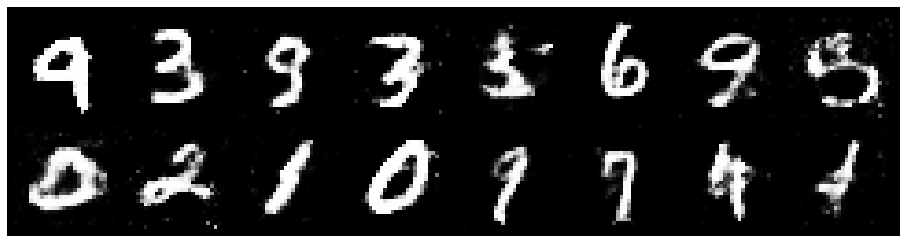

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2687, Generator Loss: 0.9090
D(x): 0.5607, D(G(z)): 0.4339


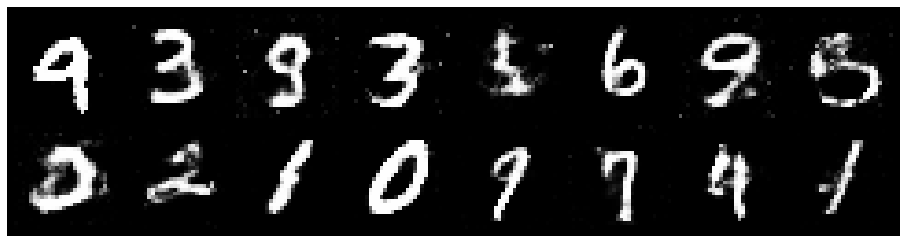

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2740, Generator Loss: 0.9330
D(x): 0.5835, D(G(z)): 0.4486


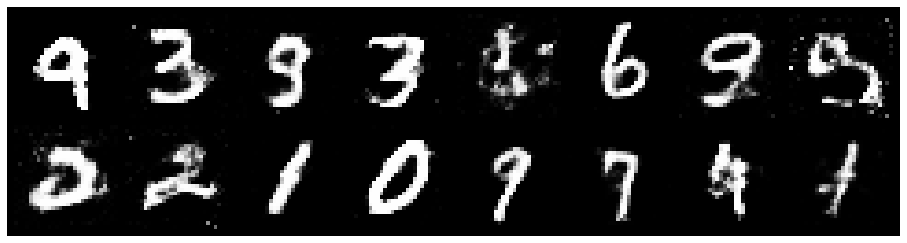

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.1651, Generator Loss: 1.0645
D(x): 0.5781, D(G(z)): 0.4053


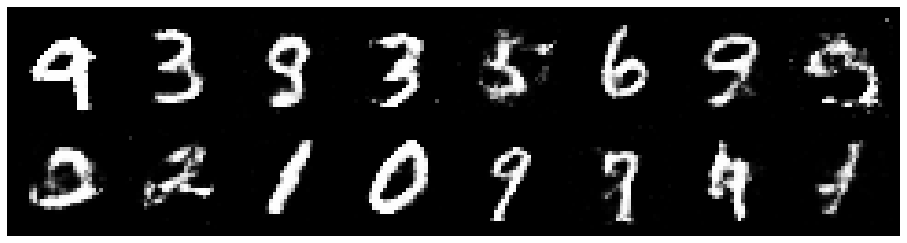

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.2215, Generator Loss: 0.9217
D(x): 0.5563, D(G(z)): 0.4269


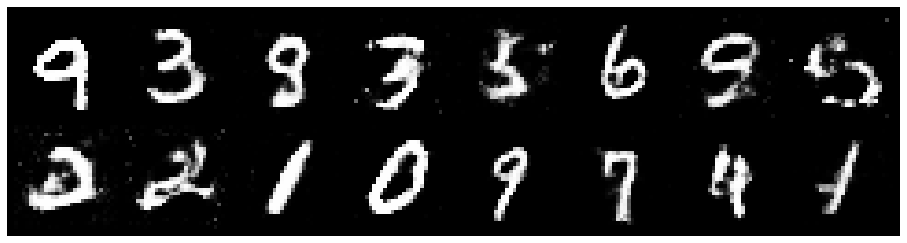

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2577, Generator Loss: 0.8389
D(x): 0.5436, D(G(z)): 0.4386


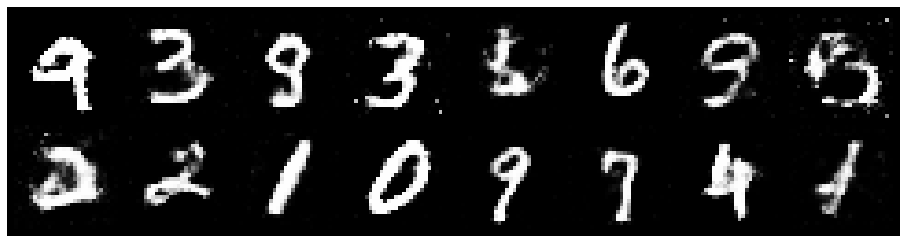

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2856, Generator Loss: 0.7317
D(x): 0.5629, D(G(z)): 0.4651


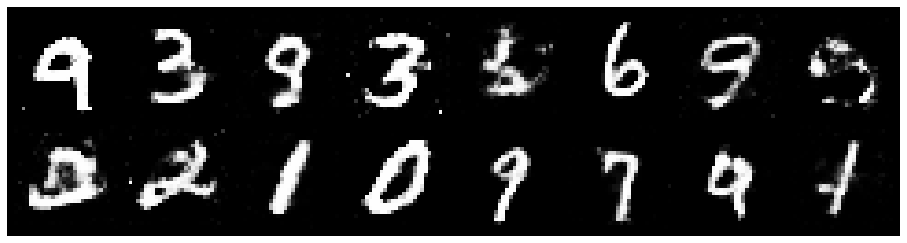

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.3454, Generator Loss: 0.8963
D(x): 0.5304, D(G(z)): 0.4618


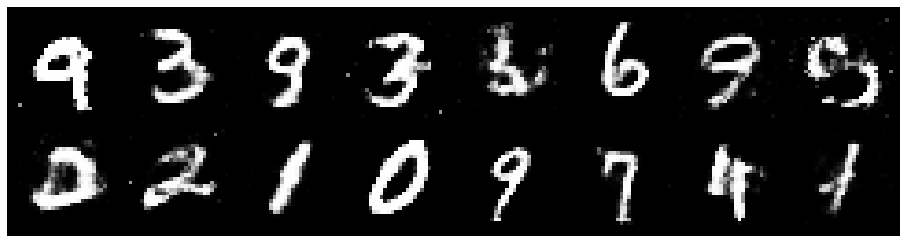

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2431, Generator Loss: 0.8315
D(x): 0.5202, D(G(z)): 0.4091


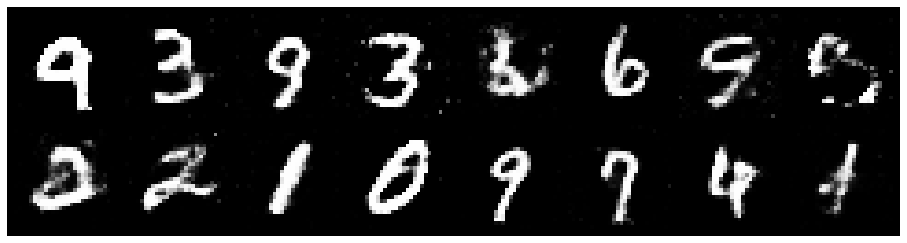

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.3187, Generator Loss: 0.8637
D(x): 0.5648, D(G(z)): 0.4876


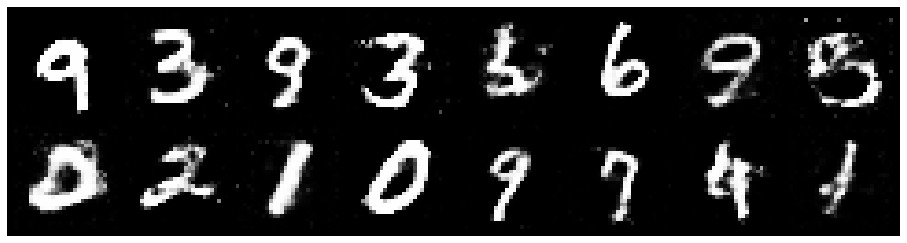

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.1578, Generator Loss: 0.9748
D(x): 0.5932, D(G(z)): 0.4035


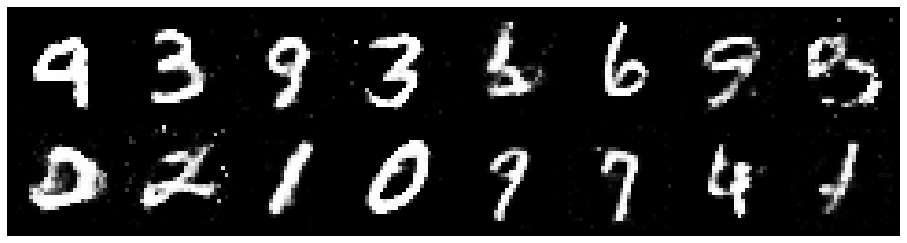

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.2442, Generator Loss: 0.8748
D(x): 0.5644, D(G(z)): 0.4452


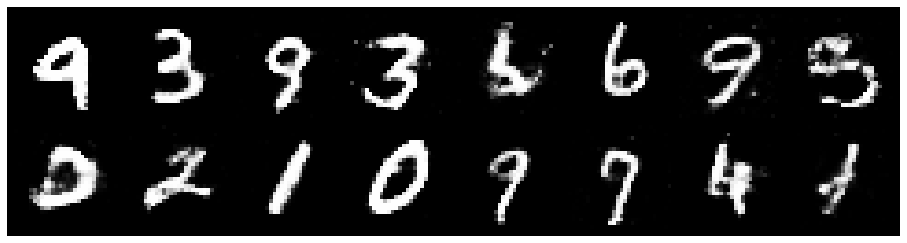

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.2319, Generator Loss: 0.8642
D(x): 0.5429, D(G(z)): 0.4228


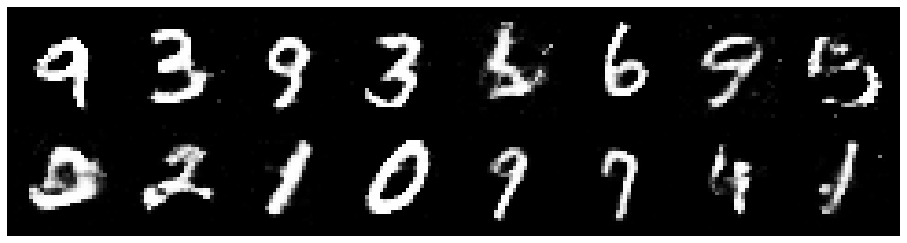

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.3483, Generator Loss: 0.9220
D(x): 0.5158, D(G(z)): 0.4543


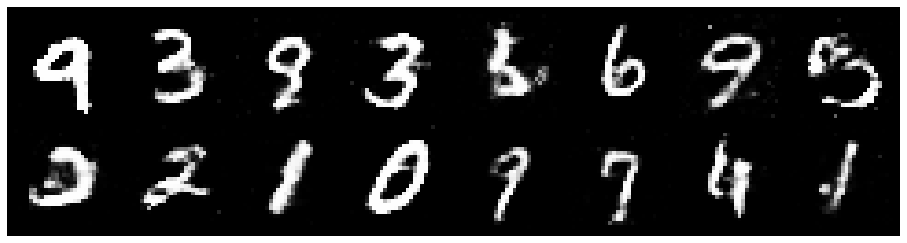

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.2865, Generator Loss: 0.9272
D(x): 0.5474, D(G(z)): 0.4449


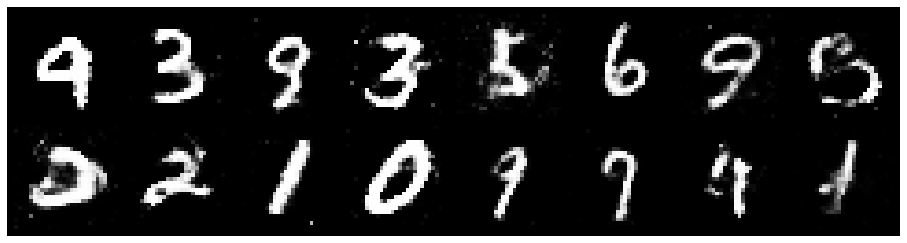

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.2779, Generator Loss: 0.8733
D(x): 0.5579, D(G(z)): 0.4609


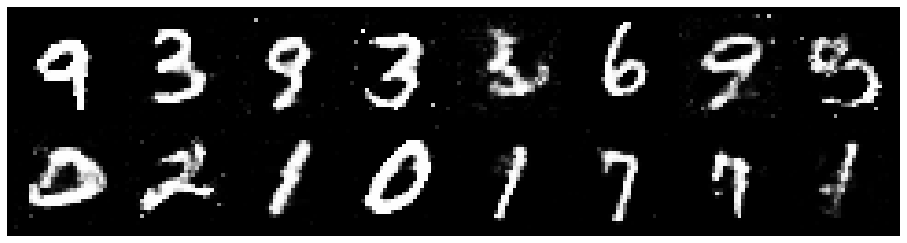

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3149, Generator Loss: 0.8553
D(x): 0.5630, D(G(z)): 0.4785


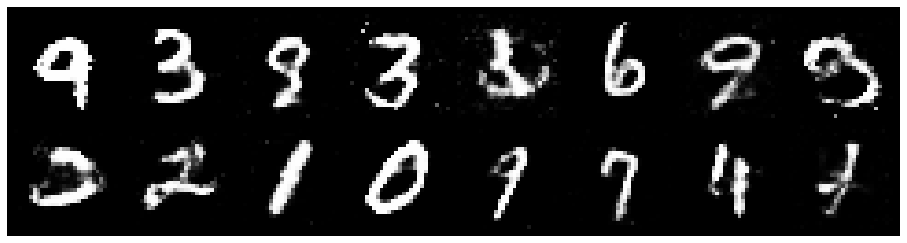

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.3708, Generator Loss: 0.8961
D(x): 0.5557, D(G(z)): 0.4710


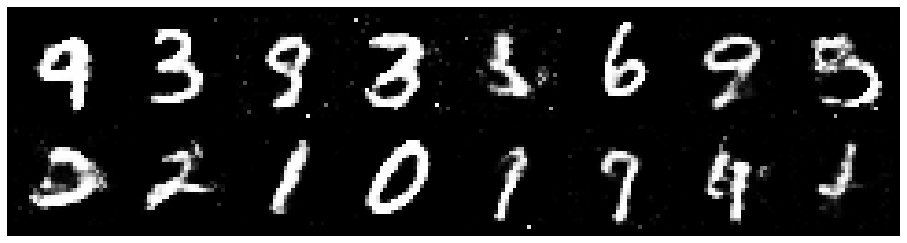

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2077, Generator Loss: 1.0370
D(x): 0.5685, D(G(z)): 0.4178


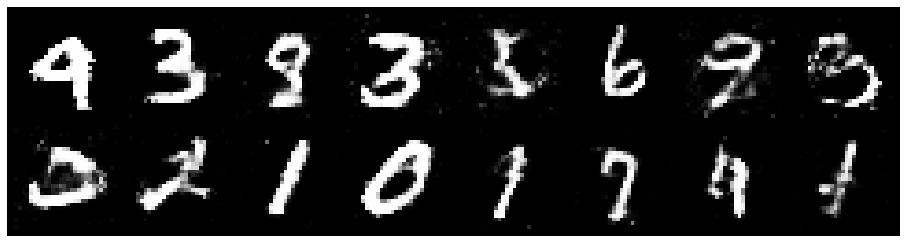

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2160, Generator Loss: 0.8908
D(x): 0.5780, D(G(z)): 0.4488


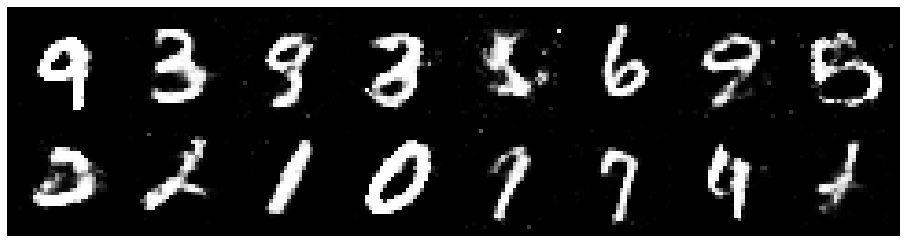

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.2932, Generator Loss: 0.8762
D(x): 0.5753, D(G(z)): 0.4839


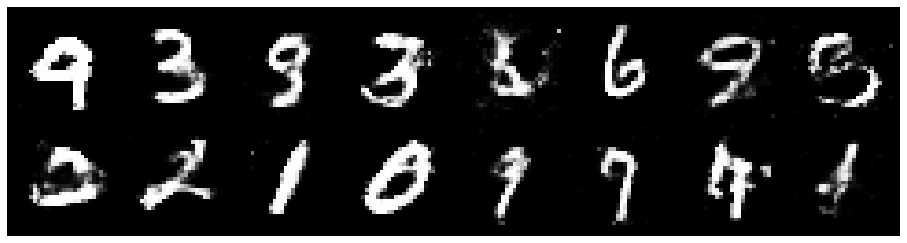

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2884, Generator Loss: 0.8965
D(x): 0.5225, D(G(z)): 0.4345


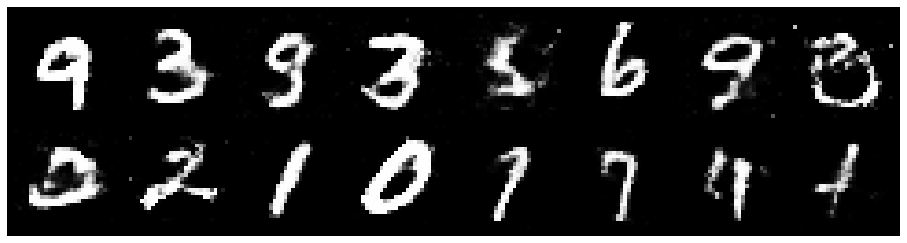

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2304, Generator Loss: 1.0622
D(x): 0.5604, D(G(z)): 0.4363


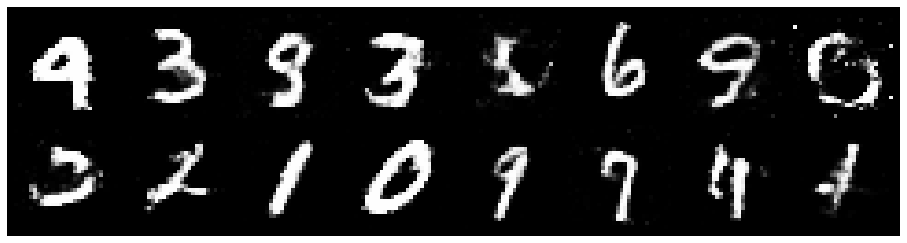

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.2746, Generator Loss: 0.8665
D(x): 0.5408, D(G(z)): 0.4376


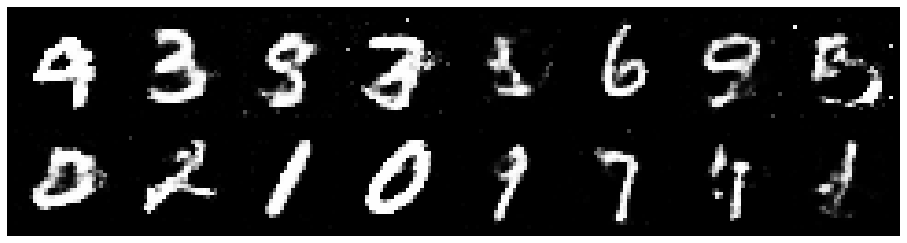

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2595, Generator Loss: 0.8425
D(x): 0.5623, D(G(z)): 0.4590


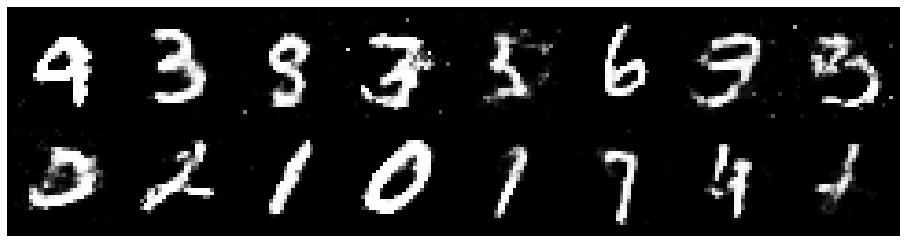

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.2698, Generator Loss: 0.7695
D(x): 0.5602, D(G(z)): 0.4717


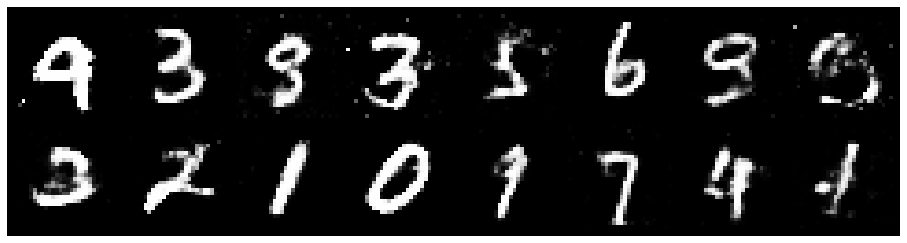

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.2949, Generator Loss: 0.8847
D(x): 0.5490, D(G(z)): 0.4509


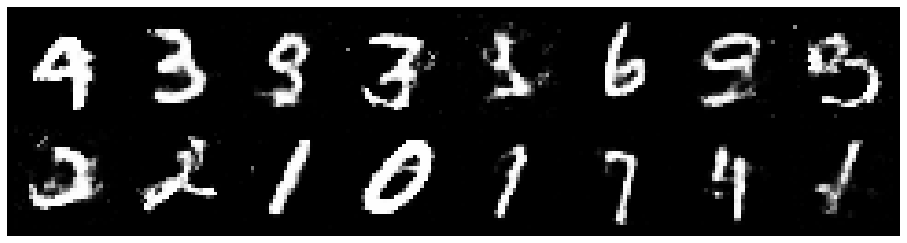

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2616, Generator Loss: 0.7559
D(x): 0.5591, D(G(z)): 0.4734


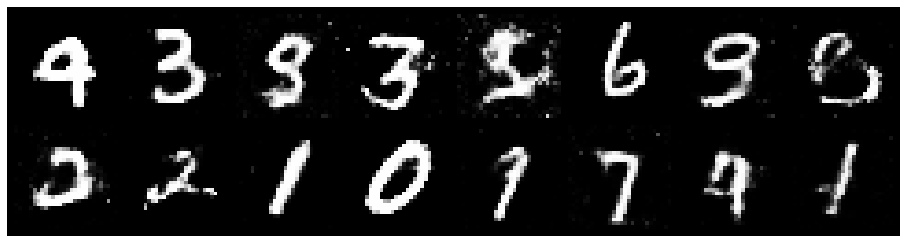

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.2793, Generator Loss: 0.8785
D(x): 0.5462, D(G(z)): 0.4568


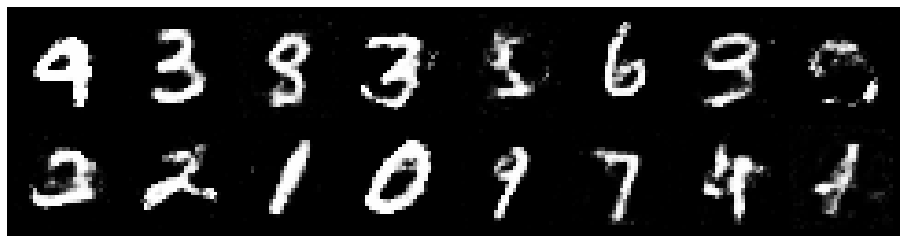

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2913, Generator Loss: 0.8857
D(x): 0.5101, D(G(z)): 0.4174


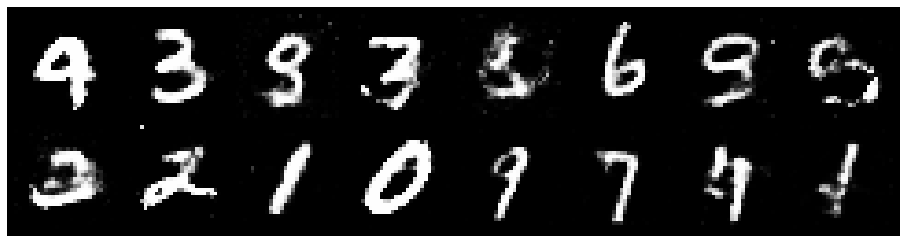

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2519, Generator Loss: 0.9424
D(x): 0.5221, D(G(z)): 0.4235


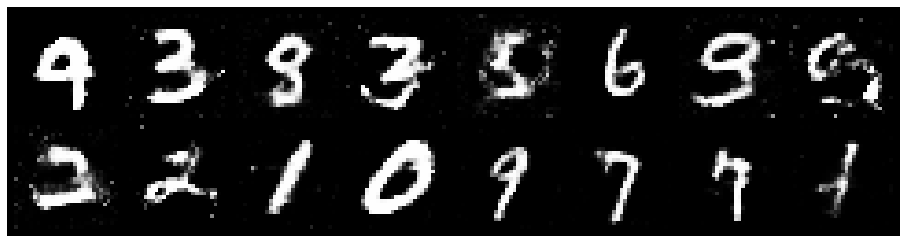

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2478, Generator Loss: 0.8629
D(x): 0.5432, D(G(z)): 0.4399


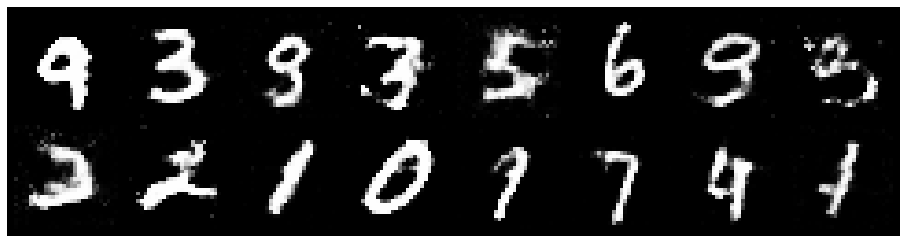

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2408, Generator Loss: 0.8773
D(x): 0.5520, D(G(z)): 0.4283


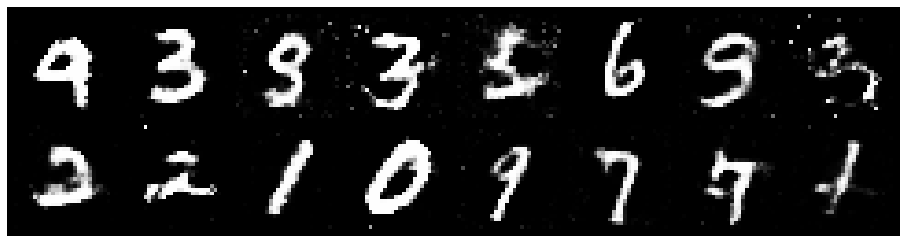

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.3281, Generator Loss: 0.8061
D(x): 0.5245, D(G(z)): 0.4491


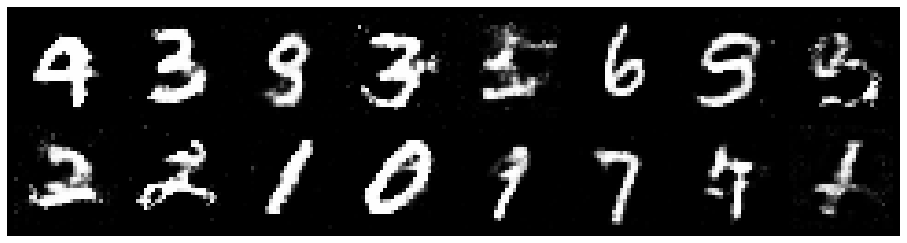

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.3125, Generator Loss: 0.8896
D(x): 0.5177, D(G(z)): 0.4295


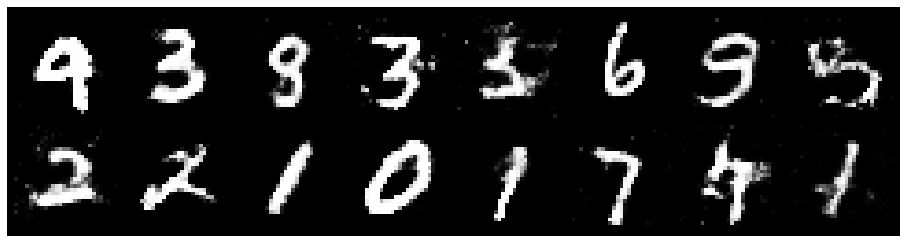

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2683, Generator Loss: 0.9936
D(x): 0.5291, D(G(z)): 0.4095


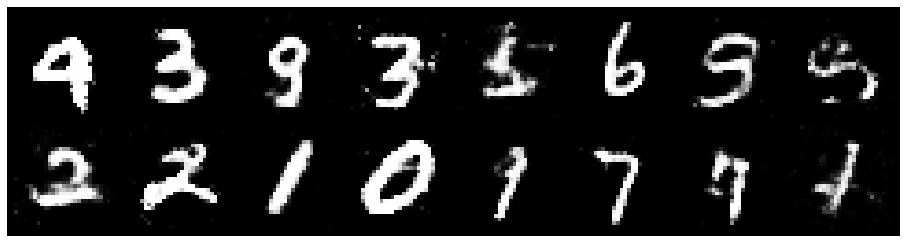

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.3372, Generator Loss: 0.9591
D(x): 0.5537, D(G(z)): 0.4568


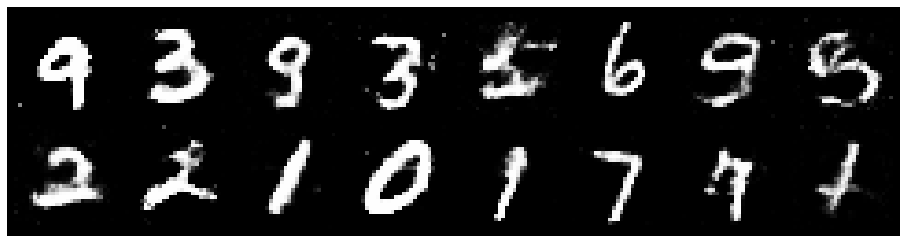

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.2446, Generator Loss: 0.8574
D(x): 0.5445, D(G(z)): 0.4143


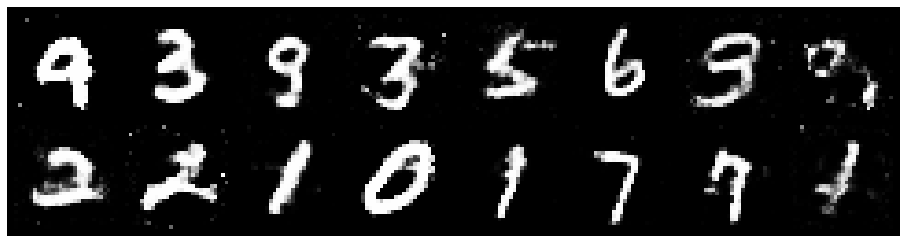

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.3194, Generator Loss: 0.9674
D(x): 0.5113, D(G(z)): 0.4117


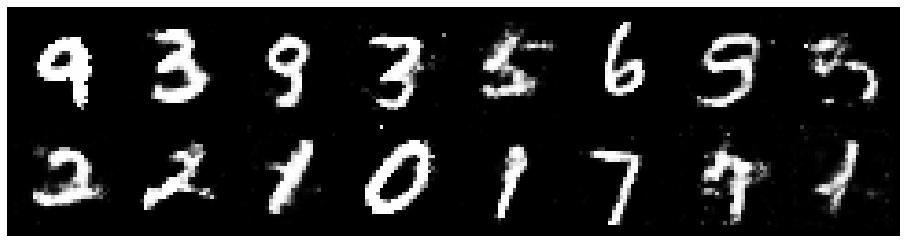

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.2828, Generator Loss: 0.9041
D(x): 0.5375, D(G(z)): 0.4454


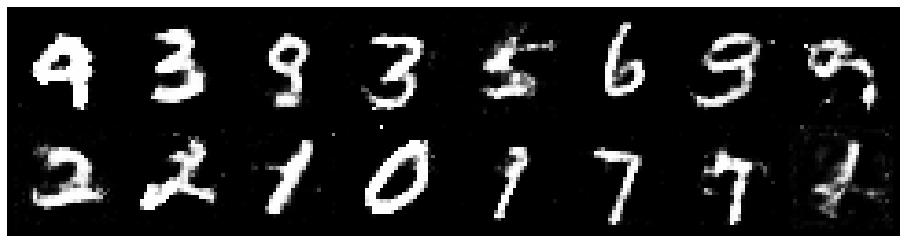

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.2962, Generator Loss: 0.8436
D(x): 0.5905, D(G(z)): 0.4909


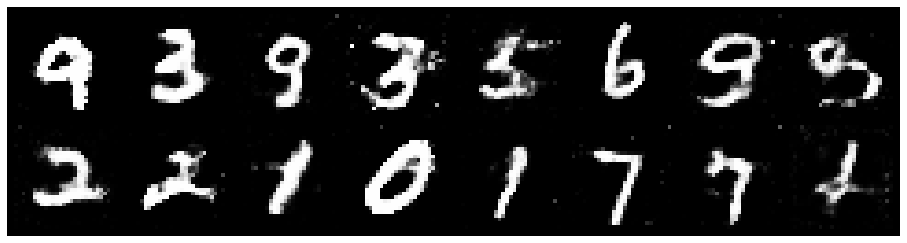

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.3146, Generator Loss: 0.7918
D(x): 0.5601, D(G(z)): 0.4872


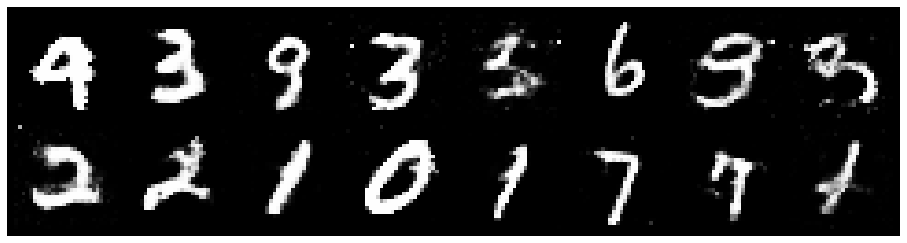

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.3098, Generator Loss: 0.7558
D(x): 0.5379, D(G(z)): 0.4660


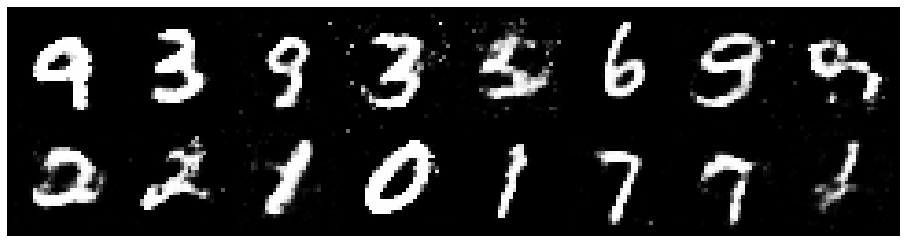

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2844, Generator Loss: 0.9153
D(x): 0.5282, D(G(z)): 0.4320


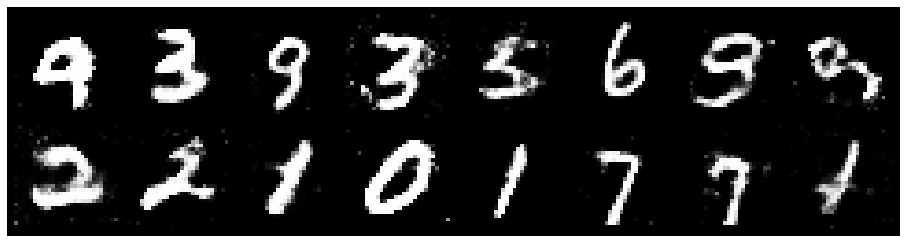

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2486, Generator Loss: 0.7672
D(x): 0.5585, D(G(z)): 0.4617


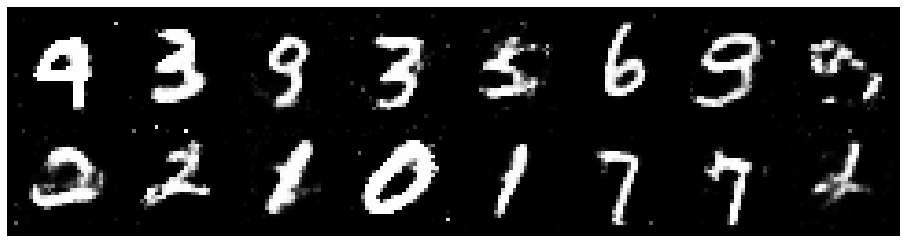

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.3147, Generator Loss: 0.8187
D(x): 0.5244, D(G(z)): 0.4489


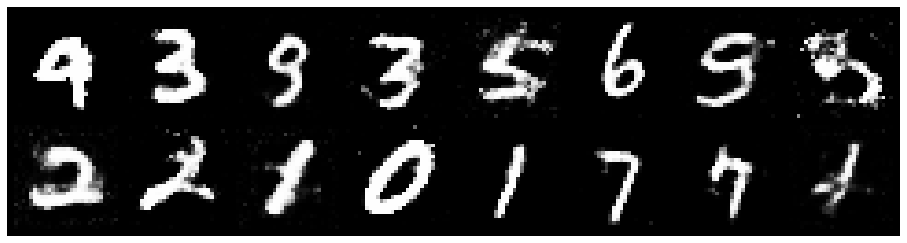

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.2740, Generator Loss: 0.8552
D(x): 0.5383, D(G(z)): 0.4271


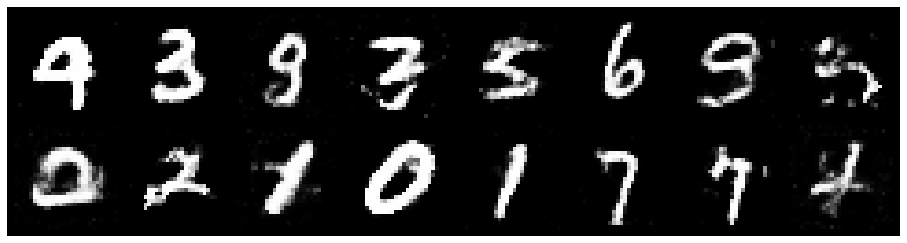

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.4141, Generator Loss: 0.7894
D(x): 0.5236, D(G(z)): 0.5066


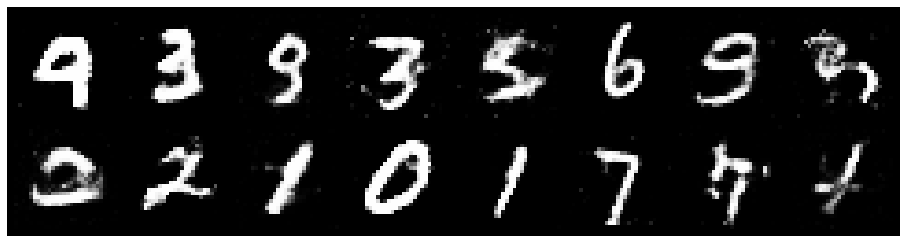

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.3724, Generator Loss: 0.7714
D(x): 0.5528, D(G(z)): 0.5071


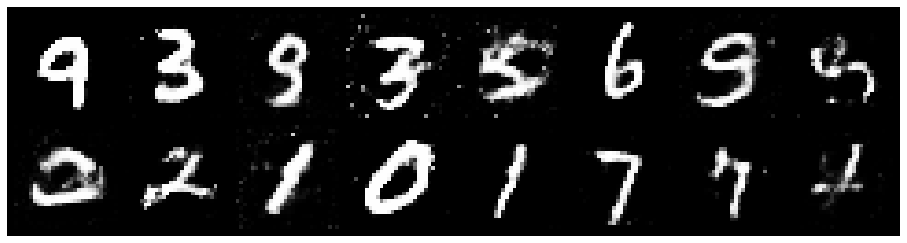

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.3185, Generator Loss: 0.8002
D(x): 0.5281, D(G(z)): 0.4581


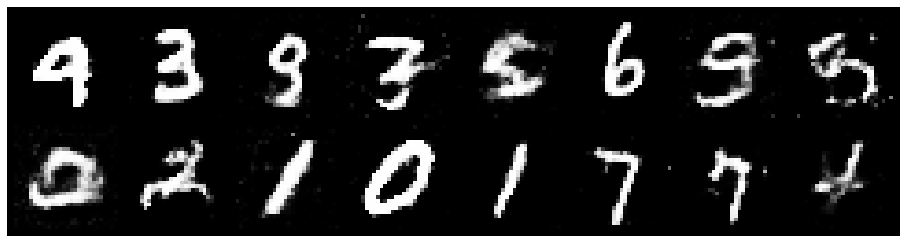

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.3229, Generator Loss: 0.8818
D(x): 0.5133, D(G(z)): 0.4471


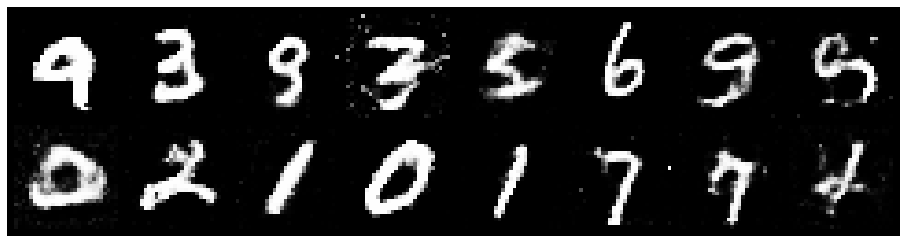

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.3517, Generator Loss: 0.8820
D(x): 0.5450, D(G(z)): 0.4867


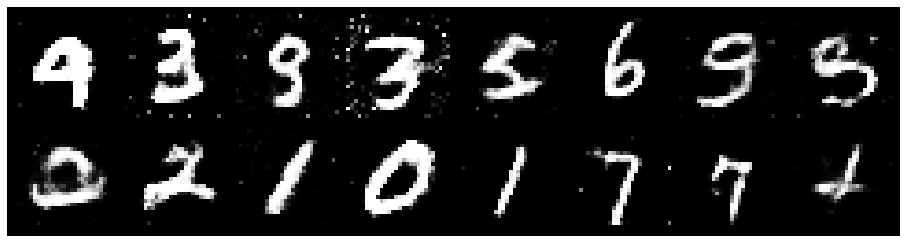

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.2296, Generator Loss: 0.9624
D(x): 0.5855, D(G(z)): 0.4599


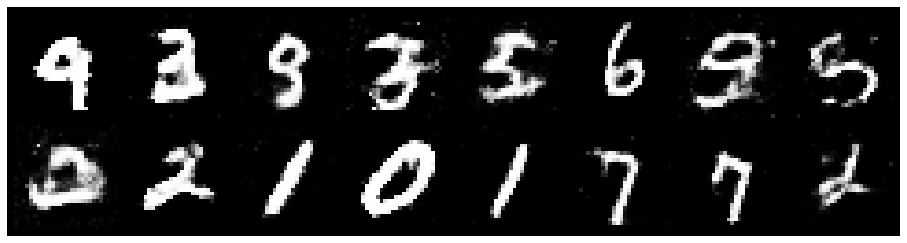

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2899, Generator Loss: 0.8396
D(x): 0.5363, D(G(z)): 0.4396


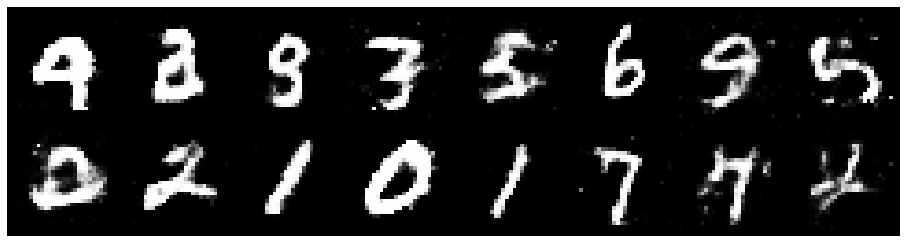

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.2630, Generator Loss: 0.7827
D(x): 0.5657, D(G(z)): 0.4698


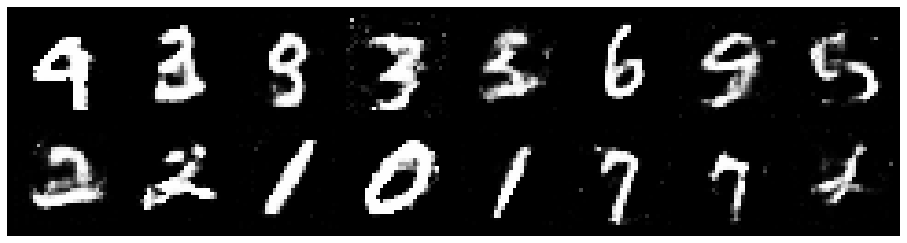

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2771, Generator Loss: 0.9492
D(x): 0.4987, D(G(z)): 0.3911


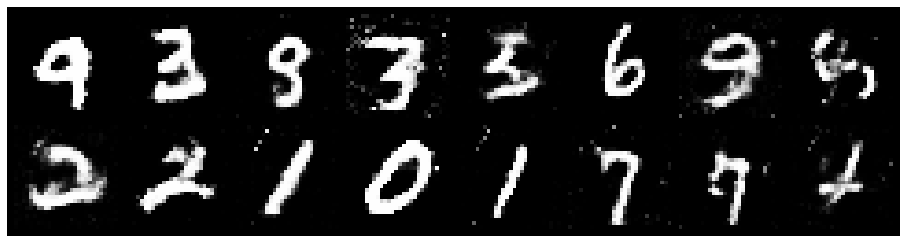

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.4102, Generator Loss: 0.7729
D(x): 0.4972, D(G(z)): 0.4688


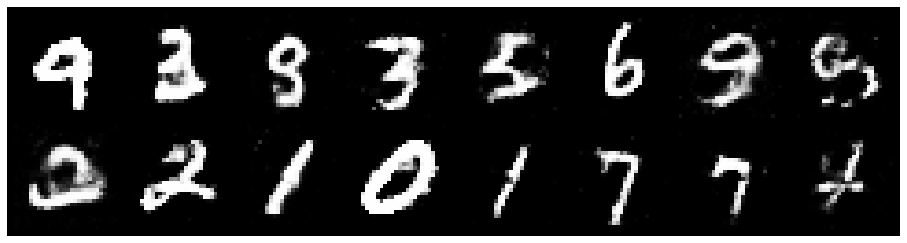

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.3823, Generator Loss: 0.8605
D(x): 0.5222, D(G(z)): 0.4716


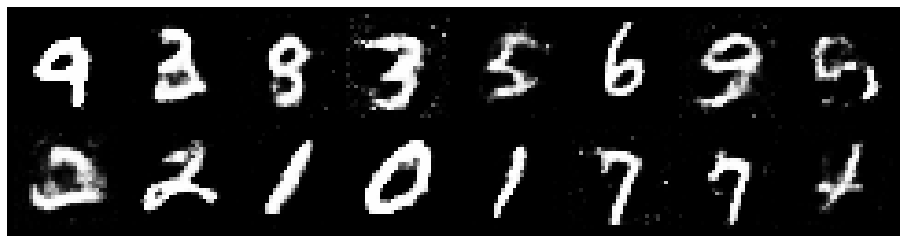

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.2923, Generator Loss: 0.7646
D(x): 0.5252, D(G(z)): 0.4413


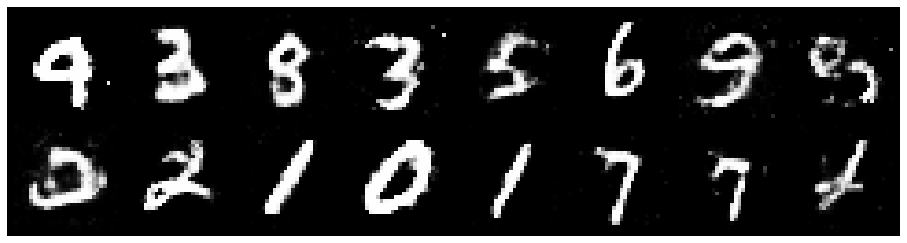

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.3197, Generator Loss: 0.9396
D(x): 0.5395, D(G(z)): 0.4488


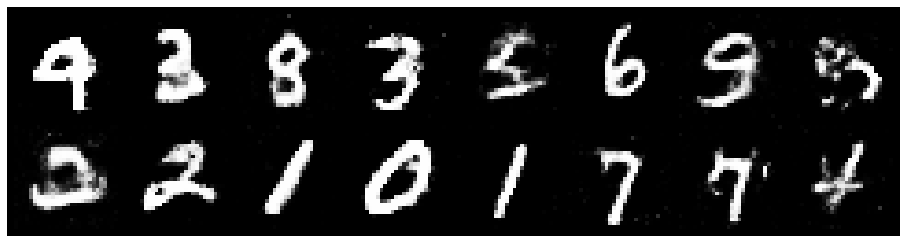

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.2732, Generator Loss: 0.8840
D(x): 0.5539, D(G(z)): 0.4508


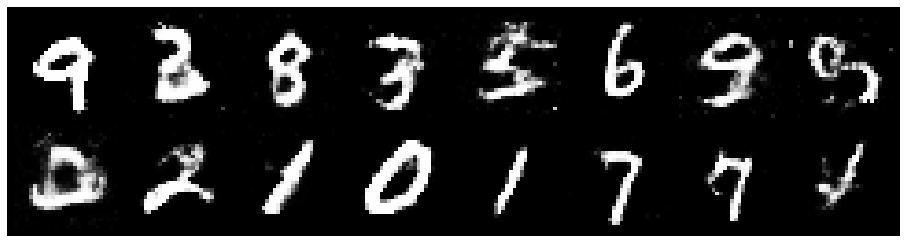

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.4404, Generator Loss: 1.0004
D(x): 0.5102, D(G(z)): 0.4690


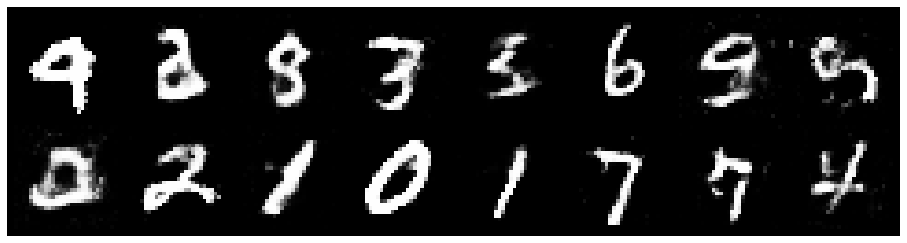

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.2723, Generator Loss: 0.8205
D(x): 0.5565, D(G(z)): 0.4604


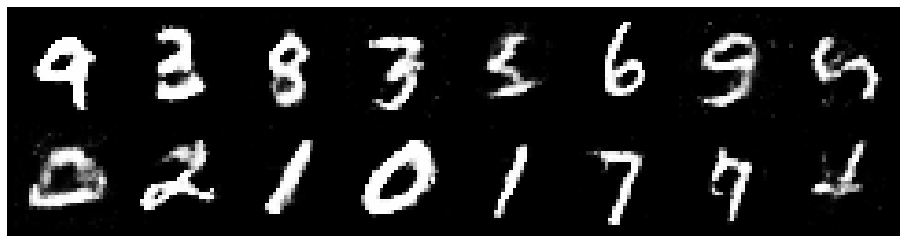

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2241, Generator Loss: 0.8424
D(x): 0.5495, D(G(z)): 0.4253


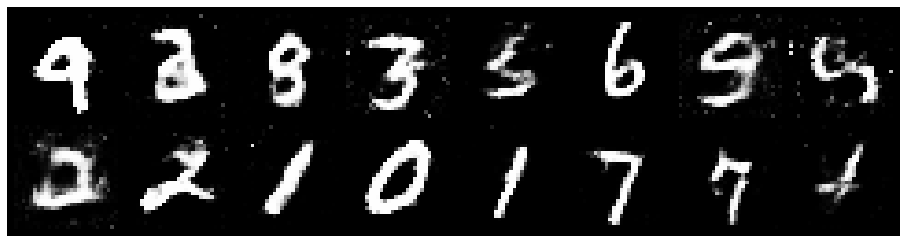

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.2707, Generator Loss: 0.9033
D(x): 0.5166, D(G(z)): 0.4198


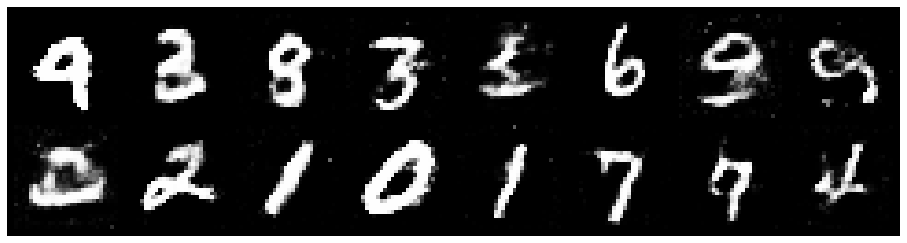

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2928, Generator Loss: 0.8430
D(x): 0.5463, D(G(z)): 0.4422


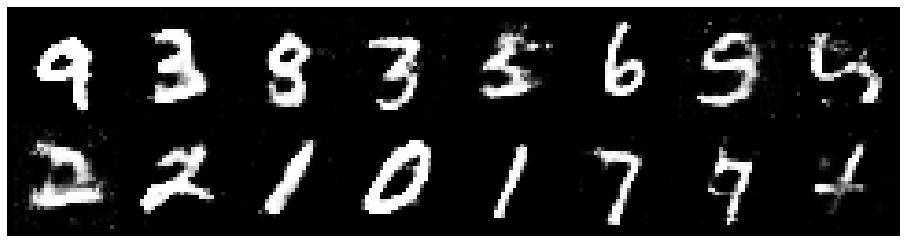

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2946, Generator Loss: 0.8644
D(x): 0.5304, D(G(z)): 0.4441


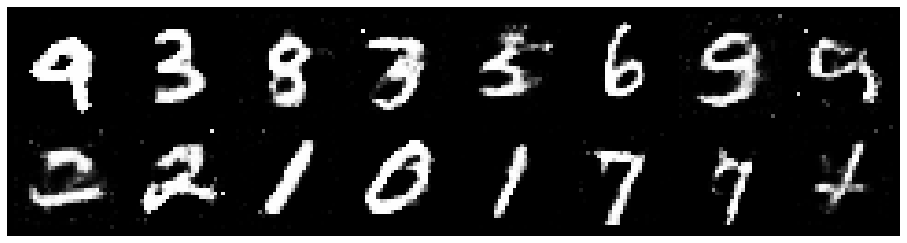

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.2094, Generator Loss: 0.9199
D(x): 0.5723, D(G(z)): 0.4406


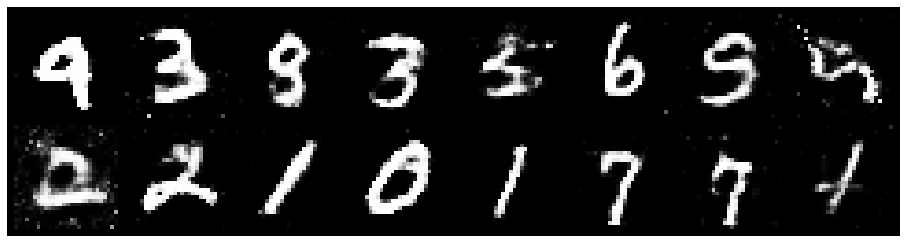

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.1937, Generator Loss: 0.9180
D(x): 0.5719, D(G(z)): 0.4145


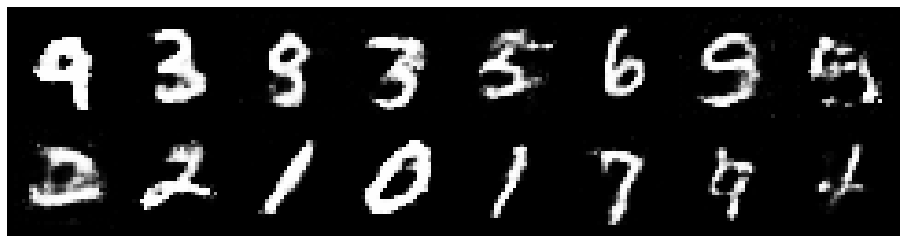

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2300, Generator Loss: 0.9407
D(x): 0.5757, D(G(z)): 0.4420


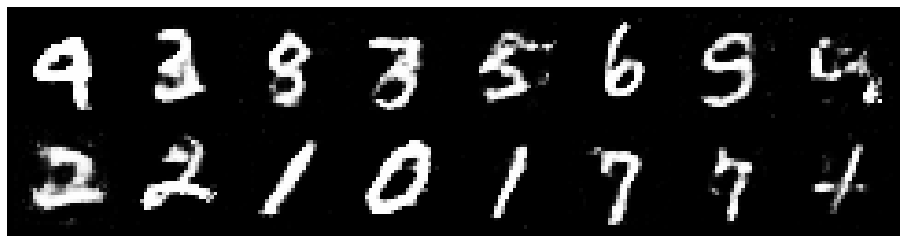

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3233, Generator Loss: 0.9443
D(x): 0.5415, D(G(z)): 0.4527


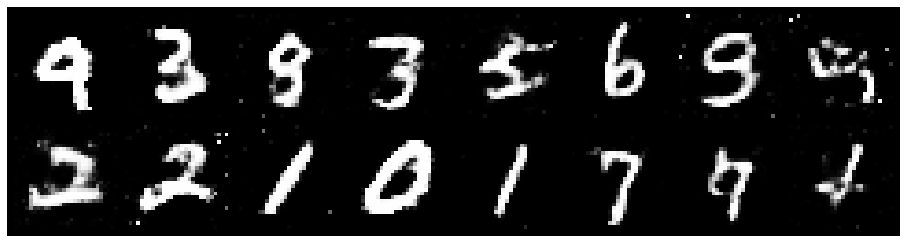

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.2931, Generator Loss: 0.8831
D(x): 0.5315, D(G(z)): 0.4517


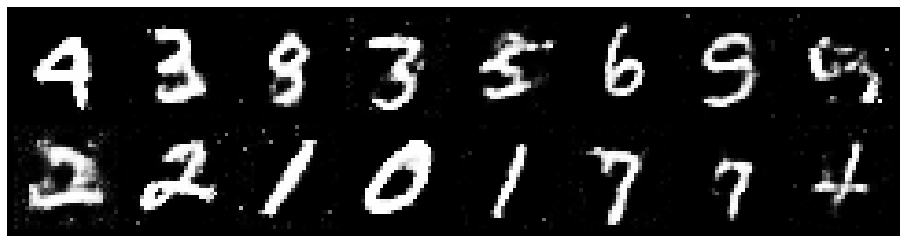

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3148, Generator Loss: 0.8893
D(x): 0.5285, D(G(z)): 0.4280


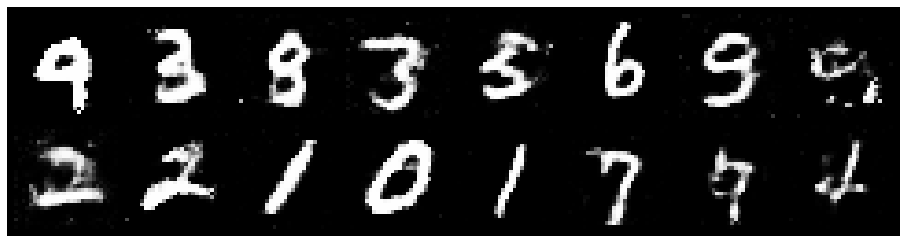

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.3935, Generator Loss: 0.8563
D(x): 0.5148, D(G(z)): 0.4835


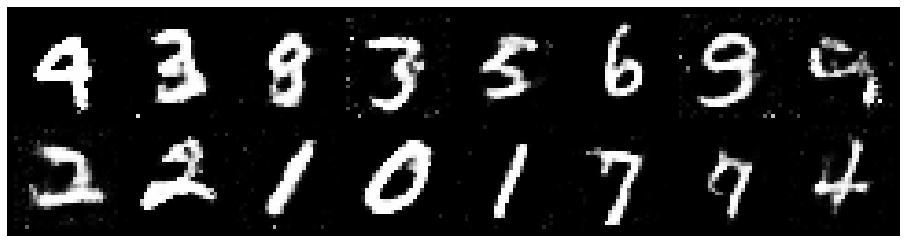

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.2391, Generator Loss: 0.8664
D(x): 0.5526, D(G(z)): 0.4368


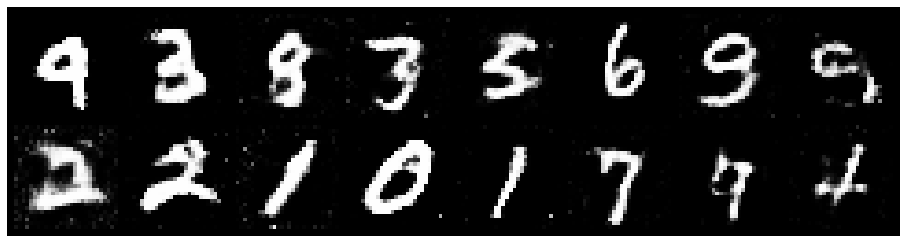

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.1478, Generator Loss: 1.1019
D(x): 0.6229, D(G(z)): 0.4195


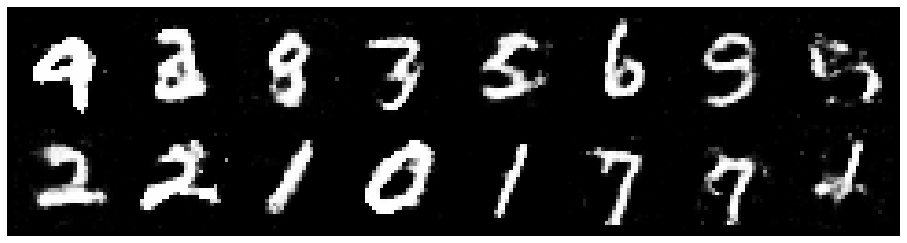

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.1377, Generator Loss: 0.9751
D(x): 0.5742, D(G(z)): 0.3926


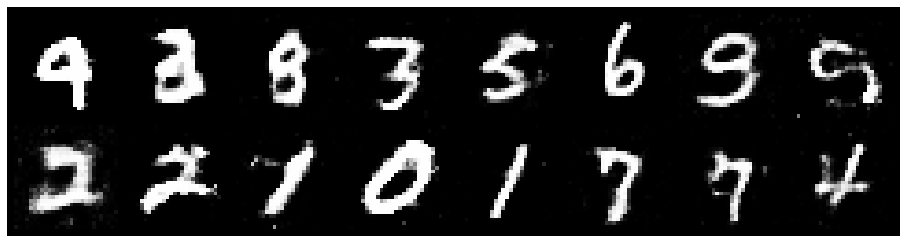

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.2682, Generator Loss: 0.9073
D(x): 0.5868, D(G(z)): 0.4703


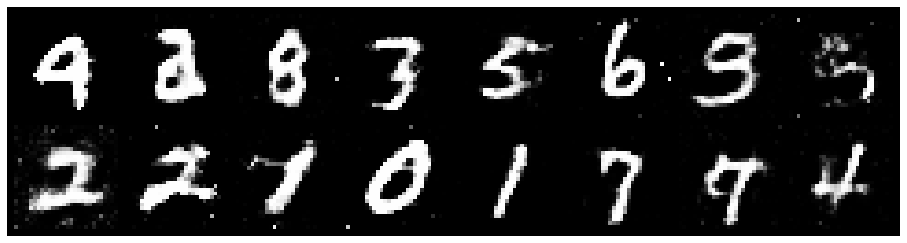

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.2975, Generator Loss: 0.7526
D(x): 0.5556, D(G(z)): 0.4755


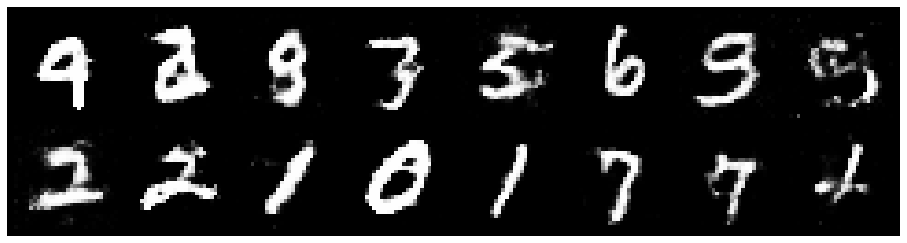

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.3007, Generator Loss: 0.8533
D(x): 0.5411, D(G(z)): 0.4632


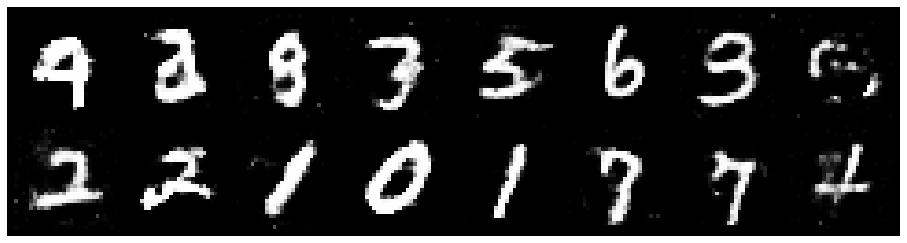

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.3193, Generator Loss: 0.7877
D(x): 0.5454, D(G(z)): 0.4696


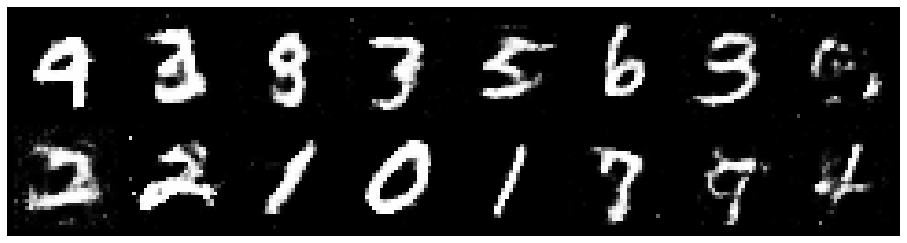

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2904, Generator Loss: 0.7905
D(x): 0.5218, D(G(z)): 0.4409


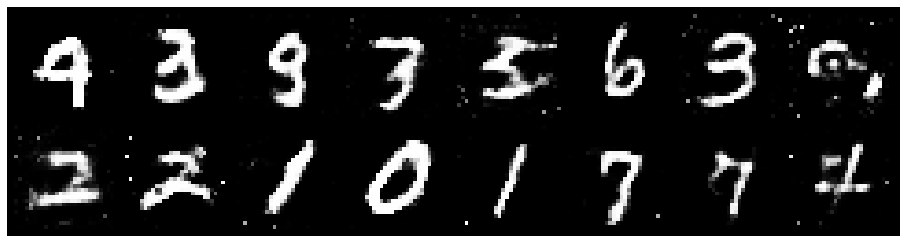

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.2949, Generator Loss: 0.8093
D(x): 0.5323, D(G(z)): 0.4571


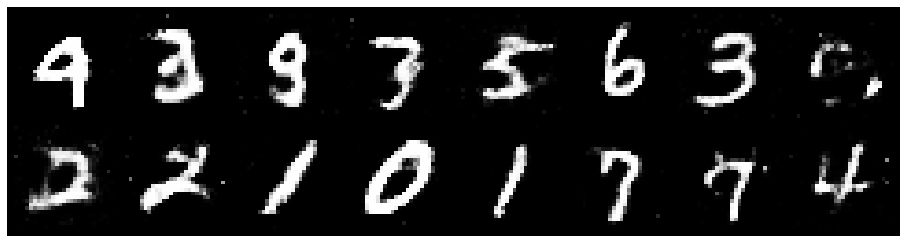

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2873, Generator Loss: 0.9324
D(x): 0.5240, D(G(z)): 0.4311


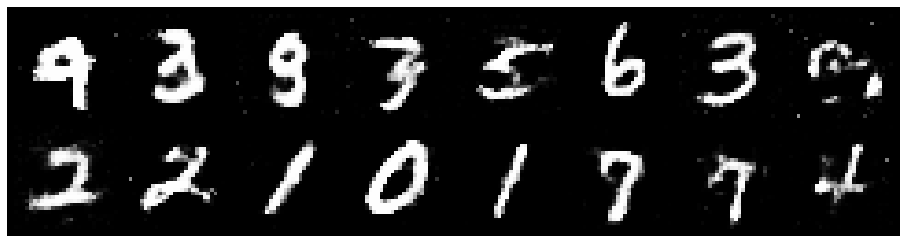

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2760, Generator Loss: 0.8090
D(x): 0.5320, D(G(z)): 0.4449


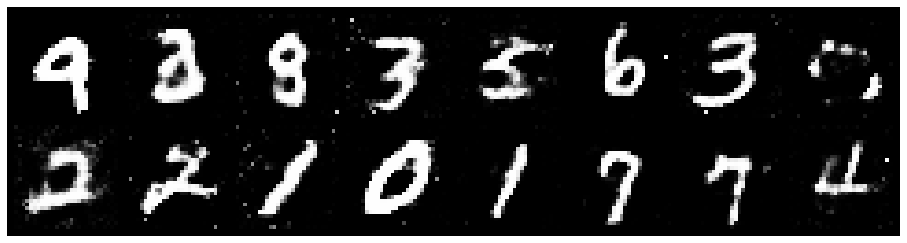

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.3063, Generator Loss: 0.9148
D(x): 0.4982, D(G(z)): 0.3963


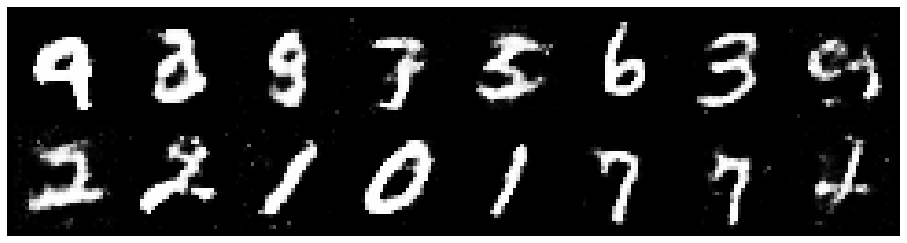

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.2419, Generator Loss: 0.8653
D(x): 0.5573, D(G(z)): 0.4504


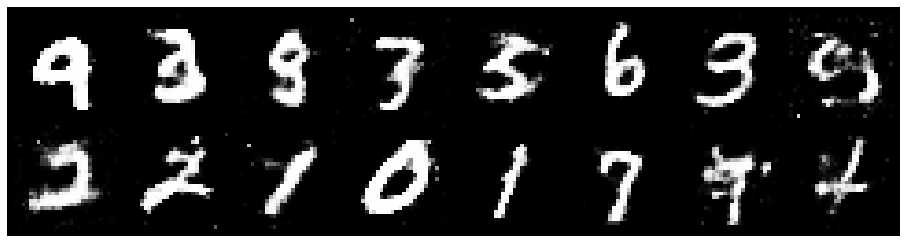

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.2049, Generator Loss: 0.8229
D(x): 0.5630, D(G(z)): 0.4274


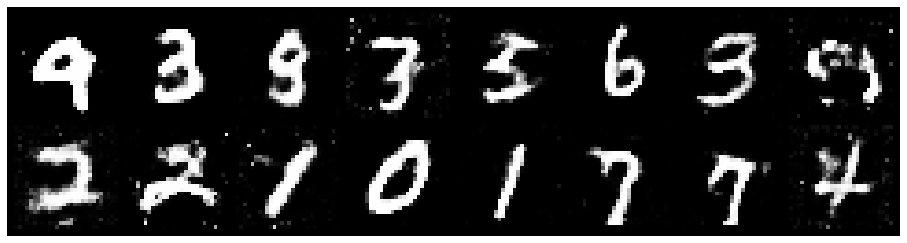

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.2127, Generator Loss: 0.8209
D(x): 0.5845, D(G(z)): 0.4601


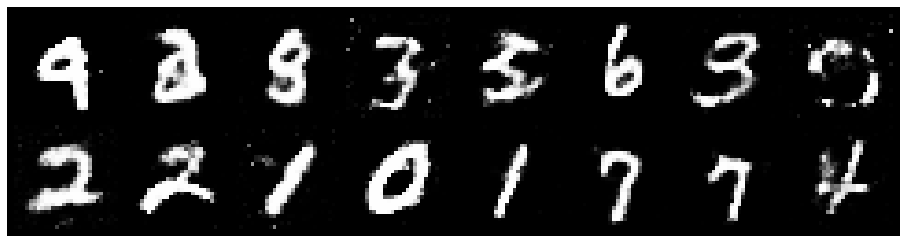

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.2250, Generator Loss: 0.8475
D(x): 0.5786, D(G(z)): 0.4669


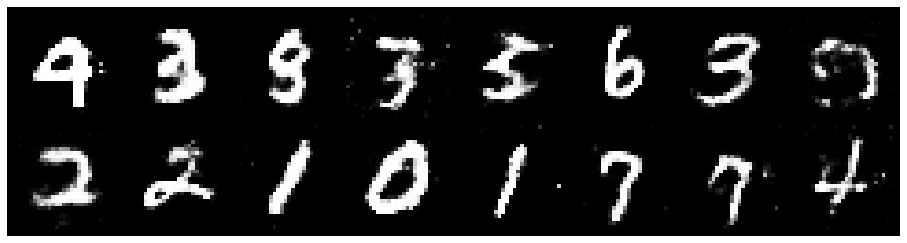

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.3129, Generator Loss: 0.8308
D(x): 0.5473, D(G(z)): 0.4678


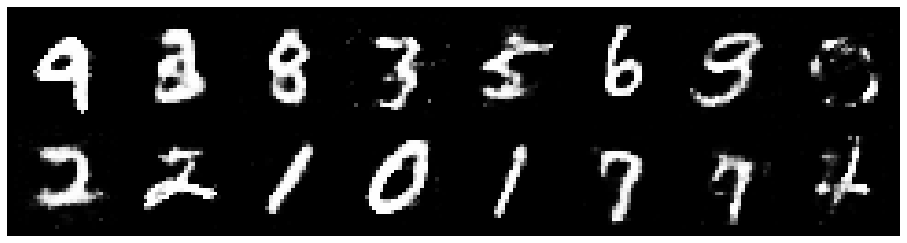

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3586, Generator Loss: 0.8796
D(x): 0.5042, D(G(z)): 0.4613


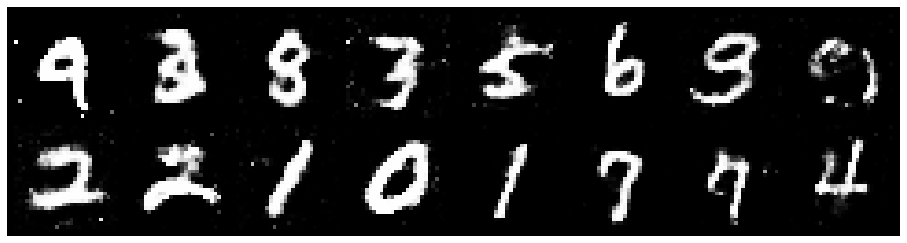

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3090, Generator Loss: 0.8204
D(x): 0.5362, D(G(z)): 0.4600


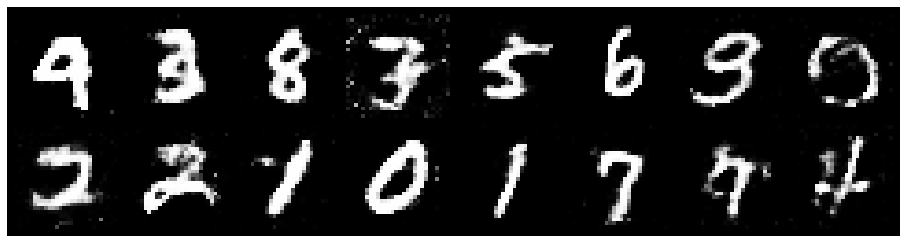

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.3906, Generator Loss: 0.7237
D(x): 0.5234, D(G(z)): 0.4742


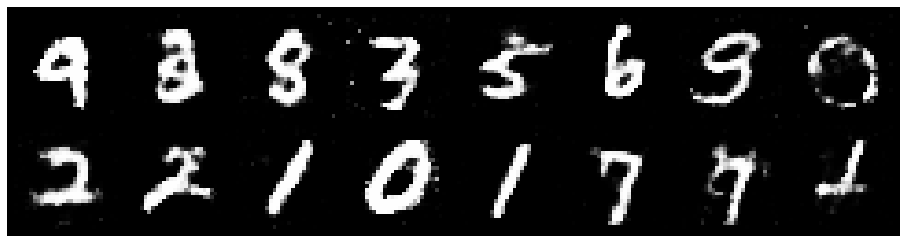

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3197, Generator Loss: 0.7722
D(x): 0.5615, D(G(z)): 0.4855


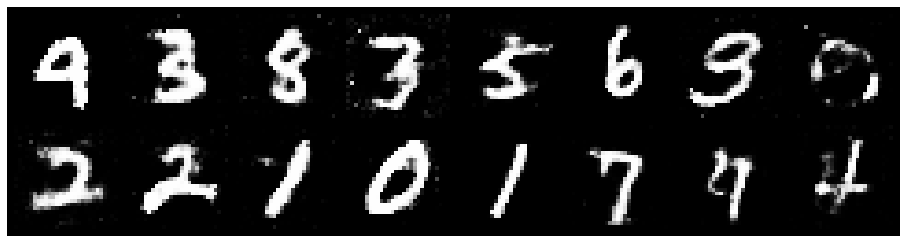

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.3088, Generator Loss: 0.8251
D(x): 0.5496, D(G(z)): 0.4633


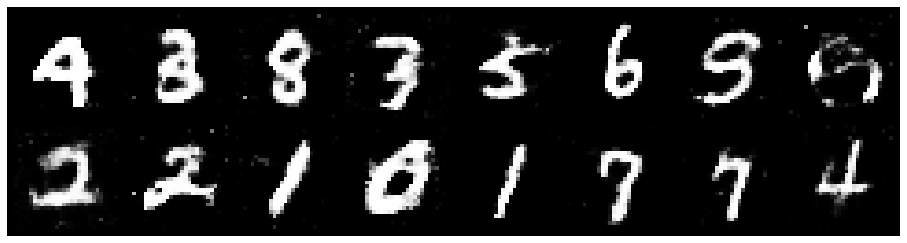

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3392, Generator Loss: 0.8199
D(x): 0.5510, D(G(z)): 0.4795


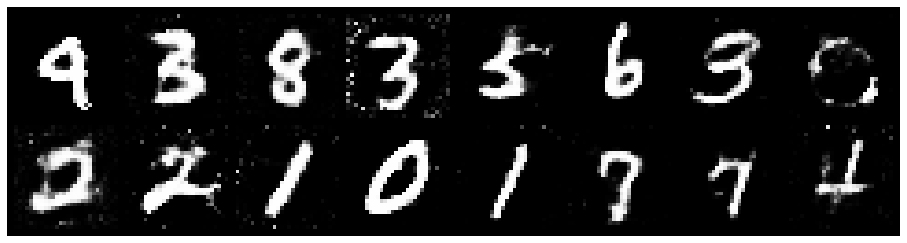

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8400
D(x): 0.5682, D(G(z)): 0.4588


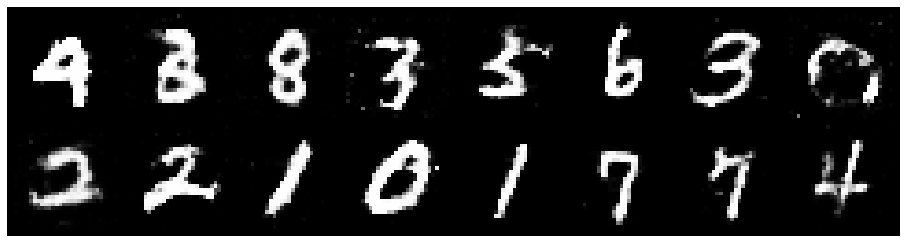

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.3017, Generator Loss: 0.9166
D(x): 0.5553, D(G(z)): 0.4480


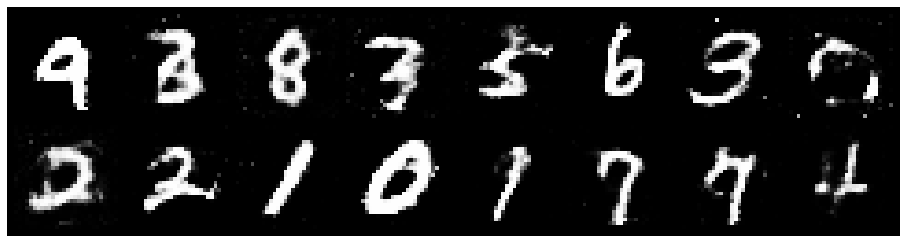

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.1904, Generator Loss: 0.8493
D(x): 0.5788, D(G(z)): 0.4172


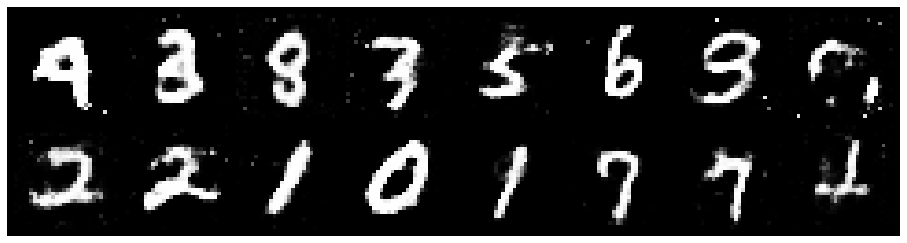

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.3684, Generator Loss: 0.9273
D(x): 0.4956, D(G(z)): 0.4342


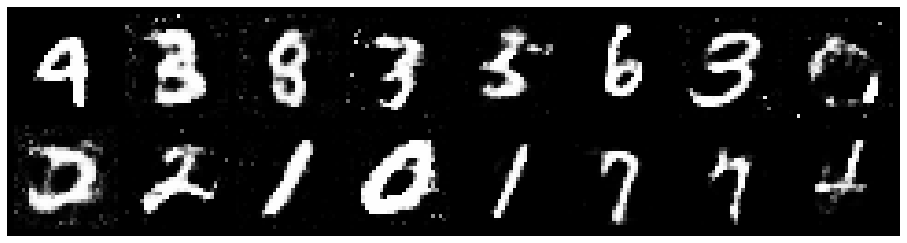

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2389, Generator Loss: 0.8641
D(x): 0.5693, D(G(z)): 0.4451


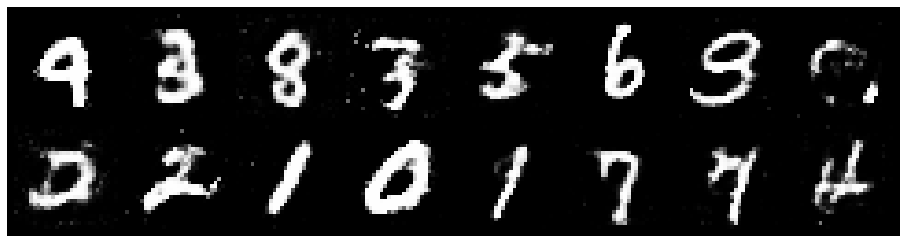

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.2697, Generator Loss: 0.8160
D(x): 0.5231, D(G(z)): 0.4383


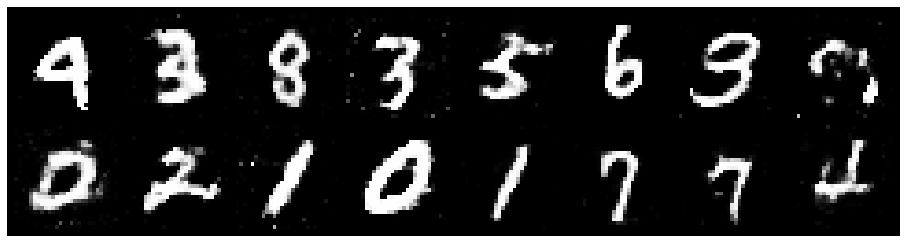

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.2460, Generator Loss: 1.0107
D(x): 0.5505, D(G(z)): 0.4233


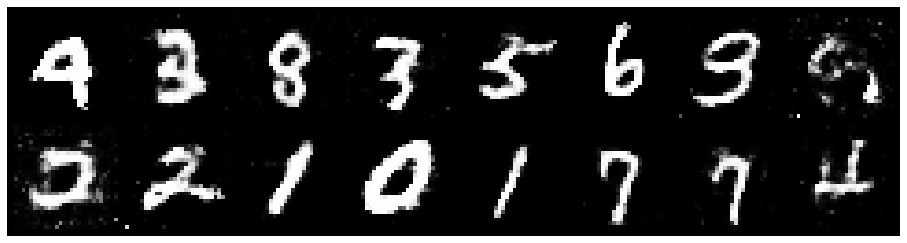

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.2972, Generator Loss: 0.7618
D(x): 0.5980, D(G(z)): 0.4901


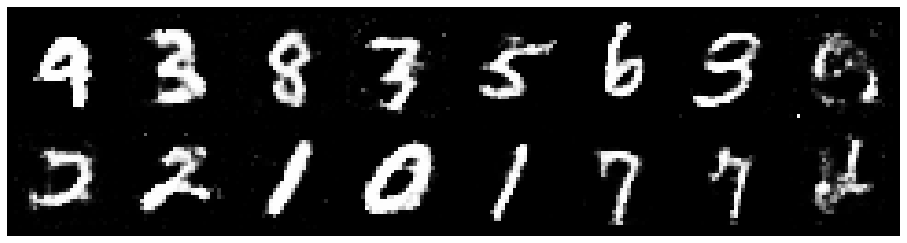

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.3358, Generator Loss: 0.8621
D(x): 0.5010, D(G(z)): 0.4542


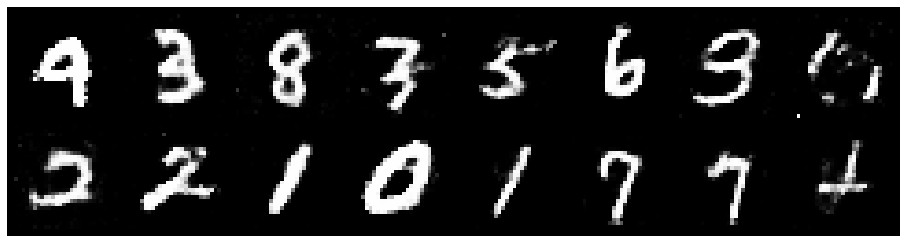

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.3104, Generator Loss: 0.9424
D(x): 0.5153, D(G(z)): 0.4227


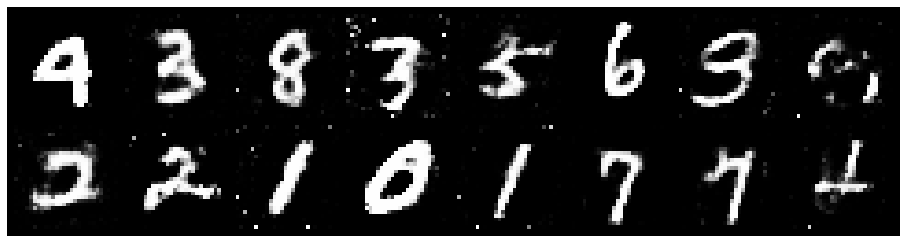

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.2639, Generator Loss: 0.9058
D(x): 0.5341, D(G(z)): 0.4312


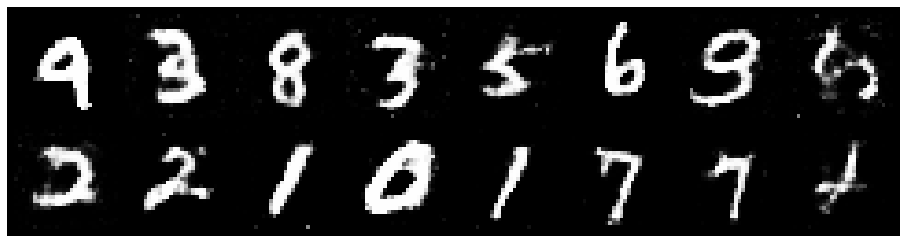

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.1847, Generator Loss: 0.9428
D(x): 0.5816, D(G(z)): 0.4244


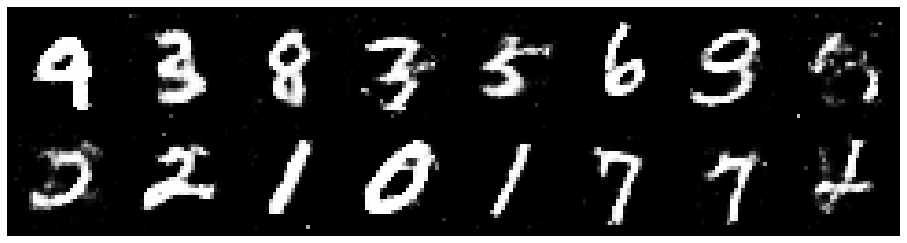

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.1880, Generator Loss: 0.9007
D(x): 0.5710, D(G(z)): 0.4122


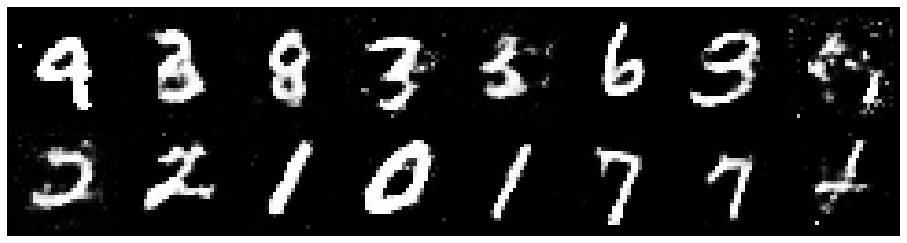

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.3146, Generator Loss: 0.8967
D(x): 0.5542, D(G(z)): 0.4667


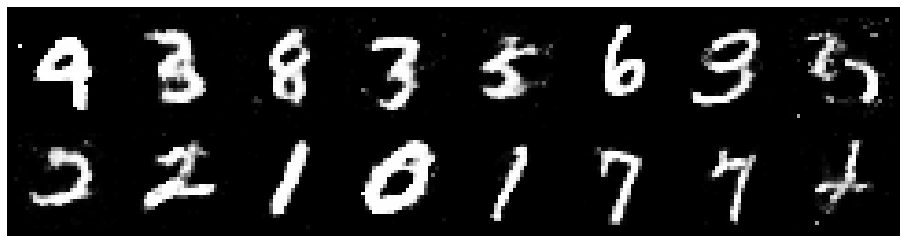

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.3093, Generator Loss: 0.8436
D(x): 0.5343, D(G(z)): 0.4336


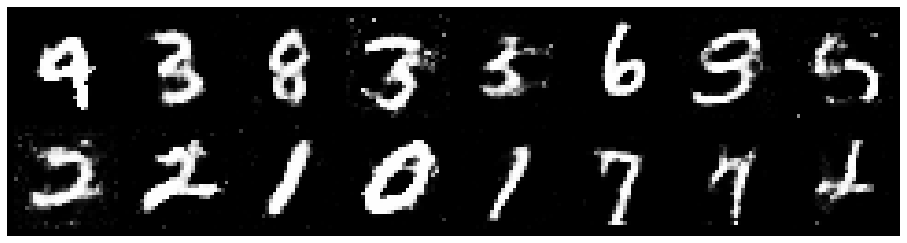

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.2713, Generator Loss: 0.8518
D(x): 0.5868, D(G(z)): 0.4752


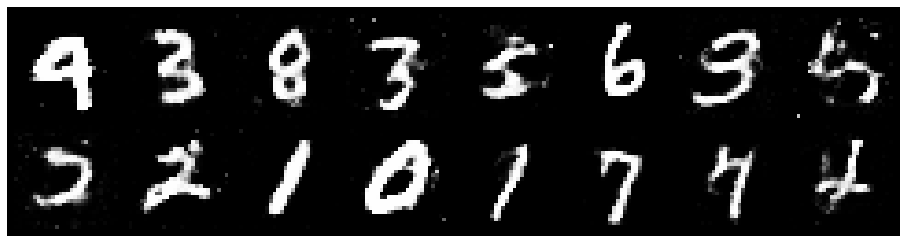

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.3417, Generator Loss: 0.7953
D(x): 0.5701, D(G(z)): 0.4723


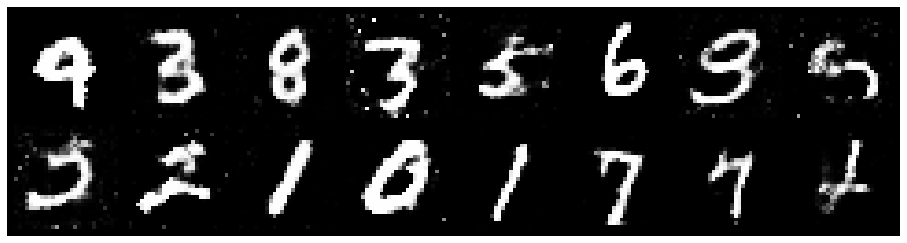

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2715, Generator Loss: 0.9155
D(x): 0.5519, D(G(z)): 0.4481


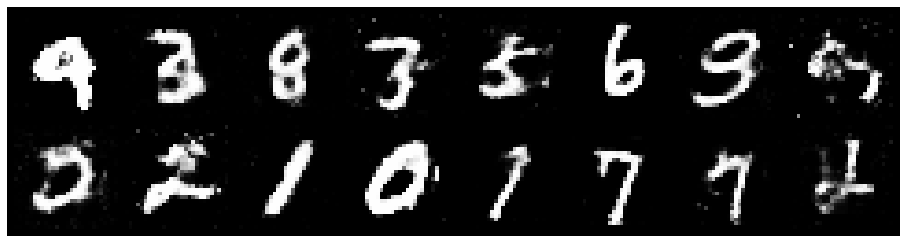

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.4385, Generator Loss: 0.9156
D(x): 0.5395, D(G(z)): 0.4723


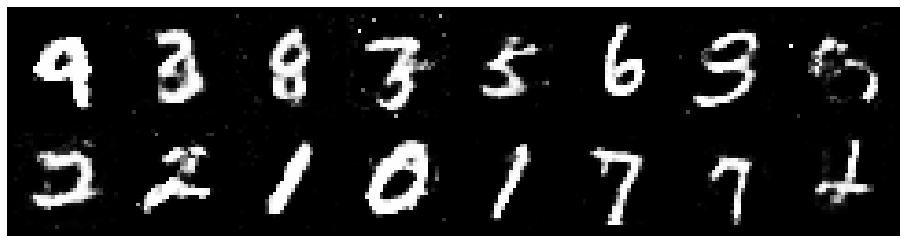

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.3637, Generator Loss: 0.8863
D(x): 0.5267, D(G(z)): 0.4407


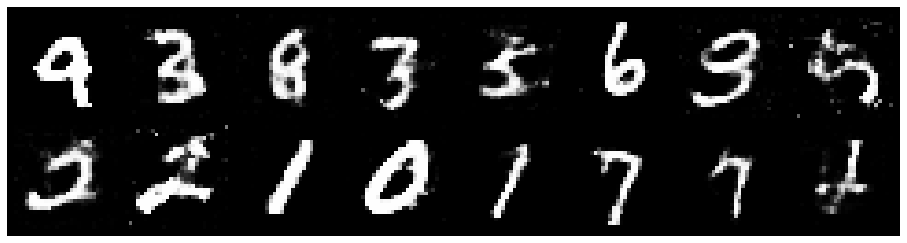

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.3164, Generator Loss: 0.9258
D(x): 0.5502, D(G(z)): 0.4464


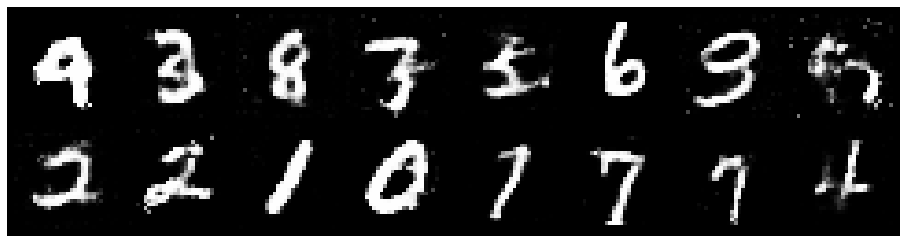

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.1975, Generator Loss: 0.9300
D(x): 0.5315, D(G(z)): 0.3746


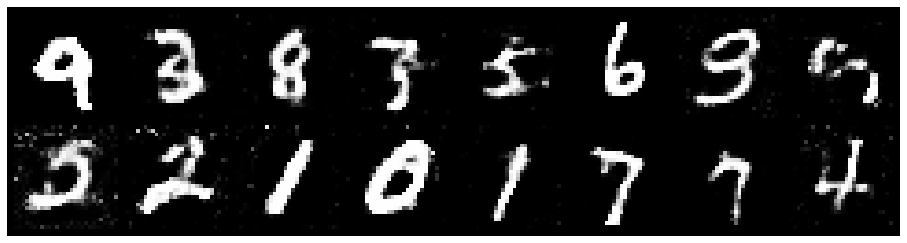

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.2652, Generator Loss: 0.8994
D(x): 0.5436, D(G(z)): 0.4398


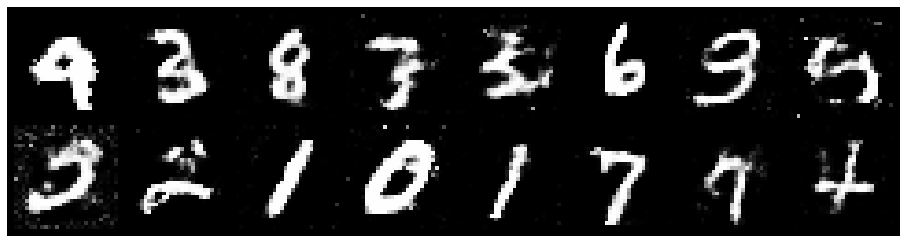

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.1789, Generator Loss: 0.9811
D(x): 0.5834, D(G(z)): 0.4180


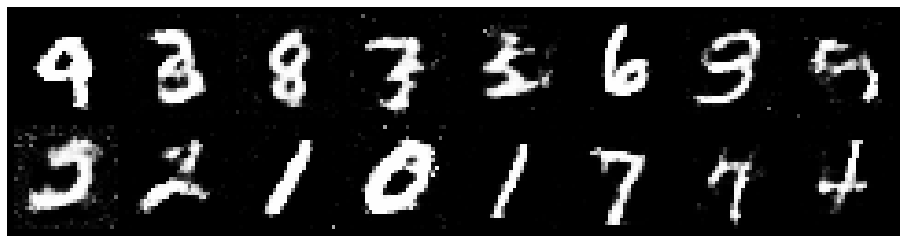

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.3959, Generator Loss: 0.8577
D(x): 0.5137, D(G(z)): 0.4497


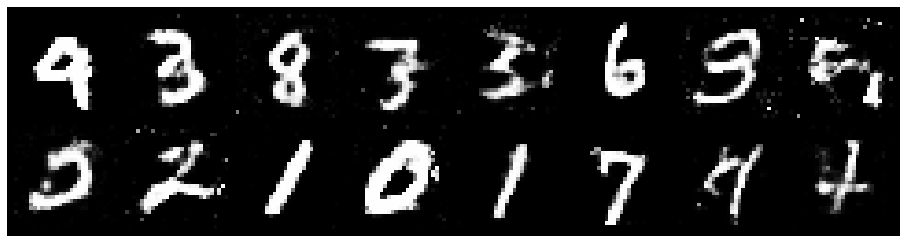

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2975, Generator Loss: 0.8021
D(x): 0.5356, D(G(z)): 0.4539


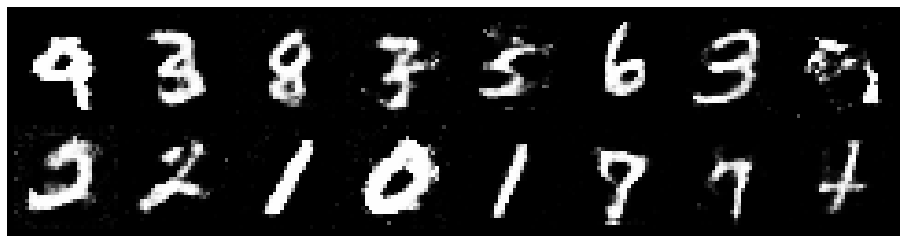

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.2924, Generator Loss: 0.7877
D(x): 0.5899, D(G(z)): 0.4964


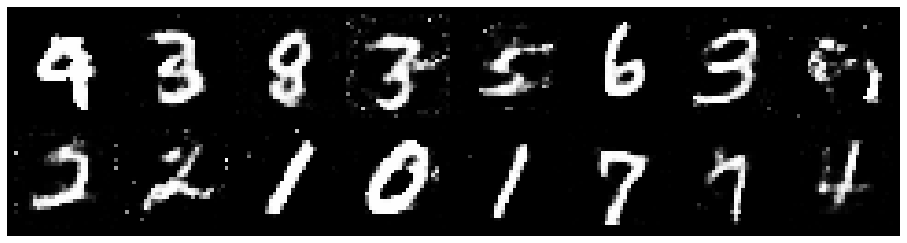

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2911, Generator Loss: 0.8679
D(x): 0.5516, D(G(z)): 0.4530


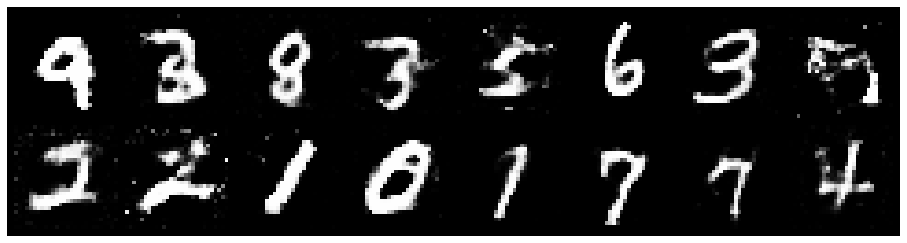

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.3441, Generator Loss: 0.8460
D(x): 0.5094, D(G(z)): 0.4293


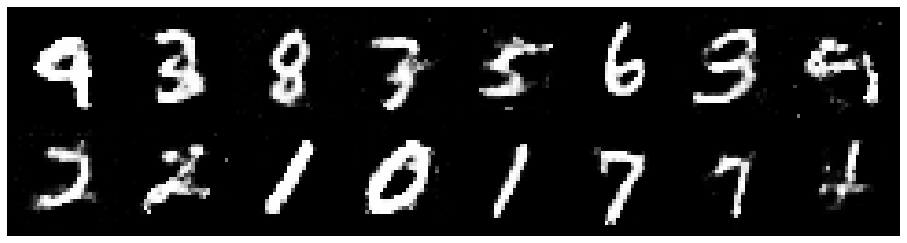

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.2615, Generator Loss: 0.8279
D(x): 0.5456, D(G(z)): 0.4343


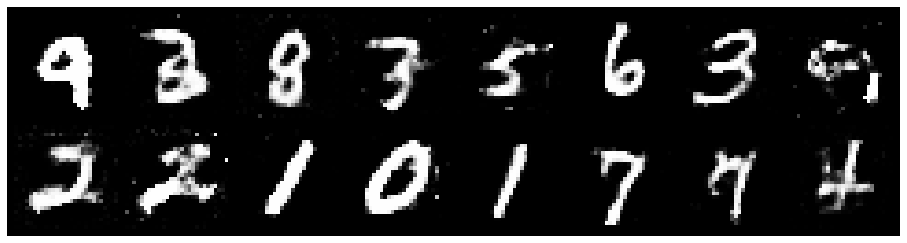

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.4030, Generator Loss: 0.8850
D(x): 0.5359, D(G(z)): 0.4878


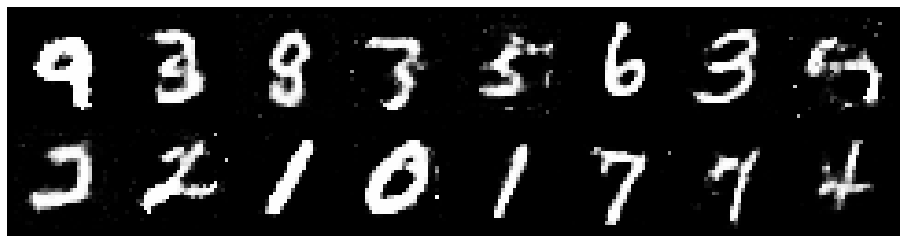

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.2986, Generator Loss: 1.0225
D(x): 0.5897, D(G(z)): 0.4545


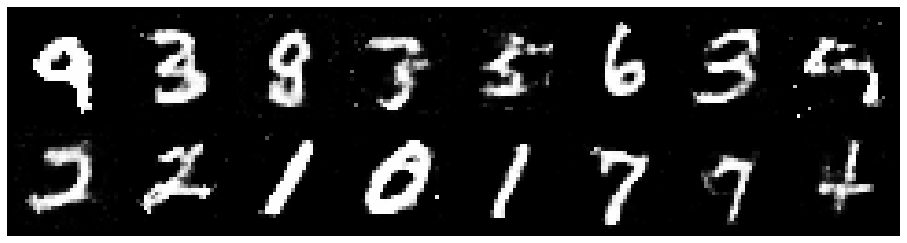

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2850, Generator Loss: 0.8418
D(x): 0.5526, D(G(z)): 0.4490


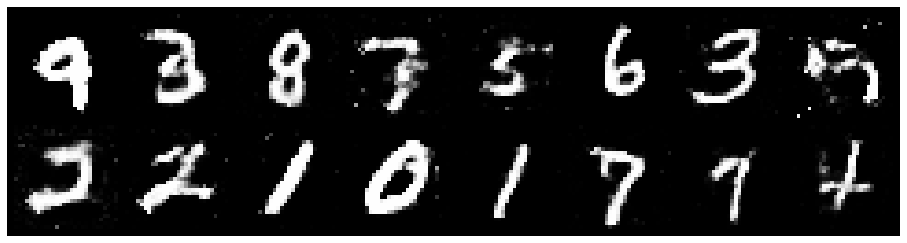

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2261, Generator Loss: 0.8669
D(x): 0.5407, D(G(z)): 0.4217


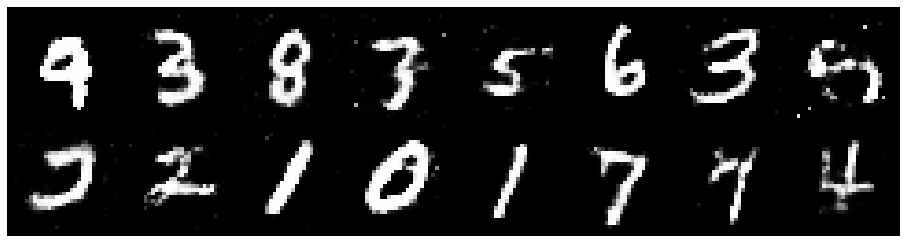

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.3038, Generator Loss: 0.9066
D(x): 0.5437, D(G(z)): 0.4574


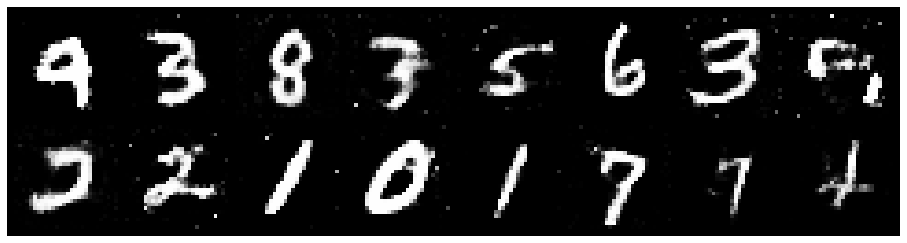

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.2655, Generator Loss: 0.8184
D(x): 0.5259, D(G(z)): 0.4287


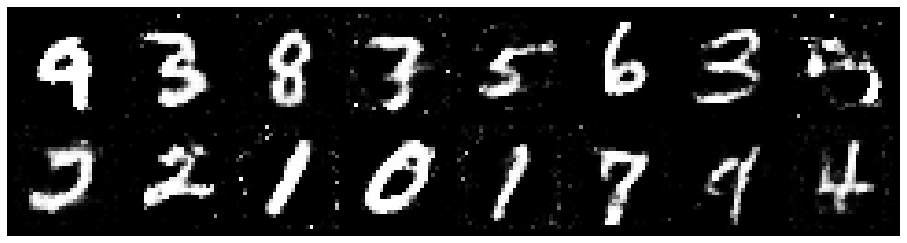

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.2424, Generator Loss: 0.8296
D(x): 0.5599, D(G(z)): 0.4467


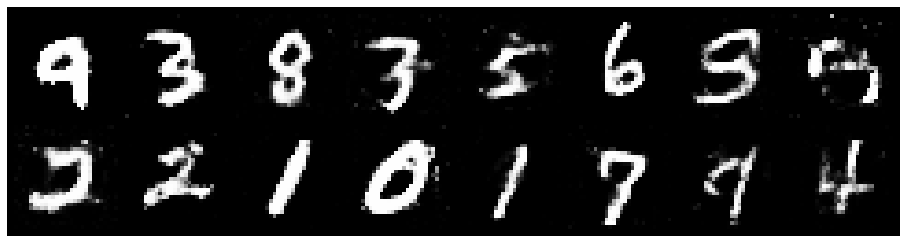

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2312, Generator Loss: 0.8640
D(x): 0.5604, D(G(z)): 0.4378


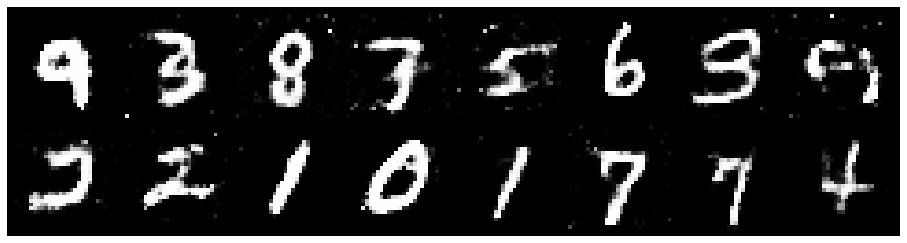

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2347, Generator Loss: 0.8284
D(x): 0.5761, D(G(z)): 0.4576


In [ ]:
# Create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')
# Total number of epochs to train
num_epochs = 200
for epoch in range(num_epochs):
  for n_batch, (real_batch, _) in enumerate(data_loader):
    N = real_batch.size(0)
    
    real_data = real_batch
    fake_data = generator(noise(N)).detach()

    # Train Detector
    d_error, d_pred_real, d_pred_fake = train_discriminator(optim_d, real_data, fake_data)

    # Train Generator
    fake_data = generator(noise(N))
    g_error = train_generator(optim_g, fake_data)

    # Log batch error
    logger.log(d_error, g_error, epoch, n_batch, num_batches)
    # Display Progress every few batches
    if (n_batch) % 100 == 0: 
      test_images = generator(test_noise)
      test_images = test_images.data
      logger.log_images(
                test_images, num_test_samples, 
                epoch, n_batch, num_batches
            );
      # Display status Logs
      logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )

In [ ]:
# save weights
torch.save(generator.state_dict(),'/content/drive/My Drive/generator.pth')